# Assignment 1

In [5]:
import warnings
warnings.simplefilter('ignore')
import matplotlib.pyplot as plt
import numpy as np
import datetime as dt
import random
import pandas as pd
import sys
from platform import python_version
import tensorflow as tf
from tensorflow import keras
from tensorflow.keras import layers, models
from sklearn.preprocessing import StandardScaler
from sklearn.model_selection import RandomizedSearchCV,GridSearchCV,train_test_split,cross_val_score, KFold, StratifiedKFold, learning_curve
from sklearn.metrics import accuracy_score, classification_report, confusion_matrix, recall_score, precision_recall_fscore_support, make_scorer
from sklearn.tree import DecisionTreeClassifier
import time
from sklearn.ensemble import AdaBoostClassifier
# ! pip install xgboost
import xgboost as xgb
from sklearn.preprocessing import LabelEncoder
from keras.models import Sequential
from keras.layers import Dense, Activation, Dropout
from keras import backend as K
from sklearn.neighbors import KNeighborsClassifier
from sklearn.svm import SVC
from keras.optimizers import Adam, SGD
! pip install keras==2.15.0

# from keras.wrappers.scikit_learn import KerasClassifier
# ! pip install pigar
# import pigar

# Defining functions that:
1. Ingest Dataset and Scale Dataset 
2. Conduct Train Test Split

In [4]:
def data_ingestion():
    # Ingesting Wine Quality Dataset
    wine = pd.read_csv(r'C:\Users\marcu\Desktop\GA Tech\ML\ML-SP24\Assignment 1\winequality-white.csv')
    column_names = wine.columns.tolist()
    # Standardize the values in all columns
    scaler = StandardScaler()
    columns_stand = ['fixed acidity', 'volatile acidity', 'citric acid', 'residual sugar', 'chlorides', 'free sulfur dioxide', 'total sulfur dioxide', 'density', 'pH', 'sulphates', 'alcohol']
    wine[columns_stand] = scaler.fit_transform(wine[columns_stand])
    
    # Encoding quality wine 
    label_encoder = LabelEncoder()
    wine['encoded_quality'] = label_encoder.fit_transform(wine['quality'])
    wine = wine.drop(columns=['quality'])
    wine = wine.rename(columns={'encoded_quality': 'quality'})


    # Descriptive Stats for Wine
    df_wine = wine.describe()
    df_wine.to_csv('descriptive/descriptive_stats_wine.csv')

    # Output boxplot for outlier distribution
    column_names = wine.columns.tolist()
    for i in column_names:
        column_data = wine[i].values
        # Create boxplot using Matplotlib
        plt.clf()
        plt.boxplot(column_data)
        plt.title(f'Box and Whisker Plot for Wine Quality for {i}')
        plt.savefig(f'image/wine_{i}.png')

    # Plotting Target Variable for Apple Quality
    plt.clf()
#     plt.hist(wine['quality'], label=i)
    plt.savefig('image/wine_target.png', bbox_inches='tight')
    
    # Ingesting Apple Quality
    aq = pd.read_csv(r'C:\Users\marcu\Desktop\GA Tech\ML\ML-SP24\Assignment 1\apple_quality.csv')
    # Descriptive Stats for Wine
    df_aq = aq.describe()
    df_aq.to_csv('descriptive/descriptive_stats_aq.csv')
    
    # Output boxplot for outlier distribution
    column_names = aq.columns.tolist()
    for i in column_names:
        column_data = aq[i].values
        # Create boxplot using Matplotlib
        plt.clf()
        plt.boxplot(column_data)
        plt.title(f'Box and Whisker Plot for Apple Quality for {i}')
        plt.savefig(f'image/aq_{i}.png')

    # Plotting Target Variable for Apple Quality
    plt.clf()
#     plt.hist(aq['Quality'], label=i)
    plt.savefig('image/apple_target.png', bbox_inches='tight')
    
    return(wine,aq)

In [5]:
def train_test(wine, aq):
    list_w = wine.columns.tolist()
    list_w.remove('quality')
    x_train_w, x_test_w, y_train_w, y_test_w = train_test_split(wine[list_w], wine['quality'], test_size=0.3, random_state=42)

    list_a = aq.columns.tolist()
    list_a.remove('Quality')
    x_train_a, x_test_a, y_train_a, y_test_a = train_test_split(aq[list_a], aq['Quality'], test_size=0.3, random_state=42)

    return(x_train_w, x_test_w, y_train_w, y_test_w, x_train_a, x_test_a, y_train_a, y_test_a)

In [6]:
def strat_kfold(clf, num_folds, x_train, y_train):
    # Create a StratifiedKFold object
    stratified_kfold = StratifiedKFold(n_splits=num_folds, shuffle=True,random_state = 42)
    
    # Lists to store training and validation scores for each fold
    training_scores = []
    validation_scores = []
    
    # Iterate over folds
    for fold_num, (train_index, val_index) in enumerate(stratified_kfold.split(x_train, y_train), start=1):


        # Extract training and validation sets for this fold
        X_train_sub, X_val_sub = x_train.iloc[train_index], x_train.iloc[val_index]
        y_train_sub, y_val_sub = y_train.iloc[train_index], y_train.iloc[val_index]
        
#         X_train_sub.to_csv(f'{fold_num}_x_train_sub.csv')
#         X_val_sub.to_csv(f'{fold_num}_x_val_sub.csv')
#         y_train_sub.to_csv(f'{fold_num}_y_train_sub.csv')
#         y_val_sub.to_csv(f'{fold_num}_y_val_sub.csv')
        
        # Train the Decision Tree model
        clf.fit(X_train_sub, y_train_sub)

        # Make predictions on the training set
        y_train_pred = clf.predict(X_train_sub)

        # Make predictions on the validation set
        y_val_pred = clf.predict(X_val_sub)

        # Calculate recall scores for training set
        _, recall_train, _, _ = precision_recall_fscore_support(y_train_sub, y_train_pred, average='micro')
        training_scores.append(recall_train)

        # Calculate recall scores for validation sets
        _, recall_val, _, _ = precision_recall_fscore_support(y_val_sub, y_val_pred, average='micro')
        validation_scores.append(recall_val)
        
        
#         weighted_recall = sum(recall * (sum(y_true == i) / len(y_true)) for i in set(y_true))


        # Print scores for the current fold
#         print(f'Fold {fold_num}: Training Recall = {recall_train:.4f}, Validation Recall = {recall_val:.4f}')

    # Print mean scores across all folds
    mean_training_score = np.mean(training_scores)
    mean_validation_score = np.mean(validation_scores)
#     print(mean_validation_score, mean_training_score)
    return(mean_validation_score, mean_training_score)

# 1.0 Decision Trees

In [268]:
# Defining function to run decision trees
def dtree_learner(x_train, 
                  x_test, 
                  y_train, 
                  y_test, 
                  crit = "entropy", 
                  min_samples_lf = 2, 
                  max_dep = None, 
                  max_leaf_nd = None, 
                  num_folds = 5):
    
    clf = DecisionTreeClassifier(random_state=42, 
                                 criterion = crit, 
                                 min_samples_leaf = min_samples_lf, 
                                 max_depth = max_dep, 
                                 max_leaf_nodes = max_leaf_nd)
    
    validation, training = strat_kfold(clf, num_folds, x_train, y_train)
    
    return(validation, training)
    
#     clf.fit(x_train, y_train)

#     # Train score
#     y_pred_train=clf.predict(x_train)
#     accuracy_train = accuracy_score(y_train, y_pred_train)
    
#     # Test
#     y_pred_test = clf.predict(x_test)
#     accuracy_test = accuracy_score(y_test, y_pred_test)
    
    
#     num_folds = 5

#     # Create a KFold object (optional, but allows customization of the fold split)
#     kf = KFold(n_splits=num_folds, shuffle=True, random_state=42)

#     # Perform k-fold cross-validation and calculate recall for each fold
#     recall_scores = cross_val_score(clf, x_train, y_train, cv=kf, scoring='recall')

#     # Print recall scores for each fold
#     for fold_num, recall in enumerate(recall_scores, start=1):
#         print(f'Fold {fold_num}: Recall = {recall:.4f}')

#     # Print mean recall across all folds
#     mean_recall = recall_scores.mean()
#     print(f'Mean Recall across {num_folds} folds: {mean_recall:.4f}')
#     
#     return(accuracy_test,accuracy_train)



In [269]:
# Calling data ingestion function and calling the function to split dataset
wine,aq = data_ingestion()
x_train_w, x_test_w, y_train_w, y_test_w, x_train_a, x_test_a, y_train_a, y_test_a = train_test(wine,aq)

<Figure size 640x480 with 0 Axes>

# 1.1 Decision Trees Experimentation - Varying Number of Leaf and Depth

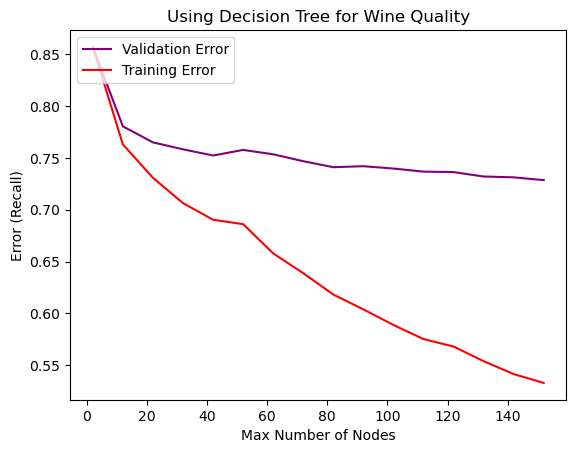

In [209]:
# [WINE QUALITY] Varying leaf nodes and analyzing performance
acc_w_train = []
acc_w_test = []
list_x = []
for x in range(2,160,10):
    test,train = dtree_learner(x_train_w, 
                               x_test_w, 
                               y_train_w, 
                               y_test_w, 
                               crit = "entropy", 
                               max_leaf_nd = x, 
                               num_folds = 5)
    acc_w_train.append(1-train)
    acc_w_test.append(1-test)
    list_x.append(x)
#     print(x)
# print(acc_w_train)
# print(acc_w_test)

plt.clf()
plt.title('Using Decision Tree for Wine Quality')
plt.xlabel("Max Number of Nodes")
plt.ylabel("Error (Recall)")
plt.locator_params(axis='x')
plt.locator_params(axis='y')
plt.plot(list_x, acc_w_test, color='purple', label='Validation Error')
plt.plot(list_x, acc_w_train, color='red', label='Training Error')
plt.legend(loc="upper left")
# plt.savefig('Wine Quality_Decision Tree Error.png',
#             bbox_inches='tight')
plt.show()

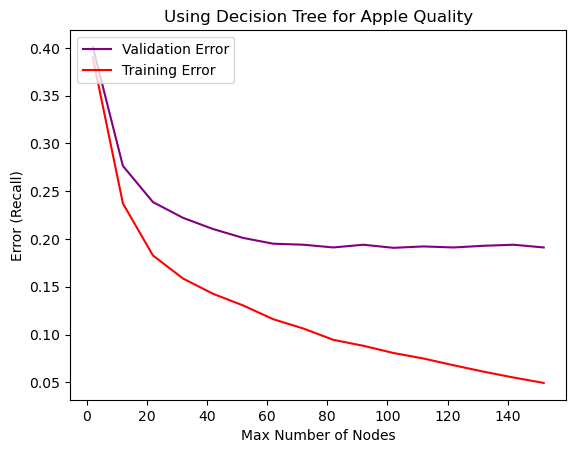

In [210]:
# [APPLE QUALITY] Varying leaf nodes and analyzing performance
acc_a_train = []
acc_a_test = []
list_y = []
for y in range(2,160,10):
    test,train = dtree_learner(x_train_a, 
                               x_test_a, 
                               y_train_a, 
                               y_test_a, 
                               crit = "entropy", 
                               max_leaf_nd = y)
    
    acc_a_train.append(1-train)
    acc_a_test.append(1-test)
    list_y.append(y)

plt.clf()
plt.title('Using Decision Tree for Apple Quality')
plt.xlabel("Max Number of Nodes")
plt.ylabel("Error (Recall)")
plt.locator_params(axis='x')
plt.locator_params(axis='y')
plt.plot(list_y, acc_a_test, color='purple', label='Validation Error')
plt.plot(list_y, acc_a_train, color='red', label='Training Error')
plt.legend(loc="upper left")
plt.savefig('Apple Quality_Decision Tree Error.png',
            bbox_inches='tight')

plt.show()

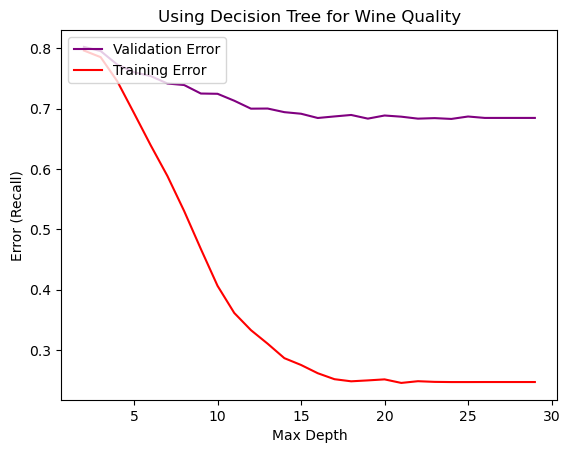

In [211]:
# [WINE QUALITY] Varying min sample per leaf and analyzing performance
acc_w_train = []
acc_w_test = []
list_x = []
for x in range(2,30):
    test,train = dtree_learner(x_train_w, x_test_w, y_train_w, y_test_w, crit = "entropy", max_dep = x)
    acc_w_train.append(1-train)
    acc_w_test.append(1-test)
    list_x.append(x)
#     print(x)
# print(acc_w_train)
# print(acc_w_test)

plt.clf()
plt.title('Using Decision Tree for Wine Quality')
plt.xlabel("Max Depth")
plt.ylabel("Error (Recall)")
plt.locator_params(axis='x')
plt.locator_params(axis='y')
plt.plot(list_x, acc_w_test, color='purple', label='Validation Error')
plt.plot(list_x, acc_w_train, color='red', label='Training Error')
plt.legend(loc="upper left")
# plt.gca().invert_xaxis()
# plt.savefig('Wine Quality_Decision Tree Error.png',
#             bbox_inches='tight')
plt.show()

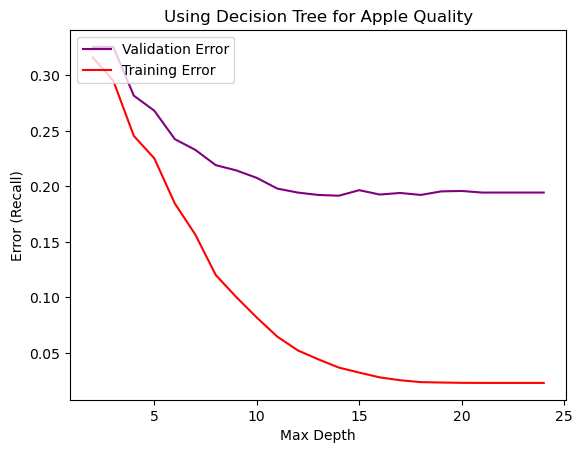

In [212]:
# [APPLE QUALITY] Varying min sample per leaf and analyzing performance
acc_a_train = []
acc_a_test = []
list_y = []
for y in range(2,25):
    test,train = dtree_learner(x_train_a, x_test_a, y_train_a, y_test_a, crit = "entropy", max_dep = y)
    acc_a_train.append(1-train)
    acc_a_test.append(1-test)
    list_y.append(y)

plt.clf()
plt.title('Using Decision Tree for Apple Quality')
plt.xlabel("Max Depth")
plt.ylabel("Error (Recall)")
plt.locator_params(axis='x')
plt.locator_params(axis='y')
plt.plot(list_y, acc_a_test, color='purple', label='Validation Error')
plt.plot(list_y, acc_a_train, color='red', label='Training Error')
plt.legend(loc="upper left")
plt.savefig('Apple Quality_Decision Tree Error.png',
            bbox_inches='tight')

plt.show()

# 1.2 Using GridSearchCV to identify the best results for comparison between the 2 dataset 

In [224]:
start_time = time.time()

recall_scorer = make_scorer(recall_score, average='macro')

clf = DecisionTreeClassifier(random_state = 42, criterion = 'entropy')
params_grid = {
    'max_leaf_nodes': list(range(2, 160, 10)),
    'max_depth': list(range(2, 30,5)),
    'min_samples_split': list(range(2,100,5)),
    'min_samples_leaf': list(range(2,100,5))
}

stratified_kfold = StratifiedKFold(n_splits=5, shuffle=True, random_state=42)

grid_search  = GridSearchCV(estimator=clf, param_grid=params_grid, scoring='recall', cv=stratified_kfold, verbose=1)
grid_search.fit(x_train_w, y_train_w)

# Print the best parameters and corresponding accuracy
print("Best Parameters: ", grid_search.best_params_)
print("Best Accuracy: {:.2f}%".format(grid_search.best_score_ * 100))

# Get the best model
best_model = grid_search.best_estimator_

# Evaluate the best model on the test set
test_accuracy = best_model.score(x_test_w, y_test_w)

print("Test Accuracy: {:.2f}%".format(test_accuracy * 100))

end_time = time.time()

# Calculate the elapsed time
elapsed_time = end_time - start_time

# Print the elapsed time in seconds
print("Elapsed Time: {:.2f} seconds".format(elapsed_time))

Fitting 5 folds for each of 38400 candidates, totalling 192000 fits
Best Parameters:  {'max_depth': 17, 'max_leaf_nodes': 142, 'min_samples_leaf': 7, 'min_samples_split': 17}
Best Accuracy: 53.30%
Test Accuracy: 53.74%
Elapsed Time: 2901.28 seconds


In [222]:
start_time = time.time()

recall_scorer = make_scorer(recall_score, average='macro')

clf = DecisionTreeClassifier(random_state = 42, criterion = 'entropy')
params_grid = {
    'max_leaf_nodes': list(range(2, 160, 10)),
    'max_depth': list(range(2, 30,5)),
    'min_samples_split': list(range(2,100,5)),
    'min_samples_leaf': list(range(2,100,5))
}

stratified_kfold = StratifiedKFold(n_splits=5, shuffle=True, random_state=42)

grid_search  = GridSearchCV(estimator=clf, param_grid=params_grid, scoring=recall_scorer, cv=stratified_kfold, verbose=1)
grid_search.fit(x_train_a, y_train_a)

# Print the best parameters and corresponding accuracy
print("Best Parameters: ", grid_search.best_params_)
print("Best Accuracy: {:.2f}%".format(grid_search.best_score_ * 100))

# Get the best model
best_model = grid_search.best_estimator_

# Evaluate the best model on the test set
test_accuracy = best_model.score(x_test_a, y_test_a)
print("Test Accuracy: {:.2f}%".format(test_accuracy * 100))

end_time = time.time()

# Calculate the elapsed time
elapsed_time = end_time - start_time

# Print the elapsed time in seconds
print("Elapsed Time: {:.2f} seconds".format(elapsed_time))

Fitting 5 folds for each of 38400 candidates, totalling 192000 fits
Best Parameters:  {'max_depth': 12, 'max_leaf_nodes': 152, 'min_samples_leaf': 2, 'min_samples_split': 2}
Best Accuracy: 81.49%
Test Accuracy: 80.75%
Elapsed Time: 3847.50 seconds


# 1.3 Decision Trees further experimentation - Could this be due to multi class issue? What happens if we create binary target field?

In [265]:
def dataframe_cleanup_wine(df):
    # Define the values you want to drop
    values_to_drop = []

    # Drop rows where the 'column_name' has values in 'values_to_drop'
    df = df[~df['quality'].isin(values_to_drop)]
    
    return(df)

def categorize(value):
    return 'Good' if value >= 3 else 'Bad'

wine,aq = data_ingestion()
wine = dataframe_cleanup_wine(wine)

# Apply the function to the 'values' column
wine['category'] = wine['quality'].apply(lambda x: categorize(x))
wine = wine.drop(['quality'], axis = 1) 
new_headers = {'category': 'quality'}

# Rename the columns
wine = wine.rename(columns=new_headers)

x_train_w, x_test_w, y_train_w, y_test_w, x_train_a, x_test_a, y_train_a, y_test_a = train_test(wine,aq)

start_time = time.time()

clf = DecisionTreeClassifier(random_state = 42, criterion = 'entropy')
params_grid = {
    'min_samples_leaf': list(range(2, 160, 10)),
    'max_leaf_nodes': list(range(75, 180, 10))
#     ,
#     'min_samples_split': list(range(0, 20)),
#     'min_samples_leaf': list(range(0, 20))
}

stratified_kfold = StratifiedKFold(n_splits=5, shuffle=True, random_state=42)

grid_search  = GridSearchCV(estimator=clf, param_grid=params_grid, scoring='recall', cv=stratified_kfold, verbose=1)

grid_search.fit(x_train_w, y_train_w)

# Print the best parameters and corresponding accuracy
print("Best Parameters: ", grid_search.best_params_)
print("Best Accuracy: {:.2f}%".format(grid_search.best_score_ * 100))

# Get the best model
best_model = grid_search.best_estimator_

# Evaluate the best model on the test set
test_accuracy = best_model.score(x_test_w, y_test_w)
print("Test Accuracy: {:.2f}%".format(test_accuracy * 100))

end_time = time.time()

# Calculate the elapsed time
elapsed_time = end_time - start_time

# Print the elapsed time in seconds
print("Elapsed Time: {:.2f} seconds".format(elapsed_time))

Fitting 5 folds for each of 176 candidates, totalling 880 fits
Best Parameters:  {'max_leaf_nodes': 155, 'min_samples_leaf': 2}
Best Accuracy: 75.50%
Test Accuracy: 77.82%
Elapsed Time: 24.07 seconds


<Figure size 640x480 with 0 Axes>

# 1.4 Decision Trees further experimentation - Could this be due unbalanced dataset classes? What happens if we try to make the number of observation per class more consistent?

In [277]:
def dataframe_cleanup_wine(df):
    # Removing all other values except class 5, 6
    values_to_drop = [4,5,6]

    # Drop rows where the 'column_name' has values in 'values_to_drop'
    df = df[~df['quality'].isin(values_to_drop)]
    
    return(df)

def categorize(value):
    return 'Good' if value >= 3 else 'Bad'

wine,aq = data_ingestion()
wine = dataframe_cleanup_wine(wine)

# Apply the function to the 'values' column
wine['category'] = wine['quality'].apply(lambda x: categorize(x))
wine = wine.drop(['quality'], axis = 1) 
new_headers = {'category': 'quality'}

# Rename the columns
wine = wine.rename(columns=new_headers)

x_train_w, x_test_w, y_train_w, y_test_w, x_train_a, x_test_a, y_train_a, y_test_a = train_test(wine,aq)

start_time = time.time()

clf = DecisionTreeClassifier(random_state = 42, criterion = 'entropy')
params_grid = {
    'min_samples_leaf': list(range(2, 160, 10)),
    'max_leaf_nodes': list(range(75, 180, 10))
#     ,
#     'min_samples_split': list(range(0, 20)),
#     'min_samples_leaf': list(range(0, 20))
}

stratified_kfold = StratifiedKFold(n_splits=5, shuffle=True, random_state=42)

grid_search  = GridSearchCV(estimator=clf, param_grid=params_grid, scoring='recall_weighted', cv=stratified_kfold, verbose=1)

grid_search.fit(x_train_w, y_train_w)

# Print the best parameters and corresponding accuracy
print("Best Parameters: ", grid_search.best_params_)
print("Best Accuracy: {:.2f}%".format(grid_search.best_score_ * 100))

# Get the best model
best_model = grid_search.best_estimator_

# Evaluate the best model on the test set
test_accuracy = best_model.score(x_test_w, y_test_w)
print("Test Accuracy: {:.2f}%".format(test_accuracy * 100))

end_time = time.time()

# Calculate the elapsed time
elapsed_time = end_time - start_time

# Print the elapsed time in seconds
print("Elapsed Time: {:.2f} seconds".format(elapsed_time))

Fitting 5 folds for each of 176 candidates, totalling 880 fits
Best Parameters:  {'max_leaf_nodes': 175, 'min_samples_leaf': 2}
Best Accuracy: 68.95%
Test Accuracy: 71.70%
Elapsed Time: 19.42 seconds


<Figure size 640x480 with 0 Axes>

# 1.5 Final run for Wine Quality and Apple Quality and Wall Clock Times

In [233]:
# Wine Quality

wine,aq = data_ingestion()
x_train_w, x_test_w, y_train_w, y_test_w, x_train_a, x_test_a, y_train_a, y_test_a = train_test(wine,aq)

start_time = time.time()
test,train = dtree_learner(x_train_w, x_test_w, y_train_w, y_test_w, crit = "entropy", max_leaf_nd = 345, min_samples_lf = 2)
print('Best accuracy:', test)
end_time = time.time()
# Calculate the elapsed time
elapsed_time = end_time - start_time
print("Elapsed Time: {:.2f} seconds".format(elapsed_time))

Best accuracy: 0.53530335596178
Elapsed Time: 0.22 seconds


<Figure size 640x480 with 0 Axes>

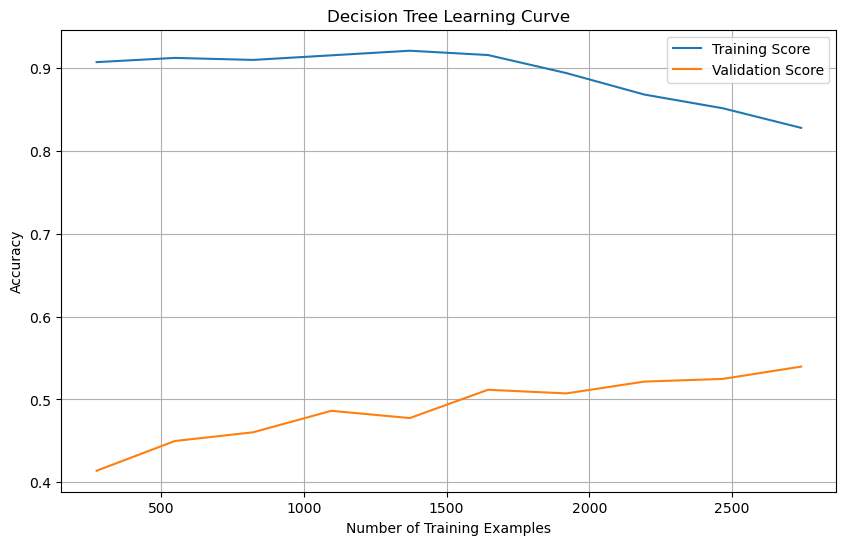

In [263]:
clf = DecisionTreeClassifier(random_state=42, criterion = 'entropy', min_samples_leaf = 2, max_leaf_nodes = 345)
stratified_kfold = StratifiedKFold(n_splits=num_folds, shuffle=True,random_state = 42)

train_sizes, train_scores, test_scores = learning_curve(
    clf, x_train_w, y_train_w, cv=stratified_kfold, scoring='recall', train_sizes=np.linspace(0.1, 1.0, 10)
)

# Calculate mean and standard deviation for training and test scores
train_scores_mean = np.mean(train_scores, axis=1)
train_scores_std = np.std(train_scores, axis=1)
test_scores_mean = np.mean(test_scores, axis=1)
test_scores_std = np.std(test_scores, axis=1)

# Plot the learning curve
plt.figure(figsize=(10, 6))
plt.plot(train_sizes, train_scores_mean, label='Training Score')
# plt.fill_between(train_sizes, train_scores_mean - train_scores_std, train_scores_mean + train_scores_std, alpha=0.2)
plt.plot(train_sizes, test_scores_mean, label='Validation Score')
# plt.fill_between(train_sizes, test_scores_mean - test_scores_std, test_scores_mean + test_scores_std, alpha=0.2)

# Customize the plot
plt.title('Decision Tree Learning Curve')
plt.xlabel('Number of Training Examples')
plt.ylabel('Accuracy')
plt.legend()
plt.grid(True)
plt.show()

In [266]:
# Apple Quality

wine,aq = data_ingestion()
x_train_w, x_test_w, y_train_w, y_test_w, x_train_a, x_test_a, y_train_a, y_test_a = train_test(wine,aq)
# Apple Quality
start_time = time.time()
test,train = dtree_learner(x_train_a, x_test_a, y_train_a, y_test_a, crit = "entropy", min_samples_lf = 2, max_leaf_nd = 155)
print('Best accuracy:', test)
end_time = time.time()
# Calculate the elapsed time
elapsed_time = end_time - start_time
print("Elapsed Time: {:.2f} seconds".format(elapsed_time))

Best accuracy: 0.8114285714285714
Elapsed Time: 0.27 seconds


<Figure size 640x480 with 0 Axes>

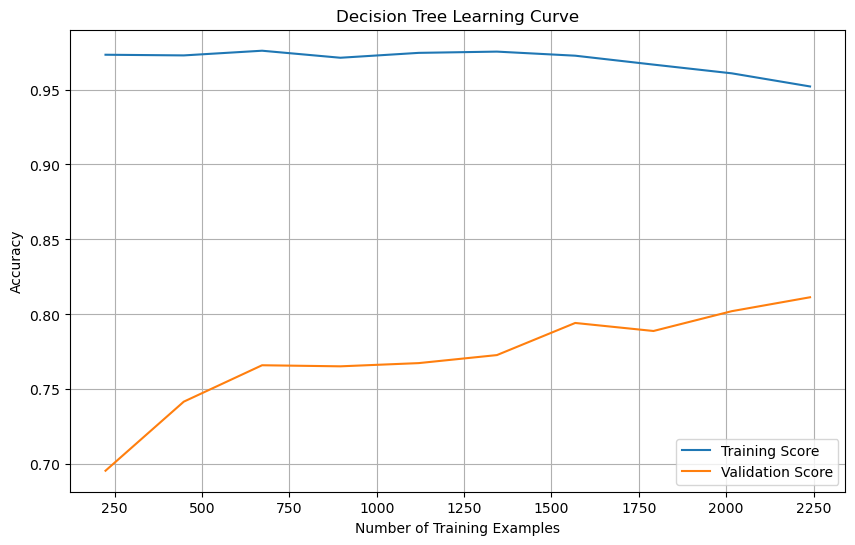

In [267]:
clf = DecisionTreeClassifier(random_state=42, criterion = 'entropy', min_samples_leaf = 2, max_leaf_nodes = 155)
stratified_kfold = StratifiedKFold(n_splits=num_folds, shuffle=True,random_state = 42)

train_sizes, train_scores, test_scores = learning_curve(
    clf, x_train_a, y_train_a, cv=stratified_kfold, scoring='recall', train_sizes=np.linspace(0.1, 1.0, 10)
)

# Calculate mean and standard deviation for training and test scores
train_scores_mean = np.mean(train_scores, axis=1)
train_scores_std = np.std(train_scores, axis=1)
test_scores_mean = np.mean(test_scores, axis=1)
test_scores_std = np.std(test_scores, axis=1)

# Plot the learning curve
plt.figure(figsize=(10, 6))
plt.plot(train_sizes, train_scores_mean, label='Training Score')
# plt.fill_between(train_sizes, train_scores_mean - train_scores_std, train_scores_mean + train_scores_std, alpha=0.2)
plt.plot(train_sizes, test_scores_mean, label='Validation Score')
# plt.fill_between(train_sizes, test_scores_mean - test_scores_std, test_scores_mean + test_scores_std, alpha=0.2)

# Customize the plot
plt.title('Decision Tree Learning Curve')
plt.xlabel('Number of Training Examples')
plt.ylabel('Accuracy')
plt.legend()
plt.grid(True)
plt.show()

In [ ]:
# Conclusion from experiment:
# Q: Some thoughts, why do the decision tree multi-class perform worse than binary class? What happens if we change the multi-class into binary classes?
# A: yes binary classes are easier to split and once we binary classed our dataset, we have very good results

# Some thoughts, could it be that unbalanced data caused this difference in error rates?
# A: Improved from a multi-class situation - however, balancing the dataset does not help with reducing error rates.

# Time taken for smaller dataset is faster - no shit?

# 2.0 Boosting (Decision Trees)

In [82]:
def boost(x_train, x_test, y_train, y_test, n_esti = 50, lr = 1, max_dep = 5, num_folds = 5):
    
    # Create a Gradient Boosting Classifier
    clf = AdaBoostClassifier(estimator = DecisionTreeClassifier(max_depth=max_dep), n_estimators=n_esti, learning_rate=lr, random_state=42)
    
    # Strateified KFold
    validation, training = strat_kfold(clf, num_folds, x_train, y_train)
    
    return(validation,training)

#     # Tain the model
#     clf.fit(x_train, y_train)
    
#     # Make predictions on the test set
#     y_pred = clf.predict(x_test)

#     # Evaluating accuracy for test dataset
#     accuracy = accuracy_score(y_test, y_pred)
#     error_test = 1 - accuracy
    
#     # Make predictions on the test set
#     y_pred = clf.predict(x_train)
    
#     # Evaluating accuracy for train dataset
#     accuracy = accuracy_score(y_train, y_pred)
#     error_train = 1 - accuracy
    
#     return(error_test,error_train)

In [332]:
def xgboost(x_train, x_test, y_train, y_test, objective, num_class, max_depth, n_estimators):
    
    # Create a Gradient Boosting Classifier
#     objective='binary:logistic', objective='multi:softmax'
    if objective == 'binary:logistic':
        clf = xgb.XGBClassifier(objective=objective,max_depth = max_depth, n_estimators = n_estimators, random_state=42)
    else:
        clf = xgb.XGBClassifier(objective=objective,max_depth = max_depth, num_class=num_class, n_estimators = n_estimators, random_state=42)
    
    # Strateified KFold
    validation, training = strat_kfold(clf, num_folds, x_train, y_train)
    
    return(validation,training)

In [83]:
# Calling data ingestion function and calling the function to split dataset
wine,aq = data_ingestion()
x_train_w, x_test_w, y_train_w, y_test_w, x_train_a, x_test_a, y_train_a, y_test_a = train_test(wine,aq)

<Figure size 640x480 with 0 Axes>

# 2.1 Boosting Decision Trees Experimentation - Varying Number of Estimators and Max Depth

100
200
300
400
500
600
700
800
900
1000
1100
1200
1300
1400


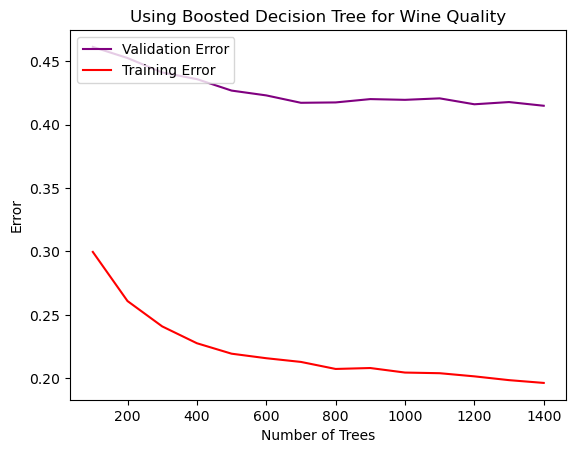

In [84]:
# [WINE QUALITY] Varying number of trees and analyzing performance
acc_w_train = []
acc_w_test = []
list_x = []
for x in range(100,1500,100):
    test,train = boost(x_train_w, x_test_w, y_train_w, y_test_w, n_esti = x)
    acc_w_train.append(1-train)
    acc_w_test.append(1-test)
    list_x.append(x)
    print(x)


plt.clf()
plt.title('Using Boosted Decision Tree for Wine Quality')
plt.xlabel("Number of Trees")
plt.ylabel("Error")
plt.locator_params(axis='x')
plt.locator_params(axis='y')
plt.plot(list_x, acc_w_test, color='purple', label='Validation Error')
plt.plot(list_x, acc_w_train, color='red', label='Training Error')
plt.legend(loc="upper left")
# plt.savefig('Wine Quality_Decision Tree Error.png',
#             bbox_inches='tight')
plt.show()

In [85]:
# XGBOOST [WINE QUALITY] Varying number of trees and analyzing performance
acc_w_train = []
acc_w_test = []
list_x = []
for x in range(1,180,10):
    test,train = xgboost(x_train_w, x_test_w, y_train_w, y_test_w, objective = 'multi:softmax', num_class=7, max_depth = 4, n_estimators=x)
#     test,train = (x_train_w, x_test_w, y_train_w, y_test_w, n_esti = x)
    acc_w_train.append(1-train)
    acc_w_test.append(1-test)
    list_x.append(x)
    print(x)


plt.clf()
plt.title('Using Boosted Decision Tree for Wine Quality')
plt.xlabel("Number of Trees")
plt.ylabel("Error")
plt.locator_params(axis='x')
plt.locator_params(axis='y')
plt.plot(list_x, acc_w_test, color='purple', label='Validation Error')
plt.plot(list_x, acc_w_train, color='red', label='Training Error')
plt.legend(loc="upper left")
# plt.savefig('Wine Quality_Decision Tree Error.png',
#             bbox_inches='tight')
plt.show()

NameError: name 'xgboost' is not defined

0.7417857142857143 0.7741964285714287
1
0.8235714285714286 0.924017857142857
6
0.8246428571428572 0.9752678571428571
11
0.8253571428571428 0.9958035714285713
16
0.8274999999999999 1.0
21
0.8278571428571428 1.0
26


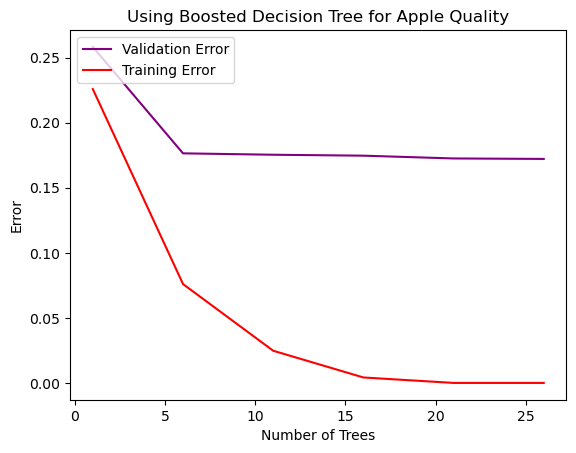

In [116]:
# [APPLE QUALITY] Varying number of trees and analyzing performance
acc_a_train = []
acc_a_test = []
list_y = []
for y in range(1,30,5):
    test,train = boost(x_train_a, x_test_a, y_train_a, y_test_a, n_esti = y)
    print(test,train)
    acc_a_train.append(1-train)
    acc_a_test.append(1-test)
    list_y.append(y)
    print(y)

plt.clf()
plt.title('Using Boosted Decision Tree for Apple Quality')
plt.xlabel("Number of Trees")
plt.ylabel("Error")
plt.locator_params(axis='x')
plt.locator_params(axis='y')
plt.plot(list_y, acc_a_test, color='purple', label='Validation Error')
plt.plot(list_y, acc_a_train, color='red', label='Training Error')
plt.legend(loc="upper left")
# plt.savefig('Apple Quality_Decision Tree Error.png',
#             bbox_inches='tight')

plt.show()

0.8807142857142857 1.0
0.8807142857142857 1.0
0.8807142857142857 1.0
0.8807142857142857 1.0


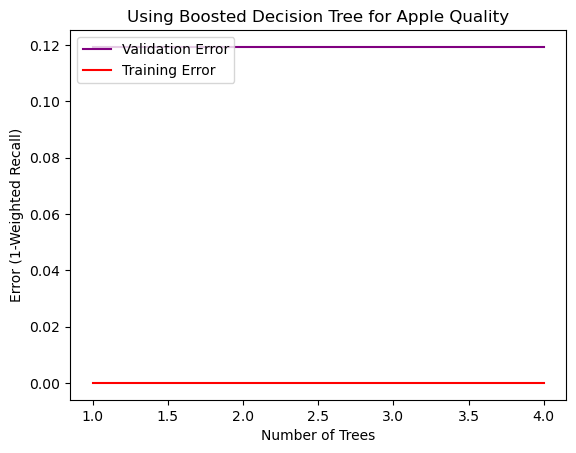

In [336]:
# XGBOOST [APPLE QUALITY] Varying number of trees and analyzing performance
acc_a_train = []
acc_a_test = []
list_y = []
for y in range(1,5):
    test,train = xgboost(x_train_a, x_test_a, y_train_a, y_test_a, objective='binary:logistic', num_class = 2, max_depth = 10, n_estimators=x)
    acc_a_train.append(1-train)
    acc_a_test.append(1-test)
    list_y.append(y)

plt.clf()
plt.title('Using Boosted Decision Tree for Apple Quality')
plt.xlabel("Number of Trees")
plt.ylabel("Error (1-Weighted Recall)")
plt.locator_params(axis='x')
plt.locator_params(axis='y')
plt.plot(list_y, acc_a_test, color='purple', label='Validation Error')
plt.plot(list_y, acc_a_train, color='red', label='Training Error')
plt.legend(loc="upper left")
# plt.savefig('Apple Quality_Decision Tree Error.png',
#             bbox_inches='tight')

plt.show()

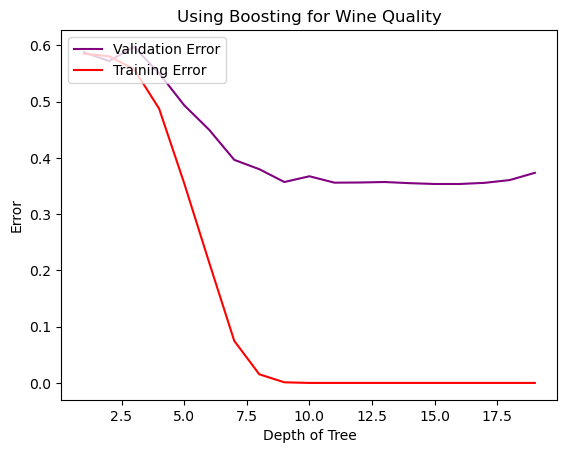

In [89]:
# [WINE QUALITY] Varying max depth of decision trees and analyzing performance
acc_w_train = []
acc_w_test = []
list_x = []
for x in range(1, 20):
    test,train = boost(x_train_w, x_test_w, y_train_w, y_test_w, n_esti = 50, lr = 1, max_dep = x)
    acc_w_train.append(1-train)
    acc_w_test.append(1-test)
    list_x.append(x)
#     print(x)
# print(acc_w_train)
# print(acc_w_test)

plt.clf()
plt.title('Using Boosting for Wine Quality')
plt.xlabel("Depth of Tree")
plt.ylabel("Error")
plt.locator_params(axis='x')
plt.locator_params(axis='y')
plt.plot(list_x, acc_w_test, color='purple', label='Validation Error')
plt.plot(list_x, acc_w_train, color='red', label='Training Error')
plt.legend(loc="upper left")
# plt.savefig('Wine Quality_Decision Tree Error.png',
#             bbox_inches='tight')
plt.show()

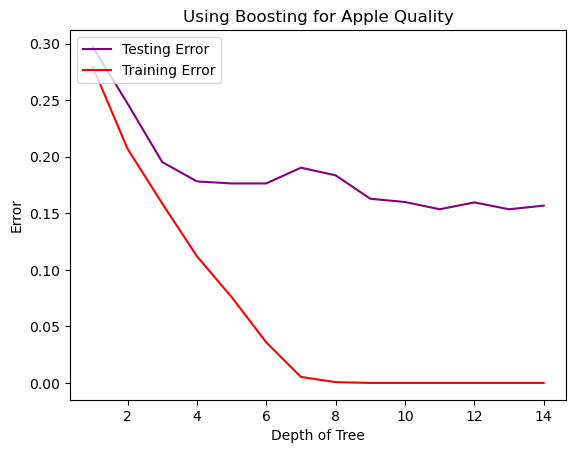

In [122]:
# [APPLE QUALITY] Varying max leaf nodes and analyzing performance
acc_a_train = []
acc_a_test = []
list_y = []
for y in range(1,15):
    test,train = boost(x_train_a, x_test_a, y_train_a, y_test_a, n_esti = 6, lr = 1, max_dep = y)
    acc_a_train.append(1-train)
    acc_a_test.append(1-test)
    list_y.append(y)

plt.clf()
plt.title('Using Boosting for Apple Quality')
plt.xlabel("Depth of Tree")
plt.ylabel("Error")
plt.locator_params(axis='x')
plt.locator_params(axis='y')
plt.plot(list_y, acc_a_test, color='purple', label='Testing Error')
plt.plot(list_y, acc_a_train, color='red', label='Training Error')
plt.legend(loc="upper left")
# plt.savefig('Apple Quality_Decision Tree Error.png',
#             bbox_inches='tight')

plt.show()

# 2.2 Using GridSearchCV to identify the best results for comparison between the 2 dataset

In [158]:
start_time = time.time()

# Base estimator parameters
base_estimator_params = {'max_depth': list(range(0,20))} 

# Specify the range of n_estimators for the AdaBoost classifier
adaboost_params = {'n_estimators': list(range(50,1000,50))}

# Create the parameter grid
param_grid = {'base_estimator__' + key: value for key, value in base_estimator_params.items()}
param_grid.update(adaboost_params)

base_estimator = DecisionTreeClassifier(random_state=42)
adaboost_clf = AdaBoostClassifier(base_estimator=base_estimator, random_state=42)

# Create the GridSearchCV object
grid_search = GridSearchCV(estimator=adaboost_clf,
                           param_grid=param_grid,
                           scoring='accuracy',
                           verbose=1,
                           cv=5)

grid_search.fit(x_train_w, y_train_w)

# Print the best parameters and corresponding accuracy
print("Best Parameters: ", grid_search.best_params_)
print("Best Accuracy: {:.2f}%".format(grid_search.best_score_ * 100))

# Get the best model
best_model = grid_search.best_estimator_

# Evaluate the best model on the test set
test_accuracy = best_model.score(x_test_w, y_test_w)
print("Test Accuracy: {:.2f}%".format(test_accuracy * 100))

end_time = time.time()

# Calculate the elapsed time
elapsed_time = end_time - start_time

# Print the elapsed time in seconds
print("Elapsed Time: {:.2f} seconds".format(elapsed_time))

Fitting 5 folds for each of 380 candidates, totalling 1900 fits
Best Parameters:  {'base_estimator__max_depth': 10, 'n_estimators': 850}
Best Accuracy: 66.81%
Test Accuracy: 67.28%
Elapsed Time: 220800.37 seconds


In [159]:
start_time = time.time()

# Base estimator parameters
base_estimator_params = {'max_depth': list(range(0,20))} 

# Specify the range of n_estimators for the AdaBoost classifier
adaboost_params = {'n_estimators': list(range(50,1000,50))}

# Create the parameter grid
param_grid = {'base_estimator__' + key: value for key, value in base_estimator_params.items()}
param_grid.update(adaboost_params)

base_estimator = DecisionTreeClassifier(random_state=42)
adaboost_clf = AdaBoostClassifier(base_estimator=base_estimator, random_state=42)

# Create the GridSearchCV object
grid_search = GridSearchCV(estimator=adaboost_clf,
                           param_grid=param_grid,
                           scoring='accuracy',
                           verbose=1,
                           cv=5)
grid_search.fit(x_train_a, y_train_a)

# Print the best parameters and corresponding accuracy
print("Best Parameters: ", grid_search.best_params_)
print("Best Accuracy: {:.2f}%".format(grid_search.best_score_ * 100))

# Get the best model
best_model = grid_search.best_estimator_

# Evaluate the best model on the test set
test_accuracy = best_model.score(x_test_a, y_test_a)
print("Test Accuracy: {:.2f}%".format(test_accuracy * 100))

end_time = time.time()

# Calculate the elapsed time
elapsed_time = end_time - start_time

# Print the elapsed time in seconds
print("Elapsed Time: {:.2f} seconds".format(elapsed_time))

Fitting 5 folds for each of 380 candidates, totalling 1900 fits
Best Parameters:  {'base_estimator__max_depth': 6, 'n_estimators': 900}
Best Accuracy: 89.57%
Test Accuracy: 90.00%
Elapsed Time: 111971.89 seconds


# 2.3 Boosted Decision Trees further experimentation - Could this be due to multi class issue? What happens if we create a binary field instead as the target variable?

In [160]:
wine,aq = data_ingestion()
wine = dataframe_cleanup_wine(wine)
x_train_w, x_test_w, y_train_w, y_test_w, x_train_a, x_test_a, y_train_a, y_test_a = train_test(wine,aq)

# Apply the function to the 'values' column
y_train_w = y_train_w.apply(lambda x: categorize(x))
y_test_w = y_test_w.apply(lambda x: categorize(x))

start_time = time.time()

# Base estimator parameters
base_estimator_params = {'max_depth': list(range(0,20))} 

# Specify the range of n_estimators for the AdaBoost classifier
adaboost_params = {'n_estimators': list(range(50,1000,50))}

# Create the parameter grid
param_grid = {'base_estimator__' + key: value for key, value in base_estimator_params.items()}
param_grid.update(adaboost_params)

base_estimator = DecisionTreeClassifier(random_state=42)
adaboost_clf = AdaBoostClassifier(base_estimator=base_estimator, random_state=42)

# Create the GridSearchCV object
grid_search = GridSearchCV(estimator=adaboost_clf,
                           param_grid=param_grid,
                           scoring='accuracy',
                           verbose=1,
                           cv=5)
grid_search.fit(x_train_w, y_train_w)

# Print the best parameters and corresponding accuracy
print("Best Parameters: ", grid_search.best_params_)
print("Best Accuracy: {:.2f}%".format(grid_search.best_score_ * 100))

# Get the best model
best_model = grid_search.best_estimator_

# Evaluate the best model on the test set
test_accuracy = best_model.score(x_test_w, y_test_w)
print("Test Accuracy: {:.2f}%".format(test_accuracy * 100))

end_time = time.time()

# Calculate the elapsed time
elapsed_time = end_time - start_time

# Print the elapsed time in seconds
print("Elapsed Time: {:.2f} seconds".format(elapsed_time))

Fitting 5 folds for each of 380 candidates, totalling 1900 fits
Best Parameters:  {'base_estimator__max_depth': 10, 'n_estimators': 350}
Best Accuracy: 82.23%
Test Accuracy: 82.46%
Elapsed Time: 68679.96 seconds


<Figure size 640x480 with 0 Axes>

# 2.4 Boosted Decision Trees further experimentation - Could this be due unbalanced dataset classes? What happens if we try to make the number of observation per class more consistent?

In [4]:
def dataframe_cleanup_wine(df):
    # Removing the top 3 classes that have low counts
    values_to_drop = [4,5,6]

    # Drop rows where the 'column_name' has values in 'values_to_drop'
    df = df[~df['quality'].isin(values_to_drop)]
    
    return(df)

def categorize(value):
    return 'Good' if value >= 3 else 'Bad'

wine,aq = data_ingestion()
wine = dataframe_cleanup_wine(wine)

# Apply the function to the 'values' column
wine['category'] = wine['quality'].apply(lambda x: categorize(x))
wine = wine.drop(['quality'], axis = 1) 
new_headers = {'category': 'quality'}

# Rename the columns
wine = wine.rename(columns=new_headers)

x_train_w, x_test_w, y_train_w, y_test_w, x_train_a, x_test_a, y_train_a, y_test_a = train_test(wine,aq)

start_time = time.time()

# Base estimator parameters
base_estimator_params = {'max_depth': list(range(0,20))} 

# Specify the range of n_estimators for the AdaBoost classifier
adaboost_params = {'n_estimators': list(range(50,1000,50))}

# Create the parameter grid
param_grid = {'base_estimator__' + key: value for key, value in base_estimator_params.items()}
param_grid.update(adaboost_params)

base_estimator = DecisionTreeClassifier(random_state=42)
adaboost_clf = AdaBoostClassifier(base_estimator=base_estimator, random_state=42)

# Create the GridSearchCV object
grid_search = GridSearchCV(estimator=adaboost_clf,
                           param_grid=param_grid,
                           scoring='accuracy',
                           verbose=1,
                           cv=5)

grid_search.fit(x_train_w, y_train_w)

# Print the best parameters and corresponding accuracy
print("Best Parameters: ", grid_search.best_params_)
print("Best Accuracy: {:.2f}%".format(grid_search.best_score_ * 100))

# Get the best model
best_model = grid_search.best_estimator_

# Evaluate the best model on the test set
test_accuracy = best_model.score(x_test_w, y_test_w)
print("Test Accuracy: {:.2f}%".format(test_accuracy * 100))

end_time = time.time()

# Calculate the elapsed time
elapsed_time = end_time - start_time

# Print the elapsed time in seconds
print("Elapsed Time: {:.2f} seconds".format(elapsed_time))

Fitting 5 folds for each of 380 candidates, totalling 1900 fits


KeyboardInterrupt: 

<Figure size 640x480 with 0 Axes>

# 2.5 Final run for Wine Quality and Apple Quality and Wall Clock Times

In [338]:
# Wine Quality

wine,aq = data_ingestion()
x_train_w, x_test_w, y_train_w, y_test_w, x_train_a, x_test_a, y_train_a, y_test_a = train_test(wine,aq)

start_time = time.time()

test,train = boost(x_train_w, x_test_w, y_train_w, y_test_w, max_dep = 10, n_esti = 850)

print('Best accuracy:', test)
end_time = time.time()
# Calculate the elapsed time
elapsed_time = end_time - start_time
print("Elapsed Time: {:.2f} seconds".format(elapsed_time))

Best accuracy: 0.6569466493583878
Elapsed Time: 122.17 seconds


<Figure size 640x480 with 0 Axes>

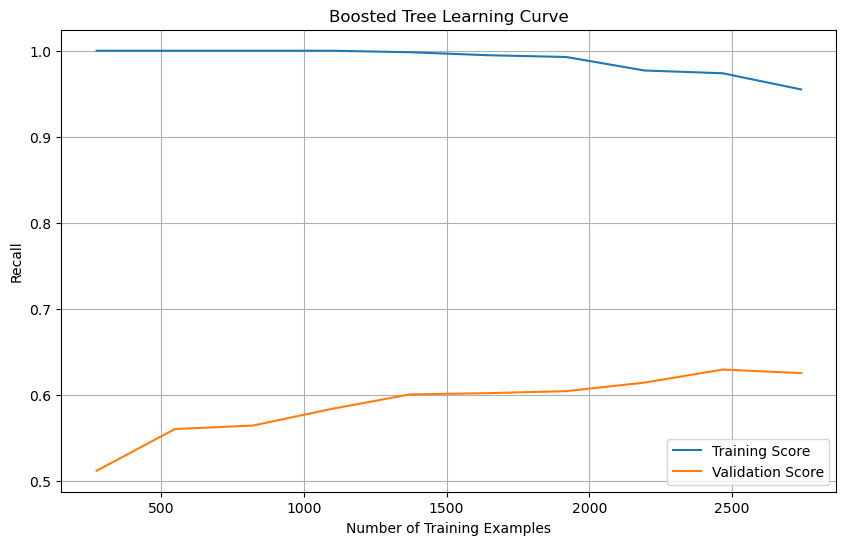

In [124]:
clf = AdaBoostClassifier(estimator = DecisionTreeClassifier(max_depth=10), n_estimators=850, random_state=42)
stratified_kfold = StratifiedKFold(n_splits=5, shuffle=True,random_state = 42)

recall_scorer = make_scorer(recall_score, average='micro')  # 'macro' is used for multiclass problems

train_sizes, train_scores, test_scores = learning_curve(
    clf, x_train_w, y_train_w, cv=stratified_kfold, scoring=recall_scorer, train_sizes=np.linspace(0.1, 1.0, 10)
)

# Calculate mean and standard deviation for training and test scores
train_scores_mean = np.mean(train_scores, axis=1)
train_scores_std = np.std(train_scores, axis=1)
test_scores_mean = np.mean(test_scores, axis=1)
test_scores_std = np.std(test_scores, axis=1)

# Plot the learning curve
plt.figure(figsize=(10, 6))
plt.plot(train_sizes, train_scores_mean, label='Training Score')
# plt.fill_between(train_sizes, train_scores_mean - train_scores_std, train_scores_mean + train_scores_std, alpha=0.2)
plt.plot(train_sizes, test_scores_mean, label='Validation Score')
# plt.fill_between(train_sizes, test_scores_mean -, test_scores_mean + test_scores_std, alpha=0.2)

# Customize the plot
plt.title('Boosted Tree Learning Curve')
plt.xlabel('Number of Training Examples')
plt.ylabel('Recall')
plt.legend()
plt.grid(True)
plt.show()

In [341]:
# Apple Quality
wine,aq = data_ingestion()
x_train_w, x_test_w, y_train_w, y_test_w, x_train_a, x_test_a, y_train_a, y_test_a = train_test(wine,aq)

start_time = time.time()

test,train = boost(x_train_w, x_test_w, y_train_w, y_test_w, max_dep = 6, n_esti = 900)

print('Best accuracy:', test)
end_time = time.time()
# Calculate the elapsed time
elapsed_time = end_time - start_time
print("Elapsed Time: {:.2f} seconds".format(elapsed_time))

Best accuracy: 0.6242667744887319
Elapsed Time: 66.86 seconds


<Figure size 640x480 with 0 Axes>

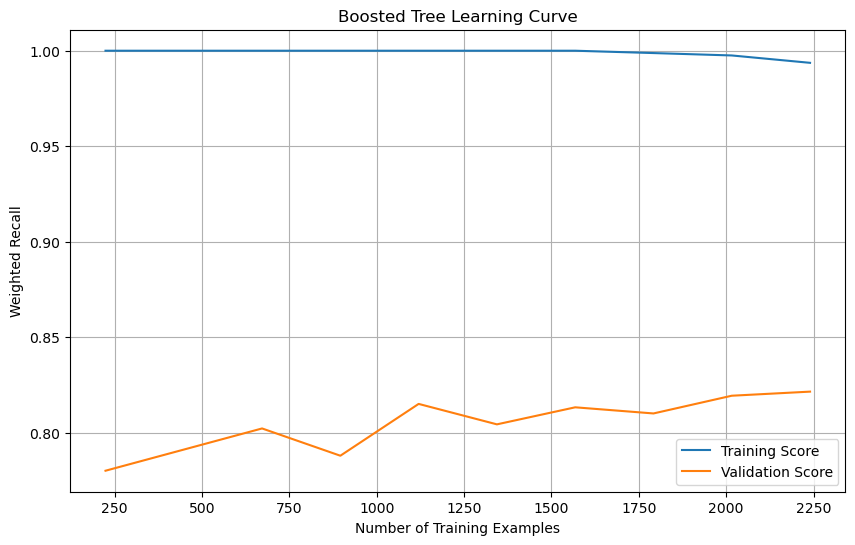

In [130]:
clf = AdaBoostClassifier(estimator = DecisionTreeClassifier(max_depth=6), n_estimators=15, random_state=42)
stratified_kfold = StratifiedKFold(n_splits=5, shuffle=True,random_state = 42)

recall_scorer = make_scorer(recall_score, average='micro')  # 'macro' is used for multiclass problems

train_sizes, train_scores, test_scores = learning_curve(
    clf, x_train_a, y_train_a, cv=stratified_kfold, scoring=recall_scorer, train_sizes=np.linspace(0.1, 1.0, 10)
)

# Calculate mean and standard deviation for training and test scores
train_scores_mean = np.mean(train_scores, axis=1)
train_scores_std = np.std(train_scores, axis=1)
test_scores_mean = np.mean(test_scores, axis=1)
test_scores_std = np.std(test_scores, axis=1)

# Plot the learning curve
plt.figure(figsize=(10, 6))
plt.plot(train_sizes, train_scores_mean, label='Training Score')
# plt.fill_between(train_sizes, train_scores_mean - train_scores_std, train_scores_mean + train_scores_std, alpha=0.2)
plt.plot(train_sizes, test_scores_mean, label='Validation Score')
# plt.fill_between(train_sizes, test_scores_mean - test_scores_std, test_scores_mean + test_scores_std, alpha=0.2)

# Customize the plot
plt.title('Boosted Tree Learning Curve')
plt.xlabel('Number of Training Examples')
plt.ylabel('Weighted Recall')
plt.legend()
plt.grid(True)
plt.show()

# 3.0 Neural Network

In [39]:
wine,aq = data_ingestion()
x_train_w, x_test_w, y_train_w, y_test_w, x_train_a, x_test_a, y_train_a, y_test_a = train_test(wine,aq)

<Figure size 640x480 with 0 Axes>

In [144]:
# WORKING VERSION

x = np.array([[0,0], [0,1], [1,0], [1,1]])
y = np.array([[0], [1], [1], [0]]) 
# Define the network model and its arguments. 
# Set the number of neurons/nodes for each layer:
model = Sequential()
model.add(Dense(2, input_shape=(2,)))
model.add(Activation('sigmoid'))
model.add(Dropout(0.2))
model.add(Dense(1))
model.add(Activation('sigmoid')) 
# Compile the model and calculate its accuracy:
model.compile(loss='binary_crossentropy', optimizer='sgd', metrics=['accuracy'])
# Print a summary of the Keras model:
model.summary()
model.fit(x, y, epochs=5, verbose=1)

# Evaluate the model
loss, accuracy = model.evaluate(x, y)
print(f"Loss: {loss}, Accuracy: {accuracy}")

# def ann(x_train, y_train, epoch, )

Model: "sequential_60"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 dense_394 (Dense)           (None, 2)                 6         
                                                                 
 activation_7 (Activation)   (None, 2)                 0         
                                                                 
 dropout_1 (Dropout)         (None, 2)                 0         
                                                                 
 dense_395 (Dense)           (None, 1)                 3         
                                                                 
 activation_8 (Activation)   (None, 1)                 0         
                                                                 
Total params: 9 (36.00 Byte)
Trainable params: 9 (36.00 Byte)
Non-trainable params: 0 (0.00 Byte)
_________________________________________________________________
Epoch 1/5
1/1 [======

In [34]:
def create_ann(x,y, dataset = "wine", layer_units = [8,4,2], dropout = 0.2, optimizer = Adam(learning_rate=0.001), activation = 'ReLU'):
    np.random.seed(42)
    tf.random.set_seed(42)

    # Set the number of neurons/nodes for each layer:
    model = Sequential()
    model.add(Dense(units=layer_units[0], activation=activation, input_dim=x.shape[1]))
    
    for units in layer_units[1:]:
        model.add(Dense(units=units, activation=activation))
        model.add(Dropout(dropout))

    if dataset == "wine":      
        model.add(Dense(7, activation='softmax'))
        model.compile(loss='sparse_categorical_crossentropy', optimizer=optimizer, metrics=['accuracy'])
    else:
        model.add(Dense(1))
        model.add(Activation('sigmoid'))
        model.compile(loss='binary_crossentropy', optimizer=optimizer, metrics=['accuracy'])

    # Print a summary of the Keras model:
#     model.summary()
    return model
    
def strat_kfold_ann(clf, num_folds, x_train, y_train, dataset = 'wine', epochs = 5):
    # Create a StratifiedKFold object
    stratified_kfold = StratifiedKFold(n_splits=num_folds, shuffle=True,random_state = 42)
    
    # Lists to store training and validation scores for each fold
    training_scores = []
    validation_scores = []
    
    # Iterate over folds
    for fold_num, (train_index, val_index) in enumerate(stratified_kfold.split(x_train, y_train), start=1):


        # Extract training and validation sets for this fold
        X_train_sub, X_val_sub = x_train.iloc[train_index], x_train.iloc[val_index]
        y_train_sub, y_val_sub = y_train.iloc[train_index], y_train.iloc[val_index]
        
        # Train the Decision Tree model
        clf.fit(X_train_sub, y_train_sub, epochs = epochs)

        if dataset == 'wine':
            # Make predictions on the training set
            predictions_train = clf.predict(X_train_sub)
            y_train_pred = np.argmax(predictions_train, axis=1)
            
            # Make predictions on the validation set
            predictions_val = clf.predict(X_val_sub)
            y_val_pred = np.argmax(predictions_val, axis=1)
        else:            
            # Make predictions on the training set
            predictions_train = clf.predict(X_train_sub)
            y_train_pred = (predictions_train > 0.5).astype(int)
            
            # Make predictions on the validation set
            predictions_val = clf.predict(X_val_sub)
            y_val_pred = (predictions_val > 0.5).astype(int)

        # Calculate recall scores for training set
        _, recall_train, _, _ = precision_recall_fscore_support(y_train_sub, y_train_pred, average='micro')
        training_scores.append(recall_train)

        # Calculate recall scores for validation sets
        _, recall_val, _, _ = precision_recall_fscore_support(y_val_sub, y_val_pred, average='micro')
        validation_scores.append(recall_val)

    # Print mean scores across all folds
    mean_training_score = np.mean(training_scores)
    mean_validation_score = np.mean(validation_scores)
#     print(mean_validation_score, mean_training_score)
    return(mean_validation_score, mean_training_score)

tf.random.set_seed(42)


# 3.1 Creating Neural Network - Varying (1) Number of Nodes, (2) Depth and (3) Epochs

Epoch 1/100
86/86 [==============================] - 1s 1ms/step - loss: 1.3584 - accuracy: 0.4624
Epoch 2/100
86/86 [==============================] - 0s 1ms/step - loss: 1.1347 - accuracy: 0.5463
Epoch 3/100
86/86 [==============================] - 0s 1ms/step - loss: 1.0827 - accuracy: 0.5700
Epoch 4/100
86/86 [==============================] - 0s 1ms/step - loss: 1.0580 - accuracy: 0.5700
Epoch 5/100
86/86 [==============================] - 0s 1ms/step - loss: 1.0421 - accuracy: 0.5788
Epoch 6/100
86/86 [==============================] - 0s 1ms/step - loss: 1.0271 - accuracy: 0.5813
Epoch 7/100
86/86 [==============================] - 0s 1ms/step - loss: 1.0152 - accuracy: 0.5872
Epoch 8/100
86/86 [==============================] - 0s 1ms/step - loss: 1.0015 - accuracy: 0.5879
Epoch 9/100
86/86 [==============================] - 0s 1ms/step - loss: 0.9950 - accuracy: 0.5988
Epoch 10/100
86/86 [==============================] - 0s 1ms/step - loss: 0.9880 - accuracy: 0.5974
Epoch 11/

86/86 [==============================] - 0s 1ms/step - loss: 0.6425 - accuracy: 0.7411
Epoch 84/100
86/86 [==============================] - 0s 1ms/step - loss: 0.6400 - accuracy: 0.7327
Epoch 85/100
86/86 [==============================] - 0s 1ms/step - loss: 0.6429 - accuracy: 0.7378
Epoch 86/100
86/86 [==============================] - 0s 1ms/step - loss: 0.6413 - accuracy: 0.7436
Epoch 87/100
86/86 [==============================] - 0s 1ms/step - loss: 0.6352 - accuracy: 0.7451
Epoch 88/100
86/86 [==============================] - 0s 1ms/step - loss: 0.6276 - accuracy: 0.7443
Epoch 89/100
86/86 [==============================] - 0s 1ms/step - loss: 0.6274 - accuracy: 0.7498
Epoch 90/100
86/86 [==============================] - 0s 1ms/step - loss: 0.6268 - accuracy: 0.7484
Epoch 91/100
86/86 [==============================] - 0s 1ms/step - loss: 0.6217 - accuracy: 0.7484
Epoch 92/100
86/86 [==============================] - 0s 1ms/step - loss: 0.6211 - accuracy: 0.7491
Epoch 93/100


86/86 [==============================] - 0s 1ms/step - loss: 0.5109 - accuracy: 0.8096
Epoch 65/100
86/86 [==============================] - 0s 1ms/step - loss: 0.5138 - accuracy: 0.8012
Epoch 66/100
86/86 [==============================] - 0s 1ms/step - loss: 0.5051 - accuracy: 0.8118
Epoch 67/100
86/86 [==============================] - 0s 1ms/step - loss: 0.5242 - accuracy: 0.8009
Epoch 68/100
86/86 [==============================] - 0s 1ms/step - loss: 0.5029 - accuracy: 0.8129
Epoch 69/100
86/86 [==============================] - 0s 1ms/step - loss: 0.5072 - accuracy: 0.8078
Epoch 70/100
86/86 [==============================] - 0s 1ms/step - loss: 0.5063 - accuracy: 0.8100
Epoch 71/100
86/86 [==============================] - 0s 1ms/step - loss: 0.5013 - accuracy: 0.8115
Epoch 72/100
86/86 [==============================] - 0s 1ms/step - loss: 0.5051 - accuracy: 0.8180
Epoch 73/100
86/86 [==============================] - 0s 1ms/step - loss: 0.4939 - accuracy: 0.8129
Epoch 74/100


86/86 [==============================] - 0s 1ms/step - loss: 0.4504 - accuracy: 0.8279
Epoch 46/100
86/86 [==============================] - 0s 1ms/step - loss: 0.4360 - accuracy: 0.8366
Epoch 47/100
86/86 [==============================] - 0s 1ms/step - loss: 0.4292 - accuracy: 0.8381
Epoch 48/100
86/86 [==============================] - 0s 1ms/step - loss: 0.4297 - accuracy: 0.8454
Epoch 49/100
86/86 [==============================] - 0s 1ms/step - loss: 0.4246 - accuracy: 0.8421
Epoch 50/100
86/86 [==============================] - 0s 1ms/step - loss: 0.4247 - accuracy: 0.8446
Epoch 51/100
86/86 [==============================] - 0s 1ms/step - loss: 0.4281 - accuracy: 0.8333
Epoch 52/100
86/86 [==============================] - 0s 1ms/step - loss: 0.4279 - accuracy: 0.8344
Epoch 53/100
86/86 [==============================] - 0s 1ms/step - loss: 0.4113 - accuracy: 0.8461
Epoch 54/100
86/86 [==============================] - 0s 1ms/step - loss: 0.4223 - accuracy: 0.8435
Epoch 55/100


86/86 [==============================] - 0s 1ms/step - loss: 0.3694 - accuracy: 0.8717
Epoch 27/100
86/86 [==============================] - 0s 1ms/step - loss: 0.3714 - accuracy: 0.8637
Epoch 28/100
86/86 [==============================] - 0s 1ms/step - loss: 0.3660 - accuracy: 0.8658
Epoch 29/100
86/86 [==============================] - 0s 1ms/step - loss: 0.3698 - accuracy: 0.8753
Epoch 30/100
86/86 [==============================] - 0s 1ms/step - loss: 0.3516 - accuracy: 0.8720
Epoch 31/100
86/86 [==============================] - 0s 1ms/step - loss: 0.3592 - accuracy: 0.8702
Epoch 32/100
86/86 [==============================] - 0s 1ms/step - loss: 0.3704 - accuracy: 0.8720
Epoch 33/100
86/86 [==============================] - 0s 1ms/step - loss: 0.3641 - accuracy: 0.8695
Epoch 34/100
86/86 [==============================] - 0s 1ms/step - loss: 0.3636 - accuracy: 0.8720
Epoch 35/100
86/86 [==============================] - 0s 1ms/step - loss: 0.3575 - accuracy: 0.8742
Epoch 36/100


86/86 [==============================] - 0s 1ms/step - loss: 0.3343 - accuracy: 0.8870
Epoch 8/100
86/86 [==============================] - 0s 1ms/step - loss: 0.3321 - accuracy: 0.8786
Epoch 9/100
86/86 [==============================] - 0s 1ms/step - loss: 0.3346 - accuracy: 0.8786
Epoch 10/100
86/86 [==============================] - 0s 1ms/step - loss: 0.3362 - accuracy: 0.8760
Epoch 11/100
86/86 [==============================] - 0s 1ms/step - loss: 0.3216 - accuracy: 0.8863
Epoch 12/100
86/86 [==============================] - 0s 1ms/step - loss: 0.3177 - accuracy: 0.8899
Epoch 13/100
86/86 [==============================] - 0s 1ms/step - loss: 0.3206 - accuracy: 0.8884
Epoch 14/100
86/86 [==============================] - 0s 1ms/step - loss: 0.3339 - accuracy: 0.8863
Epoch 15/100
86/86 [==============================] - 0s 1ms/step - loss: 0.3119 - accuracy: 0.8866
Epoch 16/100
86/86 [==============================] - 0s 1ms/step - loss: 0.2962 - accuracy: 0.8881
Epoch 17/100
86

86/86 [==============================] - 0s 1ms/step - loss: 0.2031 - accuracy: 0.9326
Epoch 90/100
86/86 [==============================] - 0s 1ms/step - loss: 0.2256 - accuracy: 0.9260
Epoch 91/100
86/86 [==============================] - 0s 1ms/step - loss: 0.2142 - accuracy: 0.9358
Epoch 92/100
86/86 [==============================] - 0s 1ms/step - loss: 0.2179 - accuracy: 0.9307
Epoch 93/100
86/86 [==============================] - 0s 1ms/step - loss: 0.2199 - accuracy: 0.9318
Epoch 94/100
86/86 [==============================] - 0s 1ms/step - loss: 0.2260 - accuracy: 0.9322
Epoch 95/100
86/86 [==============================] - 0s 1ms/step - loss: 0.2183 - accuracy: 0.9249
Epoch 96/100
86/86 [==============================] - 0s 1ms/step - loss: 0.2096 - accuracy: 0.9366
Epoch 97/100
86/86 [==============================] - 0s 1ms/step - loss: 0.2137 - accuracy: 0.9296
Epoch 98/100
86/86 [==============================] - 0s 1ms/step - loss: 0.2090 - accuracy: 0.9322
Epoch 99/100


86/86 [==============================] - 0s 1ms/step - loss: 0.2586 - accuracy: 0.9059
Epoch 51/100
86/86 [==============================] - 0s 1ms/step - loss: 0.2418 - accuracy: 0.9179
Epoch 52/100
86/86 [==============================] - 0s 1ms/step - loss: 0.2341 - accuracy: 0.9230
Epoch 53/100
86/86 [==============================] - 0s 1ms/step - loss: 0.2278 - accuracy: 0.9260
Epoch 54/100
86/86 [==============================] - 0s 1ms/step - loss: 0.2393 - accuracy: 0.9212
Epoch 55/100
86/86 [==============================] - 0s 1ms/step - loss: 0.2395 - accuracy: 0.9267
Epoch 56/100
86/86 [==============================] - 0s 1ms/step - loss: 0.2381 - accuracy: 0.9194
Epoch 57/100
86/86 [==============================] - 0s 1ms/step - loss: 0.2249 - accuracy: 0.9282
Epoch 58/100
86/86 [==============================] - 0s 1ms/step - loss: 0.2356 - accuracy: 0.9256
Epoch 59/100
86/86 [==============================] - 0s 1ms/step - loss: 0.2305 - accuracy: 0.9238
Epoch 60/100


86/86 [==============================] - 0s 1ms/step - loss: 0.2001 - accuracy: 0.9369
Epoch 32/100
86/86 [==============================] - 0s 1ms/step - loss: 0.1878 - accuracy: 0.9406
Epoch 33/100
86/86 [==============================] - 0s 1ms/step - loss: 0.1729 - accuracy: 0.9497
Epoch 34/100
86/86 [==============================] - 0s 1ms/step - loss: 0.1682 - accuracy: 0.9442
Epoch 35/100
86/86 [==============================] - 0s 1ms/step - loss: 0.1718 - accuracy: 0.9427
Epoch 36/100
86/86 [==============================] - 0s 1ms/step - loss: 0.1752 - accuracy: 0.9449
Epoch 37/100
86/86 [==============================] - 0s 1ms/step - loss: 0.1545 - accuracy: 0.9526
Epoch 38/100
86/86 [==============================] - 0s 1ms/step - loss: 0.1727 - accuracy: 0.9478
Epoch 39/100
86/86 [==============================] - 0s 1ms/step - loss: 0.1862 - accuracy: 0.9435
Epoch 40/100
86/86 [==============================] - 0s 1ms/step - loss: 0.1981 - accuracy: 0.9409
Epoch 41/100


86/86 [==============================] - 0s 1ms/step - loss: 0.1478 - accuracy: 0.9519
Epoch 13/100
86/86 [==============================] - 0s 1ms/step - loss: 0.1525 - accuracy: 0.9541
Epoch 14/100
86/86 [==============================] - 0s 1ms/step - loss: 0.1409 - accuracy: 0.9541
Epoch 15/100
86/86 [==============================] - 0s 1ms/step - loss: 0.1429 - accuracy: 0.9537
Epoch 16/100
86/86 [==============================] - 0s 1ms/step - loss: 0.1537 - accuracy: 0.9501
Epoch 17/100
86/86 [==============================] - 0s 1ms/step - loss: 0.1304 - accuracy: 0.9566
Epoch 18/100
86/86 [==============================] - 0s 1ms/step - loss: 0.1518 - accuracy: 0.9501
Epoch 19/100
86/86 [==============================] - 0s 1ms/step - loss: 0.1453 - accuracy: 0.9504
Epoch 20/100
86/86 [==============================] - 0s 1ms/step - loss: 0.1330 - accuracy: 0.9603
Epoch 21/100
86/86 [==============================] - 0s 1ms/step - loss: 0.1369 - accuracy: 0.9617
Epoch 22/100


86/86 [==============================] - 0s 1ms/step - loss: 0.0977 - accuracy: 0.9697
Epoch 95/100
86/86 [==============================] - 0s 1ms/step - loss: 0.0918 - accuracy: 0.9727
Epoch 96/100
86/86 [==============================] - 0s 1ms/step - loss: 0.0901 - accuracy: 0.9734
Epoch 97/100
86/86 [==============================] - 0s 1ms/step - loss: 0.0732 - accuracy: 0.9778
Epoch 98/100
86/86 [==============================] - 0s 1ms/step - loss: 0.0743 - accuracy: 0.9789
Epoch 99/100
86/86 [==============================] - 0s 1ms/step - loss: 0.0801 - accuracy: 0.9734
Epoch 100/100
22/22 [==============================] - 0s 970us/step
Epoch 1/100
86/86 [==============================] - 0s 1ms/step - loss: 0.2801 - accuracy: 0.9198
Epoch 2/100
86/86 [==============================] - 0s 1ms/step - loss: 0.2198 - accuracy: 0.9242
Epoch 3/100
86/86 [==============================] - 0s 1ms/step - loss: 0.1614 - accuracy: 0.9497
Epoch 4/100
86/86 [============================

86/86 [==============================] - 0s 1ms/step - loss: 0.0954 - accuracy: 0.9734
Epoch 76/100
86/86 [==============================] - 0s 1ms/step - loss: 0.0734 - accuracy: 0.9792
Epoch 77/100
86/86 [==============================] - 0s 1ms/step - loss: 0.0960 - accuracy: 0.9727
Epoch 78/100
86/86 [==============================] - 0s 1ms/step - loss: 0.0955 - accuracy: 0.9708
Epoch 79/100
86/86 [==============================] - 0s 1ms/step - loss: 0.0945 - accuracy: 0.9708
Epoch 80/100
86/86 [==============================] - 0s 1ms/step - loss: 0.0738 - accuracy: 0.9785
Epoch 81/100
86/86 [==============================] - 0s 1ms/step - loss: 0.0688 - accuracy: 0.9814
Epoch 82/100
86/86 [==============================] - 0s 1ms/step - loss: 0.1016 - accuracy: 0.9712
Epoch 83/100
86/86 [==============================] - 0s 1ms/step - loss: 0.0908 - accuracy: 0.9734
Epoch 84/100
86/86 [==============================] - 0s 1ms/step - loss: 0.0901 - accuracy: 0.9723
Epoch 85/100


86/86 [==============================] - 0s 1ms/step - loss: 0.1936 - accuracy: 0.9446
Epoch 37/100
86/86 [==============================] - 0s 1ms/step - loss: 0.1963 - accuracy: 0.9402
Epoch 38/100
86/86 [==============================] - 0s 1ms/step - loss: 0.2041 - accuracy: 0.9340
Epoch 39/100
86/86 [==============================] - 0s 1ms/step - loss: 0.1807 - accuracy: 0.9387
Epoch 40/100
86/86 [==============================] - 0s 1ms/step - loss: 0.1632 - accuracy: 0.9468
Epoch 41/100
86/86 [==============================] - 0s 1ms/step - loss: 0.1877 - accuracy: 0.9446
Epoch 42/100
86/86 [==============================] - 0s 1ms/step - loss: 0.1833 - accuracy: 0.9354
Epoch 43/100
86/86 [==============================] - 0s 1ms/step - loss: 0.1687 - accuracy: 0.9453
Epoch 44/100
86/86 [==============================] - 0s 1ms/step - loss: 0.1829 - accuracy: 0.9420
Epoch 45/100
86/86 [==============================] - 0s 1ms/step - loss: 0.1902 - accuracy: 0.9402
Epoch 46/100


86/86 [==============================] - 0s 1ms/step - loss: 0.1134 - accuracy: 0.9635
Epoch 18/100
86/86 [==============================] - 0s 2ms/step - loss: 0.1217 - accuracy: 0.9592
Epoch 19/100
86/86 [==============================] - 0s 2ms/step - loss: 0.1332 - accuracy: 0.9548
Epoch 20/100
86/86 [==============================] - 0s 1ms/step - loss: 0.1313 - accuracy: 0.9562
Epoch 21/100
86/86 [==============================] - 0s 1ms/step - loss: 0.1315 - accuracy: 0.9588
Epoch 22/100
86/86 [==============================] - 0s 1ms/step - loss: 0.1164 - accuracy: 0.9599
Epoch 23/100
86/86 [==============================] - 0s 1ms/step - loss: 0.1332 - accuracy: 0.9624
Epoch 24/100
86/86 [==============================] - 0s 1ms/step - loss: 0.1184 - accuracy: 0.9613
Epoch 25/100
86/86 [==============================] - 0s 1ms/step - loss: 0.1232 - accuracy: 0.9624
Epoch 26/100
86/86 [==============================] - 0s 1ms/step - loss: 0.1096 - accuracy: 0.9602
Epoch 27/100


86/86 [==============================] - 0s 1ms/step - loss: 0.0762 - accuracy: 0.9745
Epoch 100/100
22/22 [==============================] - 0s 1ms/step
Epoch 1/100
86/86 [==============================] - 0s 1ms/step - loss: 0.2869 - accuracy: 0.9140
Epoch 2/100
86/86 [==============================] - 0s 1ms/step - loss: 0.2584 - accuracy: 0.9132
Epoch 3/100
86/86 [==============================] - 0s 1ms/step - loss: 0.1847 - accuracy: 0.9413
Epoch 4/100
86/86 [==============================] - 0s 1ms/step - loss: 0.1260 - accuracy: 0.9537
Epoch 5/100
86/86 [==============================] - 0s 1ms/step - loss: 0.1093 - accuracy: 0.9624
Epoch 6/100
86/86 [==============================] - 0s 1ms/step - loss: 0.1007 - accuracy: 0.9668
Epoch 7/100
86/86 [==============================] - 0s 1ms/step - loss: 0.1035 - accuracy: 0.9643
Epoch 8/100
86/86 [==============================] - 0s 1ms/step - loss: 0.1143 - accuracy: 0.9668
Epoch 9/100
86/86 [==============================] - 0

86/86 [==============================] - 0s 1ms/step - loss: 0.0826 - accuracy: 0.9741
Epoch 81/100
86/86 [==============================] - 0s 1ms/step - loss: 0.0575 - accuracy: 0.9821
Epoch 82/100
86/86 [==============================] - 0s 1ms/step - loss: 0.0740 - accuracy: 0.9767
Epoch 83/100
86/86 [==============================] - 0s 1ms/step - loss: 0.0751 - accuracy: 0.9759
Epoch 84/100
86/86 [==============================] - 0s 1ms/step - loss: 0.0957 - accuracy: 0.9708
Epoch 85/100
86/86 [==============================] - 0s 1ms/step - loss: 0.0687 - accuracy: 0.9781
Epoch 86/100
86/86 [==============================] - 0s 1ms/step - loss: 0.0835 - accuracy: 0.9716
Epoch 87/100
86/86 [==============================] - 0s 1ms/step - loss: 0.0866 - accuracy: 0.9723
Epoch 88/100
86/86 [==============================] - 0s 1ms/step - loss: 0.0743 - accuracy: 0.9781
Epoch 89/100
86/86 [==============================] - 0s 1ms/step - loss: 0.0765 - accuracy: 0.9814
Epoch 90/100


86/86 [==============================] - 0s 1ms/step - loss: 0.0809 - accuracy: 0.9789
Epoch 62/100
86/86 [==============================] - 0s 1ms/step - loss: 0.0781 - accuracy: 0.9770
Epoch 63/100
86/86 [==============================] - 0s 1ms/step - loss: 0.0824 - accuracy: 0.9745
Epoch 64/100
86/86 [==============================] - 0s 1ms/step - loss: 0.0450 - accuracy: 0.9861
Epoch 65/100
86/86 [==============================] - 0s 1ms/step - loss: 0.0679 - accuracy: 0.9781
Epoch 66/100
86/86 [==============================] - 0s 1ms/step - loss: 0.0898 - accuracy: 0.9712
Epoch 67/100
86/86 [==============================] - 0s 1ms/step - loss: 0.0678 - accuracy: 0.9770
Epoch 68/100
86/86 [==============================] - 0s 1ms/step - loss: 0.0823 - accuracy: 0.9759
Epoch 69/100
86/86 [==============================] - 0s 2ms/step - loss: 0.0800 - accuracy: 0.9778
Epoch 70/100
86/86 [==============================] - 0s 2ms/step - loss: 0.0684 - accuracy: 0.9752
Epoch 71/100


86/86 [==============================] - 0s 1ms/step - loss: 0.1778 - accuracy: 0.9446
Epoch 23/100
86/86 [==============================] - 0s 2ms/step - loss: 0.1891 - accuracy: 0.9373
Epoch 24/100
86/86 [==============================] - 0s 2ms/step - loss: 0.1903 - accuracy: 0.9325
Epoch 25/100
86/86 [==============================] - 0s 2ms/step - loss: 0.1905 - accuracy: 0.9344
Epoch 26/100
86/86 [==============================] - 0s 2ms/step - loss: 0.1845 - accuracy: 0.9398
Epoch 27/100
86/86 [==============================] - 0s 1ms/step - loss: 0.1824 - accuracy: 0.9373
Epoch 28/100
86/86 [==============================] - 0s 1ms/step - loss: 0.1767 - accuracy: 0.9409
Epoch 29/100
86/86 [==============================] - 0s 1ms/step - loss: 0.1726 - accuracy: 0.9398
Epoch 30/100
86/86 [==============================] - 0s 1ms/step - loss: 0.1755 - accuracy: 0.9362
Epoch 31/100
86/86 [==============================] - 0s 1ms/step - loss: 0.1688 - accuracy: 0.9449
Epoch 32/100


Epoch 3/100
86/86 [==============================] - 0s 1ms/step - loss: 0.2149 - accuracy: 0.9314
Epoch 4/100
86/86 [==============================] - 0s 2ms/step - loss: 0.2077 - accuracy: 0.9223
Epoch 5/100
86/86 [==============================] - 0s 2ms/step - loss: 0.1729 - accuracy: 0.9431
Epoch 6/100
86/86 [==============================] - 0s 1ms/step - loss: 0.1478 - accuracy: 0.9508
Epoch 7/100
86/86 [==============================] - 0s 1ms/step - loss: 0.1348 - accuracy: 0.9530
Epoch 8/100
86/86 [==============================] - 0s 1ms/step - loss: 0.1481 - accuracy: 0.9453
Epoch 9/100
86/86 [==============================] - 0s 2ms/step - loss: 0.1253 - accuracy: 0.9595
Epoch 10/100
86/86 [==============================] - 0s 1ms/step - loss: 0.1499 - accuracy: 0.9464
Epoch 11/100
86/86 [==============================] - 0s 1ms/step - loss: 0.1551 - accuracy: 0.9544
Epoch 12/100
86/86 [==============================] - 0s 2ms/step - loss: 0.1381 - accuracy: 0.9540
Epoch 1

Epoch 85/100
86/86 [==============================] - 0s 2ms/step - loss: 0.0858 - accuracy: 0.9690
Epoch 86/100
86/86 [==============================] - 0s 2ms/step - loss: 0.0824 - accuracy: 0.9741
Epoch 87/100
86/86 [==============================] - 0s 2ms/step - loss: 0.0872 - accuracy: 0.9741
Epoch 88/100
86/86 [==============================] - 0s 2ms/step - loss: 0.0819 - accuracy: 0.9756
Epoch 89/100
86/86 [==============================] - 0s 1ms/step - loss: 0.0918 - accuracy: 0.9748
Epoch 90/100
86/86 [==============================] - 0s 1ms/step - loss: 0.0922 - accuracy: 0.9675
Epoch 91/100
86/86 [==============================] - 0s 2ms/step - loss: 0.0918 - accuracy: 0.9716
Epoch 92/100
86/86 [==============================] - 0s 2ms/step - loss: 0.0914 - accuracy: 0.9723
Epoch 93/100
86/86 [==============================] - 0s 2ms/step - loss: 0.0713 - accuracy: 0.9792
Epoch 94/100
86/86 [==============================] - 0s 2ms/step - loss: 0.0895 - accuracy: 0.9690


86/86 [==============================] - 0s 2ms/step - loss: 0.0821 - accuracy: 0.9730
Epoch 47/100
86/86 [==============================] - 0s 1ms/step - loss: 0.0485 - accuracy: 0.9829
Epoch 48/100
86/86 [==============================] - 0s 2ms/step - loss: 0.0594 - accuracy: 0.9832
Epoch 49/100
86/86 [==============================] - 0s 1ms/step - loss: 0.0620 - accuracy: 0.9818
Epoch 50/100
86/86 [==============================] - 0s 1ms/step - loss: 0.0533 - accuracy: 0.9840
Epoch 51/100
86/86 [==============================] - 0s 2ms/step - loss: 0.0748 - accuracy: 0.9778
Epoch 52/100
86/86 [==============================] - 0s 1ms/step - loss: 0.0684 - accuracy: 0.9781
Epoch 53/100
86/86 [==============================] - 0s 2ms/step - loss: 0.0648 - accuracy: 0.9759
Epoch 54/100
86/86 [==============================] - 0s 2ms/step - loss: 0.0569 - accuracy: 0.9792
Epoch 55/100
86/86 [==============================] - 0s 2ms/step - loss: 0.0734 - accuracy: 0.9759
Epoch 56/100


86/86 [==============================] - 0s 2ms/step - loss: 0.3131 - accuracy: 0.8979
Epoch 8/100
86/86 [==============================] - 0s 2ms/step - loss: 0.3022 - accuracy: 0.9012
Epoch 9/100
86/86 [==============================] - 0s 2ms/step - loss: 0.3034 - accuracy: 0.9055
Epoch 10/100
86/86 [==============================] - 0s 2ms/step - loss: 0.2848 - accuracy: 0.8986
Epoch 11/100
86/86 [==============================] - 0s 2ms/step - loss: 0.2794 - accuracy: 0.9055
Epoch 12/100
86/86 [==============================] - 0s 2ms/step - loss: 0.2505 - accuracy: 0.9227
Epoch 13/100
86/86 [==============================] - 0s 2ms/step - loss: 0.2612 - accuracy: 0.9106
Epoch 14/100
86/86 [==============================] - 0s 2ms/step - loss: 0.2568 - accuracy: 0.9096
Epoch 15/100
86/86 [==============================] - 0s 2ms/step - loss: 0.2654 - accuracy: 0.9103
Epoch 16/100
86/86 [==============================] - 0s 2ms/step - loss: 0.2347 - accuracy: 0.9223
Epoch 17/100
86

86/86 [==============================] - 0s 2ms/step - loss: 0.0840 - accuracy: 0.9734
Epoch 90/100
86/86 [==============================] - 0s 2ms/step - loss: 0.0983 - accuracy: 0.9635
Epoch 91/100
86/86 [==============================] - 0s 2ms/step - loss: 0.1037 - accuracy: 0.9664
Epoch 92/100
86/86 [==============================] - 0s 2ms/step - loss: 0.1071 - accuracy: 0.9664
Epoch 93/100
86/86 [==============================] - 0s 2ms/step - loss: 0.1177 - accuracy: 0.9584
Epoch 94/100
86/86 [==============================] - 0s 2ms/step - loss: 0.1079 - accuracy: 0.9646
Epoch 95/100
86/86 [==============================] - 0s 2ms/step - loss: 0.1230 - accuracy: 0.9570
Epoch 96/100
86/86 [==============================] - 0s 2ms/step - loss: 0.1226 - accuracy: 0.9588
Epoch 97/100
86/86 [==============================] - 0s 2ms/step - loss: 0.1154 - accuracy: 0.9621
Epoch 98/100
86/86 [==============================] - 0s 2ms/step - loss: 0.1087 - accuracy: 0.9690
Epoch 99/100


86/86 [==============================] - 0s 2ms/step - loss: 0.0960 - accuracy: 0.9672
Epoch 71/100
86/86 [==============================] - 0s 2ms/step - loss: 0.1028 - accuracy: 0.9690
Epoch 72/100
86/86 [==============================] - 0s 2ms/step - loss: 0.1026 - accuracy: 0.9643
Epoch 73/100
86/86 [==============================] - 0s 2ms/step - loss: 0.0885 - accuracy: 0.9708
Epoch 74/100
86/86 [==============================] - 0s 2ms/step - loss: 0.0822 - accuracy: 0.9741
Epoch 75/100
86/86 [==============================] - 0s 2ms/step - loss: 0.0767 - accuracy: 0.9763
Epoch 76/100
86/86 [==============================] - 0s 2ms/step - loss: 0.0784 - accuracy: 0.9745
Epoch 77/100
86/86 [==============================] - 0s 2ms/step - loss: 0.0956 - accuracy: 0.9697
Epoch 78/100
86/86 [==============================] - 0s 2ms/step - loss: 0.0973 - accuracy: 0.9705
Epoch 79/100
86/86 [==============================] - 0s 2ms/step - loss: 0.1027 - accuracy: 0.9690
Epoch 80/100


86/86 [==============================] - 0s 2ms/step - loss: 0.1103 - accuracy: 0.9683
Epoch 52/100
86/86 [==============================] - 0s 2ms/step - loss: 0.1027 - accuracy: 0.9661
Epoch 53/100
86/86 [==============================] - 0s 2ms/step - loss: 0.0771 - accuracy: 0.9727
Epoch 54/100
86/86 [==============================] - 0s 2ms/step - loss: 0.0942 - accuracy: 0.9697
Epoch 55/100
86/86 [==============================] - 0s 2ms/step - loss: 0.0970 - accuracy: 0.9723
Epoch 56/100
86/86 [==============================] - 0s 2ms/step - loss: 0.0906 - accuracy: 0.9694
Epoch 57/100
86/86 [==============================] - 0s 2ms/step - loss: 0.0745 - accuracy: 0.9719
Epoch 58/100
86/86 [==============================] - 0s 2ms/step - loss: 0.0790 - accuracy: 0.9730
Epoch 59/100
86/86 [==============================] - 0s 2ms/step - loss: 0.0730 - accuracy: 0.9785
Epoch 60/100
86/86 [==============================] - 0s 2ms/step - loss: 0.0705 - accuracy: 0.9785
Epoch 61/100


86/86 [==============================] - 0s 2ms/step - loss: 0.0636 - accuracy: 0.9810
Epoch 33/100
86/86 [==============================] - 0s 2ms/step - loss: 0.0943 - accuracy: 0.9694
Epoch 34/100
86/86 [==============================] - 0s 2ms/step - loss: 0.0837 - accuracy: 0.9727
Epoch 35/100
86/86 [==============================] - 0s 2ms/step - loss: 0.0870 - accuracy: 0.9708
Epoch 36/100
86/86 [==============================] - 0s 2ms/step - loss: 0.0830 - accuracy: 0.9719
Epoch 37/100
86/86 [==============================] - 0s 2ms/step - loss: 0.0770 - accuracy: 0.9778
Epoch 38/100
86/86 [==============================] - 0s 2ms/step - loss: 0.0802 - accuracy: 0.9730
Epoch 39/100
86/86 [==============================] - 0s 2ms/step - loss: 0.0981 - accuracy: 0.9690
Epoch 40/100
86/86 [==============================] - 0s 2ms/step - loss: 0.0917 - accuracy: 0.9686
Epoch 41/100
86/86 [==============================] - 0s 2ms/step - loss: 0.0930 - accuracy: 0.9716
Epoch 42/100


86/86 [==============================] - 0s 2ms/step - loss: 0.1571 - accuracy: 0.9442
Epoch 95/100
86/86 [==============================] - 0s 2ms/step - loss: 0.1539 - accuracy: 0.9442
Epoch 96/100
86/86 [==============================] - 0s 2ms/step - loss: 0.1693 - accuracy: 0.9424
Epoch 97/100
86/86 [==============================] - 0s 2ms/step - loss: 0.1854 - accuracy: 0.9354
Epoch 98/100
86/86 [==============================] - 0s 2ms/step - loss: 0.1666 - accuracy: 0.9387
Epoch 99/100
86/86 [==============================] - 0s 2ms/step - loss: 0.1876 - accuracy: 0.9354
Epoch 100/100
22/22 [==============================] - 0s 1ms/step
Epoch 1/100
86/86 [==============================] - 0s 2ms/step - loss: 0.5988 - accuracy: 0.8388
Epoch 2/100
86/86 [==============================] - 0s 2ms/step - loss: 0.4381 - accuracy: 0.8680
Epoch 3/100
86/86 [==============================] - 0s 2ms/step - loss: 0.4154 - accuracy: 0.8753
Epoch 4/100
86/86 [==============================

86/86 [==============================] - 0s 2ms/step - loss: 0.1382 - accuracy: 0.9519
Epoch 76/100
86/86 [==============================] - 0s 2ms/step - loss: 0.1638 - accuracy: 0.9416
Epoch 77/100
86/86 [==============================] - 0s 2ms/step - loss: 0.0995 - accuracy: 0.9686
Epoch 78/100
86/86 [==============================] - 0s 2ms/step - loss: 0.1313 - accuracy: 0.9624
Epoch 79/100
86/86 [==============================] - 0s 2ms/step - loss: 0.1114 - accuracy: 0.9592
Epoch 80/100
86/86 [==============================] - 0s 2ms/step - loss: 0.1244 - accuracy: 0.9595
Epoch 81/100
86/86 [==============================] - 0s 2ms/step - loss: 0.1424 - accuracy: 0.9548
Epoch 82/100
86/86 [==============================] - 0s 2ms/step - loss: 0.1065 - accuracy: 0.9657
Epoch 83/100
86/86 [==============================] - 0s 2ms/step - loss: 0.1016 - accuracy: 0.9646
Epoch 84/100
86/86 [==============================] - 0s 2ms/step - loss: 0.1200 - accuracy: 0.9610
Epoch 85/100


86/86 [==============================] - 0s 2ms/step - loss: 0.1011 - accuracy: 0.9690
Epoch 57/100
86/86 [==============================] - 0s 2ms/step - loss: 0.0908 - accuracy: 0.9694
Epoch 58/100
86/86 [==============================] - 0s 2ms/step - loss: 0.1124 - accuracy: 0.9657
Epoch 59/100
86/86 [==============================] - 0s 2ms/step - loss: 0.1040 - accuracy: 0.9668
Epoch 60/100
86/86 [==============================] - 0s 2ms/step - loss: 0.1164 - accuracy: 0.9606
Epoch 61/100
86/86 [==============================] - 0s 2ms/step - loss: 0.1104 - accuracy: 0.9657
Epoch 62/100
86/86 [==============================] - 0s 2ms/step - loss: 0.0798 - accuracy: 0.9719
Epoch 63/100
86/86 [==============================] - 0s 2ms/step - loss: 0.0843 - accuracy: 0.9763
Epoch 64/100
86/86 [==============================] - 0s 2ms/step - loss: 0.1226 - accuracy: 0.9613
Epoch 65/100
86/86 [==============================] - 0s 2ms/step - loss: 0.1045 - accuracy: 0.9675
Epoch 66/100


86/86 [==============================] - 0s 2ms/step - loss: 0.0993 - accuracy: 0.9690
Epoch 38/100
86/86 [==============================] - 0s 2ms/step - loss: 0.1163 - accuracy: 0.9614
Epoch 39/100
86/86 [==============================] - 0s 2ms/step - loss: 0.0735 - accuracy: 0.9748
Epoch 40/100
86/86 [==============================] - 0s 2ms/step - loss: 0.0989 - accuracy: 0.9676
Epoch 41/100
86/86 [==============================] - 0s 2ms/step - loss: 0.0883 - accuracy: 0.9697
Epoch 42/100
86/86 [==============================] - 0s 2ms/step - loss: 0.0867 - accuracy: 0.9719
Epoch 43/100
86/86 [==============================] - 0s 2ms/step - loss: 0.0678 - accuracy: 0.9799
Epoch 44/100
86/86 [==============================] - 0s 2ms/step - loss: 0.1096 - accuracy: 0.9646
Epoch 45/100
86/86 [==============================] - 0s 2ms/step - loss: 0.0798 - accuracy: 0.9752
Epoch 46/100
86/86 [==============================] - 0s 2ms/step - loss: 0.0937 - accuracy: 0.9690
Epoch 47/100


86/86 [==============================] - 0s 2ms/step - loss: 0.0690 - accuracy: 0.9752
Epoch 19/100
86/86 [==============================] - 0s 2ms/step - loss: 0.0888 - accuracy: 0.9734
Epoch 20/100
86/86 [==============================] - 0s 2ms/step - loss: 0.0864 - accuracy: 0.9719
Epoch 21/100
86/86 [==============================] - 0s 2ms/step - loss: 0.0820 - accuracy: 0.9741
Epoch 22/100
86/86 [==============================] - 0s 2ms/step - loss: 0.0820 - accuracy: 0.9770
Epoch 23/100
86/86 [==============================] - 0s 2ms/step - loss: 0.1003 - accuracy: 0.9690
Epoch 24/100
86/86 [==============================] - 0s 2ms/step - loss: 0.0850 - accuracy: 0.9712
Epoch 25/100
86/86 [==============================] - 0s 2ms/step - loss: 0.0749 - accuracy: 0.9756
Epoch 26/100
86/86 [==============================] - 0s 2ms/step - loss: 0.1129 - accuracy: 0.9621
Epoch 27/100
86/86 [==============================] - 0s 2ms/step - loss: 0.0764 - accuracy: 0.9719
Epoch 28/100


22/22 [==============================] - 0s 1ms/step
0.009189627439702641
0.21872528782107215
5


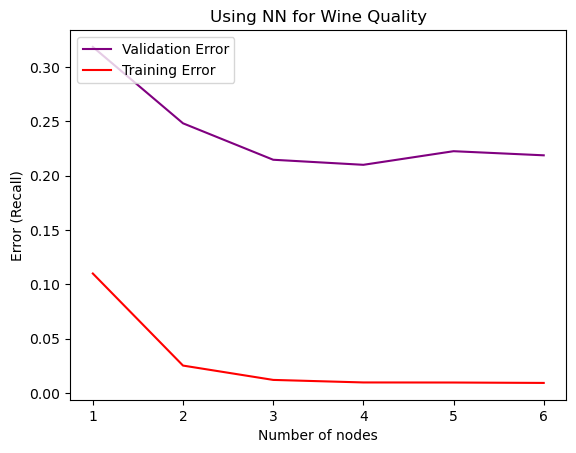

In [76]:
# [WINE QUALITY] Varying depth
tf.random.set_seed(42)

acc_w_train = []
acc_w_test = []
list_x = []
layer_u = [8]
tf.random.set_seed(42)

layer_u = [[64,64],[64,64,64], [64,64,64,64],[64,64,64,64,64],[64,64,64,64,64,64], [64,64,64,64,64,64,64], [64,64,64,64,64,64,64,64], [64, 64,64,64,64,64,64,64,64]]

for x in range(0, 6):
#     layer_u.insert(0,layer_u[0])
    model = create_ann(x_train_w,y_train_w, dataset = 'wine', layer_units = layer_u[x], dropout = 0.01)
    test,train = strat_kfold_ann(clf = model, num_folds = 5, x_train = x_train_w, y_train = y_train_w, dataset = "wine", epochs = 100)
    acc_w_train.append(1-train)
    acc_w_test.append(1-test)
    list_x.append(x+1)
    print(1-train)
    print(1-test)
    print(x)
    

plt.clf()
plt.title('Using NN for Wine Quality')
plt.xlabel("Number of nodes")
plt.ylabel("Error (Recall)")
plt.locator_params(axis='x')
plt.locator_params(axis='y')
plt.plot(list_x, acc_w_test, color='purple', label='Validation Error')
plt.plot(list_x, acc_w_train, color='red', label='Training Error')
plt.legend(loc="upper left")
# plt.savefig('Wine Quality_Decision Tree Error.png',
#             bbox_inches='tight')
plt.show()

Epoch 1/100
70/70 [==============================] - 2s 3ms/step - loss: 0.4973 - accuracy: 0.7750
Epoch 2/100
70/70 [==============================] - 0s 1ms/step - loss: 0.3624 - accuracy: 0.8348
Epoch 3/100
70/70 [==============================] - 0s 1ms/step - loss: 0.3157 - accuracy: 0.8589
Epoch 4/100
70/70 [==============================] - 0s 1ms/step - loss: 0.2909 - accuracy: 0.8687
Epoch 5/100
70/70 [==============================] - 0s 1ms/step - loss: 0.2764 - accuracy: 0.8781
Epoch 6/100
70/70 [==============================] - 0s 1ms/step - loss: 0.2668 - accuracy: 0.8817
Epoch 7/100
70/70 [==============================] - 0s 1ms/step - loss: 0.2545 - accuracy: 0.8853
Epoch 8/100
70/70 [==============================] - 0s 1ms/step - loss: 0.2470 - accuracy: 0.8897
Epoch 9/100
70/70 [==============================] - 0s 1ms/step - loss: 0.2383 - accuracy: 0.8955
Epoch 10/100
70/70 [==============================] - 0s 1ms/step - loss: 0.2344 - accuracy: 0.9004
Epoch 11/

70/70 [==============================] - 0s 1ms/step - loss: 0.0357 - accuracy: 0.9915
Epoch 63/100
70/70 [==============================] - 0s 1ms/step - loss: 0.0344 - accuracy: 0.9888
Epoch 64/100
70/70 [==============================] - 0s 1ms/step - loss: 0.0354 - accuracy: 0.9888
Epoch 65/100
70/70 [==============================] - 0s 1ms/step - loss: 0.0335 - accuracy: 0.9884
Epoch 66/100
70/70 [==============================] - 0s 1ms/step - loss: 0.0323 - accuracy: 0.9911
Epoch 67/100
70/70 [==============================] - 0s 1ms/step - loss: 0.0322 - accuracy: 0.9893
Epoch 68/100
70/70 [==============================] - 0s 1ms/step - loss: 0.0375 - accuracy: 0.9879
Epoch 69/100
70/70 [==============================] - 0s 1ms/step - loss: 0.0412 - accuracy: 0.9871
Epoch 70/100
70/70 [==============================] - 0s 1ms/step - loss: 0.0346 - accuracy: 0.9893
Epoch 71/100
70/70 [==============================] - 0s 1ms/step - loss: 0.0324 - accuracy: 0.9893
Epoch 72/100


Epoch 43/100
70/70 [==============================] - 0s 1ms/step - loss: 0.0170 - accuracy: 0.9955
Epoch 44/100
70/70 [==============================] - 0s 1ms/step - loss: 0.0191 - accuracy: 0.9933
Epoch 45/100
70/70 [==============================] - 0s 1ms/step - loss: 0.0205 - accuracy: 0.9946
Epoch 46/100
70/70 [==============================] - 0s 1ms/step - loss: 0.0153 - accuracy: 0.9969
Epoch 47/100
70/70 [==============================] - 0s 1ms/step - loss: 0.0167 - accuracy: 0.9960
Epoch 48/100
70/70 [==============================] - 0s 1ms/step - loss: 0.0161 - accuracy: 0.9964
Epoch 49/100
70/70 [==============================] - 0s 1ms/step - loss: 0.0180 - accuracy: 0.9951
Epoch 50/100
70/70 [==============================] - 0s 1ms/step - loss: 0.0144 - accuracy: 0.9969
Epoch 51/100
70/70 [==============================] - 0s 1ms/step - loss: 0.0111 - accuracy: 0.9982
Epoch 52/100
70/70 [==============================] - 0s 1ms/step - loss: 0.0131 - accuracy: 0.9978


70/70 [==============================] - 0s 1ms/step - loss: 0.0209 - accuracy: 0.9924
Epoch 4/100
70/70 [==============================] - 0s 1ms/step - loss: 0.0109 - accuracy: 0.9951
Epoch 5/100
70/70 [==============================] - 0s 1ms/step - loss: 0.0121 - accuracy: 0.9955
Epoch 6/100
70/70 [==============================] - 0s 1ms/step - loss: 0.0136 - accuracy: 0.9951
Epoch 7/100
70/70 [==============================] - 0s 1ms/step - loss: 0.0101 - accuracy: 0.9964
Epoch 8/100
70/70 [==============================] - 0s 980us/step - loss: 0.0098 - accuracy: 0.9969
Epoch 9/100
70/70 [==============================] - 0s 987us/step - loss: 0.0081 - accuracy: 0.9982
Epoch 10/100
70/70 [==============================] - 0s 1ms/step - loss: 0.0104 - accuracy: 0.9982
Epoch 11/100
70/70 [==============================] - 0s 1ms/step - loss: 0.0085 - accuracy: 0.9973
Epoch 12/100
70/70 [==============================] - 0s 1ms/step - loss: 0.0059 - accuracy: 0.9987
Epoch 13/100
70

70/70 [==============================] - 0s 1ms/step - loss: 0.0366 - accuracy: 0.9871
Epoch 65/100
70/70 [==============================] - 0s 1ms/step - loss: 0.0351 - accuracy: 0.9875
Epoch 66/100
70/70 [==============================] - 0s 1ms/step - loss: 0.0383 - accuracy: 0.9857
Epoch 67/100
70/70 [==============================] - 0s 1ms/step - loss: 0.0423 - accuracy: 0.9848
Epoch 68/100
70/70 [==============================] - 0s 1ms/step - loss: 0.0463 - accuracy: 0.9835
Epoch 69/100
70/70 [==============================] - 0s 1ms/step - loss: 0.0383 - accuracy: 0.9862
Epoch 70/100
70/70 [==============================] - 0s 1ms/step - loss: 0.0330 - accuracy: 0.9893
Epoch 71/100
70/70 [==============================] - 0s 1ms/step - loss: 0.0292 - accuracy: 0.9893
Epoch 72/100
70/70 [==============================] - 0s 1ms/step - loss: 0.0303 - accuracy: 0.9884
Epoch 73/100
70/70 [==============================] - 0s 1ms/step - loss: 0.0288 - accuracy: 0.9897
Epoch 74/100


70/70 [==============================] - 0s 1ms/step - loss: 0.0127 - accuracy: 0.9964
Epoch 46/100
70/70 [==============================] - 0s 1ms/step - loss: 0.0133 - accuracy: 0.9969
Epoch 47/100
70/70 [==============================] - 0s 1ms/step - loss: 0.0127 - accuracy: 0.9955
Epoch 48/100
70/70 [==============================] - 0s 1ms/step - loss: 0.0134 - accuracy: 0.9955
Epoch 49/100
70/70 [==============================] - 0s 1ms/step - loss: 0.0234 - accuracy: 0.9942
Epoch 50/100
70/70 [==============================] - 0s 1ms/step - loss: 0.0092 - accuracy: 0.9987
Epoch 51/100
70/70 [==============================] - 0s 1ms/step - loss: 0.0166 - accuracy: 0.9955
Epoch 52/100
70/70 [==============================] - 0s 1ms/step - loss: 0.0191 - accuracy: 0.9951
Epoch 53/100
70/70 [==============================] - 0s 1ms/step - loss: 0.0229 - accuracy: 0.9937
Epoch 54/100
70/70 [==============================] - 0s 1ms/step - loss: 0.0146 - accuracy: 0.9955
Epoch 55/100


70/70 [==============================] - 0s 1ms/step - loss: 0.0091 - accuracy: 0.9973
Epoch 27/100
70/70 [==============================] - 0s 1ms/step - loss: 0.0040 - accuracy: 0.9987
Epoch 28/100
70/70 [==============================] - 0s 1ms/step - loss: 0.0119 - accuracy: 0.9960
Epoch 29/100
70/70 [==============================] - 0s 1ms/step - loss: 0.0047 - accuracy: 0.9991
Epoch 30/100
70/70 [==============================] - 0s 1ms/step - loss: 0.0027 - accuracy: 1.0000
Epoch 31/100
70/70 [==============================] - 0s 1ms/step - loss: 0.0021 - accuracy: 0.9996
Epoch 32/100
70/70 [==============================] - 0s 1ms/step - loss: 0.0062 - accuracy: 0.9982
Epoch 33/100
70/70 [==============================] - 0s 1ms/step - loss: 0.0277 - accuracy: 0.9929
Epoch 34/100
70/70 [==============================] - 0s 1ms/step - loss: 0.0358 - accuracy: 0.9879
Epoch 35/100
70/70 [==============================] - 0s 1ms/step - loss: 0.0259 - accuracy: 0.9933
Epoch 36/100


70/70 [==============================] - 0s 1ms/step - loss: 0.0155 - accuracy: 0.9964
Epoch 88/100
70/70 [==============================] - 0s 1ms/step - loss: 0.0173 - accuracy: 0.9951
Epoch 89/100
70/70 [==============================] - 0s 1ms/step - loss: 0.0161 - accuracy: 0.9942
Epoch 90/100
70/70 [==============================] - 0s 1ms/step - loss: 0.0205 - accuracy: 0.9933
Epoch 91/100
70/70 [==============================] - 0s 1ms/step - loss: 0.0070 - accuracy: 0.9982
Epoch 92/100
70/70 [==============================] - 0s 1ms/step - loss: 0.0133 - accuracy: 0.9973
Epoch 93/100
70/70 [==============================] - 0s 1ms/step - loss: 0.0018 - accuracy: 1.0000
Epoch 94/100
70/70 [==============================] - 0s 1ms/step - loss: 8.1640e-04 - accuracy: 1.0000
Epoch 95/100
70/70 [==============================] - 0s 1ms/step - loss: 5.2442e-04 - accuracy: 1.0000
Epoch 96/100
70/70 [==============================] - 0s 1ms/step - loss: 0.0013 - accuracy: 1.0000
Epoch

70/70 [==============================] - 0s 1ms/step - loss: 0.0372 - accuracy: 0.9862
Epoch 48/100
70/70 [==============================] - 0s 1ms/step - loss: 0.0323 - accuracy: 0.9875
Epoch 49/100
70/70 [==============================] - 0s 1ms/step - loss: 0.0403 - accuracy: 0.9857
Epoch 50/100
70/70 [==============================] - 0s 1ms/step - loss: 0.0370 - accuracy: 0.9839
Epoch 51/100
70/70 [==============================] - 0s 1ms/step - loss: 0.0307 - accuracy: 0.9884
Epoch 52/100
70/70 [==============================] - 0s 1ms/step - loss: 0.0241 - accuracy: 0.9902
Epoch 53/100
70/70 [==============================] - 0s 1ms/step - loss: 0.0324 - accuracy: 0.9875
Epoch 54/100
70/70 [==============================] - 0s 1ms/step - loss: 0.0262 - accuracy: 0.9911
Epoch 55/100
70/70 [==============================] - 0s 1ms/step - loss: 0.0267 - accuracy: 0.9920
Epoch 56/100
70/70 [==============================] - 0s 1ms/step - loss: 0.0303 - accuracy: 0.9902
Epoch 57/100


70/70 [==============================] - 0s 1ms/step - loss: 0.0089 - accuracy: 0.9978
Epoch 29/100
70/70 [==============================] - 0s 1ms/step - loss: 0.0232 - accuracy: 0.9924
Epoch 30/100
70/70 [==============================] - 0s 1ms/step - loss: 0.0180 - accuracy: 0.9929
Epoch 31/100
70/70 [==============================] - 0s 1ms/step - loss: 0.0201 - accuracy: 0.9955
Epoch 32/100
70/70 [==============================] - 0s 1ms/step - loss: 0.0215 - accuracy: 0.9937
Epoch 33/100
70/70 [==============================] - 0s 1ms/step - loss: 0.0099 - accuracy: 0.9973
Epoch 34/100
70/70 [==============================] - 0s 1ms/step - loss: 0.0237 - accuracy: 0.9942
Epoch 35/100
70/70 [==============================] - 0s 1ms/step - loss: 0.0129 - accuracy: 0.9951
Epoch 36/100
70/70 [==============================] - 0s 1ms/step - loss: 0.0142 - accuracy: 0.9942
Epoch 37/100
70/70 [==============================] - 0s 1ms/step - loss: 0.0123 - accuracy: 0.9955
Epoch 38/100


70/70 [==============================] - 0s 1ms/step - loss: 0.0107 - accuracy: 0.9960
Epoch 90/100
70/70 [==============================] - 0s 2ms/step - loss: 0.0263 - accuracy: 0.9920
Epoch 91/100
70/70 [==============================] - 0s 1ms/step - loss: 0.0082 - accuracy: 0.9973
Epoch 92/100
70/70 [==============================] - 0s 2ms/step - loss: 0.0073 - accuracy: 0.9973
Epoch 93/100
70/70 [==============================] - 0s 1ms/step - loss: 0.0016 - accuracy: 1.0000
Epoch 94/100
70/70 [==============================] - 0s 1ms/step - loss: 0.0023 - accuracy: 0.9996
Epoch 95/100
70/70 [==============================] - 0s 1ms/step - loss: 0.0020 - accuracy: 0.9991
Epoch 96/100
70/70 [==============================] - 0s 1ms/step - loss: 0.0011 - accuracy: 0.9996
Epoch 97/100
70/70 [==============================] - 0s 1ms/step - loss: 0.0030 - accuracy: 0.9991
Epoch 98/100
70/70 [==============================] - 0s 1ms/step - loss: 0.0079 - accuracy: 0.9973
Epoch 99/100


70/70 [==============================] - 0s 1ms/step - loss: 0.0169 - accuracy: 0.9964
Epoch 50/100
70/70 [==============================] - 0s 1ms/step - loss: 0.0038 - accuracy: 0.9987
Epoch 51/100
70/70 [==============================] - 0s 1ms/step - loss: 0.0033 - accuracy: 0.9987
Epoch 52/100
70/70 [==============================] - 0s 1ms/step - loss: 8.6454e-04 - accuracy: 1.0000
Epoch 53/100
70/70 [==============================] - 0s 1ms/step - loss: 0.0011 - accuracy: 1.0000
Epoch 54/100
70/70 [==============================] - 0s 1ms/step - loss: 6.2990e-04 - accuracy: 1.0000
Epoch 55/100
70/70 [==============================] - 0s 1ms/step - loss: 5.9697e-04 - accuracy: 1.0000
Epoch 56/100
70/70 [==============================] - 0s 1ms/step - loss: 5.7154e-04 - accuracy: 1.0000
Epoch 57/100
70/70 [==============================] - 0s 1ms/step - loss: 3.0785e-04 - accuracy: 1.0000
Epoch 58/100
70/70 [==============================] - 0s 1ms/step - loss: 4.6402e-04 - accura

70/70 [==============================] - 0s 1ms/step - loss: 0.0513 - accuracy: 0.9830
Epoch 30/100
70/70 [==============================] - 0s 2ms/step - loss: 0.0403 - accuracy: 0.9853
Epoch 31/100
70/70 [==============================] - 0s 1ms/step - loss: 0.0469 - accuracy: 0.9808
Epoch 32/100
70/70 [==============================] - 0s 1ms/step - loss: 0.0493 - accuracy: 0.9826
Epoch 33/100
70/70 [==============================] - 0s 1ms/step - loss: 0.0576 - accuracy: 0.9804
Epoch 34/100
70/70 [==============================] - 0s 1ms/step - loss: 0.0476 - accuracy: 0.9812
Epoch 35/100
70/70 [==============================] - 0s 1ms/step - loss: 0.0436 - accuracy: 0.9835
Epoch 36/100
70/70 [==============================] - 0s 1ms/step - loss: 0.0386 - accuracy: 0.9866
Epoch 37/100
70/70 [==============================] - 0s 1ms/step - loss: 0.0410 - accuracy: 0.9835
Epoch 38/100
70/70 [==============================] - 0s 1ms/step - loss: 0.0482 - accuracy: 0.9799
Epoch 39/100


70/70 [==============================] - 0s 1ms/step - loss: 0.0315 - accuracy: 0.9897
Epoch 11/100
70/70 [==============================] - 0s 1ms/step - loss: 0.0308 - accuracy: 0.9897
Epoch 12/100
70/70 [==============================] - 0s 1ms/step - loss: 0.0270 - accuracy: 0.9929
Epoch 13/100
70/70 [==============================] - 0s 1ms/step - loss: 0.0321 - accuracy: 0.9879
Epoch 14/100
70/70 [==============================] - 0s 1ms/step - loss: 0.0294 - accuracy: 0.9902
Epoch 15/100
70/70 [==============================] - 0s 1ms/step - loss: 0.0251 - accuracy: 0.9924
Epoch 16/100
70/70 [==============================] - 0s 1ms/step - loss: 0.0230 - accuracy: 0.9924
Epoch 17/100
70/70 [==============================] - 0s 1ms/step - loss: 0.0271 - accuracy: 0.9906
Epoch 18/100
70/70 [==============================] - 0s 2ms/step - loss: 0.0214 - accuracy: 0.9933
Epoch 19/100
70/70 [==============================] - 0s 2ms/step - loss: 0.0152 - accuracy: 0.9951
Epoch 20/100


70/70 [==============================] - 0s 1ms/step - loss: 0.0069 - accuracy: 0.9987
Epoch 93/100
70/70 [==============================] - 0s 1ms/step - loss: 0.0049 - accuracy: 0.9973
Epoch 94/100
70/70 [==============================] - 0s 1ms/step - loss: 0.0045 - accuracy: 0.9982
Epoch 95/100
70/70 [==============================] - 0s 2ms/step - loss: 0.0389 - accuracy: 0.9902
Epoch 96/100
70/70 [==============================] - 0s 2ms/step - loss: 0.0302 - accuracy: 0.9911
Epoch 97/100
70/70 [==============================] - 0s 1ms/step - loss: 0.0092 - accuracy: 0.9973
Epoch 98/100
70/70 [==============================] - 0s 2ms/step - loss: 0.0056 - accuracy: 0.9987
Epoch 99/100
70/70 [==============================] - 0s 2ms/step - loss: 0.0025 - accuracy: 0.9996
Epoch 100/100
18/18 [==============================] - 0s 2ms/step
Epoch 1/100
70/70 [==============================] - 0s 2ms/step - loss: 0.0498 - accuracy: 0.9857
Epoch 2/100
70/70 [============================

70/70 [==============================] - 0s 2ms/step - loss: 0.0054 - accuracy: 0.9987
Epoch 74/100
70/70 [==============================] - 0s 2ms/step - loss: 0.0039 - accuracy: 0.9987
Epoch 75/100
70/70 [==============================] - 0s 2ms/step - loss: 0.0062 - accuracy: 0.9978
Epoch 76/100
70/70 [==============================] - 0s 2ms/step - loss: 0.0031 - accuracy: 0.9991
Epoch 77/100
70/70 [==============================] - 0s 2ms/step - loss: 0.0031 - accuracy: 0.9996
Epoch 78/100
70/70 [==============================] - 0s 2ms/step - loss: 0.0012 - accuracy: 0.9991
Epoch 79/100
70/70 [==============================] - 0s 2ms/step - loss: 0.0021 - accuracy: 0.9987
Epoch 80/100
70/70 [==============================] - 0s 2ms/step - loss: 0.0109 - accuracy: 0.9960
Epoch 81/100
70/70 [==============================] - 0s 2ms/step - loss: 0.0108 - accuracy: 0.9964
Epoch 82/100
70/70 [==============================] - 0s 2ms/step - loss: 0.0111 - accuracy: 0.9964
Epoch 83/100


70/70 [==============================] - 0s 1ms/step - loss: 0.0041 - accuracy: 0.9991
Epoch 34/100
70/70 [==============================] - 0s 1ms/step - loss: 0.0028 - accuracy: 0.9982
Epoch 35/100
70/70 [==============================] - 0s 1ms/step - loss: 0.0237 - accuracy: 0.9924
Epoch 36/100
70/70 [==============================] - 0s 1ms/step - loss: 0.0088 - accuracy: 0.9978
Epoch 37/100
70/70 [==============================] - 0s 1ms/step - loss: 0.0072 - accuracy: 0.9978
Epoch 38/100
70/70 [==============================] - 0s 1ms/step - loss: 0.0078 - accuracy: 0.9982
Epoch 39/100
70/70 [==============================] - 0s 1ms/step - loss: 0.0015 - accuracy: 1.0000
Epoch 40/100
70/70 [==============================] - 0s 1ms/step - loss: 7.4440e-04 - accuracy: 1.0000
Epoch 41/100
70/70 [==============================] - 0s 1ms/step - loss: 0.0021 - accuracy: 0.9991
Epoch 42/100
70/70 [==============================] - 0s 1ms/step - loss: 0.0049 - accuracy: 0.9982
Epoch 43/

70/70 [==============================] - 0s 1ms/step - loss: 0.0360 - accuracy: 0.9902
Epoch 95/100
70/70 [==============================] - 0s 1ms/step - loss: 0.0116 - accuracy: 0.9969
Epoch 96/100
70/70 [==============================] - 0s 1ms/step - loss: 0.0312 - accuracy: 0.9911
Epoch 97/100
70/70 [==============================] - 0s 1ms/step - loss: 0.0146 - accuracy: 0.9955
Epoch 98/100
70/70 [==============================] - 0s 1ms/step - loss: 0.0198 - accuracy: 0.9929
Epoch 99/100
70/70 [==============================] - 0s 1ms/step - loss: 0.0030 - accuracy: 0.9996
Epoch 100/100
18/18 [==============================] - 0s 915us/step
Epoch 1/100
70/70 [==============================] - 0s 1ms/step - loss: 0.1341 - accuracy: 0.9616
Epoch 2/100
70/70 [==============================] - 0s 1ms/step - loss: 0.0799 - accuracy: 0.9768
Epoch 3/100
70/70 [==============================] - 0s 1ms/step - loss: 0.0554 - accuracy: 0.9853
Epoch 4/100
70/70 [============================

70/70 [==============================] - 0s 1ms/step - loss: 0.0015 - accuracy: 1.0000
Epoch 76/100
70/70 [==============================] - 0s 1ms/step - loss: 0.0041 - accuracy: 0.9987
Epoch 77/100
70/70 [==============================] - 0s 1ms/step - loss: 0.0093 - accuracy: 0.9969
Epoch 78/100
70/70 [==============================] - 0s 1ms/step - loss: 0.0242 - accuracy: 0.9924
Epoch 79/100
70/70 [==============================] - 0s 1ms/step - loss: 0.0068 - accuracy: 0.9969
Epoch 80/100
70/70 [==============================] - 0s 1ms/step - loss: 0.0071 - accuracy: 0.9978
Epoch 81/100
70/70 [==============================] - 0s 1ms/step - loss: 0.0189 - accuracy: 0.9955
Epoch 82/100
70/70 [==============================] - 0s 1ms/step - loss: 0.0075 - accuracy: 0.9978
Epoch 83/100
70/70 [==============================] - 0s 1ms/step - loss: 0.0027 - accuracy: 0.9996
Epoch 84/100
70/70 [==============================] - 0s 1ms/step - loss: 0.0140 - accuracy: 0.9973
Epoch 85/100


70/70 [==============================] - 0s 1ms/step - loss: 0.0160 - accuracy: 0.9946
Epoch 57/100
70/70 [==============================] - 0s 2ms/step - loss: 0.0226 - accuracy: 0.9929
Epoch 58/100
70/70 [==============================] - 0s 2ms/step - loss: 0.0100 - accuracy: 0.9960
Epoch 59/100
70/70 [==============================] - 0s 2ms/step - loss: 0.0101 - accuracy: 0.9978
Epoch 60/100
70/70 [==============================] - 0s 2ms/step - loss: 0.0052 - accuracy: 0.9982
Epoch 61/100
70/70 [==============================] - 0s 2ms/step - loss: 0.0066 - accuracy: 0.9982
Epoch 62/100
70/70 [==============================] - 0s 2ms/step - loss: 0.0066 - accuracy: 0.9982
Epoch 63/100
70/70 [==============================] - 0s 2ms/step - loss: 0.0086 - accuracy: 0.9969
Epoch 64/100
70/70 [==============================] - 0s 1ms/step - loss: 0.0106 - accuracy: 0.9969
Epoch 65/100
70/70 [==============================] - 0s 1ms/step - loss: 0.0051 - accuracy: 0.9987
Epoch 66/100


Epoch 37/100
70/70 [==============================] - 0s 1ms/step - loss: 0.0124 - accuracy: 0.9982
Epoch 38/100
70/70 [==============================] - 0s 1ms/step - loss: 0.0097 - accuracy: 0.9964
Epoch 39/100
70/70 [==============================] - 0s 1ms/step - loss: 0.0114 - accuracy: 0.9955
Epoch 40/100
70/70 [==============================] - 0s 1ms/step - loss: 0.0115 - accuracy: 0.9960
Epoch 41/100
70/70 [==============================] - 0s 1ms/step - loss: 0.0128 - accuracy: 0.9946
Epoch 42/100
70/70 [==============================] - 0s 1ms/step - loss: 0.0205 - accuracy: 0.9969
Epoch 43/100
70/70 [==============================] - 0s 1ms/step - loss: 0.0088 - accuracy: 0.9969
Epoch 44/100
70/70 [==============================] - 0s 1ms/step - loss: 0.0036 - accuracy: 0.9982
Epoch 45/100
70/70 [==============================] - 0s 1ms/step - loss: 0.0017 - accuracy: 1.0000
Epoch 46/100
70/70 [==============================] - 0s 1ms/step - loss: 0.0075 - accuracy: 0.9987


70/70 [==============================] - 0s 1ms/step - loss: 0.0068 - accuracy: 0.9987
Epoch 99/100
70/70 [==============================] - 0s 1ms/step - loss: 0.0027 - accuracy: 0.9982
Epoch 100/100
18/18 [==============================] - 0s 853us/step
0.0016964285714285987
0.03249999999999997
4
Epoch 1/100
70/70 [==============================] - 2s 2ms/step - loss: 0.4762 - accuracy: 0.7607
Epoch 2/100
70/70 [==============================] - 0s 1ms/step - loss: 0.3133 - accuracy: 0.8567
Epoch 3/100
70/70 [==============================] - 0s 1ms/step - loss: 0.2889 - accuracy: 0.8683
Epoch 4/100
70/70 [==============================] - 0s 1ms/step - loss: 0.2442 - accuracy: 0.8978
Epoch 5/100
70/70 [==============================] - 0s 1ms/step - loss: 0.2362 - accuracy: 0.8982
Epoch 6/100
70/70 [==============================] - 0s 1ms/step - loss: 0.2121 - accuracy: 0.9089
Epoch 7/100
70/70 [==============================] - 0s 1ms/step - loss: 0.2055 - accuracy: 0.9107
Epoch 8

70/70 [==============================] - 0s 2ms/step - loss: 0.0167 - accuracy: 0.9942
Epoch 60/100
70/70 [==============================] - 0s 2ms/step - loss: 0.0136 - accuracy: 0.9960
Epoch 61/100
70/70 [==============================] - 0s 2ms/step - loss: 0.0066 - accuracy: 0.9982
Epoch 62/100
70/70 [==============================] - 0s 1ms/step - loss: 0.0095 - accuracy: 0.9964
Epoch 63/100
70/70 [==============================] - 0s 2ms/step - loss: 0.0201 - accuracy: 0.9933
Epoch 64/100
70/70 [==============================] - 0s 2ms/step - loss: 0.0124 - accuracy: 0.9960
Epoch 65/100
70/70 [==============================] - 0s 2ms/step - loss: 0.0081 - accuracy: 0.9973
Epoch 66/100
70/70 [==============================] - 0s 2ms/step - loss: 0.0274 - accuracy: 0.9933
Epoch 67/100
70/70 [==============================] - 0s 2ms/step - loss: 0.0244 - accuracy: 0.9929
Epoch 68/100
70/70 [==============================] - 0s 2ms/step - loss: 0.0174 - accuracy: 0.9951
Epoch 69/100


70/70 [==============================] - 0s 2ms/step - loss: 0.0163 - accuracy: 0.9955
Epoch 41/100
70/70 [==============================] - 0s 2ms/step - loss: 0.0085 - accuracy: 0.9964
Epoch 42/100
70/70 [==============================] - 0s 1ms/step - loss: 0.0037 - accuracy: 0.9978
Epoch 43/100
70/70 [==============================] - 0s 1ms/step - loss: 0.0389 - accuracy: 0.9871
Epoch 44/100
70/70 [==============================] - 0s 2ms/step - loss: 0.0234 - accuracy: 0.9929
Epoch 45/100
70/70 [==============================] - 0s 2ms/step - loss: 0.0069 - accuracy: 0.9973
Epoch 46/100
70/70 [==============================] - 0s 1ms/step - loss: 0.0248 - accuracy: 0.9933
Epoch 47/100
70/70 [==============================] - 0s 1ms/step - loss: 0.0141 - accuracy: 0.9960
Epoch 48/100
70/70 [==============================] - 0s 1ms/step - loss: 0.0048 - accuracy: 0.9982
Epoch 49/100
70/70 [==============================] - 0s 1ms/step - loss: 0.0062 - accuracy: 0.9978
Epoch 50/100


18/18 [==============================] - 0s 952us/step
Epoch 1/100
70/70 [==============================] - 0s 2ms/step - loss: 0.0448 - accuracy: 0.9848
Epoch 2/100
70/70 [==============================] - 0s 1ms/step - loss: 0.0188 - accuracy: 0.9937
Epoch 3/100
70/70 [==============================] - 0s 1ms/step - loss: 0.0079 - accuracy: 0.9969
Epoch 4/100
70/70 [==============================] - 0s 1ms/step - loss: 0.0097 - accuracy: 0.9960
Epoch 5/100
70/70 [==============================] - 0s 2ms/step - loss: 0.0245 - accuracy: 0.9937
Epoch 6/100
70/70 [==============================] - 0s 2ms/step - loss: 0.0090 - accuracy: 0.9978
Epoch 7/100
70/70 [==============================] - 0s 1ms/step - loss: 0.0014 - accuracy: 0.9996
Epoch 8/100
70/70 [==============================] - 0s 1ms/step - loss: 0.0023 - accuracy: 0.9991
Epoch 9/100
70/70 [==============================] - 0s 2ms/step - loss: 0.0193 - accuracy: 0.9960
Epoch 10/100
70/70 [==============================] - 

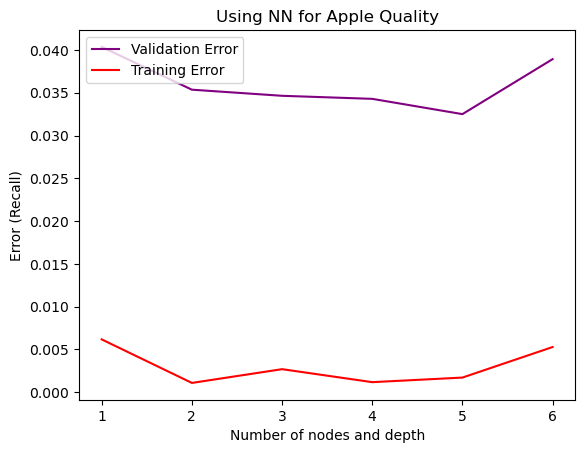

In [99]:
# [APPLE QUALITY] Varying depth

acc_w_train = []
acc_w_test = []
list_x = []
layer_u = [4]
tf.random.set_seed(42)
layer_u = [[64,64],[64,64,64], [64,64,64,64],[64,64,64,64,64],[64,64,64,64,64,64], [64,64,64,64,64,64,64], [64,64,64,64,64,64,64,64], [64, 64,64,64,64,64,64,64,64]]


for x in range(0, 6):
#     layer_u.insert(0,layer_u[0])
    model = create_ann(x_train_a,y_train_a, dataset = 'apple', layer_units = layer_u[x], dropout=0.01)
    test,train = strat_kfold_ann(clf = model, num_folds = 5, x_train = x_train_a, y_train = y_train_a, dataset = "apple", epochs = 100)
    acc_w_train.append(1-train)
    acc_w_test.append(1-test)
    list_x.append(x+1)
    print(1-train)
    print(1-test)
    print(x)
    

plt.clf()
plt.title('Using NN for Apple Quality')
plt.xlabel("Number of nodes and depth")
plt.ylabel("Error (Recall)")
plt.locator_params(axis='x')
plt.locator_params(axis='y')
plt.plot(list_x, acc_w_test, color='purple', label='Validation Error')
plt.plot(list_x, acc_w_train, color='red', label='Training Error')
plt.legend(loc="upper left")
# plt.savefig('Wine Quality_Decision Tree Error.png',
#             bbox_inches='tight')
plt.show()

Epoch 1/50
86/86 [==============================] - 0s 985us/step - loss: 1.8509 - accuracy: 0.2644
Epoch 2/50
86/86 [==============================] - 0s 931us/step - loss: 1.6177 - accuracy: 0.4150
Epoch 3/50
86/86 [==============================] - 0s 919us/step - loss: 1.4760 - accuracy: 0.4551
Epoch 4/50
86/86 [==============================] - 0s 864us/step - loss: 1.3848 - accuracy: 0.4679
Epoch 5/50
86/86 [==============================] - 0s 858us/step - loss: 1.3209 - accuracy: 0.4810
Epoch 6/50
86/86 [==============================] - 0s 878us/step - loss: 1.2725 - accuracy: 0.4956
Epoch 7/50
86/86 [==============================] - 0s 949us/step - loss: 1.2352 - accuracy: 0.5044
Epoch 8/50
86/86 [==============================] - 0s 940us/step - loss: 1.2071 - accuracy: 0.5084
Epoch 9/50
86/86 [==============================] - 0s 892us/step - loss: 1.1851 - accuracy: 0.5193
Epoch 10/50
86/86 [==============================] - 0s 869us/step - loss: 1.1684 - accuracy: 0.5208

86/86 [==============================] - 0s 897us/step - loss: 1.0295 - accuracy: 0.5614
Epoch 11/50
86/86 [==============================] - 0s 904us/step - loss: 1.0294 - accuracy: 0.5596
Epoch 12/50
86/86 [==============================] - 0s 894us/step - loss: 1.0289 - accuracy: 0.5603
Epoch 13/50
86/86 [==============================] - 0s 845us/step - loss: 1.0290 - accuracy: 0.5607
Epoch 14/50
86/86 [==============================] - 0s 855us/step - loss: 1.0285 - accuracy: 0.5578
Epoch 15/50
86/86 [==============================] - 0s 898us/step - loss: 1.0284 - accuracy: 0.5607
Epoch 16/50
86/86 [==============================] - 0s 875us/step - loss: 1.0285 - accuracy: 0.5581
Epoch 17/50
86/86 [==============================] - 0s 843us/step - loss: 1.0279 - accuracy: 0.5611
Epoch 18/50
86/86 [==============================] - 0s 851us/step - loss: 1.0272 - accuracy: 0.5600
Epoch 19/50
86/86 [==============================] - 0s 881us/step - loss: 1.0273 - accuracy: 0.5618
Ep

86/86 [==============================] - 0s 874us/step - loss: 1.0175 - accuracy: 0.5784
Epoch 19/50
86/86 [==============================] - 0s 843us/step - loss: 1.0176 - accuracy: 0.5737
Epoch 20/50
86/86 [==============================] - 0s 907us/step - loss: 1.0166 - accuracy: 0.5744
Epoch 21/50
86/86 [==============================] - 0s 861us/step - loss: 1.0153 - accuracy: 0.5795
Epoch 22/50
86/86 [==============================] - 0s 854us/step - loss: 1.0151 - accuracy: 0.5806
Epoch 23/50
86/86 [==============================] - 0s 910us/step - loss: 1.0142 - accuracy: 0.5810
Epoch 24/50
86/86 [==============================] - 0s 896us/step - loss: 1.0136 - accuracy: 0.5802
Epoch 25/50
86/86 [==============================] - 0s 874us/step - loss: 1.0126 - accuracy: 0.5799
Epoch 26/50
86/86 [==============================] - 0s 856us/step - loss: 1.0118 - accuracy: 0.5828
Epoch 27/50
86/86 [==============================] - 0s 886us/step - loss: 1.0112 - accuracy: 0.5813
Ep

86/86 [==============================] - 0s 939us/step - loss: 0.9821 - accuracy: 0.5775
Epoch 28/50
86/86 [==============================] - 0s 899us/step - loss: 0.9818 - accuracy: 0.5789
Epoch 29/50
86/86 [==============================] - 0s 902us/step - loss: 0.9811 - accuracy: 0.5778
Epoch 30/50
86/86 [==============================] - 0s 945us/step - loss: 0.9815 - accuracy: 0.5775
Epoch 31/50
86/86 [==============================] - 0s 903us/step - loss: 0.9813 - accuracy: 0.5793
Epoch 32/50
86/86 [==============================] - 0s 992us/step - loss: 0.9810 - accuracy: 0.5786
Epoch 33/50
86/86 [==============================] - 0s 891us/step - loss: 0.9812 - accuracy: 0.5771
Epoch 34/50
86/86 [==============================] - 0s 882us/step - loss: 0.9816 - accuracy: 0.5764
Epoch 35/50
86/86 [==============================] - 0s 949us/step - loss: 0.9800 - accuracy: 0.5811
Epoch 36/50
86/86 [==============================] - 0s 891us/step - loss: 0.9800 - accuracy: 0.5764
Ep

86/86 [==============================] - 0s 850us/step - loss: 0.9413 - accuracy: 0.6028
Epoch 36/50
86/86 [==============================] - 0s 893us/step - loss: 0.9399 - accuracy: 0.6018
Epoch 37/50
86/86 [==============================] - 0s 932us/step - loss: 0.9392 - accuracy: 0.6036
Epoch 38/50
86/86 [==============================] - 0s 928us/step - loss: 0.9387 - accuracy: 0.6036
Epoch 39/50
86/86 [==============================] - 0s 844us/step - loss: 0.9379 - accuracy: 0.5996
Epoch 40/50
86/86 [==============================] - 0s 877us/step - loss: 0.9384 - accuracy: 0.6018
Epoch 41/50
86/86 [==============================] - 0s 844us/step - loss: 0.9388 - accuracy: 0.6032
Epoch 42/50
86/86 [==============================] - 0s 856us/step - loss: 0.9361 - accuracy: 0.6087
Epoch 43/50
86/86 [==============================] - 0s 874us/step - loss: 0.9355 - accuracy: 0.6058
Epoch 44/50
86/86 [==============================] - 0s 875us/step - loss: 0.9350 - accuracy: 0.6087
Ep

Epoch 44/50
86/86 [==============================] - 0s 914us/step - loss: 0.9474 - accuracy: 0.6127
Epoch 45/50
86/86 [==============================] - 0s 828us/step - loss: 0.9470 - accuracy: 0.6120
Epoch 46/50
86/86 [==============================] - 0s 884us/step - loss: 0.9450 - accuracy: 0.6098
Epoch 47/50
86/86 [==============================] - 0s 928us/step - loss: 0.9424 - accuracy: 0.6087
Epoch 48/50
86/86 [==============================] - 0s 940us/step - loss: 0.9426 - accuracy: 0.6142
Epoch 49/50
86/86 [==============================] - 0s 900us/step - loss: 0.9393 - accuracy: 0.6109
Epoch 50/50
22/22 [==============================] - 0s 813us/step
Epoch 1/50
86/86 [==============================] - 0s 862us/step - loss: 0.9714 - accuracy: 0.5974
Epoch 2/50
86/86 [==============================] - 0s 839us/step - loss: 0.9677 - accuracy: 0.5941
Epoch 3/50
86/86 [==============================] - 0s 846us/step - loss: 0.9660 - accuracy: 0.5966
Epoch 4/50
86/86 [=========

86/86 [==============================] - 0s 871us/step - loss: 0.8861 - accuracy: 0.6258
Epoch 24/50
86/86 [==============================] - 0s 878us/step - loss: 0.8861 - accuracy: 0.6236
Epoch 25/50
86/86 [==============================] - 0s 896us/step - loss: 0.8832 - accuracy: 0.6295
Epoch 26/50
86/86 [==============================] - 0s 901us/step - loss: 0.8831 - accuracy: 0.6225
Epoch 27/50
86/86 [==============================] - 0s 936us/step - loss: 0.8811 - accuracy: 0.6298
Epoch 28/50
86/86 [==============================] - 0s 921us/step - loss: 0.8802 - accuracy: 0.6276
Epoch 29/50
86/86 [==============================] - 0s 947us/step - loss: 0.8813 - accuracy: 0.6324
Epoch 30/50
86/86 [==============================] - 0s 892us/step - loss: 0.8799 - accuracy: 0.6306
Epoch 31/50
86/86 [==============================] - 0s 857us/step - loss: 0.8791 - accuracy: 0.6291
Epoch 32/50
86/86 [==============================] - 0s 919us/step - loss: 0.8770 - accuracy: 0.6287
Ep

86/86 [==============================] - 0s 942us/step - loss: 0.9360 - accuracy: 0.6145
Epoch 32/50
86/86 [==============================] - 0s 896us/step - loss: 0.9340 - accuracy: 0.6163
Epoch 33/50
86/86 [==============================] - 0s 951us/step - loss: 0.9304 - accuracy: 0.6116
Epoch 34/50
86/86 [==============================] - 0s 887us/step - loss: 0.9267 - accuracy: 0.6112
Epoch 35/50
86/86 [==============================] - 0s 886us/step - loss: 0.9265 - accuracy: 0.6152
Epoch 36/50
86/86 [==============================] - 0s 916us/step - loss: 0.9247 - accuracy: 0.6120
Epoch 37/50
86/86 [==============================] - 0s 909us/step - loss: 0.9241 - accuracy: 0.6127
Epoch 38/50
86/86 [==============================] - 0s 887us/step - loss: 0.9207 - accuracy: 0.6225
Epoch 39/50
86/86 [==============================] - 0s 875us/step - loss: 0.9190 - accuracy: 0.6185
Epoch 40/50
86/86 [==============================] - 0s 901us/step - loss: 0.9163 - accuracy: 0.6182
Ep

86/86 [==============================] - 0s 869us/step - loss: 0.7466 - accuracy: 0.6861
Epoch 41/50
86/86 [==============================] - 0s 904us/step - loss: 0.7463 - accuracy: 0.6919
Epoch 42/50
86/86 [==============================] - 0s 888us/step - loss: 0.7432 - accuracy: 0.6923
Epoch 43/50
86/86 [==============================] - 0s 951us/step - loss: 0.7446 - accuracy: 0.6868
Epoch 44/50
86/86 [==============================] - 0s 983us/step - loss: 0.7429 - accuracy: 0.6974
Epoch 45/50
86/86 [==============================] - 0s 996us/step - loss: 0.7423 - accuracy: 0.6905
Epoch 46/50
86/86 [==============================] - 0s 926us/step - loss: 0.7379 - accuracy: 0.6978
Epoch 47/50
86/86 [==============================] - 0s 913us/step - loss: 0.7414 - accuracy: 0.6970
Epoch 48/50
86/86 [==============================] - 0s 887us/step - loss: 0.7367 - accuracy: 0.6941
Epoch 49/50
86/86 [==============================] - 0s 867us/step - loss: 0.7349 - accuracy: 0.6949
Ep

86/86 [==============================] - 0s 918us/step - loss: 0.7652 - accuracy: 0.6882
Epoch 49/50
86/86 [==============================] - 0s 904us/step - loss: 0.7722 - accuracy: 0.6838
Epoch 50/50
22/22 [==============================] - 0s 882us/step
Epoch 1/50
86/86 [==============================] - 0s 910us/step - loss: 0.8135 - accuracy: 0.6597
Epoch 2/50
86/86 [==============================] - 0s 937us/step - loss: 0.7996 - accuracy: 0.6681
Epoch 3/50
86/86 [==============================] - 0s 943us/step - loss: 0.7967 - accuracy: 0.6776
Epoch 4/50
86/86 [==============================] - 0s 1ms/step - loss: 0.7891 - accuracy: 0.6772
Epoch 5/50
86/86 [==============================] - 0s 911us/step - loss: 0.7813 - accuracy: 0.6838
Epoch 6/50
86/86 [==============================] - 0s 883us/step - loss: 0.7763 - accuracy: 0.6827
Epoch 7/50
86/86 [==============================] - 0s 897us/step - loss: 0.7767 - accuracy: 0.6816
Epoch 8/50
86/86 [===========================

86/86 [==============================] - 0s 968us/step - loss: 1.0280 - accuracy: 0.5832
Epoch 6/50
86/86 [==============================] - 0s 1ms/step - loss: 1.0149 - accuracy: 0.5879
Epoch 7/50
86/86 [==============================] - 0s 940us/step - loss: 1.0068 - accuracy: 0.5930
Epoch 8/50
86/86 [==============================] - 0s 972us/step - loss: 0.9941 - accuracy: 0.5879
Epoch 9/50
86/86 [==============================] - 0s 990us/step - loss: 0.9876 - accuracy: 0.5926
Epoch 10/50
86/86 [==============================] - 0s 924us/step - loss: 0.9822 - accuracy: 0.5923
Epoch 11/50
86/86 [==============================] - 0s 932us/step - loss: 0.9746 - accuracy: 0.5970
Epoch 12/50
86/86 [==============================] - 0s 925us/step - loss: 0.9640 - accuracy: 0.5988
Epoch 13/50
86/86 [==============================] - 0s 934us/step - loss: 0.9594 - accuracy: 0.5974
Epoch 14/50
86/86 [==============================] - 0s 939us/step - loss: 0.9547 - accuracy: 0.6010
Epoch 15

86/86 [==============================] - 0s 940us/step - loss: 0.5661 - accuracy: 0.7845
Epoch 15/50
86/86 [==============================] - 0s 961us/step - loss: 0.5658 - accuracy: 0.7809
Epoch 16/50
86/86 [==============================] - 0s 893us/step - loss: 0.5512 - accuracy: 0.7944
Epoch 17/50
86/86 [==============================] - 0s 939us/step - loss: 0.5518 - accuracy: 0.7875
Epoch 18/50
86/86 [==============================] - 0s 920us/step - loss: 0.5509 - accuracy: 0.7904
Epoch 19/50
86/86 [==============================] - 0s 916us/step - loss: 0.5444 - accuracy: 0.8002
Epoch 20/50
86/86 [==============================] - 0s 903us/step - loss: 0.5510 - accuracy: 0.7977
Epoch 21/50
86/86 [==============================] - 0s 880us/step - loss: 0.5451 - accuracy: 0.7893
Epoch 22/50
86/86 [==============================] - 0s 908us/step - loss: 0.5346 - accuracy: 0.8057
Epoch 23/50
86/86 [==============================] - 0s 904us/step - loss: 0.5432 - accuracy: 0.7900
Ep

86/86 [==============================] - 0s 1ms/step - loss: 0.6887 - accuracy: 0.7290
Epoch 24/50
86/86 [==============================] - 0s 1ms/step - loss: 0.6923 - accuracy: 0.7305
Epoch 25/50
86/86 [==============================] - 0s 997us/step - loss: 0.6834 - accuracy: 0.7221
Epoch 26/50
86/86 [==============================] - 0s 997us/step - loss: 0.6713 - accuracy: 0.7374
Epoch 27/50
86/86 [==============================] - 0s 1ms/step - loss: 0.6721 - accuracy: 0.7371
Epoch 28/50
86/86 [==============================] - 0s 972us/step - loss: 0.6618 - accuracy: 0.7458
Epoch 29/50
86/86 [==============================] - 0s 987us/step - loss: 0.6657 - accuracy: 0.7352
Epoch 30/50
86/86 [==============================] - 0s 1ms/step - loss: 0.6561 - accuracy: 0.7465
Epoch 31/50
86/86 [==============================] - 0s 1ms/step - loss: 0.6463 - accuracy: 0.7443
Epoch 32/50
86/86 [==============================] - 0s 998us/step - loss: 0.6552 - accuracy: 0.7531
Epoch 33/50


86/86 [==============================] - 0s 980us/step - loss: 0.2825 - accuracy: 0.9162
Epoch 34/50
86/86 [==============================] - 0s 1ms/step - loss: 0.2785 - accuracy: 0.9220
Epoch 35/50
86/86 [==============================] - 0s 1ms/step - loss: 0.2742 - accuracy: 0.9231
Epoch 36/50
86/86 [==============================] - 0s 992us/step - loss: 0.2677 - accuracy: 0.9256
Epoch 37/50
86/86 [==============================] - 0s 1ms/step - loss: 0.2712 - accuracy: 0.9205
Epoch 38/50
86/86 [==============================] - 0s 1ms/step - loss: 0.2789 - accuracy: 0.9194
Epoch 39/50
86/86 [==============================] - 0s 1ms/step - loss: 0.2739 - accuracy: 0.9256
Epoch 40/50
86/86 [==============================] - 0s 1ms/step - loss: 0.2676 - accuracy: 0.9220
Epoch 41/50
86/86 [==============================] - 0s 1ms/step - loss: 0.2707 - accuracy: 0.9213
Epoch 42/50
86/86 [==============================] - 0s 1ms/step - loss: 0.2641 - accuracy: 0.9223
Epoch 43/50
86/86 

86/86 [==============================] - 0s 1ms/step - loss: 0.3071 - accuracy: 0.9008
Epoch 45/50
86/86 [==============================] - 0s 1ms/step - loss: 0.2953 - accuracy: 0.9143
Epoch 46/50
86/86 [==============================] - 0s 1ms/step - loss: 0.2990 - accuracy: 0.9114
Epoch 47/50
86/86 [==============================] - 0s 1ms/step - loss: 0.3122 - accuracy: 0.8946
Epoch 48/50
86/86 [==============================] - 0s 1ms/step - loss: 0.3076 - accuracy: 0.8986
Epoch 49/50
86/86 [==============================] - 0s 1ms/step - loss: 0.3110 - accuracy: 0.8993
Epoch 50/50
22/22 [==============================] - 0s 908us/step
Epoch 1/50
86/86 [==============================] - 0s 1ms/step - loss: 0.4332 - accuracy: 0.8545
Epoch 2/50
86/86 [==============================] - 0s 1ms/step - loss: 0.4081 - accuracy: 0.8516
Epoch 3/50
86/86 [==============================] - 0s 1ms/step - loss: 0.3801 - accuracy: 0.8677
Epoch 4/50
86/86 [==============================] - 0s 1m

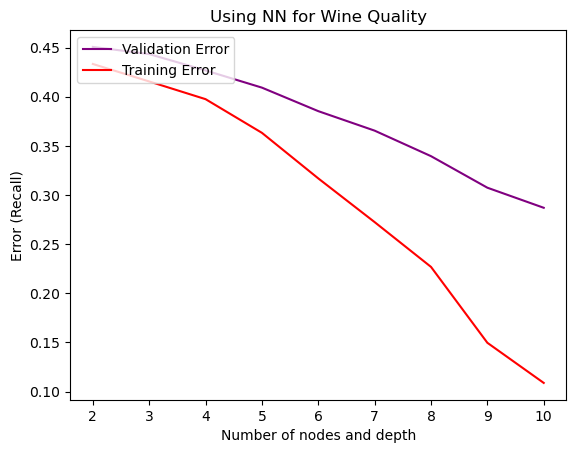

In [12]:
# [WINE QUALITY] Varying nodes

acc_w_train = []
acc_w_test = []
list_x = []
layer_u = [4]
for x in range(1, 10):
    layer_u[0] = layer_u[0]*2
#     layer_u.insert(0,layer_u[0])
    model = create_ann(x_train_w,y_train_w, dataset = 'wine', layer_units = layer_u, dropout = 0.2)
    test,train = strat_kfold_ann(clf = model, num_folds = 5, x_train = x_train_w, y_train = y_train_w, dataset = "wine", epochs = 50)
    acc_w_train.append(1-train)
    acc_w_test.append(1-test)
    list_x.append(x+1)
    print(1-train)
    print(1-test)
    print(x)
    

plt.clf()
plt.title('Using NN for Wine Quality')
plt.xlabel("Number of nodes and depth")
plt.ylabel("Error (Recall)")
plt.locator_params(axis='x')
plt.locator_params(axis='y')
plt.plot(list_x, acc_w_test, color='purple', label='Validation Error')
plt.plot(list_x, acc_w_train, color='red', label='Training Error')
plt.legend(loc="upper left")
# plt.savefig('Wine Quality_Decision Tree Error.png',
#             bbox_inches='tight')
plt.show()

Epoch 1/50
86/86 [==============================] - 0s 1ms/step - loss: 1.9129 - accuracy: 0.2433
Epoch 2/50
86/86 [==============================] - 0s 1ms/step - loss: 1.6482 - accuracy: 0.3906
Epoch 3/50
86/86 [==============================] - 0s 977us/step - loss: 1.4666 - accuracy: 0.4581
Epoch 4/50
86/86 [==============================] - 0s 1ms/step - loss: 1.3541 - accuracy: 0.4909
Epoch 5/50
86/86 [==============================] - 0s 962us/step - loss: 1.2913 - accuracy: 0.5022
Epoch 6/50
86/86 [==============================] - 0s 998us/step - loss: 1.2527 - accuracy: 0.5055
Epoch 7/50
86/86 [==============================] - 0s 991us/step - loss: 1.2260 - accuracy: 0.5157
Epoch 8/50
86/86 [==============================] - 0s 961us/step - loss: 1.2052 - accuracy: 0.5215
Epoch 9/50
86/86 [==============================] - 0s 972us/step - loss: 1.1884 - accuracy: 0.5281
Epoch 10/50
86/86 [==============================] - 0s 992us/step - loss: 1.1742 - accuracy: 0.5354
Epoch

86/86 [==============================] - 0s 904us/step - loss: 1.0218 - accuracy: 0.5636
Epoch 11/50
86/86 [==============================] - 0s 1ms/step - loss: 1.0211 - accuracy: 0.5680
Epoch 12/50
86/86 [==============================] - 0s 972us/step - loss: 1.0205 - accuracy: 0.5709
Epoch 13/50
86/86 [==============================] - 0s 931us/step - loss: 1.0204 - accuracy: 0.5673
Epoch 14/50
86/86 [==============================] - 0s 979us/step - loss: 1.0210 - accuracy: 0.5651
Epoch 15/50
86/86 [==============================] - 0s 957us/step - loss: 1.0201 - accuracy: 0.5713
Epoch 16/50
86/86 [==============================] - 0s 955us/step - loss: 1.0196 - accuracy: 0.5698
Epoch 17/50
86/86 [==============================] - 0s 959us/step - loss: 1.0190 - accuracy: 0.5669
Epoch 18/50
86/86 [==============================] - 0s 924us/step - loss: 1.0193 - accuracy: 0.5691
Epoch 19/50
86/86 [==============================] - 0s 983us/step - loss: 1.0187 - accuracy: 0.5702
Epoc

86/86 [==============================] - 0s 1ms/step - loss: 1.0074 - accuracy: 0.5726
Epoch 20/50
86/86 [==============================] - 0s 1ms/step - loss: 1.0067 - accuracy: 0.5700
Epoch 21/50
86/86 [==============================] - 0s 970us/step - loss: 1.0061 - accuracy: 0.5686
Epoch 22/50
86/86 [==============================] - 0s 955us/step - loss: 1.0054 - accuracy: 0.5635
Epoch 23/50
86/86 [==============================] - 0s 993us/step - loss: 1.0044 - accuracy: 0.5711
Epoch 24/50
86/86 [==============================] - 0s 973us/step - loss: 1.0037 - accuracy: 0.5733
Epoch 25/50
86/86 [==============================] - 0s 973us/step - loss: 1.0043 - accuracy: 0.5678
Epoch 26/50
86/86 [==============================] - 0s 1ms/step - loss: 1.0026 - accuracy: 0.5715
Epoch 27/50
86/86 [==============================] - 0s 991us/step - loss: 1.0025 - accuracy: 0.5704
Epoch 28/50
86/86 [==============================] - 0s 990us/step - loss: 1.0013 - accuracy: 0.5748
Epoch 29

86/86 [==============================] - 0s 953us/step - loss: 0.9793 - accuracy: 0.5822
Epoch 29/50
86/86 [==============================] - 0s 909us/step - loss: 0.9793 - accuracy: 0.5811
Epoch 30/50
86/86 [==============================] - 0s 1ms/step - loss: 0.9797 - accuracy: 0.5833
Epoch 31/50
86/86 [==============================] - 0s 1ms/step - loss: 0.9784 - accuracy: 0.5829
Epoch 32/50
86/86 [==============================] - 0s 959us/step - loss: 0.9786 - accuracy: 0.5811
Epoch 33/50
86/86 [==============================] - 0s 1ms/step - loss: 0.9791 - accuracy: 0.5826
Epoch 34/50
86/86 [==============================] - 0s 1ms/step - loss: 0.9788 - accuracy: 0.5859
Epoch 35/50
86/86 [==============================] - 0s 1ms/step - loss: 0.9784 - accuracy: 0.5844
Epoch 36/50
86/86 [==============================] - 0s 1ms/step - loss: 0.9779 - accuracy: 0.5859
Epoch 37/50
86/86 [==============================] - 0s 1ms/step - loss: 0.9780 - accuracy: 0.5859
Epoch 38/50
86/8

Epoch 8/50
86/86 [==============================] - 0s 992us/step - loss: 0.9787 - accuracy: 0.5868
Epoch 9/50
86/86 [==============================] - 0s 958us/step - loss: 0.9755 - accuracy: 0.5945
Epoch 10/50
86/86 [==============================] - 0s 955us/step - loss: 0.9731 - accuracy: 0.5941
Epoch 11/50
86/86 [==============================] - 0s 986us/step - loss: 0.9728 - accuracy: 0.5926
Epoch 12/50
86/86 [==============================] - 0s 1ms/step - loss: 0.9709 - accuracy: 0.5992
Epoch 13/50
86/86 [==============================] - 0s 977us/step - loss: 0.9694 - accuracy: 0.5919
Epoch 14/50
86/86 [==============================] - 0s 979us/step - loss: 0.9689 - accuracy: 0.6007
Epoch 15/50
86/86 [==============================] - 0s 970us/step - loss: 0.9680 - accuracy: 0.6007
Epoch 16/50
86/86 [==============================] - 0s 952us/step - loss: 0.9669 - accuracy: 0.5937
Epoch 17/50
86/86 [==============================] - 0s 962us/step - loss: 0.9663 - accuracy: 0

86/86 [==============================] - 0s 912us/step - loss: 0.9195 - accuracy: 0.6026
Epoch 18/50
86/86 [==============================] - 0s 1ms/step - loss: 0.9187 - accuracy: 0.5983
Epoch 19/50
86/86 [==============================] - 0s 933us/step - loss: 0.9194 - accuracy: 0.6026
Epoch 20/50
86/86 [==============================] - 0s 950us/step - loss: 0.9173 - accuracy: 0.6001
Epoch 21/50
86/86 [==============================] - 0s 1ms/step - loss: 0.9188 - accuracy: 0.6070
Epoch 22/50
86/86 [==============================] - 0s 959us/step - loss: 0.9186 - accuracy: 0.5946
Epoch 23/50
86/86 [==============================] - 0s 986us/step - loss: 0.9172 - accuracy: 0.6048
Epoch 24/50
86/86 [==============================] - 0s 957us/step - loss: 0.9170 - accuracy: 0.6015
Epoch 25/50
86/86 [==============================] - 0s 930us/step - loss: 0.9171 - accuracy: 0.6001
Epoch 26/50
86/86 [==============================] - 0s 969us/step - loss: 0.9157 - accuracy: 0.6037
Epoch 

86/86 [==============================] - 0s 1ms/step - loss: 0.8862 - accuracy: 0.6255
Epoch 27/50
86/86 [==============================] - 0s 978us/step - loss: 0.8837 - accuracy: 0.6284
Epoch 28/50
86/86 [==============================] - 0s 965us/step - loss: 0.8863 - accuracy: 0.6189
Epoch 29/50
86/86 [==============================] - 0s 957us/step - loss: 0.8847 - accuracy: 0.6302
Epoch 30/50
86/86 [==============================] - 0s 1ms/step - loss: 0.8821 - accuracy: 0.6295
Epoch 31/50
86/86 [==============================] - 0s 989us/step - loss: 0.8831 - accuracy: 0.6295
Epoch 32/50
86/86 [==============================] - 0s 1ms/step - loss: 0.8801 - accuracy: 0.6327
Epoch 33/50
86/86 [==============================] - 0s 1ms/step - loss: 0.8813 - accuracy: 0.6306
Epoch 34/50
86/86 [==============================] - 0s 964us/step - loss: 0.8794 - accuracy: 0.6258
Epoch 35/50
86/86 [==============================] - 0s 956us/step - loss: 0.8790 - accuracy: 0.6306
Epoch 36/5

86/86 [==============================] - 0s 964us/step - loss: 0.9355 - accuracy: 0.6123
Epoch 36/50
86/86 [==============================] - 0s 971us/step - loss: 0.9324 - accuracy: 0.6109
Epoch 37/50
86/86 [==============================] - 0s 1ms/step - loss: 0.9293 - accuracy: 0.6069
Epoch 38/50
86/86 [==============================] - 0s 1ms/step - loss: 0.9282 - accuracy: 0.6054
Epoch 39/50
86/86 [==============================] - 0s 959us/step - loss: 0.9275 - accuracy: 0.6127
Epoch 40/50
86/86 [==============================] - 0s 943us/step - loss: 0.9245 - accuracy: 0.6127
Epoch 41/50
86/86 [==============================] - 0s 912us/step - loss: 0.9235 - accuracy: 0.6134
Epoch 42/50
86/86 [==============================] - 0s 938us/step - loss: 0.9206 - accuracy: 0.6174
Epoch 43/50
86/86 [==============================] - 0s 952us/step - loss: 0.9208 - accuracy: 0.6156
Epoch 44/50
86/86 [==============================] - 0s 971us/step - loss: 0.9166 - accuracy: 0.6178
Epoch 

86/86 [==============================] - 0s 1ms/step - loss: 0.7480 - accuracy: 0.6938
Epoch 46/50
86/86 [==============================] - 0s 1ms/step - loss: 0.7465 - accuracy: 0.6960
Epoch 47/50
86/86 [==============================] - 0s 1ms/step - loss: 0.7456 - accuracy: 0.6967
Epoch 48/50
86/86 [==============================] - 0s 1ms/step - loss: 0.7406 - accuracy: 0.6981
Epoch 49/50
86/86 [==============================] - 0s 1ms/step - loss: 0.7432 - accuracy: 0.6978
Epoch 50/50
22/22 [==============================] - 0s 956us/step
Epoch 1/50
86/86 [==============================] - 0s 1ms/step - loss: 0.7921 - accuracy: 0.6777
Epoch 2/50
86/86 [==============================] - 0s 1ms/step - loss: 0.7836 - accuracy: 0.6828
Epoch 3/50
86/86 [==============================] - 0s 1ms/step - loss: 0.7828 - accuracy: 0.6792
Epoch 4/50
86/86 [==============================] - 0s 1ms/step - loss: 0.7757 - accuracy: 0.6941
Epoch 5/50
86/86 [==============================] - 0s 1ms

86/86 [==============================] - 0s 1ms/step - loss: 0.7870 - accuracy: 0.6725
Epoch 5/50
86/86 [==============================] - 0s 994us/step - loss: 0.7860 - accuracy: 0.6816
Epoch 6/50
86/86 [==============================] - 0s 983us/step - loss: 0.7794 - accuracy: 0.6842
Epoch 7/50
86/86 [==============================] - 0s 943us/step - loss: 0.7754 - accuracy: 0.6885
Epoch 8/50
86/86 [==============================] - 0s 1ms/step - loss: 0.7743 - accuracy: 0.6918
Epoch 9/50
86/86 [==============================] - 0s 994us/step - loss: 0.7670 - accuracy: 0.6885
Epoch 10/50
86/86 [==============================] - 0s 1ms/step - loss: 0.7667 - accuracy: 0.6933
Epoch 11/50
86/86 [==============================] - 0s 990us/step - loss: 0.7664 - accuracy: 0.6944
Epoch 12/50
86/86 [==============================] - 0s 963us/step - loss: 0.7615 - accuracy: 0.6849
Epoch 13/50
86/86 [==============================] - 0s 948us/step - loss: 0.7548 - accuracy: 0.6977
Epoch 14/50
8

86/86 [==============================] - 0s 1ms/step - loss: 0.9622 - accuracy: 0.5999
Epoch 14/50
86/86 [==============================] - 0s 1ms/step - loss: 0.9553 - accuracy: 0.6039
Epoch 15/50
86/86 [==============================] - 0s 1ms/step - loss: 0.9482 - accuracy: 0.6069
Epoch 16/50
86/86 [==============================] - 0s 1ms/step - loss: 0.9426 - accuracy: 0.6127
Epoch 17/50
86/86 [==============================] - 0s 1ms/step - loss: 0.9390 - accuracy: 0.6010
Epoch 18/50
86/86 [==============================] - 0s 1ms/step - loss: 0.9383 - accuracy: 0.6080
Epoch 19/50
86/86 [==============================] - 0s 1ms/step - loss: 0.9326 - accuracy: 0.6101
Epoch 20/50
86/86 [==============================] - 0s 1ms/step - loss: 0.9258 - accuracy: 0.6142
Epoch 21/50
86/86 [==============================] - 0s 1ms/step - loss: 0.9235 - accuracy: 0.6178
Epoch 22/50
86/86 [==============================] - 0s 1ms/step - loss: 0.9216 - accuracy: 0.6094
Epoch 23/50
86/86 [===

86/86 [==============================] - 0s 1ms/step - loss: 0.5308 - accuracy: 0.8068
Epoch 25/50
86/86 [==============================] - 0s 1ms/step - loss: 0.5388 - accuracy: 0.8057
Epoch 26/50
86/86 [==============================] - 0s 1ms/step - loss: 0.5235 - accuracy: 0.8071
Epoch 27/50
86/86 [==============================] - 0s 1ms/step - loss: 0.5307 - accuracy: 0.7995
Epoch 28/50
86/86 [==============================] - 0s 1ms/step - loss: 0.5302 - accuracy: 0.8013
Epoch 29/50
86/86 [==============================] - 0s 1ms/step - loss: 0.5249 - accuracy: 0.8093
Epoch 30/50
86/86 [==============================] - 0s 1ms/step - loss: 0.5163 - accuracy: 0.8122
Epoch 31/50
86/86 [==============================] - 0s 1ms/step - loss: 0.5154 - accuracy: 0.8130
Epoch 32/50
86/86 [==============================] - 0s 1ms/step - loss: 0.5163 - accuracy: 0.8097
Epoch 33/50
86/86 [==============================] - 0s 1ms/step - loss: 0.5133 - accuracy: 0.8108
Epoch 34/50
86/86 [===

86/86 [==============================] - 0s 1ms/step - loss: 0.6345 - accuracy: 0.7498
Epoch 36/50
86/86 [==============================] - 0s 1ms/step - loss: 0.6269 - accuracy: 0.7575
Epoch 37/50
86/86 [==============================] - 0s 1ms/step - loss: 0.6211 - accuracy: 0.7608
Epoch 38/50
86/86 [==============================] - 0s 1ms/step - loss: 0.6197 - accuracy: 0.7524
Epoch 39/50
86/86 [==============================] - 0s 1ms/step - loss: 0.6090 - accuracy: 0.7699
Epoch 40/50
86/86 [==============================] - 0s 1ms/step - loss: 0.6080 - accuracy: 0.7615
Epoch 41/50
86/86 [==============================] - 0s 1ms/step - loss: 0.6004 - accuracy: 0.7717
Epoch 42/50
86/86 [==============================] - 0s 1ms/step - loss: 0.6038 - accuracy: 0.7706
Epoch 43/50
86/86 [==============================] - 0s 1ms/step - loss: 0.6064 - accuracy: 0.7710
Epoch 44/50
86/86 [==============================] - 0s 1ms/step - loss: 0.5912 - accuracy: 0.7837
Epoch 45/50
86/86 [===

86/86 [==============================] - 0s 1ms/step - loss: 0.2619 - accuracy: 0.9242
Epoch 47/50
86/86 [==============================] - 0s 1ms/step - loss: 0.2572 - accuracy: 0.9285
Epoch 48/50
86/86 [==============================] - 0s 1ms/step - loss: 0.2424 - accuracy: 0.9366
Epoch 49/50
86/86 [==============================] - 0s 1ms/step - loss: 0.2336 - accuracy: 0.9413
Epoch 50/50
22/22 [==============================] - 0s 890us/step
0.15396613300934692
0.3109050669277095
62
Epoch 1/50
86/86 [==============================] - 0s 1ms/step - loss: 1.2137 - accuracy: 0.5179
Epoch 2/50
86/86 [==============================] - 0s 1ms/step - loss: 1.0708 - accuracy: 0.5671
Epoch 3/50
86/86 [==============================] - 0s 1ms/step - loss: 1.0464 - accuracy: 0.5682
Epoch 4/50
86/86 [==============================] - 0s 1ms/step - loss: 1.0219 - accuracy: 0.5678
Epoch 5/50
86/86 [==============================] - 0s 1ms/step - loss: 1.0096 - accuracy: 0.5788
Epoch 6/50
86/86 

86/86 [==============================] - 0s 1ms/step - loss: 0.3561 - accuracy: 0.8757
Epoch 7/50
86/86 [==============================] - 0s 1ms/step - loss: 0.3422 - accuracy: 0.8797
Epoch 8/50
86/86 [==============================] - 0s 1ms/step - loss: 0.3185 - accuracy: 0.8976
Epoch 9/50
86/86 [==============================] - 0s 1ms/step - loss: 0.3212 - accuracy: 0.8965
Epoch 10/50
86/86 [==============================] - 0s 1ms/step - loss: 0.3202 - accuracy: 0.8954
Epoch 11/50
86/86 [==============================] - 0s 1ms/step - loss: 0.3121 - accuracy: 0.8990
Epoch 12/50
86/86 [==============================] - 0s 1ms/step - loss: 0.3137 - accuracy: 0.8976
Epoch 13/50
86/86 [==============================] - 0s 1ms/step - loss: 0.3023 - accuracy: 0.9070
Epoch 14/50
86/86 [==============================] - 0s 1ms/step - loss: 0.3142 - accuracy: 0.8979
Epoch 15/50
86/86 [==============================] - 0s 1ms/step - loss: 0.2940 - accuracy: 0.9154
Epoch 16/50
86/86 [======

86/86 [==============================] - 0s 2ms/step - loss: 0.5529 - accuracy: 0.7845
Epoch 18/50
86/86 [==============================] - 0s 1ms/step - loss: 0.5412 - accuracy: 0.7921
Epoch 19/50
86/86 [==============================] - 0s 1ms/step - loss: 0.5289 - accuracy: 0.7987
Epoch 20/50
86/86 [==============================] - 0s 1ms/step - loss: 0.5161 - accuracy: 0.8053
Epoch 21/50
86/86 [==============================] - 0s 2ms/step - loss: 0.5166 - accuracy: 0.8063
Epoch 22/50
86/86 [==============================] - 0s 1ms/step - loss: 0.5084 - accuracy: 0.8071
Epoch 23/50
86/86 [==============================] - 0s 1ms/step - loss: 0.4974 - accuracy: 0.8042
Epoch 24/50
86/86 [==============================] - 0s 1ms/step - loss: 0.4857 - accuracy: 0.8173
Epoch 25/50
86/86 [==============================] - 0s 1ms/step - loss: 0.4841 - accuracy: 0.8191
Epoch 26/50
86/86 [==============================] - 0s 1ms/step - loss: 0.4758 - accuracy: 0.8249
Epoch 27/50
86/86 [===

86/86 [==============================] - 0s 1ms/step - loss: 0.1361 - accuracy: 0.9654
Epoch 29/50
86/86 [==============================] - 0s 1ms/step - loss: 0.1622 - accuracy: 0.9581
Epoch 30/50
86/86 [==============================] - 0s 1ms/step - loss: 0.1914 - accuracy: 0.9464
Epoch 31/50
86/86 [==============================] - 0s 1ms/step - loss: 0.1111 - accuracy: 0.9748
Epoch 32/50
86/86 [==============================] - 0s 1ms/step - loss: 0.1033 - accuracy: 0.9763
Epoch 33/50
86/86 [==============================] - 0s 1ms/step - loss: 0.0847 - accuracy: 0.9869
Epoch 34/50
86/86 [==============================] - 0s 1ms/step - loss: 0.0802 - accuracy: 0.9898
Epoch 35/50
86/86 [==============================] - 0s 1ms/step - loss: 0.0761 - accuracy: 0.9887
Epoch 36/50
86/86 [==============================] - 0s 1ms/step - loss: 0.1329 - accuracy: 0.9635
Epoch 37/50
86/86 [==============================] - 0s 2ms/step - loss: 0.1599 - accuracy: 0.9533
Epoch 38/50
86/86 [===

86/86 [==============================] - 0s 2ms/step - loss: 0.1798 - accuracy: 0.9559
Epoch 40/50
86/86 [==============================] - 0s 2ms/step - loss: 0.1771 - accuracy: 0.9555
Epoch 41/50
86/86 [==============================] - 0s 2ms/step - loss: 0.1613 - accuracy: 0.9584
Epoch 42/50
86/86 [==============================] - 0s 2ms/step - loss: 0.1499 - accuracy: 0.9632
Epoch 43/50
86/86 [==============================] - 0s 2ms/step - loss: 0.1463 - accuracy: 0.9602
Epoch 44/50
86/86 [==============================] - 0s 2ms/step - loss: 0.1708 - accuracy: 0.9508
Epoch 45/50
86/86 [==============================] - 0s 2ms/step - loss: 0.1596 - accuracy: 0.9573
Epoch 46/50
86/86 [==============================] - 0s 2ms/step - loss: 0.1491 - accuracy: 0.9624
Epoch 47/50
86/86 [==============================] - 0s 2ms/step - loss: 0.1587 - accuracy: 0.9581
Epoch 48/50
86/86 [==============================] - 0s 2ms/step - loss: 0.1361 - accuracy: 0.9716
Epoch 49/50
86/86 [===

22/22 [==============================] - 0s 1ms/step
Epoch 1/50
86/86 [==============================] - 0s 2ms/step - loss: 0.7598 - accuracy: 0.7305
Epoch 2/50
86/86 [==============================] - 0s 2ms/step - loss: 0.6954 - accuracy: 0.7371
Epoch 3/50
86/86 [==============================] - 0s 2ms/step - loss: 0.6031 - accuracy: 0.7750
Epoch 4/50
86/86 [==============================] - 0s 3ms/step - loss: 0.5903 - accuracy: 0.7637
Epoch 5/50
86/86 [==============================] - 0s 2ms/step - loss: 0.5587 - accuracy: 0.7877
Epoch 6/50
86/86 [==============================] - 0s 3ms/step - loss: 0.5472 - accuracy: 0.7921
Epoch 7/50
86/86 [==============================] - 0s 3ms/step - loss: 0.5603 - accuracy: 0.7881
Epoch 8/50
86/86 [==============================] - 0s 3ms/step - loss: 0.5163 - accuracy: 0.8038
Epoch 9/50
86/86 [==============================] - 0s 2ms/step - loss: 0.5177 - accuracy: 0.8053
Epoch 10/50
86/86 [==============================] - 0s 2ms/step 

86/86 [==============================] - 0s 3ms/step - loss: 0.0629 - accuracy: 0.9891
Epoch 11/50
86/86 [==============================] - 0s 3ms/step - loss: 0.0638 - accuracy: 0.9894
Epoch 12/50
86/86 [==============================] - 0s 2ms/step - loss: 0.0758 - accuracy: 0.9887
Epoch 13/50
86/86 [==============================] - 0s 3ms/step - loss: 0.1292 - accuracy: 0.9654
Epoch 14/50
86/86 [==============================] - 0s 3ms/step - loss: 0.1104 - accuracy: 0.9723
Epoch 15/50
86/86 [==============================] - 0s 3ms/step - loss: 0.0994 - accuracy: 0.9748
Epoch 16/50
86/86 [==============================] - 0s 3ms/step - loss: 0.0927 - accuracy: 0.9770
Epoch 17/50
86/86 [==============================] - 0s 3ms/step - loss: 0.0989 - accuracy: 0.9763
Epoch 18/50
86/86 [==============================] - 0s 3ms/step - loss: 0.0866 - accuracy: 0.9854
Epoch 19/50
86/86 [==============================] - 0s 2ms/step - loss: 0.1017 - accuracy: 0.9770
Epoch 20/50
86/86 [===

86/86 [==============================] - 0s 4ms/step - loss: 0.2049 - accuracy: 0.9409
Epoch 22/50
86/86 [==============================] - 0s 4ms/step - loss: 0.1990 - accuracy: 0.9438
Epoch 23/50
86/86 [==============================] - 0s 4ms/step - loss: 0.1742 - accuracy: 0.9548
Epoch 24/50
86/86 [==============================] - 0s 4ms/step - loss: 0.2526 - accuracy: 0.9311
Epoch 25/50
86/86 [==============================] - 0s 4ms/step - loss: 0.2351 - accuracy: 0.9230
Epoch 26/50
86/86 [==============================] - 0s 4ms/step - loss: 0.2339 - accuracy: 0.9292
Epoch 27/50
86/86 [==============================] - 0s 4ms/step - loss: 0.2447 - accuracy: 0.9263
Epoch 28/50
86/86 [==============================] - 0s 4ms/step - loss: 0.1922 - accuracy: 0.9457
Epoch 29/50
86/86 [==============================] - 0s 4ms/step - loss: 0.1507 - accuracy: 0.9635
Epoch 30/50
86/86 [==============================] - 0s 4ms/step - loss: 0.1428 - accuracy: 0.9683
Epoch 31/50
86/86 [===

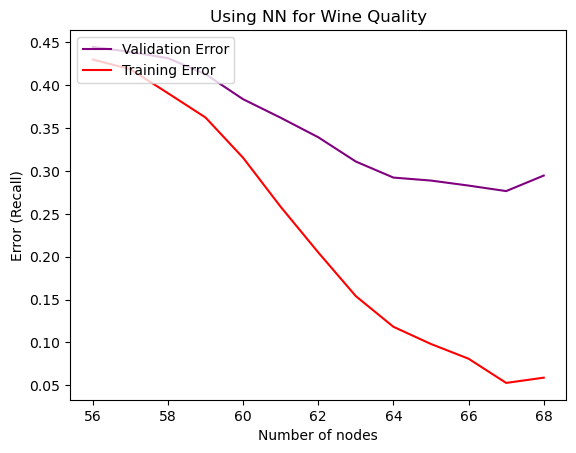

In [60]:
# [WINE QUALITY] Varying nodes

acc_w_train = []
acc_w_test = []
list_x = []
layer_u = [4]
for x in range(55, 68):
    layer_u[0] = layer_u[0]*2
#     layer_u.insert(0,layer_u[0])
    model = create_ann(x_train_w,y_train_w, dataset = 'wine', layer_units = layer_u, dropout = 0.2)
    test,train = strat_kfold_ann(clf = model, num_folds = 5, x_train = x_train_w, y_train = y_train_w, dataset = "wine", epochs = 50)
    acc_w_train.append(1-train)
    acc_w_test.append(1-test)
    list_x.append(x+1)
    print(1-train)
    print(1-test)
    print(x)
    

plt.clf()
plt.title('Using NN for Wine Quality')
plt.xlabel("Number of nodes")
plt.ylabel("Error (Recall)")
plt.locator_params(axis='x')
plt.locator_params(axis='y')
plt.plot(list_x, acc_w_test, color='purple', label='Validation Error')
plt.plot(list_x, acc_w_train, color='red', label='Training Error')
plt.legend(loc="upper left")
# plt.savefig('Wine Quality_Decision Tree Error.png',
#             bbox_inches='tight')
plt.show()

Epoch 1/50
70/70 [==============================] - 0s 911us/step - loss: 0.8082 - accuracy: 0.4920
Epoch 2/50
70/70 [==============================] - 0s 923us/step - loss: 0.6769 - accuracy: 0.5580
Epoch 3/50
70/70 [==============================] - 0s 858us/step - loss: 0.5982 - accuracy: 0.6759
Epoch 4/50
70/70 [==============================] - 0s 913us/step - loss: 0.5476 - accuracy: 0.7384
Epoch 5/50
70/70 [==============================] - 0s 897us/step - loss: 0.5111 - accuracy: 0.7607
Epoch 6/50
70/70 [==============================] - 0s 847us/step - loss: 0.4836 - accuracy: 0.7728
Epoch 7/50
70/70 [==============================] - 0s 942us/step - loss: 0.4628 - accuracy: 0.7821
Epoch 8/50
70/70 [==============================] - 0s 891us/step - loss: 0.4471 - accuracy: 0.7888
Epoch 9/50
70/70 [==============================] - 0s 952us/step - loss: 0.4349 - accuracy: 0.7960
Epoch 10/50
70/70 [==============================] - 0s 851us/step - loss: 0.4253 - accuracy: 0.8009

70/70 [==============================] - 0s 1ms/step - loss: 0.2692 - accuracy: 0.8799
Epoch 11/50
70/70 [==============================] - 0s 973us/step - loss: 0.2689 - accuracy: 0.8830
Epoch 12/50
70/70 [==============================] - 0s 926us/step - loss: 0.2688 - accuracy: 0.8813
Epoch 13/50
70/70 [==============================] - 0s 949us/step - loss: 0.2683 - accuracy: 0.8786
Epoch 14/50
70/70 [==============================] - 0s 1ms/step - loss: 0.2679 - accuracy: 0.8839
Epoch 15/50
70/70 [==============================] - 0s 996us/step - loss: 0.2674 - accuracy: 0.8853
Epoch 16/50
70/70 [==============================] - 0s 1ms/step - loss: 0.2676 - accuracy: 0.8848
Epoch 17/50
70/70 [==============================] - 0s 972us/step - loss: 0.2671 - accuracy: 0.8844
Epoch 18/50
70/70 [==============================] - 0s 927us/step - loss: 0.2675 - accuracy: 0.8853
Epoch 19/50
70/70 [==============================] - 0s 879us/step - loss: 0.2664 - accuracy: 0.8835
Epoch 20

70/70 [==============================] - 0s 892us/step - loss: 0.2786 - accuracy: 0.8772
Epoch 19/50
70/70 [==============================] - 0s 945us/step - loss: 0.2779 - accuracy: 0.8786
Epoch 20/50
70/70 [==============================] - 0s 879us/step - loss: 0.2771 - accuracy: 0.8826
Epoch 21/50
70/70 [==============================] - 0s 838us/step - loss: 0.2759 - accuracy: 0.8795
Epoch 22/50
70/70 [==============================] - 0s 865us/step - loss: 0.2758 - accuracy: 0.8817
Epoch 23/50
70/70 [==============================] - 0s 925us/step - loss: 0.2741 - accuracy: 0.8826
Epoch 24/50
70/70 [==============================] - 0s 879us/step - loss: 0.2738 - accuracy: 0.8835
Epoch 25/50
70/70 [==============================] - 0s 860us/step - loss: 0.2725 - accuracy: 0.8826
Epoch 26/50
70/70 [==============================] - 0s 889us/step - loss: 0.2717 - accuracy: 0.8821
Epoch 27/50
70/70 [==============================] - 0s 914us/step - loss: 0.2708 - accuracy: 0.8835
Ep

70/70 [==============================] - 0s 835us/step - loss: 0.2195 - accuracy: 0.9040
Epoch 28/50
70/70 [==============================] - 0s 850us/step - loss: 0.2192 - accuracy: 0.9045
Epoch 29/50
70/70 [==============================] - 0s 838us/step - loss: 0.2184 - accuracy: 0.9045
Epoch 30/50
70/70 [==============================] - 0s 841us/step - loss: 0.2187 - accuracy: 0.9027
Epoch 31/50
70/70 [==============================] - 0s 859us/step - loss: 0.2198 - accuracy: 0.9054
Epoch 32/50
70/70 [==============================] - 0s 971us/step - loss: 0.2189 - accuracy: 0.9022
Epoch 33/50
70/70 [==============================] - 0s 874us/step - loss: 0.2187 - accuracy: 0.9062
Epoch 34/50
70/70 [==============================] - 0s 857us/step - loss: 0.2173 - accuracy: 0.9054
Epoch 35/50
70/70 [==============================] - 0s 836us/step - loss: 0.2174 - accuracy: 0.9013
Epoch 36/50
70/70 [==============================] - 0s 815us/step - loss: 0.2177 - accuracy: 0.9045
Ep

70/70 [==============================] - 0s 938us/step - loss: 0.1865 - accuracy: 0.9268
Epoch 36/50
70/70 [==============================] - 0s 937us/step - loss: 0.1845 - accuracy: 0.9308
Epoch 37/50
70/70 [==============================] - 0s 918us/step - loss: 0.1846 - accuracy: 0.9263
Epoch 38/50
70/70 [==============================] - 0s 922us/step - loss: 0.1840 - accuracy: 0.9277
Epoch 39/50
70/70 [==============================] - 0s 923us/step - loss: 0.1832 - accuracy: 0.9317
Epoch 40/50
70/70 [==============================] - 0s 931us/step - loss: 0.1837 - accuracy: 0.9299
Epoch 41/50
70/70 [==============================] - 0s 911us/step - loss: 0.1827 - accuracy: 0.9308
Epoch 42/50
70/70 [==============================] - 0s 909us/step - loss: 0.1819 - accuracy: 0.9330
Epoch 43/50
70/70 [==============================] - 0s 915us/step - loss: 0.1820 - accuracy: 0.9290
Epoch 44/50
70/70 [==============================] - 0s 984us/step - loss: 0.1803 - accuracy: 0.9317
Ep

Epoch 44/50
70/70 [==============================] - 0s 1ms/step - loss: 0.2309 - accuracy: 0.9009
Epoch 45/50
70/70 [==============================] - 0s 849us/step - loss: 0.2295 - accuracy: 0.9031
Epoch 46/50
70/70 [==============================] - 0s 872us/step - loss: 0.2283 - accuracy: 0.9022
Epoch 47/50
70/70 [==============================] - 0s 851us/step - loss: 0.2267 - accuracy: 0.9022
Epoch 48/50
70/70 [==============================] - 0s 851us/step - loss: 0.2256 - accuracy: 0.9013
Epoch 49/50
70/70 [==============================] - 0s 876us/step - loss: 0.2235 - accuracy: 0.9049
Epoch 50/50
18/18 [==============================] - 0s 829us/step
Epoch 1/50
70/70 [==============================] - 0s 923us/step - loss: 0.2449 - accuracy: 0.8969
Epoch 2/50
70/70 [==============================] - 0s 866us/step - loss: 0.2417 - accuracy: 0.8955
Epoch 3/50
70/70 [==============================] - 0s 894us/step - loss: 0.2390 - accuracy: 0.8982
Epoch 4/50
70/70 [===========

70/70 [==============================] - 0s 928us/step - loss: 0.1411 - accuracy: 0.9504
Epoch 3/50
70/70 [==============================] - 0s 936us/step - loss: 0.1390 - accuracy: 0.9500
Epoch 4/50
70/70 [==============================] - 0s 900us/step - loss: 0.1384 - accuracy: 0.9496
Epoch 5/50
70/70 [==============================] - 0s 899us/step - loss: 0.1377 - accuracy: 0.9473
Epoch 6/50
70/70 [==============================] - 0s 899us/step - loss: 0.1370 - accuracy: 0.9504
Epoch 7/50
70/70 [==============================] - 0s 866us/step - loss: 0.1355 - accuracy: 0.9522
Epoch 8/50
70/70 [==============================] - 0s 939us/step - loss: 0.1353 - accuracy: 0.9513
Epoch 9/50
70/70 [==============================] - 0s 965us/step - loss: 0.1347 - accuracy: 0.9513
Epoch 10/50
70/70 [==============================] - 0s 1ms/step - loss: 0.1346 - accuracy: 0.9540
Epoch 11/50
70/70 [==============================] - 0s 969us/step - loss: 0.1328 - accuracy: 0.9531
Epoch 12/50

70/70 [==============================] - 0s 850us/step - loss: 0.1364 - accuracy: 0.9478
Epoch 11/50
70/70 [==============================] - 0s 846us/step - loss: 0.1350 - accuracy: 0.9513
Epoch 12/50
70/70 [==============================] - 0s 879us/step - loss: 0.1334 - accuracy: 0.9540
Epoch 13/50
70/70 [==============================] - 0s 980us/step - loss: 0.1352 - accuracy: 0.9518
Epoch 14/50
70/70 [==============================] - 0s 992us/step - loss: 0.1337 - accuracy: 0.9531
Epoch 15/50
70/70 [==============================] - 0s 865us/step - loss: 0.1319 - accuracy: 0.9531
Epoch 16/50
70/70 [==============================] - 0s 902us/step - loss: 0.1336 - accuracy: 0.9540
Epoch 17/50
70/70 [==============================] - 0s 874us/step - loss: 0.1299 - accuracy: 0.9549
Epoch 18/50
70/70 [==============================] - 0s 844us/step - loss: 0.1309 - accuracy: 0.9549
Epoch 19/50
70/70 [==============================] - 0s 842us/step - loss: 0.1293 - accuracy: 0.9545
Ep

70/70 [==============================] - 0s 1ms/step - loss: 0.2394 - accuracy: 0.8911
Epoch 19/50
70/70 [==============================] - 0s 953us/step - loss: 0.2350 - accuracy: 0.8960
Epoch 20/50
70/70 [==============================] - 0s 973us/step - loss: 0.2304 - accuracy: 0.9018
Epoch 21/50
70/70 [==============================] - 0s 978us/step - loss: 0.2298 - accuracy: 0.8978
Epoch 22/50
70/70 [==============================] - 0s 986us/step - loss: 0.2268 - accuracy: 0.9000
Epoch 23/50
70/70 [==============================] - 0s 947us/step - loss: 0.2246 - accuracy: 0.9000
Epoch 24/50
70/70 [==============================] - 0s 982us/step - loss: 0.2211 - accuracy: 0.9031
Epoch 25/50
70/70 [==============================] - 0s 1ms/step - loss: 0.2180 - accuracy: 0.9067
Epoch 26/50
70/70 [==============================] - 0s 933us/step - loss: 0.2166 - accuracy: 0.9058
Epoch 27/50
70/70 [==============================] - 0s 983us/step - loss: 0.2137 - accuracy: 0.9094
Epoch 

70/70 [==============================] - 0s 979us/step - loss: 0.0817 - accuracy: 0.9750
Epoch 28/50
70/70 [==============================] - 0s 1ms/step - loss: 0.0806 - accuracy: 0.9737
Epoch 29/50
70/70 [==============================] - 0s 958us/step - loss: 0.0796 - accuracy: 0.9750
Epoch 30/50
70/70 [==============================] - 0s 904us/step - loss: 0.0792 - accuracy: 0.9759
Epoch 31/50
70/70 [==============================] - 0s 922us/step - loss: 0.0767 - accuracy: 0.9781
Epoch 32/50
70/70 [==============================] - 0s 929us/step - loss: 0.0818 - accuracy: 0.9754
Epoch 33/50
70/70 [==============================] - 0s 964us/step - loss: 0.0782 - accuracy: 0.9759
Epoch 34/50
70/70 [==============================] - 0s 892us/step - loss: 0.0781 - accuracy: 0.9759
Epoch 35/50
70/70 [==============================] - 0s 887us/step - loss: 0.0772 - accuracy: 0.9768
Epoch 36/50
70/70 [==============================] - 0s 895us/step - loss: 0.0769 - accuracy: 0.9768
Epoc

70/70 [==============================] - 0s 1ms/step - loss: 0.1127 - accuracy: 0.9616
Epoch 36/50
70/70 [==============================] - 0s 1ms/step - loss: 0.1136 - accuracy: 0.9603
Epoch 37/50
70/70 [==============================] - 0s 959us/step - loss: 0.1125 - accuracy: 0.9585
Epoch 38/50
70/70 [==============================] - 0s 949us/step - loss: 0.1108 - accuracy: 0.9616
Epoch 39/50
70/70 [==============================] - 0s 944us/step - loss: 0.1058 - accuracy: 0.9647
Epoch 40/50
70/70 [==============================] - 0s 982us/step - loss: 0.1044 - accuracy: 0.9652
Epoch 41/50
70/70 [==============================] - 0s 972us/step - loss: 0.1054 - accuracy: 0.9674
Epoch 42/50
70/70 [==============================] - 0s 991us/step - loss: 0.1057 - accuracy: 0.9634
Epoch 43/50
70/70 [==============================] - 0s 1ms/step - loss: 0.1049 - accuracy: 0.9670
Epoch 44/50
70/70 [==============================] - 0s 1ms/step - loss: 0.1028 - accuracy: 0.9661
Epoch 45/5

70/70 [==============================] - 0s 1ms/step - loss: 0.0403 - accuracy: 0.9897
Epoch 45/50
70/70 [==============================] - 0s 899us/step - loss: 0.0387 - accuracy: 0.9902
Epoch 46/50
70/70 [==============================] - 0s 900us/step - loss: 0.0394 - accuracy: 0.9897
Epoch 47/50
70/70 [==============================] - 0s 914us/step - loss: 0.0408 - accuracy: 0.9884
Epoch 48/50
70/70 [==============================] - 0s 892us/step - loss: 0.0363 - accuracy: 0.9911
Epoch 49/50
70/70 [==============================] - 0s 923us/step - loss: 0.0404 - accuracy: 0.9879
Epoch 50/50
18/18 [==============================] - 0s 736us/step
0.022767857142857117
0.05142857142857138
7
Epoch 1/50
70/70 [==============================] - 0s 987us/step - loss: 0.4639 - accuracy: 0.7746
Epoch 2/50
70/70 [==============================] - 0s 1ms/step - loss: 0.3477 - accuracy: 0.8406
Epoch 3/50
70/70 [==============================] - 0s 982us/step - loss: 0.3120 - accuracy: 0.8594


70/70 [==============================] - 0s 909us/step - loss: 0.0705 - accuracy: 0.9781
Epoch 3/50
70/70 [==============================] - 0s 962us/step - loss: 0.0667 - accuracy: 0.9768
Epoch 4/50
70/70 [==============================] - 0s 933us/step - loss: 0.0620 - accuracy: 0.9772
Epoch 5/50
70/70 [==============================] - 0s 922us/step - loss: 0.0614 - accuracy: 0.9786
Epoch 6/50
70/70 [==============================] - 0s 952us/step - loss: 0.0544 - accuracy: 0.9830
Epoch 7/50
70/70 [==============================] - 0s 946us/step - loss: 0.0555 - accuracy: 0.9844
Epoch 8/50
70/70 [==============================] - 0s 968us/step - loss: 0.0590 - accuracy: 0.9804
Epoch 9/50
70/70 [==============================] - 0s 1ms/step - loss: 0.0593 - accuracy: 0.9786
Epoch 10/50
70/70 [==============================] - 0s 968us/step - loss: 0.0595 - accuracy: 0.9795
Epoch 11/50
70/70 [==============================] - 0s 939us/step - loss: 0.0627 - accuracy: 0.9777
Epoch 12/50

Epoch 12/50
70/70 [==============================] - 0s 1ms/step - loss: 0.1098 - accuracy: 0.9625
Epoch 13/50
70/70 [==============================] - 0s 1ms/step - loss: 0.0990 - accuracy: 0.9612
Epoch 14/50
70/70 [==============================] - 0s 1ms/step - loss: 0.1007 - accuracy: 0.9638
Epoch 15/50
70/70 [==============================] - 0s 1ms/step - loss: 0.1003 - accuracy: 0.9647
Epoch 16/50
70/70 [==============================] - 0s 1ms/step - loss: 0.0984 - accuracy: 0.9638
Epoch 17/50
70/70 [==============================] - 0s 1ms/step - loss: 0.0951 - accuracy: 0.9629
Epoch 18/50
70/70 [==============================] - 0s 1ms/step - loss: 0.0953 - accuracy: 0.9656
Epoch 19/50
70/70 [==============================] - 0s 1ms/step - loss: 0.0943 - accuracy: 0.9661
Epoch 20/50
70/70 [==============================] - 0s 1ms/step - loss: 0.0937 - accuracy: 0.9670
Epoch 21/50
70/70 [==============================] - 0s 1ms/step - loss: 0.0894 - accuracy: 0.9692
Epoch 22/5

70/70 [==============================] - 0s 1ms/step - loss: 0.0185 - accuracy: 0.9960
Epoch 24/50
70/70 [==============================] - 0s 1ms/step - loss: 0.0166 - accuracy: 0.9987
Epoch 25/50
70/70 [==============================] - 0s 1ms/step - loss: 0.0164 - accuracy: 0.9991
Epoch 26/50
70/70 [==============================] - 0s 1ms/step - loss: 0.0158 - accuracy: 0.9982
Epoch 27/50
70/70 [==============================] - 0s 1ms/step - loss: 0.0176 - accuracy: 0.9973
Epoch 28/50
70/70 [==============================] - 0s 1ms/step - loss: 0.0212 - accuracy: 0.9946
Epoch 29/50
70/70 [==============================] - 0s 1ms/step - loss: 0.0201 - accuracy: 0.9960
Epoch 30/50
70/70 [==============================] - 0s 1ms/step - loss: 0.0207 - accuracy: 0.9942
Epoch 31/50
70/70 [==============================] - 0s 1ms/step - loss: 0.0168 - accuracy: 0.9987
Epoch 32/50
70/70 [==============================] - 0s 1ms/step - loss: 0.0171 - accuracy: 0.9960
Epoch 33/50
70/70 [===

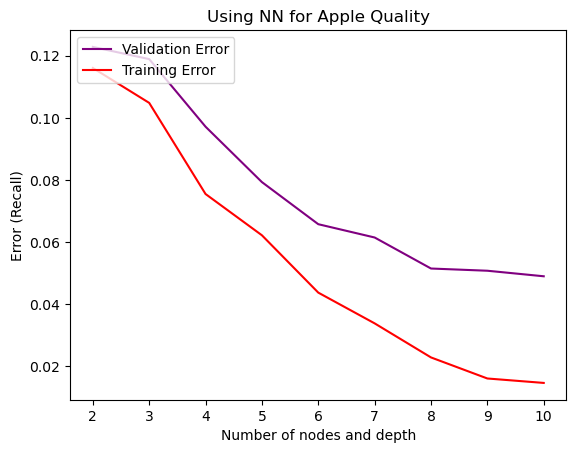

In [13]:
# [APPLE QUALITY] Varying nodes

acc_w_train = []
acc_w_test = []
list_x = []
layer_u = [4]
for x in range(1, 10):
    layer_u[0] = layer_u[0]*2
    model = create_ann(x_train_a,y_train_a, dataset = 'apple', layer_units = layer_u, dropout=0.2)
    test,train = strat_kfold_ann(clf = model, num_folds = 5, x_train = x_train_a, y_train = y_train_a, dataset = "apple", epochs = 50)
    acc_w_train.append(1-train)
    acc_w_test.append(1-test)
    list_x.append(x+1)
    print(1-train)
    print(1-test)
    print(x)
    

plt.clf()
plt.title('Using NN for Apple Quality')
plt.xlabel("Number of nodes and depth")
plt.ylabel("Error (Recall)")
plt.locator_params(axis='x')
plt.locator_params(axis='y')
plt.plot(list_x, acc_w_test, color='purple', label='Validation Error')
plt.plot(list_x, acc_w_train, color='red', label='Training Error')
plt.legend(loc="upper left")
# plt.savefig('Wine Quality_Decision Tree Error.png',
#             bbox_inches='tight')
plt.show()

Epoch 1/50
70/70 [==============================] - 0s 1ms/step - loss: 0.8234 - accuracy: 0.5446
Epoch 2/50
70/70 [==============================] - 0s 966us/step - loss: 0.7054 - accuracy: 0.5929
Epoch 3/50
70/70 [==============================] - 0s 952us/step - loss: 0.6454 - accuracy: 0.6433
Epoch 4/50
70/70 [==============================] - 0s 926us/step - loss: 0.6053 - accuracy: 0.6777
Epoch 5/50
70/70 [==============================] - 0s 971us/step - loss: 0.5738 - accuracy: 0.6973
Epoch 6/50
70/70 [==============================] - 0s 1ms/step - loss: 0.5484 - accuracy: 0.7170
Epoch 7/50
70/70 [==============================] - 0s 1ms/step - loss: 0.5272 - accuracy: 0.7344
Epoch 8/50
70/70 [==============================] - 0s 1ms/step - loss: 0.5100 - accuracy: 0.7487
Epoch 9/50
70/70 [==============================] - 0s 1ms/step - loss: 0.4954 - accuracy: 0.7540
Epoch 10/50
70/70 [==============================] - 0s 1ms/step - loss: 0.4823 - accuracy: 0.7652
Epoch 11/50

70/70 [==============================] - 0s 1ms/step - loss: 0.3208 - accuracy: 0.8429
Epoch 12/50
70/70 [==============================] - 0s 948us/step - loss: 0.3204 - accuracy: 0.8429
Epoch 13/50
70/70 [==============================] - 0s 1ms/step - loss: 0.3205 - accuracy: 0.8442
Epoch 14/50
70/70 [==============================] - 0s 997us/step - loss: 0.3203 - accuracy: 0.8438
Epoch 15/50
70/70 [==============================] - 0s 974us/step - loss: 0.3201 - accuracy: 0.8424
Epoch 16/50
70/70 [==============================] - 0s 959us/step - loss: 0.3202 - accuracy: 0.8455
Epoch 17/50
70/70 [==============================] - 0s 977us/step - loss: 0.3193 - accuracy: 0.8424
Epoch 18/50
70/70 [==============================] - 0s 940us/step - loss: 0.3196 - accuracy: 0.8420
Epoch 19/50
70/70 [==============================] - 0s 933us/step - loss: 0.3192 - accuracy: 0.8438
Epoch 20/50
70/70 [==============================] - 0s 972us/step - loss: 0.3192 - accuracy: 0.8442
Epoch 

70/70 [==============================] - 0s 1ms/step - loss: 0.2835 - accuracy: 0.8759
Epoch 21/50
70/70 [==============================] - 0s 992us/step - loss: 0.2829 - accuracy: 0.8728
Epoch 22/50
70/70 [==============================] - 0s 976us/step - loss: 0.2815 - accuracy: 0.8763
Epoch 23/50
70/70 [==============================] - 0s 1ms/step - loss: 0.2808 - accuracy: 0.8763
Epoch 24/50
70/70 [==============================] - 0s 995us/step - loss: 0.2805 - accuracy: 0.8781
Epoch 25/50
70/70 [==============================] - 0s 1ms/step - loss: 0.2793 - accuracy: 0.8777
Epoch 26/50
70/70 [==============================] - 0s 962us/step - loss: 0.2794 - accuracy: 0.8763
Epoch 27/50
70/70 [==============================] - 0s 984us/step - loss: 0.2787 - accuracy: 0.8790
Epoch 28/50
70/70 [==============================] - 0s 976us/step - loss: 0.2781 - accuracy: 0.8768
Epoch 29/50
70/70 [==============================] - 0s 980us/step - loss: 0.2777 - accuracy: 0.8772
Epoch 30

70/70 [==============================] - 0s 1ms/step - loss: 0.2303 - accuracy: 0.8946
Epoch 30/50
70/70 [==============================] - 0s 1ms/step - loss: 0.2295 - accuracy: 0.8938
Epoch 31/50
70/70 [==============================] - 0s 979us/step - loss: 0.2295 - accuracy: 0.8960
Epoch 32/50
70/70 [==============================] - 0s 1ms/step - loss: 0.2291 - accuracy: 0.8946
Epoch 33/50
70/70 [==============================] - 0s 979us/step - loss: 0.2292 - accuracy: 0.8960
Epoch 34/50
70/70 [==============================] - 0s 989us/step - loss: 0.2287 - accuracy: 0.8933
Epoch 35/50
70/70 [==============================] - 0s 993us/step - loss: 0.2282 - accuracy: 0.8964
Epoch 36/50
70/70 [==============================] - 0s 1ms/step - loss: 0.2281 - accuracy: 0.8942
Epoch 37/50
70/70 [==============================] - 0s 929us/step - loss: 0.2280 - accuracy: 0.8978
Epoch 38/50
70/70 [==============================] - 0s 951us/step - loss: 0.2281 - accuracy: 0.8964
Epoch 39/5

Epoch 39/50
70/70 [==============================] - 0s 933us/step - loss: 0.1935 - accuracy: 0.9165
Epoch 40/50
70/70 [==============================] - 0s 1ms/step - loss: 0.1931 - accuracy: 0.9187
Epoch 41/50
70/70 [==============================] - 0s 985us/step - loss: 0.1926 - accuracy: 0.9187
Epoch 42/50
70/70 [==============================] - 0s 1ms/step - loss: 0.1921 - accuracy: 0.9201
Epoch 43/50
70/70 [==============================] - 0s 1ms/step - loss: 0.1914 - accuracy: 0.9210
Epoch 44/50
70/70 [==============================] - 0s 1ms/step - loss: 0.1913 - accuracy: 0.9196
Epoch 45/50
70/70 [==============================] - 0s 966us/step - loss: 0.1910 - accuracy: 0.9210
Epoch 46/50
70/70 [==============================] - 0s 963us/step - loss: 0.1897 - accuracy: 0.9205
Epoch 47/50
70/70 [==============================] - 0s 981us/step - loss: 0.1891 - accuracy: 0.9219
Epoch 48/50
70/70 [==============================] - 0s 1ms/step - loss: 0.1888 - accuracy: 0.9187


70/70 [==============================] - 0s 985us/step - loss: 0.2131 - accuracy: 0.9143
Epoch 49/50
70/70 [==============================] - 0s 982us/step - loss: 0.2127 - accuracy: 0.9107
Epoch 50/50
18/18 [==============================] - 0s 1ms/step
Epoch 1/50
70/70 [==============================] - 0s 1ms/step - loss: 0.2324 - accuracy: 0.8996
Epoch 2/50
70/70 [==============================] - 0s 1ms/step - loss: 0.2296 - accuracy: 0.9027
Epoch 3/50
70/70 [==============================] - 0s 970us/step - loss: 0.2261 - accuracy: 0.9098
Epoch 4/50
70/70 [==============================] - 0s 950us/step - loss: 0.2238 - accuracy: 0.9085
Epoch 5/50
70/70 [==============================] - 0s 998us/step - loss: 0.2230 - accuracy: 0.9080
Epoch 6/50
70/70 [==============================] - 0s 1ms/step - loss: 0.2205 - accuracy: 0.9103
Epoch 7/50
70/70 [==============================] - 0s 987us/step - loss: 0.2191 - accuracy: 0.9107
Epoch 8/50
70/70 [==============================] -

70/70 [==============================] - 0s 1ms/step - loss: 0.1203 - accuracy: 0.9603
Epoch 9/50
70/70 [==============================] - 0s 1ms/step - loss: 0.1188 - accuracy: 0.9598
Epoch 10/50
70/70 [==============================] - 0s 945us/step - loss: 0.1181 - accuracy: 0.9585
Epoch 11/50
70/70 [==============================] - 0s 1ms/step - loss: 0.1178 - accuracy: 0.9603
Epoch 12/50
70/70 [==============================] - 0s 991us/step - loss: 0.1165 - accuracy: 0.9558
Epoch 13/50
70/70 [==============================] - 0s 1ms/step - loss: 0.1168 - accuracy: 0.9612
Epoch 14/50
70/70 [==============================] - 0s 993us/step - loss: 0.1172 - accuracy: 0.9616
Epoch 15/50
70/70 [==============================] - 0s 1ms/step - loss: 0.1162 - accuracy: 0.9580
Epoch 16/50
70/70 [==============================] - 0s 899us/step - loss: 0.1155 - accuracy: 0.9621
Epoch 17/50
70/70 [==============================] - 0s 991us/step - loss: 0.1141 - accuracy: 0.9612
Epoch 18/50
7

70/70 [==============================] - 0s 1ms/step - loss: 0.1313 - accuracy: 0.9536
Epoch 19/50
70/70 [==============================] - 0s 1ms/step - loss: 0.1305 - accuracy: 0.9571
Epoch 20/50
70/70 [==============================] - 0s 1ms/step - loss: 0.1305 - accuracy: 0.9567
Epoch 21/50
70/70 [==============================] - 0s 940us/step - loss: 0.1288 - accuracy: 0.9576
Epoch 22/50
70/70 [==============================] - 0s 985us/step - loss: 0.1280 - accuracy: 0.9580
Epoch 23/50
70/70 [==============================] - 0s 992us/step - loss: 0.1283 - accuracy: 0.9563
Epoch 24/50
70/70 [==============================] - 0s 987us/step - loss: 0.1260 - accuracy: 0.9585
Epoch 25/50
70/70 [==============================] - 0s 968us/step - loss: 0.1282 - accuracy: 0.9625
Epoch 26/50
70/70 [==============================] - 0s 985us/step - loss: 0.1258 - accuracy: 0.9598
Epoch 27/50
70/70 [==============================] - 0s 1ms/step - loss: 0.1255 - accuracy: 0.9594
Epoch 28/5

70/70 [==============================] - 0s 1ms/step - loss: 0.2188 - accuracy: 0.9027
Epoch 29/50
70/70 [==============================] - 0s 1ms/step - loss: 0.2153 - accuracy: 0.9040
Epoch 30/50
70/70 [==============================] - 0s 1ms/step - loss: 0.2126 - accuracy: 0.9098
Epoch 31/50
70/70 [==============================] - 0s 948us/step - loss: 0.2088 - accuracy: 0.9098
Epoch 32/50
70/70 [==============================] - 0s 1ms/step - loss: 0.2087 - accuracy: 0.9107
Epoch 33/50
70/70 [==============================] - 0s 1ms/step - loss: 0.2053 - accuracy: 0.9121
Epoch 34/50
70/70 [==============================] - 0s 985us/step - loss: 0.2041 - accuracy: 0.9143
Epoch 35/50
70/70 [==============================] - 0s 1ms/step - loss: 0.2026 - accuracy: 0.9125
Epoch 36/50
70/70 [==============================] - 0s 1ms/step - loss: 0.1984 - accuracy: 0.9147
Epoch 37/50
70/70 [==============================] - 0s 1ms/step - loss: 0.1999 - accuracy: 0.9161
Epoch 38/50
70/70 

70/70 [==============================] - 0s 990us/step - loss: 0.0754 - accuracy: 0.9781
Epoch 40/50
70/70 [==============================] - 0s 1ms/step - loss: 0.0752 - accuracy: 0.9772
Epoch 41/50
70/70 [==============================] - 0s 1ms/step - loss: 0.0753 - accuracy: 0.9772
Epoch 42/50
70/70 [==============================] - 0s 1ms/step - loss: 0.0757 - accuracy: 0.9768
Epoch 43/50
70/70 [==============================] - 0s 1ms/step - loss: 0.0762 - accuracy: 0.9750
Epoch 44/50
70/70 [==============================] - 0s 1ms/step - loss: 0.0736 - accuracy: 0.9781
Epoch 45/50
70/70 [==============================] - 0s 1ms/step - loss: 0.0750 - accuracy: 0.9795
Epoch 46/50
70/70 [==============================] - 0s 982us/step - loss: 0.0746 - accuracy: 0.9768
Epoch 47/50
70/70 [==============================] - 0s 999us/step - loss: 0.0742 - accuracy: 0.9768
Epoch 48/50
70/70 [==============================] - 0s 998us/step - loss: 0.0745 - accuracy: 0.9768
Epoch 49/50
70

70/70 [==============================] - 0s 1ms/step - loss: 0.2234 - accuracy: 0.9071
Epoch 20/50
70/70 [==============================] - 0s 1ms/step - loss: 0.2188 - accuracy: 0.9067
Epoch 21/50
70/70 [==============================] - 0s 1ms/step - loss: 0.2160 - accuracy: 0.9085
Epoch 22/50
70/70 [==============================] - 0s 1ms/step - loss: 0.2097 - accuracy: 0.9116
Epoch 23/50
70/70 [==============================] - 0s 1ms/step - loss: 0.2066 - accuracy: 0.9103
Epoch 24/50
70/70 [==============================] - 0s 1ms/step - loss: 0.2041 - accuracy: 0.9116
Epoch 25/50
70/70 [==============================] - 0s 1ms/step - loss: 0.1983 - accuracy: 0.9201
Epoch 26/50
70/70 [==============================] - 0s 977us/step - loss: 0.1946 - accuracy: 0.9210
Epoch 27/50
70/70 [==============================] - 0s 1ms/step - loss: 0.1942 - accuracy: 0.9179
Epoch 28/50
70/70 [==============================] - 0s 1ms/step - loss: 0.1919 - accuracy: 0.9179
Epoch 29/50
70/70 [=

70/70 [==============================] - 0s 1ms/step - loss: 0.0614 - accuracy: 0.9830
Epoch 31/50
70/70 [==============================] - 0s 1ms/step - loss: 0.0617 - accuracy: 0.9795
Epoch 32/50
70/70 [==============================] - 0s 1ms/step - loss: 0.0604 - accuracy: 0.9821
Epoch 33/50
70/70 [==============================] - 0s 965us/step - loss: 0.0618 - accuracy: 0.9808
Epoch 34/50
70/70 [==============================] - 0s 1ms/step - loss: 0.0595 - accuracy: 0.9830
Epoch 35/50
70/70 [==============================] - 0s 1ms/step - loss: 0.0619 - accuracy: 0.9821
Epoch 36/50
70/70 [==============================] - 0s 1ms/step - loss: 0.0590 - accuracy: 0.9812
Epoch 37/50
70/70 [==============================] - 0s 1ms/step - loss: 0.0595 - accuracy: 0.9839
Epoch 38/50
70/70 [==============================] - 0s 989us/step - loss: 0.0606 - accuracy: 0.9821
Epoch 39/50
70/70 [==============================] - 0s 1000us/step - loss: 0.0564 - accuracy: 0.9839
Epoch 40/50
70/

70/70 [==============================] - 0s 1ms/step - loss: 0.0850 - accuracy: 0.9728
Epoch 42/50
70/70 [==============================] - 0s 1ms/step - loss: 0.0877 - accuracy: 0.9705
Epoch 43/50
70/70 [==============================] - 0s 1ms/step - loss: 0.0927 - accuracy: 0.9688
Epoch 44/50
70/70 [==============================] - 0s 1ms/step - loss: 0.0852 - accuracy: 0.9741
Epoch 45/50
70/70 [==============================] - 0s 1ms/step - loss: 0.0838 - accuracy: 0.9705
Epoch 46/50
70/70 [==============================] - 0s 1ms/step - loss: 0.0819 - accuracy: 0.9737
Epoch 47/50
70/70 [==============================] - 0s 1ms/step - loss: 0.0792 - accuracy: 0.9719
Epoch 48/50
70/70 [==============================] - 0s 1ms/step - loss: 0.0783 - accuracy: 0.9746
Epoch 49/50
70/70 [==============================] - 0s 1ms/step - loss: 0.0795 - accuracy: 0.9786
Epoch 50/50
18/18 [==============================] - 0s 824us/step
Epoch 1/50
70/70 [==============================] - 0s

70/70 [==============================] - 0s 1ms/step - loss: 0.4348 - accuracy: 0.7933
Epoch 2/50
70/70 [==============================] - 0s 1ms/step - loss: 0.3274 - accuracy: 0.8482
Epoch 3/50
70/70 [==============================] - 0s 1ms/step - loss: 0.2966 - accuracy: 0.8598
Epoch 4/50
70/70 [==============================] - 0s 1ms/step - loss: 0.2828 - accuracy: 0.8710
Epoch 5/50
70/70 [==============================] - 0s 1ms/step - loss: 0.2714 - accuracy: 0.8786
Epoch 6/50
70/70 [==============================] - 0s 1ms/step - loss: 0.2660 - accuracy: 0.8804
Epoch 7/50
70/70 [==============================] - 0s 1ms/step - loss: 0.2542 - accuracy: 0.8862
Epoch 8/50
70/70 [==============================] - 0s 1ms/step - loss: 0.2492 - accuracy: 0.8902
Epoch 9/50
70/70 [==============================] - 0s 1ms/step - loss: 0.2396 - accuracy: 0.8969
Epoch 10/50
70/70 [==============================] - 0s 1ms/step - loss: 0.2349 - accuracy: 0.8982
Epoch 11/50
70/70 [===========

Epoch 33/50
70/70 [==============================] - 0s 1ms/step - loss: 0.0771 - accuracy: 0.9737
Epoch 34/50
70/70 [==============================] - 0s 1ms/step - loss: 0.0805 - accuracy: 0.9723
Epoch 35/50
70/70 [==============================] - 0s 1ms/step - loss: 0.0762 - accuracy: 0.9723
Epoch 36/50
70/70 [==============================] - 0s 1ms/step - loss: 0.0772 - accuracy: 0.9754
Epoch 37/50
70/70 [==============================] - 0s 1ms/step - loss: 0.0728 - accuracy: 0.9763
Epoch 38/50
70/70 [==============================] - 0s 1ms/step - loss: 0.0723 - accuracy: 0.9750
Epoch 39/50
70/70 [==============================] - 0s 1ms/step - loss: 0.0711 - accuracy: 0.9772
Epoch 40/50
70/70 [==============================] - 0s 1ms/step - loss: 0.0724 - accuracy: 0.9750
Epoch 41/50
70/70 [==============================] - 0s 1ms/step - loss: 0.0718 - accuracy: 0.9786
Epoch 42/50
70/70 [==============================] - 0s 1ms/step - loss: 0.0698 - accuracy: 0.9754
Epoch 43/5

70/70 [==============================] - 0s 1ms/step - loss: 0.0109 - accuracy: 1.0000
Epoch 45/50
70/70 [==============================] - 0s 1ms/step - loss: 0.0128 - accuracy: 0.9978
Epoch 46/50
70/70 [==============================] - 0s 1ms/step - loss: 0.0235 - accuracy: 0.9929
Epoch 47/50
70/70 [==============================] - 0s 1ms/step - loss: 0.0484 - accuracy: 0.9839
Epoch 48/50
70/70 [==============================] - 0s 1ms/step - loss: 0.0267 - accuracy: 0.9937
Epoch 49/50
70/70 [==============================] - 0s 1ms/step - loss: 0.0156 - accuracy: 0.9982
Epoch 50/50
18/18 [==============================] - 0s 912us/step
0.012767857142857109
0.04499999999999993
63
Epoch 1/50
70/70 [==============================] - 0s 1ms/step - loss: 0.4107 - accuracy: 0.8076
Epoch 2/50
70/70 [==============================] - 0s 1ms/step - loss: 0.3145 - accuracy: 0.8536
Epoch 3/50
70/70 [==============================] - 0s 1ms/step - loss: 0.2875 - accuracy: 0.8638
Epoch 4/50
70

70/70 [==============================] - 0s 1ms/step - loss: 0.0469 - accuracy: 0.9857
Epoch 5/50
70/70 [==============================] - 0s 1ms/step - loss: 0.0697 - accuracy: 0.9732
Epoch 6/50
70/70 [==============================] - 0s 1ms/step - loss: 0.0544 - accuracy: 0.9817
Epoch 7/50
70/70 [==============================] - 0s 1ms/step - loss: 0.0302 - accuracy: 0.9915
Epoch 8/50
70/70 [==============================] - 0s 1ms/step - loss: 0.0293 - accuracy: 0.9929
Epoch 9/50
70/70 [==============================] - 0s 1ms/step - loss: 0.0245 - accuracy: 0.9955
Epoch 10/50
70/70 [==============================] - 0s 1ms/step - loss: 0.0267 - accuracy: 0.9937
Epoch 11/50
70/70 [==============================] - 0s 1ms/step - loss: 0.0291 - accuracy: 0.9929
Epoch 12/50
70/70 [==============================] - 0s 1ms/step - loss: 0.0280 - accuracy: 0.9942
Epoch 13/50
70/70 [==============================] - 0s 1ms/step - loss: 0.0234 - accuracy: 0.9946
Epoch 14/50
70/70 [========

70/70 [==============================] - 0s 2ms/step - loss: 0.0837 - accuracy: 0.9710
Epoch 16/50
70/70 [==============================] - 0s 2ms/step - loss: 0.0885 - accuracy: 0.9692
Epoch 17/50
70/70 [==============================] - 0s 2ms/step - loss: 0.0988 - accuracy: 0.9607
Epoch 18/50
70/70 [==============================] - 0s 2ms/step - loss: 0.0743 - accuracy: 0.9723
Epoch 19/50
70/70 [==============================] - 0s 2ms/step - loss: 0.0898 - accuracy: 0.9665
Epoch 20/50
70/70 [==============================] - 0s 2ms/step - loss: 0.0670 - accuracy: 0.9754
Epoch 21/50
70/70 [==============================] - 0s 2ms/step - loss: 0.0693 - accuracy: 0.9781
Epoch 22/50
70/70 [==============================] - 0s 2ms/step - loss: 0.0699 - accuracy: 0.9768
Epoch 23/50
70/70 [==============================] - 0s 2ms/step - loss: 0.0751 - accuracy: 0.9768
Epoch 24/50
70/70 [==============================] - 0s 2ms/step - loss: 0.0720 - accuracy: 0.9754
Epoch 25/50
70/70 [===

70/70 [==============================] - 0s 2ms/step - loss: 0.0350 - accuracy: 0.9857
Epoch 27/50
70/70 [==============================] - 0s 2ms/step - loss: 0.0194 - accuracy: 0.9951
Epoch 28/50
70/70 [==============================] - 0s 2ms/step - loss: 0.0170 - accuracy: 0.9955
Epoch 29/50
70/70 [==============================] - 0s 2ms/step - loss: 0.0116 - accuracy: 0.9987
Epoch 30/50
70/70 [==============================] - 0s 2ms/step - loss: 0.0145 - accuracy: 0.9955
Epoch 31/50
70/70 [==============================] - 0s 2ms/step - loss: 0.0119 - accuracy: 0.9964
Epoch 32/50
70/70 [==============================] - 0s 2ms/step - loss: 0.0105 - accuracy: 0.9991
Epoch 33/50
70/70 [==============================] - 0s 2ms/step - loss: 0.0086 - accuracy: 0.9991
Epoch 34/50
70/70 [==============================] - 0s 2ms/step - loss: 0.0079 - accuracy: 1.0000
Epoch 35/50
70/70 [==============================] - 0s 2ms/step - loss: 0.0074 - accuracy: 1.0000
Epoch 36/50
70/70 [===

70/70 [==============================] - 0s 2ms/step - loss: 0.0199 - accuracy: 0.9946
Epoch 38/50
70/70 [==============================] - 0s 2ms/step - loss: 0.0245 - accuracy: 0.9911
Epoch 39/50
70/70 [==============================] - 0s 2ms/step - loss: 0.0234 - accuracy: 0.9942
Epoch 40/50
70/70 [==============================] - 0s 2ms/step - loss: 0.0203 - accuracy: 0.9951
Epoch 41/50
70/70 [==============================] - 0s 2ms/step - loss: 0.0234 - accuracy: 0.9942
Epoch 42/50
70/70 [==============================] - 0s 2ms/step - loss: 0.0202 - accuracy: 0.9951
Epoch 43/50
70/70 [==============================] - 0s 2ms/step - loss: 0.0186 - accuracy: 0.9960
Epoch 44/50
70/70 [==============================] - 0s 2ms/step - loss: 0.0197 - accuracy: 0.9951
Epoch 45/50
70/70 [==============================] - 0s 2ms/step - loss: 0.0244 - accuracy: 0.9933
Epoch 46/50
70/70 [==============================] - 0s 2ms/step - loss: 0.0804 - accuracy: 0.9817
Epoch 47/50
70/70 [===

70/70 [==============================] - 0s 3ms/step - loss: 0.0858 - accuracy: 0.9665
Epoch 49/50
70/70 [==============================] - 0s 3ms/step - loss: 0.0941 - accuracy: 0.9629
Epoch 50/50
18/18 [==============================] - 0s 1ms/step
Epoch 1/50
70/70 [==============================] - 0s 3ms/step - loss: 0.1491 - accuracy: 0.9567
Epoch 2/50
70/70 [==============================] - 0s 3ms/step - loss: 0.1617 - accuracy: 0.9509
Epoch 3/50
70/70 [==============================] - 0s 3ms/step - loss: 0.1716 - accuracy: 0.9487
Epoch 4/50
70/70 [==============================] - 0s 3ms/step - loss: 0.1349 - accuracy: 0.9603
Epoch 5/50
70/70 [==============================] - 0s 3ms/step - loss: 0.1251 - accuracy: 0.9545
Epoch 6/50
70/70 [==============================] - 0s 3ms/step - loss: 0.1276 - accuracy: 0.9576
Epoch 7/50
70/70 [==============================] - 0s 3ms/step - loss: 0.1134 - accuracy: 0.9647
Epoch 8/50
70/70 [==============================] - 0s 3ms/step

70/70 [==============================] - 0s 3ms/step - loss: 0.0203 - accuracy: 0.9951
Epoch 9/50
70/70 [==============================] - 0s 3ms/step - loss: 0.0206 - accuracy: 0.9937
Epoch 10/50
70/70 [==============================] - 0s 3ms/step - loss: 0.0146 - accuracy: 0.9969
Epoch 11/50
70/70 [==============================] - 0s 3ms/step - loss: 0.0174 - accuracy: 0.9937
Epoch 12/50
70/70 [==============================] - 0s 3ms/step - loss: 0.0389 - accuracy: 0.9888
Epoch 13/50
70/70 [==============================] - 0s 3ms/step - loss: 0.0681 - accuracy: 0.9804
Epoch 14/50
70/70 [==============================] - 0s 3ms/step - loss: 0.0411 - accuracy: 0.9844
Epoch 15/50
70/70 [==============================] - 0s 3ms/step - loss: 0.0575 - accuracy: 0.9821
Epoch 16/50
70/70 [==============================] - 0s 3ms/step - loss: 0.0420 - accuracy: 0.9879
Epoch 17/50
70/70 [==============================] - 0s 3ms/step - loss: 0.0146 - accuracy: 0.9973
Epoch 18/50
70/70 [====

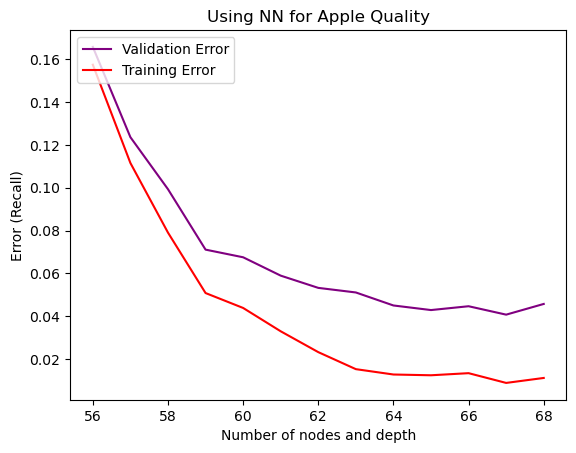

In [61]:
# [APPLE QUALITY] Varying nodes

acc_w_train = []
acc_w_test = []
list_x = []
layer_u = [4]
for x in range(55, 68):
    layer_u[0] = layer_u[0]*2
    model = create_ann(x_train_a,y_train_a, dataset = 'apple', layer_units = layer_u, dropout=0.2)
    test,train = strat_kfold_ann(clf = model, num_folds = 5, x_train = x_train_a, y_train = y_train_a, dataset = "apple", epochs = 50)
    acc_w_train.append(1-train)
    acc_w_test.append(1-test)
    list_x.append(x+1)
    print(1-train)
    print(1-test)
    print(x)
    

plt.clf()
plt.title('Using NN for Apple Quality')
plt.xlabel("Number of nodes and depth")
plt.ylabel("Error (Recall)")
plt.locator_params(axis='x')
plt.locator_params(axis='y')
plt.plot(list_x, acc_w_test, color='purple', label='Validation Error')
plt.plot(list_x, acc_w_train, color='red', label='Training Error')
plt.legend(loc="upper left")
# plt.savefig('Wine Quality_Decision Tree Error.png',
#             bbox_inches='tight')
plt.show()

[64, 64, 64, 64, 64, 64]
Epoch 1/10
86/86 [==============================] - 1s 2ms/step - loss: 1.3760 - accuracy: 0.4617
Epoch 2/10
86/86 [==============================] - 0s 2ms/step - loss: 1.1147 - accuracy: 0.5511
Epoch 3/10
86/86 [==============================] - 0s 2ms/step - loss: 1.0831 - accuracy: 0.5562
Epoch 4/10
86/86 [==============================] - 0s 2ms/step - loss: 1.0497 - accuracy: 0.5602
Epoch 5/10
86/86 [==============================] - 0s 2ms/step - loss: 1.0283 - accuracy: 0.5682
Epoch 6/10
86/86 [==============================] - 0s 2ms/step - loss: 1.0088 - accuracy: 0.5799
Epoch 7/10
86/86 [==============================] - 0s 2ms/step - loss: 0.9951 - accuracy: 0.5864
Epoch 8/10
86/86 [==============================] - 0s 2ms/step - loss: 0.9814 - accuracy: 0.5868
Epoch 9/10
86/86 [==============================] - 0s 2ms/step - loss: 0.9577 - accuracy: 0.6021
Epoch 10/10
22/22 [==============================] - 0s 1ms/step
Epoch 1/10
86/86 [==========

86/86 [==============================] - 0s 2ms/step - loss: 0.6966 - accuracy: 0.7199
Epoch 8/20
86/86 [==============================] - 0s 2ms/step - loss: 0.6715 - accuracy: 0.7352
Epoch 9/20
86/86 [==============================] - 0s 2ms/step - loss: 0.6659 - accuracy: 0.7287
Epoch 10/20
86/86 [==============================] - 0s 2ms/step - loss: 0.6456 - accuracy: 0.7338
Epoch 11/20
86/86 [==============================] - 0s 2ms/step - loss: 0.6180 - accuracy: 0.7557
Epoch 12/20
86/86 [==============================] - 0s 2ms/step - loss: 0.6014 - accuracy: 0.7586
Epoch 13/20
86/86 [==============================] - 0s 2ms/step - loss: 0.5945 - accuracy: 0.7619
Epoch 14/20
86/86 [==============================] - 0s 2ms/step - loss: 0.5824 - accuracy: 0.7702
Epoch 15/20
86/86 [==============================] - 0s 2ms/step - loss: 0.5516 - accuracy: 0.7834
Epoch 16/20
86/86 [==============================] - 0s 2ms/step - loss: 0.5269 - accuracy: 0.7910
Epoch 17/20
86/86 [=====

Epoch 26/30
86/86 [==============================] - 0s 2ms/step - loss: 0.2207 - accuracy: 0.9249
Epoch 27/30
86/86 [==============================] - 0s 2ms/step - loss: 0.1877 - accuracy: 0.9391
Epoch 28/30
86/86 [==============================] - 0s 2ms/step - loss: 0.2178 - accuracy: 0.9249
Epoch 29/30
86/86 [==============================] - 0s 2ms/step - loss: 0.2071 - accuracy: 0.9245
Epoch 30/30
22/22 [==============================] - 0s 989us/step
Epoch 1/30
86/86 [==============================] - 0s 2ms/step - loss: 0.3629 - accuracy: 0.8804
Epoch 2/30
86/86 [==============================] - 0s 2ms/step - loss: 0.3083 - accuracy: 0.8844
Epoch 3/30
86/86 [==============================] - 0s 2ms/step - loss: 0.2475 - accuracy: 0.9005
Epoch 4/30
86/86 [==============================] - 0s 2ms/step - loss: 0.2560 - accuracy: 0.9081
Epoch 5/30
86/86 [==============================] - 0s 2ms/step - loss: 0.2448 - accuracy: 0.9154
Epoch 6/30
86/86 [=============================

86/86 [==============================] - 0s 2ms/step - loss: 0.2056 - accuracy: 0.9249
Epoch 16/40
86/86 [==============================] - 0s 2ms/step - loss: 0.2243 - accuracy: 0.9205
Epoch 17/40
86/86 [==============================] - 0s 2ms/step - loss: 0.2253 - accuracy: 0.9190
Epoch 18/40
86/86 [==============================] - 0s 2ms/step - loss: 0.2313 - accuracy: 0.9125
Epoch 19/40
86/86 [==============================] - 0s 2ms/step - loss: 0.2185 - accuracy: 0.9209
Epoch 20/40
86/86 [==============================] - 0s 2ms/step - loss: 0.1922 - accuracy: 0.9365
Epoch 21/40
86/86 [==============================] - 0s 2ms/step - loss: 0.1904 - accuracy: 0.9318
Epoch 22/40
86/86 [==============================] - 0s 2ms/step - loss: 0.1998 - accuracy: 0.9307
Epoch 23/40
86/86 [==============================] - 0s 2ms/step - loss: 0.1827 - accuracy: 0.9336
Epoch 24/40
86/86 [==============================] - 0s 2ms/step - loss: 0.2149 - accuracy: 0.9263
Epoch 25/40
86/86 [===

86/86 [==============================] - 0s 2ms/step - loss: 0.4571 - accuracy: 0.8414
Epoch 6/50
86/86 [==============================] - 0s 2ms/step - loss: 0.4511 - accuracy: 0.8370
Epoch 7/50
86/86 [==============================] - 0s 2ms/step - loss: 0.4422 - accuracy: 0.8421
Epoch 8/50
86/86 [==============================] - 0s 2ms/step - loss: 0.4234 - accuracy: 0.8487
Epoch 9/50
86/86 [==============================] - 0s 2ms/step - loss: 0.4054 - accuracy: 0.8545
Epoch 10/50
86/86 [==============================] - 0s 2ms/step - loss: 0.3701 - accuracy: 0.8625
Epoch 11/50
86/86 [==============================] - 0s 2ms/step - loss: 0.3947 - accuracy: 0.8603
Epoch 12/50
86/86 [==============================] - 0s 2ms/step - loss: 0.3603 - accuracy: 0.8727
Epoch 13/50
86/86 [==============================] - 0s 2ms/step - loss: 0.3306 - accuracy: 0.8833
Epoch 14/50
86/86 [==============================] - 0s 2ms/step - loss: 0.3256 - accuracy: 0.8826
Epoch 15/50
86/86 [=======

86/86 [==============================] - 0s 2ms/step - loss: 0.1164 - accuracy: 0.9614
Epoch 17/50
86/86 [==============================] - 0s 2ms/step - loss: 0.1113 - accuracy: 0.9617
Epoch 18/50
86/86 [==============================] - 0s 2ms/step - loss: 0.1055 - accuracy: 0.9694
Epoch 19/50
86/86 [==============================] - 0s 2ms/step - loss: 0.1033 - accuracy: 0.9665
Epoch 20/50
86/86 [==============================] - 0s 2ms/step - loss: 0.0981 - accuracy: 0.9683
Epoch 21/50
86/86 [==============================] - 0s 2ms/step - loss: 0.1254 - accuracy: 0.9577
Epoch 22/50
86/86 [==============================] - 0s 2ms/step - loss: 0.1376 - accuracy: 0.9592
Epoch 23/50
86/86 [==============================] - 0s 2ms/step - loss: 0.0941 - accuracy: 0.9694
Epoch 24/50
86/86 [==============================] - 0s 2ms/step - loss: 0.1115 - accuracy: 0.9654
Epoch 25/50
86/86 [==============================] - 0s 2ms/step - loss: 0.1023 - accuracy: 0.9701
Epoch 26/50
86/86 [===

86/86 [==============================] - 0s 2ms/step - loss: 0.1901 - accuracy: 0.9376
Epoch 8/60
86/86 [==============================] - 0s 2ms/step - loss: 0.2005 - accuracy: 0.9311
Epoch 9/60
86/86 [==============================] - 0s 2ms/step - loss: 0.1902 - accuracy: 0.9336
Epoch 10/60
86/86 [==============================] - 0s 2ms/step - loss: 0.1900 - accuracy: 0.9289
Epoch 11/60
86/86 [==============================] - 0s 2ms/step - loss: 0.1579 - accuracy: 0.9457
Epoch 12/60
86/86 [==============================] - 0s 2ms/step - loss: 0.1718 - accuracy: 0.9446
Epoch 13/60
86/86 [==============================] - 0s 2ms/step - loss: 0.1810 - accuracy: 0.9453
Epoch 14/60
86/86 [==============================] - 0s 2ms/step - loss: 0.1532 - accuracy: 0.9468
Epoch 15/60
86/86 [==============================] - 0s 2ms/step - loss: 0.1783 - accuracy: 0.9362
Epoch 16/60
86/86 [==============================] - 0s 2ms/step - loss: 0.1504 - accuracy: 0.9431
Epoch 17/60
86/86 [=====

86/86 [==============================] - 0s 3ms/step - loss: 0.0829 - accuracy: 0.9734
Epoch 50/60
86/86 [==============================] - 0s 2ms/step - loss: 0.0921 - accuracy: 0.9716
Epoch 51/60
86/86 [==============================] - 0s 3ms/step - loss: 0.1200 - accuracy: 0.9592
Epoch 52/60
86/86 [==============================] - 0s 3ms/step - loss: 0.0826 - accuracy: 0.9748
Epoch 53/60
86/86 [==============================] - 0s 2ms/step - loss: 0.0912 - accuracy: 0.9676
Epoch 54/60
86/86 [==============================] - 0s 2ms/step - loss: 0.0891 - accuracy: 0.9683
Epoch 55/60
86/86 [==============================] - 0s 2ms/step - loss: 0.0845 - accuracy: 0.9727
Epoch 56/60
86/86 [==============================] - 0s 2ms/step - loss: 0.1030 - accuracy: 0.9701
Epoch 57/60
86/86 [==============================] - 0s 2ms/step - loss: 0.0759 - accuracy: 0.9723
Epoch 58/60
86/86 [==============================] - 0s 2ms/step - loss: 0.0744 - accuracy: 0.9789
Epoch 59/60
86/86 [===

86/86 [==============================] - 0s 2ms/step - loss: 0.1677 - accuracy: 0.9435
Epoch 11/70
86/86 [==============================] - 0s 2ms/step - loss: 0.1942 - accuracy: 0.9384
Epoch 12/70
86/86 [==============================] - 0s 2ms/step - loss: 0.1718 - accuracy: 0.9468
Epoch 13/70
86/86 [==============================] - 0s 2ms/step - loss: 0.1430 - accuracy: 0.9460
Epoch 14/70
86/86 [==============================] - 0s 2ms/step - loss: 0.1310 - accuracy: 0.9577
Epoch 15/70
86/86 [==============================] - 0s 2ms/step - loss: 0.1365 - accuracy: 0.9559
Epoch 16/70
86/86 [==============================] - 0s 2ms/step - loss: 0.1556 - accuracy: 0.9460
Epoch 17/70
86/86 [==============================] - 0s 2ms/step - loss: 0.1335 - accuracy: 0.9566
Epoch 18/70
86/86 [==============================] - 0s 3ms/step - loss: 0.1214 - accuracy: 0.9562
Epoch 19/70
86/86 [==============================] - 0s 2ms/step - loss: 0.1454 - accuracy: 0.9489
Epoch 20/70
86/86 [===

86/86 [==============================] - 0s 2ms/step - loss: 0.0913 - accuracy: 0.9705
Epoch 33/70
86/86 [==============================] - 0s 2ms/step - loss: 0.0874 - accuracy: 0.9727
Epoch 34/70
86/86 [==============================] - 0s 2ms/step - loss: 0.0696 - accuracy: 0.9789
Epoch 35/70
86/86 [==============================] - 0s 2ms/step - loss: 0.0726 - accuracy: 0.9741
Epoch 36/70
86/86 [==============================] - 0s 2ms/step - loss: 0.0717 - accuracy: 0.9770
Epoch 37/70
86/86 [==============================] - 0s 2ms/step - loss: 0.0874 - accuracy: 0.9701
Epoch 38/70
86/86 [==============================] - 0s 2ms/step - loss: 0.0895 - accuracy: 0.9723
Epoch 39/70
86/86 [==============================] - 0s 2ms/step - loss: 0.0921 - accuracy: 0.9752
Epoch 40/70
86/86 [==============================] - 0s 2ms/step - loss: 0.0961 - accuracy: 0.9683
Epoch 41/70
86/86 [==============================] - 0s 2ms/step - loss: 0.0852 - accuracy: 0.9759
Epoch 42/70
86/86 [===

86/86 [==============================] - 0s 2ms/step - loss: 0.1642 - accuracy: 0.9413
Epoch 45/80
86/86 [==============================] - 0s 2ms/step - loss: 0.1615 - accuracy: 0.9442
Epoch 46/80
86/86 [==============================] - 0s 2ms/step - loss: 0.1568 - accuracy: 0.9522
Epoch 47/80
86/86 [==============================] - 0s 2ms/step - loss: 0.1449 - accuracy: 0.9489
Epoch 48/80
86/86 [==============================] - 0s 2ms/step - loss: 0.1547 - accuracy: 0.9530
Epoch 49/80
86/86 [==============================] - 0s 2ms/step - loss: 0.1526 - accuracy: 0.9508
Epoch 50/80
86/86 [==============================] - 0s 2ms/step - loss: 0.1752 - accuracy: 0.9446
Epoch 51/80
86/86 [==============================] - 0s 2ms/step - loss: 0.1639 - accuracy: 0.9427
Epoch 52/80
86/86 [==============================] - 0s 2ms/step - loss: 0.1484 - accuracy: 0.9533
Epoch 53/80
86/86 [==============================] - 0s 2ms/step - loss: 0.1415 - accuracy: 0.9537
Epoch 54/80
86/86 [===

86/86 [==============================] - 0s 2ms/step - loss: 0.0898 - accuracy: 0.9676
Epoch 47/80
86/86 [==============================] - 0s 2ms/step - loss: 0.0741 - accuracy: 0.9730
Epoch 48/80
86/86 [==============================] - 0s 2ms/step - loss: 0.0666 - accuracy: 0.9781
Epoch 49/80
86/86 [==============================] - 0s 2ms/step - loss: 0.0785 - accuracy: 0.9759
Epoch 50/80
86/86 [==============================] - 0s 2ms/step - loss: 0.1020 - accuracy: 0.9694
Epoch 51/80
86/86 [==============================] - 0s 2ms/step - loss: 0.1024 - accuracy: 0.9665
Epoch 52/80
86/86 [==============================] - 0s 2ms/step - loss: 0.1010 - accuracy: 0.9686
Epoch 53/80
86/86 [==============================] - 0s 2ms/step - loss: 0.0973 - accuracy: 0.9657
Epoch 54/80
86/86 [==============================] - 0s 2ms/step - loss: 0.0973 - accuracy: 0.9650
Epoch 55/80
86/86 [==============================] - 0s 2ms/step - loss: 0.0723 - accuracy: 0.9770
Epoch 56/80
86/86 [===

86/86 [==============================] - 0s 2ms/step - loss: 0.3200 - accuracy: 0.8789
Epoch 49/90
86/86 [==============================] - 0s 2ms/step - loss: 0.3187 - accuracy: 0.8804
Epoch 50/90
86/86 [==============================] - 0s 2ms/step - loss: 0.3256 - accuracy: 0.8720
Epoch 51/90
86/86 [==============================] - 0s 2ms/step - loss: 0.3053 - accuracy: 0.8826
Epoch 52/90
86/86 [==============================] - 0s 2ms/step - loss: 0.3252 - accuracy: 0.8749
Epoch 53/90
86/86 [==============================] - 0s 2ms/step - loss: 0.2953 - accuracy: 0.8866
Epoch 54/90
86/86 [==============================] - 0s 2ms/step - loss: 0.2923 - accuracy: 0.8910
Epoch 55/90
86/86 [==============================] - 0s 2ms/step - loss: 0.2864 - accuracy: 0.8920
Epoch 56/90
86/86 [==============================] - 0s 2ms/step - loss: 0.2709 - accuracy: 0.9001
Epoch 57/90
86/86 [==============================] - 0s 2ms/step - loss: 0.2778 - accuracy: 0.8928
Epoch 58/90
86/86 [===

86/86 [==============================] - 0s 2ms/step - loss: 0.1301 - accuracy: 0.9566
Epoch 31/90
86/86 [==============================] - 0s 2ms/step - loss: 0.1216 - accuracy: 0.9566
Epoch 32/90
86/86 [==============================] - 0s 2ms/step - loss: 0.0990 - accuracy: 0.9708
Epoch 33/90
86/86 [==============================] - 0s 2ms/step - loss: 0.1181 - accuracy: 0.9654
Epoch 34/90
86/86 [==============================] - 0s 2ms/step - loss: 0.1140 - accuracy: 0.9617
Epoch 35/90
86/86 [==============================] - 0s 2ms/step - loss: 0.1017 - accuracy: 0.9697
Epoch 36/90
86/86 [==============================] - 0s 2ms/step - loss: 0.1192 - accuracy: 0.9650
Epoch 37/90
86/86 [==============================] - 0s 2ms/step - loss: 0.1239 - accuracy: 0.9592
Epoch 38/90
86/86 [==============================] - 0s 2ms/step - loss: 0.1239 - accuracy: 0.9610
Epoch 39/90
86/86 [==============================] - 0s 2ms/step - loss: 0.0959 - accuracy: 0.9668
Epoch 40/90
86/86 [===

86/86 [==============================] - 0s 2ms/step - loss: 0.0856 - accuracy: 0.9752
Epoch 13/90
86/86 [==============================] - 0s 2ms/step - loss: 0.0821 - accuracy: 0.9701
Epoch 14/90
86/86 [==============================] - 0s 2ms/step - loss: 0.0747 - accuracy: 0.9778
Epoch 15/90
86/86 [==============================] - 0s 2ms/step - loss: 0.0897 - accuracy: 0.9701
Epoch 16/90
86/86 [==============================] - 0s 2ms/step - loss: 0.0995 - accuracy: 0.9712
Epoch 17/90
86/86 [==============================] - 0s 2ms/step - loss: 0.0854 - accuracy: 0.9745
Epoch 18/90
86/86 [==============================] - 0s 2ms/step - loss: 0.0705 - accuracy: 0.9756
Epoch 19/90
86/86 [==============================] - 0s 2ms/step - loss: 0.0695 - accuracy: 0.9781
Epoch 20/90
86/86 [==============================] - 0s 2ms/step - loss: 0.0945 - accuracy: 0.9708
Epoch 21/90
86/86 [==============================] - 0s 2ms/step - loss: 0.0909 - accuracy: 0.9738
Epoch 22/90
86/86 [===

86/86 [==============================] - 0s 2ms/step - loss: 0.1884 - accuracy: 0.9373
Epoch 86/100
86/86 [==============================] - 0s 2ms/step - loss: 0.2019 - accuracy: 0.9271
Epoch 87/100
86/86 [==============================] - 0s 2ms/step - loss: 0.1873 - accuracy: 0.9362
Epoch 88/100
86/86 [==============================] - 0s 2ms/step - loss: 0.1926 - accuracy: 0.9303
Epoch 89/100
86/86 [==============================] - 0s 2ms/step - loss: 0.2101 - accuracy: 0.9252
Epoch 90/100
86/86 [==============================] - 0s 2ms/step - loss: 0.1638 - accuracy: 0.9453
Epoch 91/100
86/86 [==============================] - 0s 2ms/step - loss: 0.1755 - accuracy: 0.9373
Epoch 92/100
86/86 [==============================] - 0s 2ms/step - loss: 0.1401 - accuracy: 0.9489
Epoch 93/100
86/86 [==============================] - 0s 2ms/step - loss: 0.1690 - accuracy: 0.9427
Epoch 94/100
86/86 [==============================] - 0s 2ms/step - loss: 0.1735 - accuracy: 0.9358
Epoch 95/100


86/86 [==============================] - 0s 2ms/step - loss: 0.1295 - accuracy: 0.9570
Epoch 67/100
86/86 [==============================] - 0s 2ms/step - loss: 0.1562 - accuracy: 0.9442
Epoch 68/100
86/86 [==============================] - 0s 2ms/step - loss: 0.1320 - accuracy: 0.9544
Epoch 69/100
86/86 [==============================] - 0s 2ms/step - loss: 0.1195 - accuracy: 0.9628
Epoch 70/100
86/86 [==============================] - 0s 2ms/step - loss: 0.1050 - accuracy: 0.9639
Epoch 71/100
86/86 [==============================] - 0s 2ms/step - loss: 0.1414 - accuracy: 0.9566
Epoch 72/100
86/86 [==============================] - 0s 2ms/step - loss: 0.1370 - accuracy: 0.9555
Epoch 73/100
86/86 [==============================] - 0s 2ms/step - loss: 0.1217 - accuracy: 0.9599
Epoch 74/100
86/86 [==============================] - 0s 2ms/step - loss: 0.1161 - accuracy: 0.9610
Epoch 75/100
86/86 [==============================] - 0s 2ms/step - loss: 0.1463 - accuracy: 0.9526
Epoch 76/100


86/86 [==============================] - 0s 2ms/step - loss: 0.0962 - accuracy: 0.9668
Epoch 48/100
86/86 [==============================] - 0s 2ms/step - loss: 0.1354 - accuracy: 0.9577
Epoch 49/100
86/86 [==============================] - 0s 2ms/step - loss: 0.0913 - accuracy: 0.9716
Epoch 50/100
86/86 [==============================] - 0s 2ms/step - loss: 0.0816 - accuracy: 0.9723
Epoch 51/100
86/86 [==============================] - 0s 2ms/step - loss: 0.1064 - accuracy: 0.9686
Epoch 52/100
86/86 [==============================] - 0s 2ms/step - loss: 0.0907 - accuracy: 0.9690
Epoch 53/100
86/86 [==============================] - 0s 2ms/step - loss: 0.0983 - accuracy: 0.9726
Epoch 54/100
86/86 [==============================] - 0s 2ms/step - loss: 0.1083 - accuracy: 0.9617
Epoch 55/100
86/86 [==============================] - 0s 2ms/step - loss: 0.0949 - accuracy: 0.9708
Epoch 56/100
86/86 [==============================] - 0s 2ms/step - loss: 0.1303 - accuracy: 0.9551
Epoch 57/100


86/86 [==============================] - 0s 2ms/step - loss: 0.0797 - accuracy: 0.9719
Epoch 29/100
86/86 [==============================] - 0s 2ms/step - loss: 0.0925 - accuracy: 0.9730
Epoch 30/100
86/86 [==============================] - 0s 2ms/step - loss: 0.0902 - accuracy: 0.9686
Epoch 31/100
86/86 [==============================] - 0s 2ms/step - loss: 0.0850 - accuracy: 0.9712
Epoch 32/100
86/86 [==============================] - 0s 2ms/step - loss: 0.0921 - accuracy: 0.9719
Epoch 33/100
86/86 [==============================] - 0s 2ms/step - loss: 0.1101 - accuracy: 0.9610
Epoch 34/100
86/86 [==============================] - 0s 2ms/step - loss: 0.0764 - accuracy: 0.9778
Epoch 35/100
86/86 [==============================] - 0s 2ms/step - loss: 0.1224 - accuracy: 0.9592
Epoch 36/100
86/86 [==============================] - 0s 2ms/step - loss: 0.0970 - accuracy: 0.9661
Epoch 37/100
86/86 [==============================] - 0s 2ms/step - loss: 0.0844 - accuracy: 0.9705
Epoch 38/100


86/86 [==============================] - 0s 2ms/step - loss: 0.0942 - accuracy: 0.9661
Epoch 10/100
86/86 [==============================] - 0s 2ms/step - loss: 0.0773 - accuracy: 0.9723
Epoch 11/100
86/86 [==============================] - 0s 2ms/step - loss: 0.0816 - accuracy: 0.9723
Epoch 12/100
86/86 [==============================] - 0s 2ms/step - loss: 0.1142 - accuracy: 0.9657
Epoch 13/100
86/86 [==============================] - 0s 2ms/step - loss: 0.0672 - accuracy: 0.9774
Epoch 14/100
86/86 [==============================] - 0s 2ms/step - loss: 0.1041 - accuracy: 0.9668
Epoch 15/100
86/86 [==============================] - 0s 2ms/step - loss: 0.0678 - accuracy: 0.9807
Epoch 16/100
86/86 [==============================] - 0s 2ms/step - loss: 0.0588 - accuracy: 0.9821
Epoch 17/100
86/86 [==============================] - 0s 2ms/step - loss: 0.0716 - accuracy: 0.9763
Epoch 18/100
86/86 [==============================] - 0s 2ms/step - loss: 0.0750 - accuracy: 0.9738
Epoch 19/100


86/86 [==============================] - 0s 2ms/step - loss: 0.0760 - accuracy: 0.9759
Epoch 92/100
86/86 [==============================] - 0s 2ms/step - loss: 0.0879 - accuracy: 0.9723
Epoch 93/100
86/86 [==============================] - 0s 2ms/step - loss: 0.0692 - accuracy: 0.9748
Epoch 94/100
86/86 [==============================] - 0s 2ms/step - loss: 0.0699 - accuracy: 0.9781
Epoch 95/100
86/86 [==============================] - 0s 2ms/step - loss: 0.0616 - accuracy: 0.9825
Epoch 96/100
86/86 [==============================] - 0s 2ms/step - loss: 0.0582 - accuracy: 0.9796
Epoch 97/100
86/86 [==============================] - 0s 2ms/step - loss: 0.0681 - accuracy: 0.9792
Epoch 98/100
86/86 [==============================] - 0s 2ms/step - loss: 0.0545 - accuracy: 0.9832
Epoch 99/100
86/86 [==============================] - 0s 2ms/step - loss: 0.0608 - accuracy: 0.9829
Epoch 100/100
22/22 [==============================] - 0s 981us/step
0.010210460789655373
0.21493647719776132
100

86/86 [==============================] - 0s 2ms/step - loss: 0.1477 - accuracy: 0.9530
Epoch 42/110
86/86 [==============================] - 0s 2ms/step - loss: 0.1366 - accuracy: 0.9555
Epoch 43/110
86/86 [==============================] - 0s 2ms/step - loss: 0.1299 - accuracy: 0.9577
Epoch 44/110
86/86 [==============================] - 0s 2ms/step - loss: 0.1369 - accuracy: 0.9551
Epoch 45/110
86/86 [==============================] - 0s 2ms/step - loss: 0.1495 - accuracy: 0.9453
Epoch 46/110
86/86 [==============================] - 0s 2ms/step - loss: 0.1362 - accuracy: 0.9559
Epoch 47/110
86/86 [==============================] - 0s 2ms/step - loss: 0.1280 - accuracy: 0.9544
Epoch 48/110
86/86 [==============================] - 0s 2ms/step - loss: 0.1218 - accuracy: 0.9577
Epoch 49/110
86/86 [==============================] - 0s 2ms/step - loss: 0.1461 - accuracy: 0.9497
Epoch 50/110
86/86 [==============================] - 0s 2ms/step - loss: 0.1324 - accuracy: 0.9588
Epoch 51/110


86/86 [==============================] - 0s 2ms/step - loss: 0.0939 - accuracy: 0.9686
Epoch 94/110
86/86 [==============================] - 0s 2ms/step - loss: 0.0869 - accuracy: 0.9701
Epoch 95/110
86/86 [==============================] - 0s 2ms/step - loss: 0.0971 - accuracy: 0.9683
Epoch 96/110
86/86 [==============================] - 0s 2ms/step - loss: 0.0900 - accuracy: 0.9675
Epoch 97/110
86/86 [==============================] - 0s 2ms/step - loss: 0.0895 - accuracy: 0.9683
Epoch 98/110
86/86 [==============================] - 0s 2ms/step - loss: 0.0911 - accuracy: 0.9697
Epoch 99/110
86/86 [==============================] - 0s 2ms/step - loss: 0.0638 - accuracy: 0.9781
Epoch 100/110
86/86 [==============================] - 0s 2ms/step - loss: 0.0817 - accuracy: 0.9745
Epoch 101/110
86/86 [==============================] - 0s 2ms/step - loss: 0.0760 - accuracy: 0.9767
Epoch 102/110
86/86 [==============================] - 0s 2ms/step - loss: 0.0684 - accuracy: 0.9767
Epoch 103/

Epoch 64/110
86/86 [==============================] - 0s 2ms/step - loss: 0.0588 - accuracy: 0.9810
Epoch 65/110
86/86 [==============================] - 0s 2ms/step - loss: 0.0816 - accuracy: 0.9719
Epoch 66/110
86/86 [==============================] - 0s 2ms/step - loss: 0.0745 - accuracy: 0.9770
Epoch 67/110
86/86 [==============================] - 0s 2ms/step - loss: 0.0602 - accuracy: 0.9796
Epoch 68/110
86/86 [==============================] - 0s 2ms/step - loss: 0.0735 - accuracy: 0.9748
Epoch 69/110
86/86 [==============================] - 0s 2ms/step - loss: 0.0684 - accuracy: 0.9745
Epoch 70/110
86/86 [==============================] - 0s 2ms/step - loss: 0.0710 - accuracy: 0.9759
Epoch 71/110
86/86 [==============================] - 0s 2ms/step - loss: 0.0786 - accuracy: 0.9741
Epoch 72/110
86/86 [==============================] - 0s 2ms/step - loss: 0.0665 - accuracy: 0.9785
Epoch 73/110
86/86 [==============================] - 0s 2ms/step - loss: 0.0684 - accuracy: 0.9767


86/86 [==============================] - 0s 2ms/step - loss: 1.0389 - accuracy: 0.5744
Epoch 5/120
86/86 [==============================] - 0s 2ms/step - loss: 1.0119 - accuracy: 0.5682
Epoch 6/120
86/86 [==============================] - 0s 2ms/step - loss: 0.9919 - accuracy: 0.5948
Epoch 7/120
86/86 [==============================] - 0s 2ms/step - loss: 0.9839 - accuracy: 0.5937
Epoch 8/120
86/86 [==============================] - 0s 2ms/step - loss: 0.9589 - accuracy: 0.5974
Epoch 9/120
86/86 [==============================] - 0s 2ms/step - loss: 0.9466 - accuracy: 0.6003
Epoch 10/120
86/86 [==============================] - 0s 2ms/step - loss: 0.9303 - accuracy: 0.6047
Epoch 11/120
86/86 [==============================] - 0s 2ms/step - loss: 0.8958 - accuracy: 0.6160
Epoch 12/120
86/86 [==============================] - 0s 2ms/step - loss: 0.8996 - accuracy: 0.6105
Epoch 13/120
86/86 [==============================] - 0s 2ms/step - loss: 0.8706 - accuracy: 0.6244
Epoch 14/120
86/86

86/86 [==============================] - 0s 2ms/step - loss: 0.1470 - accuracy: 0.9475
Epoch 87/120
86/86 [==============================] - 0s 2ms/step - loss: 0.1524 - accuracy: 0.9471
Epoch 88/120
86/86 [==============================] - 0s 2ms/step - loss: 0.1783 - accuracy: 0.9369
Epoch 89/120
86/86 [==============================] - 0s 2ms/step - loss: 0.1649 - accuracy: 0.9475
Epoch 90/120
86/86 [==============================] - 0s 2ms/step - loss: 0.1646 - accuracy: 0.9402
Epoch 91/120
86/86 [==============================] - 0s 2ms/step - loss: 0.1810 - accuracy: 0.9464
Epoch 92/120
86/86 [==============================] - 0s 2ms/step - loss: 0.1378 - accuracy: 0.9504
Epoch 93/120
86/86 [==============================] - 0s 2ms/step - loss: 0.1798 - accuracy: 0.9402
Epoch 94/120
86/86 [==============================] - 0s 2ms/step - loss: 0.1809 - accuracy: 0.9435
Epoch 95/120
86/86 [==============================] - 0s 2ms/step - loss: 0.1467 - accuracy: 0.9511
Epoch 96/120


86/86 [==============================] - 0s 2ms/step - loss: 0.1558 - accuracy: 0.9413
Epoch 7/120
86/86 [==============================] - 0s 2ms/step - loss: 0.1509 - accuracy: 0.9497
Epoch 8/120
86/86 [==============================] - 0s 2ms/step - loss: 0.1389 - accuracy: 0.9551
Epoch 9/120
86/86 [==============================] - 0s 2ms/step - loss: 0.1419 - accuracy: 0.9497
Epoch 10/120
86/86 [==============================] - 0s 2ms/step - loss: 0.1424 - accuracy: 0.9602
Epoch 11/120
86/86 [==============================] - 0s 2ms/step - loss: 0.1154 - accuracy: 0.9661
Epoch 12/120
86/86 [==============================] - 0s 2ms/step - loss: 0.1188 - accuracy: 0.9595
Epoch 13/120
86/86 [==============================] - 0s 2ms/step - loss: 0.1455 - accuracy: 0.9515
Epoch 14/120
86/86 [==============================] - 0s 2ms/step - loss: 0.1140 - accuracy: 0.9654
Epoch 15/120
86/86 [==============================] - 0s 2ms/step - loss: 0.1021 - accuracy: 0.9635
Epoch 16/120
86/

86/86 [==============================] - 0s 2ms/step - loss: 0.0967 - accuracy: 0.9672
Epoch 89/120
86/86 [==============================] - 0s 2ms/step - loss: 0.0943 - accuracy: 0.9705
Epoch 90/120
86/86 [==============================] - 0s 2ms/step - loss: 0.0793 - accuracy: 0.9737
Epoch 91/120
86/86 [==============================] - 0s 2ms/step - loss: 0.0743 - accuracy: 0.9770
Epoch 92/120
86/86 [==============================] - 0s 2ms/step - loss: 0.0930 - accuracy: 0.9719
Epoch 93/120
86/86 [==============================] - 0s 2ms/step - loss: 0.0795 - accuracy: 0.9697
Epoch 94/120
86/86 [==============================] - 0s 2ms/step - loss: 0.0856 - accuracy: 0.9767
Epoch 95/120
86/86 [==============================] - 0s 2ms/step - loss: 0.0822 - accuracy: 0.9756
Epoch 96/120
86/86 [==============================] - 0s 2ms/step - loss: 0.0569 - accuracy: 0.9807
Epoch 97/120
86/86 [==============================] - 0s 2ms/step - loss: 0.0826 - accuracy: 0.9774
Epoch 98/120


86/86 [==============================] - 0s 2ms/step - loss: 0.0698 - accuracy: 0.9774
Epoch 9/120
86/86 [==============================] - 0s 2ms/step - loss: 0.1094 - accuracy: 0.9668
Epoch 10/120
86/86 [==============================] - 0s 2ms/step - loss: 0.0957 - accuracy: 0.9705
Epoch 11/120
86/86 [==============================] - 0s 2ms/step - loss: 0.1005 - accuracy: 0.9643
Epoch 12/120
86/86 [==============================] - 0s 2ms/step - loss: 0.0753 - accuracy: 0.9759
Epoch 13/120
86/86 [==============================] - 0s 2ms/step - loss: 0.0876 - accuracy: 0.9734
Epoch 14/120
86/86 [==============================] - 0s 2ms/step - loss: 0.0834 - accuracy: 0.9727
Epoch 15/120
86/86 [==============================] - 0s 2ms/step - loss: 0.0720 - accuracy: 0.9781
Epoch 16/120
86/86 [==============================] - 0s 2ms/step - loss: 0.0642 - accuracy: 0.9799
Epoch 17/120
86/86 [==============================] - 0s 2ms/step - loss: 0.0555 - accuracy: 0.9843
Epoch 18/120
8

86/86 [==============================] - 0s 2ms/step - loss: 0.0629 - accuracy: 0.9756
Epoch 91/120
86/86 [==============================] - 0s 2ms/step - loss: 0.0709 - accuracy: 0.9767
Epoch 92/120
86/86 [==============================] - 0s 2ms/step - loss: 0.0714 - accuracy: 0.9778
Epoch 93/120
86/86 [==============================] - 0s 2ms/step - loss: 0.0753 - accuracy: 0.9723
Epoch 94/120
86/86 [==============================] - 0s 2ms/step - loss: 0.0597 - accuracy: 0.9789
Epoch 95/120
86/86 [==============================] - 0s 2ms/step - loss: 0.0575 - accuracy: 0.9832
Epoch 96/120
86/86 [==============================] - 0s 2ms/step - loss: 0.0731 - accuracy: 0.9734
Epoch 97/120
86/86 [==============================] - 0s 2ms/step - loss: 0.0796 - accuracy: 0.9745
Epoch 98/120
86/86 [==============================] - 0s 2ms/step - loss: 0.0743 - accuracy: 0.9763
Epoch 99/120
86/86 [==============================] - 0s 2ms/step - loss: 0.0553 - accuracy: 0.9799
Epoch 100/120

22/22 [==============================] - 0s 994us/step
Epoch 1/130
86/86 [==============================] - 0s 2ms/step - loss: 0.6399 - accuracy: 0.8472
Epoch 2/130
86/86 [==============================] - 0s 2ms/step - loss: 0.4616 - accuracy: 0.8665
Epoch 3/130
86/86 [==============================] - 0s 2ms/step - loss: 0.3754 - accuracy: 0.8913
Epoch 4/130
86/86 [==============================] - 0s 2ms/step - loss: 0.3651 - accuracy: 0.8942
Epoch 5/130
86/86 [==============================] - 0s 2ms/step - loss: 0.3405 - accuracy: 0.8950
Epoch 6/130
86/86 [==============================] - 0s 2ms/step - loss: 0.3076 - accuracy: 0.9085
Epoch 7/130
86/86 [==============================] - 0s 2ms/step - loss: 0.2903 - accuracy: 0.9074
Epoch 8/130
86/86 [==============================] - 0s 2ms/step - loss: 0.2786 - accuracy: 0.9106
Epoch 9/130
86/86 [==============================] - 0s 2ms/step - loss: 0.2655 - accuracy: 0.9165
Epoch 10/130
86/86 [==============================] - 

86/86 [==============================] - 0s 2ms/step - loss: 0.1099 - accuracy: 0.9643
Epoch 33/130
86/86 [==============================] - 0s 2ms/step - loss: 0.1038 - accuracy: 0.9643
Epoch 34/130
86/86 [==============================] - 0s 2ms/step - loss: 0.1043 - accuracy: 0.9708
Epoch 35/130
86/86 [==============================] - 0s 2ms/step - loss: 0.1068 - accuracy: 0.9643
Epoch 36/130
86/86 [==============================] - 0s 2ms/step - loss: 0.0810 - accuracy: 0.9741
Epoch 37/130
86/86 [==============================] - 0s 2ms/step - loss: 0.0849 - accuracy: 0.9701
Epoch 38/130
86/86 [==============================] - 0s 2ms/step - loss: 0.1292 - accuracy: 0.9551
Epoch 39/130
86/86 [==============================] - 0s 2ms/step - loss: 0.1157 - accuracy: 0.9632
Epoch 40/130
86/86 [==============================] - 0s 2ms/step - loss: 0.0818 - accuracy: 0.9719
Epoch 41/130
86/86 [==============================] - 0s 2ms/step - loss: 0.1053 - accuracy: 0.9650
Epoch 42/130


86/86 [==============================] - 0s 2ms/step - loss: 0.0692 - accuracy: 0.9759
Epoch 64/130
86/86 [==============================] - 0s 2ms/step - loss: 0.0650 - accuracy: 0.9789
Epoch 65/130
86/86 [==============================] - 0s 2ms/step - loss: 0.0589 - accuracy: 0.9810
Epoch 66/130
86/86 [==============================] - 0s 2ms/step - loss: 0.0522 - accuracy: 0.9821
Epoch 67/130
86/86 [==============================] - 0s 2ms/step - loss: 0.0939 - accuracy: 0.9727
Epoch 68/130
86/86 [==============================] - 0s 2ms/step - loss: 0.0768 - accuracy: 0.9748
Epoch 69/130
86/86 [==============================] - 0s 2ms/step - loss: 0.0747 - accuracy: 0.9778
Epoch 70/130
86/86 [==============================] - 0s 2ms/step - loss: 0.0699 - accuracy: 0.9810
Epoch 71/130
86/86 [==============================] - 0s 2ms/step - loss: 0.0527 - accuracy: 0.9814
Epoch 72/130
86/86 [==============================] - 0s 2ms/step - loss: 0.0811 - accuracy: 0.9741
Epoch 73/130


86/86 [==============================] - 0s 2ms/step - loss: 0.0659 - accuracy: 0.9810
Epoch 96/130
86/86 [==============================] - 0s 2ms/step - loss: 0.0709 - accuracy: 0.9810
Epoch 97/130
86/86 [==============================] - 0s 2ms/step - loss: 0.0606 - accuracy: 0.9789
Epoch 98/130
86/86 [==============================] - 0s 2ms/step - loss: 0.0824 - accuracy: 0.9778
Epoch 99/130
86/86 [==============================] - 0s 2ms/step - loss: 0.0414 - accuracy: 0.9869
Epoch 100/130
86/86 [==============================] - 0s 2ms/step - loss: 0.0550 - accuracy: 0.9818
Epoch 101/130
86/86 [==============================] - 0s 2ms/step - loss: 0.0570 - accuracy: 0.9810
Epoch 102/130
86/86 [==============================] - 0s 2ms/step - loss: 0.0694 - accuracy: 0.9796
Epoch 103/130
86/86 [==============================] - 0s 2ms/step - loss: 0.0586 - accuracy: 0.9832
Epoch 104/130
86/86 [==============================] - 0s 2ms/step - loss: 0.0462 - accuracy: 0.9869
Epoch 10

86/86 [==============================] - 0s 2ms/step - loss: 0.1157 - accuracy: 0.9592
Epoch 127/140
86/86 [==============================] - 0s 2ms/step - loss: 0.1450 - accuracy: 0.9544
Epoch 128/140
86/86 [==============================] - 0s 2ms/step - loss: 0.1482 - accuracy: 0.9526
Epoch 129/140
86/86 [==============================] - 0s 2ms/step - loss: 0.0874 - accuracy: 0.9701
Epoch 130/140
86/86 [==============================] - 0s 2ms/step - loss: 0.1053 - accuracy: 0.9661
Epoch 131/140
86/86 [==============================] - 0s 2ms/step - loss: 0.1363 - accuracy: 0.9592
Epoch 132/140
86/86 [==============================] - 0s 2ms/step - loss: 0.1361 - accuracy: 0.9562
Epoch 133/140
86/86 [==============================] - 0s 2ms/step - loss: 0.1250 - accuracy: 0.9650
Epoch 134/140
86/86 [==============================] - 0s 2ms/step - loss: 0.1197 - accuracy: 0.9577
Epoch 135/140
86/86 [==============================] - 0s 2ms/step - loss: 0.1286 - accuracy: 0.9544
Epoc

86/86 [==============================] - 0s 2ms/step - loss: 0.1529 - accuracy: 0.9468
Epoch 7/140
86/86 [==============================] - 0s 2ms/step - loss: 0.1181 - accuracy: 0.9617
Epoch 8/140
86/86 [==============================] - 0s 2ms/step - loss: 0.1520 - accuracy: 0.9493
Epoch 9/140
86/86 [==============================] - 0s 2ms/step - loss: 0.1359 - accuracy: 0.9577
Epoch 10/140
86/86 [==============================] - 0s 2ms/step - loss: 0.1292 - accuracy: 0.9610
Epoch 11/140
86/86 [==============================] - 0s 2ms/step - loss: 0.1335 - accuracy: 0.9592
Epoch 12/140
86/86 [==============================] - 0s 2ms/step - loss: 0.1148 - accuracy: 0.9599
Epoch 13/140
86/86 [==============================] - 0s 2ms/step - loss: 0.1194 - accuracy: 0.9595
Epoch 14/140
86/86 [==============================] - 0s 2ms/step - loss: 0.1018 - accuracy: 0.9643
Epoch 15/140
86/86 [==============================] - 0s 2ms/step - loss: 0.0805 - accuracy: 0.9745
Epoch 16/140
86/

86/86 [==============================] - 0s 2ms/step - loss: 0.0668 - accuracy: 0.9792
Epoch 89/140
86/86 [==============================] - 0s 2ms/step - loss: 0.0752 - accuracy: 0.9774
Epoch 90/140
86/86 [==============================] - 0s 2ms/step - loss: 0.0897 - accuracy: 0.9690
Epoch 91/140
86/86 [==============================] - 0s 2ms/step - loss: 0.0827 - accuracy: 0.9756
Epoch 92/140
86/86 [==============================] - 0s 2ms/step - loss: 0.0570 - accuracy: 0.9778
Epoch 93/140
86/86 [==============================] - 0s 2ms/step - loss: 0.0670 - accuracy: 0.9770
Epoch 94/140
86/86 [==============================] - 0s 2ms/step - loss: 0.0610 - accuracy: 0.9803
Epoch 95/140
86/86 [==============================] - 0s 2ms/step - loss: 0.0728 - accuracy: 0.9759
Epoch 96/140
86/86 [==============================] - 0s 2ms/step - loss: 0.0877 - accuracy: 0.9716
Epoch 97/140
86/86 [==============================] - 0s 2ms/step - loss: 0.0863 - accuracy: 0.9726
Epoch 98/140


Epoch 110/140
86/86 [==============================] - 0s 2ms/step - loss: 0.0457 - accuracy: 0.9847
Epoch 111/140
86/86 [==============================] - 0s 2ms/step - loss: 0.0791 - accuracy: 0.9759
Epoch 112/140
86/86 [==============================] - 0s 2ms/step - loss: 0.0621 - accuracy: 0.9781
Epoch 113/140
86/86 [==============================] - 0s 2ms/step - loss: 0.0514 - accuracy: 0.9840
Epoch 114/140
86/86 [==============================] - 0s 2ms/step - loss: 0.0651 - accuracy: 0.9774
Epoch 115/140
86/86 [==============================] - 0s 2ms/step - loss: 0.0678 - accuracy: 0.9785
Epoch 116/140
86/86 [==============================] - 0s 2ms/step - loss: 0.0636 - accuracy: 0.9814
Epoch 117/140
86/86 [==============================] - 0s 2ms/step - loss: 0.0667 - accuracy: 0.9821
Epoch 118/140
86/86 [==============================] - 0s 2ms/step - loss: 0.0583 - accuracy: 0.9785
Epoch 119/140
86/86 [==============================] - 0s 2ms/step - loss: 0.0753 - accurac

86/86 [==============================] - 0s 2ms/step - loss: 0.0398 - accuracy: 0.9858
Epoch 132/140
86/86 [==============================] - 0s 2ms/step - loss: 0.0520 - accuracy: 0.9825
Epoch 133/140
86/86 [==============================] - 0s 2ms/step - loss: 0.0507 - accuracy: 0.9818
Epoch 134/140
86/86 [==============================] - 0s 2ms/step - loss: 0.0727 - accuracy: 0.9796
Epoch 135/140
86/86 [==============================] - 0s 2ms/step - loss: 0.0700 - accuracy: 0.9789
Epoch 136/140
86/86 [==============================] - 0s 2ms/step - loss: 0.0427 - accuracy: 0.9854
Epoch 137/140
86/86 [==============================] - 0s 2ms/step - loss: 0.0469 - accuracy: 0.9861
Epoch 138/140
86/86 [==============================] - 0s 2ms/step - loss: 0.0674 - accuracy: 0.9803
Epoch 139/140
86/86 [==============================] - 0s 2ms/step - loss: 0.0502 - accuracy: 0.9836
Epoch 140/140
22/22 [==============================] - 0s 976us/step
0.006709898520283586
0.2178544827732

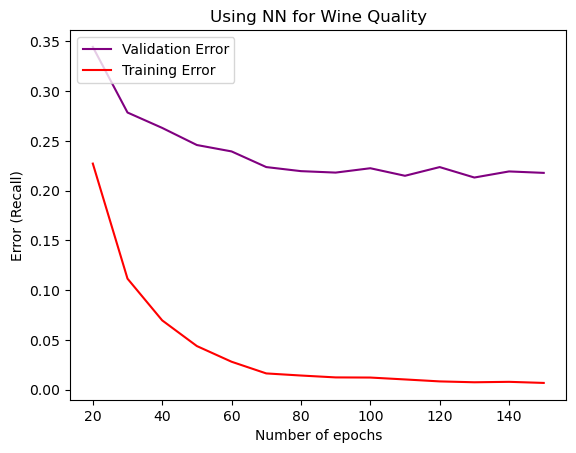

In [111]:
# [WINE QUALITY] Varying number of epochs
tf.random.set_seed(42)

acc_w_train = []
acc_w_test = []
list_x = []
layer_u = [64,64,64,64,64,64]
print(layer_u)
for x in range(1, 15):
    model = create_ann(x_train_w,y_train_w, dataset = 'wine', layer_units = layer_u, dropout = 0.01)
    test,train = strat_kfold_ann(clf = model, num_folds = 5, x_train = x_train_w, y_train = y_train_w, dataset = "wine", epochs = 10 * x)
    acc_w_train.append(1-train)
    acc_w_test.append(1-test)
    list_x.append((x+1)*10)
    print(1-train)
    print(1-test)
    print(x*10)
    

plt.clf()
plt.title('Using NN for Wine Quality')
plt.xlabel("Number of epochs")
plt.ylabel("Error (Recall)")
plt.locator_params(axis='x')
plt.locator_params(axis='y')
plt.plot(list_x, acc_w_test, color='purple', label='Validation Error')
plt.plot(list_x, acc_w_train, color='red', label='Training Error')
plt.legend(loc="upper left")
# plt.savefig('Wine Quality_Decision Tree Error.png',
#             bbox_inches='tight')
plt.show()

Epoch 1/40
70/70 [==============================] - 1s 2ms/step - loss: 0.4343 - accuracy: 0.7866
Epoch 2/40
70/70 [==============================] - 0s 2ms/step - loss: 0.2991 - accuracy: 0.8643
Epoch 3/40
70/70 [==============================] - 0s 2ms/step - loss: 0.2841 - accuracy: 0.8759
Epoch 4/40
70/70 [==============================] - 0s 2ms/step - loss: 0.2569 - accuracy: 0.8933
Epoch 5/40
70/70 [==============================] - 0s 2ms/step - loss: 0.2486 - accuracy: 0.8951
Epoch 6/40
70/70 [==============================] - 0s 2ms/step - loss: 0.2829 - accuracy: 0.8795
Epoch 7/40
70/70 [==============================] - 0s 2ms/step - loss: 0.2302 - accuracy: 0.9071
Epoch 8/40
70/70 [==============================] - 0s 2ms/step - loss: 0.2234 - accuracy: 0.9040
Epoch 9/40
70/70 [==============================] - 0s 2ms/step - loss: 0.1891 - accuracy: 0.9219
Epoch 10/40
70/70 [==============================] - 0s 2ms/step - loss: 0.1857 - accuracy: 0.9272
Epoch 11/40
70/70 [

70/70 [==============================] - 0s 2ms/step - loss: 0.1063 - accuracy: 0.9652
Epoch 2/40
70/70 [==============================] - 0s 2ms/step - loss: 0.0663 - accuracy: 0.9768
Epoch 3/40
70/70 [==============================] - 0s 2ms/step - loss: 0.0665 - accuracy: 0.9804
Epoch 4/40
70/70 [==============================] - 0s 2ms/step - loss: 0.0819 - accuracy: 0.9701
Epoch 5/40
70/70 [==============================] - 0s 2ms/step - loss: 0.0687 - accuracy: 0.9821
Epoch 6/40
70/70 [==============================] - 0s 1ms/step - loss: 0.0727 - accuracy: 0.9763
Epoch 7/40
70/70 [==============================] - 0s 2ms/step - loss: 0.0941 - accuracy: 0.9746
Epoch 8/40
70/70 [==============================] - 0s 2ms/step - loss: 0.0420 - accuracy: 0.9853
Epoch 9/40
70/70 [==============================] - 0s 1ms/step - loss: 0.0535 - accuracy: 0.9857
Epoch 10/40
70/70 [==============================] - 0s 2ms/step - loss: 0.1036 - accuracy: 0.9737
Epoch 11/40
70/70 [===========

70/70 [==============================] - 0s 2ms/step - loss: 0.2091 - accuracy: 0.9304
Epoch 23/50
70/70 [==============================] - 0s 2ms/step - loss: 0.1387 - accuracy: 0.9469
Epoch 24/50
70/70 [==============================] - 0s 1ms/step - loss: 0.1317 - accuracy: 0.9496
Epoch 25/50
70/70 [==============================] - 0s 2ms/step - loss: 0.1429 - accuracy: 0.9429
Epoch 26/50
70/70 [==============================] - 0s 2ms/step - loss: 0.1170 - accuracy: 0.9567
Epoch 27/50
70/70 [==============================] - 0s 2ms/step - loss: 0.1017 - accuracy: 0.9603
Epoch 28/50
70/70 [==============================] - 0s 1ms/step - loss: 0.0998 - accuracy: 0.9634
Epoch 29/50
70/70 [==============================] - 0s 1ms/step - loss: 0.1005 - accuracy: 0.9625
Epoch 30/50
70/70 [==============================] - 0s 2ms/step - loss: 0.0776 - accuracy: 0.9723
Epoch 31/50
70/70 [==============================] - 0s 2ms/step - loss: 0.1148 - accuracy: 0.9567
Epoch 32/50
70/70 [===

70/70 [==============================] - 0s 2ms/step - loss: 0.1223 - accuracy: 0.9509
Epoch 34/60
70/70 [==============================] - 0s 2ms/step - loss: 0.1373 - accuracy: 0.9531
Epoch 35/60
70/70 [==============================] - 0s 2ms/step - loss: 0.1449 - accuracy: 0.9455
Epoch 36/60
70/70 [==============================] - 0s 2ms/step - loss: 0.1372 - accuracy: 0.9509
Epoch 37/60
70/70 [==============================] - 0s 2ms/step - loss: 0.0958 - accuracy: 0.9616
Epoch 38/60
70/70 [==============================] - 0s 2ms/step - loss: 0.1398 - accuracy: 0.9612
Epoch 39/60
70/70 [==============================] - 0s 2ms/step - loss: 0.1167 - accuracy: 0.9589
Epoch 40/60
70/70 [==============================] - 0s 2ms/step - loss: 0.1222 - accuracy: 0.9567
Epoch 41/60
70/70 [==============================] - 0s 2ms/step - loss: 0.1228 - accuracy: 0.9567
Epoch 42/60
70/70 [==============================] - 0s 2ms/step - loss: 0.0929 - accuracy: 0.9661
Epoch 43/60
70/70 [===

70/70 [==============================] - 0s 2ms/step - loss: 0.1305 - accuracy: 0.9567
Epoch 15/60
70/70 [==============================] - 0s 2ms/step - loss: 0.1329 - accuracy: 0.9545
Epoch 16/60
70/70 [==============================] - 0s 2ms/step - loss: 0.2562 - accuracy: 0.9464
Epoch 17/60
70/70 [==============================] - 0s 2ms/step - loss: 0.1198 - accuracy: 0.9598
Epoch 18/60
70/70 [==============================] - 0s 1ms/step - loss: 0.0882 - accuracy: 0.9696
Epoch 19/60
70/70 [==============================] - 0s 1ms/step - loss: 0.0862 - accuracy: 0.9719
Epoch 20/60
70/70 [==============================] - 0s 2ms/step - loss: 0.0739 - accuracy: 0.9772
Epoch 21/60
70/70 [==============================] - 0s 2ms/step - loss: 0.0600 - accuracy: 0.9835
Epoch 22/60
70/70 [==============================] - 0s 2ms/step - loss: 0.1020 - accuracy: 0.9732
Epoch 23/60
70/70 [==============================] - 0s 2ms/step - loss: 0.1068 - accuracy: 0.9576
Epoch 24/60
70/70 [===

70/70 [==============================] - 0s 2ms/step - loss: 0.1030 - accuracy: 0.9527
Epoch 57/70
70/70 [==============================] - 0s 2ms/step - loss: 0.1224 - accuracy: 0.9621
Epoch 58/70
70/70 [==============================] - 0s 1ms/step - loss: 0.1062 - accuracy: 0.9629
Epoch 59/70
70/70 [==============================] - 0s 2ms/step - loss: 0.0996 - accuracy: 0.9634
Epoch 60/70
70/70 [==============================] - 0s 2ms/step - loss: 0.0856 - accuracy: 0.9696
Epoch 61/70
70/70 [==============================] - 0s 2ms/step - loss: 0.0948 - accuracy: 0.9696
Epoch 62/70
70/70 [==============================] - 0s 2ms/step - loss: 0.0782 - accuracy: 0.9688
Epoch 63/70
70/70 [==============================] - 0s 2ms/step - loss: 0.0597 - accuracy: 0.9768
Epoch 64/70
70/70 [==============================] - 0s 2ms/step - loss: 0.0695 - accuracy: 0.9750
Epoch 65/70
70/70 [==============================] - 0s 2ms/step - loss: 0.0741 - accuracy: 0.9759
Epoch 66/70
70/70 [===

70/70 [==============================] - 0s 2ms/step - loss: 0.2184 - accuracy: 0.9201
Epoch 8/70
70/70 [==============================] - 0s 2ms/step - loss: 0.2034 - accuracy: 0.9250
Epoch 9/70
70/70 [==============================] - 0s 2ms/step - loss: 0.1560 - accuracy: 0.9442
Epoch 10/70
70/70 [==============================] - 0s 1ms/step - loss: 0.1343 - accuracy: 0.9504
Epoch 11/70
70/70 [==============================] - 0s 1ms/step - loss: 0.1237 - accuracy: 0.9563
Epoch 12/70
70/70 [==============================] - 0s 2ms/step - loss: 0.1383 - accuracy: 0.9509
Epoch 13/70
70/70 [==============================] - 0s 2ms/step - loss: 0.1408 - accuracy: 0.9487
Epoch 14/70
70/70 [==============================] - 0s 2ms/step - loss: 0.1176 - accuracy: 0.9576
Epoch 15/70
70/70 [==============================] - 0s 2ms/step - loss: 0.1129 - accuracy: 0.9612
Epoch 16/70
70/70 [==============================] - 0s 2ms/step - loss: 0.1037 - accuracy: 0.9674
Epoch 17/70
70/70 [=====

70/70 [==============================] - 0s 2ms/step - loss: 0.1243 - accuracy: 0.9540
Epoch 30/80
70/70 [==============================] - 0s 2ms/step - loss: 0.1188 - accuracy: 0.9571
Epoch 31/80
70/70 [==============================] - 0s 2ms/step - loss: 0.1790 - accuracy: 0.9420
Epoch 32/80
70/70 [==============================] - 0s 2ms/step - loss: 0.1463 - accuracy: 0.9464
Epoch 33/80
70/70 [==============================] - 0s 2ms/step - loss: 0.1202 - accuracy: 0.9594
Epoch 34/80
70/70 [==============================] - 0s 1ms/step - loss: 0.1017 - accuracy: 0.9629
Epoch 35/80
70/70 [==============================] - 0s 1ms/step - loss: 0.1012 - accuracy: 0.9629
Epoch 36/80
70/70 [==============================] - 0s 2ms/step - loss: 0.0929 - accuracy: 0.9661
Epoch 37/80
70/70 [==============================] - 0s 1ms/step - loss: 0.0871 - accuracy: 0.9598
Epoch 38/80
70/70 [==============================] - 0s 2ms/step - loss: 0.1072 - accuracy: 0.9621
Epoch 39/80
70/70 [===

70/70 [==============================] - 0s 2ms/step - loss: 0.3282 - accuracy: 0.8786
Epoch 32/80
70/70 [==============================] - 0s 2ms/step - loss: 0.3288 - accuracy: 0.8741
Epoch 33/80
70/70 [==============================] - 0s 1ms/step - loss: 0.3151 - accuracy: 0.8848
Epoch 34/80
70/70 [==============================] - 0s 1ms/step - loss: 0.2620 - accuracy: 0.9058
Epoch 35/80
70/70 [==============================] - 0s 1ms/step - loss: 0.2591 - accuracy: 0.9121
Epoch 36/80
70/70 [==============================] - 0s 2ms/step - loss: 0.2277 - accuracy: 0.9187
Epoch 37/80
70/70 [==============================] - 0s 2ms/step - loss: 0.2165 - accuracy: 0.9277
Epoch 38/80
70/70 [==============================] - 0s 2ms/step - loss: 0.2024 - accuracy: 0.9348
Epoch 39/80
70/70 [==============================] - 0s 2ms/step - loss: 0.2518 - accuracy: 0.9112
Epoch 40/80
70/70 [==============================] - 0s 2ms/step - loss: 0.2212 - accuracy: 0.9210
Epoch 41/80
70/70 [===

70/70 [==============================] - 0s 1ms/step - loss: 0.6635 - accuracy: 0.6045
Epoch 34/80
70/70 [==============================] - 0s 2ms/step - loss: 0.6652 - accuracy: 0.6013
Epoch 35/80
70/70 [==============================] - 0s 2ms/step - loss: 0.6642 - accuracy: 0.6031
Epoch 36/80
70/70 [==============================] - 0s 2ms/step - loss: 0.6675 - accuracy: 0.5866
Epoch 37/80
70/70 [==============================] - 0s 1ms/step - loss: 0.6650 - accuracy: 0.5866
Epoch 38/80
70/70 [==============================] - 0s 1ms/step - loss: 0.6631 - accuracy: 0.5920
Epoch 39/80
70/70 [==============================] - 0s 2ms/step - loss: 0.6675 - accuracy: 0.5879
Epoch 40/80
70/70 [==============================] - 0s 1ms/step - loss: 0.6648 - accuracy: 0.5929
Epoch 41/80
70/70 [==============================] - 0s 2ms/step - loss: 0.6694 - accuracy: 0.5848
Epoch 42/80
70/70 [==============================] - 0s 2ms/step - loss: 0.6659 - accuracy: 0.5884
Epoch 43/80
70/70 [===

70/70 [==============================] - 0s 2ms/step - loss: 0.3003 - accuracy: 0.8643
Epoch 26/90
70/70 [==============================] - 0s 2ms/step - loss: 0.2764 - accuracy: 0.8790
Epoch 27/90
70/70 [==============================] - 0s 2ms/step - loss: 0.2752 - accuracy: 0.8696
Epoch 28/90
70/70 [==============================] - 0s 2ms/step - loss: 0.2563 - accuracy: 0.8821
Epoch 29/90
70/70 [==============================] - 0s 1ms/step - loss: 0.2193 - accuracy: 0.9143
Epoch 30/90
70/70 [==============================] - 0s 1ms/step - loss: 0.2126 - accuracy: 0.9000
Epoch 31/90
70/70 [==============================] - 0s 1ms/step - loss: 0.1887 - accuracy: 0.9219
Epoch 32/90
70/70 [==============================] - 0s 2ms/step - loss: 0.1877 - accuracy: 0.9246
Epoch 33/90
70/70 [==============================] - 0s 2ms/step - loss: 0.1945 - accuracy: 0.9205
Epoch 34/90
70/70 [==============================] - 0s 1ms/step - loss: 0.2081 - accuracy: 0.9134
Epoch 35/90
70/70 [===

70/70 [==============================] - 0s 2ms/step - loss: 0.6645 - accuracy: 0.5348
Epoch 8/90
70/70 [==============================] - 0s 2ms/step - loss: 0.6677 - accuracy: 0.5348
Epoch 9/90
70/70 [==============================] - 0s 2ms/step - loss: 0.6676 - accuracy: 0.5112
Epoch 10/90
70/70 [==============================] - 0s 1ms/step - loss: 0.6672 - accuracy: 0.5299
Epoch 11/90
70/70 [==============================] - 0s 1ms/step - loss: 0.6674 - accuracy: 0.5165
Epoch 12/90
70/70 [==============================] - 0s 2ms/step - loss: 0.6766 - accuracy: 0.5272
Epoch 13/90
70/70 [==============================] - 0s 2ms/step - loss: 0.6932 - accuracy: 0.5134
Epoch 14/90
70/70 [==============================] - 0s 2ms/step - loss: 0.6950 - accuracy: 0.4987
Epoch 15/90
70/70 [==============================] - 0s 2ms/step - loss: 0.6962 - accuracy: 0.4929
Epoch 16/90
70/70 [==============================] - 0s 2ms/step - loss: 0.6928 - accuracy: 0.4879
Epoch 17/90
70/70 [=====

70/70 [==============================] - 0s 2ms/step - loss: 0.6927 - accuracy: 0.4821
Epoch 81/90
70/70 [==============================] - 0s 2ms/step - loss: 0.6912 - accuracy: 0.4871
Epoch 82/90
70/70 [==============================] - 0s 2ms/step - loss: 0.6912 - accuracy: 0.4808
Epoch 83/90
70/70 [==============================] - 0s 1ms/step - loss: 0.6933 - accuracy: 0.4929
Epoch 84/90
70/70 [==============================] - 0s 1ms/step - loss: 0.6935 - accuracy: 0.4938
Epoch 85/90
70/70 [==============================] - 0s 2ms/step - loss: 0.6925 - accuracy: 0.5009
Epoch 86/90
70/70 [==============================] - 0s 2ms/step - loss: 0.6918 - accuracy: 0.5009
Epoch 87/90
70/70 [==============================] - 0s 1ms/step - loss: 0.6912 - accuracy: 0.4978
Epoch 88/90
70/70 [==============================] - 0s 1ms/step - loss: 0.6934 - accuracy: 0.4969
Epoch 89/90
70/70 [==============================] - 0s 1ms/step - loss: 0.6923 - accuracy: 0.5009
Epoch 90/90
18/18 [===

70/70 [==============================] - 0s 1ms/step - loss: 0.1467 - accuracy: 0.9554
Epoch 52/100
70/70 [==============================] - 0s 1ms/step - loss: 0.1522 - accuracy: 0.9585
Epoch 53/100
70/70 [==============================] - 0s 2ms/step - loss: 0.0986 - accuracy: 0.9665
Epoch 54/100
70/70 [==============================] - 0s 1ms/step - loss: 0.0915 - accuracy: 0.9616
Epoch 55/100
70/70 [==============================] - 0s 2ms/step - loss: 0.1004 - accuracy: 0.9647
Epoch 56/100
70/70 [==============================] - 0s 2ms/step - loss: 0.0684 - accuracy: 0.9746
Epoch 57/100
70/70 [==============================] - 0s 2ms/step - loss: 0.0631 - accuracy: 0.9799
Epoch 58/100
70/70 [==============================] - 0s 2ms/step - loss: 0.0518 - accuracy: 0.9839
Epoch 59/100
70/70 [==============================] - 0s 2ms/step - loss: 0.0807 - accuracy: 0.9692
Epoch 60/100
70/70 [==============================] - 0s 2ms/step - loss: 0.0831 - accuracy: 0.9714
Epoch 61/100


70/70 [==============================] - 0s 2ms/step - loss: 0.0755 - accuracy: 0.9728
Epoch 33/100
70/70 [==============================] - 0s 1ms/step - loss: 0.0621 - accuracy: 0.9768
Epoch 34/100
70/70 [==============================] - 0s 1ms/step - loss: 0.0942 - accuracy: 0.9670
Epoch 35/100
70/70 [==============================] - 0s 2ms/step - loss: 0.2248 - accuracy: 0.9112
Epoch 36/100
70/70 [==============================] - 0s 2ms/step - loss: 0.1839 - accuracy: 0.9353
Epoch 37/100
70/70 [==============================] - 0s 2ms/step - loss: 0.1404 - accuracy: 0.9455
Epoch 38/100
70/70 [==============================] - 0s 2ms/step - loss: 0.1059 - accuracy: 0.9571
Epoch 39/100
70/70 [==============================] - 0s 2ms/step - loss: 0.0954 - accuracy: 0.9621
Epoch 40/100
70/70 [==============================] - 0s 2ms/step - loss: 0.0956 - accuracy: 0.9621
Epoch 41/100
70/70 [==============================] - 0s 2ms/step - loss: 0.0800 - accuracy: 0.9683
Epoch 42/100


70/70 [==============================] - 0s 2ms/step - loss: 0.2467 - accuracy: 0.9107
Epoch 14/100
70/70 [==============================] - 0s 2ms/step - loss: 0.2310 - accuracy: 0.9179
Epoch 15/100
70/70 [==============================] - 0s 2ms/step - loss: 0.2011 - accuracy: 0.9246
Epoch 16/100
70/70 [==============================] - 0s 2ms/step - loss: 0.2058 - accuracy: 0.9286
Epoch 17/100
70/70 [==============================] - 0s 2ms/step - loss: 0.1794 - accuracy: 0.9295
Epoch 18/100
70/70 [==============================] - 0s 2ms/step - loss: 0.2564 - accuracy: 0.9156
Epoch 19/100
70/70 [==============================] - 0s 2ms/step - loss: 0.2233 - accuracy: 0.9312
Epoch 20/100
70/70 [==============================] - 0s 2ms/step - loss: 0.2137 - accuracy: 0.9339
Epoch 21/100
70/70 [==============================] - 0s 2ms/step - loss: 0.2129 - accuracy: 0.9321
Epoch 22/100
70/70 [==============================] - 0s 1ms/step - loss: 0.2700 - accuracy: 0.9089
Epoch 23/100


70/70 [==============================] - 0s 2ms/step - loss: 0.5084 - accuracy: 0.7594
Epoch 96/100
70/70 [==============================] - 0s 2ms/step - loss: 0.5116 - accuracy: 0.7598
Epoch 97/100
70/70 [==============================] - 0s 2ms/step - loss: 0.5054 - accuracy: 0.7625
Epoch 98/100
70/70 [==============================] - 0s 1ms/step - loss: 0.5065 - accuracy: 0.7612
Epoch 99/100
70/70 [==============================] - 0s 2ms/step - loss: 0.5028 - accuracy: 0.7638
Epoch 100/100
18/18 [==============================] - 0s 920us/step
Epoch 1/100
70/70 [==============================] - 0s 1ms/step - loss: 0.5067 - accuracy: 0.7625
Epoch 2/100
70/70 [==============================] - 0s 1ms/step - loss: 0.5076 - accuracy: 0.7652
Epoch 3/100
70/70 [==============================] - 0s 2ms/step - loss: 0.4993 - accuracy: 0.7679
Epoch 4/100
70/70 [==============================] - 0s 2ms/step - loss: 0.5059 - accuracy: 0.7634
Epoch 5/100
70/70 [=============================

70/70 [==============================] - 0s 2ms/step - loss: 0.5056 - accuracy: 0.8013
Epoch 77/100
70/70 [==============================] - 0s 2ms/step - loss: 0.5039 - accuracy: 0.8004
Epoch 78/100
70/70 [==============================] - 0s 2ms/step - loss: 0.4946 - accuracy: 0.8054
Epoch 79/100
70/70 [==============================] - 0s 1ms/step - loss: 0.5017 - accuracy: 0.8022
Epoch 80/100
70/70 [==============================] - 0s 1ms/step - loss: 0.5038 - accuracy: 0.8022
Epoch 81/100
70/70 [==============================] - 0s 2ms/step - loss: 0.5050 - accuracy: 0.7982
Epoch 82/100
70/70 [==============================] - 0s 1ms/step - loss: 0.4998 - accuracy: 0.8027
Epoch 83/100
70/70 [==============================] - 0s 1ms/step - loss: 0.4940 - accuracy: 0.8058
Epoch 84/100
70/70 [==============================] - 0s 2ms/step - loss: 0.5049 - accuracy: 0.8009
Epoch 85/100
70/70 [==============================] - 0s 2ms/step - loss: 0.4989 - accuracy: 0.8036
Epoch 86/100


Epoch 27/110
70/70 [==============================] - 0s 2ms/step - loss: 0.1134 - accuracy: 0.9656
Epoch 28/110
70/70 [==============================] - 0s 2ms/step - loss: 0.1090 - accuracy: 0.9656
Epoch 29/110
70/70 [==============================] - 0s 2ms/step - loss: 0.0983 - accuracy: 0.9696
Epoch 30/110
70/70 [==============================] - 0s 2ms/step - loss: 0.1157 - accuracy: 0.9625
Epoch 31/110
70/70 [==============================] - 0s 2ms/step - loss: 0.1349 - accuracy: 0.9589
Epoch 32/110
70/70 [==============================] - 0s 1ms/step - loss: 0.2333 - accuracy: 0.9281
Epoch 33/110
70/70 [==============================] - 0s 2ms/step - loss: 0.2470 - accuracy: 0.9187
Epoch 34/110
70/70 [==============================] - 0s 1ms/step - loss: 0.1846 - accuracy: 0.9411
Epoch 35/110
70/70 [==============================] - 0s 1ms/step - loss: 0.1529 - accuracy: 0.9536
Epoch 36/110
70/70 [==============================] - 0s 2ms/step - loss: 0.1451 - accuracy: 0.9563


70/70 [==============================] - 0s 1ms/step - loss: 0.2012 - accuracy: 0.9371
Epoch 80/110
70/70 [==============================] - 0s 2ms/step - loss: 0.3095 - accuracy: 0.8955
Epoch 81/110
70/70 [==============================] - 0s 1ms/step - loss: 0.2388 - accuracy: 0.9210
Epoch 82/110
70/70 [==============================] - 0s 1ms/step - loss: 0.2210 - accuracy: 0.9219
Epoch 83/110
70/70 [==============================] - 0s 1ms/step - loss: 0.1697 - accuracy: 0.9455
Epoch 84/110
70/70 [==============================] - 0s 2ms/step - loss: 0.1883 - accuracy: 0.9330
Epoch 85/110
70/70 [==============================] - 0s 2ms/step - loss: 0.1476 - accuracy: 0.9536
Epoch 86/110
70/70 [==============================] - 0s 2ms/step - loss: 0.2046 - accuracy: 0.9201
Epoch 87/110
70/70 [==============================] - 0s 2ms/step - loss: 0.1430 - accuracy: 0.9527
Epoch 88/110
70/70 [==============================] - 0s 2ms/step - loss: 0.1464 - accuracy: 0.9522
Epoch 89/110


Epoch 50/110
70/70 [==============================] - 0s 1ms/step - loss: 0.6942 - accuracy: 0.4929
Epoch 51/110
70/70 [==============================] - 0s 1ms/step - loss: 0.6940 - accuracy: 0.4888
Epoch 52/110
70/70 [==============================] - 0s 1ms/step - loss: 0.6935 - accuracy: 0.4955
Epoch 53/110
70/70 [==============================] - 0s 2ms/step - loss: 0.6934 - accuracy: 0.4955
Epoch 54/110
70/70 [==============================] - 0s 2ms/step - loss: 0.6932 - accuracy: 0.5063
Epoch 55/110
70/70 [==============================] - 0s 2ms/step - loss: 0.6931 - accuracy: 0.5147
Epoch 56/110
70/70 [==============================] - 0s 1ms/step - loss: 0.6921 - accuracy: 0.5219
Epoch 57/110
70/70 [==============================] - 0s 2ms/step - loss: 0.6925 - accuracy: 0.5188
Epoch 58/110
70/70 [==============================] - 0s 2ms/step - loss: 0.6924 - accuracy: 0.5156
Epoch 59/110
70/70 [==============================] - 0s 2ms/step - loss: 0.6927 - accuracy: 0.5192


70/70 [==============================] - 0s 2ms/step - loss: 0.6935 - accuracy: 0.4902
Epoch 103/110
70/70 [==============================] - 0s 2ms/step - loss: 0.6934 - accuracy: 0.4920
Epoch 104/110
70/70 [==============================] - 0s 1ms/step - loss: 0.6933 - accuracy: 0.5009
Epoch 105/110
70/70 [==============================] - 0s 2ms/step - loss: 0.6934 - accuracy: 0.4893
Epoch 106/110
70/70 [==============================] - 0s 2ms/step - loss: 0.6933 - accuracy: 0.4866
Epoch 107/110
70/70 [==============================] - 0s 1ms/step - loss: 0.6935 - accuracy: 0.4920
Epoch 108/110
70/70 [==============================] - 0s 1ms/step - loss: 0.6933 - accuracy: 0.4866
Epoch 109/110
70/70 [==============================] - 0s 2ms/step - loss: 0.6933 - accuracy: 0.4991
Epoch 110/110
18/18 [==============================] - 0s 1ms/step
0.2611607142857143
0.26928571428571435
110
Epoch 1/120
70/70 [==============================] - 1s 2ms/step - loss: 0.4256 - accuracy: 0.80

70/70 [==============================] - 0s 2ms/step - loss: 0.2426 - accuracy: 0.8888
Epoch 33/120
70/70 [==============================] - 0s 2ms/step - loss: 0.2184 - accuracy: 0.9237
Epoch 34/120
70/70 [==============================] - 0s 2ms/step - loss: 0.1972 - accuracy: 0.9246
Epoch 35/120
70/70 [==============================] - 0s 2ms/step - loss: 0.1510 - accuracy: 0.9397
Epoch 36/120
70/70 [==============================] - 0s 2ms/step - loss: 0.2006 - accuracy: 0.9125
Epoch 37/120
70/70 [==============================] - 0s 2ms/step - loss: 0.1357 - accuracy: 0.9433
Epoch 38/120
70/70 [==============================] - 0s 1ms/step - loss: 0.1434 - accuracy: 0.9500
Epoch 39/120
70/70 [==============================] - 0s 2ms/step - loss: 0.1114 - accuracy: 0.9594
Epoch 40/120
70/70 [==============================] - 0s 2ms/step - loss: 0.0900 - accuracy: 0.9634
Epoch 41/120
70/70 [==============================] - 0s 2ms/step - loss: 0.1036 - accuracy: 0.9670
Epoch 42/120


Epoch 74/120
70/70 [==============================] - 0s 2ms/step - loss: 0.1704 - accuracy: 0.9491
Epoch 75/120
70/70 [==============================] - 0s 2ms/step - loss: 0.1908 - accuracy: 0.9366
Epoch 76/120
70/70 [==============================] - 0s 1ms/step - loss: 0.1657 - accuracy: 0.9522
Epoch 77/120
70/70 [==============================] - 0s 1ms/step - loss: 0.1585 - accuracy: 0.9491
Epoch 78/120
70/70 [==============================] - 0s 2ms/step - loss: 0.1450 - accuracy: 0.9554
Epoch 79/120
70/70 [==============================] - 0s 2ms/step - loss: 0.1351 - accuracy: 0.9589
Epoch 80/120
70/70 [==============================] - 0s 1ms/step - loss: 0.1363 - accuracy: 0.9629
Epoch 81/120
70/70 [==============================] - 0s 2ms/step - loss: 0.2117 - accuracy: 0.9379
Epoch 82/120
70/70 [==============================] - 0s 2ms/step - loss: 0.1548 - accuracy: 0.9563
Epoch 83/120
70/70 [==============================] - 0s 2ms/step - loss: 0.1382 - accuracy: 0.9625


70/70 [==============================] - 0s 1ms/step - loss: 0.3940 - accuracy: 0.8576
Epoch 116/120
70/70 [==============================] - 0s 1ms/step - loss: 0.4907 - accuracy: 0.8067
Epoch 117/120
70/70 [==============================] - 0s 1ms/step - loss: 0.4091 - accuracy: 0.8500
Epoch 118/120
70/70 [==============================] - 0s 2ms/step - loss: 0.4029 - accuracy: 0.8527
Epoch 119/120
70/70 [==============================] - 0s 2ms/step - loss: 0.4251 - accuracy: 0.8308
Epoch 120/120
18/18 [==============================] - 0s 920us/step
Epoch 1/120
70/70 [==============================] - 0s 1ms/step - loss: 0.4301 - accuracy: 0.8411
Epoch 2/120
70/70 [==============================] - 0s 1ms/step - loss: 0.4939 - accuracy: 0.7723
Epoch 3/120
70/70 [==============================] - 0s 2ms/step - loss: 0.5290 - accuracy: 0.7326
Epoch 4/120
70/70 [==============================] - 0s 2ms/step - loss: 0.5168 - accuracy: 0.7429
Epoch 5/120
70/70 [=========================

Epoch 76/120
70/70 [==============================] - 0s 1ms/step - loss: 0.4321 - accuracy: 0.8464
Epoch 77/120
70/70 [==============================] - 0s 1ms/step - loss: 0.4328 - accuracy: 0.8473
Epoch 78/120
70/70 [==============================] - 0s 1ms/step - loss: 0.4282 - accuracy: 0.8500
Epoch 79/120
70/70 [==============================] - 0s 2ms/step - loss: 0.4292 - accuracy: 0.8500
Epoch 80/120
70/70 [==============================] - 0s 2ms/step - loss: 0.4323 - accuracy: 0.8460
Epoch 81/120
70/70 [==============================] - 0s 2ms/step - loss: 0.4330 - accuracy: 0.8442
Epoch 82/120
70/70 [==============================] - 0s 1ms/step - loss: 0.4375 - accuracy: 0.8451
Epoch 83/120
70/70 [==============================] - 0s 1ms/step - loss: 0.4942 - accuracy: 0.7942
Epoch 84/120
70/70 [==============================] - 0s 1ms/step - loss: 0.5011 - accuracy: 0.7906
Epoch 85/120
70/70 [==============================] - 0s 1ms/step - loss: 0.4955 - accuracy: 0.7960


70/70 [==============================] - 0s 2ms/step - loss: 0.1821 - accuracy: 0.9281
Epoch 118/130
70/70 [==============================] - 0s 1ms/step - loss: 0.1797 - accuracy: 0.9321
Epoch 119/130
70/70 [==============================] - 0s 2ms/step - loss: 0.1578 - accuracy: 0.9388
Epoch 120/130
70/70 [==============================] - 0s 1ms/step - loss: 0.1605 - accuracy: 0.9335
Epoch 121/130
70/70 [==============================] - 0s 2ms/step - loss: 0.1544 - accuracy: 0.9402
Epoch 122/130
70/70 [==============================] - 0s 2ms/step - loss: 0.1680 - accuracy: 0.9397
Epoch 123/130
70/70 [==============================] - 0s 2ms/step - loss: 0.1486 - accuracy: 0.9429
Epoch 124/130
70/70 [==============================] - 0s 1ms/step - loss: 0.1522 - accuracy: 0.9442
Epoch 125/130
70/70 [==============================] - 0s 1ms/step - loss: 0.1934 - accuracy: 0.9455
Epoch 126/130
70/70 [==============================] - 0s 2ms/step - loss: 0.1997 - accuracy: 0.9237
Epoc

70/70 [==============================] - 0s 2ms/step - loss: 0.1396 - accuracy: 0.9500
Epoch 18/130
70/70 [==============================] - 0s 1ms/step - loss: 0.1789 - accuracy: 0.9397
Epoch 19/130
70/70 [==============================] - 0s 1ms/step - loss: 0.2096 - accuracy: 0.9259
Epoch 20/130
70/70 [==============================] - 0s 2ms/step - loss: 0.1566 - accuracy: 0.9451
Epoch 21/130
70/70 [==============================] - 0s 2ms/step - loss: 0.1382 - accuracy: 0.9464
Epoch 22/130
70/70 [==============================] - 0s 1ms/step - loss: 0.1336 - accuracy: 0.9487
Epoch 23/130
70/70 [==============================] - 0s 2ms/step - loss: 0.1292 - accuracy: 0.9513
Epoch 24/130
70/70 [==============================] - 0s 1ms/step - loss: 0.1194 - accuracy: 0.9540
Epoch 25/130
70/70 [==============================] - 0s 1ms/step - loss: 0.1103 - accuracy: 0.9616
Epoch 26/130
70/70 [==============================] - 0s 2ms/step - loss: 0.1107 - accuracy: 0.9580
Epoch 27/130


70/70 [==============================] - 0s 1ms/step - loss: 0.1229 - accuracy: 0.9536
Epoch 100/130
70/70 [==============================] - 0s 2ms/step - loss: 0.1164 - accuracy: 0.9554
Epoch 101/130
70/70 [==============================] - 0s 1ms/step - loss: 0.1183 - accuracy: 0.9558
Epoch 102/130
70/70 [==============================] - 0s 1ms/step - loss: 0.1001 - accuracy: 0.9652
Epoch 103/130
70/70 [==============================] - 0s 2ms/step - loss: 0.1057 - accuracy: 0.9621
Epoch 104/130
70/70 [==============================] - 0s 2ms/step - loss: 0.0932 - accuracy: 0.9728
Epoch 105/130
70/70 [==============================] - 0s 1ms/step - loss: 0.1141 - accuracy: 0.9589
Epoch 106/130
70/70 [==============================] - 0s 1ms/step - loss: 0.1022 - accuracy: 0.9692
Epoch 107/130
70/70 [==============================] - 0s 2ms/step - loss: 0.0974 - accuracy: 0.9683
Epoch 108/130
70/70 [==============================] - 0s 1ms/step - loss: 0.1064 - accuracy: 0.9629
Epoc

18/18 [==============================] - 0s 942us/step
Epoch 1/130
70/70 [==============================] - 0s 1ms/step - loss: 0.6092 - accuracy: 0.6768
Epoch 2/130
70/70 [==============================] - 0s 2ms/step - loss: 0.6118 - accuracy: 0.6754
Epoch 3/130
70/70 [==============================] - 0s 1ms/step - loss: 0.6066 - accuracy: 0.6790
Epoch 4/130
70/70 [==============================] - 0s 1ms/step - loss: 0.6070 - accuracy: 0.6781
Epoch 5/130
70/70 [==============================] - 0s 2ms/step - loss: 0.6082 - accuracy: 0.6777
Epoch 6/130
70/70 [==============================] - 0s 2ms/step - loss: 0.6091 - accuracy: 0.6768
Epoch 7/130
70/70 [==============================] - 0s 1ms/step - loss: 0.6071 - accuracy: 0.6786
Epoch 8/130
70/70 [==============================] - 0s 2ms/step - loss: 0.6062 - accuracy: 0.6821
Epoch 9/130
70/70 [==============================] - 0s 2ms/step - loss: 0.6098 - accuracy: 0.6759
Epoch 10/130
70/70 [==============================] - 

70/70 [==============================] - 0s 1ms/step - loss: 0.6064 - accuracy: 0.6790
Epoch 82/130
70/70 [==============================] - 0s 1ms/step - loss: 0.6069 - accuracy: 0.6795
Epoch 83/130
70/70 [==============================] - 0s 2ms/step - loss: 0.6053 - accuracy: 0.6808
Epoch 84/130
70/70 [==============================] - 0s 1ms/step - loss: 0.6070 - accuracy: 0.6777
Epoch 85/130
70/70 [==============================] - 0s 2ms/step - loss: 0.6083 - accuracy: 0.6781
Epoch 86/130
70/70 [==============================] - 0s 2ms/step - loss: 0.6059 - accuracy: 0.6817
Epoch 87/130
70/70 [==============================] - 0s 2ms/step - loss: 0.6057 - accuracy: 0.6812
Epoch 88/130
70/70 [==============================] - 0s 1ms/step - loss: 0.6043 - accuracy: 0.6821
Epoch 89/130
70/70 [==============================] - 0s 1ms/step - loss: 0.6036 - accuracy: 0.6821
Epoch 90/130
70/70 [==============================] - 0s 2ms/step - loss: 0.6042 - accuracy: 0.6817
Epoch 91/130


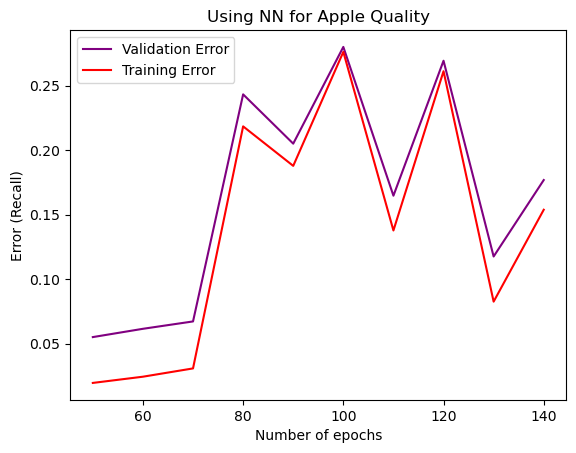

In [113]:
# [APPLE QUALITY] Varying number of epochs
tf.random.set_seed(42)

acc_w_train = []
acc_w_test = []
list_x = []
layer_u = [2]
for x in range(4, 14):
    model = create_ann(x_train_a,y_train_a, dataset = 'apple', layer_units = [64,64,64,64,64,64,64], dropout = 0.01, optimizer = tf.keras.optimizers.legacy.Adam(0.01))
    test,train = strat_kfold_ann(clf = model, num_folds = 5, x_train = x_train_a, y_train = y_train_a, dataset = "apple", epochs = 10 * x)
    acc_w_train.append(1-train)
    acc_w_test.append(1-test)
    list_x.append((x+1)*10)
    print(1-train)
    print(1-test)
    print(10*x)
    

plt.clf()
plt.title('Using NN for Apple Quality')
plt.xlabel("Number of epochs")
plt.ylabel("Error (Recall)")
plt.locator_params(axis='x')
plt.locator_params(axis='y')
plt.plot(list_x, acc_w_test, color='purple', label='Validation Error')
plt.plot(list_x, acc_w_train, color='red', label='Training Error')
plt.legend(loc="upper left")
# plt.savefig('Wine Quality_Decision Tree Error.png',
#             bbox_inches='tight')
plt.show()

Epoch 1/50
86/86 [==============================] - 1s 1ms/step - loss: 1.8684 - accuracy: 0.4344
Epoch 2/50
86/86 [==============================] - 0s 1ms/step - loss: 1.6077 - accuracy: 0.4457
Epoch 3/50
86/86 [==============================] - 0s 1ms/step - loss: 1.4232 - accuracy: 0.4435
Epoch 4/50
86/86 [==============================] - 0s 1ms/step - loss: 1.3263 - accuracy: 0.4457
Epoch 5/50
86/86 [==============================] - 0s 1ms/step - loss: 1.2703 - accuracy: 0.4515
Epoch 6/50
86/86 [==============================] - 0s 1ms/step - loss: 1.2295 - accuracy: 0.4869
Epoch 7/50
86/86 [==============================] - 0s 1ms/step - loss: 1.1935 - accuracy: 0.5040
Epoch 8/50
86/86 [==============================] - 0s 1ms/step - loss: 1.1711 - accuracy: 0.5168
Epoch 9/50
86/86 [==============================] - 0s 1ms/step - loss: 1.1401 - accuracy: 0.5193
Epoch 10/50
86/86 [==============================] - 0s 1ms/step - loss: 1.1230 - accuracy: 0.5295
Epoch 11/50
86/86 [

86/86 [==============================] - 0s 1ms/step - loss: 0.9777 - accuracy: 0.5789
Epoch 13/50
86/86 [==============================] - 0s 1ms/step - loss: 0.9861 - accuracy: 0.5691
Epoch 14/50
86/86 [==============================] - 0s 1ms/step - loss: 0.9770 - accuracy: 0.5713
Epoch 15/50
86/86 [==============================] - 0s 1ms/step - loss: 0.9847 - accuracy: 0.5654
Epoch 16/50
86/86 [==============================] - 0s 1ms/step - loss: 0.9911 - accuracy: 0.5662
Epoch 17/50
86/86 [==============================] - 0s 1ms/step - loss: 0.9837 - accuracy: 0.5658
Epoch 18/50
86/86 [==============================] - 0s 1ms/step - loss: 0.9757 - accuracy: 0.5731
Epoch 19/50
86/86 [==============================] - 0s 1ms/step - loss: 0.9816 - accuracy: 0.5702
Epoch 20/50
86/86 [==============================] - 0s 1ms/step - loss: 0.9750 - accuracy: 0.5713
Epoch 21/50
86/86 [==============================] - 0s 1ms/step - loss: 0.9752 - accuracy: 0.5756
Epoch 22/50
86/86 [===

86/86 [==============================] - 0s 1ms/step - loss: 1.0776 - accuracy: 0.5325
Epoch 24/50
86/86 [==============================] - 0s 1ms/step - loss: 1.0758 - accuracy: 0.5263
Epoch 25/50
86/86 [==============================] - 0s 1ms/step - loss: 1.0826 - accuracy: 0.5222
Epoch 26/50
86/86 [==============================] - 0s 1ms/step - loss: 1.0702 - accuracy: 0.5346
Epoch 27/50
86/86 [==============================] - 0s 2ms/step - loss: 1.0833 - accuracy: 0.5252
Epoch 28/50
86/86 [==============================] - 0s 1ms/step - loss: 1.0693 - accuracy: 0.5328
Epoch 29/50
86/86 [==============================] - 0s 1ms/step - loss: 1.0762 - accuracy: 0.5233
Epoch 30/50
86/86 [==============================] - 0s 1ms/step - loss: 1.0766 - accuracy: 0.5237
Epoch 31/50
86/86 [==============================] - 0s 1ms/step - loss: 1.0672 - accuracy: 0.5274
Epoch 32/50
86/86 [==============================] - 0s 1ms/step - loss: 1.0616 - accuracy: 0.5208
Epoch 33/50
86/86 [===

86/86 [==============================] - 0s 1ms/step - loss: 1.0292 - accuracy: 0.5494
Epoch 35/50
86/86 [==============================] - 0s 1ms/step - loss: 1.0416 - accuracy: 0.5483
Epoch 36/50
86/86 [==============================] - 0s 1ms/step - loss: 1.0395 - accuracy: 0.5352
Epoch 37/50
86/86 [==============================] - 0s 1ms/step - loss: 1.0309 - accuracy: 0.5541
Epoch 38/50
86/86 [==============================] - 0s 1ms/step - loss: 1.0349 - accuracy: 0.5556
Epoch 39/50
86/86 [==============================] - 0s 1ms/step - loss: 1.0324 - accuracy: 0.5461
Epoch 40/50
86/86 [==============================] - 0s 1ms/step - loss: 1.0252 - accuracy: 0.5458
Epoch 41/50
86/86 [==============================] - 0s 1ms/step - loss: 1.0319 - accuracy: 0.5487
Epoch 42/50
86/86 [==============================] - 0s 1ms/step - loss: 1.0392 - accuracy: 0.5501
Epoch 43/50
86/86 [==============================] - 0s 1ms/step - loss: 1.0246 - accuracy: 0.5611
Epoch 44/50
86/86 [===

86/86 [==============================] - 0s 1ms/step - loss: 1.0656 - accuracy: 0.5255
Epoch 46/50
86/86 [==============================] - 0s 1ms/step - loss: 1.0465 - accuracy: 0.5354
Epoch 47/50
86/86 [==============================] - 0s 1ms/step - loss: 1.0584 - accuracy: 0.5252
Epoch 48/50
86/86 [==============================] - 0s 1ms/step - loss: 1.0513 - accuracy: 0.5208
Epoch 49/50
86/86 [==============================] - 0s 1ms/step - loss: 1.0620 - accuracy: 0.5306
Epoch 50/50
22/22 [==============================] - 0s 952us/step
Epoch 1/50
86/86 [==============================] - 0s 1ms/step - loss: 1.0694 - accuracy: 0.5224
Epoch 2/50
86/86 [==============================] - 0s 1ms/step - loss: 1.0664 - accuracy: 0.5253
Epoch 3/50
86/86 [==============================] - 0s 1ms/step - loss: 1.0624 - accuracy: 0.5421
Epoch 4/50
86/86 [==============================] - 0s 1ms/step - loss: 1.0790 - accuracy: 0.5177
Epoch 5/50
86/86 [==============================] - 0s 1ms

86/86 [==============================] - 0s 1ms/step - loss: 1.1484 - accuracy: 0.5084
Epoch 6/50
86/86 [==============================] - 0s 1ms/step - loss: 1.1509 - accuracy: 0.5036
Epoch 7/50
86/86 [==============================] - 0s 1ms/step - loss: 1.1628 - accuracy: 0.4989
Epoch 8/50
86/86 [==============================] - 0s 1ms/step - loss: 1.1526 - accuracy: 0.4996
Epoch 9/50
86/86 [==============================] - 0s 1ms/step - loss: 1.1690 - accuracy: 0.4938
Epoch 10/50
86/86 [==============================] - 0s 1ms/step - loss: 1.1506 - accuracy: 0.5018
Epoch 11/50
86/86 [==============================] - 0s 1ms/step - loss: 1.1431 - accuracy: 0.5088
Epoch 12/50
86/86 [==============================] - 0s 1ms/step - loss: 1.1473 - accuracy: 0.5044
Epoch 13/50
86/86 [==============================] - 0s 1ms/step - loss: 1.1448 - accuracy: 0.5007
Epoch 14/50
86/86 [==============================] - 0s 1ms/step - loss: 1.1372 - accuracy: 0.5131
Epoch 15/50
86/86 [=======

86/86 [==============================] - 0s 1ms/step - loss: 1.0839 - accuracy: 0.5140
Epoch 17/50
86/86 [==============================] - 0s 1ms/step - loss: 1.0871 - accuracy: 0.5180
Epoch 18/50
86/86 [==============================] - 0s 1ms/step - loss: 1.0911 - accuracy: 0.5115
Epoch 19/50
86/86 [==============================] - 0s 1ms/step - loss: 1.0893 - accuracy: 0.5144
Epoch 20/50
86/86 [==============================] - 0s 1ms/step - loss: 1.0832 - accuracy: 0.5272
Epoch 21/50
86/86 [==============================] - 0s 1ms/step - loss: 1.0807 - accuracy: 0.5308
Epoch 22/50
86/86 [==============================] - 0s 1ms/step - loss: 1.0879 - accuracy: 0.5115
Epoch 23/50
86/86 [==============================] - 0s 1ms/step - loss: 1.0877 - accuracy: 0.5206
Epoch 24/50
86/86 [==============================] - 0s 1ms/step - loss: 1.0800 - accuracy: 0.5210
Epoch 25/50
86/86 [==============================] - 0s 1ms/step - loss: 1.0811 - accuracy: 0.5155
Epoch 26/50
86/86 [===

86/86 [==============================] - 0s 1ms/step - loss: 1.1130 - accuracy: 0.4985
Epoch 28/50
86/86 [==============================] - 0s 1ms/step - loss: 1.1085 - accuracy: 0.4912
Epoch 29/50
86/86 [==============================] - 0s 1ms/step - loss: 1.1148 - accuracy: 0.4996
Epoch 30/50
86/86 [==============================] - 0s 1ms/step - loss: 1.1076 - accuracy: 0.5069
Epoch 31/50
86/86 [==============================] - 0s 1ms/step - loss: 1.1161 - accuracy: 0.5004
Epoch 32/50
86/86 [==============================] - 0s 1ms/step - loss: 1.1170 - accuracy: 0.5113
Epoch 33/50
86/86 [==============================] - 0s 1ms/step - loss: 1.1082 - accuracy: 0.5073
Epoch 34/50
86/86 [==============================] - 0s 1ms/step - loss: 1.1165 - accuracy: 0.4894
Epoch 35/50
86/86 [==============================] - 0s 1ms/step - loss: 1.1061 - accuracy: 0.4989
Epoch 36/50
86/86 [==============================] - 0s 1ms/step - loss: 1.1091 - accuracy: 0.5080
Epoch 37/50
86/86 [===

86/86 [==============================] - 0s 1ms/step - loss: 1.2825 - accuracy: 0.4464
Epoch 39/50
86/86 [==============================] - 0s 1ms/step - loss: 1.2785 - accuracy: 0.4464
Epoch 40/50
86/86 [==============================] - 0s 1ms/step - loss: 1.2702 - accuracy: 0.4464
Epoch 41/50
86/86 [==============================] - 0s 1ms/step - loss: 1.2645 - accuracy: 0.4376
Epoch 42/50
86/86 [==============================] - 0s 1ms/step - loss: 1.2694 - accuracy: 0.4409
Epoch 43/50
86/86 [==============================] - 0s 1ms/step - loss: 1.2666 - accuracy: 0.4424
Epoch 44/50
86/86 [==============================] - 0s 1ms/step - loss: 1.2541 - accuracy: 0.4446
Epoch 45/50
86/86 [==============================] - 0s 1ms/step - loss: 1.2463 - accuracy: 0.4391
Epoch 46/50
86/86 [==============================] - 0s 1ms/step - loss: 1.2625 - accuracy: 0.4406
Epoch 47/50
86/86 [==============================] - 0s 1ms/step - loss: 1.2491 - accuracy: 0.4391
Epoch 48/50
86/86 [===

86/86 [==============================] - 0s 1ms/step - loss: 1.2144 - accuracy: 0.4542
Epoch 50/50
22/22 [==============================] - 0s 930us/step
Epoch 1/50
86/86 [==============================] - 0s 1ms/step - loss: 1.1992 - accuracy: 0.4630
Epoch 2/50
86/86 [==============================] - 0s 1ms/step - loss: 1.2051 - accuracy: 0.4579
Epoch 3/50
86/86 [==============================] - 0s 1ms/step - loss: 1.2168 - accuracy: 0.4550
Epoch 4/50
86/86 [==============================] - 0s 1ms/step - loss: 1.1992 - accuracy: 0.4575
Epoch 5/50
86/86 [==============================] - 0s 1ms/step - loss: 1.2045 - accuracy: 0.4594
Epoch 6/50
86/86 [==============================] - 0s 1ms/step - loss: 1.2110 - accuracy: 0.4583
Epoch 7/50
86/86 [==============================] - 0s 1ms/step - loss: 1.2205 - accuracy: 0.4546
Epoch 8/50
86/86 [==============================] - 0s 1ms/step - loss: 1.2126 - accuracy: 0.4524
Epoch 9/50
86/86 [==============================] - 0s 1ms/ste

86/86 [==============================] - 0s 1ms/step - loss: 1.1384 - accuracy: 0.5106
Epoch 10/50
86/86 [==============================] - 0s 1ms/step - loss: 1.1481 - accuracy: 0.5091
Epoch 11/50
86/86 [==============================] - 0s 1ms/step - loss: 1.1577 - accuracy: 0.5186
Epoch 12/50
86/86 [==============================] - 0s 1ms/step - loss: 1.1551 - accuracy: 0.5124
Epoch 13/50
86/86 [==============================] - 0s 1ms/step - loss: 1.1520 - accuracy: 0.5069
Epoch 14/50
86/86 [==============================] - 0s 1ms/step - loss: 1.1519 - accuracy: 0.5088
Epoch 15/50
86/86 [==============================] - 0s 1ms/step - loss: 1.1510 - accuracy: 0.5120
Epoch 16/50
86/86 [==============================] - 0s 1ms/step - loss: 1.1552 - accuracy: 0.5047
Epoch 17/50
86/86 [==============================] - 0s 1ms/step - loss: 1.1529 - accuracy: 0.5073
Epoch 18/50
86/86 [==============================] - 0s 1ms/step - loss: 1.1442 - accuracy: 0.5033
Epoch 19/50
86/86 [===

86/86 [==============================] - 0s 1ms/step - loss: 1.3004 - accuracy: 0.4457
Epoch 21/50
86/86 [==============================] - 0s 1ms/step - loss: 1.2979 - accuracy: 0.4533
Epoch 22/50
86/86 [==============================] - 0s 1ms/step - loss: 1.2960 - accuracy: 0.4475
Epoch 23/50
86/86 [==============================] - 0s 1ms/step - loss: 1.2852 - accuracy: 0.4460
Epoch 24/50
86/86 [==============================] - 0s 1ms/step - loss: 1.2870 - accuracy: 0.4478
Epoch 25/50
86/86 [==============================] - 0s 1ms/step - loss: 1.2897 - accuracy: 0.4497
Epoch 26/50
86/86 [==============================] - 0s 1ms/step - loss: 1.2696 - accuracy: 0.4475
Epoch 27/50
86/86 [==============================] - 0s 1ms/step - loss: 1.2842 - accuracy: 0.4402
Epoch 28/50
86/86 [==============================] - 0s 1ms/step - loss: 1.2725 - accuracy: 0.4508
Epoch 29/50
86/86 [==============================] - 0s 1ms/step - loss: 1.2663 - accuracy: 0.4406
Epoch 30/50
86/86 [===

86/86 [==============================] - 0s 1ms/step - loss: 1.1812 - accuracy: 0.4892
Epoch 33/50
86/86 [==============================] - 0s 1ms/step - loss: 1.1694 - accuracy: 0.4903
Epoch 34/50
86/86 [==============================] - 0s 1ms/step - loss: 1.1592 - accuracy: 0.4947
Epoch 35/50
86/86 [==============================] - 0s 1ms/step - loss: 1.1676 - accuracy: 0.4878
Epoch 36/50
86/86 [==============================] - 0s 1ms/step - loss: 1.1771 - accuracy: 0.4903
Epoch 37/50
86/86 [==============================] - 0s 1ms/step - loss: 1.1678 - accuracy: 0.5013
Epoch 38/50
86/86 [==============================] - 0s 1ms/step - loss: 1.1698 - accuracy: 0.4969
Epoch 39/50
86/86 [==============================] - 0s 1ms/step - loss: 1.1733 - accuracy: 0.4954
Epoch 40/50
86/86 [==============================] - 0s 1ms/step - loss: 1.1665 - accuracy: 0.5129
Epoch 41/50
86/86 [==============================] - 0s 1ms/step - loss: 1.1751 - accuracy: 0.4889
Epoch 42/50
86/86 [===

86/86 [==============================] - 0s 2ms/step - loss: 1.1923 - accuracy: 0.4909
Epoch 44/50
86/86 [==============================] - 0s 1ms/step - loss: 1.1952 - accuracy: 0.4861
Epoch 45/50
86/86 [==============================] - 0s 1ms/step - loss: 1.1928 - accuracy: 0.4865
Epoch 46/50
86/86 [==============================] - 0s 1ms/step - loss: 1.1912 - accuracy: 0.4923
Epoch 47/50
86/86 [==============================] - 0s 1ms/step - loss: 1.2007 - accuracy: 0.4847
Epoch 48/50
86/86 [==============================] - 0s 1ms/step - loss: 1.1968 - accuracy: 0.4829
Epoch 49/50
86/86 [==============================] - 0s 1ms/step - loss: 1.1974 - accuracy: 0.4788
Epoch 50/50
22/22 [==============================] - 0s 927us/step
Epoch 1/50
86/86 [==============================] - 0s 1ms/step - loss: 1.1948 - accuracy: 0.4785
Epoch 2/50
86/86 [==============================] - 0s 1ms/step - loss: 1.1873 - accuracy: 0.4861
Epoch 3/50
86/86 [==============================] - 0s 1

86/86 [==============================] - 0s 1ms/step - loss: 1.7725 - accuracy: 0.4395
Epoch 4/50
86/86 [==============================] - 0s 1ms/step - loss: 1.7160 - accuracy: 0.4438
Epoch 5/50
86/86 [==============================] - 0s 1ms/step - loss: 1.6661 - accuracy: 0.4468
Epoch 6/50
86/86 [==============================] - 0s 1ms/step - loss: 1.6219 - accuracy: 0.4457
Epoch 7/50
86/86 [==============================] - 0s 1ms/step - loss: 1.5827 - accuracy: 0.4471
Epoch 8/50
86/86 [==============================] - 0s 2ms/step - loss: 1.5486 - accuracy: 0.4497
Epoch 9/50
86/86 [==============================] - 0s 2ms/step - loss: 1.5175 - accuracy: 0.4475
Epoch 10/50
86/86 [==============================] - 0s 1ms/step - loss: 1.4906 - accuracy: 0.4489
Epoch 11/50
86/86 [==============================] - 0s 1ms/step - loss: 1.4691 - accuracy: 0.4489
Epoch 12/50
86/86 [==============================] - 0s 1ms/step - loss: 1.4500 - accuracy: 0.4515
Epoch 13/50
86/86 [=========

86/86 [==============================] - 0s 1ms/step - loss: 1.2300 - accuracy: 0.4717
Epoch 15/50
86/86 [==============================] - 0s 1ms/step - loss: 1.2362 - accuracy: 0.4703
Epoch 16/50
86/86 [==============================] - 0s 1ms/step - loss: 1.2211 - accuracy: 0.4732
Epoch 17/50
86/86 [==============================] - 0s 1ms/step - loss: 1.2340 - accuracy: 0.4674
Epoch 18/50
86/86 [==============================] - 0s 1ms/step - loss: 1.2317 - accuracy: 0.4728
Epoch 19/50
86/86 [==============================] - 0s 1ms/step - loss: 1.2343 - accuracy: 0.4710
Epoch 20/50
86/86 [==============================] - 0s 1ms/step - loss: 1.2284 - accuracy: 0.4717
Epoch 21/50
86/86 [==============================] - 0s 1ms/step - loss: 1.2307 - accuracy: 0.4769
Epoch 22/50
86/86 [==============================] - 0s 1ms/step - loss: 1.2242 - accuracy: 0.4849
Epoch 23/50
86/86 [==============================] - 0s 1ms/step - loss: 1.2347 - accuracy: 0.4688
Epoch 24/50
86/86 [===

86/86 [==============================] - 0s 1ms/step - loss: 1.2391 - accuracy: 0.4803
Epoch 26/50
86/86 [==============================] - 0s 1ms/step - loss: 1.2301 - accuracy: 0.4843
Epoch 27/50
86/86 [==============================] - 0s 1ms/step - loss: 1.2422 - accuracy: 0.4814
Epoch 28/50
86/86 [==============================] - 0s 1ms/step - loss: 1.2264 - accuracy: 0.4810
Epoch 29/50
86/86 [==============================] - 0s 1ms/step - loss: 1.2270 - accuracy: 0.4821
Epoch 30/50
86/86 [==============================] - 0s 1ms/step - loss: 1.2363 - accuracy: 0.4712
Epoch 31/50
86/86 [==============================] - 0s 1ms/step - loss: 1.2328 - accuracy: 0.4836
Epoch 32/50
86/86 [==============================] - 0s 1ms/step - loss: 1.2373 - accuracy: 0.4745
Epoch 33/50
86/86 [==============================] - 0s 1ms/step - loss: 1.2278 - accuracy: 0.4843
Epoch 34/50
86/86 [==============================] - 0s 1ms/step - loss: 1.2260 - accuracy: 0.4716
Epoch 35/50
86/86 [===

86/86 [==============================] - 0s 1ms/step - loss: 1.2084 - accuracy: 0.4856
Epoch 37/50
86/86 [==============================] - 0s 1ms/step - loss: 1.2074 - accuracy: 0.4750
Epoch 38/50
86/86 [==============================] - 0s 1ms/step - loss: 1.1991 - accuracy: 0.4838
Epoch 39/50
86/86 [==============================] - 0s 1ms/step - loss: 1.2034 - accuracy: 0.4860
Epoch 40/50
86/86 [==============================] - 0s 1ms/step - loss: 1.2031 - accuracy: 0.4809
Epoch 41/50
86/86 [==============================] - 0s 1ms/step - loss: 1.2126 - accuracy: 0.4732
Epoch 42/50
86/86 [==============================] - 0s 1ms/step - loss: 1.2000 - accuracy: 0.4889
Epoch 43/50
86/86 [==============================] - 0s 1ms/step - loss: 1.2144 - accuracy: 0.4736
Epoch 44/50
86/86 [==============================] - 0s 1ms/step - loss: 1.2215 - accuracy: 0.4779
Epoch 45/50
86/86 [==============================] - 0s 1ms/step - loss: 1.2102 - accuracy: 0.4772
Epoch 46/50
86/86 [===

86/86 [==============================] - 0s 1ms/step - loss: 1.2387 - accuracy: 0.4599
Epoch 48/50
86/86 [==============================] - 0s 1ms/step - loss: 1.2431 - accuracy: 0.4635
Epoch 49/50
86/86 [==============================] - 0s 1ms/step - loss: 1.2425 - accuracy: 0.4646
Epoch 50/50
22/22 [==============================] - 0s 905us/step
Epoch 1/50
86/86 [==============================] - 0s 1ms/step - loss: 1.2386 - accuracy: 0.4685
Epoch 2/50
86/86 [==============================] - 0s 1ms/step - loss: 1.2485 - accuracy: 0.4688
Epoch 3/50
86/86 [==============================] - 0s 1ms/step - loss: 1.2375 - accuracy: 0.4645
Epoch 4/50
86/86 [==============================] - 0s 1ms/step - loss: 1.2452 - accuracy: 0.4692
Epoch 5/50
86/86 [==============================] - 0s 1ms/step - loss: 1.2535 - accuracy: 0.4696
Epoch 6/50
86/86 [==============================] - 0s 1ms/step - loss: 1.2446 - accuracy: 0.4637
Epoch 7/50
86/86 [==============================] - 0s 1ms/s

86/86 [==============================] - 0s 1ms/step - loss: 1.3032 - accuracy: 0.4464
Epoch 8/50
86/86 [==============================] - 0s 1ms/step - loss: 1.3027 - accuracy: 0.4464
Epoch 9/50
86/86 [==============================] - 0s 1ms/step - loss: 1.3021 - accuracy: 0.4464
Epoch 10/50
86/86 [==============================] - 0s 1ms/step - loss: 1.3022 - accuracy: 0.4460
Epoch 11/50
86/86 [==============================] - 0s 1ms/step - loss: 1.3020 - accuracy: 0.4464
Epoch 12/50
86/86 [==============================] - 0s 1ms/step - loss: 1.3016 - accuracy: 0.4464
Epoch 13/50
86/86 [==============================] - 0s 1ms/step - loss: 1.3012 - accuracy: 0.4464
Epoch 14/50
86/86 [==============================] - 0s 1ms/step - loss: 1.3013 - accuracy: 0.4464
Epoch 15/50
86/86 [==============================] - 0s 1ms/step - loss: 1.3004 - accuracy: 0.4464
Epoch 16/50
86/86 [==============================] - 0s 1ms/step - loss: 1.2998 - accuracy: 0.4464
Epoch 17/50
86/86 [=====

86/86 [==============================] - 0s 1ms/step - loss: 1.2792 - accuracy: 0.4477
Epoch 19/50
86/86 [==============================] - 0s 1ms/step - loss: 1.2804 - accuracy: 0.4455
Epoch 20/50
86/86 [==============================] - 0s 1ms/step - loss: 1.2762 - accuracy: 0.4513
Epoch 21/50
86/86 [==============================] - 0s 1ms/step - loss: 1.2699 - accuracy: 0.4517
Epoch 22/50
86/86 [==============================] - 0s 1ms/step - loss: 1.2707 - accuracy: 0.4473
Epoch 23/50
86/86 [==============================] - 0s 1ms/step - loss: 1.2747 - accuracy: 0.4484
Epoch 24/50
86/86 [==============================] - 0s 1ms/step - loss: 1.2682 - accuracy: 0.4480
Epoch 25/50
86/86 [==============================] - 0s 1ms/step - loss: 1.2720 - accuracy: 0.4506
Epoch 26/50
86/86 [==============================] - 0s 1ms/step - loss: 1.2874 - accuracy: 0.4459
Epoch 27/50
86/86 [==============================] - 0s 1ms/step - loss: 1.2738 - accuracy: 0.4502
Epoch 28/50
86/86 [===

86/86 [==============================] - 0s 1ms/step - loss: 1.2538 - accuracy: 0.4716
Epoch 30/50
86/86 [==============================] - 0s 1ms/step - loss: 1.2600 - accuracy: 0.4639
Epoch 31/50
86/86 [==============================] - 0s 1ms/step - loss: 1.2557 - accuracy: 0.4672
Epoch 32/50
86/86 [==============================] - 0s 1ms/step - loss: 1.2652 - accuracy: 0.4621
Epoch 33/50
86/86 [==============================] - 0s 1ms/step - loss: 1.2619 - accuracy: 0.4686
Epoch 34/50
86/86 [==============================] - 0s 1ms/step - loss: 1.2650 - accuracy: 0.4621
Epoch 35/50
86/86 [==============================] - 0s 1ms/step - loss: 1.2644 - accuracy: 0.4635
Epoch 36/50
86/86 [==============================] - 0s 1ms/step - loss: 1.2553 - accuracy: 0.4650
Epoch 37/50
86/86 [==============================] - 0s 1ms/step - loss: 1.2507 - accuracy: 0.4723
Epoch 38/50
86/86 [==============================] - 0s 1ms/step - loss: 1.2644 - accuracy: 0.4606
Epoch 39/50
86/86 [===

86/86 [==============================] - 0s 1ms/step - loss: 1.3114 - accuracy: 0.4522
Epoch 41/50
86/86 [==============================] - 0s 1ms/step - loss: 1.3123 - accuracy: 0.4482
Epoch 42/50
86/86 [==============================] - 0s 1ms/step - loss: 1.3102 - accuracy: 0.4489
Epoch 43/50
86/86 [==============================] - 0s 1ms/step - loss: 1.3069 - accuracy: 0.4526
Epoch 44/50
86/86 [==============================] - 0s 1ms/step - loss: 1.3106 - accuracy: 0.4453
Epoch 45/50
86/86 [==============================] - 0s 1ms/step - loss: 1.3075 - accuracy: 0.4471
Epoch 46/50
86/86 [==============================] - 0s 1ms/step - loss: 1.3075 - accuracy: 0.4489
Epoch 47/50
86/86 [==============================] - 0s 1ms/step - loss: 1.3067 - accuracy: 0.4471
Epoch 48/50
86/86 [==============================] - 0s 1ms/step - loss: 1.3044 - accuracy: 0.4497
Epoch 49/50
86/86 [==============================] - 0s 1ms/step - loss: 1.3033 - accuracy: 0.4522
Epoch 50/50
22/22 [===

22/22 [==============================] - 0s 862us/step
Epoch 1/50
86/86 [==============================] - 0s 1ms/step - loss: 1.2631 - accuracy: 0.4692
Epoch 2/50
86/86 [==============================] - 0s 1ms/step - loss: 1.2698 - accuracy: 0.4608
Epoch 3/50
86/86 [==============================] - 0s 1ms/step - loss: 1.2672 - accuracy: 0.4659
Epoch 4/50
86/86 [==============================] - 0s 1ms/step - loss: 1.2651 - accuracy: 0.4630
Epoch 5/50
86/86 [==============================] - 0s 1ms/step - loss: 1.2619 - accuracy: 0.4630
Epoch 6/50
86/86 [==============================] - 0s 1ms/step - loss: 1.2641 - accuracy: 0.4659
Epoch 7/50
86/86 [==============================] - 0s 1ms/step - loss: 1.2699 - accuracy: 0.4608
Epoch 8/50
86/86 [==============================] - 0s 1ms/step - loss: 1.2566 - accuracy: 0.4652
Epoch 9/50
86/86 [==============================] - 0s 1ms/step - loss: 1.2583 - accuracy: 0.4725
Epoch 10/50
86/86 [==============================] - 0s 1ms/ste

86/86 [==============================] - 0s 1ms/step - loss: 1.2891 - accuracy: 0.4522
Epoch 12/50
86/86 [==============================] - 0s 1ms/step - loss: 1.2900 - accuracy: 0.4504
Epoch 13/50
86/86 [==============================] - 0s 1ms/step - loss: 1.2910 - accuracy: 0.4544
Epoch 14/50
86/86 [==============================] - 0s 1ms/step - loss: 1.2888 - accuracy: 0.4486
Epoch 15/50
86/86 [==============================] - 0s 1ms/step - loss: 1.2934 - accuracy: 0.4504
Epoch 16/50
86/86 [==============================] - 0s 1ms/step - loss: 1.2898 - accuracy: 0.4482
Epoch 17/50
86/86 [==============================] - 0s 1ms/step - loss: 1.2902 - accuracy: 0.4504
Epoch 18/50
86/86 [==============================] - 0s 1ms/step - loss: 1.2897 - accuracy: 0.4482
Epoch 19/50
86/86 [==============================] - 0s 1ms/step - loss: 1.2915 - accuracy: 0.4482
Epoch 20/50
86/86 [==============================] - 0s 1ms/step - loss: 1.2859 - accuracy: 0.4555
Epoch 21/50
86/86 [===

86/86 [==============================] - 0s 1ms/step - loss: 1.3490 - accuracy: 0.4464
Epoch 23/50
86/86 [==============================] - 0s 1ms/step - loss: 1.3527 - accuracy: 0.4460
Epoch 24/50
86/86 [==============================] - 0s 1ms/step - loss: 1.3465 - accuracy: 0.4464
Epoch 25/50
86/86 [==============================] - 0s 1ms/step - loss: 1.3394 - accuracy: 0.4468
Epoch 26/50
86/86 [==============================] - 0s 1ms/step - loss: 1.3404 - accuracy: 0.4464
Epoch 27/50
86/86 [==============================] - 0s 1ms/step - loss: 1.3372 - accuracy: 0.4468
Epoch 28/50
86/86 [==============================] - 0s 1ms/step - loss: 1.3319 - accuracy: 0.4464
Epoch 29/50
86/86 [==============================] - 0s 1ms/step - loss: 1.3311 - accuracy: 0.4457
Epoch 30/50
86/86 [==============================] - 0s 1ms/step - loss: 1.3246 - accuracy: 0.4468
Epoch 31/50
86/86 [==============================] - 0s 1ms/step - loss: 1.3276 - accuracy: 0.4464
Epoch 32/50
86/86 [===

86/86 [==============================] - 0s 1ms/step - loss: 1.3003 - accuracy: 0.4466
Epoch 34/50
86/86 [==============================] - 0s 1ms/step - loss: 1.3008 - accuracy: 0.4466
Epoch 35/50
86/86 [==============================] - 0s 1ms/step - loss: 1.2983 - accuracy: 0.4459
Epoch 36/50
86/86 [==============================] - 0s 1ms/step - loss: 1.2986 - accuracy: 0.4462
Epoch 37/50
86/86 [==============================] - 0s 1ms/step - loss: 1.3000 - accuracy: 0.4470
Epoch 38/50
86/86 [==============================] - 0s 1ms/step - loss: 1.2983 - accuracy: 0.4462
Epoch 39/50
86/86 [==============================] - 0s 1ms/step - loss: 1.2981 - accuracy: 0.4466
Epoch 40/50
86/86 [==============================] - 0s 1ms/step - loss: 1.2979 - accuracy: 0.4473
Epoch 41/50
86/86 [==============================] - 0s 1ms/step - loss: 1.2983 - accuracy: 0.4466
Epoch 42/50
86/86 [==============================] - 0s 1ms/step - loss: 1.2997 - accuracy: 0.4473
Epoch 43/50
86/86 [===

86/86 [==============================] - 0s 1ms/step - loss: 1.2977 - accuracy: 0.4464
Epoch 45/50
86/86 [==============================] - 0s 1ms/step - loss: 1.2979 - accuracy: 0.4464
Epoch 46/50
86/86 [==============================] - 0s 1ms/step - loss: 1.2978 - accuracy: 0.4464
Epoch 47/50
86/86 [==============================] - 0s 1ms/step - loss: 1.2978 - accuracy: 0.4464
Epoch 48/50
86/86 [==============================] - 0s 1ms/step - loss: 1.2978 - accuracy: 0.4464
Epoch 49/50
86/86 [==============================] - 0s 1ms/step - loss: 1.2977 - accuracy: 0.4464
Epoch 50/50
22/22 [==============================] - 0s 862us/step
Epoch 1/50
86/86 [==============================] - 0s 1ms/step - loss: 1.2977 - accuracy: 0.4464
Epoch 2/50
86/86 [==============================] - 0s 1ms/step - loss: 1.2976 - accuracy: 0.4468
Epoch 3/50
86/86 [==============================] - 0s 1ms/step - loss: 1.2977 - accuracy: 0.4464
Epoch 4/50
86/86 [==============================] - 0s 1m

86/86 [==============================] - 0s 1ms/step - loss: 1.7637 - accuracy: 0.4453
Epoch 5/50
86/86 [==============================] - 0s 1ms/step - loss: 1.6747 - accuracy: 0.4457
Epoch 6/50
86/86 [==============================] - 0s 1ms/step - loss: 1.6780 - accuracy: 0.4453
Epoch 7/50
86/86 [==============================] - 0s 1ms/step - loss: 1.6287 - accuracy: 0.4457
Epoch 8/50
86/86 [==============================] - 0s 1ms/step - loss: 1.6005 - accuracy: 0.4457
Epoch 9/50
86/86 [==============================] - 0s 1ms/step - loss: 1.5196 - accuracy: 0.4460
Epoch 10/50
86/86 [==============================] - 0s 1ms/step - loss: 1.5128 - accuracy: 0.4460
Epoch 11/50
86/86 [==============================] - 0s 1ms/step - loss: 1.4717 - accuracy: 0.4464
Epoch 12/50
86/86 [==============================] - 0s 1ms/step - loss: 1.4637 - accuracy: 0.4464
Epoch 13/50
86/86 [==============================] - 0s 1ms/step - loss: 1.5389 - accuracy: 0.4457
Epoch 14/50
86/86 [========

86/86 [==============================] - 0s 1ms/step - loss: 1.2989 - accuracy: 0.4462
Epoch 16/50
86/86 [==============================] - 0s 1ms/step - loss: 1.2989 - accuracy: 0.4462
Epoch 17/50
86/86 [==============================] - 0s 1ms/step - loss: 1.2989 - accuracy: 0.4462
Epoch 18/50
86/86 [==============================] - 0s 1ms/step - loss: 1.2989 - accuracy: 0.4462
Epoch 19/50
86/86 [==============================] - 0s 1ms/step - loss: 1.2989 - accuracy: 0.4462
Epoch 20/50
86/86 [==============================] - 0s 1ms/step - loss: 1.2988 - accuracy: 0.4462
Epoch 21/50
86/86 [==============================] - 0s 1ms/step - loss: 1.2988 - accuracy: 0.4462
Epoch 22/50
86/86 [==============================] - 0s 1ms/step - loss: 1.2988 - accuracy: 0.4462
Epoch 23/50
86/86 [==============================] - 0s 1ms/step - loss: 1.2989 - accuracy: 0.4462
Epoch 24/50
86/86 [==============================] - 0s 1ms/step - loss: 1.2988 - accuracy: 0.4462
Epoch 25/50
86/86 [===

86/86 [==============================] - 0s 1ms/step - loss: 1.2992 - accuracy: 0.4464
Epoch 27/50
86/86 [==============================] - 0s 1ms/step - loss: 1.2990 - accuracy: 0.4464
Epoch 28/50
86/86 [==============================] - 0s 1ms/step - loss: 1.4382 - accuracy: 0.4460
Epoch 29/50
86/86 [==============================] - 0s 1ms/step - loss: 1.2989 - accuracy: 0.4464
Epoch 30/50
86/86 [==============================] - 0s 1ms/step - loss: 1.2988 - accuracy: 0.4464
Epoch 31/50
86/86 [==============================] - 0s 1ms/step - loss: 1.2987 - accuracy: 0.4464
Epoch 32/50
86/86 [==============================] - 0s 1ms/step - loss: 1.2989 - accuracy: 0.4464
Epoch 33/50
86/86 [==============================] - 0s 1ms/step - loss: 1.2985 - accuracy: 0.4464
Epoch 34/50
86/86 [==============================] - 0s 1ms/step - loss: 1.2984 - accuracy: 0.4464
Epoch 35/50
86/86 [==============================] - 0s 1ms/step - loss: 1.2983 - accuracy: 0.4464
Epoch 36/50
86/86 [===

86/86 [==============================] - 0s 1ms/step - loss: 1.2988 - accuracy: 0.4462
Epoch 38/50
86/86 [==============================] - 0s 1ms/step - loss: 1.2988 - accuracy: 0.4462
Epoch 39/50
86/86 [==============================] - 0s 1ms/step - loss: 1.2989 - accuracy: 0.4462
Epoch 40/50
86/86 [==============================] - 0s 1ms/step - loss: 1.2988 - accuracy: 0.4462
Epoch 41/50
86/86 [==============================] - 0s 1ms/step - loss: 1.2989 - accuracy: 0.4462
Epoch 42/50
86/86 [==============================] - 0s 1ms/step - loss: 1.2988 - accuracy: 0.4462
Epoch 43/50
86/86 [==============================] - 0s 1ms/step - loss: 1.2988 - accuracy: 0.4462
Epoch 44/50
86/86 [==============================] - 0s 1ms/step - loss: 1.2988 - accuracy: 0.4462
Epoch 45/50
86/86 [==============================] - 0s 1ms/step - loss: 1.2988 - accuracy: 0.4459
Epoch 46/50
86/86 [==============================] - 0s 1ms/step - loss: 1.2989 - accuracy: 0.4462
Epoch 47/50
86/86 [===

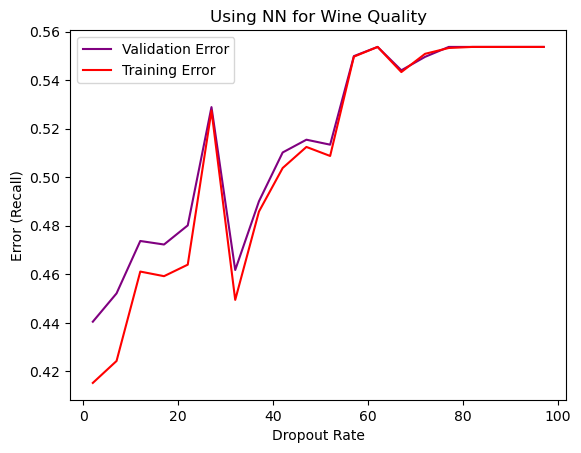

In [174]:
# [WINE QUALITY] Varying the dropout rate to see if we prevent overfitting earlier and have a better model

acc_w_train = []
acc_w_test = []
list_x = []
# layer_u = [2]
for x in range(1, 100, 5):
    model = create_ann(x_train_w,y_train_w, dataset = 'wine', layer_units = [16,8,4,2], dropout = x/100)
    test,train = strat_kfold_ann(clf = model, num_folds = 5, x_train = x_train_w, y_train = y_train_w, dataset = "wine", epochs = 50)
    acc_w_train.append(1-train)
    acc_w_test.append(1-test)
    list_x.append(x+1)
    print(1-train)
    print(1-test)
    print(x/100)
    

plt.clf()
plt.title('Using NN for Wine Quality')
plt.xlabel("Dropout Rate")
plt.ylabel("Error (Recall)")
plt.locator_params(axis='x')
plt.locator_params(axis='y')
plt.plot(list_x, acc_w_test, color='purple', label='Validation Error')
plt.plot(list_x, acc_w_train, color='red', label='Training Error')
plt.legend(loc="upper left")
# plt.savefig('Wine Quality_Decision Tree Error.png',
#             bbox_inches='tight')
plt.show()

Epoch 1/50
70/70 [==============================] - 1s 1ms/step - loss: 0.6512 - accuracy: 0.6634
Epoch 2/50
70/70 [==============================] - 0s 1ms/step - loss: 0.5855 - accuracy: 0.7281
Epoch 3/50
70/70 [==============================] - 0s 1ms/step - loss: 0.5455 - accuracy: 0.7763
Epoch 4/50
70/70 [==============================] - 0s 1ms/step - loss: 0.5201 - accuracy: 0.7964
Epoch 5/50
70/70 [==============================] - 0s 1ms/step - loss: 0.4971 - accuracy: 0.8138
Epoch 6/50
70/70 [==============================] - 0s 1ms/step - loss: 0.4849 - accuracy: 0.8152
Epoch 7/50
70/70 [==============================] - 0s 1ms/step - loss: 0.4716 - accuracy: 0.8210
Epoch 8/50
70/70 [==============================] - 0s 1ms/step - loss: 0.4590 - accuracy: 0.8232
Epoch 9/50
70/70 [==============================] - 0s 1ms/step - loss: 0.4446 - accuracy: 0.8326
Epoch 10/50
70/70 [==============================] - 0s 1ms/step - loss: 0.4372 - accuracy: 0.8388
Epoch 11/50
70/70 [

70/70 [==============================] - 0s 1ms/step - loss: 0.2254 - accuracy: 0.9192
Epoch 13/50
70/70 [==============================] - 0s 1ms/step - loss: 0.2267 - accuracy: 0.9174
Epoch 14/50
70/70 [==============================] - 0s 1ms/step - loss: 0.2249 - accuracy: 0.9214
Epoch 15/50
70/70 [==============================] - 0s 1ms/step - loss: 0.2254 - accuracy: 0.9201
Epoch 16/50
70/70 [==============================] - 0s 1ms/step - loss: 0.2322 - accuracy: 0.9147
Epoch 17/50
70/70 [==============================] - 0s 1ms/step - loss: 0.2369 - accuracy: 0.9179
Epoch 18/50
70/70 [==============================] - 0s 1ms/step - loss: 0.2431 - accuracy: 0.9103
Epoch 19/50
70/70 [==============================] - 0s 1ms/step - loss: 0.2310 - accuracy: 0.9187
Epoch 20/50
70/70 [==============================] - 0s 1ms/step - loss: 0.2392 - accuracy: 0.9201
Epoch 21/50
70/70 [==============================] - 0s 1ms/step - loss: 0.2277 - accuracy: 0.9187
Epoch 22/50
70/70 [===

70/70 [==============================] - 0s 1ms/step - loss: 0.2791 - accuracy: 0.8991
Epoch 24/50
70/70 [==============================] - 0s 1ms/step - loss: 0.2886 - accuracy: 0.8888
Epoch 25/50
70/70 [==============================] - 0s 1ms/step - loss: 0.2742 - accuracy: 0.8897
Epoch 26/50
70/70 [==============================] - 0s 1ms/step - loss: 0.2839 - accuracy: 0.8915
Epoch 27/50
70/70 [==============================] - 0s 1ms/step - loss: 0.2803 - accuracy: 0.8906
Epoch 28/50
70/70 [==============================] - 0s 1ms/step - loss: 0.2724 - accuracy: 0.8929
Epoch 29/50
70/70 [==============================] - 0s 1ms/step - loss: 0.2858 - accuracy: 0.8844
Epoch 30/50
70/70 [==============================] - 0s 1ms/step - loss: 0.2726 - accuracy: 0.8915
Epoch 31/50
70/70 [==============================] - 0s 1ms/step - loss: 0.2793 - accuracy: 0.8879
Epoch 32/50
70/70 [==============================] - 0s 1ms/step - loss: 0.2737 - accuracy: 0.8969
Epoch 33/50
70/70 [===

70/70 [==============================] - 0s 1ms/step - loss: 0.1856 - accuracy: 0.9357
Epoch 35/50
70/70 [==============================] - 0s 1ms/step - loss: 0.1870 - accuracy: 0.9321
Epoch 36/50
70/70 [==============================] - 0s 1ms/step - loss: 0.1812 - accuracy: 0.9393
Epoch 37/50
70/70 [==============================] - 0s 1ms/step - loss: 0.1670 - accuracy: 0.9411
Epoch 38/50
70/70 [==============================] - 0s 1ms/step - loss: 0.1695 - accuracy: 0.9406
Epoch 39/50
70/70 [==============================] - 0s 1ms/step - loss: 0.1725 - accuracy: 0.9438
Epoch 40/50
70/70 [==============================] - 0s 1ms/step - loss: 0.1723 - accuracy: 0.9442
Epoch 41/50
70/70 [==============================] - 0s 1ms/step - loss: 0.1688 - accuracy: 0.9384
Epoch 42/50
70/70 [==============================] - 0s 1ms/step - loss: 0.1780 - accuracy: 0.9384
Epoch 43/50
70/70 [==============================] - 0s 1ms/step - loss: 0.1710 - accuracy: 0.9464
Epoch 44/50
70/70 [===

70/70 [==============================] - 0s 1ms/step - loss: 0.3327 - accuracy: 0.8746
Epoch 46/50
70/70 [==============================] - 0s 1ms/step - loss: 0.3338 - accuracy: 0.8723
Epoch 47/50
70/70 [==============================] - 0s 1ms/step - loss: 0.3170 - accuracy: 0.8737
Epoch 48/50
70/70 [==============================] - 0s 1ms/step - loss: 0.3274 - accuracy: 0.8741
Epoch 49/50
70/70 [==============================] - 0s 1ms/step - loss: 0.3184 - accuracy: 0.8795
Epoch 50/50
18/18 [==============================] - 0s 941us/step
Epoch 1/50
70/70 [==============================] - 0s 1ms/step - loss: 0.3422 - accuracy: 0.8683
Epoch 2/50
70/70 [==============================] - 0s 1ms/step - loss: 0.3407 - accuracy: 0.8692
Epoch 3/50
70/70 [==============================] - 0s 1ms/step - loss: 0.3721 - accuracy: 0.8513
Epoch 4/50
70/70 [==============================] - 0s 1ms/step - loss: 0.3366 - accuracy: 0.8701
Epoch 5/50
70/70 [==============================] - 0s 1ms

70/70 [==============================] - 0s 1ms/step - loss: 0.3688 - accuracy: 0.8138
Epoch 6/50
70/70 [==============================] - 0s 1ms/step - loss: 0.3610 - accuracy: 0.8237
Epoch 7/50
70/70 [==============================] - 0s 1ms/step - loss: 0.3545 - accuracy: 0.8272
Epoch 8/50
70/70 [==============================] - 0s 1ms/step - loss: 0.3792 - accuracy: 0.8085
Epoch 9/50
70/70 [==============================] - 0s 1ms/step - loss: 0.3539 - accuracy: 0.8232
Epoch 10/50
70/70 [==============================] - 0s 1ms/step - loss: 0.3637 - accuracy: 0.8134
Epoch 11/50
70/70 [==============================] - 0s 1ms/step - loss: 0.3661 - accuracy: 0.8161
Epoch 12/50
70/70 [==============================] - 0s 1ms/step - loss: 0.3767 - accuracy: 0.8103
Epoch 13/50
70/70 [==============================] - 0s 1ms/step - loss: 0.3525 - accuracy: 0.8214
Epoch 14/50
70/70 [==============================] - 0s 1ms/step - loss: 0.3652 - accuracy: 0.8129
Epoch 15/50
70/70 [=======

70/70 [==============================] - 0s 1ms/step - loss: 0.2867 - accuracy: 0.8616
Epoch 17/50
70/70 [==============================] - 0s 1ms/step - loss: 0.2874 - accuracy: 0.8518
Epoch 18/50
70/70 [==============================] - 0s 1ms/step - loss: 0.2803 - accuracy: 0.8545
Epoch 19/50
70/70 [==============================] - 0s 1ms/step - loss: 0.2698 - accuracy: 0.8638
Epoch 20/50
70/70 [==============================] - 0s 1ms/step - loss: 0.2905 - accuracy: 0.8504
Epoch 21/50
70/70 [==============================] - 0s 1ms/step - loss: 0.2675 - accuracy: 0.8679
Epoch 22/50
70/70 [==============================] - 0s 1ms/step - loss: 0.2720 - accuracy: 0.8554
Epoch 23/50
70/70 [==============================] - 0s 1ms/step - loss: 0.2715 - accuracy: 0.8603
Epoch 24/50
70/70 [==============================] - 0s 1ms/step - loss: 0.2657 - accuracy: 0.8665
Epoch 25/50
70/70 [==============================] - 0s 1ms/step - loss: 0.2569 - accuracy: 0.8638
Epoch 26/50
70/70 [===

70/70 [==============================] - 0s 1ms/step - loss: 0.3404 - accuracy: 0.8214
Epoch 28/50
70/70 [==============================] - 0s 1ms/step - loss: 0.3427 - accuracy: 0.8147
Epoch 29/50
70/70 [==============================] - 0s 1ms/step - loss: 0.3598 - accuracy: 0.8085
Epoch 30/50
70/70 [==============================] - 0s 1ms/step - loss: 0.3216 - accuracy: 0.8402
Epoch 31/50
70/70 [==============================] - 0s 1ms/step - loss: 0.3248 - accuracy: 0.8228
Epoch 32/50
70/70 [==============================] - 0s 1ms/step - loss: 0.3384 - accuracy: 0.8254
Epoch 33/50
70/70 [==============================] - 0s 1ms/step - loss: 0.3551 - accuracy: 0.8246
Epoch 34/50
70/70 [==============================] - 0s 1ms/step - loss: 0.3409 - accuracy: 0.8196
Epoch 35/50
70/70 [==============================] - 0s 1ms/step - loss: 0.3257 - accuracy: 0.8237
Epoch 36/50
70/70 [==============================] - 0s 1ms/step - loss: 0.3366 - accuracy: 0.8295
Epoch 37/50
70/70 [===

70/70 [==============================] - 0s 1ms/step - loss: 0.4225 - accuracy: 0.8192
Epoch 39/50
70/70 [==============================] - 0s 1ms/step - loss: 0.4232 - accuracy: 0.8237
Epoch 40/50
70/70 [==============================] - 0s 1ms/step - loss: 0.4218 - accuracy: 0.8201
Epoch 41/50
70/70 [==============================] - 0s 1ms/step - loss: 0.4175 - accuracy: 0.8192
Epoch 42/50
70/70 [==============================] - 0s 1ms/step - loss: 0.4276 - accuracy: 0.8112
Epoch 43/50
70/70 [==============================] - 0s 1ms/step - loss: 0.4320 - accuracy: 0.8125
Epoch 44/50
70/70 [==============================] - 0s 1ms/step - loss: 0.4166 - accuracy: 0.8241
Epoch 45/50
70/70 [==============================] - 0s 1ms/step - loss: 0.4086 - accuracy: 0.8241
Epoch 46/50
70/70 [==============================] - 0s 1ms/step - loss: 0.4137 - accuracy: 0.8277
Epoch 47/50
70/70 [==============================] - 0s 1ms/step - loss: 0.4224 - accuracy: 0.8263
Epoch 48/50
70/70 [===

70/70 [==============================] - 0s 1ms/step - loss: 0.3507 - accuracy: 0.8545
Epoch 50/50
18/18 [==============================] - 0s 824us/step
Epoch 1/50
70/70 [==============================] - 0s 1ms/step - loss: 0.3696 - accuracy: 0.8429
Epoch 2/50
70/70 [==============================] - 0s 1ms/step - loss: 0.3385 - accuracy: 0.8621
Epoch 3/50
70/70 [==============================] - 0s 1ms/step - loss: 0.3425 - accuracy: 0.8603
Epoch 4/50
70/70 [==============================] - 0s 1ms/step - loss: 0.3490 - accuracy: 0.8554
Epoch 5/50
70/70 [==============================] - 0s 1ms/step - loss: 0.3459 - accuracy: 0.8576
Epoch 6/50
70/70 [==============================] - 0s 1ms/step - loss: 0.3621 - accuracy: 0.8402
Epoch 7/50
70/70 [==============================] - 0s 1ms/step - loss: 0.3623 - accuracy: 0.8478
Epoch 8/50
70/70 [==============================] - 0s 1ms/step - loss: 0.3419 - accuracy: 0.8670
Epoch 9/50
70/70 [==============================] - 0s 1ms/ste

70/70 [==============================] - 0s 1ms/step - loss: 0.4894 - accuracy: 0.7759
Epoch 10/50
70/70 [==============================] - 0s 1ms/step - loss: 0.4782 - accuracy: 0.7710
Epoch 11/50
70/70 [==============================] - 0s 1ms/step - loss: 0.4632 - accuracy: 0.7879
Epoch 12/50
70/70 [==============================] - 0s 1ms/step - loss: 0.4686 - accuracy: 0.7835
Epoch 13/50
70/70 [==============================] - 0s 1ms/step - loss: 0.4719 - accuracy: 0.7799
Epoch 14/50
70/70 [==============================] - 0s 1ms/step - loss: 0.4639 - accuracy: 0.7848
Epoch 15/50
70/70 [==============================] - 0s 1ms/step - loss: 0.4595 - accuracy: 0.7812
Epoch 16/50
70/70 [==============================] - 0s 1ms/step - loss: 0.4467 - accuracy: 0.7942
Epoch 17/50
70/70 [==============================] - 0s 1ms/step - loss: 0.4718 - accuracy: 0.7839
Epoch 18/50
70/70 [==============================] - 0s 1ms/step - loss: 0.4564 - accuracy: 0.7906
Epoch 19/50
70/70 [===

70/70 [==============================] - 0s 1ms/step - loss: 0.5605 - accuracy: 0.6571
Epoch 21/50
70/70 [==============================] - 0s 1ms/step - loss: 0.5742 - accuracy: 0.6598
Epoch 22/50
70/70 [==============================] - 0s 1ms/step - loss: 0.5666 - accuracy: 0.6585
Epoch 23/50
70/70 [==============================] - 0s 1ms/step - loss: 0.5531 - accuracy: 0.6866
Epoch 24/50
70/70 [==============================] - 0s 1ms/step - loss: 0.5653 - accuracy: 0.6496
Epoch 25/50
70/70 [==============================] - 0s 1ms/step - loss: 0.5570 - accuracy: 0.6571
Epoch 26/50
70/70 [==============================] - 0s 1ms/step - loss: 0.5395 - accuracy: 0.6853
Epoch 27/50
70/70 [==============================] - 0s 1ms/step - loss: 0.5535 - accuracy: 0.6652
Epoch 28/50
70/70 [==============================] - 0s 1ms/step - loss: 0.5570 - accuracy: 0.6737
Epoch 29/50
70/70 [==============================] - 0s 1ms/step - loss: 0.5359 - accuracy: 0.6777
Epoch 30/50
70/70 [===

70/70 [==============================] - 0s 1ms/step - loss: 0.4354 - accuracy: 0.7321
Epoch 33/50
70/70 [==============================] - 0s 1ms/step - loss: 0.4422 - accuracy: 0.7451
Epoch 34/50
70/70 [==============================] - 0s 1ms/step - loss: 0.4511 - accuracy: 0.7246
Epoch 35/50
70/70 [==============================] - 0s 1ms/step - loss: 0.4447 - accuracy: 0.7295
Epoch 36/50
70/70 [==============================] - 0s 1ms/step - loss: 0.4397 - accuracy: 0.7321
Epoch 37/50
70/70 [==============================] - 0s 1ms/step - loss: 0.4351 - accuracy: 0.7344
Epoch 38/50
70/70 [==============================] - 0s 1ms/step - loss: 0.4497 - accuracy: 0.7188
Epoch 39/50
70/70 [==============================] - 0s 1ms/step - loss: 0.4546 - accuracy: 0.7196
Epoch 40/50
70/70 [==============================] - 0s 1ms/step - loss: 0.4577 - accuracy: 0.7205
Epoch 41/50
70/70 [==============================] - 0s 1ms/step - loss: 0.4418 - accuracy: 0.7290
Epoch 42/50
70/70 [===

70/70 [==============================] - 0s 1ms/step - loss: 0.4861 - accuracy: 0.7210
Epoch 44/50
70/70 [==============================] - 0s 1ms/step - loss: 0.5029 - accuracy: 0.7000
Epoch 45/50
70/70 [==============================] - 0s 1ms/step - loss: 0.4897 - accuracy: 0.7089
Epoch 46/50
70/70 [==============================] - 0s 1ms/step - loss: 0.5052 - accuracy: 0.6924
Epoch 47/50
70/70 [==============================] - 0s 1ms/step - loss: 0.5114 - accuracy: 0.6830
Epoch 48/50
70/70 [==============================] - 0s 1ms/step - loss: 0.5106 - accuracy: 0.6987
Epoch 49/50
70/70 [==============================] - 0s 1ms/step - loss: 0.5012 - accuracy: 0.6969
Epoch 50/50
18/18 [==============================] - 0s 888us/step
Epoch 1/50
70/70 [==============================] - 0s 1ms/step - loss: 0.5097 - accuracy: 0.6799
Epoch 2/50
70/70 [==============================] - 0s 1ms/step - loss: 0.4950 - accuracy: 0.7022
Epoch 3/50
70/70 [==============================] - 0s 1

70/70 [==============================] - 0s 1ms/step - loss: 0.7021 - accuracy: 0.5098
Epoch 4/50
70/70 [==============================] - 0s 1ms/step - loss: 0.6906 - accuracy: 0.5134
Epoch 5/50
70/70 [==============================] - 0s 1ms/step - loss: 0.6888 - accuracy: 0.5308
Epoch 6/50
70/70 [==============================] - 0s 1ms/step - loss: 0.6810 - accuracy: 0.5339
Epoch 7/50
70/70 [==============================] - 0s 1ms/step - loss: 0.6836 - accuracy: 0.5415
Epoch 8/50
70/70 [==============================] - 0s 1ms/step - loss: 0.6821 - accuracy: 0.5330
Epoch 9/50
70/70 [==============================] - 0s 1ms/step - loss: 0.6767 - accuracy: 0.5433
Epoch 10/50
70/70 [==============================] - 0s 1ms/step - loss: 0.6763 - accuracy: 0.5491
Epoch 11/50
70/70 [==============================] - 0s 1ms/step - loss: 0.6695 - accuracy: 0.5585
Epoch 12/50
70/70 [==============================] - 0s 1ms/step - loss: 0.6706 - accuracy: 0.5527
Epoch 13/50
70/70 [=========

70/70 [==============================] - 0s 1ms/step - loss: 0.4696 - accuracy: 0.7777
Epoch 15/50
70/70 [==============================] - 0s 1ms/step - loss: 0.4706 - accuracy: 0.7835
Epoch 16/50
70/70 [==============================] - 0s 1ms/step - loss: 0.4820 - accuracy: 0.7719
Epoch 17/50
70/70 [==============================] - 0s 1ms/step - loss: 0.4839 - accuracy: 0.7835
Epoch 18/50
70/70 [==============================] - 0s 1ms/step - loss: 0.4665 - accuracy: 0.7821
Epoch 19/50
70/70 [==============================] - 0s 1ms/step - loss: 0.4488 - accuracy: 0.8000
Epoch 20/50
70/70 [==============================] - 0s 1ms/step - loss: 0.4693 - accuracy: 0.7830
Epoch 21/50
70/70 [==============================] - 0s 1ms/step - loss: 0.4645 - accuracy: 0.7929
Epoch 22/50
70/70 [==============================] - 0s 1ms/step - loss: 0.4679 - accuracy: 0.7799
Epoch 23/50
70/70 [==============================] - 0s 1ms/step - loss: 0.4548 - accuracy: 0.7920
Epoch 24/50
70/70 [===

70/70 [==============================] - 0s 1ms/step - loss: 0.5735 - accuracy: 0.6388
Epoch 26/50
70/70 [==============================] - 0s 1ms/step - loss: 0.5722 - accuracy: 0.6161
Epoch 27/50
70/70 [==============================] - 0s 1ms/step - loss: 0.5719 - accuracy: 0.6268
Epoch 28/50
70/70 [==============================] - 0s 1ms/step - loss: 0.5623 - accuracy: 0.6205
Epoch 29/50
70/70 [==============================] - 0s 1ms/step - loss: 0.5760 - accuracy: 0.6147
Epoch 30/50
70/70 [==============================] - 0s 1ms/step - loss: 0.5739 - accuracy: 0.6147
Epoch 31/50
70/70 [==============================] - 0s 1ms/step - loss: 0.5790 - accuracy: 0.6179
Epoch 32/50
70/70 [==============================] - 0s 1ms/step - loss: 0.5705 - accuracy: 0.6094
Epoch 33/50
70/70 [==============================] - 0s 1ms/step - loss: 0.5712 - accuracy: 0.6277
Epoch 34/50
70/70 [==============================] - 0s 1ms/step - loss: 0.5706 - accuracy: 0.6134
Epoch 35/50
70/70 [===

70/70 [==============================] - 0s 1ms/step - loss: 0.5419 - accuracy: 0.6344
Epoch 37/50
70/70 [==============================] - 0s 1ms/step - loss: 0.5419 - accuracy: 0.6250
Epoch 38/50
70/70 [==============================] - 0s 1ms/step - loss: 0.5475 - accuracy: 0.6290
Epoch 39/50
70/70 [==============================] - 0s 1ms/step - loss: 0.5454 - accuracy: 0.6286
Epoch 40/50
70/70 [==============================] - 0s 1ms/step - loss: 0.5442 - accuracy: 0.6330
Epoch 41/50
70/70 [==============================] - 0s 1ms/step - loss: 0.5510 - accuracy: 0.6223
Epoch 42/50
70/70 [==============================] - 0s 1ms/step - loss: 0.5425 - accuracy: 0.6246
Epoch 43/50
70/70 [==============================] - 0s 1ms/step - loss: 0.5370 - accuracy: 0.6357
Epoch 44/50
70/70 [==============================] - 0s 1ms/step - loss: 0.5419 - accuracy: 0.6357
Epoch 45/50
70/70 [==============================] - 0s 1ms/step - loss: 0.5473 - accuracy: 0.6308
Epoch 46/50
70/70 [===

70/70 [==============================] - 0s 1ms/step - loss: 0.5987 - accuracy: 0.6460
Epoch 48/50
70/70 [==============================] - 0s 1ms/step - loss: 0.5961 - accuracy: 0.6558
Epoch 49/50
70/70 [==============================] - 0s 1ms/step - loss: 0.5905 - accuracy: 0.6594
Epoch 50/50
18/18 [==============================] - 0s 889us/step
Epoch 1/50
70/70 [==============================] - 0s 1ms/step - loss: 0.6006 - accuracy: 0.6429
Epoch 2/50
70/70 [==============================] - 0s 1ms/step - loss: 0.5960 - accuracy: 0.6638
Epoch 3/50
70/70 [==============================] - 0s 1ms/step - loss: 0.6071 - accuracy: 0.6442
Epoch 4/50
70/70 [==============================] - 0s 1ms/step - loss: 0.5857 - accuracy: 0.6621
Epoch 5/50
70/70 [==============================] - 0s 1ms/step - loss: 0.6063 - accuracy: 0.6415
Epoch 6/50
70/70 [==============================] - 0s 1ms/step - loss: 0.6103 - accuracy: 0.6451
Epoch 7/50
70/70 [==============================] - 0s 1ms/s

70/70 [==============================] - 0s 1ms/step - loss: 0.6622 - accuracy: 0.5446
Epoch 8/50
70/70 [==============================] - 0s 1ms/step - loss: 0.6645 - accuracy: 0.5415
Epoch 9/50
70/70 [==============================] - 0s 1ms/step - loss: 0.6711 - accuracy: 0.5442
Epoch 10/50
70/70 [==============================] - 0s 1ms/step - loss: 0.6546 - accuracy: 0.5558
Epoch 11/50
70/70 [==============================] - 0s 1ms/step - loss: 0.6579 - accuracy: 0.5531
Epoch 12/50
70/70 [==============================] - 0s 1ms/step - loss: 0.6541 - accuracy: 0.5594
Epoch 13/50
70/70 [==============================] - 0s 1ms/step - loss: 0.6523 - accuracy: 0.5625
Epoch 14/50
70/70 [==============================] - 0s 1ms/step - loss: 0.6587 - accuracy: 0.5527
Epoch 15/50
70/70 [==============================] - 0s 1ms/step - loss: 0.6641 - accuracy: 0.5429
Epoch 16/50
70/70 [==============================] - 0s 1ms/step - loss: 0.6582 - accuracy: 0.5527
Epoch 17/50
70/70 [=====

70/70 [==============================] - 0s 1ms/step - loss: 0.6068 - accuracy: 0.5826
Epoch 19/50
70/70 [==============================] - 0s 1ms/step - loss: 0.6086 - accuracy: 0.5696
Epoch 20/50
70/70 [==============================] - 0s 1ms/step - loss: 0.6289 - accuracy: 0.5679
Epoch 21/50
70/70 [==============================] - 0s 1ms/step - loss: 0.6166 - accuracy: 0.5688
Epoch 22/50
70/70 [==============================] - 0s 1ms/step - loss: 0.6220 - accuracy: 0.5746
Epoch 23/50
70/70 [==============================] - 0s 1ms/step - loss: 0.6068 - accuracy: 0.5960
Epoch 24/50
70/70 [==============================] - 0s 1ms/step - loss: 0.6040 - accuracy: 0.5732
Epoch 25/50
70/70 [==============================] - 0s 1ms/step - loss: 0.6090 - accuracy: 0.5786
Epoch 26/50
70/70 [==============================] - 0s 1ms/step - loss: 0.6159 - accuracy: 0.5679
Epoch 27/50
70/70 [==============================] - 0s 1ms/step - loss: 0.6140 - accuracy: 0.5723
Epoch 28/50
70/70 [===

70/70 [==============================] - 0s 1ms/step - loss: 0.6166 - accuracy: 0.6232
Epoch 30/50
70/70 [==============================] - 0s 1ms/step - loss: 0.6002 - accuracy: 0.6446
Epoch 31/50
70/70 [==============================] - 0s 1ms/step - loss: 0.6193 - accuracy: 0.6348
Epoch 32/50
70/70 [==============================] - 0s 1ms/step - loss: 0.5977 - accuracy: 0.6438
Epoch 33/50
70/70 [==============================] - 0s 1ms/step - loss: 0.6107 - accuracy: 0.6487
Epoch 34/50
70/70 [==============================] - 0s 1ms/step - loss: 0.6094 - accuracy: 0.6357
Epoch 35/50
70/70 [==============================] - 0s 1ms/step - loss: 0.6004 - accuracy: 0.6438
Epoch 36/50
70/70 [==============================] - 0s 1ms/step - loss: 0.6104 - accuracy: 0.6330
Epoch 37/50
70/70 [==============================] - 0s 1ms/step - loss: 0.6019 - accuracy: 0.6357
Epoch 38/50
70/70 [==============================] - 0s 1ms/step - loss: 0.6103 - accuracy: 0.6295
Epoch 39/50
70/70 [===

70/70 [==============================] - 0s 1ms/step - loss: 0.6904 - accuracy: 0.5071
Epoch 41/50
70/70 [==============================] - 0s 1ms/step - loss: 0.6918 - accuracy: 0.5022
Epoch 42/50
70/70 [==============================] - 0s 1ms/step - loss: 0.6904 - accuracy: 0.5054
Epoch 43/50
70/70 [==============================] - 0s 1ms/step - loss: 0.6900 - accuracy: 0.5089
Epoch 44/50
70/70 [==============================] - 0s 1ms/step - loss: 0.6900 - accuracy: 0.5080
Epoch 45/50
70/70 [==============================] - 0s 1ms/step - loss: 0.6901 - accuracy: 0.5089
Epoch 46/50
70/70 [==============================] - 0s 1ms/step - loss: 0.6905 - accuracy: 0.5013
Epoch 47/50
70/70 [==============================] - 0s 1ms/step - loss: 0.6886 - accuracy: 0.5116
Epoch 48/50
70/70 [==============================] - 0s 1ms/step - loss: 0.6894 - accuracy: 0.5080
Epoch 49/50
70/70 [==============================] - 0s 1ms/step - loss: 0.6909 - accuracy: 0.5067
Epoch 50/50
18/18 [===

18/18 [==============================] - 0s 827us/step
Epoch 1/50
70/70 [==============================] - 0s 1ms/step - loss: 0.6572 - accuracy: 0.5866
Epoch 2/50
70/70 [==============================] - 0s 1ms/step - loss: 0.6418 - accuracy: 0.5853
Epoch 3/50
70/70 [==============================] - 0s 1ms/step - loss: 0.6470 - accuracy: 0.5795
Epoch 4/50
70/70 [==============================] - 0s 1ms/step - loss: 0.6475 - accuracy: 0.5795
Epoch 5/50
70/70 [==============================] - 0s 1ms/step - loss: 0.6493 - accuracy: 0.5866
Epoch 6/50
70/70 [==============================] - 0s 1ms/step - loss: 0.6545 - accuracy: 0.5714
Epoch 7/50
70/70 [==============================] - 0s 1ms/step - loss: 0.6364 - accuracy: 0.5915
Epoch 8/50
70/70 [==============================] - 0s 1ms/step - loss: 0.6421 - accuracy: 0.5786
Epoch 9/50
70/70 [==============================] - 0s 1ms/step - loss: 0.6394 - accuracy: 0.5871
Epoch 10/50
70/70 [==============================] - 0s 1ms/ste

70/70 [==============================] - 0s 1ms/step - loss: 0.6918 - accuracy: 0.5031
Epoch 12/50
70/70 [==============================] - 0s 1ms/step - loss: 0.6921 - accuracy: 0.5027
Epoch 13/50
70/70 [==============================] - 0s 1ms/step - loss: 0.6967 - accuracy: 0.5013
Epoch 14/50
70/70 [==============================] - 0s 1ms/step - loss: 0.6925 - accuracy: 0.5018
Epoch 15/50
70/70 [==============================] - 0s 1ms/step - loss: 0.6930 - accuracy: 0.5022
Epoch 16/50
70/70 [==============================] - 0s 1ms/step - loss: 0.6919 - accuracy: 0.5027
Epoch 17/50
70/70 [==============================] - 0s 1ms/step - loss: 0.6923 - accuracy: 0.5022
Epoch 18/50
70/70 [==============================] - 0s 1ms/step - loss: 0.6921 - accuracy: 0.5027
Epoch 19/50
70/70 [==============================] - 0s 1ms/step - loss: 0.6911 - accuracy: 0.5045
Epoch 20/50
70/70 [==============================] - 0s 1ms/step - loss: 0.6966 - accuracy: 0.5022
Epoch 21/50
70/70 [===

70/70 [==============================] - 0s 1ms/step - loss: 0.6921 - accuracy: 0.5013
Epoch 23/50
70/70 [==============================] - 0s 1ms/step - loss: 0.6932 - accuracy: 0.4987
Epoch 24/50
70/70 [==============================] - 0s 1ms/step - loss: 0.6967 - accuracy: 0.4750
Epoch 25/50
70/70 [==============================] - 0s 1ms/step - loss: 0.7003 - accuracy: 0.4830
Epoch 26/50
70/70 [==============================] - 0s 1ms/step - loss: 0.6933 - accuracy: 0.5009
Epoch 27/50
70/70 [==============================] - 0s 1ms/step - loss: 0.6929 - accuracy: 0.4768
Epoch 28/50
70/70 [==============================] - 0s 1ms/step - loss: 0.6939 - accuracy: 0.5013
Epoch 29/50
70/70 [==============================] - 0s 1ms/step - loss: 0.6928 - accuracy: 0.5013
Epoch 30/50
70/70 [==============================] - 0s 1ms/step - loss: 0.6933 - accuracy: 0.4897
Epoch 31/50
70/70 [==============================] - 0s 1ms/step - loss: 0.6947 - accuracy: 0.5013
Epoch 32/50
70/70 [===

70/70 [==============================] - 0s 1ms/step - loss: 0.6888 - accuracy: 0.5089
Epoch 34/50
70/70 [==============================] - 0s 1ms/step - loss: 0.6893 - accuracy: 0.5080
Epoch 35/50
70/70 [==============================] - 0s 1ms/step - loss: 0.6872 - accuracy: 0.5112
Epoch 36/50
70/70 [==============================] - 0s 1ms/step - loss: 0.6861 - accuracy: 0.5107
Epoch 37/50
70/70 [==============================] - 0s 1ms/step - loss: 0.6889 - accuracy: 0.5067
Epoch 38/50
70/70 [==============================] - 0s 1ms/step - loss: 0.6865 - accuracy: 0.5121
Epoch 39/50
70/70 [==============================] - 0s 1ms/step - loss: 0.6922 - accuracy: 0.5031
Epoch 40/50
70/70 [==============================] - 0s 1ms/step - loss: 0.6876 - accuracy: 0.5080
Epoch 41/50
70/70 [==============================] - 0s 1ms/step - loss: 0.6864 - accuracy: 0.5129
Epoch 42/50
70/70 [==============================] - 0s 1ms/step - loss: 0.6918 - accuracy: 0.5098
Epoch 43/50
70/70 [===

70/70 [==============================] - 0s 1ms/step - loss: 0.6923 - accuracy: 0.5013
Epoch 45/50
70/70 [==============================] - 0s 1ms/step - loss: 0.6919 - accuracy: 0.5013
Epoch 46/50
70/70 [==============================] - 0s 1ms/step - loss: 0.6945 - accuracy: 0.5013
Epoch 47/50
70/70 [==============================] - 0s 1ms/step - loss: 0.6922 - accuracy: 0.5013
Epoch 48/50
70/70 [==============================] - 0s 1ms/step - loss: 0.6926 - accuracy: 0.4781
Epoch 49/50
70/70 [==============================] - 0s 1ms/step - loss: 0.6921 - accuracy: 0.5013
Epoch 50/50
18/18 [==============================] - 0s 832us/step
Epoch 1/50
70/70 [==============================] - 0s 1ms/step - loss: 0.6929 - accuracy: 0.5009
Epoch 2/50
70/70 [==============================] - 0s 1ms/step - loss: 0.6911 - accuracy: 0.4812
Epoch 3/50
70/70 [==============================] - 0s 1ms/step - loss: 0.6957 - accuracy: 0.5009
Epoch 4/50
70/70 [==============================] - 0s 1m

70/70 [==============================] - 0s 1ms/step - loss: 0.8837 - accuracy: 0.5022
Epoch 5/50
70/70 [==============================] - 0s 1ms/step - loss: 0.8373 - accuracy: 0.5009
Epoch 6/50
70/70 [==============================] - 0s 1ms/step - loss: 0.8020 - accuracy: 0.5009
Epoch 7/50
70/70 [==============================] - 0s 1ms/step - loss: 0.8559 - accuracy: 0.5000
Epoch 8/50
70/70 [==============================] - 0s 1ms/step - loss: 0.7710 - accuracy: 0.5013
Epoch 9/50
70/70 [==============================] - 0s 1ms/step - loss: 0.8019 - accuracy: 0.4996
Epoch 10/50
70/70 [==============================] - 0s 1ms/step - loss: 0.8030 - accuracy: 0.5009
Epoch 11/50
70/70 [==============================] - 0s 1ms/step - loss: 0.7132 - accuracy: 0.5013
Epoch 12/50
70/70 [==============================] - 0s 1ms/step - loss: 0.8570 - accuracy: 0.4996
Epoch 13/50
70/70 [==============================] - 0s 1ms/step - loss: 0.7841 - accuracy: 0.4996
Epoch 14/50
70/70 [========

70/70 [==============================] - 0s 1ms/step - loss: 0.6932 - accuracy: 0.5009
Epoch 16/50
70/70 [==============================] - 0s 1ms/step - loss: 0.6932 - accuracy: 0.5009
Epoch 17/50
70/70 [==============================] - 0s 1ms/step - loss: 0.6932 - accuracy: 0.5009
Epoch 18/50
70/70 [==============================] - 0s 1ms/step - loss: 0.6932 - accuracy: 0.5009
Epoch 19/50
70/70 [==============================] - 0s 1ms/step - loss: 0.6932 - accuracy: 0.4884
Epoch 20/50
70/70 [==============================] - 0s 1ms/step - loss: 0.6932 - accuracy: 0.4884
Epoch 21/50
70/70 [==============================] - 0s 1ms/step - loss: 0.6932 - accuracy: 0.5009
Epoch 22/50
70/70 [==============================] - 0s 1ms/step - loss: 0.6932 - accuracy: 0.5009
Epoch 23/50
70/70 [==============================] - 0s 1ms/step - loss: 0.6932 - accuracy: 0.5009
Epoch 24/50
70/70 [==============================] - 0s 1ms/step - loss: 0.6932 - accuracy: 0.5009
Epoch 25/50
70/70 [===

70/70 [==============================] - 0s 2ms/step - loss: 0.6932 - accuracy: 0.5013
Epoch 27/50
70/70 [==============================] - 0s 1ms/step - loss: 1.8862 - accuracy: 0.5013
Epoch 28/50
70/70 [==============================] - 0s 2ms/step - loss: 0.6929 - accuracy: 0.5013
Epoch 29/50
70/70 [==============================] - 0s 1ms/step - loss: 0.6932 - accuracy: 0.5013
Epoch 30/50
70/70 [==============================] - 0s 1ms/step - loss: 0.6932 - accuracy: 0.5013
Epoch 31/50
70/70 [==============================] - 0s 1ms/step - loss: 0.6932 - accuracy: 0.5013
Epoch 32/50
70/70 [==============================] - 0s 1ms/step - loss: 0.6932 - accuracy: 0.5013
Epoch 33/50
70/70 [==============================] - 0s 1ms/step - loss: 0.6932 - accuracy: 0.5013
Epoch 34/50
70/70 [==============================] - 0s 1ms/step - loss: 0.6932 - accuracy: 0.5013
Epoch 35/50
70/70 [==============================] - 0s 2ms/step - loss: 0.6932 - accuracy: 0.5013
Epoch 36/50
70/70 [===

70/70 [==============================] - 0s 2ms/step - loss: 0.6932 - accuracy: 0.5009
Epoch 38/50
70/70 [==============================] - 0s 2ms/step - loss: 0.6932 - accuracy: 0.5009
Epoch 39/50
70/70 [==============================] - 0s 2ms/step - loss: 0.6932 - accuracy: 0.5009
Epoch 40/50
70/70 [==============================] - 0s 2ms/step - loss: 0.6932 - accuracy: 0.4902
Epoch 41/50
70/70 [==============================] - 0s 2ms/step - loss: 0.6932 - accuracy: 0.5009
Epoch 42/50
70/70 [==============================] - 0s 2ms/step - loss: 0.6932 - accuracy: 0.5009
Epoch 43/50
70/70 [==============================] - 0s 2ms/step - loss: 0.6932 - accuracy: 0.5009
Epoch 44/50
70/70 [==============================] - 0s 2ms/step - loss: 0.6932 - accuracy: 0.5009
Epoch 45/50
70/70 [==============================] - 0s 2ms/step - loss: 0.6932 - accuracy: 0.4884
Epoch 46/50
70/70 [==============================] - 0s 2ms/step - loss: 0.6932 - accuracy: 0.4875
Epoch 47/50
70/70 [===

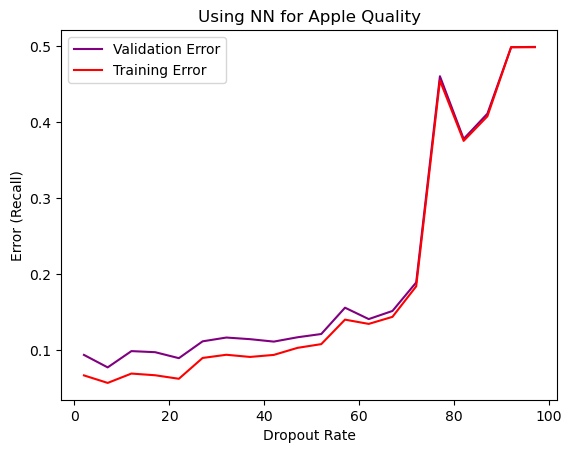

In [175]:
# [APPLE QUALITY] Varying the dropout rate to see if we prevent overfitting earlier and have a better model

acc_w_train = []
acc_w_test = []
list_x = []
layer_u = [2]
for x in range(10, 30, 5):
    model = create_ann(x_train_a,y_train_a, dataset = 'apple', layer_units = [16,8,4,2], dropout = x/100)
    test,train = strat_kfold_ann(clf = model, num_folds = 5, x_train = x_train_a, y_train = y_train_a, dataset = "apple", epochs = 50)
    acc_w_train.append(1-train)
    acc_w_test.append(1-test)
    list_x.append(x+1)
    print(1-train)
    print(1-test)
    print(x/100)
    

plt.clf()
plt.title('Using NN for Apple Quality')
plt.xlabel("Dropout Rate")
plt.ylabel("Error (Recall)")
plt.locator_params(axis='x')
plt.locator_params(axis='y')
plt.plot(list_x, acc_w_test, color='purple', label='Validation Error')
plt.plot(list_x, acc_w_train, color='red', label='Training Error')
plt.legend(loc="upper left")
# plt.savefig('Wine Quality_Decision Tree Error.png',
#             bbox_inches='tight')
plt.show()

# 3.2 Using GridSearchCV to identify the best results for comparison between the 2 dataset

In [11]:
param_grid = {
    'node_depth': [[16,16,16],[32,32,32],[64,64,64]],
    'epochs': [50, 100, 150],
    'optimizer': [tf.keras.optimizers.legacy.Adam(learning_rate=0.01), tf.keras.optimizers.legacy.SGD(learning_rate=0.01)],
    'activation': ['relu', 'sigmoid']
}
test_results = 0
for n in range(len(param_grid['node_depth'])):
    for e in range(len(param_grid['epochs'])):
        for o in range(len(param_grid['optimizer'])):
            for a in range(len(param_grid['activation'])):
#                 tf.keras.backend.clear_session()

                model = create_ann(x_train_w,y_train_w, dataset = 'wine', layer_units = param_grid['node_depth'][n], optimizer = param_grid['optimizer'][o], activation = param_grid['activation'][a])
                test,train = strat_kfold_ann(clf = model, num_folds = 5, x_train = x_train_w, y_train = y_train_w, dataset = "wine", epochs = param_grid['epochs'][e])
                if test > test_results:
                    test_results = test
                    nd = param_grid['node_depth'][n]
                    ep = param_grid['epochs'][e]
                    op = param_grid['optimizer'][o]
                    a = param_grid['activation'][a]
print(f'best validation results = {test_results}, best node_depth =, {nd}, best ep = {ep}, best op = {op}, best activation = {a}')

Epoch 1/50
86/86 [==============================] - 0s 1ms/step - loss: 1.3510 - accuracy: 0.4358
Epoch 2/50
86/86 [==============================] - 0s 1ms/step - loss: 1.1692 - accuracy: 0.5004
Epoch 3/50
86/86 [==============================] - 0s 1ms/step - loss: 1.1254 - accuracy: 0.5306
Epoch 4/50
86/86 [==============================] - 0s 1ms/step - loss: 1.1092 - accuracy: 0.5357
Epoch 5/50
86/86 [==============================] - 0s 1ms/step - loss: 1.0935 - accuracy: 0.5321
Epoch 6/50
86/86 [==============================] - 0s 1ms/step - loss: 1.0883 - accuracy: 0.5306
Epoch 7/50
86/86 [==============================] - 0s 1ms/step - loss: 1.0795 - accuracy: 0.5379
Epoch 8/50
86/86 [==============================] - 0s 1ms/step - loss: 1.0712 - accuracy: 0.5427
Epoch 9/50
86/86 [==============================] - 0s 1ms/step - loss: 1.0726 - accuracy: 0.5350
Epoch 10/50
86/86 [==============================] - 0s 1ms/step - loss: 1.0623 - accuracy: 0.5401
Epoch 11/50
86/86 [

86/86 [==============================] - 0s 1ms/step - loss: 0.9897 - accuracy: 0.5749
Epoch 13/50
86/86 [==============================] - 0s 1ms/step - loss: 0.9839 - accuracy: 0.5808
Epoch 14/50
86/86 [==============================] - 0s 1ms/step - loss: 0.9827 - accuracy: 0.5866
Epoch 15/50
86/86 [==============================] - 0s 1ms/step - loss: 0.9725 - accuracy: 0.5921
Epoch 16/50
86/86 [==============================] - 0s 1ms/step - loss: 0.9872 - accuracy: 0.5844
Epoch 17/50
86/86 [==============================] - 0s 1ms/step - loss: 0.9747 - accuracy: 0.5880
Epoch 18/50
86/86 [==============================] - 0s 1ms/step - loss: 0.9768 - accuracy: 0.5873
Epoch 19/50
86/86 [==============================] - 0s 1ms/step - loss: 0.9955 - accuracy: 0.5749
Epoch 20/50
86/86 [==============================] - 0s 1ms/step - loss: 0.9813 - accuracy: 0.5815
Epoch 21/50
86/86 [==============================] - 0s 1ms/step - loss: 0.9751 - accuracy: 0.5993
Epoch 22/50
86/86 [===

86/86 [==============================] - 0s 1ms/step - loss: 0.9751 - accuracy: 0.5846
Epoch 24/50
86/86 [==============================] - 0s 1ms/step - loss: 0.9556 - accuracy: 0.5901
Epoch 25/50
86/86 [==============================] - 0s 1ms/step - loss: 0.9710 - accuracy: 0.5923
Epoch 26/50
86/86 [==============================] - 0s 1ms/step - loss: 0.9733 - accuracy: 0.5864
Epoch 27/50
86/86 [==============================] - 0s 1ms/step - loss: 0.9575 - accuracy: 0.5915
Epoch 28/50
86/86 [==============================] - 0s 1ms/step - loss: 0.9668 - accuracy: 0.5872
Epoch 29/50
86/86 [==============================] - 0s 1ms/step - loss: 0.9661 - accuracy: 0.5923
Epoch 30/50
86/86 [==============================] - 0s 1ms/step - loss: 0.9639 - accuracy: 0.5985
Epoch 31/50
86/86 [==============================] - 0s 1ms/step - loss: 0.9568 - accuracy: 0.5959
Epoch 32/50
86/86 [==============================] - 0s 1ms/step - loss: 0.9590 - accuracy: 0.5966
Epoch 33/50
86/86 [===

86/86 [==============================] - 0s 1ms/step - loss: 0.9262 - accuracy: 0.5990
Epoch 35/50
86/86 [==============================] - 0s 1ms/step - loss: 0.9255 - accuracy: 0.6052
Epoch 36/50
86/86 [==============================] - 0s 1ms/step - loss: 0.9227 - accuracy: 0.6044
Epoch 37/50
86/86 [==============================] - 0s 1ms/step - loss: 0.9296 - accuracy: 0.6088
Epoch 38/50
86/86 [==============================] - 0s 1ms/step - loss: 0.9244 - accuracy: 0.6106
Epoch 39/50
86/86 [==============================] - 0s 1ms/step - loss: 0.9263 - accuracy: 0.6063
Epoch 40/50
86/86 [==============================] - 0s 1ms/step - loss: 0.9215 - accuracy: 0.5975
Epoch 41/50
86/86 [==============================] - 0s 1ms/step - loss: 0.9348 - accuracy: 0.6048
Epoch 42/50
86/86 [==============================] - 0s 1ms/step - loss: 0.9191 - accuracy: 0.6059
Epoch 43/50
86/86 [==============================] - 0s 1ms/step - loss: 0.9333 - accuracy: 0.6019
Epoch 44/50
86/86 [===

86/86 [==============================] - 0s 1ms/step - loss: 1.0596 - accuracy: 0.5434
Epoch 46/50
86/86 [==============================] - 0s 1ms/step - loss: 1.0527 - accuracy: 0.5445
Epoch 47/50
86/86 [==============================] - 0s 1ms/step - loss: 1.0486 - accuracy: 0.5543
Epoch 48/50
86/86 [==============================] - 0s 1ms/step - loss: 1.0531 - accuracy: 0.5558
Epoch 49/50
86/86 [==============================] - 0s 1ms/step - loss: 1.0567 - accuracy: 0.5376
Epoch 50/50
22/22 [==============================] - 0s 857us/step
Epoch 1/50
86/86 [==============================] - 0s 1ms/step - loss: 1.0675 - accuracy: 0.5341
Epoch 2/50
86/86 [==============================] - 0s 1ms/step - loss: 1.0564 - accuracy: 0.5520
Epoch 3/50
86/86 [==============================] - 0s 1ms/step - loss: 1.0640 - accuracy: 0.5450
Epoch 4/50
86/86 [==============================] - 0s 1ms/step - loss: 1.0565 - accuracy: 0.5512
Epoch 5/50
86/86 [==============================] - 0s 994

86/86 [==============================] - 0s 1ms/step - loss: 1.3007 - accuracy: 0.4457
Epoch 6/50
86/86 [==============================] - 0s 1ms/step - loss: 1.3096 - accuracy: 0.4468
Epoch 7/50
86/86 [==============================] - 0s 1ms/step - loss: 1.3071 - accuracy: 0.4438
Epoch 8/50
86/86 [==============================] - 0s 985us/step - loss: 1.3075 - accuracy: 0.4460
Epoch 9/50
86/86 [==============================] - 0s 1ms/step - loss: 1.3054 - accuracy: 0.4457
Epoch 10/50
86/86 [==============================] - 0s 1ms/step - loss: 1.3032 - accuracy: 0.4460
Epoch 11/50
86/86 [==============================] - 0s 1ms/step - loss: 1.3057 - accuracy: 0.4468
Epoch 12/50
86/86 [==============================] - 0s 1ms/step - loss: 1.3064 - accuracy: 0.4460
Epoch 13/50
86/86 [==============================] - 0s 1ms/step - loss: 1.3074 - accuracy: 0.4449
Epoch 14/50
86/86 [==============================] - 0s 1ms/step - loss: 1.3066 - accuracy: 0.4460
Epoch 15/50
86/86 [=====

86/86 [==============================] - 0s 1ms/step - loss: 1.2949 - accuracy: 0.4462
Epoch 17/50
86/86 [==============================] - 0s 1ms/step - loss: 1.2944 - accuracy: 0.4462
Epoch 18/50
86/86 [==============================] - 0s 1ms/step - loss: 1.2981 - accuracy: 0.4462
Epoch 19/50
86/86 [==============================] - 0s 1ms/step - loss: 1.2963 - accuracy: 0.4462
Epoch 20/50
86/86 [==============================] - 0s 1ms/step - loss: 1.3022 - accuracy: 0.4462
Epoch 21/50
86/86 [==============================] - 0s 1ms/step - loss: 1.2981 - accuracy: 0.4462
Epoch 22/50
86/86 [==============================] - 0s 1ms/step - loss: 1.2975 - accuracy: 0.4462
Epoch 23/50
86/86 [==============================] - 0s 1ms/step - loss: 1.2943 - accuracy: 0.4462
Epoch 24/50
86/86 [==============================] - 0s 1ms/step - loss: 1.2980 - accuracy: 0.4462
Epoch 25/50
86/86 [==============================] - 0s 1ms/step - loss: 1.2992 - accuracy: 0.4462
Epoch 26/50
86/86 [===

86/86 [==============================] - 0s 1ms/step - loss: 1.0353 - accuracy: 0.5554
Epoch 29/100
86/86 [==============================] - 0s 1ms/step - loss: 1.0288 - accuracy: 0.5602
Epoch 30/100
86/86 [==============================] - 0s 1ms/step - loss: 1.0243 - accuracy: 0.5496
Epoch 31/100
86/86 [==============================] - 0s 1ms/step - loss: 1.0184 - accuracy: 0.5675
Epoch 32/100
86/86 [==============================] - 0s 1ms/step - loss: 1.0128 - accuracy: 0.5664
Epoch 33/100
86/86 [==============================] - 0s 1ms/step - loss: 1.0370 - accuracy: 0.5470
Epoch 34/100
86/86 [==============================] - 0s 1ms/step - loss: 1.0314 - accuracy: 0.5503
Epoch 35/100
86/86 [==============================] - 0s 1ms/step - loss: 1.0229 - accuracy: 0.5540
Epoch 36/100
86/86 [==============================] - 0s 1ms/step - loss: 1.0308 - accuracy: 0.5532
Epoch 37/100
86/86 [==============================] - 0s 1ms/step - loss: 1.0208 - accuracy: 0.5605
Epoch 38/100


86/86 [==============================] - 0s 1ms/step - loss: 1.0286 - accuracy: 0.5678
Epoch 10/100
86/86 [==============================] - 0s 1ms/step - loss: 1.0116 - accuracy: 0.5704
Epoch 11/100
86/86 [==============================] - 0s 1ms/step - loss: 1.0332 - accuracy: 0.5770
Epoch 12/100
86/86 [==============================] - 0s 1ms/step - loss: 1.0193 - accuracy: 0.5715
Epoch 13/100
86/86 [==============================] - 0s 1ms/step - loss: 1.0224 - accuracy: 0.5755
Epoch 14/100
86/86 [==============================] - 0s 1ms/step - loss: 1.0382 - accuracy: 0.5664
Epoch 15/100
86/86 [==============================] - 0s 1ms/step - loss: 1.0140 - accuracy: 0.5799
Epoch 16/100
86/86 [==============================] - 0s 1ms/step - loss: 1.0267 - accuracy: 0.5711
Epoch 17/100
86/86 [==============================] - 0s 1ms/step - loss: 1.0028 - accuracy: 0.5832
Epoch 18/100
86/86 [==============================] - 0s 1ms/step - loss: 1.0355 - accuracy: 0.5620
Epoch 19/100


86/86 [==============================] - 0s 1ms/step - loss: 1.0271 - accuracy: 0.5671
Epoch 92/100
86/86 [==============================] - 0s 1ms/step - loss: 1.0247 - accuracy: 0.5565
Epoch 93/100
86/86 [==============================] - 0s 1ms/step - loss: 1.0134 - accuracy: 0.5616
Epoch 94/100
86/86 [==============================] - 0s 1ms/step - loss: 1.0145 - accuracy: 0.5770
Epoch 95/100
86/86 [==============================] - 0s 1ms/step - loss: 1.0109 - accuracy: 0.5678
Epoch 96/100
86/86 [==============================] - 0s 1ms/step - loss: 1.0186 - accuracy: 0.5678
Epoch 97/100
86/86 [==============================] - 0s 1ms/step - loss: 1.0244 - accuracy: 0.5580
Epoch 98/100
86/86 [==============================] - 0s 1ms/step - loss: 1.0093 - accuracy: 0.5711
Epoch 99/100
86/86 [==============================] - 0s 1ms/step - loss: 1.0108 - accuracy: 0.5766
Epoch 100/100
22/22 [==============================] - 0s 908us/step
Epoch 1/100
86/86 [=========================

86/86 [==============================] - 0s 1ms/step - loss: 1.0161 - accuracy: 0.5749
Epoch 73/100
86/86 [==============================] - 0s 1ms/step - loss: 1.0005 - accuracy: 0.5811
Epoch 74/100
86/86 [==============================] - 0s 1ms/step - loss: 1.0334 - accuracy: 0.5760
Epoch 75/100
86/86 [==============================] - 0s 1ms/step - loss: 1.0219 - accuracy: 0.5800
Epoch 76/100
86/86 [==============================] - 0s 1ms/step - loss: 1.0090 - accuracy: 0.5680
Epoch 77/100
86/86 [==============================] - 0s 1ms/step - loss: 1.0217 - accuracy: 0.5724
Epoch 78/100
86/86 [==============================] - 0s 1ms/step - loss: 1.0321 - accuracy: 0.5694
Epoch 79/100
86/86 [==============================] - 0s 1ms/step - loss: 1.0062 - accuracy: 0.5800
Epoch 80/100
86/86 [==============================] - 0s 1ms/step - loss: 1.0015 - accuracy: 0.5786
Epoch 81/100
86/86 [==============================] - 0s 1ms/step - loss: 1.0136 - accuracy: 0.5818
Epoch 82/100


86/86 [==============================] - 0s 1ms/step - loss: 1.0444 - accuracy: 0.5673
Epoch 54/100
86/86 [==============================] - 0s 1ms/step - loss: 1.0300 - accuracy: 0.5760
Epoch 55/100
86/86 [==============================] - 0s 1ms/step - loss: 1.0231 - accuracy: 0.5724
Epoch 56/100
86/86 [==============================] - 0s 1ms/step - loss: 1.0152 - accuracy: 0.5654
Epoch 57/100
86/86 [==============================] - 0s 1ms/step - loss: 1.0059 - accuracy: 0.5818
Epoch 58/100
86/86 [==============================] - 0s 1ms/step - loss: 1.0069 - accuracy: 0.5760
Epoch 59/100
86/86 [==============================] - 0s 1ms/step - loss: 1.0203 - accuracy: 0.5716
Epoch 60/100
86/86 [==============================] - 0s 1ms/step - loss: 1.0121 - accuracy: 0.5749
Epoch 61/100
86/86 [==============================] - 0s 1ms/step - loss: 1.0222 - accuracy: 0.5756
Epoch 62/100
86/86 [==============================] - 0s 1ms/step - loss: 1.0122 - accuracy: 0.5793
Epoch 63/100


86/86 [==============================] - 0s 1ms/step - loss: 1.0078 - accuracy: 0.5839
Epoch 35/100
86/86 [==============================] - 0s 1ms/step - loss: 1.0060 - accuracy: 0.5861
Epoch 36/100
86/86 [==============================] - 0s 1ms/step - loss: 1.0105 - accuracy: 0.5802
Epoch 37/100
86/86 [==============================] - 0s 1ms/step - loss: 1.0059 - accuracy: 0.5857
Epoch 38/100
86/86 [==============================] - 0s 1ms/step - loss: 1.0031 - accuracy: 0.5842
Epoch 39/100
86/86 [==============================] - 0s 1ms/step - loss: 1.0069 - accuracy: 0.5795
Epoch 40/100
86/86 [==============================] - 0s 1ms/step - loss: 1.0070 - accuracy: 0.5810
Epoch 41/100
86/86 [==============================] - 0s 1ms/step - loss: 0.9987 - accuracy: 0.5864
Epoch 42/100
86/86 [==============================] - 0s 1ms/step - loss: 1.0118 - accuracy: 0.5744
Epoch 43/100
86/86 [==============================] - 0s 1ms/step - loss: 1.0003 - accuracy: 0.5883
Epoch 44/100


86/86 [==============================] - 0s 1ms/step - loss: 0.9594 - accuracy: 0.5912
Epoch 16/100
86/86 [==============================] - 0s 1ms/step - loss: 0.9604 - accuracy: 0.5904
Epoch 17/100
86/86 [==============================] - 0s 1ms/step - loss: 0.9679 - accuracy: 0.5886
Epoch 18/100
86/86 [==============================] - 0s 1ms/step - loss: 0.9704 - accuracy: 0.5835
Epoch 19/100
86/86 [==============================] - 0s 1ms/step - loss: 0.9577 - accuracy: 0.5930
Epoch 20/100
86/86 [==============================] - 0s 1ms/step - loss: 0.9536 - accuracy: 0.5985
Epoch 21/100
86/86 [==============================] - 0s 1ms/step - loss: 0.9635 - accuracy: 0.5875
Epoch 22/100
86/86 [==============================] - 0s 1ms/step - loss: 0.9557 - accuracy: 0.5897
Epoch 23/100
86/86 [==============================] - 0s 1ms/step - loss: 0.9629 - accuracy: 0.6003
Epoch 24/100
86/86 [==============================] - 0s 1ms/step - loss: 0.9595 - accuracy: 0.5952
Epoch 25/100


86/86 [==============================] - 0s 1ms/step - loss: 0.9234 - accuracy: 0.6171
Epoch 98/100
86/86 [==============================] - 0s 1ms/step - loss: 0.9307 - accuracy: 0.6080
Epoch 99/100
86/86 [==============================] - 0s 1ms/step - loss: 0.9267 - accuracy: 0.6054
Epoch 100/100
22/22 [==============================] - 0s 861us/step
Epoch 1/100
86/86 [==============================] - 0s 1ms/step - loss: 0.9715 - accuracy: 0.5948
Epoch 2/100
86/86 [==============================] - 0s 1ms/step - loss: 0.9638 - accuracy: 0.5894
Epoch 3/100
86/86 [==============================] - 0s 1ms/step - loss: 0.9562 - accuracy: 0.5872
Epoch 4/100
86/86 [==============================] - 0s 1ms/step - loss: 0.9588 - accuracy: 0.5872
Epoch 5/100
86/86 [==============================] - 0s 1ms/step - loss: 0.9575 - accuracy: 0.5901
Epoch 6/100
86/86 [==============================] - 0s 1ms/step - loss: 0.9515 - accuracy: 0.5974
Epoch 7/100
86/86 [==============================]

86/86 [==============================] - 0s 1ms/step - loss: 0.9269 - accuracy: 0.6134
Epoch 79/100
86/86 [==============================] - 0s 1ms/step - loss: 0.9105 - accuracy: 0.6138
Epoch 80/100
86/86 [==============================] - 0s 1ms/step - loss: 0.9114 - accuracy: 0.6218
Epoch 81/100
86/86 [==============================] - 0s 1ms/step - loss: 0.9149 - accuracy: 0.6120
Epoch 82/100
86/86 [==============================] - 0s 1ms/step - loss: 0.9041 - accuracy: 0.6284
Epoch 83/100
86/86 [==============================] - 0s 1ms/step - loss: 0.9254 - accuracy: 0.6134
Epoch 84/100
86/86 [==============================] - 0s 1ms/step - loss: 0.9254 - accuracy: 0.6090
Epoch 85/100
86/86 [==============================] - 0s 1ms/step - loss: 0.9086 - accuracy: 0.6160
Epoch 86/100
86/86 [==============================] - 0s 1ms/step - loss: 0.9068 - accuracy: 0.6163
Epoch 87/100
86/86 [==============================] - 0s 1ms/step - loss: 0.9249 - accuracy: 0.6171
Epoch 88/100


86/86 [==============================] - 0s 1ms/step - loss: 0.9334 - accuracy: 0.5997
Epoch 60/100
86/86 [==============================] - 0s 1ms/step - loss: 0.9258 - accuracy: 0.6026
Epoch 61/100
86/86 [==============================] - 0s 1ms/step - loss: 0.9258 - accuracy: 0.6085
Epoch 62/100
86/86 [==============================] - 0s 1ms/step - loss: 0.9239 - accuracy: 0.6099
Epoch 63/100
86/86 [==============================] - 0s 1ms/step - loss: 0.9250 - accuracy: 0.5983
Epoch 64/100
86/86 [==============================] - 0s 1ms/step - loss: 0.9361 - accuracy: 0.6085
Epoch 65/100
86/86 [==============================] - 0s 1ms/step - loss: 0.9164 - accuracy: 0.6103
Epoch 66/100
86/86 [==============================] - 0s 1ms/step - loss: 0.9288 - accuracy: 0.6114
Epoch 67/100
86/86 [==============================] - 0s 1ms/step - loss: 0.9148 - accuracy: 0.6128
Epoch 68/100
86/86 [==============================] - 0s 1ms/step - loss: 0.9246 - accuracy: 0.6081
Epoch 69/100


86/86 [==============================] - 0s 1ms/step - loss: 0.9148 - accuracy: 0.6121
Epoch 41/100
86/86 [==============================] - 0s 1ms/step - loss: 0.9315 - accuracy: 0.6198
Epoch 42/100
86/86 [==============================] - 0s 1ms/step - loss: 0.9193 - accuracy: 0.6114
Epoch 43/100
86/86 [==============================] - 0s 1ms/step - loss: 0.9134 - accuracy: 0.6121
Epoch 44/100
86/86 [==============================] - 0s 1ms/step - loss: 0.9263 - accuracy: 0.6085
Epoch 45/100
86/86 [==============================] - 0s 1ms/step - loss: 0.9314 - accuracy: 0.6172
Epoch 46/100
86/86 [==============================] - 0s 1ms/step - loss: 0.9285 - accuracy: 0.6092
Epoch 47/100
86/86 [==============================] - 0s 1ms/step - loss: 0.9205 - accuracy: 0.6008
Epoch 48/100
86/86 [==============================] - 0s 1ms/step - loss: 0.9172 - accuracy: 0.6106
Epoch 49/100
86/86 [==============================] - 0s 1ms/step - loss: 0.9148 - accuracy: 0.6136
Epoch 50/100


86/86 [==============================] - 0s 1ms/step - loss: 1.1833 - accuracy: 0.5033
Epoch 22/100
86/86 [==============================] - 0s 1ms/step - loss: 1.1787 - accuracy: 0.5036
Epoch 23/100
86/86 [==============================] - 0s 1ms/step - loss: 1.1818 - accuracy: 0.5040
Epoch 24/100
86/86 [==============================] - 0s 1ms/step - loss: 1.1709 - accuracy: 0.5044
Epoch 25/100
86/86 [==============================] - 0s 1ms/step - loss: 1.1585 - accuracy: 0.5160
Epoch 26/100
86/86 [==============================] - 0s 1ms/step - loss: 1.1643 - accuracy: 0.5080
Epoch 27/100
86/86 [==============================] - 0s 1ms/step - loss: 1.1538 - accuracy: 0.5233
Epoch 28/100
86/86 [==============================] - 0s 1ms/step - loss: 1.1513 - accuracy: 0.5131
Epoch 29/100
86/86 [==============================] - 0s 1ms/step - loss: 1.1506 - accuracy: 0.5204
Epoch 30/100
86/86 [==============================] - 0s 1ms/step - loss: 1.1360 - accuracy: 0.5160
Epoch 31/100


86/86 [==============================] - 0s 1ms/step - loss: 1.0375 - accuracy: 0.5598
Epoch 84/100
86/86 [==============================] - 0s 1ms/step - loss: 1.0377 - accuracy: 0.5551
Epoch 85/100
86/86 [==============================] - 0s 1ms/step - loss: 1.0318 - accuracy: 0.5565
Epoch 86/100
86/86 [==============================] - 0s 1ms/step - loss: 1.0269 - accuracy: 0.5503
Epoch 87/100
86/86 [==============================] - 0s 1ms/step - loss: 1.0311 - accuracy: 0.5558
Epoch 88/100
86/86 [==============================] - 0s 1ms/step - loss: 1.0372 - accuracy: 0.5522
Epoch 89/100
86/86 [==============================] - 0s 1ms/step - loss: 1.0250 - accuracy: 0.5536
Epoch 90/100
86/86 [==============================] - 0s 1ms/step - loss: 1.0364 - accuracy: 0.5507
Epoch 91/100
86/86 [==============================] - 0s 1ms/step - loss: 1.0225 - accuracy: 0.5638
Epoch 92/100
86/86 [==============================] - 0s 1ms/step - loss: 1.0360 - accuracy: 0.5536
Epoch 93/100


Epoch 64/100
86/86 [==============================] - 0s 1ms/step - loss: 1.0133 - accuracy: 0.5562
Epoch 65/100
86/86 [==============================] - 0s 1ms/step - loss: 1.0157 - accuracy: 0.5562
Epoch 66/100
86/86 [==============================] - 0s 1ms/step - loss: 1.0159 - accuracy: 0.5675
Epoch 67/100
86/86 [==============================] - 0s 1ms/step - loss: 1.0107 - accuracy: 0.5646
Epoch 68/100
86/86 [==============================] - 0s 1ms/step - loss: 1.0079 - accuracy: 0.5543
Epoch 69/100
86/86 [==============================] - 0s 1ms/step - loss: 1.0123 - accuracy: 0.5605
Epoch 70/100
86/86 [==============================] - 0s 1ms/step - loss: 1.0224 - accuracy: 0.5569
Epoch 71/100
86/86 [==============================] - 0s 1ms/step - loss: 1.0046 - accuracy: 0.5613
Epoch 72/100
86/86 [==============================] - 0s 1ms/step - loss: 1.0096 - accuracy: 0.5551
Epoch 73/100
86/86 [==============================] - 0s 1ms/step - loss: 1.0115 - accuracy: 0.5602


86/86 [==============================] - 0s 1ms/step - loss: 1.0016 - accuracy: 0.5738
Epoch 26/100
86/86 [==============================] - 0s 1ms/step - loss: 1.0089 - accuracy: 0.5684
Epoch 27/100
86/86 [==============================] - 0s 1ms/step - loss: 1.0045 - accuracy: 0.5760
Epoch 28/100
86/86 [==============================] - 0s 1ms/step - loss: 1.0089 - accuracy: 0.5775
Epoch 29/100
86/86 [==============================] - 0s 1ms/step - loss: 1.0113 - accuracy: 0.5738
Epoch 30/100
86/86 [==============================] - 0s 1ms/step - loss: 1.0077 - accuracy: 0.5709
Epoch 31/100
86/86 [==============================] - 0s 1ms/step - loss: 1.0015 - accuracy: 0.5622
Epoch 32/100
86/86 [==============================] - 0s 1ms/step - loss: 1.0073 - accuracy: 0.5753
Epoch 33/100
86/86 [==============================] - 0s 1ms/step - loss: 1.0066 - accuracy: 0.5767
Epoch 34/100
86/86 [==============================] - 0s 1ms/step - loss: 1.0080 - accuracy: 0.5662
Epoch 35/100


Epoch 6/100
86/86 [==============================] - 0s 1ms/step - loss: 1.3607 - accuracy: 0.4285
Epoch 7/100
86/86 [==============================] - 0s 1ms/step - loss: 1.3509 - accuracy: 0.4234
Epoch 8/100
86/86 [==============================] - 0s 997us/step - loss: 1.3469 - accuracy: 0.4267
Epoch 9/100
86/86 [==============================] - 0s 1ms/step - loss: 1.3381 - accuracy: 0.4311
Epoch 10/100
86/86 [==============================] - 0s 1ms/step - loss: 1.3420 - accuracy: 0.4303
Epoch 11/100
86/86 [==============================] - 0s 1ms/step - loss: 1.3366 - accuracy: 0.4256
Epoch 12/100
86/86 [==============================] - 0s 1ms/step - loss: 1.3368 - accuracy: 0.4289
Epoch 13/100
86/86 [==============================] - 0s 1ms/step - loss: 1.3318 - accuracy: 0.4380
Epoch 14/100
86/86 [==============================] - 0s 1ms/step - loss: 1.3367 - accuracy: 0.4329
Epoch 15/100
86/86 [==============================] - 0s 1ms/step - loss: 1.3221 - accuracy: 0.4365
Ep

86/86 [==============================] - 0s 1ms/step - loss: 1.2971 - accuracy: 0.4464
Epoch 69/100
86/86 [==============================] - 0s 1ms/step - loss: 1.3021 - accuracy: 0.4464
Epoch 70/100
86/86 [==============================] - 0s 1ms/step - loss: 1.3009 - accuracy: 0.4464
Epoch 71/100
86/86 [==============================] - 0s 1ms/step - loss: 1.3021 - accuracy: 0.4464
Epoch 72/100
86/86 [==============================] - 0s 1ms/step - loss: 1.3010 - accuracy: 0.4464
Epoch 73/100
86/86 [==============================] - 0s 1ms/step - loss: 1.2999 - accuracy: 0.4464
Epoch 74/100
86/86 [==============================] - 0s 1ms/step - loss: 1.2975 - accuracy: 0.4464
Epoch 75/100
86/86 [==============================] - 0s 1ms/step - loss: 1.3000 - accuracy: 0.4464
Epoch 76/100
86/86 [==============================] - 0s 1ms/step - loss: 1.3046 - accuracy: 0.4464
Epoch 77/100
86/86 [==============================] - 0s 1ms/step - loss: 1.3004 - accuracy: 0.4464
Epoch 78/100


86/86 [==============================] - 0s 1ms/step - loss: 1.2993 - accuracy: 0.4462
Epoch 30/100
86/86 [==============================] - 0s 1ms/step - loss: 1.2965 - accuracy: 0.4462
Epoch 31/100
86/86 [==============================] - 0s 1ms/step - loss: 1.2958 - accuracy: 0.4462
Epoch 32/100
86/86 [==============================] - 0s 1ms/step - loss: 1.2998 - accuracy: 0.4462
Epoch 33/100
86/86 [==============================] - 0s 1ms/step - loss: 1.2989 - accuracy: 0.4462
Epoch 34/100
86/86 [==============================] - 0s 1ms/step - loss: 1.2986 - accuracy: 0.4462
Epoch 35/100
86/86 [==============================] - 0s 1ms/step - loss: 1.3006 - accuracy: 0.4462
Epoch 36/100
86/86 [==============================] - 0s 1ms/step - loss: 1.2966 - accuracy: 0.4462
Epoch 37/100
86/86 [==============================] - 0s 1ms/step - loss: 1.2930 - accuracy: 0.4462
Epoch 38/100
86/86 [==============================] - 0s 1ms/step - loss: 1.2955 - accuracy: 0.4462
Epoch 39/100


Epoch 10/100
86/86 [==============================] - 0s 1ms/step - loss: 1.2928 - accuracy: 0.4455
Epoch 11/100
86/86 [==============================] - 0s 1ms/step - loss: 1.2933 - accuracy: 0.4462
Epoch 12/100
86/86 [==============================] - 0s 1ms/step - loss: 1.2922 - accuracy: 0.4459
Epoch 13/100
86/86 [==============================] - 0s 1ms/step - loss: 1.2919 - accuracy: 0.4466
Epoch 14/100
86/86 [==============================] - 0s 1ms/step - loss: 1.2917 - accuracy: 0.4473
Epoch 15/100
86/86 [==============================] - 0s 1ms/step - loss: 1.2893 - accuracy: 0.4491
Epoch 16/100
86/86 [==============================] - 0s 1ms/step - loss: 1.2869 - accuracy: 0.4473
Epoch 17/100
86/86 [==============================] - 0s 1ms/step - loss: 1.2876 - accuracy: 0.4466
Epoch 18/100
86/86 [==============================] - 0s 1ms/step - loss: 1.2890 - accuracy: 0.4440
Epoch 19/100
86/86 [==============================] - 0s 1ms/step - loss: 1.2915 - accuracy: 0.4462


86/86 [==============================] - 0s 1ms/step - loss: 1.0104 - accuracy: 0.5605
Epoch 73/150
86/86 [==============================] - 0s 1ms/step - loss: 1.0085 - accuracy: 0.5434
Epoch 74/150
86/86 [==============================] - 0s 1ms/step - loss: 0.9895 - accuracy: 0.5635
Epoch 75/150
86/86 [==============================] - 0s 1ms/step - loss: 1.0136 - accuracy: 0.5514
Epoch 76/150
86/86 [==============================] - 0s 1ms/step - loss: 1.0247 - accuracy: 0.5525
Epoch 77/150
86/86 [==============================] - 0s 1ms/step - loss: 1.0080 - accuracy: 0.5715
Epoch 78/150
86/86 [==============================] - 0s 1ms/step - loss: 1.0076 - accuracy: 0.5547
Epoch 79/150
86/86 [==============================] - 0s 1ms/step - loss: 1.0011 - accuracy: 0.5591
Epoch 80/150
86/86 [==============================] - 0s 1ms/step - loss: 1.0094 - accuracy: 0.5529
Epoch 81/150
86/86 [==============================] - 0s 1ms/step - loss: 1.0021 - accuracy: 0.5624
Epoch 82/150


86/86 [==============================] - 0s 1ms/step - loss: 1.0157 - accuracy: 0.5551
Epoch 85/150
86/86 [==============================] - 0s 1ms/step - loss: 1.0071 - accuracy: 0.5576
Epoch 86/150
86/86 [==============================] - 0s 1ms/step - loss: 0.9983 - accuracy: 0.5591
Epoch 87/150
86/86 [==============================] - 0s 1ms/step - loss: 1.0011 - accuracy: 0.5584
Epoch 88/150
86/86 [==============================] - 0s 1ms/step - loss: 0.9925 - accuracy: 0.5635
Epoch 89/150
86/86 [==============================] - 0s 1ms/step - loss: 0.9957 - accuracy: 0.5580
Epoch 90/150
86/86 [==============================] - 0s 1ms/step - loss: 1.0089 - accuracy: 0.5547
Epoch 91/150
86/86 [==============================] - 0s 1ms/step - loss: 0.9985 - accuracy: 0.5649
Epoch 92/150
86/86 [==============================] - 0s 1ms/step - loss: 1.0008 - accuracy: 0.5664
Epoch 93/150
86/86 [==============================] - 0s 1ms/step - loss: 1.0006 - accuracy: 0.5587
Epoch 94/150


86/86 [==============================] - 0s 1ms/step - loss: 0.9874 - accuracy: 0.5642
Epoch 97/150
86/86 [==============================] - 0s 1ms/step - loss: 0.9752 - accuracy: 0.5689
Epoch 98/150
86/86 [==============================] - 0s 1ms/step - loss: 0.9964 - accuracy: 0.5795
Epoch 99/150
86/86 [==============================] - 0s 1ms/step - loss: 0.9864 - accuracy: 0.5671
Epoch 100/150
86/86 [==============================] - 0s 1ms/step - loss: 1.0072 - accuracy: 0.5598
Epoch 101/150
86/86 [==============================] - 0s 1ms/step - loss: 0.9960 - accuracy: 0.5616
Epoch 102/150
86/86 [==============================] - 0s 1ms/step - loss: 0.9876 - accuracy: 0.5598
Epoch 103/150
86/86 [==============================] - 0s 1ms/step - loss: 0.9944 - accuracy: 0.5649
Epoch 104/150
86/86 [==============================] - 0s 1ms/step - loss: 0.9924 - accuracy: 0.5660
Epoch 105/150
86/86 [==============================] - 0s 1ms/step - loss: 0.9953 - accuracy: 0.5569
Epoch 1

Epoch 108/150
86/86 [==============================] - 0s 1ms/step - loss: 0.9990 - accuracy: 0.5673
Epoch 109/150
86/86 [==============================] - 0s 1ms/step - loss: 1.0051 - accuracy: 0.5651
Epoch 110/150
86/86 [==============================] - 0s 1ms/step - loss: 0.9992 - accuracy: 0.5633
Epoch 111/150
86/86 [==============================] - 0s 1ms/step - loss: 0.9880 - accuracy: 0.5702
Epoch 112/150
86/86 [==============================] - 0s 1ms/step - loss: 0.9847 - accuracy: 0.5665
Epoch 113/150
86/86 [==============================] - 0s 1ms/step - loss: 0.9918 - accuracy: 0.5687
Epoch 114/150
86/86 [==============================] - 0s 1ms/step - loss: 0.9837 - accuracy: 0.5735
Epoch 115/150
86/86 [==============================] - 0s 1ms/step - loss: 0.9781 - accuracy: 0.5789
Epoch 116/150
86/86 [==============================] - 0s 1ms/step - loss: 0.9929 - accuracy: 0.5662
Epoch 117/150
86/86 [==============================] - 0s 1ms/step - loss: 0.9890 - accurac

86/86 [==============================] - 0s 1ms/step - loss: 0.9964 - accuracy: 0.5662
Epoch 120/150
86/86 [==============================] - 0s 1ms/step - loss: 0.9897 - accuracy: 0.5760
Epoch 121/150
86/86 [==============================] - 0s 1ms/step - loss: 0.9905 - accuracy: 0.5826
Epoch 122/150
86/86 [==============================] - 0s 1ms/step - loss: 0.9981 - accuracy: 0.5775
Epoch 123/150
86/86 [==============================] - 0s 1ms/step - loss: 0.9900 - accuracy: 0.5669
Epoch 124/150
86/86 [==============================] - 0s 1ms/step - loss: 0.9862 - accuracy: 0.5698
Epoch 125/150
86/86 [==============================] - 0s 1ms/step - loss: 0.9915 - accuracy: 0.5789
Epoch 126/150
86/86 [==============================] - 0s 1ms/step - loss: 0.9799 - accuracy: 0.5826
Epoch 127/150
86/86 [==============================] - 0s 1ms/step - loss: 0.9931 - accuracy: 0.5815
Epoch 128/150
86/86 [==============================] - 0s 1ms/step - loss: 0.9914 - accuracy: 0.5673
Epoc

86/86 [==============================] - 0s 1ms/step - loss: 0.9653 - accuracy: 0.5945
Epoch 131/150
86/86 [==============================] - 0s 1ms/step - loss: 0.9461 - accuracy: 0.5963
Epoch 132/150
86/86 [==============================] - 0s 1ms/step - loss: 0.9498 - accuracy: 0.6087
Epoch 133/150
86/86 [==============================] - 0s 1ms/step - loss: 0.9510 - accuracy: 0.5985
Epoch 134/150
86/86 [==============================] - 0s 1ms/step - loss: 0.9506 - accuracy: 0.6065
Epoch 135/150
86/86 [==============================] - 0s 1ms/step - loss: 0.9490 - accuracy: 0.6010
Epoch 136/150
86/86 [==============================] - 0s 1ms/step - loss: 0.9564 - accuracy: 0.5985
Epoch 137/150
86/86 [==============================] - 0s 1ms/step - loss: 0.9478 - accuracy: 0.5981
Epoch 138/150
86/86 [==============================] - 0s 1ms/step - loss: 0.9450 - accuracy: 0.6014
Epoch 139/150
86/86 [==============================] - 0s 1ms/step - loss: 0.9481 - accuracy: 0.5999
Epoc

86/86 [==============================] - 0s 1ms/step - loss: 0.9245 - accuracy: 0.6152
Epoch 142/150
86/86 [==============================] - 0s 1ms/step - loss: 0.9331 - accuracy: 0.6142
Epoch 143/150
86/86 [==============================] - 0s 1ms/step - loss: 0.8985 - accuracy: 0.6233
Epoch 144/150
86/86 [==============================] - 0s 1ms/step - loss: 0.9220 - accuracy: 0.6185
Epoch 145/150
86/86 [==============================] - 0s 1ms/step - loss: 0.9116 - accuracy: 0.6214
Epoch 146/150
86/86 [==============================] - 0s 1ms/step - loss: 0.9134 - accuracy: 0.6247
Epoch 147/150
86/86 [==============================] - 0s 1ms/step - loss: 0.9115 - accuracy: 0.6094
Epoch 148/150
86/86 [==============================] - 0s 1ms/step - loss: 0.9294 - accuracy: 0.6185
Epoch 149/150
86/86 [==============================] - 0s 1ms/step - loss: 0.9193 - accuracy: 0.6142
Epoch 150/150
22/22 [==============================] - 0s 904us/step
Epoch 1/150
86/86 [=================

Epoch 72/150
86/86 [==============================] - 0s 1ms/step - loss: 0.9196 - accuracy: 0.6112
Epoch 73/150
86/86 [==============================] - 0s 1ms/step - loss: 0.9228 - accuracy: 0.6160
Epoch 74/150
86/86 [==============================] - 0s 1ms/step - loss: 0.9204 - accuracy: 0.6134
Epoch 75/150
86/86 [==============================] - 0s 1ms/step - loss: 0.9210 - accuracy: 0.6171
Epoch 76/150
86/86 [==============================] - 0s 1ms/step - loss: 0.9130 - accuracy: 0.6171
Epoch 77/150
86/86 [==============================] - 0s 1ms/step - loss: 0.9212 - accuracy: 0.6182
Epoch 78/150
86/86 [==============================] - 0s 1ms/step - loss: 0.9294 - accuracy: 0.6258
Epoch 79/150
86/86 [==============================] - 0s 1ms/step - loss: 0.9082 - accuracy: 0.6200
Epoch 80/150
86/86 [==============================] - 0s 1ms/step - loss: 0.9265 - accuracy: 0.6193
Epoch 81/150
86/86 [==============================] - 0s 1ms/step - loss: 0.9219 - accuracy: 0.6251


86/86 [==============================] - 0s 1ms/step - loss: 0.9049 - accuracy: 0.6249
Epoch 85/150
86/86 [==============================] - 0s 1ms/step - loss: 0.9121 - accuracy: 0.6216
Epoch 86/150
86/86 [==============================] - 0s 1ms/step - loss: 0.9174 - accuracy: 0.6154
Epoch 87/150
86/86 [==============================] - 0s 1ms/step - loss: 0.9027 - accuracy: 0.6187
Epoch 88/150
86/86 [==============================] - 0s 1ms/step - loss: 0.9007 - accuracy: 0.6219
Epoch 89/150
86/86 [==============================] - 0s 1ms/step - loss: 0.9029 - accuracy: 0.6154
Epoch 90/150
86/86 [==============================] - 0s 1ms/step - loss: 0.9059 - accuracy: 0.6227
Epoch 91/150
86/86 [==============================] - 0s 1ms/step - loss: 0.9242 - accuracy: 0.6125
Epoch 92/150
86/86 [==============================] - 0s 1ms/step - loss: 0.9105 - accuracy: 0.6205
Epoch 93/150
86/86 [==============================] - 0s 1ms/step - loss: 0.8997 - accuracy: 0.6187
Epoch 94/150


86/86 [==============================] - 0s 1ms/step - loss: 0.9093 - accuracy: 0.6252
Epoch 97/150
86/86 [==============================] - 0s 1ms/step - loss: 0.8950 - accuracy: 0.6125
Epoch 98/150
86/86 [==============================] - 0s 1ms/step - loss: 0.9062 - accuracy: 0.6263
Epoch 99/150
86/86 [==============================] - 0s 1ms/step - loss: 0.9064 - accuracy: 0.6227
Epoch 100/150
86/86 [==============================] - 0s 1ms/step - loss: 0.9113 - accuracy: 0.6198
Epoch 101/150
86/86 [==============================] - 0s 1ms/step - loss: 0.8971 - accuracy: 0.6285
Epoch 102/150
86/86 [==============================] - 0s 1ms/step - loss: 0.9026 - accuracy: 0.6205
Epoch 103/150
86/86 [==============================] - 0s 1ms/step - loss: 0.9077 - accuracy: 0.6238
Epoch 104/150
86/86 [==============================] - 0s 1ms/step - loss: 0.8944 - accuracy: 0.6219
Epoch 105/150
86/86 [==============================] - 0s 1ms/step - loss: 0.9050 - accuracy: 0.6365
Epoch 1

Epoch 108/150
86/86 [==============================] - 0s 1ms/step - loss: 1.0682 - accuracy: 0.5463
Epoch 109/150
86/86 [==============================] - 0s 1ms/step - loss: 1.0720 - accuracy: 0.5372
Epoch 110/150
86/86 [==============================] - 0s 1ms/step - loss: 1.0698 - accuracy: 0.5376
Epoch 111/150
86/86 [==============================] - 0s 1ms/step - loss: 1.0635 - accuracy: 0.5492
Epoch 112/150
86/86 [==============================] - 0s 1ms/step - loss: 1.0718 - accuracy: 0.5390
Epoch 113/150
86/86 [==============================] - 0s 1ms/step - loss: 1.0712 - accuracy: 0.5445
Epoch 114/150
86/86 [==============================] - 0s 1ms/step - loss: 1.0809 - accuracy: 0.5376
Epoch 115/150
86/86 [==============================] - 0s 1ms/step - loss: 1.0741 - accuracy: 0.5390
Epoch 116/150
86/86 [==============================] - 0s 1ms/step - loss: 1.0786 - accuracy: 0.5368
Epoch 117/150
86/86 [==============================] - 0s 1ms/step - loss: 1.0604 - accurac

86/86 [==============================] - 0s 1ms/step - loss: 1.0175 - accuracy: 0.5624
Epoch 120/150
86/86 [==============================] - 0s 1ms/step - loss: 1.0170 - accuracy: 0.5649
Epoch 121/150
86/86 [==============================] - 0s 1ms/step - loss: 1.0150 - accuracy: 0.5646
Epoch 122/150
86/86 [==============================] - 0s 1ms/step - loss: 1.0229 - accuracy: 0.5649
Epoch 123/150
86/86 [==============================] - 0s 1ms/step - loss: 1.0213 - accuracy: 0.5627
Epoch 124/150
86/86 [==============================] - 0s 1ms/step - loss: 1.0141 - accuracy: 0.5729
Epoch 125/150
86/86 [==============================] - 0s 1ms/step - loss: 1.0180 - accuracy: 0.5551
Epoch 126/150
86/86 [==============================] - 0s 1ms/step - loss: 1.0098 - accuracy: 0.5609
Epoch 127/150
86/86 [==============================] - 0s 1ms/step - loss: 1.0167 - accuracy: 0.5631
Epoch 128/150
86/86 [==============================] - 0s 1ms/step - loss: 1.0268 - accuracy: 0.5576
Epoc

86/86 [==============================] - 0s 1ms/step - loss: 0.9946 - accuracy: 0.5635
Epoch 131/150
86/86 [==============================] - 0s 1ms/step - loss: 0.9926 - accuracy: 0.5587
Epoch 132/150
86/86 [==============================] - 0s 999us/step - loss: 0.9835 - accuracy: 0.5791
Epoch 133/150
86/86 [==============================] - 0s 1ms/step - loss: 0.9835 - accuracy: 0.5711
Epoch 134/150
86/86 [==============================] - 0s 1ms/step - loss: 0.9774 - accuracy: 0.5748
Epoch 135/150
86/86 [==============================] - 0s 986us/step - loss: 0.9898 - accuracy: 0.5675
Epoch 136/150
86/86 [==============================] - 0s 1ms/step - loss: 0.9880 - accuracy: 0.5708
Epoch 137/150
86/86 [==============================] - 0s 1ms/step - loss: 0.9812 - accuracy: 0.5762
Epoch 138/150
86/86 [==============================] - 0s 1ms/step - loss: 0.9928 - accuracy: 0.5656
Epoch 139/150
86/86 [==============================] - 0s 1ms/step - loss: 0.9922 - accuracy: 0.5678


86/86 [==============================] - 0s 1ms/step - loss: 0.9762 - accuracy: 0.5789
Epoch 142/150
86/86 [==============================] - 0s 1ms/step - loss: 0.9798 - accuracy: 0.5720
Epoch 143/150
86/86 [==============================] - 0s 1ms/step - loss: 0.9801 - accuracy: 0.5738
Epoch 144/150
86/86 [==============================] - 0s 1ms/step - loss: 0.9786 - accuracy: 0.5840
Epoch 145/150
86/86 [==============================] - 0s 1ms/step - loss: 0.9817 - accuracy: 0.5687
Epoch 146/150
86/86 [==============================] - 0s 1ms/step - loss: 0.9785 - accuracy: 0.5848
Epoch 147/150
86/86 [==============================] - 0s 1ms/step - loss: 0.9768 - accuracy: 0.5746
Epoch 148/150
86/86 [==============================] - 0s 1ms/step - loss: 0.9624 - accuracy: 0.5818
Epoch 149/150
86/86 [==============================] - 0s 1ms/step - loss: 0.9715 - accuracy: 0.5800
Epoch 150/150
22/22 [==============================] - 0s 834us/step
Epoch 1/150
86/86 [=================

86/86 [==============================] - 0s 1ms/step - loss: 1.8744 - accuracy: 0.2345
Epoch 2/150
86/86 [==============================] - 0s 1ms/step - loss: 1.5094 - accuracy: 0.4347
Epoch 3/150
86/86 [==============================] - 0s 1ms/step - loss: 1.4235 - accuracy: 0.4354
Epoch 4/150
86/86 [==============================] - 0s 1ms/step - loss: 1.3990 - accuracy: 0.4278
Epoch 5/150
86/86 [==============================] - 0s 1ms/step - loss: 1.3669 - accuracy: 0.4354
Epoch 6/150
86/86 [==============================] - 0s 1ms/step - loss: 1.3595 - accuracy: 0.4263
Epoch 7/150
86/86 [==============================] - 0s 1ms/step - loss: 1.3564 - accuracy: 0.4194
Epoch 8/150
86/86 [==============================] - 0s 1ms/step - loss: 1.3502 - accuracy: 0.4252
Epoch 9/150
86/86 [==============================] - 0s 1ms/step - loss: 1.3477 - accuracy: 0.4307
Epoch 10/150
86/86 [==============================] - 0s 1ms/step - loss: 1.3481 - accuracy: 0.4274
Epoch 11/150
86/86 [=

86/86 [==============================] - 0s 1ms/step - loss: 1.2900 - accuracy: 0.4457
Epoch 14/150
86/86 [==============================] - 0s 1ms/step - loss: 1.2941 - accuracy: 0.4457
Epoch 15/150
86/86 [==============================] - 0s 1ms/step - loss: 1.2885 - accuracy: 0.4453
Epoch 16/150
86/86 [==============================] - 0s 1ms/step - loss: 1.2881 - accuracy: 0.4468
Epoch 17/150
86/86 [==============================] - 0s 1ms/step - loss: 1.2878 - accuracy: 0.4453
Epoch 18/150
86/86 [==============================] - 0s 1ms/step - loss: 1.2917 - accuracy: 0.4464
Epoch 19/150
86/86 [==============================] - 0s 1ms/step - loss: 1.2878 - accuracy: 0.4446
Epoch 20/150
86/86 [==============================] - 0s 1ms/step - loss: 1.2930 - accuracy: 0.4449
Epoch 21/150
86/86 [==============================] - 0s 1ms/step - loss: 1.2932 - accuracy: 0.4471
Epoch 22/150
86/86 [==============================] - 0s 1ms/step - loss: 1.2910 - accuracy: 0.4464
Epoch 23/150


86/86 [==============================] - 0s 1ms/step - loss: 1.2515 - accuracy: 0.4544
Epoch 96/150
86/86 [==============================] - 0s 1ms/step - loss: 1.2565 - accuracy: 0.4526
Epoch 97/150
86/86 [==============================] - 0s 1ms/step - loss: 1.2522 - accuracy: 0.4606
Epoch 98/150
86/86 [==============================] - 0s 1ms/step - loss: 1.2514 - accuracy: 0.4599
Epoch 99/150
86/86 [==============================] - 0s 1ms/step - loss: 1.2431 - accuracy: 0.4621
Epoch 100/150
86/86 [==============================] - 0s 1ms/step - loss: 1.2469 - accuracy: 0.4624
Epoch 101/150
86/86 [==============================] - 0s 1ms/step - loss: 1.2500 - accuracy: 0.4617
Epoch 102/150
86/86 [==============================] - 0s 1ms/step - loss: 1.2467 - accuracy: 0.4657
Epoch 103/150
86/86 [==============================] - 0s 1ms/step - loss: 1.2426 - accuracy: 0.4613
Epoch 104/150
86/86 [==============================] - 0s 1ms/step - loss: 1.2443 - accuracy: 0.4537
Epoch 10

Epoch 107/150
86/86 [==============================] - 0s 1ms/step - loss: 1.1656 - accuracy: 0.5011
Epoch 108/150
86/86 [==============================] - 0s 1ms/step - loss: 1.1724 - accuracy: 0.4923
Epoch 109/150
86/86 [==============================] - 0s 1ms/step - loss: 1.1698 - accuracy: 0.4964
Epoch 110/150
86/86 [==============================] - 0s 1ms/step - loss: 1.1726 - accuracy: 0.4810
Epoch 111/150
86/86 [==============================] - 0s 1ms/step - loss: 1.1720 - accuracy: 0.4996
Epoch 112/150
86/86 [==============================] - 0s 1ms/step - loss: 1.1713 - accuracy: 0.4956
Epoch 113/150
86/86 [==============================] - 0s 1ms/step - loss: 1.1702 - accuracy: 0.4996
Epoch 114/150
86/86 [==============================] - 0s 1ms/step - loss: 1.1770 - accuracy: 0.4953
Epoch 115/150
86/86 [==============================] - 0s 1ms/step - loss: 1.1727 - accuracy: 0.5091
Epoch 116/150
86/86 [==============================] - 0s 1ms/step - loss: 1.1659 - accurac

86/86 [==============================] - 0s 1ms/step - loss: 1.1546 - accuracy: 0.5064
Epoch 119/150
86/86 [==============================] - 0s 1ms/step - loss: 1.1531 - accuracy: 0.4973
Epoch 120/150
86/86 [==============================] - 0s 1ms/step - loss: 1.1581 - accuracy: 0.4954
Epoch 121/150
86/86 [==============================] - 0s 2ms/step - loss: 1.1594 - accuracy: 0.5013
Epoch 122/150
86/86 [==============================] - 0s 1ms/step - loss: 1.1614 - accuracy: 0.5035
Epoch 123/150
86/86 [==============================] - 0s 1ms/step - loss: 1.1600 - accuracy: 0.5002
Epoch 124/150
86/86 [==============================] - 0s 1ms/step - loss: 1.1617 - accuracy: 0.5042
Epoch 125/150
86/86 [==============================] - 0s 1ms/step - loss: 1.1557 - accuracy: 0.5100
Epoch 126/150
86/86 [==============================] - 0s 1ms/step - loss: 1.1602 - accuracy: 0.5009
Epoch 127/150
86/86 [==============================] - 0s 1ms/step - loss: 1.1572 - accuracy: 0.5133
Epoc

86/86 [==============================] - 0s 1ms/step - loss: 1.1544 - accuracy: 0.5082
Epoch 130/150
86/86 [==============================] - 0s 1ms/step - loss: 1.1518 - accuracy: 0.5071
Epoch 131/150
86/86 [==============================] - 0s 1ms/step - loss: 1.1600 - accuracy: 0.5071
Epoch 132/150
86/86 [==============================] - 0s 1ms/step - loss: 1.1545 - accuracy: 0.5097
Epoch 133/150
86/86 [==============================] - 0s 1ms/step - loss: 1.1563 - accuracy: 0.5100
Epoch 134/150
86/86 [==============================] - 0s 1ms/step - loss: 1.1610 - accuracy: 0.4998
Epoch 135/150
86/86 [==============================] - 0s 1ms/step - loss: 1.1546 - accuracy: 0.5115
Epoch 136/150
86/86 [==============================] - 0s 1ms/step - loss: 1.1580 - accuracy: 0.5071
Epoch 137/150
86/86 [==============================] - 0s 1ms/step - loss: 1.1537 - accuracy: 0.5133
Epoch 138/150
86/86 [==============================] - 0s 1ms/step - loss: 1.1572 - accuracy: 0.5122
Epoc

86/86 [==============================] - 0s 1ms/step - loss: 0.9783 - accuracy: 0.6036
Epoch 41/50
86/86 [==============================] - 0s 1ms/step - loss: 0.9733 - accuracy: 0.6047
Epoch 42/50
86/86 [==============================] - 0s 1ms/step - loss: 0.9911 - accuracy: 0.5923
Epoch 43/50
86/86 [==============================] - 0s 1ms/step - loss: 0.9816 - accuracy: 0.6014
Epoch 44/50
86/86 [==============================] - 0s 1ms/step - loss: 0.9802 - accuracy: 0.6032
Epoch 45/50
86/86 [==============================] - 0s 1ms/step - loss: 0.9724 - accuracy: 0.6098
Epoch 46/50
86/86 [==============================] - 0s 1ms/step - loss: 0.9532 - accuracy: 0.6105
Epoch 47/50
86/86 [==============================] - 0s 1ms/step - loss: 0.9709 - accuracy: 0.6167
Epoch 48/50
86/86 [==============================] - 0s 1ms/step - loss: 0.9735 - accuracy: 0.6127
Epoch 49/50
86/86 [==============================] - 0s 1ms/step - loss: 0.9646 - accuracy: 0.6109
Epoch 50/50
22/22 [===

22/22 [==============================] - 0s 965us/step
Epoch 1/50
86/86 [==============================] - 0s 1ms/step - loss: 0.9406 - accuracy: 0.5941
Epoch 2/50
86/86 [==============================] - 0s 1ms/step - loss: 0.9241 - accuracy: 0.6112
Epoch 3/50
86/86 [==============================] - 0s 1ms/step - loss: 0.9196 - accuracy: 0.6090
Epoch 4/50
86/86 [==============================] - 0s 1ms/step - loss: 0.9216 - accuracy: 0.6105
Epoch 5/50
86/86 [==============================] - 0s 1ms/step - loss: 0.9103 - accuracy: 0.6156
Epoch 6/50
86/86 [==============================] - 0s 1ms/step - loss: 0.9095 - accuracy: 0.6021
Epoch 7/50
86/86 [==============================] - 0s 1ms/step - loss: 0.9151 - accuracy: 0.6065
Epoch 8/50
86/86 [==============================] - 0s 1ms/step - loss: 0.8988 - accuracy: 0.6134
Epoch 9/50
86/86 [==============================] - 0s 1ms/step - loss: 0.8990 - accuracy: 0.6105
Epoch 10/50
86/86 [==============================] - 0s 1ms/ste

86/86 [==============================] - 0s 1ms/step - loss: 0.7287 - accuracy: 0.6923
Epoch 13/50
86/86 [==============================] - 0s 1ms/step - loss: 0.7466 - accuracy: 0.6785
Epoch 14/50
86/86 [==============================] - 0s 1ms/step - loss: 0.7243 - accuracy: 0.7007
Epoch 15/50
86/86 [==============================] - 0s 1ms/step - loss: 0.7423 - accuracy: 0.6868
Epoch 16/50
86/86 [==============================] - 0s 1ms/step - loss: 0.7198 - accuracy: 0.7058
Epoch 17/50
86/86 [==============================] - 0s 1ms/step - loss: 0.7124 - accuracy: 0.6978
Epoch 18/50
86/86 [==============================] - 0s 1ms/step - loss: 0.7198 - accuracy: 0.6952
Epoch 19/50
86/86 [==============================] - 0s 1ms/step - loss: 0.7237 - accuracy: 0.6883
Epoch 20/50
86/86 [==============================] - 0s 1ms/step - loss: 0.7342 - accuracy: 0.6996
Epoch 21/50
86/86 [==============================] - 0s 1ms/step - loss: 0.7368 - accuracy: 0.6905
Epoch 22/50
86/86 [===

86/86 [==============================] - 0s 1ms/step - loss: 1.0287 - accuracy: 0.5704
Epoch 24/50
86/86 [==============================] - 0s 1ms/step - loss: 1.0117 - accuracy: 0.5638
Epoch 25/50
86/86 [==============================] - 0s 1ms/step - loss: 1.0302 - accuracy: 0.5613
Epoch 26/50
86/86 [==============================] - 0s 1ms/step - loss: 1.0251 - accuracy: 0.5664
Epoch 27/50
86/86 [==============================] - 0s 1ms/step - loss: 1.0173 - accuracy: 0.5543
Epoch 28/50
86/86 [==============================] - 0s 1ms/step - loss: 1.0231 - accuracy: 0.5646
Epoch 29/50
86/86 [==============================] - 0s 1ms/step - loss: 1.0161 - accuracy: 0.5813
Epoch 30/50
86/86 [==============================] - 0s 1ms/step - loss: 1.0230 - accuracy: 0.5708
Epoch 31/50
86/86 [==============================] - 0s 1ms/step - loss: 1.0238 - accuracy: 0.5646
Epoch 32/50
86/86 [==============================] - 0s 1ms/step - loss: 1.0103 - accuracy: 0.5780
Epoch 33/50
86/86 [===

86/86 [==============================] - 0s 1ms/step - loss: 1.3144 - accuracy: 0.4413
Epoch 35/50
86/86 [==============================] - 0s 1ms/step - loss: 1.3151 - accuracy: 0.4387
Epoch 36/50
86/86 [==============================] - 0s 1ms/step - loss: 1.3081 - accuracy: 0.4438
Epoch 37/50
86/86 [==============================] - 0s 1ms/step - loss: 1.3065 - accuracy: 0.4482
Epoch 38/50
86/86 [==============================] - 0s 1ms/step - loss: 1.3138 - accuracy: 0.4387
Epoch 39/50
86/86 [==============================] - 0s 1ms/step - loss: 1.3136 - accuracy: 0.4464
Epoch 40/50
86/86 [==============================] - 0s 1ms/step - loss: 1.3111 - accuracy: 0.4446
Epoch 41/50
86/86 [==============================] - 0s 1ms/step - loss: 1.3084 - accuracy: 0.4409
Epoch 42/50
86/86 [==============================] - 0s 1ms/step - loss: 1.3072 - accuracy: 0.4442
Epoch 43/50
86/86 [==============================] - 0s 1ms/step - loss: 1.3075 - accuracy: 0.4471
Epoch 44/50
86/86 [===

86/86 [==============================] - 0s 1ms/step - loss: 1.2678 - accuracy: 0.4532
Epoch 46/50
86/86 [==============================] - 0s 1ms/step - loss: 1.2549 - accuracy: 0.4594
Epoch 47/50
86/86 [==============================] - 0s 1ms/step - loss: 1.2605 - accuracy: 0.4532
Epoch 48/50
86/86 [==============================] - 0s 1ms/step - loss: 1.2540 - accuracy: 0.4575
Epoch 49/50
86/86 [==============================] - 0s 1ms/step - loss: 1.2610 - accuracy: 0.4513
Epoch 50/50
22/22 [==============================] - 0s 910us/step
Epoch 1/50
86/86 [==============================] - 0s 1ms/step - loss: 1.2627 - accuracy: 0.4429
Epoch 2/50
86/86 [==============================] - 0s 1ms/step - loss: 1.2605 - accuracy: 0.4491
Epoch 3/50
86/86 [==============================] - 0s 1ms/step - loss: 1.2570 - accuracy: 0.4546
Epoch 4/50
86/86 [==============================] - 0s 1ms/step - loss: 1.2543 - accuracy: 0.4597
Epoch 5/50
86/86 [==============================] - 0s 1ms

Epoch 6/100
86/86 [==============================] - 0s 1ms/step - loss: 0.9824 - accuracy: 0.5751
Epoch 7/100
86/86 [==============================] - 0s 1ms/step - loss: 0.9843 - accuracy: 0.5777
Epoch 8/100
86/86 [==============================] - 0s 1ms/step - loss: 0.9712 - accuracy: 0.5846
Epoch 9/100
86/86 [==============================] - 0s 1ms/step - loss: 0.9590 - accuracy: 0.5963
Epoch 10/100
86/86 [==============================] - 0s 1ms/step - loss: 0.9712 - accuracy: 0.5959
Epoch 11/100
86/86 [==============================] - 0s 1ms/step - loss: 0.9626 - accuracy: 0.5904
Epoch 12/100
86/86 [==============================] - 0s 1ms/step - loss: 0.9737 - accuracy: 0.5868
Epoch 13/100
86/86 [==============================] - 0s 1ms/step - loss: 0.9629 - accuracy: 0.5908
Epoch 14/100
86/86 [==============================] - 0s 1ms/step - loss: 0.9765 - accuracy: 0.5977
Epoch 15/100
86/86 [==============================] - 0s 1ms/step - loss: 0.9700 - accuracy: 0.5901
Epoc

Epoch 88/100
86/86 [==============================] - 0s 1ms/step - loss: 0.9395 - accuracy: 0.6218
Epoch 89/100
86/86 [==============================] - 0s 1ms/step - loss: 0.9363 - accuracy: 0.6189
Epoch 90/100
86/86 [==============================] - 0s 1ms/step - loss: 0.9284 - accuracy: 0.6080
Epoch 91/100
86/86 [==============================] - 0s 1ms/step - loss: 0.9300 - accuracy: 0.6138
Epoch 92/100
86/86 [==============================] - 0s 1ms/step - loss: 0.9288 - accuracy: 0.6142
Epoch 93/100
86/86 [==============================] - 0s 1ms/step - loss: 0.9248 - accuracy: 0.6090
Epoch 94/100
86/86 [==============================] - 0s 1ms/step - loss: 0.9377 - accuracy: 0.6116
Epoch 95/100
86/86 [==============================] - 0s 1ms/step - loss: 0.9945 - accuracy: 0.5992
Epoch 96/100
86/86 [==============================] - 0s 1ms/step - loss: 0.9445 - accuracy: 0.6123
Epoch 97/100
86/86 [==============================] - 0s 1ms/step - loss: 0.9438 - accuracy: 0.6054


86/86 [==============================] - 0s 1ms/step - loss: 0.9426 - accuracy: 0.6241
Epoch 50/100
86/86 [==============================] - 0s 1ms/step - loss: 0.9366 - accuracy: 0.6172
Epoch 51/100
86/86 [==============================] - 0s 1ms/step - loss: 0.9102 - accuracy: 0.6267
Epoch 52/100
86/86 [==============================] - 0s 1ms/step - loss: 0.9527 - accuracy: 0.6081
Epoch 53/100
86/86 [==============================] - 0s 1ms/step - loss: 0.9287 - accuracy: 0.6289
Epoch 54/100
86/86 [==============================] - 0s 1ms/step - loss: 0.9248 - accuracy: 0.6172
Epoch 55/100
86/86 [==============================] - 0s 1ms/step - loss: 0.9258 - accuracy: 0.6292
Epoch 56/100
86/86 [==============================] - 0s 1ms/step - loss: 0.9341 - accuracy: 0.6325
Epoch 57/100
86/86 [==============================] - 0s 1ms/step - loss: 0.9298 - accuracy: 0.6201
Epoch 58/100
86/86 [==============================] - 0s 1ms/step - loss: 0.9219 - accuracy: 0.6183
Epoch 59/100


86/86 [==============================] - 0s 1ms/step - loss: 0.9352 - accuracy: 0.6322
Epoch 31/100
86/86 [==============================] - 0s 1ms/step - loss: 0.9377 - accuracy: 0.6165
Epoch 32/100
86/86 [==============================] - 0s 1ms/step - loss: 0.9126 - accuracy: 0.6271
Epoch 33/100
86/86 [==============================] - 0s 1ms/step - loss: 0.9231 - accuracy: 0.6274
Epoch 34/100
86/86 [==============================] - 0s 1ms/step - loss: 0.9438 - accuracy: 0.6289
Epoch 35/100
86/86 [==============================] - 0s 1ms/step - loss: 0.9140 - accuracy: 0.6373
Epoch 36/100
86/86 [==============================] - 0s 1ms/step - loss: 0.9034 - accuracy: 0.6365
Epoch 37/100
86/86 [==============================] - 0s 1ms/step - loss: 0.9049 - accuracy: 0.6362
Epoch 38/100
86/86 [==============================] - 0s 1ms/step - loss: 0.9079 - accuracy: 0.6292
Epoch 39/100
86/86 [==============================] - 0s 1ms/step - loss: 0.9213 - accuracy: 0.6391
Epoch 40/100


86/86 [==============================] - 0s 1ms/step - loss: 1.0339 - accuracy: 0.5689
Epoch 12/100
86/86 [==============================] - 0s 1ms/step - loss: 1.0377 - accuracy: 0.5602
Epoch 13/100
86/86 [==============================] - 0s 1ms/step - loss: 1.0334 - accuracy: 0.5543
Epoch 14/100
86/86 [==============================] - 0s 1ms/step - loss: 1.0271 - accuracy: 0.5529
Epoch 15/100
86/86 [==============================] - 0s 1ms/step - loss: 1.0195 - accuracy: 0.5642
Epoch 16/100
86/86 [==============================] - 0s 1ms/step - loss: 1.0159 - accuracy: 0.5689
Epoch 17/100
86/86 [==============================] - 0s 1ms/step - loss: 1.0081 - accuracy: 0.5543
Epoch 18/100
86/86 [==============================] - 0s 1ms/step - loss: 1.0059 - accuracy: 0.5587
Epoch 19/100
86/86 [==============================] - 0s 1ms/step - loss: 1.0041 - accuracy: 0.5667
Epoch 20/100
86/86 [==============================] - 0s 1ms/step - loss: 1.0000 - accuracy: 0.5631
Epoch 21/100


86/86 [==============================] - 0s 1ms/step - loss: 0.7844 - accuracy: 0.6597
Epoch 94/100
86/86 [==============================] - 0s 1ms/step - loss: 0.7903 - accuracy: 0.6513
Epoch 95/100
86/86 [==============================] - 0s 1ms/step - loss: 0.7829 - accuracy: 0.6681
Epoch 96/100
86/86 [==============================] - 0s 1ms/step - loss: 0.7859 - accuracy: 0.6634
Epoch 97/100
86/86 [==============================] - 0s 1ms/step - loss: 0.7848 - accuracy: 0.6678
Epoch 98/100
86/86 [==============================] - 0s 1ms/step - loss: 0.7828 - accuracy: 0.6568
Epoch 99/100
86/86 [==============================] - 0s 1ms/step - loss: 0.7701 - accuracy: 0.6674
Epoch 100/100
22/22 [==============================] - 0s 906us/step
Epoch 1/100
86/86 [==============================] - 0s 1ms/step - loss: 0.8787 - accuracy: 0.6353
Epoch 2/100
86/86 [==============================] - 0s 1ms/step - loss: 0.8437 - accuracy: 0.6397
Epoch 3/100
86/86 [===========================

86/86 [==============================] - 0s 1ms/step - loss: 0.7056 - accuracy: 0.7013
Epoch 75/100
86/86 [==============================] - 0s 1ms/step - loss: 0.7085 - accuracy: 0.7013
Epoch 76/100
86/86 [==============================] - 0s 1ms/step - loss: 0.7006 - accuracy: 0.6958
Epoch 77/100
86/86 [==============================] - 0s 1ms/step - loss: 0.7177 - accuracy: 0.6944
Epoch 78/100
86/86 [==============================] - 0s 1ms/step - loss: 0.7175 - accuracy: 0.6885
Epoch 79/100
86/86 [==============================] - 0s 1ms/step - loss: 0.7099 - accuracy: 0.6988
Epoch 80/100
86/86 [==============================] - 0s 1ms/step - loss: 0.7034 - accuracy: 0.6977
Epoch 81/100
86/86 [==============================] - 0s 1ms/step - loss: 0.6957 - accuracy: 0.7013
Epoch 82/100
86/86 [==============================] - 0s 1ms/step - loss: 0.7060 - accuracy: 0.7042
Epoch 83/100
86/86 [==============================] - 0s 1ms/step - loss: 0.6909 - accuracy: 0.7009
Epoch 84/100


86/86 [==============================] - 0s 1ms/step - loss: 0.6935 - accuracy: 0.7002
Epoch 56/100
86/86 [==============================] - 0s 1ms/step - loss: 0.6707 - accuracy: 0.7097
Epoch 57/100
86/86 [==============================] - 0s 1ms/step - loss: 0.6892 - accuracy: 0.7006
Epoch 58/100
86/86 [==============================] - 0s 1ms/step - loss: 0.6730 - accuracy: 0.7192
Epoch 59/100
86/86 [==============================] - 0s 1ms/step - loss: 0.6851 - accuracy: 0.7024
Epoch 60/100
86/86 [==============================] - 0s 1ms/step - loss: 0.6899 - accuracy: 0.7046
Epoch 61/100
86/86 [==============================] - 0s 1ms/step - loss: 0.6701 - accuracy: 0.7206
Epoch 62/100
86/86 [==============================] - 0s 1ms/step - loss: 0.6713 - accuracy: 0.7090
Epoch 63/100
86/86 [==============================] - 0s 1ms/step - loss: 0.6960 - accuracy: 0.7013
Epoch 64/100
86/86 [==============================] - 0s 1ms/step - loss: 0.6751 - accuracy: 0.7017
Epoch 65/100


86/86 [==============================] - 0s 1ms/step - loss: 0.6714 - accuracy: 0.7054
Epoch 37/100
86/86 [==============================] - 0s 1ms/step - loss: 0.6841 - accuracy: 0.7167
Epoch 38/100
86/86 [==============================] - 0s 1ms/step - loss: 0.6649 - accuracy: 0.7142
Epoch 39/100
86/86 [==============================] - 0s 1ms/step - loss: 0.6644 - accuracy: 0.7229
Epoch 40/100
86/86 [==============================] - 0s 1ms/step - loss: 0.6545 - accuracy: 0.7200
Epoch 41/100
86/86 [==============================] - 0s 1ms/step - loss: 0.6646 - accuracy: 0.7131
Epoch 42/100
86/86 [==============================] - 0s 1ms/step - loss: 0.6634 - accuracy: 0.7171
Epoch 43/100
86/86 [==============================] - 0s 1ms/step - loss: 0.6674 - accuracy: 0.7145
Epoch 44/100
86/86 [==============================] - 0s 1ms/step - loss: 0.6657 - accuracy: 0.7131
Epoch 45/100
86/86 [==============================] - 0s 1ms/step - loss: 0.6656 - accuracy: 0.7153
Epoch 46/100


86/86 [==============================] - 0s 1ms/step - loss: 0.6915 - accuracy: 0.7047
Epoch 18/100
86/86 [==============================] - 0s 1ms/step - loss: 0.6516 - accuracy: 0.7197
Epoch 19/100
86/86 [==============================] - 0s 1ms/step - loss: 0.6509 - accuracy: 0.7218
Epoch 20/100
86/86 [==============================] - 0s 1ms/step - loss: 0.6389 - accuracy: 0.7331
Epoch 21/100
86/86 [==============================] - 0s 1ms/step - loss: 0.6640 - accuracy: 0.7149
Epoch 22/100
86/86 [==============================] - 0s 1ms/step - loss: 0.6579 - accuracy: 0.7258
Epoch 23/100
86/86 [==============================] - 0s 1ms/step - loss: 0.6811 - accuracy: 0.7036
Epoch 24/100
86/86 [==============================] - 0s 1ms/step - loss: 0.6625 - accuracy: 0.7237
Epoch 25/100
86/86 [==============================] - 0s 1ms/step - loss: 0.6637 - accuracy: 0.7207
Epoch 26/100
86/86 [==============================] - 0s 1ms/step - loss: 0.6647 - accuracy: 0.7251
Epoch 27/100


86/86 [==============================] - 0s 1ms/step - loss: 0.6536 - accuracy: 0.7244
Epoch 100/100
22/22 [==============================] - 0s 904us/step
Epoch 1/100
86/86 [==============================] - 0s 1ms/step - loss: 1.8933 - accuracy: 0.2440
Epoch 2/100
86/86 [==============================] - 0s 1ms/step - loss: 1.5972 - accuracy: 0.4176
Epoch 3/100
86/86 [==============================] - 0s 1ms/step - loss: 1.4560 - accuracy: 0.4398
Epoch 4/100
86/86 [==============================] - 0s 1ms/step - loss: 1.3931 - accuracy: 0.4482
Epoch 5/100
86/86 [==============================] - 0s 1ms/step - loss: 1.3403 - accuracy: 0.4508
Epoch 6/100
86/86 [==============================] - 0s 1ms/step - loss: 1.3227 - accuracy: 0.4559
Epoch 7/100
86/86 [==============================] - 0s 1ms/step - loss: 1.3110 - accuracy: 0.4526
Epoch 8/100
86/86 [==============================] - 0s 1ms/step - loss: 1.2964 - accuracy: 0.4752
Epoch 9/100
86/86 [==============================] -

86/86 [==============================] - 0s 1ms/step - loss: 1.0505 - accuracy: 0.5554
Epoch 81/100
86/86 [==============================] - 0s 1ms/step - loss: 1.0516 - accuracy: 0.5609
Epoch 82/100
86/86 [==============================] - 0s 1ms/step - loss: 1.0497 - accuracy: 0.5642
Epoch 83/100
86/86 [==============================] - 0s 1ms/step - loss: 1.0535 - accuracy: 0.5635
Epoch 84/100
86/86 [==============================] - 0s 1ms/step - loss: 1.0509 - accuracy: 0.5562
Epoch 85/100
86/86 [==============================] - 0s 1ms/step - loss: 1.0554 - accuracy: 0.5525
Epoch 86/100
86/86 [==============================] - 0s 1ms/step - loss: 1.0481 - accuracy: 0.5660
Epoch 87/100
86/86 [==============================] - 0s 1ms/step - loss: 1.0479 - accuracy: 0.5591
Epoch 88/100
86/86 [==============================] - 0s 1ms/step - loss: 1.0509 - accuracy: 0.5646
Epoch 89/100
86/86 [==============================] - 0s 1ms/step - loss: 1.0351 - accuracy: 0.5733
Epoch 90/100


86/86 [==============================] - 0s 1ms/step - loss: 1.0110 - accuracy: 0.5740
Epoch 62/100
86/86 [==============================] - 0s 1ms/step - loss: 0.9990 - accuracy: 0.5832
Epoch 63/100
86/86 [==============================] - 0s 1ms/step - loss: 0.9923 - accuracy: 0.5828
Epoch 64/100
86/86 [==============================] - 0s 1ms/step - loss: 1.0026 - accuracy: 0.5861
Epoch 65/100
86/86 [==============================] - 0s 1ms/step - loss: 1.0041 - accuracy: 0.5715
Epoch 66/100
86/86 [==============================] - 0s 1ms/step - loss: 0.9881 - accuracy: 0.5875
Epoch 67/100
86/86 [==============================] - 0s 1ms/step - loss: 1.0012 - accuracy: 0.5791
Epoch 68/100
86/86 [==============================] - 0s 1ms/step - loss: 0.9884 - accuracy: 0.5850
Epoch 69/100
86/86 [==============================] - 0s 1ms/step - loss: 1.0011 - accuracy: 0.5773
Epoch 70/100
86/86 [==============================] - 0s 1ms/step - loss: 0.9940 - accuracy: 0.5853
Epoch 71/100


86/86 [==============================] - 0s 1ms/step - loss: 0.9735 - accuracy: 0.5883
Epoch 43/100
86/86 [==============================] - 0s 1ms/step - loss: 0.9669 - accuracy: 0.5966
Epoch 44/100
86/86 [==============================] - 0s 1ms/step - loss: 0.9678 - accuracy: 0.5919
Epoch 45/100
86/86 [==============================] - 0s 1ms/step - loss: 0.9663 - accuracy: 0.5883
Epoch 46/100
86/86 [==============================] - 0s 1ms/step - loss: 0.9753 - accuracy: 0.5868
Epoch 47/100
86/86 [==============================] - 0s 1ms/step - loss: 0.9644 - accuracy: 0.5915
Epoch 48/100
86/86 [==============================] - 0s 1ms/step - loss: 0.9668 - accuracy: 0.5948
Epoch 49/100
86/86 [==============================] - 0s 1ms/step - loss: 0.9552 - accuracy: 0.5945
Epoch 50/100
86/86 [==============================] - 0s 1ms/step - loss: 0.9698 - accuracy: 0.5886
Epoch 51/100
86/86 [==============================] - 0s 1ms/step - loss: 0.9655 - accuracy: 0.5919
Epoch 52/100


86/86 [==============================] - 0s 1ms/step - loss: 0.9496 - accuracy: 0.5972
Epoch 24/100
86/86 [==============================] - 0s 1ms/step - loss: 0.9477 - accuracy: 0.6008
Epoch 25/100
86/86 [==============================] - 0s 1ms/step - loss: 0.9473 - accuracy: 0.6012
Epoch 26/100
86/86 [==============================] - 0s 1ms/step - loss: 0.9515 - accuracy: 0.6008
Epoch 27/100
86/86 [==============================] - 0s 1ms/step - loss: 0.9441 - accuracy: 0.5993
Epoch 28/100
86/86 [==============================] - 0s 1ms/step - loss: 0.9405 - accuracy: 0.6026
Epoch 29/100
86/86 [==============================] - 0s 1ms/step - loss: 0.9550 - accuracy: 0.5968
Epoch 30/100
86/86 [==============================] - 0s 1ms/step - loss: 0.9506 - accuracy: 0.5990
Epoch 31/100
86/86 [==============================] - 0s 1ms/step - loss: 0.9514 - accuracy: 0.5957
Epoch 32/100
86/86 [==============================] - 0s 1ms/step - loss: 0.9439 - accuracy: 0.5964
Epoch 33/100


Epoch 4/100
86/86 [==============================] - 0s 1ms/step - loss: 0.9412 - accuracy: 0.5975
Epoch 5/100
86/86 [==============================] - 0s 1ms/step - loss: 0.9532 - accuracy: 0.5924
Epoch 6/100
86/86 [==============================] - 0s 1ms/step - loss: 0.9404 - accuracy: 0.5957
Epoch 7/100
86/86 [==============================] - 0s 1ms/step - loss: 0.9304 - accuracy: 0.6034
Epoch 8/100
86/86 [==============================] - 0s 1ms/step - loss: 0.9442 - accuracy: 0.6070
Epoch 9/100
86/86 [==============================] - 0s 1ms/step - loss: 0.9288 - accuracy: 0.6052
Epoch 10/100
86/86 [==============================] - 0s 1ms/step - loss: 0.9330 - accuracy: 0.6168
Epoch 11/100
86/86 [==============================] - 0s 1ms/step - loss: 0.9317 - accuracy: 0.6012
Epoch 12/100
86/86 [==============================] - 0s 1ms/step - loss: 0.9316 - accuracy: 0.6092
Epoch 13/100
86/86 [==============================] - 0s 1ms/step - loss: 0.9310 - accuracy: 0.6037
Epoch 

Epoch 86/100
86/86 [==============================] - 0s 1ms/step - loss: 0.9038 - accuracy: 0.6132
Epoch 87/100
86/86 [==============================] - 0s 1ms/step - loss: 0.9091 - accuracy: 0.6165
Epoch 88/100
86/86 [==============================] - 0s 1ms/step - loss: 0.9010 - accuracy: 0.6216
Epoch 89/100
86/86 [==============================] - 0s 1ms/step - loss: 0.8984 - accuracy: 0.6245
Epoch 90/100
86/86 [==============================] - 0s 1ms/step - loss: 0.8992 - accuracy: 0.6201
Epoch 91/100
86/86 [==============================] - 0s 1ms/step - loss: 0.8951 - accuracy: 0.6289
Epoch 92/100
86/86 [==============================] - 0s 1ms/step - loss: 0.8915 - accuracy: 0.6358
Epoch 93/100
86/86 [==============================] - 0s 1ms/step - loss: 0.8992 - accuracy: 0.6216
Epoch 94/100
86/86 [==============================] - 0s 1ms/step - loss: 0.8928 - accuracy: 0.6260
Epoch 95/100
86/86 [==============================] - 0s 1ms/step - loss: 0.8904 - accuracy: 0.6314


86/86 [==============================] - 0s 1ms/step - loss: 1.2774 - accuracy: 0.4438
Epoch 48/100
86/86 [==============================] - 0s 1ms/step - loss: 1.2821 - accuracy: 0.4420
Epoch 49/100
86/86 [==============================] - 0s 1ms/step - loss: 1.2792 - accuracy: 0.4442
Epoch 50/100
86/86 [==============================] - 0s 1ms/step - loss: 1.2810 - accuracy: 0.4446
Epoch 51/100
86/86 [==============================] - 0s 1ms/step - loss: 1.2813 - accuracy: 0.4486
Epoch 52/100
86/86 [==============================] - 0s 1ms/step - loss: 1.2780 - accuracy: 0.4511
Epoch 53/100
86/86 [==============================] - 0s 1ms/step - loss: 1.2783 - accuracy: 0.4475
Epoch 54/100
86/86 [==============================] - 0s 1ms/step - loss: 1.2833 - accuracy: 0.4468
Epoch 55/100
86/86 [==============================] - 0s 1ms/step - loss: 1.2746 - accuracy: 0.4515
Epoch 56/100
86/86 [==============================] - 0s 1ms/step - loss: 1.2786 - accuracy: 0.4486
Epoch 57/100


86/86 [==============================] - 0s 1ms/step - loss: 1.2160 - accuracy: 0.4778
Epoch 29/100
86/86 [==============================] - 0s 1ms/step - loss: 1.2187 - accuracy: 0.4814
Epoch 30/100
86/86 [==============================] - 0s 1ms/step - loss: 1.2194 - accuracy: 0.4708
Epoch 31/100
86/86 [==============================] - 0s 1ms/step - loss: 1.2190 - accuracy: 0.4741
Epoch 32/100
86/86 [==============================] - 0s 1ms/step - loss: 1.2136 - accuracy: 0.4792
Epoch 33/100
86/86 [==============================] - 0s 1ms/step - loss: 1.2047 - accuracy: 0.4778
Epoch 34/100
86/86 [==============================] - 0s 1ms/step - loss: 1.2140 - accuracy: 0.4726
Epoch 35/100
86/86 [==============================] - 0s 1ms/step - loss: 1.2192 - accuracy: 0.4694
Epoch 36/100
86/86 [==============================] - 0s 1ms/step - loss: 1.2076 - accuracy: 0.4774
Epoch 37/100
86/86 [==============================] - 0s 1ms/step - loss: 1.2073 - accuracy: 0.4654
Epoch 38/100


86/86 [==============================] - 0s 1ms/step - loss: 1.1771 - accuracy: 0.4922
Epoch 10/100
86/86 [==============================] - 0s 1ms/step - loss: 1.1823 - accuracy: 0.4973
Epoch 11/100
86/86 [==============================] - 0s 1ms/step - loss: 1.1739 - accuracy: 0.4907
Epoch 12/100
86/86 [==============================] - 0s 1ms/step - loss: 1.1830 - accuracy: 0.4830
Epoch 13/100
86/86 [==============================] - 0s 1ms/step - loss: 1.1700 - accuracy: 0.4940
Epoch 14/100
86/86 [==============================] - 0s 1ms/step - loss: 1.1722 - accuracy: 0.4991
Epoch 15/100
86/86 [==============================] - 0s 1ms/step - loss: 1.1714 - accuracy: 0.5053
Epoch 16/100
86/86 [==============================] - 0s 1ms/step - loss: 1.1721 - accuracy: 0.4998
Epoch 17/100
86/86 [==============================] - 0s 1ms/step - loss: 1.1709 - accuracy: 0.4969
Epoch 18/100
86/86 [==============================] - 0s 1ms/step - loss: 1.1739 - accuracy: 0.5020
Epoch 19/100


86/86 [==============================] - 0s 1ms/step - loss: 1.1540 - accuracy: 0.5071
Epoch 92/100
86/86 [==============================] - 0s 1ms/step - loss: 1.1559 - accuracy: 0.5104
Epoch 93/100
86/86 [==============================] - 0s 1ms/step - loss: 1.1527 - accuracy: 0.5038
Epoch 94/100
86/86 [==============================] - 0s 1ms/step - loss: 1.1604 - accuracy: 0.5024
Epoch 95/100
86/86 [==============================] - 0s 1ms/step - loss: 1.1629 - accuracy: 0.5082
Epoch 96/100
86/86 [==============================] - 0s 1ms/step - loss: 1.1551 - accuracy: 0.5082
Epoch 97/100
86/86 [==============================] - 0s 1ms/step - loss: 1.1617 - accuracy: 0.5104
Epoch 98/100
86/86 [==============================] - 0s 1ms/step - loss: 1.1538 - accuracy: 0.5049
Epoch 99/100
86/86 [==============================] - 0s 1ms/step - loss: 1.1620 - accuracy: 0.4991
Epoch 100/100
22/22 [==============================] - 0s 880us/step
Epoch 1/100
86/86 [=========================

86/86 [==============================] - 0s 1ms/step - loss: 1.1529 - accuracy: 0.5093
Epoch 73/100
86/86 [==============================] - 0s 1ms/step - loss: 1.1582 - accuracy: 0.5042
Epoch 74/100
86/86 [==============================] - 0s 1ms/step - loss: 1.1574 - accuracy: 0.5016
Epoch 75/100
86/86 [==============================] - 0s 1ms/step - loss: 1.1515 - accuracy: 0.5016
Epoch 76/100
86/86 [==============================] - 0s 1ms/step - loss: 1.1606 - accuracy: 0.5053
Epoch 77/100
86/86 [==============================] - 0s 1ms/step - loss: 1.1616 - accuracy: 0.5038
Epoch 78/100
86/86 [==============================] - 0s 1ms/step - loss: 1.1556 - accuracy: 0.5173
Epoch 79/100
86/86 [==============================] - 0s 1ms/step - loss: 1.1610 - accuracy: 0.5024
Epoch 80/100
86/86 [==============================] - 0s 1ms/step - loss: 1.1565 - accuracy: 0.5086
Epoch 81/100
86/86 [==============================] - 0s 1ms/step - loss: 1.1624 - accuracy: 0.5027
Epoch 82/100


86/86 [==============================] - 0s 1ms/step - loss: 0.9809 - accuracy: 0.5857
Epoch 54/150
86/86 [==============================] - 0s 1ms/step - loss: 0.9756 - accuracy: 0.5926
Epoch 55/150
86/86 [==============================] - 0s 1ms/step - loss: 0.9572 - accuracy: 0.5956
Epoch 56/150
86/86 [==============================] - 0s 1ms/step - loss: 0.9687 - accuracy: 0.5974
Epoch 57/150
86/86 [==============================] - 0s 1ms/step - loss: 1.0047 - accuracy: 0.5799
Epoch 58/150
86/86 [==============================] - 0s 1ms/step - loss: 0.9613 - accuracy: 0.6047
Epoch 59/150
86/86 [==============================] - 0s 1ms/step - loss: 0.9553 - accuracy: 0.5956
Epoch 60/150
86/86 [==============================] - 0s 1ms/step - loss: 0.9376 - accuracy: 0.6036
Epoch 61/150
86/86 [==============================] - 0s 1ms/step - loss: 0.9680 - accuracy: 0.6018
Epoch 62/150
86/86 [==============================] - 0s 1ms/step - loss: 0.9723 - accuracy: 0.5926
Epoch 63/150


86/86 [==============================] - 0s 1ms/step - loss: 0.8888 - accuracy: 0.6320
Epoch 65/150
86/86 [==============================] - 0s 1ms/step - loss: 0.8816 - accuracy: 0.6313
Epoch 66/150
86/86 [==============================] - 0s 1ms/step - loss: 0.8670 - accuracy: 0.6335
Epoch 67/150
86/86 [==============================] - 0s 1ms/step - loss: 0.9361 - accuracy: 0.6185
Epoch 68/150
86/86 [==============================] - 0s 1ms/step - loss: 0.9000 - accuracy: 0.6207
Epoch 69/150
86/86 [==============================] - 0s 1ms/step - loss: 0.8893 - accuracy: 0.6214
Epoch 70/150
86/86 [==============================] - 0s 1ms/step - loss: 0.8922 - accuracy: 0.6295
Epoch 71/150
86/86 [==============================] - 0s 1ms/step - loss: 0.8766 - accuracy: 0.6422
Epoch 72/150
86/86 [==============================] - 0s 1ms/step - loss: 0.8742 - accuracy: 0.6269
Epoch 73/150
86/86 [==============================] - 0s 1ms/step - loss: 0.8851 - accuracy: 0.6379
Epoch 74/150


86/86 [==============================] - 0s 1ms/step - loss: 0.8614 - accuracy: 0.6495
Epoch 77/150
86/86 [==============================] - 0s 1ms/step - loss: 0.8557 - accuracy: 0.6510
Epoch 78/150
86/86 [==============================] - 0s 1ms/step - loss: 0.8440 - accuracy: 0.6568
Epoch 79/150
86/86 [==============================] - 0s 1ms/step - loss: 0.8663 - accuracy: 0.6517
Epoch 80/150
86/86 [==============================] - 0s 1ms/step - loss: 0.8935 - accuracy: 0.6389
Epoch 81/150
86/86 [==============================] - 0s 1ms/step - loss: 0.8647 - accuracy: 0.6495
Epoch 82/150
86/86 [==============================] - 0s 1ms/step - loss: 0.8518 - accuracy: 0.6586
Epoch 83/150
86/86 [==============================] - 0s 1ms/step - loss: 0.8585 - accuracy: 0.6543
Epoch 84/150
86/86 [==============================] - 0s 1ms/step - loss: 0.8580 - accuracy: 0.6543
Epoch 85/150
86/86 [==============================] - 0s 1ms/step - loss: 0.8491 - accuracy: 0.6506
Epoch 86/150


86/86 [==============================] - 0s 1ms/step - loss: 0.8743 - accuracy: 0.6526
Epoch 89/150
86/86 [==============================] - 0s 1ms/step - loss: 0.8579 - accuracy: 0.6522
Epoch 90/150
86/86 [==============================] - 0s 1ms/step - loss: 0.8598 - accuracy: 0.6424
Epoch 91/150
86/86 [==============================] - 0s 1ms/step - loss: 0.8554 - accuracy: 0.6453
Epoch 92/150
86/86 [==============================] - 0s 1ms/step - loss: 0.8390 - accuracy: 0.6668
Epoch 93/150
86/86 [==============================] - 0s 1ms/step - loss: 0.8582 - accuracy: 0.6544
Epoch 94/150
86/86 [==============================] - 0s 1ms/step - loss: 0.8616 - accuracy: 0.6526
Epoch 95/150
86/86 [==============================] - 0s 1ms/step - loss: 0.8770 - accuracy: 0.6445
Epoch 96/150
86/86 [==============================] - 0s 1ms/step - loss: 0.8561 - accuracy: 0.6544
Epoch 97/150
86/86 [==============================] - 0s 1ms/step - loss: 0.8664 - accuracy: 0.6559
Epoch 98/150


86/86 [==============================] - 0s 1ms/step - loss: 0.8635 - accuracy: 0.6435
Epoch 101/150
86/86 [==============================] - 0s 1ms/step - loss: 0.8605 - accuracy: 0.6566
Epoch 102/150
86/86 [==============================] - 0s 1ms/step - loss: 0.8542 - accuracy: 0.6559
Epoch 103/150
86/86 [==============================] - 0s 1ms/step - loss: 0.8406 - accuracy: 0.6657
Epoch 104/150
86/86 [==============================] - 0s 1ms/step - loss: 0.8509 - accuracy: 0.6562
Epoch 105/150
86/86 [==============================] - 0s 1ms/step - loss: 0.8409 - accuracy: 0.6588
Epoch 106/150
86/86 [==============================] - 0s 1ms/step - loss: 0.8654 - accuracy: 0.6526
Epoch 107/150
86/86 [==============================] - 0s 1ms/step - loss: 0.8432 - accuracy: 0.6631
Epoch 108/150
86/86 [==============================] - 0s 1ms/step - loss: 0.8552 - accuracy: 0.6562
Epoch 109/150
86/86 [==============================] - 0s 1ms/step - loss: 0.8516 - accuracy: 0.6533
Epoc

86/86 [==============================] - 0s 1ms/step - loss: 0.7662 - accuracy: 0.6689
Epoch 112/150
86/86 [==============================] - 0s 1ms/step - loss: 0.7490 - accuracy: 0.6845
Epoch 113/150
86/86 [==============================] - 0s 1ms/step - loss: 0.7444 - accuracy: 0.6853
Epoch 114/150
86/86 [==============================] - 0s 1ms/step - loss: 0.7439 - accuracy: 0.6772
Epoch 115/150
86/86 [==============================] - 0s 1ms/step - loss: 0.7304 - accuracy: 0.6834
Epoch 116/150
86/86 [==============================] - 0s 1ms/step - loss: 0.7489 - accuracy: 0.6896
Epoch 117/150
86/86 [==============================] - 0s 1ms/step - loss: 0.7486 - accuracy: 0.6853
Epoch 118/150
86/86 [==============================] - 0s 1ms/step - loss: 0.7160 - accuracy: 0.6896
Epoch 119/150
86/86 [==============================] - 0s 1ms/step - loss: 0.7576 - accuracy: 0.6809
Epoch 120/150
86/86 [==============================] - 0s 1ms/step - loss: 0.7507 - accuracy: 0.6878
Epoc

86/86 [==============================] - 0s 1ms/step - loss: 0.6697 - accuracy: 0.7356
Epoch 123/150
86/86 [==============================] - 0s 1ms/step - loss: 0.6729 - accuracy: 0.7400
Epoch 124/150
86/86 [==============================] - 0s 1ms/step - loss: 0.6655 - accuracy: 0.7411
Epoch 125/150
86/86 [==============================] - 0s 1ms/step - loss: 0.6544 - accuracy: 0.7403
Epoch 126/150
86/86 [==============================] - 0s 1ms/step - loss: 0.6739 - accuracy: 0.7407
Epoch 127/150
86/86 [==============================] - 0s 1ms/step - loss: 0.6781 - accuracy: 0.7363
Epoch 128/150
86/86 [==============================] - 0s 1ms/step - loss: 0.6633 - accuracy: 0.7458
Epoch 129/150
86/86 [==============================] - 0s 1ms/step - loss: 0.6562 - accuracy: 0.7465
Epoch 130/150
86/86 [==============================] - 0s 1ms/step - loss: 0.6750 - accuracy: 0.7298
Epoch 131/150
86/86 [==============================] - 0s 1ms/step - loss: 0.6717 - accuracy: 0.7458
Epoc

86/86 [==============================] - 0s 1ms/step - loss: 0.6266 - accuracy: 0.7600
Epoch 134/150
86/86 [==============================] - 0s 1ms/step - loss: 0.6313 - accuracy: 0.7629
Epoch 135/150
86/86 [==============================] - 0s 1ms/step - loss: 0.6073 - accuracy: 0.7582
Epoch 136/150
86/86 [==============================] - 0s 1ms/step - loss: 0.6178 - accuracy: 0.7553
Epoch 137/150
86/86 [==============================] - 0s 1ms/step - loss: 0.6288 - accuracy: 0.7644
Epoch 138/150
86/86 [==============================] - 0s 1ms/step - loss: 0.6229 - accuracy: 0.7604
Epoch 139/150
86/86 [==============================] - 0s 1ms/step - loss: 0.6265 - accuracy: 0.7535
Epoch 140/150
86/86 [==============================] - 0s 1ms/step - loss: 0.6433 - accuracy: 0.7527
Epoch 141/150
86/86 [==============================] - 0s 1ms/step - loss: 0.6046 - accuracy: 0.7655
Epoch 142/150
86/86 [==============================] - 0s 1ms/step - loss: 0.6219 - accuracy: 0.7564
Epoc

86/86 [==============================] - 0s 1ms/step - loss: 0.6277 - accuracy: 0.7627
Epoch 145/150
86/86 [==============================] - 0s 1ms/step - loss: 0.6059 - accuracy: 0.7667
Epoch 146/150
86/86 [==============================] - 0s 1ms/step - loss: 0.5886 - accuracy: 0.7747
Epoch 147/150
86/86 [==============================] - 0s 1ms/step - loss: 0.6063 - accuracy: 0.7711
Epoch 148/150
86/86 [==============================] - 0s 1ms/step - loss: 0.6168 - accuracy: 0.7689
Epoch 149/150
86/86 [==============================] - 0s 1ms/step - loss: 0.6199 - accuracy: 0.7554
Epoch 150/150
22/22 [==============================] - 0s 821us/step
Epoch 1/150
86/86 [==============================] - 0s 1ms/step - loss: 0.7316 - accuracy: 0.7320
Epoch 2/150
86/86 [==============================] - 0s 1ms/step - loss: 0.6846 - accuracy: 0.7495
Epoch 3/150
86/86 [==============================] - 0s 1ms/step - loss: 0.6858 - accuracy: 0.7328
Epoch 4/150
86/86 [=======================

Epoch 75/150
86/86 [==============================] - 0s 1ms/step - loss: 0.6269 - accuracy: 0.7649
Epoch 76/150
86/86 [==============================] - 0s 1ms/step - loss: 0.5991 - accuracy: 0.7736
Epoch 77/150
86/86 [==============================] - 0s 1ms/step - loss: 0.6257 - accuracy: 0.7601
Epoch 78/150
86/86 [==============================] - 0s 1ms/step - loss: 0.6154 - accuracy: 0.7576
Epoch 79/150
86/86 [==============================] - 0s 1ms/step - loss: 0.6023 - accuracy: 0.7711
Epoch 80/150
86/86 [==============================] - 0s 1ms/step - loss: 0.6022 - accuracy: 0.7703
Epoch 81/150
86/86 [==============================] - 0s 1ms/step - loss: 0.6151 - accuracy: 0.7649
Epoch 82/150
86/86 [==============================] - 0s 1ms/step - loss: 0.6002 - accuracy: 0.7783
Epoch 83/150
86/86 [==============================] - 0s 1ms/step - loss: 0.5943 - accuracy: 0.7692
Epoch 84/150
86/86 [==============================] - 0s 1ms/step - loss: 0.6029 - accuracy: 0.7725


86/86 [==============================] - 0s 1ms/step - loss: 1.0293 - accuracy: 0.5729
Epoch 88/150
86/86 [==============================] - 0s 1ms/step - loss: 1.0296 - accuracy: 0.5664
Epoch 89/150
86/86 [==============================] - 0s 1ms/step - loss: 1.0282 - accuracy: 0.5689
Epoch 90/150
86/86 [==============================] - 0s 1ms/step - loss: 1.0239 - accuracy: 0.5697
Epoch 91/150
86/86 [==============================] - 0s 1ms/step - loss: 1.0258 - accuracy: 0.5653
Epoch 92/150
86/86 [==============================] - 0s 1ms/step - loss: 1.0270 - accuracy: 0.5726
Epoch 93/150
86/86 [==============================] - 0s 1ms/step - loss: 1.0162 - accuracy: 0.5678
Epoch 94/150
86/86 [==============================] - 0s 1ms/step - loss: 1.0174 - accuracy: 0.5722
Epoch 95/150
86/86 [==============================] - 0s 1ms/step - loss: 1.0278 - accuracy: 0.5686
Epoch 96/150
86/86 [==============================] - 0s 1ms/step - loss: 1.0136 - accuracy: 0.5675
Epoch 97/150


86/86 [==============================] - 0s 1ms/step - loss: 0.9386 - accuracy: 0.6047
Epoch 100/150
86/86 [==============================] - 0s 1ms/step - loss: 0.9495 - accuracy: 0.6043
Epoch 101/150
86/86 [==============================] - 0s 1ms/step - loss: 0.9475 - accuracy: 0.6043
Epoch 102/150
86/86 [==============================] - 0s 1ms/step - loss: 0.9481 - accuracy: 0.6039
Epoch 103/150
86/86 [==============================] - 0s 1ms/step - loss: 0.9335 - accuracy: 0.6087
Epoch 104/150
86/86 [==============================] - 0s 1ms/step - loss: 0.9343 - accuracy: 0.6101
Epoch 105/150
86/86 [==============================] - 0s 1ms/step - loss: 0.9455 - accuracy: 0.6061
Epoch 106/150
86/86 [==============================] - 0s 1ms/step - loss: 0.9468 - accuracy: 0.5992
Epoch 107/150
86/86 [==============================] - 0s 1ms/step - loss: 0.9387 - accuracy: 0.5923
Epoch 108/150
86/86 [==============================] - 0s 998us/step - loss: 0.9332 - accuracy: 0.6116
Ep

86/86 [==============================] - 0s 1ms/step - loss: 0.8864 - accuracy: 0.6273
Epoch 111/150
86/86 [==============================] - 0s 1ms/step - loss: 0.8718 - accuracy: 0.6280
Epoch 112/150
86/86 [==============================] - 0s 1ms/step - loss: 0.8886 - accuracy: 0.6196
Epoch 113/150
86/86 [==============================] - 0s 1ms/step - loss: 0.8773 - accuracy: 0.6360
Epoch 114/150
86/86 [==============================] - 0s 1ms/step - loss: 0.8920 - accuracy: 0.6273
Epoch 115/150
86/86 [==============================] - 0s 1ms/step - loss: 0.8863 - accuracy: 0.6327
Epoch 116/150
86/86 [==============================] - 0s 1ms/step - loss: 0.8912 - accuracy: 0.6265
Epoch 117/150
86/86 [==============================] - 0s 1ms/step - loss: 0.8695 - accuracy: 0.6338
Epoch 118/150
86/86 [==============================] - 0s 1ms/step - loss: 0.8770 - accuracy: 0.6371
Epoch 119/150
86/86 [==============================] - 0s 1ms/step - loss: 0.8878 - accuracy: 0.6240
Epoc

86/86 [==============================] - 0s 1ms/step - loss: 0.8469 - accuracy: 0.6427
Epoch 122/150
86/86 [==============================] - 0s 1ms/step - loss: 0.8388 - accuracy: 0.6475
Epoch 123/150
86/86 [==============================] - 0s 1ms/step - loss: 0.8430 - accuracy: 0.6475
Epoch 124/150
86/86 [==============================] - 0s 1ms/step - loss: 0.8337 - accuracy: 0.6551
Epoch 125/150
86/86 [==============================] - 0s 1ms/step - loss: 0.8466 - accuracy: 0.6431
Epoch 126/150
86/86 [==============================] - 0s 1ms/step - loss: 0.8411 - accuracy: 0.6482
Epoch 127/150
86/86 [==============================] - 0s 1ms/step - loss: 0.8442 - accuracy: 0.6493
Epoch 128/150
86/86 [==============================] - 0s 1ms/step - loss: 0.8540 - accuracy: 0.6380
Epoch 129/150
86/86 [==============================] - 0s 1ms/step - loss: 0.8365 - accuracy: 0.6482
Epoch 130/150
86/86 [==============================] - 0s 1ms/step - loss: 0.8390 - accuracy: 0.6482
Epoc

86/86 [==============================] - 0s 1ms/step - loss: 0.8179 - accuracy: 0.6580
Epoch 133/150
86/86 [==============================] - 0s 1ms/step - loss: 0.8108 - accuracy: 0.6624
Epoch 134/150
86/86 [==============================] - 0s 1ms/step - loss: 0.8104 - accuracy: 0.6577
Epoch 135/150
86/86 [==============================] - 0s 1ms/step - loss: 0.8122 - accuracy: 0.6631
Epoch 136/150
86/86 [==============================] - 0s 1ms/step - loss: 0.8020 - accuracy: 0.6642
Epoch 137/150
86/86 [==============================] - 0s 1ms/step - loss: 0.8199 - accuracy: 0.6610
Epoch 138/150
86/86 [==============================] - 0s 1ms/step - loss: 0.8044 - accuracy: 0.6661
Epoch 139/150
86/86 [==============================] - 0s 1ms/step - loss: 0.7971 - accuracy: 0.6686
Epoch 140/150
86/86 [==============================] - 0s 999us/step - loss: 0.8078 - accuracy: 0.6653
Epoch 141/150
86/86 [==============================] - 0s 1ms/step - loss: 0.8082 - accuracy: 0.6595
Ep

86/86 [==============================] - 0s 1ms/step - loss: 1.2931 - accuracy: 0.4464
Epoch 144/150
86/86 [==============================] - 0s 1ms/step - loss: 1.2929 - accuracy: 0.4468
Epoch 145/150
86/86 [==============================] - 0s 1ms/step - loss: 1.2933 - accuracy: 0.4446
Epoch 146/150
86/86 [==============================] - 0s 1ms/step - loss: 1.2933 - accuracy: 0.4475
Epoch 147/150
86/86 [==============================] - 0s 1ms/step - loss: 1.2930 - accuracy: 0.4453
Epoch 148/150
86/86 [==============================] - 0s 1ms/step - loss: 1.2955 - accuracy: 0.4475
Epoch 149/150
86/86 [==============================] - 0s 1ms/step - loss: 1.2926 - accuracy: 0.4460
Epoch 150/150
22/22 [==============================] - 0s 915us/step
Epoch 1/150
86/86 [==============================] - 0s 1ms/step - loss: 1.2938 - accuracy: 0.4468
Epoch 2/150
86/86 [==============================] - 0s 1ms/step - loss: 1.2914 - accuracy: 0.4464
Epoch 3/150
86/86 [=====================

Epoch 74/150
86/86 [==============================] - 0s 1ms/step - loss: 1.2470 - accuracy: 0.4592
Epoch 75/150
86/86 [==============================] - 0s 1ms/step - loss: 1.2462 - accuracy: 0.4672
Epoch 76/150
86/86 [==============================] - 0s 1ms/step - loss: 1.2428 - accuracy: 0.4679
Epoch 77/150
86/86 [==============================] - 0s 1ms/step - loss: 1.2436 - accuracy: 0.4635
Epoch 78/150
86/86 [==============================] - 0s 1ms/step - loss: 1.2452 - accuracy: 0.4730
Epoch 79/150
86/86 [==============================] - 0s 1ms/step - loss: 1.2429 - accuracy: 0.4748
Epoch 80/150
86/86 [==============================] - 0s 1ms/step - loss: 1.2370 - accuracy: 0.4657
Epoch 81/150
86/86 [==============================] - 0s 1ms/step - loss: 1.2326 - accuracy: 0.4726
Epoch 82/150
86/86 [==============================] - 0s 1ms/step - loss: 1.2381 - accuracy: 0.4650
Epoch 83/150
86/86 [==============================] - 0s 1ms/step - loss: 1.2362 - accuracy: 0.4705


86/86 [==============================] - 0s 1ms/step - loss: 1.1567 - accuracy: 0.5098
Epoch 87/150
86/86 [==============================] - 0s 1ms/step - loss: 1.1526 - accuracy: 0.5055
Epoch 88/150
86/86 [==============================] - 0s 1ms/step - loss: 1.1551 - accuracy: 0.5179
Epoch 89/150
86/86 [==============================] - 0s 1ms/step - loss: 1.1662 - accuracy: 0.5040
Epoch 90/150
86/86 [==============================] - 0s 1ms/step - loss: 1.1594 - accuracy: 0.5066
Epoch 91/150
86/86 [==============================] - 0s 1ms/step - loss: 1.1603 - accuracy: 0.5047
Epoch 92/150
86/86 [==============================] - 0s 1ms/step - loss: 1.1580 - accuracy: 0.5077
Epoch 93/150
86/86 [==============================] - 0s 1ms/step - loss: 1.1603 - accuracy: 0.5011
Epoch 94/150
86/86 [==============================] - 0s 1ms/step - loss: 1.1606 - accuracy: 0.5000
Epoch 95/150
86/86 [==============================] - 0s 1ms/step - loss: 1.1573 - accuracy: 0.5095
Epoch 96/150


86/86 [==============================] - 0s 1ms/step - loss: 1.1480 - accuracy: 0.5078
Epoch 99/150
86/86 [==============================] - 0s 1ms/step - loss: 1.1500 - accuracy: 0.5086
Epoch 100/150
86/86 [==============================] - 0s 1ms/step - loss: 1.1491 - accuracy: 0.5108
Epoch 101/150
86/86 [==============================] - 0s 1ms/step - loss: 1.1407 - accuracy: 0.5126
Epoch 102/150
86/86 [==============================] - 0s 1ms/step - loss: 1.1424 - accuracy: 0.5129
Epoch 103/150
86/86 [==============================] - 0s 1ms/step - loss: 1.1428 - accuracy: 0.5133
Epoch 104/150
86/86 [==============================] - 0s 1ms/step - loss: 1.1497 - accuracy: 0.5082
Epoch 105/150
86/86 [==============================] - 0s 1ms/step - loss: 1.1470 - accuracy: 0.5049
Epoch 106/150
86/86 [==============================] - 0s 1ms/step - loss: 1.1445 - accuracy: 0.5213
Epoch 107/150
86/86 [==============================] - 0s 1ms/step - loss: 1.1403 - accuracy: 0.5191
Epoch

Epoch 110/150
86/86 [==============================] - 0s 1ms/step - loss: 1.1296 - accuracy: 0.5228
Epoch 111/150
86/86 [==============================] - 0s 1ms/step - loss: 1.1366 - accuracy: 0.5137
Epoch 112/150
86/86 [==============================] - 0s 1ms/step - loss: 1.1431 - accuracy: 0.5078
Epoch 113/150
86/86 [==============================] - 0s 1ms/step - loss: 1.1393 - accuracy: 0.5180
Epoch 114/150
86/86 [==============================] - 0s 1ms/step - loss: 1.1384 - accuracy: 0.5184
Epoch 115/150
86/86 [==============================] - 0s 1ms/step - loss: 1.1351 - accuracy: 0.5053
Epoch 116/150
86/86 [==============================] - 0s 1ms/step - loss: 1.1356 - accuracy: 0.5144
Epoch 117/150
86/86 [==============================] - 0s 1ms/step - loss: 1.1341 - accuracy: 0.5140
Epoch 118/150
86/86 [==============================] - 0s 1ms/step - loss: 1.1326 - accuracy: 0.5170
Epoch 119/150
86/86 [==============================] - 0s 1ms/step - loss: 1.1378 - accurac

86/86 [==============================] - 0s 1ms/step - loss: 0.9162 - accuracy: 0.6379
Epoch 21/50
86/86 [==============================] - 0s 1ms/step - loss: 0.8913 - accuracy: 0.6470
Epoch 22/50
86/86 [==============================] - 0s 2ms/step - loss: 0.8816 - accuracy: 0.6484
Epoch 23/50
86/86 [==============================] - 0s 1ms/step - loss: 0.8956 - accuracy: 0.6448
Epoch 24/50
86/86 [==============================] - 0s 1ms/step - loss: 0.8976 - accuracy: 0.6386
Epoch 25/50
86/86 [==============================] - 0s 1ms/step - loss: 0.9071 - accuracy: 0.6357
Epoch 26/50
86/86 [==============================] - 0s 2ms/step - loss: 0.9167 - accuracy: 0.6444
Epoch 27/50
86/86 [==============================] - 0s 2ms/step - loss: 0.9013 - accuracy: 0.6408
Epoch 28/50
86/86 [==============================] - 0s 2ms/step - loss: 0.8958 - accuracy: 0.6451
Epoch 29/50
86/86 [==============================] - 0s 2ms/step - loss: 0.8876 - accuracy: 0.6415
Epoch 30/50
86/86 [===

86/86 [==============================] - 0s 1ms/step - loss: 0.9445 - accuracy: 0.5981
Epoch 33/50
86/86 [==============================] - 0s 1ms/step - loss: 0.9327 - accuracy: 0.5985
Epoch 34/50
86/86 [==============================] - 0s 1ms/step - loss: 0.9340 - accuracy: 0.6010
Epoch 35/50
86/86 [==============================] - 0s 1ms/step - loss: 0.9427 - accuracy: 0.5985
Epoch 36/50
86/86 [==============================] - 0s 1ms/step - loss: 0.9326 - accuracy: 0.5923
Epoch 37/50
86/86 [==============================] - 0s 1ms/step - loss: 0.9160 - accuracy: 0.6098
Epoch 38/50
86/86 [==============================] - 0s 1ms/step - loss: 0.9203 - accuracy: 0.6010
Epoch 39/50
86/86 [==============================] - 0s 1ms/step - loss: 0.9118 - accuracy: 0.6138
Epoch 40/50
86/86 [==============================] - 0s 1ms/step - loss: 0.9116 - accuracy: 0.6087
Epoch 41/50
86/86 [==============================] - 0s 1ms/step - loss: 0.9040 - accuracy: 0.6072
Epoch 42/50
86/86 [===

86/86 [==============================] - 0s 1ms/step - loss: 0.5284 - accuracy: 0.7860
Epoch 44/50
86/86 [==============================] - 0s 1ms/step - loss: 0.5076 - accuracy: 0.8046
Epoch 45/50
86/86 [==============================] - 0s 1ms/step - loss: 0.4945 - accuracy: 0.8050
Epoch 46/50
86/86 [==============================] - 0s 1ms/step - loss: 0.4966 - accuracy: 0.8017
Epoch 47/50
86/86 [==============================] - 0s 1ms/step - loss: 0.5189 - accuracy: 0.7999
Epoch 48/50
86/86 [==============================] - 0s 1ms/step - loss: 0.4827 - accuracy: 0.8159
Epoch 49/50
86/86 [==============================] - 0s 1ms/step - loss: 0.4831 - accuracy: 0.8130
Epoch 50/50
22/22 [==============================] - 0s 1ms/step
Epoch 1/50
86/86 [==============================] - 0s 1ms/step - loss: 0.5727 - accuracy: 0.7736
Epoch 2/50
86/86 [==============================] - 0s 1ms/step - loss: 0.5381 - accuracy: 0.7907
Epoch 3/50
86/86 [==============================] - 0s 1ms

86/86 [==============================] - 0s 1ms/step - loss: 0.9915 - accuracy: 0.5894
Epoch 4/50
86/86 [==============================] - 0s 1ms/step - loss: 0.9874 - accuracy: 0.5842
Epoch 5/50
86/86 [==============================] - 0s 1ms/step - loss: 0.9930 - accuracy: 0.5923
Epoch 6/50
86/86 [==============================] - 0s 1ms/step - loss: 0.9976 - accuracy: 0.5813
Epoch 7/50
86/86 [==============================] - 0s 1ms/step - loss: 0.9880 - accuracy: 0.5886
Epoch 8/50
86/86 [==============================] - 0s 1ms/step - loss: 0.9869 - accuracy: 0.5857
Epoch 9/50
86/86 [==============================] - 0s 1ms/step - loss: 0.9957 - accuracy: 0.5780
Epoch 10/50
86/86 [==============================] - 0s 1ms/step - loss: 0.9859 - accuracy: 0.5908
Epoch 11/50
86/86 [==============================] - 0s 1ms/step - loss: 0.9831 - accuracy: 0.5897
Epoch 12/50
86/86 [==============================] - 0s 1ms/step - loss: 0.9813 - accuracy: 0.5813
Epoch 13/50
86/86 [=========

86/86 [==============================] - 0s 1ms/step - loss: 1.3300 - accuracy: 0.4307
Epoch 15/50
86/86 [==============================] - 0s 1ms/step - loss: 1.3240 - accuracy: 0.4249
Epoch 16/50
86/86 [==============================] - 0s 1ms/step - loss: 1.3253 - accuracy: 0.4201
Epoch 17/50
86/86 [==============================] - 0s 1ms/step - loss: 1.3246 - accuracy: 0.4267
Epoch 18/50
86/86 [==============================] - 0s 1ms/step - loss: 1.3211 - accuracy: 0.4303
Epoch 19/50
86/86 [==============================] - 0s 1ms/step - loss: 1.3289 - accuracy: 0.4172
Epoch 20/50
86/86 [==============================] - 0s 1ms/step - loss: 1.3297 - accuracy: 0.4303
Epoch 21/50
86/86 [==============================] - 0s 1ms/step - loss: 1.3236 - accuracy: 0.4333
Epoch 22/50
86/86 [==============================] - 0s 1ms/step - loss: 1.3228 - accuracy: 0.4230
Epoch 23/50
86/86 [==============================] - 0s 1ms/step - loss: 1.3249 - accuracy: 0.4362
Epoch 24/50
86/86 [===

86/86 [==============================] - 0s 1ms/step - loss: 1.2784 - accuracy: 0.4470
Epoch 26/50
86/86 [==============================] - 0s 1ms/step - loss: 1.2759 - accuracy: 0.4502
Epoch 27/50
86/86 [==============================] - 0s 1ms/step - loss: 1.2681 - accuracy: 0.4557
Epoch 28/50
86/86 [==============================] - 0s 1ms/step - loss: 1.2732 - accuracy: 0.4513
Epoch 29/50
86/86 [==============================] - 0s 1ms/step - loss: 1.2720 - accuracy: 0.4517
Epoch 30/50
86/86 [==============================] - 0s 1ms/step - loss: 1.2691 - accuracy: 0.4495
Epoch 31/50
86/86 [==============================] - 0s 1ms/step - loss: 1.2679 - accuracy: 0.4510
Epoch 32/50
86/86 [==============================] - 0s 1ms/step - loss: 1.2681 - accuracy: 0.4502
Epoch 33/50
86/86 [==============================] - 0s 1ms/step - loss: 1.2669 - accuracy: 0.4502
Epoch 34/50
86/86 [==============================] - 0s 1ms/step - loss: 1.2655 - accuracy: 0.4550
Epoch 35/50
86/86 [===

86/86 [==============================] - 0s 1ms/step - loss: 0.8895 - accuracy: 0.6503
Epoch 88/100
86/86 [==============================] - 0s 1ms/step - loss: 0.9127 - accuracy: 0.6360
Epoch 89/100
86/86 [==============================] - 0s 1ms/step - loss: 0.9097 - accuracy: 0.6357
Epoch 90/100
86/86 [==============================] - 0s 1ms/step - loss: 0.9093 - accuracy: 0.6444
Epoch 91/100
86/86 [==============================] - 0s 1ms/step - loss: 0.9060 - accuracy: 0.6368
Epoch 92/100
86/86 [==============================] - 0s 1ms/step - loss: 0.9014 - accuracy: 0.6462
Epoch 93/100
86/86 [==============================] - 0s 1ms/step - loss: 0.8930 - accuracy: 0.6422
Epoch 94/100
86/86 [==============================] - 0s 1ms/step - loss: 0.8951 - accuracy: 0.6258
Epoch 95/100
86/86 [==============================] - 0s 1ms/step - loss: 0.9000 - accuracy: 0.6346
Epoch 96/100
86/86 [==============================] - 0s 1ms/step - loss: 0.9140 - accuracy: 0.6386
Epoch 97/100


86/86 [==============================] - 0s 1ms/step - loss: 0.8308 - accuracy: 0.6834
Epoch 69/100
86/86 [==============================] - 0s 1ms/step - loss: 0.8078 - accuracy: 0.6904
Epoch 70/100
86/86 [==============================] - 0s 1ms/step - loss: 0.8391 - accuracy: 0.6794
Epoch 71/100
86/86 [==============================] - 0s 1ms/step - loss: 0.8476 - accuracy: 0.6648
Epoch 72/100
86/86 [==============================] - 0s 1ms/step - loss: 0.8219 - accuracy: 0.6864
Epoch 73/100
86/86 [==============================] - 0s 1ms/step - loss: 0.8581 - accuracy: 0.6791
Epoch 74/100
86/86 [==============================] - 0s 1ms/step - loss: 0.8404 - accuracy: 0.6849
Epoch 75/100
86/86 [==============================] - 0s 1ms/step - loss: 0.8371 - accuracy: 0.6823
Epoch 76/100
86/86 [==============================] - 0s 1ms/step - loss: 0.8563 - accuracy: 0.6754
Epoch 77/100
86/86 [==============================] - 0s 1ms/step - loss: 0.8499 - accuracy: 0.6696
Epoch 78/100


86/86 [==============================] - 0s 1ms/step - loss: 0.8120 - accuracy: 0.6904
Epoch 50/100
86/86 [==============================] - 0s 1ms/step - loss: 0.8369 - accuracy: 0.6732
Epoch 51/100
86/86 [==============================] - 0s 1ms/step - loss: 0.8455 - accuracy: 0.6663
Epoch 52/100
86/86 [==============================] - 0s 1ms/step - loss: 0.8395 - accuracy: 0.6772
Epoch 53/100
86/86 [==============================] - 0s 1ms/step - loss: 0.8636 - accuracy: 0.6787
Epoch 54/100
86/86 [==============================] - 0s 1ms/step - loss: 0.8201 - accuracy: 0.6893
Epoch 55/100
86/86 [==============================] - 0s 1ms/step - loss: 0.8100 - accuracy: 0.6867
Epoch 56/100
86/86 [==============================] - 0s 1ms/step - loss: 0.8598 - accuracy: 0.6685
Epoch 57/100
86/86 [==============================] - 0s 1ms/step - loss: 0.8411 - accuracy: 0.6765
Epoch 58/100
86/86 [==============================] - 0s 1ms/step - loss: 0.8500 - accuracy: 0.6761
Epoch 59/100


86/86 [==============================] - 0s 1ms/step - loss: 0.7991 - accuracy: 0.6989
Epoch 31/100
86/86 [==============================] - 0s 1ms/step - loss: 0.8266 - accuracy: 0.6952
Epoch 32/100
86/86 [==============================] - 0s 1ms/step - loss: 0.8312 - accuracy: 0.6825
Epoch 33/100
86/86 [==============================] - 0s 1ms/step - loss: 0.7984 - accuracy: 0.7032
Epoch 34/100
86/86 [==============================] - 0s 1ms/step - loss: 0.7938 - accuracy: 0.6967
Epoch 35/100
86/86 [==============================] - 0s 1ms/step - loss: 0.8039 - accuracy: 0.7040
Epoch 36/100
86/86 [==============================] - 0s 1ms/step - loss: 0.8427 - accuracy: 0.6916
Epoch 37/100
86/86 [==============================] - 0s 1ms/step - loss: 0.7985 - accuracy: 0.7003
Epoch 38/100
86/86 [==============================] - 0s 1ms/step - loss: 0.8190 - accuracy: 0.6956
Epoch 39/100
86/86 [==============================] - 0s 1ms/step - loss: 0.7831 - accuracy: 0.7116
Epoch 40/100


86/86 [==============================] - 0s 1ms/step - loss: 0.8033 - accuracy: 0.6960
Epoch 12/100
86/86 [==============================] - 0s 1ms/step - loss: 0.8288 - accuracy: 0.6861
Epoch 13/100
86/86 [==============================] - 0s 1ms/step - loss: 0.7915 - accuracy: 0.7062
Epoch 14/100
86/86 [==============================] - 0s 1ms/step - loss: 0.8240 - accuracy: 0.6898
Epoch 15/100
86/86 [==============================] - 0s 1ms/step - loss: 0.8384 - accuracy: 0.6974
Epoch 16/100
86/86 [==============================] - 0s 1ms/step - loss: 0.8097 - accuracy: 0.6967
Epoch 17/100
86/86 [==============================] - 0s 1ms/step - loss: 0.8028 - accuracy: 0.7011
Epoch 18/100
86/86 [==============================] - 0s 1ms/step - loss: 0.8214 - accuracy: 0.7032
Epoch 19/100
86/86 [==============================] - 0s 1ms/step - loss: 0.8846 - accuracy: 0.6661
Epoch 20/100
86/86 [==============================] - 0s 1ms/step - loss: 0.8351 - accuracy: 0.6825
Epoch 21/100


86/86 [==============================] - 0s 1ms/step - loss: 0.7962 - accuracy: 0.7186
Epoch 94/100
86/86 [==============================] - 0s 1ms/step - loss: 0.7613 - accuracy: 0.7229
Epoch 95/100
86/86 [==============================] - 0s 1ms/step - loss: 0.7730 - accuracy: 0.7269
Epoch 96/100
86/86 [==============================] - 0s 1ms/step - loss: 0.7709 - accuracy: 0.7222
Epoch 97/100
86/86 [==============================] - 0s 1ms/step - loss: 0.7755 - accuracy: 0.7328
Epoch 98/100
86/86 [==============================] - 0s 1ms/step - loss: 0.8444 - accuracy: 0.7076
Epoch 99/100
86/86 [==============================] - 0s 1ms/step - loss: 0.8050 - accuracy: 0.7120
Epoch 100/100
22/22 [==============================] - 0s 864us/step
Epoch 1/100
86/86 [==============================] - 0s 1ms/step - loss: 1.3128 - accuracy: 0.4493
Epoch 2/100
86/86 [==============================] - 0s 1ms/step - loss: 1.1654 - accuracy: 0.5073
Epoch 3/100
86/86 [===========================

86/86 [==============================] - 0s 1ms/step - loss: 0.6661 - accuracy: 0.7272
Epoch 75/100
86/86 [==============================] - 0s 1ms/step - loss: 0.6793 - accuracy: 0.7247
Epoch 76/100
86/86 [==============================] - 0s 1ms/step - loss: 0.6739 - accuracy: 0.7221
Epoch 77/100
86/86 [==============================] - 0s 1ms/step - loss: 0.6614 - accuracy: 0.7283
Epoch 78/100
86/86 [==============================] - 0s 1ms/step - loss: 0.6613 - accuracy: 0.7265
Epoch 79/100
86/86 [==============================] - 0s 1ms/step - loss: 0.6582 - accuracy: 0.7257
Epoch 80/100
86/86 [==============================] - 0s 1ms/step - loss: 0.6466 - accuracy: 0.7261
Epoch 81/100
86/86 [==============================] - 0s 1ms/step - loss: 0.6340 - accuracy: 0.7385
Epoch 82/100
86/86 [==============================] - 0s 1ms/step - loss: 0.6492 - accuracy: 0.7443
Epoch 83/100
86/86 [==============================] - 0s 1ms/step - loss: 0.6539 - accuracy: 0.7367
Epoch 84/100


86/86 [==============================] - 0s 1ms/step - loss: 0.4778 - accuracy: 0.8224
Epoch 56/100
86/86 [==============================] - 0s 1ms/step - loss: 0.5016 - accuracy: 0.8180
Epoch 57/100
86/86 [==============================] - 0s 1ms/step - loss: 0.4947 - accuracy: 0.8217
Epoch 58/100
86/86 [==============================] - 0s 1ms/step - loss: 0.4720 - accuracy: 0.8217
Epoch 59/100
86/86 [==============================] - 0s 1ms/step - loss: 0.4683 - accuracy: 0.8275
Epoch 60/100
86/86 [==============================] - 0s 1ms/step - loss: 0.4826 - accuracy: 0.8220
Epoch 61/100
86/86 [==============================] - 0s 1ms/step - loss: 0.4647 - accuracy: 0.8260
Epoch 62/100
86/86 [==============================] - 0s 1ms/step - loss: 0.4702 - accuracy: 0.8264
Epoch 63/100
86/86 [==============================] - 0s 1ms/step - loss: 0.4697 - accuracy: 0.8253
Epoch 64/100
86/86 [==============================] - 0s 1ms/step - loss: 0.4779 - accuracy: 0.8297
Epoch 65/100


86/86 [==============================] - 0s 1ms/step - loss: 0.4166 - accuracy: 0.8476
Epoch 37/100
86/86 [==============================] - 0s 1ms/step - loss: 0.4178 - accuracy: 0.8403
Epoch 38/100
86/86 [==============================] - 0s 1ms/step - loss: 0.3945 - accuracy: 0.8487
Epoch 39/100
86/86 [==============================] - 0s 1ms/step - loss: 0.4216 - accuracy: 0.8578
Epoch 40/100
86/86 [==============================] - 0s 1ms/step - loss: 0.4260 - accuracy: 0.8527
Epoch 41/100
86/86 [==============================] - 0s 1ms/step - loss: 0.3948 - accuracy: 0.8574
Epoch 42/100
86/86 [==============================] - 0s 1ms/step - loss: 0.4081 - accuracy: 0.8508
Epoch 43/100
86/86 [==============================] - 0s 1ms/step - loss: 0.4079 - accuracy: 0.8483
Epoch 44/100
86/86 [==============================] - 0s 1ms/step - loss: 0.4096 - accuracy: 0.8472
Epoch 45/100
86/86 [==============================] - 0s 1ms/step - loss: 0.3917 - accuracy: 0.8559
Epoch 46/100


86/86 [==============================] - 0s 1ms/step - loss: 0.3678 - accuracy: 0.8655
Epoch 18/100
86/86 [==============================] - 0s 1ms/step - loss: 0.3434 - accuracy: 0.8746
Epoch 19/100
86/86 [==============================] - 0s 1ms/step - loss: 0.3701 - accuracy: 0.8735
Epoch 20/100
86/86 [==============================] - 0s 1ms/step - loss: 0.3672 - accuracy: 0.8728
Epoch 21/100
86/86 [==============================] - 0s 1ms/step - loss: 0.3810 - accuracy: 0.8720
Epoch 22/100
86/86 [==============================] - 0s 1ms/step - loss: 0.3933 - accuracy: 0.8647
Epoch 23/100
86/86 [==============================] - 0s 1ms/step - loss: 0.3554 - accuracy: 0.8647
Epoch 24/100
86/86 [==============================] - 0s 1ms/step - loss: 0.3601 - accuracy: 0.8688
Epoch 25/100
86/86 [==============================] - 0s 1ms/step - loss: 0.3655 - accuracy: 0.8706
Epoch 26/100
86/86 [==============================] - 0s 1ms/step - loss: 0.3549 - accuracy: 0.8739
Epoch 27/100


86/86 [==============================] - 0s 1ms/step - loss: 0.2937 - accuracy: 0.9001
Epoch 100/100
22/22 [==============================] - 0s 863us/step
Epoch 1/100
86/86 [==============================] - 0s 1ms/step - loss: 0.4814 - accuracy: 0.8440
Epoch 2/100
86/86 [==============================] - 0s 1ms/step - loss: 0.4301 - accuracy: 0.8425
Epoch 3/100
86/86 [==============================] - 0s 1ms/step - loss: 0.4029 - accuracy: 0.8604
Epoch 4/100
86/86 [==============================] - 0s 1ms/step - loss: 0.3795 - accuracy: 0.8629
Epoch 5/100
86/86 [==============================] - 0s 1ms/step - loss: 0.3705 - accuracy: 0.8680
Epoch 6/100
86/86 [==============================] - 0s 1ms/step - loss: 0.3668 - accuracy: 0.8724
Epoch 7/100
86/86 [==============================] - 0s 1ms/step - loss: 0.3563 - accuracy: 0.8753
Epoch 8/100
86/86 [==============================] - 0s 1ms/step - loss: 0.3707 - accuracy: 0.8728
Epoch 9/100
86/86 [==============================] -

86/86 [==============================] - 0s 1ms/step - loss: 0.2746 - accuracy: 0.9012
Epoch 81/100
86/86 [==============================] - 0s 1ms/step - loss: 0.3025 - accuracy: 0.8987
Epoch 82/100
86/86 [==============================] - 0s 1ms/step - loss: 0.2603 - accuracy: 0.9140
Epoch 83/100
86/86 [==============================] - 0s 1ms/step - loss: 0.3039 - accuracy: 0.8997
Epoch 84/100
86/86 [==============================] - 0s 1ms/step - loss: 0.2867 - accuracy: 0.9059
Epoch 85/100
86/86 [==============================] - 0s 1ms/step - loss: 0.3227 - accuracy: 0.8870
Epoch 86/100
86/86 [==============================] - 0s 1ms/step - loss: 0.2840 - accuracy: 0.9001
Epoch 87/100
86/86 [==============================] - 0s 1ms/step - loss: 0.2894 - accuracy: 0.9038
Epoch 88/100
86/86 [==============================] - 0s 1ms/step - loss: 0.2830 - accuracy: 0.9019
Epoch 89/100
86/86 [==============================] - 0s 1ms/step - loss: 0.2992 - accuracy: 0.8928
Epoch 90/100


86/86 [==============================] - 0s 1ms/step - loss: 1.0300 - accuracy: 0.5624
Epoch 62/100
86/86 [==============================] - 0s 1ms/step - loss: 1.0275 - accuracy: 0.5770
Epoch 63/100
86/86 [==============================] - 0s 1ms/step - loss: 1.0289 - accuracy: 0.5759
Epoch 64/100
86/86 [==============================] - 0s 1ms/step - loss: 1.0215 - accuracy: 0.5718
Epoch 65/100
86/86 [==============================] - 0s 1ms/step - loss: 1.0169 - accuracy: 0.5777
Epoch 66/100
86/86 [==============================] - 0s 1ms/step - loss: 1.0160 - accuracy: 0.5740
Epoch 67/100
86/86 [==============================] - 0s 1ms/step - loss: 1.0248 - accuracy: 0.5649
Epoch 68/100
86/86 [==============================] - 0s 1ms/step - loss: 1.0137 - accuracy: 0.5813
Epoch 69/100
86/86 [==============================] - 0s 1ms/step - loss: 1.0254 - accuracy: 0.5755
Epoch 70/100
86/86 [==============================] - 0s 1ms/step - loss: 1.0228 - accuracy: 0.5766
Epoch 71/100


86/86 [==============================] - 0s 1ms/step - loss: 0.9597 - accuracy: 0.5959
Epoch 43/100
86/86 [==============================] - 0s 1ms/step - loss: 0.9608 - accuracy: 0.5926
Epoch 44/100
86/86 [==============================] - 0s 1ms/step - loss: 0.9583 - accuracy: 0.5974
Epoch 45/100
86/86 [==============================] - 0s 1ms/step - loss: 0.9578 - accuracy: 0.5941
Epoch 46/100
86/86 [==============================] - 0s 1ms/step - loss: 0.9542 - accuracy: 0.5842
Epoch 47/100
86/86 [==============================] - 0s 1ms/step - loss: 0.9518 - accuracy: 0.5901
Epoch 48/100
86/86 [==============================] - 0s 1ms/step - loss: 0.9634 - accuracy: 0.5915
Epoch 49/100
86/86 [==============================] - 0s 1ms/step - loss: 0.9513 - accuracy: 0.6003
Epoch 50/100
86/86 [==============================] - 0s 1ms/step - loss: 0.9515 - accuracy: 0.5974
Epoch 51/100
86/86 [==============================] - 0s 1ms/step - loss: 0.9469 - accuracy: 0.5974
Epoch 52/100


86/86 [==============================] - 0s 1ms/step - loss: 0.9125 - accuracy: 0.6072
Epoch 24/100
86/86 [==============================] - 0s 1ms/step - loss: 0.9113 - accuracy: 0.6112
Epoch 25/100
86/86 [==============================] - 0s 1ms/step - loss: 0.9169 - accuracy: 0.6112
Epoch 26/100
86/86 [==============================] - 0s 1ms/step - loss: 0.9079 - accuracy: 0.6120
Epoch 27/100
86/86 [==============================] - 0s 1ms/step - loss: 0.9006 - accuracy: 0.6178
Epoch 28/100
86/86 [==============================] - 0s 1ms/step - loss: 0.9087 - accuracy: 0.6204
Epoch 29/100
86/86 [==============================] - 0s 1ms/step - loss: 0.9000 - accuracy: 0.6222
Epoch 30/100
86/86 [==============================] - 0s 1ms/step - loss: 0.9019 - accuracy: 0.6193
Epoch 31/100
86/86 [==============================] - 0s 1ms/step - loss: 0.9133 - accuracy: 0.6083
Epoch 32/100
86/86 [==============================] - 0s 1ms/step - loss: 0.9030 - accuracy: 0.6182
Epoch 33/100


Epoch 4/100
86/86 [==============================] - 0s 1ms/step - loss: 0.8776 - accuracy: 0.6245
Epoch 5/100
86/86 [==============================] - 0s 1ms/step - loss: 0.8825 - accuracy: 0.6168
Epoch 6/100
86/86 [==============================] - 0s 1ms/step - loss: 0.8619 - accuracy: 0.6343
Epoch 7/100
86/86 [==============================] - 0s 1ms/step - loss: 0.8595 - accuracy: 0.6267
Epoch 8/100
86/86 [==============================] - 0s 1ms/step - loss: 0.8690 - accuracy: 0.6271
Epoch 9/100
86/86 [==============================] - 0s 1ms/step - loss: 0.8584 - accuracy: 0.6413
Epoch 10/100
86/86 [==============================] - 0s 1ms/step - loss: 0.8668 - accuracy: 0.6296
Epoch 11/100
86/86 [==============================] - 0s 1ms/step - loss: 0.8658 - accuracy: 0.6281
Epoch 12/100
86/86 [==============================] - 0s 1ms/step - loss: 0.8579 - accuracy: 0.6274
Epoch 13/100
86/86 [==============================] - 0s 1ms/step - loss: 0.8584 - accuracy: 0.6376
Epoch 

Epoch 86/100
86/86 [==============================] - 0s 1ms/step - loss: 0.7833 - accuracy: 0.6661
Epoch 87/100
86/86 [==============================] - 0s 1ms/step - loss: 0.7894 - accuracy: 0.6602
Epoch 88/100
86/86 [==============================] - 0s 1ms/step - loss: 0.7781 - accuracy: 0.6708
Epoch 89/100
86/86 [==============================] - 0s 1ms/step - loss: 0.7878 - accuracy: 0.6613
Epoch 90/100
86/86 [==============================] - 0s 1ms/step - loss: 0.7770 - accuracy: 0.6693
Epoch 91/100
86/86 [==============================] - 0s 1ms/step - loss: 0.7726 - accuracy: 0.6679
Epoch 92/100
86/86 [==============================] - 0s 1ms/step - loss: 0.7867 - accuracy: 0.6639
Epoch 93/100
86/86 [==============================] - 0s 1ms/step - loss: 0.7734 - accuracy: 0.6675
Epoch 94/100
86/86 [==============================] - 0s 1ms/step - loss: 0.7817 - accuracy: 0.6653
Epoch 95/100
86/86 [==============================] - 0s 1ms/step - loss: 0.7803 - accuracy: 0.6639


86/86 [==============================] - 0s 1ms/step - loss: 1.3065 - accuracy: 0.4427
Epoch 48/100
86/86 [==============================] - 0s 1ms/step - loss: 1.3052 - accuracy: 0.4446
Epoch 49/100
86/86 [==============================] - 0s 1ms/step - loss: 1.3021 - accuracy: 0.4460
Epoch 50/100
86/86 [==============================] - 0s 1ms/step - loss: 1.3005 - accuracy: 0.4489
Epoch 51/100
86/86 [==============================] - 0s 1ms/step - loss: 1.3083 - accuracy: 0.4424
Epoch 52/100
86/86 [==============================] - 0s 1ms/step - loss: 1.3045 - accuracy: 0.4424
Epoch 53/100
86/86 [==============================] - 0s 1ms/step - loss: 1.3056 - accuracy: 0.4446
Epoch 54/100
86/86 [==============================] - 0s 1ms/step - loss: 1.3063 - accuracy: 0.4460
Epoch 55/100
86/86 [==============================] - 0s 1ms/step - loss: 1.3047 - accuracy: 0.4413
Epoch 56/100
86/86 [==============================] - 0s 1ms/step - loss: 1.3075 - accuracy: 0.4438
Epoch 57/100


86/86 [==============================] - 0s 1ms/step - loss: 1.2863 - accuracy: 0.4515
Epoch 29/100
86/86 [==============================] - 0s 1ms/step - loss: 1.2806 - accuracy: 0.4478
Epoch 30/100
86/86 [==============================] - 0s 1ms/step - loss: 1.2795 - accuracy: 0.4526
Epoch 31/100
86/86 [==============================] - 0s 1ms/step - loss: 1.2792 - accuracy: 0.4515
Epoch 32/100
86/86 [==============================] - 0s 1ms/step - loss: 1.2792 - accuracy: 0.4435
Epoch 33/100
86/86 [==============================] - 0s 1ms/step - loss: 1.2772 - accuracy: 0.4464
Epoch 34/100
86/86 [==============================] - 0s 1ms/step - loss: 1.2764 - accuracy: 0.4438
Epoch 35/100
86/86 [==============================] - 0s 1ms/step - loss: 1.2731 - accuracy: 0.4548
Epoch 36/100
86/86 [==============================] - 0s 1ms/step - loss: 1.2775 - accuracy: 0.4519
Epoch 37/100
86/86 [==============================] - 0s 1ms/step - loss: 1.2749 - accuracy: 0.4504
Epoch 38/100


86/86 [==============================] - 0s 1ms/step - loss: 1.2123 - accuracy: 0.4719
Epoch 10/100
86/86 [==============================] - 0s 1ms/step - loss: 1.2052 - accuracy: 0.4818
Epoch 11/100
86/86 [==============================] - 0s 1ms/step - loss: 1.2108 - accuracy: 0.4788
Epoch 12/100
86/86 [==============================] - 0s 1ms/step - loss: 1.2085 - accuracy: 0.4876
Epoch 13/100
86/86 [==============================] - 0s 1ms/step - loss: 1.2111 - accuracy: 0.4821
Epoch 14/100
86/86 [==============================] - 0s 1ms/step - loss: 1.2095 - accuracy: 0.4708
Epoch 15/100
86/86 [==============================] - 0s 1ms/step - loss: 1.2099 - accuracy: 0.4778
Epoch 16/100
86/86 [==============================] - 0s 1ms/step - loss: 1.2103 - accuracy: 0.4737
Epoch 17/100
86/86 [==============================] - 0s 1ms/step - loss: 1.2127 - accuracy: 0.4752
Epoch 18/100
86/86 [==============================] - 0s 1ms/step - loss: 1.2104 - accuracy: 0.4865
Epoch 19/100


86/86 [==============================] - 0s 1ms/step - loss: 1.1777 - accuracy: 0.4971
Epoch 92/100
86/86 [==============================] - 0s 1ms/step - loss: 1.1627 - accuracy: 0.5000
Epoch 93/100
86/86 [==============================] - 0s 1ms/step - loss: 1.1704 - accuracy: 0.4942
Epoch 94/100
86/86 [==============================] - 0s 1ms/step - loss: 1.1657 - accuracy: 0.5066
Epoch 95/100
86/86 [==============================] - 0s 1ms/step - loss: 1.1655 - accuracy: 0.4996
Epoch 96/100
86/86 [==============================] - 0s 1ms/step - loss: 1.1595 - accuracy: 0.5000
Epoch 97/100
86/86 [==============================] - 0s 1ms/step - loss: 1.1743 - accuracy: 0.5091
Epoch 98/100
86/86 [==============================] - 0s 1ms/step - loss: 1.1658 - accuracy: 0.5004
Epoch 99/100
86/86 [==============================] - 0s 1ms/step - loss: 1.1695 - accuracy: 0.5058
Epoch 100/100
22/22 [==============================] - 0s 863us/step
Epoch 1/100
86/86 [=========================

86/86 [==============================] - 0s 1ms/step - loss: 1.1511 - accuracy: 0.5049
Epoch 73/100
86/86 [==============================] - 0s 1ms/step - loss: 1.1485 - accuracy: 0.5115
Epoch 74/100
86/86 [==============================] - 0s 1ms/step - loss: 1.1570 - accuracy: 0.5137
Epoch 75/100
86/86 [==============================] - 0s 1ms/step - loss: 1.1559 - accuracy: 0.5097
Epoch 76/100
86/86 [==============================] - 0s 1ms/step - loss: 1.1527 - accuracy: 0.5151
Epoch 77/100
86/86 [==============================] - 0s 1ms/step - loss: 1.1500 - accuracy: 0.5093
Epoch 78/100
86/86 [==============================] - 0s 1ms/step - loss: 1.1546 - accuracy: 0.5162
Epoch 79/100
86/86 [==============================] - 0s 1ms/step - loss: 1.1508 - accuracy: 0.5151
Epoch 80/100
86/86 [==============================] - 0s 1ms/step - loss: 1.1460 - accuracy: 0.5108
Epoch 81/100
86/86 [==============================] - 0s 1ms/step - loss: 1.1534 - accuracy: 0.5111
Epoch 82/100


86/86 [==============================] - 0s 1ms/step - loss: 1.1512 - accuracy: 0.5093
Epoch 54/100
86/86 [==============================] - 0s 1ms/step - loss: 1.1493 - accuracy: 0.5148
Epoch 55/100
86/86 [==============================] - 0s 1ms/step - loss: 1.1471 - accuracy: 0.5180
Epoch 56/100
86/86 [==============================] - 0s 1ms/step - loss: 1.1443 - accuracy: 0.5213
Epoch 57/100
86/86 [==============================] - 0s 1ms/step - loss: 1.1499 - accuracy: 0.5129
Epoch 58/100
86/86 [==============================] - 0s 1ms/step - loss: 1.1482 - accuracy: 0.5137
Epoch 59/100
86/86 [==============================] - 0s 1ms/step - loss: 1.1429 - accuracy: 0.5213
Epoch 60/100
86/86 [==============================] - 0s 1ms/step - loss: 1.1499 - accuracy: 0.5108
Epoch 61/100
86/86 [==============================] - 0s 1ms/step - loss: 1.1462 - accuracy: 0.5082
Epoch 62/100
86/86 [==============================] - 0s 1ms/step - loss: 1.1484 - accuracy: 0.5144
Epoch 63/100


86/86 [==============================] - 0s 1ms/step - loss: 0.9795 - accuracy: 0.6018
Epoch 35/150
86/86 [==============================] - 0s 1ms/step - loss: 0.9657 - accuracy: 0.6007
Epoch 36/150
86/86 [==============================] - 0s 1ms/step - loss: 0.9706 - accuracy: 0.6072
Epoch 37/150
86/86 [==============================] - 0s 1ms/step - loss: 0.9569 - accuracy: 0.6018
Epoch 38/150
86/86 [==============================] - 0s 1ms/step - loss: 0.9526 - accuracy: 0.5985
Epoch 39/150
86/86 [==============================] - 0s 1ms/step - loss: 0.9435 - accuracy: 0.6156
Epoch 40/150
86/86 [==============================] - 0s 1ms/step - loss: 0.9680 - accuracy: 0.6076
Epoch 41/150
86/86 [==============================] - 0s 1ms/step - loss: 0.9520 - accuracy: 0.6028
Epoch 42/150
86/86 [==============================] - 0s 1ms/step - loss: 0.9551 - accuracy: 0.6039
Epoch 43/150
86/86 [==============================] - 0s 1ms/step - loss: 0.9663 - accuracy: 0.5937
Epoch 44/150


86/86 [==============================] - 0s 1ms/step - loss: 0.8802 - accuracy: 0.6568
Epoch 46/150
86/86 [==============================] - 0s 1ms/step - loss: 0.8753 - accuracy: 0.6634
Epoch 47/150
86/86 [==============================] - 0s 1ms/step - loss: 0.8792 - accuracy: 0.6583
Epoch 48/150
86/86 [==============================] - 0s 1ms/step - loss: 0.8344 - accuracy: 0.6689
Epoch 49/150
86/86 [==============================] - 0s 1ms/step - loss: 0.8648 - accuracy: 0.6670
Epoch 50/150
86/86 [==============================] - 0s 1ms/step - loss: 0.8252 - accuracy: 0.6787
Epoch 51/150
86/86 [==============================] - 0s 1ms/step - loss: 0.8288 - accuracy: 0.6732
Epoch 52/150
86/86 [==============================] - 0s 1ms/step - loss: 0.8423 - accuracy: 0.6710
Epoch 53/150
86/86 [==============================] - 0s 1ms/step - loss: 0.8305 - accuracy: 0.6667
Epoch 54/150
86/86 [==============================] - 0s 1ms/step - loss: 0.8719 - accuracy: 0.6572
Epoch 55/150


86/86 [==============================] - 0s 1ms/step - loss: 0.8239 - accuracy: 0.6940
Epoch 57/150
86/86 [==============================] - 0s 1ms/step - loss: 0.8146 - accuracy: 0.6955
Epoch 58/150
86/86 [==============================] - 0s 1ms/step - loss: 0.7778 - accuracy: 0.7013
Epoch 59/150
86/86 [==============================] - 0s 1ms/step - loss: 0.7654 - accuracy: 0.7093
Epoch 60/150
86/86 [==============================] - 0s 1ms/step - loss: 0.7948 - accuracy: 0.6951
Epoch 61/150
86/86 [==============================] - 0s 1ms/step - loss: 0.8124 - accuracy: 0.6896
Epoch 62/150
86/86 [==============================] - 0s 1ms/step - loss: 0.8198 - accuracy: 0.6823
Epoch 63/150
86/86 [==============================] - 0s 1ms/step - loss: 0.8172 - accuracy: 0.6947
Epoch 64/150
86/86 [==============================] - 0s 1ms/step - loss: 0.8040 - accuracy: 0.6871
Epoch 65/150
86/86 [==============================] - 0s 1ms/step - loss: 0.7885 - accuracy: 0.6995
Epoch 66/150


86/86 [==============================] - 0s 1ms/step - loss: 0.8214 - accuracy: 0.6956
Epoch 68/150
86/86 [==============================] - 0s 1ms/step - loss: 0.8214 - accuracy: 0.7098
Epoch 69/150
86/86 [==============================] - 0s 1ms/step - loss: 0.8093 - accuracy: 0.7043
Epoch 70/150
86/86 [==============================] - 0s 1ms/step - loss: 0.7888 - accuracy: 0.7160
Epoch 71/150
86/86 [==============================] - 0s 1ms/step - loss: 0.8337 - accuracy: 0.7197
Epoch 72/150
86/86 [==============================] - 0s 1ms/step - loss: 0.8283 - accuracy: 0.6992
Epoch 73/150
86/86 [==============================] - 0s 1ms/step - loss: 0.7956 - accuracy: 0.7083
Epoch 74/150
86/86 [==============================] - 0s 1ms/step - loss: 0.7962 - accuracy: 0.7113
Epoch 75/150
86/86 [==============================] - 0s 1ms/step - loss: 0.8108 - accuracy: 0.7036
Epoch 76/150
86/86 [==============================] - 0s 1ms/step - loss: 0.7816 - accuracy: 0.7215
Epoch 77/150


86/86 [==============================] - 0s 1ms/step - loss: 0.7331 - accuracy: 0.7401
Epoch 80/150
86/86 [==============================] - 0s 1ms/step - loss: 0.7560 - accuracy: 0.7273
Epoch 81/150
86/86 [==============================] - 0s 1ms/step - loss: 0.7417 - accuracy: 0.7350
Epoch 82/150
86/86 [==============================] - 0s 1ms/step - loss: 0.7734 - accuracy: 0.7288
Epoch 83/150
86/86 [==============================] - 0s 1ms/step - loss: 0.7602 - accuracy: 0.7237
Epoch 84/150
86/86 [==============================] - 0s 1ms/step - loss: 0.7919 - accuracy: 0.7127
Epoch 85/150
86/86 [==============================] - 0s 1ms/step - loss: 0.7721 - accuracy: 0.7262
Epoch 86/150
86/86 [==============================] - 0s 1ms/step - loss: 0.7444 - accuracy: 0.7288
Epoch 87/150
86/86 [==============================] - 0s 1ms/step - loss: 0.7320 - accuracy: 0.7390
Epoch 88/150
86/86 [==============================] - 0s 1ms/step - loss: 0.7655 - accuracy: 0.7269
Epoch 89/150


86/86 [==============================] - 0s 1ms/step - loss: 0.5699 - accuracy: 0.7673
Epoch 92/150
86/86 [==============================] - 0s 1ms/step - loss: 0.5860 - accuracy: 0.7695
Epoch 93/150
86/86 [==============================] - 0s 1ms/step - loss: 0.5539 - accuracy: 0.7761
Epoch 94/150
86/86 [==============================] - 0s 1ms/step - loss: 0.5537 - accuracy: 0.7728
Epoch 95/150
86/86 [==============================] - 0s 1ms/step - loss: 0.5582 - accuracy: 0.7845
Epoch 96/150
86/86 [==============================] - 0s 1ms/step - loss: 0.5437 - accuracy: 0.7848
Epoch 97/150
86/86 [==============================] - 0s 1ms/step - loss: 0.5431 - accuracy: 0.7732
Epoch 98/150
86/86 [==============================] - 0s 1ms/step - loss: 0.5368 - accuracy: 0.7783
Epoch 99/150
86/86 [==============================] - 0s 1ms/step - loss: 0.5431 - accuracy: 0.7699
Epoch 100/150
86/86 [==============================] - 0s 1ms/step - loss: 0.5307 - accuracy: 0.7885
Epoch 101/15

86/86 [==============================] - 0s 1ms/step - loss: 0.3451 - accuracy: 0.8753
Epoch 104/150
86/86 [==============================] - 0s 1ms/step - loss: 0.3492 - accuracy: 0.8727
Epoch 105/150
86/86 [==============================] - 0s 1ms/step - loss: 0.3371 - accuracy: 0.8895
Epoch 106/150
86/86 [==============================] - 0s 1ms/step - loss: 0.3231 - accuracy: 0.8767
Epoch 107/150
86/86 [==============================] - 0s 1ms/step - loss: 0.3239 - accuracy: 0.8771
Epoch 108/150
86/86 [==============================] - 0s 1ms/step - loss: 0.3265 - accuracy: 0.8800
Epoch 109/150
86/86 [==============================] - 0s 1ms/step - loss: 0.3610 - accuracy: 0.8673
Epoch 110/150
86/86 [==============================] - 0s 1ms/step - loss: 0.3545 - accuracy: 0.8742
Epoch 111/150
86/86 [==============================] - 0s 1ms/step - loss: 0.3364 - accuracy: 0.8811
Epoch 112/150
86/86 [==============================] - 0s 1ms/step - loss: 0.3147 - accuracy: 0.8880
Epoc

86/86 [==============================] - 0s 1ms/step - loss: 0.2550 - accuracy: 0.9121
Epoch 115/150
86/86 [==============================] - 0s 1ms/step - loss: 0.2508 - accuracy: 0.9128
Epoch 116/150
86/86 [==============================] - 0s 1ms/step - loss: 0.2569 - accuracy: 0.9096
Epoch 117/150
86/86 [==============================] - 0s 1ms/step - loss: 0.2512 - accuracy: 0.9085
Epoch 118/150
86/86 [==============================] - 0s 1ms/step - loss: 0.2422 - accuracy: 0.9103
Epoch 119/150
86/86 [==============================] - 0s 1ms/step - loss: 0.2704 - accuracy: 0.9052
Epoch 120/150
86/86 [==============================] - 0s 1ms/step - loss: 0.2842 - accuracy: 0.9023
Epoch 121/150
86/86 [==============================] - 0s 1ms/step - loss: 0.2652 - accuracy: 0.9019
Epoch 122/150
86/86 [==============================] - 0s 1ms/step - loss: 0.2758 - accuracy: 0.9030
Epoch 123/150
86/86 [==============================] - 0s 1ms/step - loss: 0.2459 - accuracy: 0.9125
Epoc

86/86 [==============================] - 0s 1ms/step - loss: 0.2226 - accuracy: 0.9249
Epoch 126/150
86/86 [==============================] - 0s 1ms/step - loss: 0.2168 - accuracy: 0.9202
Epoch 127/150
86/86 [==============================] - 0s 1ms/step - loss: 0.2321 - accuracy: 0.9198
Epoch 128/150
86/86 [==============================] - 0s 1ms/step - loss: 0.2375 - accuracy: 0.9194
Epoch 129/150
86/86 [==============================] - 0s 1ms/step - loss: 0.2212 - accuracy: 0.9256
Epoch 130/150
86/86 [==============================] - 0s 1ms/step - loss: 0.2630 - accuracy: 0.9176
Epoch 131/150
86/86 [==============================] - 0s 1ms/step - loss: 0.2365 - accuracy: 0.9183
Epoch 132/150
86/86 [==============================] - 0s 1ms/step - loss: 0.2676 - accuracy: 0.9027
Epoch 133/150
86/86 [==============================] - 0s 1ms/step - loss: 0.2170 - accuracy: 0.9267
Epoch 134/150
86/86 [==============================] - 0s 1ms/step - loss: 0.2137 - accuracy: 0.9267
Epoc

86/86 [==============================] - 0s 1ms/step - loss: 0.2130 - accuracy: 0.9264
Epoch 137/150
86/86 [==============================] - 0s 1ms/step - loss: 0.2380 - accuracy: 0.9205
Epoch 138/150
86/86 [==============================] - 0s 1ms/step - loss: 0.2159 - accuracy: 0.9322
Epoch 139/150
86/86 [==============================] - 0s 1ms/step - loss: 0.2278 - accuracy: 0.9245
Epoch 140/150
86/86 [==============================] - 0s 1ms/step - loss: 0.2265 - accuracy: 0.9333
Epoch 141/150
86/86 [==============================] - 0s 1ms/step - loss: 0.2173 - accuracy: 0.9333
Epoch 142/150
86/86 [==============================] - 0s 1ms/step - loss: 0.2169 - accuracy: 0.9234
Epoch 143/150
86/86 [==============================] - 0s 1ms/step - loss: 0.2033 - accuracy: 0.9322
Epoch 144/150
86/86 [==============================] - 0s 1ms/step - loss: 0.1837 - accuracy: 0.9358
Epoch 145/150
86/86 [==============================] - 0s 1ms/step - loss: 0.1968 - accuracy: 0.9340
Epoc

86/86 [==============================] - 0s 1ms/step - loss: 0.9515 - accuracy: 0.5999
Epoch 148/150
86/86 [==============================] - 0s 1ms/step - loss: 0.9469 - accuracy: 0.6039
Epoch 149/150
86/86 [==============================] - 0s 1ms/step - loss: 0.9542 - accuracy: 0.5970
Epoch 150/150
22/22 [==============================] - 0s 864us/step
Epoch 1/150
86/86 [==============================] - 0s 1ms/step - loss: 0.9777 - accuracy: 0.5901
Epoch 2/150
86/86 [==============================] - 0s 1ms/step - loss: 0.9739 - accuracy: 0.5908
Epoch 3/150
86/86 [==============================] - 0s 1ms/step - loss: 0.9720 - accuracy: 0.5912
Epoch 4/150
86/86 [==============================] - 0s 1ms/step - loss: 0.9681 - accuracy: 0.5904
Epoch 5/150
86/86 [==============================] - 0s 1ms/step - loss: 0.9657 - accuracy: 0.5985
Epoch 6/150
86/86 [==============================] - 0s 1ms/step - loss: 0.9664 - accuracy: 0.5886
Epoch 7/150
86/86 [=============================

86/86 [==============================] - 0s 1ms/step - loss: 0.8998 - accuracy: 0.6207
Epoch 79/150
86/86 [==============================] - 0s 1ms/step - loss: 0.8937 - accuracy: 0.6262
Epoch 80/150
86/86 [==============================] - 0s 1ms/step - loss: 0.8972 - accuracy: 0.6258
Epoch 81/150
86/86 [==============================] - 0s 1ms/step - loss: 0.8972 - accuracy: 0.6207
Epoch 82/150
86/86 [==============================] - 0s 1ms/step - loss: 0.8966 - accuracy: 0.6225
Epoch 83/150
86/86 [==============================] - 0s 1ms/step - loss: 0.8821 - accuracy: 0.6346
Epoch 84/150
86/86 [==============================] - 0s 1ms/step - loss: 0.8882 - accuracy: 0.6258
Epoch 85/150
86/86 [==============================] - 0s 1ms/step - loss: 0.8865 - accuracy: 0.6225
Epoch 86/150
86/86 [==============================] - 0s 1ms/step - loss: 0.8916 - accuracy: 0.6214
Epoch 87/150
86/86 [==============================] - 0s 1ms/step - loss: 0.8923 - accuracy: 0.6134
Epoch 88/150


86/86 [==============================] - 0s 1ms/step - loss: 0.7774 - accuracy: 0.6645
Epoch 91/150
86/86 [==============================] - 0s 1ms/step - loss: 0.7633 - accuracy: 0.6754
Epoch 92/150
86/86 [==============================] - 0s 1ms/step - loss: 0.7803 - accuracy: 0.6740
Epoch 93/150
86/86 [==============================] - 0s 1ms/step - loss: 0.7522 - accuracy: 0.6678
Epoch 94/150
86/86 [==============================] - 0s 1ms/step - loss: 0.7717 - accuracy: 0.6714
Epoch 95/150
86/86 [==============================] - 0s 1ms/step - loss: 0.7580 - accuracy: 0.6780
Epoch 96/150
86/86 [==============================] - 0s 1ms/step - loss: 0.7679 - accuracy: 0.6769
Epoch 97/150
86/86 [==============================] - 0s 1ms/step - loss: 0.7625 - accuracy: 0.6740
Epoch 98/150
86/86 [==============================] - 0s 1ms/step - loss: 0.7654 - accuracy: 0.6740
Epoch 99/150
86/86 [==============================] - 0s 1ms/step - loss: 0.7518 - accuracy: 0.6904
Epoch 100/150

86/86 [==============================] - 0s 1ms/step - loss: 0.6618 - accuracy: 0.7273
Epoch 103/150
86/86 [==============================] - 0s 1ms/step - loss: 0.6707 - accuracy: 0.7233
Epoch 104/150
86/86 [==============================] - 0s 1ms/step - loss: 0.6718 - accuracy: 0.7156
Epoch 105/150
86/86 [==============================] - 0s 1ms/step - loss: 0.6591 - accuracy: 0.7182
Epoch 106/150
86/86 [==============================] - 0s 1ms/step - loss: 0.6590 - accuracy: 0.7320
Epoch 107/150
86/86 [==============================] - 0s 1ms/step - loss: 0.6639 - accuracy: 0.7237
Epoch 108/150
86/86 [==============================] - 0s 1ms/step - loss: 0.6647 - accuracy: 0.7255
Epoch 109/150
86/86 [==============================] - 0s 1ms/step - loss: 0.6541 - accuracy: 0.7346
Epoch 110/150
86/86 [==============================] - 0s 1ms/step - loss: 0.6558 - accuracy: 0.7324
Epoch 111/150
86/86 [==============================] - 0s 1ms/step - loss: 0.6476 - accuracy: 0.7295
Epoc

86/86 [==============================] - 0s 1ms/step - loss: 0.5707 - accuracy: 0.7743
Epoch 114/150
86/86 [==============================] - 0s 1ms/step - loss: 0.5729 - accuracy: 0.7685
Epoch 115/150
86/86 [==============================] - 0s 1ms/step - loss: 0.5759 - accuracy: 0.7649
Epoch 116/150
86/86 [==============================] - 0s 1ms/step - loss: 0.5735 - accuracy: 0.7725
Epoch 117/150
86/86 [==============================] - 0s 1ms/step - loss: 0.5650 - accuracy: 0.7663
Epoch 118/150
86/86 [==============================] - 0s 1ms/step - loss: 0.5544 - accuracy: 0.7787
Epoch 119/150
86/86 [==============================] - 0s 1ms/step - loss: 0.5623 - accuracy: 0.7700
Epoch 120/150
86/86 [==============================] - 0s 1ms/step - loss: 0.5582 - accuracy: 0.7805
Epoch 121/150
86/86 [==============================] - 0s 1ms/step - loss: 0.5623 - accuracy: 0.7711
Epoch 122/150
86/86 [==============================] - 0s 1ms/step - loss: 0.5560 - accuracy: 0.7813
Epoc

86/86 [==============================] - 0s 1ms/step - loss: 1.3016 - accuracy: 0.4460
Epoch 125/150
86/86 [==============================] - 0s 1ms/step - loss: 1.2979 - accuracy: 0.4468
Epoch 126/150
86/86 [==============================] - 0s 1ms/step - loss: 1.2965 - accuracy: 0.4464
Epoch 127/150
86/86 [==============================] - 0s 1ms/step - loss: 1.3004 - accuracy: 0.4468
Epoch 128/150
86/86 [==============================] - 0s 1ms/step - loss: 1.2989 - accuracy: 0.4453
Epoch 129/150
86/86 [==============================] - 0s 1ms/step - loss: 1.2996 - accuracy: 0.4464
Epoch 130/150
86/86 [==============================] - 0s 1ms/step - loss: 1.3016 - accuracy: 0.4464
Epoch 131/150
86/86 [==============================] - 0s 1ms/step - loss: 1.3003 - accuracy: 0.4471
Epoch 132/150
86/86 [==============================] - 0s 1ms/step - loss: 1.2981 - accuracy: 0.4460
Epoch 133/150
86/86 [==============================] - 0s 1ms/step - loss: 1.2988 - accuracy: 0.4464
Epoc

86/86 [==============================] - 0s 1ms/step - loss: 1.2097 - accuracy: 0.4683
Epoch 136/150
86/86 [==============================] - 0s 1ms/step - loss: 1.2081 - accuracy: 0.4668
Epoch 137/150
86/86 [==============================] - 0s 1ms/step - loss: 1.2062 - accuracy: 0.4734
Epoch 138/150
86/86 [==============================] - 0s 1ms/step - loss: 1.2060 - accuracy: 0.4858
Epoch 139/150
86/86 [==============================] - 0s 1ms/step - loss: 1.2109 - accuracy: 0.4716
Epoch 140/150
86/86 [==============================] - 0s 1ms/step - loss: 1.2024 - accuracy: 0.4705
Epoch 141/150
86/86 [==============================] - 0s 1ms/step - loss: 1.2127 - accuracy: 0.4690
Epoch 142/150
86/86 [==============================] - 0s 1ms/step - loss: 1.2040 - accuracy: 0.4781
Epoch 143/150
86/86 [==============================] - 0s 1ms/step - loss: 1.2061 - accuracy: 0.4664
Epoch 144/150
86/86 [==============================] - 0s 1ms/step - loss: 1.2083 - accuracy: 0.4716
Epoc

86/86 [==============================] - 0s 1ms/step - loss: 1.1471 - accuracy: 0.5186
Epoch 147/150
86/86 [==============================] - 0s 1ms/step - loss: 1.1514 - accuracy: 0.5073
Epoch 148/150
86/86 [==============================] - 0s 1ms/step - loss: 1.1473 - accuracy: 0.5274
Epoch 149/150
86/86 [==============================] - 0s 1ms/step - loss: 1.1421 - accuracy: 0.5040
Epoch 150/150
22/22 [==============================] - 0s 1ms/step
Epoch 1/150
86/86 [==============================] - 0s 1ms/step - loss: 1.1452 - accuracy: 0.5170
Epoch 2/150
86/86 [==============================] - 0s 1ms/step - loss: 1.1585 - accuracy: 0.5100
Epoch 3/150
86/86 [==============================] - 0s 1ms/step - loss: 1.1473 - accuracy: 0.5221
Epoch 4/150
86/86 [==============================] - 0s 1ms/step - loss: 1.1508 - accuracy: 0.5137
Epoch 5/150
86/86 [==============================] - 0s 1ms/step - loss: 1.1432 - accuracy: 0.5184
Epoch 6/150
86/86 [=============================

86/86 [==============================] - 0s 1ms/step - loss: 1.1459 - accuracy: 0.5184
Epoch 78/150
86/86 [==============================] - 0s 1ms/step - loss: 1.1502 - accuracy: 0.5177
Epoch 79/150
86/86 [==============================] - 0s 1ms/step - loss: 1.1443 - accuracy: 0.5129
Epoch 80/150
86/86 [==============================] - 0s 1ms/step - loss: 1.1402 - accuracy: 0.5221
Epoch 81/150
86/86 [==============================] - 0s 1ms/step - loss: 1.1361 - accuracy: 0.5170
Epoch 82/150
86/86 [==============================] - 0s 1ms/step - loss: 1.1472 - accuracy: 0.5111
Epoch 83/150
86/86 [==============================] - 0s 1ms/step - loss: 1.1370 - accuracy: 0.5231
Epoch 84/150
86/86 [==============================] - 0s 1ms/step - loss: 1.1441 - accuracy: 0.5151
Epoch 85/150
86/86 [==============================] - 0s 1ms/step - loss: 1.1366 - accuracy: 0.5148
Epoch 86/150
86/86 [==============================] - 0s 1ms/step - loss: 1.1376 - accuracy: 0.5217
Epoch 87/150


86/86 [==============================] - 0s 1ms/step - loss: 1.1345 - accuracy: 0.5180
Epoch 90/150
86/86 [==============================] - 0s 1ms/step - loss: 1.1371 - accuracy: 0.5228
Epoch 91/150
86/86 [==============================] - 0s 1ms/step - loss: 1.1385 - accuracy: 0.5159
Epoch 92/150
86/86 [==============================] - 0s 1ms/step - loss: 1.1412 - accuracy: 0.5264
Epoch 93/150
86/86 [==============================] - 0s 1ms/step - loss: 1.1301 - accuracy: 0.5184
Epoch 94/150
86/86 [==============================] - 0s 1ms/step - loss: 1.1376 - accuracy: 0.5279
Epoch 95/150
86/86 [==============================] - 0s 1ms/step - loss: 1.1331 - accuracy: 0.5170
Epoch 96/150
86/86 [==============================] - 0s 1ms/step - loss: 1.1353 - accuracy: 0.5202
Epoch 97/150
86/86 [==============================] - 0s 1ms/step - loss: 1.1302 - accuracy: 0.5221
Epoch 98/150
86/86 [==============================] - 0s 1ms/step - loss: 1.1412 - accuracy: 0.5115
Epoch 99/150


In [42]:
test_results = 0

for n in range(len(param_grid['node_depth'])):
    for e in range(len(param_grid['epochs'])):
        for o in range(len(param_grid['optimizer'])):
            for a in range(len(param_grid['activation'])):
                tf.keras.backend.clear_session()

                model = create_ann(x_train_a,y_train_a, dataset = 'apple', layer_units = param_grid['node_depth'][n], optimizer = param_grid['optimizer'][o], activation = param_grid['activation'][a])
                test,train = strat_kfold_ann(clf = model, num_folds = 5, x_train = x_train_a, y_train = y_train_a, dataset = "apple", epochs = param_grid['epochs'][e])
                if test > test_results:
                    test_results = test
                    nd = param_grid['node_depth'][n]
                    ep = param_grid['epochs'][e]
                    op = param_grid['optimizer'][o]
                    a = param_grid['activation'][a]
print(f'best validation results = {test_results}, best node_depth =, {nd}, best ep = {ep}, best op = {op}, best activation = {a}')

Epoch 1/50
70/70 [==============================] - 0s 1ms/step - loss: 0.5179 - accuracy: 0.7254
Epoch 2/50
70/70 [==============================] - 0s 1ms/step - loss: 0.3861 - accuracy: 0.8232
Epoch 3/50
70/70 [==============================] - 0s 1ms/step - loss: 0.3493 - accuracy: 0.8518
Epoch 4/50
70/70 [==============================] - 0s 1ms/step - loss: 0.3110 - accuracy: 0.8652
Epoch 5/50
70/70 [==============================] - 0s 1ms/step - loss: 0.2834 - accuracy: 0.8741
Epoch 6/50
70/70 [==============================] - 0s 1ms/step - loss: 0.2943 - accuracy: 0.8652
Epoch 7/50
70/70 [==============================] - 0s 1ms/step - loss: 0.2922 - accuracy: 0.8710
Epoch 8/50
70/70 [==============================] - 0s 1ms/step - loss: 0.2801 - accuracy: 0.8813
Epoch 9/50
70/70 [==============================] - 0s 1ms/step - loss: 0.2591 - accuracy: 0.8871
Epoch 10/50
70/70 [==============================] - 0s 1ms/step - loss: 0.2606 - accuracy: 0.8946
Epoch 11/50
70/70 [

70/70 [==============================] - 0s 1ms/step - loss: 0.1352 - accuracy: 0.9504
Epoch 13/50
70/70 [==============================] - 0s 1ms/step - loss: 0.1396 - accuracy: 0.9504
Epoch 14/50
70/70 [==============================] - 0s 976us/step - loss: 0.1368 - accuracy: 0.9527
Epoch 15/50
70/70 [==============================] - 0s 1ms/step - loss: 0.1288 - accuracy: 0.9513
Epoch 16/50
70/70 [==============================] - 0s 972us/step - loss: 0.1420 - accuracy: 0.9491
Epoch 17/50
70/70 [==============================] - 0s 1ms/step - loss: 0.1344 - accuracy: 0.9460
Epoch 18/50
70/70 [==============================] - 0s 1ms/step - loss: 0.1277 - accuracy: 0.9491
Epoch 19/50
70/70 [==============================] - 0s 1ms/step - loss: 0.1313 - accuracy: 0.9536
Epoch 20/50
70/70 [==============================] - 0s 1ms/step - loss: 0.1370 - accuracy: 0.9491
Epoch 21/50
70/70 [==============================] - 0s 1ms/step - loss: 0.1303 - accuracy: 0.9500
Epoch 22/50
70/70 

70/70 [==============================] - 0s 1ms/step - loss: 0.1785 - accuracy: 0.9344
Epoch 24/50
70/70 [==============================] - 0s 1ms/step - loss: 0.1703 - accuracy: 0.9366
Epoch 25/50
70/70 [==============================] - 0s 1ms/step - loss: 0.1628 - accuracy: 0.9393
Epoch 26/50
70/70 [==============================] - 0s 1ms/step - loss: 0.1683 - accuracy: 0.9371
Epoch 27/50
70/70 [==============================] - 0s 1ms/step - loss: 0.1734 - accuracy: 0.9357
Epoch 28/50
70/70 [==============================] - 0s 1ms/step - loss: 0.1720 - accuracy: 0.9304
Epoch 29/50
70/70 [==============================] - 0s 1ms/step - loss: 0.1738 - accuracy: 0.9321
Epoch 30/50
70/70 [==============================] - 0s 1ms/step - loss: 0.1587 - accuracy: 0.9411
Epoch 31/50
70/70 [==============================] - 0s 1ms/step - loss: 0.1651 - accuracy: 0.9406
Epoch 32/50
70/70 [==============================] - 0s 1ms/step - loss: 0.1816 - accuracy: 0.9290
Epoch 33/50
70/70 [===

70/70 [==============================] - 0s 1ms/step - loss: 0.1172 - accuracy: 0.9598
Epoch 35/50
70/70 [==============================] - 0s 1ms/step - loss: 0.1191 - accuracy: 0.9540
Epoch 36/50
70/70 [==============================] - 0s 1ms/step - loss: 0.1026 - accuracy: 0.9625
Epoch 37/50
70/70 [==============================] - 0s 1ms/step - loss: 0.1089 - accuracy: 0.9634
Epoch 38/50
70/70 [==============================] - 0s 1ms/step - loss: 0.1087 - accuracy: 0.9576
Epoch 39/50
70/70 [==============================] - 0s 1ms/step - loss: 0.1191 - accuracy: 0.9558
Epoch 40/50
70/70 [==============================] - 0s 1ms/step - loss: 0.1167 - accuracy: 0.9598
Epoch 41/50
70/70 [==============================] - 0s 1ms/step - loss: 0.1147 - accuracy: 0.9567
Epoch 42/50
70/70 [==============================] - 0s 1ms/step - loss: 0.1119 - accuracy: 0.9612
Epoch 43/50
70/70 [==============================] - 0s 921us/step - loss: 0.1052 - accuracy: 0.9625
Epoch 44/50
70/70 [=

70/70 [==============================] - 0s 968us/step - loss: 0.2635 - accuracy: 0.8911
Epoch 44/50
70/70 [==============================] - 0s 988us/step - loss: 0.2677 - accuracy: 0.8884
Epoch 45/50
70/70 [==============================] - 0s 970us/step - loss: 0.2714 - accuracy: 0.8826
Epoch 46/50
70/70 [==============================] - 0s 951us/step - loss: 0.2657 - accuracy: 0.8897
Epoch 47/50
70/70 [==============================] - 0s 995us/step - loss: 0.2564 - accuracy: 0.8933
Epoch 48/50
70/70 [==============================] - 0s 981us/step - loss: 0.2596 - accuracy: 0.8897
Epoch 49/50
70/70 [==============================] - 0s 964us/step - loss: 0.2615 - accuracy: 0.8911
Epoch 50/50
18/18 [==============================] - 0s 902us/step
Epoch 1/50
70/70 [==============================] - 0s 957us/step - loss: 0.2665 - accuracy: 0.8862
Epoch 2/50
70/70 [==============================] - 0s 980us/step - loss: 0.2772 - accuracy: 0.8835
Epoch 3/50
70/70 [====================

70/70 [==============================] - 0s 1ms/step - loss: 0.6953 - accuracy: 0.5179
Epoch 2/50
70/70 [==============================] - 0s 999us/step - loss: 0.6914 - accuracy: 0.5223
Epoch 3/50
70/70 [==============================] - 0s 966us/step - loss: 0.6910 - accuracy: 0.5335
Epoch 4/50
70/70 [==============================] - 0s 978us/step - loss: 0.6914 - accuracy: 0.5357
Epoch 5/50
70/70 [==============================] - 0s 968us/step - loss: 0.6907 - accuracy: 0.5339
Epoch 6/50
70/70 [==============================] - 0s 987us/step - loss: 0.6927 - accuracy: 0.5326
Epoch 7/50
70/70 [==============================] - 0s 1ms/step - loss: 0.6938 - accuracy: 0.5085
Epoch 8/50
70/70 [==============================] - 0s 998us/step - loss: 0.6919 - accuracy: 0.5304
Epoch 9/50
70/70 [==============================] - 0s 988us/step - loss: 0.6909 - accuracy: 0.5263
Epoch 10/50
70/70 [==============================] - 0s 999us/step - loss: 0.6945 - accuracy: 0.5125
Epoch 11/50
70

70/70 [==============================] - 0s 954us/step - loss: 0.6532 - accuracy: 0.6196
Epoch 11/50
70/70 [==============================] - 0s 965us/step - loss: 0.6531 - accuracy: 0.6268
Epoch 12/50
70/70 [==============================] - 0s 946us/step - loss: 0.6497 - accuracy: 0.6415
Epoch 13/50
70/70 [==============================] - 0s 968us/step - loss: 0.6489 - accuracy: 0.6304
Epoch 14/50
70/70 [==============================] - 0s 969us/step - loss: 0.6459 - accuracy: 0.6420
Epoch 15/50
70/70 [==============================] - 0s 961us/step - loss: 0.6457 - accuracy: 0.6411
Epoch 16/50
70/70 [==============================] - 0s 944us/step - loss: 0.6477 - accuracy: 0.6388
Epoch 17/50
70/70 [==============================] - 0s 975us/step - loss: 0.6460 - accuracy: 0.6366
Epoch 18/50
70/70 [==============================] - 0s 983us/step - loss: 0.6437 - accuracy: 0.6371
Epoch 19/50
70/70 [==============================] - 0s 942us/step - loss: 0.6418 - accuracy: 0.6384
Ep

Epoch 21/100
70/70 [==============================] - 0s 1ms/step - loss: 0.1385 - accuracy: 0.9563
Epoch 22/100
70/70 [==============================] - 0s 1ms/step - loss: 0.1339 - accuracy: 0.9545
Epoch 23/100
70/70 [==============================] - 0s 1ms/step - loss: 0.1383 - accuracy: 0.9504
Epoch 24/100
70/70 [==============================] - 0s 1ms/step - loss: 0.1203 - accuracy: 0.9580
Epoch 25/100
70/70 [==============================] - 0s 1ms/step - loss: 0.1345 - accuracy: 0.9513
Epoch 26/100
70/70 [==============================] - 0s 1ms/step - loss: 0.1454 - accuracy: 0.9491
Epoch 27/100
70/70 [==============================] - 0s 1ms/step - loss: 0.1419 - accuracy: 0.9496
Epoch 28/100
70/70 [==============================] - 0s 1ms/step - loss: 0.1208 - accuracy: 0.9554
Epoch 29/100
70/70 [==============================] - 0s 1ms/step - loss: 0.1415 - accuracy: 0.9513
Epoch 30/100
70/70 [==============================] - 0s 1ms/step - loss: 0.1442 - accuracy: 0.9536


70/70 [==============================] - 0s 1ms/step - loss: 0.0989 - accuracy: 0.9656
Epoch 84/100
70/70 [==============================] - 0s 1ms/step - loss: 0.1041 - accuracy: 0.9594
Epoch 85/100
70/70 [==============================] - 0s 995us/step - loss: 0.1106 - accuracy: 0.9598
Epoch 86/100
70/70 [==============================] - 0s 1ms/step - loss: 0.1183 - accuracy: 0.9580
Epoch 87/100
70/70 [==============================] - 0s 1ms/step - loss: 0.1150 - accuracy: 0.9554
Epoch 88/100
70/70 [==============================] - 0s 1ms/step - loss: 0.1136 - accuracy: 0.9576
Epoch 89/100
70/70 [==============================] - 0s 1ms/step - loss: 0.1050 - accuracy: 0.9603
Epoch 90/100
70/70 [==============================] - 0s 1ms/step - loss: 0.1051 - accuracy: 0.9594
Epoch 91/100
70/70 [==============================] - 0s 1ms/step - loss: 0.1052 - accuracy: 0.9679
Epoch 92/100
70/70 [==============================] - 0s 1ms/step - loss: 0.0952 - accuracy: 0.9643
Epoch 93/10

Epoch 64/100
70/70 [==============================] - 0s 1ms/step - loss: 0.0979 - accuracy: 0.9634
Epoch 65/100
70/70 [==============================] - 0s 1ms/step - loss: 0.0924 - accuracy: 0.9688
Epoch 66/100
70/70 [==============================] - 0s 1ms/step - loss: 0.1029 - accuracy: 0.9629
Epoch 67/100
70/70 [==============================] - 0s 1ms/step - loss: 0.1165 - accuracy: 0.9580
Epoch 68/100
70/70 [==============================] - 0s 1ms/step - loss: 0.0958 - accuracy: 0.9696
Epoch 69/100
70/70 [==============================] - 0s 1ms/step - loss: 0.0919 - accuracy: 0.9688
Epoch 70/100
70/70 [==============================] - 0s 1ms/step - loss: 0.0955 - accuracy: 0.9656
Epoch 71/100
70/70 [==============================] - 0s 1ms/step - loss: 0.0918 - accuracy: 0.9674
Epoch 72/100
70/70 [==============================] - 0s 1ms/step - loss: 0.0972 - accuracy: 0.9647
Epoch 73/100
70/70 [==============================] - 0s 1ms/step - loss: 0.0927 - accuracy: 0.9688


70/70 [==============================] - 0s 1ms/step - loss: 0.2096 - accuracy: 0.9121
Epoch 26/100
70/70 [==============================] - 0s 1ms/step - loss: 0.2037 - accuracy: 0.9143
Epoch 27/100
70/70 [==============================] - 0s 1ms/step - loss: 0.2065 - accuracy: 0.9138
Epoch 28/100
70/70 [==============================] - 0s 1ms/step - loss: 0.2096 - accuracy: 0.9156
Epoch 29/100
70/70 [==============================] - 0s 1ms/step - loss: 0.2069 - accuracy: 0.9179
Epoch 30/100
70/70 [==============================] - 0s 1ms/step - loss: 0.1964 - accuracy: 0.9152
Epoch 31/100
70/70 [==============================] - 0s 1ms/step - loss: 0.1988 - accuracy: 0.9205
Epoch 32/100
70/70 [==============================] - 0s 1ms/step - loss: 0.2006 - accuracy: 0.9179
Epoch 33/100
70/70 [==============================] - 0s 1ms/step - loss: 0.1980 - accuracy: 0.9174
Epoch 34/100
70/70 [==============================] - 0s 1ms/step - loss: 0.1962 - accuracy: 0.9205
Epoch 35/100


Epoch 6/100
70/70 [==============================] - 0s 1ms/step - loss: 0.1556 - accuracy: 0.9384
Epoch 7/100
70/70 [==============================] - 0s 1ms/step - loss: 0.1585 - accuracy: 0.9393
Epoch 8/100
70/70 [==============================] - 0s 1ms/step - loss: 0.1518 - accuracy: 0.9406
Epoch 9/100
70/70 [==============================] - 0s 1ms/step - loss: 0.1511 - accuracy: 0.9446
Epoch 10/100
70/70 [==============================] - 0s 1ms/step - loss: 0.1556 - accuracy: 0.9371
Epoch 11/100
70/70 [==============================] - 0s 1ms/step - loss: 0.1504 - accuracy: 0.9433
Epoch 12/100
70/70 [==============================] - 0s 1ms/step - loss: 0.1524 - accuracy: 0.9411
Epoch 13/100
70/70 [==============================] - 0s 1ms/step - loss: 0.1595 - accuracy: 0.9357
Epoch 14/100
70/70 [==============================] - 0s 1ms/step - loss: 0.1420 - accuracy: 0.9446
Epoch 15/100
70/70 [==============================] - 0s 1ms/step - loss: 0.1476 - accuracy: 0.9451
Epoc

70/70 [==============================] - 0s 1ms/step - loss: 0.1072 - accuracy: 0.9638
Epoch 69/100
70/70 [==============================] - 0s 1ms/step - loss: 0.1087 - accuracy: 0.9598
Epoch 70/100
70/70 [==============================] - 0s 1ms/step - loss: 0.1072 - accuracy: 0.9563
Epoch 71/100
70/70 [==============================] - 0s 1ms/step - loss: 0.1018 - accuracy: 0.9643
Epoch 72/100
70/70 [==============================] - 0s 1ms/step - loss: 0.0969 - accuracy: 0.9638
Epoch 73/100
70/70 [==============================] - 0s 1ms/step - loss: 0.0969 - accuracy: 0.9652
Epoch 74/100
70/70 [==============================] - 0s 1ms/step - loss: 0.0967 - accuracy: 0.9670
Epoch 75/100
70/70 [==============================] - 0s 1ms/step - loss: 0.1042 - accuracy: 0.9638
Epoch 76/100
70/70 [==============================] - 0s 1ms/step - loss: 0.1017 - accuracy: 0.9629
Epoch 77/100
70/70 [==============================] - 0s 1ms/step - loss: 0.1089 - accuracy: 0.9594
Epoch 78/100


70/70 [==============================] - 0s 1ms/step - loss: 0.0982 - accuracy: 0.9670
Epoch 50/100
70/70 [==============================] - 0s 1ms/step - loss: 0.0926 - accuracy: 0.9701
Epoch 51/100
70/70 [==============================] - 0s 1ms/step - loss: 0.0983 - accuracy: 0.9652
Epoch 52/100
70/70 [==============================] - 0s 1ms/step - loss: 0.0914 - accuracy: 0.9679
Epoch 53/100
70/70 [==============================] - 0s 1ms/step - loss: 0.0955 - accuracy: 0.9634
Epoch 54/100
70/70 [==============================] - 0s 1ms/step - loss: 0.0854 - accuracy: 0.9692
Epoch 55/100
70/70 [==============================] - 0s 1ms/step - loss: 0.0947 - accuracy: 0.9679
Epoch 56/100
70/70 [==============================] - 0s 1ms/step - loss: 0.0946 - accuracy: 0.9656
Epoch 57/100
70/70 [==============================] - 0s 1ms/step - loss: 0.0918 - accuracy: 0.9625
Epoch 58/100
70/70 [==============================] - 0s 1ms/step - loss: 0.0891 - accuracy: 0.9692
Epoch 59/100


Epoch 10/100
70/70 [==============================] - 0s 973us/step - loss: 0.4914 - accuracy: 0.7607
Epoch 11/100
70/70 [==============================] - 0s 1ms/step - loss: 0.4825 - accuracy: 0.7683
Epoch 12/100
70/70 [==============================] - 0s 976us/step - loss: 0.4806 - accuracy: 0.7817
Epoch 13/100
70/70 [==============================] - 0s 996us/step - loss: 0.4550 - accuracy: 0.7821
Epoch 14/100
70/70 [==============================] - 0s 968us/step - loss: 0.4564 - accuracy: 0.7924
Epoch 15/100
70/70 [==============================] - 0s 1ms/step - loss: 0.4452 - accuracy: 0.7933
Epoch 16/100
70/70 [==============================] - 0s 986us/step - loss: 0.4445 - accuracy: 0.7991
Epoch 17/100
70/70 [==============================] - 0s 980us/step - loss: 0.4333 - accuracy: 0.8000
Epoch 18/100
70/70 [==============================] - 0s 965us/step - loss: 0.4198 - accuracy: 0.8134
Epoch 19/100
70/70 [==============================] - 0s 989us/step - loss: 0.4156 - a

70/70 [==============================] - 0s 973us/step - loss: 0.2526 - accuracy: 0.8964
Epoch 70/100
70/70 [==============================] - 0s 948us/step - loss: 0.2449 - accuracy: 0.9022
Epoch 71/100
70/70 [==============================] - 0s 967us/step - loss: 0.2487 - accuracy: 0.8964
Epoch 72/100
70/70 [==============================] - 0s 960us/step - loss: 0.2406 - accuracy: 0.9054
Epoch 73/100
70/70 [==============================] - 0s 966us/step - loss: 0.2399 - accuracy: 0.9022
Epoch 74/100
70/70 [==============================] - 0s 973us/step - loss: 0.2421 - accuracy: 0.8982
Epoch 75/100
70/70 [==============================] - 0s 969us/step - loss: 0.2371 - accuracy: 0.8942
Epoch 76/100
70/70 [==============================] - 0s 968us/step - loss: 0.2505 - accuracy: 0.8982
Epoch 77/100
70/70 [==============================] - 0s 966us/step - loss: 0.2442 - accuracy: 0.9058
Epoch 78/100
70/70 [==============================] - 0s 953us/step - loss: 0.2423 - accuracy: 

70/70 [==============================] - 0s 978us/step - loss: 0.1807 - accuracy: 0.9317
Epoch 29/100
70/70 [==============================] - 0s 982us/step - loss: 0.1841 - accuracy: 0.9286
Epoch 30/100
70/70 [==============================] - 0s 976us/step - loss: 0.1760 - accuracy: 0.9304
Epoch 31/100
70/70 [==============================] - 0s 970us/step - loss: 0.1724 - accuracy: 0.9308
Epoch 32/100
70/70 [==============================] - 0s 979us/step - loss: 0.1720 - accuracy: 0.9357
Epoch 33/100
70/70 [==============================] - 0s 966us/step - loss: 0.1785 - accuracy: 0.9308
Epoch 34/100
70/70 [==============================] - 0s 967us/step - loss: 0.1738 - accuracy: 0.9362
Epoch 35/100
70/70 [==============================] - 0s 938us/step - loss: 0.1673 - accuracy: 0.9335
Epoch 36/100
70/70 [==============================] - 0s 1ms/step - loss: 0.1867 - accuracy: 0.9281
Epoch 37/100
70/70 [==============================] - 0s 963us/step - loss: 0.1774 - accuracy: 0.

70/70 [==============================] - 0s 954us/step - loss: 0.1589 - accuracy: 0.9384
Epoch 88/100
70/70 [==============================] - 0s 989us/step - loss: 0.1544 - accuracy: 0.9420
Epoch 89/100
70/70 [==============================] - 0s 967us/step - loss: 0.1483 - accuracy: 0.9473
Epoch 90/100
70/70 [==============================] - 0s 1ms/step - loss: 0.1512 - accuracy: 0.9500
Epoch 91/100
70/70 [==============================] - 0s 999us/step - loss: 0.1433 - accuracy: 0.9464
Epoch 92/100
70/70 [==============================] - 0s 955us/step - loss: 0.1543 - accuracy: 0.9397
Epoch 93/100
70/70 [==============================] - 0s 984us/step - loss: 0.1516 - accuracy: 0.9460
Epoch 94/100
70/70 [==============================] - 0s 995us/step - loss: 0.1529 - accuracy: 0.9393
Epoch 95/100
70/70 [==============================] - 0s 1ms/step - loss: 0.1535 - accuracy: 0.9438
Epoch 96/100
70/70 [==============================] - 0s 983us/step - loss: 0.1390 - accuracy: 0.95

70/70 [==============================] - 0s 1ms/step - loss: 0.6902 - accuracy: 0.5250
Epoch 47/100
70/70 [==============================] - 0s 997us/step - loss: 0.6898 - accuracy: 0.5259
Epoch 48/100
70/70 [==============================] - 0s 1ms/step - loss: 0.6910 - accuracy: 0.5371
Epoch 49/100
70/70 [==============================] - 0s 1ms/step - loss: 0.6879 - accuracy: 0.5433
Epoch 50/100
70/70 [==============================] - 0s 1ms/step - loss: 0.6886 - accuracy: 0.5362
Epoch 51/100
70/70 [==============================] - 0s 1ms/step - loss: 0.6871 - accuracy: 0.5580
Epoch 52/100
70/70 [==============================] - 0s 1ms/step - loss: 0.6866 - accuracy: 0.5433
Epoch 53/100
70/70 [==============================] - 0s 1ms/step - loss: 0.6906 - accuracy: 0.5250
Epoch 54/100
70/70 [==============================] - 0s 989us/step - loss: 0.6902 - accuracy: 0.5219
Epoch 55/100
70/70 [==============================] - 0s 1ms/step - loss: 0.6890 - accuracy: 0.5326
Epoch 56/

70/70 [==============================] - 0s 1ms/step - loss: 0.6326 - accuracy: 0.6478
Epoch 7/100
70/70 [==============================] - 0s 956us/step - loss: 0.6367 - accuracy: 0.6366
Epoch 8/100
70/70 [==============================] - 0s 962us/step - loss: 0.6295 - accuracy: 0.6487
Epoch 9/100
70/70 [==============================] - 0s 982us/step - loss: 0.6359 - accuracy: 0.6473
Epoch 10/100
70/70 [==============================] - 0s 1ms/step - loss: 0.6286 - accuracy: 0.6598
Epoch 11/100
70/70 [==============================] - 0s 980us/step - loss: 0.6308 - accuracy: 0.6455
Epoch 12/100
70/70 [==============================] - 0s 980us/step - loss: 0.6299 - accuracy: 0.6393
Epoch 13/100
70/70 [==============================] - 0s 982us/step - loss: 0.6301 - accuracy: 0.6500
Epoch 14/100
70/70 [==============================] - 0s 989us/step - loss: 0.6221 - accuracy: 0.6589
Epoch 15/100
70/70 [==============================] - 0s 995us/step - loss: 0.6163 - accuracy: 0.6634


70/70 [==============================] - 0s 968us/step - loss: 0.5364 - accuracy: 0.7397
Epoch 66/100
70/70 [==============================] - 0s 1ms/step - loss: 0.5526 - accuracy: 0.7272
Epoch 67/100
70/70 [==============================] - 0s 1ms/step - loss: 0.5445 - accuracy: 0.7281
Epoch 68/100
70/70 [==============================] - 0s 1ms/step - loss: 0.5449 - accuracy: 0.7411
Epoch 69/100
70/70 [==============================] - 0s 984us/step - loss: 0.5475 - accuracy: 0.7281
Epoch 70/100
70/70 [==============================] - 0s 987us/step - loss: 0.5483 - accuracy: 0.7424
Epoch 71/100
70/70 [==============================] - 0s 961us/step - loss: 0.5361 - accuracy: 0.7384
Epoch 72/100
70/70 [==============================] - 0s 974us/step - loss: 0.5407 - accuracy: 0.7375
Epoch 73/100
70/70 [==============================] - 0s 1ms/step - loss: 0.5415 - accuracy: 0.7442
Epoch 74/100
70/70 [==============================] - 0s 979us/step - loss: 0.5474 - accuracy: 0.7263
E

70/70 [==============================] - 0s 1ms/step - loss: 0.1276 - accuracy: 0.9469
Epoch 127/150
70/70 [==============================] - 0s 1ms/step - loss: 0.1190 - accuracy: 0.9451
Epoch 128/150
70/70 [==============================] - 0s 1ms/step - loss: 0.1094 - accuracy: 0.9500
Epoch 129/150
70/70 [==============================] - 0s 1ms/step - loss: 0.1227 - accuracy: 0.9469
Epoch 130/150
70/70 [==============================] - 0s 1ms/step - loss: 0.1126 - accuracy: 0.9536
Epoch 131/150
70/70 [==============================] - 0s 1ms/step - loss: 0.1221 - accuracy: 0.9487
Epoch 132/150
70/70 [==============================] - 0s 1ms/step - loss: 0.1120 - accuracy: 0.9540
Epoch 133/150
70/70 [==============================] - 0s 1ms/step - loss: 0.1236 - accuracy: 0.9438
Epoch 134/150
70/70 [==============================] - 0s 1ms/step - loss: 0.1166 - accuracy: 0.9415
Epoch 135/150
70/70 [==============================] - 0s 1ms/step - loss: 0.1094 - accuracy: 0.9518
Epoc

70/70 [==============================] - 0s 1ms/step - loss: 0.1173 - accuracy: 0.9451
Epoch 138/150
70/70 [==============================] - 0s 1ms/step - loss: 0.1174 - accuracy: 0.9487
Epoch 139/150
70/70 [==============================] - 0s 1ms/step - loss: 0.1163 - accuracy: 0.9531
Epoch 140/150
70/70 [==============================] - 0s 1ms/step - loss: 0.1104 - accuracy: 0.9500
Epoch 141/150
70/70 [==============================] - 0s 1ms/step - loss: 0.1144 - accuracy: 0.9478
Epoch 142/150
70/70 [==============================] - 0s 1ms/step - loss: 0.1102 - accuracy: 0.9545
Epoch 143/150
70/70 [==============================] - 0s 1ms/step - loss: 0.1066 - accuracy: 0.9500
Epoch 144/150
70/70 [==============================] - 0s 1ms/step - loss: 0.1207 - accuracy: 0.9482
Epoch 145/150
70/70 [==============================] - 0s 1ms/step - loss: 0.1126 - accuracy: 0.9509
Epoch 146/150
70/70 [==============================] - 0s 1ms/step - loss: 0.1193 - accuracy: 0.9469
Epoc

Epoch 68/150
70/70 [==============================] - 0s 1ms/step - loss: 0.1187 - accuracy: 0.9504
Epoch 69/150
70/70 [==============================] - 0s 1ms/step - loss: 0.0925 - accuracy: 0.9518
Epoch 70/150
70/70 [==============================] - 0s 1ms/step - loss: 0.0964 - accuracy: 0.9531
Epoch 71/150
70/70 [==============================] - 0s 1ms/step - loss: 0.1038 - accuracy: 0.9527
Epoch 72/150
70/70 [==============================] - 0s 1ms/step - loss: 0.1050 - accuracy: 0.9527
Epoch 73/150
70/70 [==============================] - 0s 1ms/step - loss: 0.1030 - accuracy: 0.9558
Epoch 74/150
70/70 [==============================] - 0s 1ms/step - loss: 0.1007 - accuracy: 0.9518
Epoch 75/150
70/70 [==============================] - 0s 1ms/step - loss: 0.1423 - accuracy: 0.9451
Epoch 76/150
70/70 [==============================] - 0s 1ms/step - loss: 0.1118 - accuracy: 0.9527
Epoch 77/150
70/70 [==============================] - 0s 1ms/step - loss: 0.0981 - accuracy: 0.9522


70/70 [==============================] - 0s 2ms/step - loss: 0.0986 - accuracy: 0.9580
Epoch 81/150
70/70 [==============================] - 0s 1ms/step - loss: 0.1090 - accuracy: 0.9531
Epoch 82/150
70/70 [==============================] - 0s 1ms/step - loss: 0.0949 - accuracy: 0.9603
Epoch 83/150
70/70 [==============================] - 0s 1ms/step - loss: 0.0945 - accuracy: 0.9571
Epoch 84/150
70/70 [==============================] - 0s 1ms/step - loss: 0.1011 - accuracy: 0.9509
Epoch 85/150
70/70 [==============================] - 0s 2ms/step - loss: 0.1134 - accuracy: 0.9536
Epoch 86/150
70/70 [==============================] - 0s 1ms/step - loss: 0.1010 - accuracy: 0.9580
Epoch 87/150
70/70 [==============================] - 0s 1ms/step - loss: 0.1114 - accuracy: 0.9567
Epoch 88/150
70/70 [==============================] - 0s 1ms/step - loss: 0.1067 - accuracy: 0.9482
Epoch 89/150
70/70 [==============================] - 0s 1ms/step - loss: 0.1086 - accuracy: 0.9536
Epoch 90/150


70/70 [==============================] - 0s 1ms/step - loss: 0.1134 - accuracy: 0.9554
Epoch 93/150
70/70 [==============================] - 0s 1ms/step - loss: 0.1069 - accuracy: 0.9540
Epoch 94/150
70/70 [==============================] - 0s 1ms/step - loss: 0.1031 - accuracy: 0.9567
Epoch 95/150
70/70 [==============================] - 0s 1ms/step - loss: 0.1032 - accuracy: 0.9576
Epoch 96/150
70/70 [==============================] - 0s 1ms/step - loss: 0.0958 - accuracy: 0.9580
Epoch 97/150
70/70 [==============================] - 0s 1ms/step - loss: 0.1007 - accuracy: 0.9554
Epoch 98/150
70/70 [==============================] - 0s 2ms/step - loss: 0.0986 - accuracy: 0.9527
Epoch 99/150
70/70 [==============================] - 0s 1ms/step - loss: 0.1072 - accuracy: 0.9549
Epoch 100/150
70/70 [==============================] - 0s 1ms/step - loss: 0.1134 - accuracy: 0.9487
Epoch 101/150
70/70 [==============================] - 0s 1ms/step - loss: 0.1069 - accuracy: 0.9500
Epoch 102/1

70/70 [==============================] - 0s 1ms/step - loss: 0.1308 - accuracy: 0.9424
Epoch 105/150
70/70 [==============================] - 0s 1ms/step - loss: 0.1232 - accuracy: 0.9478
Epoch 106/150
70/70 [==============================] - 0s 1ms/step - loss: 0.1288 - accuracy: 0.9469
Epoch 107/150
70/70 [==============================] - 0s 1ms/step - loss: 0.1324 - accuracy: 0.9455
Epoch 108/150
70/70 [==============================] - 0s 1ms/step - loss: 0.1230 - accuracy: 0.9464
Epoch 109/150
70/70 [==============================] - 0s 1ms/step - loss: 0.1275 - accuracy: 0.9513
Epoch 110/150
70/70 [==============================] - 0s 1ms/step - loss: 0.1270 - accuracy: 0.9482
Epoch 111/150
70/70 [==============================] - 0s 1ms/step - loss: 0.1321 - accuracy: 0.9469
Epoch 112/150
70/70 [==============================] - 0s 1ms/step - loss: 0.1216 - accuracy: 0.9491
Epoch 113/150
70/70 [==============================] - 0s 1ms/step - loss: 0.1205 - accuracy: 0.9496
Epoc

70/70 [==============================] - 0s 1ms/step - loss: 0.1026 - accuracy: 0.9554
Epoch 116/150
70/70 [==============================] - 0s 1ms/step - loss: 0.1083 - accuracy: 0.9540
Epoch 117/150
70/70 [==============================] - 0s 1ms/step - loss: 0.0987 - accuracy: 0.9585
Epoch 118/150
70/70 [==============================] - 0s 1ms/step - loss: 0.1122 - accuracy: 0.9563
Epoch 119/150
70/70 [==============================] - 0s 1ms/step - loss: 0.1053 - accuracy: 0.9576
Epoch 120/150
70/70 [==============================] - 0s 1ms/step - loss: 0.1041 - accuracy: 0.9598
Epoch 121/150
70/70 [==============================] - 0s 1ms/step - loss: 0.0942 - accuracy: 0.9652
Epoch 122/150
70/70 [==============================] - 0s 1ms/step - loss: 0.0893 - accuracy: 0.9692
Epoch 123/150
70/70 [==============================] - 0s 1ms/step - loss: 0.0964 - accuracy: 0.9638
Epoch 124/150
70/70 [==============================] - 0s 1ms/step - loss: 0.0987 - accuracy: 0.9643
Epoc

70/70 [==============================] - 0s 1ms/step - loss: 0.0936 - accuracy: 0.9665
Epoch 127/150
70/70 [==============================] - 0s 1ms/step - loss: 0.0797 - accuracy: 0.9719
Epoch 128/150
70/70 [==============================] - 0s 1ms/step - loss: 0.0825 - accuracy: 0.9679
Epoch 129/150
70/70 [==============================] - 0s 1ms/step - loss: 0.0846 - accuracy: 0.9683
Epoch 130/150
70/70 [==============================] - 0s 1ms/step - loss: 0.0898 - accuracy: 0.9696
Epoch 131/150
70/70 [==============================] - 0s 1ms/step - loss: 0.0798 - accuracy: 0.9665
Epoch 132/150
70/70 [==============================] - 0s 1ms/step - loss: 0.0761 - accuracy: 0.9719
Epoch 133/150
70/70 [==============================] - 0s 1ms/step - loss: 0.0883 - accuracy: 0.9692
Epoch 134/150
70/70 [==============================] - 0s 1ms/step - loss: 0.0921 - accuracy: 0.9647
Epoch 135/150
70/70 [==============================] - 0s 1ms/step - loss: 0.0798 - accuracy: 0.9688
Epoc

70/70 [==============================] - 0s 1ms/step - loss: 0.0716 - accuracy: 0.9710
Epoch 138/150
70/70 [==============================] - 0s 1ms/step - loss: 0.0720 - accuracy: 0.9728
Epoch 139/150
70/70 [==============================] - 0s 1ms/step - loss: 0.0701 - accuracy: 0.9741
Epoch 140/150
70/70 [==============================] - 0s 1ms/step - loss: 0.0724 - accuracy: 0.9714
Epoch 141/150
70/70 [==============================] - 0s 1ms/step - loss: 0.0724 - accuracy: 0.9737
Epoch 142/150
70/70 [==============================] - 0s 1ms/step - loss: 0.0832 - accuracy: 0.9679
Epoch 143/150
70/70 [==============================] - 0s 1ms/step - loss: 0.0743 - accuracy: 0.9710
Epoch 144/150
70/70 [==============================] - 0s 1ms/step - loss: 0.0778 - accuracy: 0.9710
Epoch 145/150
70/70 [==============================] - 0s 1ms/step - loss: 0.0753 - accuracy: 0.9728
Epoch 146/150
70/70 [==============================] - 0s 1ms/step - loss: 0.0844 - accuracy: 0.9692
Epoc

70/70 [==============================] - 0s 1ms/step - loss: 0.0701 - accuracy: 0.9746
Epoch 149/150
70/70 [==============================] - 0s 1ms/step - loss: 0.0730 - accuracy: 0.9754
Epoch 150/150
18/18 [==============================] - 0s 2ms/step
Epoch 1/150
70/70 [==============================] - 0s 1ms/step - loss: 0.7460 - accuracy: 0.5411
Epoch 2/150
70/70 [==============================] - 0s 979us/step - loss: 0.6780 - accuracy: 0.5830
Epoch 3/150
70/70 [==============================] - 0s 1ms/step - loss: 0.6613 - accuracy: 0.5893
Epoch 4/150
70/70 [==============================] - 0s 1ms/step - loss: 0.6342 - accuracy: 0.6281
Epoch 5/150
70/70 [==============================] - 0s 1ms/step - loss: 0.6121 - accuracy: 0.6621
Epoch 6/150
70/70 [==============================] - 0s 997us/step - loss: 0.5971 - accuracy: 0.6696
Epoch 7/150
70/70 [==============================] - 0s 1ms/step - loss: 0.5822 - accuracy: 0.6799
Epoch 8/150
70/70 [=============================

70/70 [==============================] - 0s 1ms/step - loss: 0.2847 - accuracy: 0.8714
Epoch 8/150
70/70 [==============================] - 0s 1ms/step - loss: 0.2922 - accuracy: 0.8795
Epoch 9/150
70/70 [==============================] - 0s 1ms/step - loss: 0.2855 - accuracy: 0.8723
Epoch 10/150
70/70 [==============================] - 0s 1ms/step - loss: 0.2775 - accuracy: 0.8772
Epoch 11/150
70/70 [==============================] - 0s 1ms/step - loss: 0.2780 - accuracy: 0.8746
Epoch 12/150
70/70 [==============================] - 0s 999us/step - loss: 0.2762 - accuracy: 0.8799
Epoch 13/150
70/70 [==============================] - 0s 1ms/step - loss: 0.2756 - accuracy: 0.8750
Epoch 14/150
70/70 [==============================] - 0s 1ms/step - loss: 0.2840 - accuracy: 0.8714
Epoch 15/150
70/70 [==============================] - 0s 1ms/step - loss: 0.2774 - accuracy: 0.8777
Epoch 16/150
70/70 [==============================] - 0s 1ms/step - loss: 0.2736 - accuracy: 0.8741
Epoch 17/150


Epoch 89/150
70/70 [==============================] - 0s 1ms/step - loss: 0.2358 - accuracy: 0.8982
Epoch 90/150
70/70 [==============================] - 0s 975us/step - loss: 0.2498 - accuracy: 0.8951
Epoch 91/150
70/70 [==============================] - 0s 1ms/step - loss: 0.2430 - accuracy: 0.8982
Epoch 92/150
70/70 [==============================] - 0s 1ms/step - loss: 0.2440 - accuracy: 0.8938
Epoch 93/150
70/70 [==============================] - 0s 1ms/step - loss: 0.2416 - accuracy: 0.8978
Epoch 94/150
70/70 [==============================] - 0s 1ms/step - loss: 0.2473 - accuracy: 0.8946
Epoch 95/150
70/70 [==============================] - 0s 1ms/step - loss: 0.2428 - accuracy: 0.8960
Epoch 96/150
70/70 [==============================] - 0s 1ms/step - loss: 0.2400 - accuracy: 0.9022
Epoch 97/150
70/70 [==============================] - 0s 1ms/step - loss: 0.2360 - accuracy: 0.8964
Epoch 98/150
70/70 [==============================] - 0s 993us/step - loss: 0.2318 - accuracy: 0.9

70/70 [==============================] - 0s 1ms/step - loss: 0.2089 - accuracy: 0.9098
Epoch 20/150
70/70 [==============================] - 0s 1ms/step - loss: 0.2154 - accuracy: 0.9031
Epoch 21/150
70/70 [==============================] - 0s 1ms/step - loss: 0.2099 - accuracy: 0.9022
Epoch 22/150
70/70 [==============================] - 0s 1ms/step - loss: 0.2073 - accuracy: 0.9098
Epoch 23/150
70/70 [==============================] - 0s 1ms/step - loss: 0.2064 - accuracy: 0.9152
Epoch 24/150
70/70 [==============================] - 0s 1ms/step - loss: 0.2089 - accuracy: 0.9089
Epoch 25/150
70/70 [==============================] - 0s 1ms/step - loss: 0.2171 - accuracy: 0.9125
Epoch 26/150
70/70 [==============================] - 0s 1ms/step - loss: 0.2040 - accuracy: 0.9098
Epoch 27/150
70/70 [==============================] - 0s 1ms/step - loss: 0.2060 - accuracy: 0.9076
Epoch 28/150
70/70 [==============================] - 0s 1ms/step - loss: 0.2092 - accuracy: 0.9112
Epoch 29/150


70/70 [==============================] - 0s 1ms/step - loss: 0.1732 - accuracy: 0.9348
Epoch 31/150
70/70 [==============================] - 0s 1ms/step - loss: 0.1793 - accuracy: 0.9223
Epoch 32/150
70/70 [==============================] - 0s 1ms/step - loss: 0.1670 - accuracy: 0.9371
Epoch 33/150
70/70 [==============================] - 0s 1ms/step - loss: 0.1682 - accuracy: 0.9281
Epoch 34/150
70/70 [==============================] - 0s 994us/step - loss: 0.1765 - accuracy: 0.9263
Epoch 35/150
70/70 [==============================] - 0s 1ms/step - loss: 0.1773 - accuracy: 0.9290
Epoch 36/150
70/70 [==============================] - 0s 1ms/step - loss: 0.1615 - accuracy: 0.9321
Epoch 37/150
70/70 [==============================] - 0s 1ms/step - loss: 0.1694 - accuracy: 0.9272
Epoch 38/150
70/70 [==============================] - 0s 1ms/step - loss: 0.1746 - accuracy: 0.9317
Epoch 39/150
70/70 [==============================] - 0s 996us/step - loss: 0.1747 - accuracy: 0.9281
Epoch 40/

70/70 [==============================] - 0s 1ms/step - loss: 0.1449 - accuracy: 0.9397
Epoch 42/150
70/70 [==============================] - 0s 1ms/step - loss: 0.1372 - accuracy: 0.9460
Epoch 43/150
70/70 [==============================] - 0s 1ms/step - loss: 0.1435 - accuracy: 0.9411
Epoch 44/150
70/70 [==============================] - 0s 1ms/step - loss: 0.1458 - accuracy: 0.9384
Epoch 45/150
70/70 [==============================] - 0s 1ms/step - loss: 0.1468 - accuracy: 0.9429
Epoch 46/150
70/70 [==============================] - 0s 1ms/step - loss: 0.1476 - accuracy: 0.9379
Epoch 47/150
70/70 [==============================] - 0s 1ms/step - loss: 0.1450 - accuracy: 0.9406
Epoch 48/150
70/70 [==============================] - 0s 1ms/step - loss: 0.1309 - accuracy: 0.9513
Epoch 49/150
70/70 [==============================] - 0s 1ms/step - loss: 0.1463 - accuracy: 0.9429
Epoch 50/150
70/70 [==============================] - 0s 1ms/step - loss: 0.1432 - accuracy: 0.9424
Epoch 51/150


70/70 [==============================] - 0s 1ms/step - loss: 0.6940 - accuracy: 0.5232
Epoch 53/150
70/70 [==============================] - 0s 998us/step - loss: 0.6872 - accuracy: 0.5464
Epoch 54/150
70/70 [==============================] - 0s 1ms/step - loss: 0.6913 - accuracy: 0.5362
Epoch 55/150
70/70 [==============================] - 0s 1ms/step - loss: 0.6897 - accuracy: 0.5393
Epoch 56/150
70/70 [==============================] - 0s 986us/step - loss: 0.6895 - accuracy: 0.5424
Epoch 57/150
70/70 [==============================] - 0s 993us/step - loss: 0.6862 - accuracy: 0.5482
Epoch 58/150
70/70 [==============================] - 0s 994us/step - loss: 0.6898 - accuracy: 0.5500
Epoch 59/150
70/70 [==============================] - 0s 1ms/step - loss: 0.6866 - accuracy: 0.5518
Epoch 60/150
70/70 [==============================] - 0s 1ms/step - loss: 0.6933 - accuracy: 0.5241
Epoch 61/150
70/70 [==============================] - 0s 1ms/step - loss: 0.6893 - accuracy: 0.5317
Epoch

70/70 [==============================] - 0s 996us/step - loss: 0.5909 - accuracy: 0.6982
Epoch 64/150
70/70 [==============================] - 0s 1ms/step - loss: 0.6037 - accuracy: 0.6777
Epoch 65/150
70/70 [==============================] - 0s 992us/step - loss: 0.5947 - accuracy: 0.6897
Epoch 66/150
70/70 [==============================] - 0s 1ms/step - loss: 0.6042 - accuracy: 0.6728
Epoch 67/150
70/70 [==============================] - 0s 1ms/step - loss: 0.6020 - accuracy: 0.6728
Epoch 68/150
70/70 [==============================] - 0s 1ms/step - loss: 0.6004 - accuracy: 0.6839
Epoch 69/150
70/70 [==============================] - 0s 1ms/step - loss: 0.6035 - accuracy: 0.6705
Epoch 70/150
70/70 [==============================] - 0s 1ms/step - loss: 0.5938 - accuracy: 0.6879
Epoch 71/150
70/70 [==============================] - 0s 992us/step - loss: 0.5939 - accuracy: 0.6929
Epoch 72/150
70/70 [==============================] - 0s 1ms/step - loss: 0.6019 - accuracy: 0.6701
Epoch 7

70/70 [==============================] - 0s 1ms/step - loss: 0.5456 - accuracy: 0.7268
Epoch 75/150
70/70 [==============================] - 0s 1ms/step - loss: 0.5395 - accuracy: 0.7277
Epoch 76/150
70/70 [==============================] - 0s 1ms/step - loss: 0.5511 - accuracy: 0.7263
Epoch 77/150
70/70 [==============================] - 0s 997us/step - loss: 0.5519 - accuracy: 0.7348
Epoch 78/150
70/70 [==============================] - 0s 1ms/step - loss: 0.5411 - accuracy: 0.7353
Epoch 79/150
70/70 [==============================] - 0s 1ms/step - loss: 0.5504 - accuracy: 0.7250
Epoch 80/150
70/70 [==============================] - 0s 1ms/step - loss: 0.5471 - accuracy: 0.7375
Epoch 81/150
70/70 [==============================] - 0s 1ms/step - loss: 0.5441 - accuracy: 0.7321
Epoch 82/150
70/70 [==============================] - 0s 1ms/step - loss: 0.5328 - accuracy: 0.7429
Epoch 83/150
70/70 [==============================] - 0s 1ms/step - loss: 0.5464 - accuracy: 0.7433
Epoch 84/15

70/70 [==============================] - 0s 1ms/step - loss: 0.5085 - accuracy: 0.7554
Epoch 86/150
70/70 [==============================] - 0s 1ms/step - loss: 0.5179 - accuracy: 0.7540
Epoch 87/150
70/70 [==============================] - 0s 1ms/step - loss: 0.5119 - accuracy: 0.7563
Epoch 88/150
70/70 [==============================] - 0s 1ms/step - loss: 0.5020 - accuracy: 0.7656
Epoch 89/150
70/70 [==============================] - 0s 1ms/step - loss: 0.5089 - accuracy: 0.7518
Epoch 90/150
70/70 [==============================] - 0s 1ms/step - loss: 0.5148 - accuracy: 0.7567
Epoch 91/150
70/70 [==============================] - 0s 1ms/step - loss: 0.5144 - accuracy: 0.7563
Epoch 92/150
70/70 [==============================] - 0s 992us/step - loss: 0.5142 - accuracy: 0.7549
Epoch 93/150
70/70 [==============================] - 0s 1ms/step - loss: 0.5053 - accuracy: 0.7670
Epoch 94/150
70/70 [==============================] - 0s 1ms/step - loss: 0.5180 - accuracy: 0.7478
Epoch 95/15

70/70 [==============================] - 0s 1ms/step - loss: 0.4669 - accuracy: 0.7897
Epoch 97/150
70/70 [==============================] - 0s 975us/step - loss: 0.4689 - accuracy: 0.7799
Epoch 98/150
70/70 [==============================] - 0s 1ms/step - loss: 0.4588 - accuracy: 0.7844
Epoch 99/150
70/70 [==============================] - 0s 1ms/step - loss: 0.4576 - accuracy: 0.7911
Epoch 100/150
70/70 [==============================] - 0s 1ms/step - loss: 0.4678 - accuracy: 0.7821
Epoch 101/150
70/70 [==============================] - 0s 975us/step - loss: 0.4618 - accuracy: 0.7826
Epoch 102/150
70/70 [==============================] - 0s 1ms/step - loss: 0.4579 - accuracy: 0.7839
Epoch 103/150
70/70 [==============================] - 0s 1ms/step - loss: 0.4518 - accuracy: 0.7920
Epoch 104/150
70/70 [==============================] - 0s 1ms/step - loss: 0.4558 - accuracy: 0.7844
Epoch 105/150
70/70 [==============================] - 0s 1ms/step - loss: 0.4572 - accuracy: 0.7857
Epo

70/70 [==============================] - 0s 1ms/step - loss: 0.0961 - accuracy: 0.9683
Epoch 7/50
70/70 [==============================] - 0s 1ms/step - loss: 0.0891 - accuracy: 0.9701
Epoch 8/50
70/70 [==============================] - 0s 1ms/step - loss: 0.0862 - accuracy: 0.9670
Epoch 9/50
70/70 [==============================] - 0s 1ms/step - loss: 0.0901 - accuracy: 0.9661
Epoch 10/50
70/70 [==============================] - 0s 1ms/step - loss: 0.0966 - accuracy: 0.9621
Epoch 11/50
70/70 [==============================] - 0s 1ms/step - loss: 0.0880 - accuracy: 0.9656
Epoch 12/50
70/70 [==============================] - 0s 1ms/step - loss: 0.0883 - accuracy: 0.9670
Epoch 13/50
70/70 [==============================] - 0s 1ms/step - loss: 0.0822 - accuracy: 0.9652
Epoch 14/50
70/70 [==============================] - 0s 1ms/step - loss: 0.0862 - accuracy: 0.9696
Epoch 15/50
70/70 [==============================] - 0s 1ms/step - loss: 0.0848 - accuracy: 0.9652
Epoch 16/50
70/70 [======

70/70 [==============================] - 0s 1ms/step - loss: 0.1603 - accuracy: 0.9375
Epoch 18/50
70/70 [==============================] - 0s 1ms/step - loss: 0.1659 - accuracy: 0.9299
Epoch 19/50
70/70 [==============================] - 0s 1ms/step - loss: 0.1617 - accuracy: 0.9335
Epoch 20/50
70/70 [==============================] - 0s 1ms/step - loss: 0.1541 - accuracy: 0.9348
Epoch 21/50
70/70 [==============================] - 0s 1ms/step - loss: 0.1565 - accuracy: 0.9406
Epoch 22/50
70/70 [==============================] - 0s 1ms/step - loss: 0.1500 - accuracy: 0.9393
Epoch 23/50
70/70 [==============================] - 0s 1ms/step - loss: 0.1390 - accuracy: 0.9478
Epoch 24/50
70/70 [==============================] - 0s 1ms/step - loss: 0.1341 - accuracy: 0.9482
Epoch 25/50
70/70 [==============================] - 0s 1ms/step - loss: 0.1422 - accuracy: 0.9455
Epoch 26/50
70/70 [==============================] - 0s 1ms/step - loss: 0.1304 - accuracy: 0.9487
Epoch 27/50
70/70 [===

70/70 [==============================] - 0s 1ms/step - loss: 0.0412 - accuracy: 0.9826
Epoch 29/50
70/70 [==============================] - 0s 1ms/step - loss: 0.0530 - accuracy: 0.9821
Epoch 30/50
70/70 [==============================] - 0s 1ms/step - loss: 0.0484 - accuracy: 0.9799
Epoch 31/50
70/70 [==============================] - 0s 1ms/step - loss: 0.0465 - accuracy: 0.9795
Epoch 32/50
70/70 [==============================] - 0s 1ms/step - loss: 0.0457 - accuracy: 0.9808
Epoch 33/50
70/70 [==============================] - 0s 1ms/step - loss: 0.0423 - accuracy: 0.9839
Epoch 34/50
70/70 [==============================] - 0s 1ms/step - loss: 0.0320 - accuracy: 0.9839
Epoch 35/50
70/70 [==============================] - 0s 1ms/step - loss: 0.0387 - accuracy: 0.9862
Epoch 36/50
70/70 [==============================] - 0s 1ms/step - loss: 0.0517 - accuracy: 0.9826
Epoch 37/50
70/70 [==============================] - 0s 1ms/step - loss: 0.0435 - accuracy: 0.9821
Epoch 38/50
70/70 [===

70/70 [==============================] - 0s 1ms/step - loss: 0.2535 - accuracy: 0.8915
Epoch 40/50
70/70 [==============================] - 0s 993us/step - loss: 0.2663 - accuracy: 0.8866
Epoch 41/50
70/70 [==============================] - 0s 1ms/step - loss: 0.2601 - accuracy: 0.8893
Epoch 42/50
70/70 [==============================] - 0s 1ms/step - loss: 0.2574 - accuracy: 0.8879
Epoch 43/50
70/70 [==============================] - 0s 1ms/step - loss: 0.2478 - accuracy: 0.8955
Epoch 44/50
70/70 [==============================] - 0s 1ms/step - loss: 0.2554 - accuracy: 0.8911
Epoch 45/50
70/70 [==============================] - 0s 980us/step - loss: 0.2527 - accuracy: 0.8978
Epoch 46/50
70/70 [==============================] - 0s 1ms/step - loss: 0.2481 - accuracy: 0.8929
Epoch 47/50
70/70 [==============================] - 0s 1ms/step - loss: 0.2573 - accuracy: 0.8893
Epoch 48/50
70/70 [==============================] - 0s 986us/step - loss: 0.2466 - accuracy: 0.8938
Epoch 49/50
70/7

18/18 [==============================] - 0s 1ms/step
Epoch 1/50
70/70 [==============================] - 0s 1ms/step - loss: 0.7137 - accuracy: 0.4902
Epoch 2/50
70/70 [==============================] - 0s 1ms/step - loss: 0.7057 - accuracy: 0.5129
Epoch 3/50
70/70 [==============================] - 0s 988us/step - loss: 0.7094 - accuracy: 0.5004
Epoch 4/50
70/70 [==============================] - 0s 1ms/step - loss: 0.7032 - accuracy: 0.5286
Epoch 5/50
70/70 [==============================] - 0s 1ms/step - loss: 0.7139 - accuracy: 0.4884
Epoch 6/50
70/70 [==============================] - 0s 1ms/step - loss: 0.6991 - accuracy: 0.5089
Epoch 7/50
70/70 [==============================] - 0s 1ms/step - loss: 0.7121 - accuracy: 0.4982
Epoch 8/50
70/70 [==============================] - 0s 1ms/step - loss: 0.7052 - accuracy: 0.5071
Epoch 9/50
70/70 [==============================] - 0s 1ms/step - loss: 0.7013 - accuracy: 0.5067
Epoch 10/50
70/70 [==============================] - 0s 1ms/ste

70/70 [==============================] - 0s 1ms/step - loss: 0.6519 - accuracy: 0.6357
Epoch 11/50
70/70 [==============================] - 0s 1ms/step - loss: 0.6520 - accuracy: 0.6339
Epoch 12/50
70/70 [==============================] - 0s 1ms/step - loss: 0.6504 - accuracy: 0.6313
Epoch 13/50
70/70 [==============================] - 0s 1ms/step - loss: 0.6383 - accuracy: 0.6366
Epoch 14/50
70/70 [==============================] - 0s 1ms/step - loss: 0.6445 - accuracy: 0.6420
Epoch 15/50
70/70 [==============================] - 0s 1ms/step - loss: 0.6421 - accuracy: 0.6455
Epoch 16/50
70/70 [==============================] - 0s 1ms/step - loss: 0.6480 - accuracy: 0.6304
Epoch 17/50
70/70 [==============================] - 0s 1ms/step - loss: 0.6455 - accuracy: 0.6272
Epoch 18/50
70/70 [==============================] - 0s 1ms/step - loss: 0.6473 - accuracy: 0.6277
Epoch 19/50
70/70 [==============================] - 0s 1ms/step - loss: 0.6310 - accuracy: 0.6621
Epoch 20/50
70/70 [===

70/70 [==============================] - 0s 1ms/step - loss: 0.0976 - accuracy: 0.9616
Epoch 73/100
70/70 [==============================] - 0s 1ms/step - loss: 0.0993 - accuracy: 0.9598
Epoch 74/100
70/70 [==============================] - 0s 1ms/step - loss: 0.0884 - accuracy: 0.9634
Epoch 75/100
70/70 [==============================] - 0s 1ms/step - loss: 0.0988 - accuracy: 0.9580
Epoch 76/100
70/70 [==============================] - 0s 1ms/step - loss: 0.0933 - accuracy: 0.9643
Epoch 77/100
70/70 [==============================] - 0s 1ms/step - loss: 0.0787 - accuracy: 0.9705
Epoch 78/100
70/70 [==============================] - 0s 1ms/step - loss: 0.0847 - accuracy: 0.9692
Epoch 79/100
70/70 [==============================] - 0s 1ms/step - loss: 0.0929 - accuracy: 0.9647
Epoch 80/100
70/70 [==============================] - 0s 1ms/step - loss: 0.0959 - accuracy: 0.9616
Epoch 81/100
70/70 [==============================] - 0s 1ms/step - loss: 0.0994 - accuracy: 0.9567
Epoch 82/100


70/70 [==============================] - 0s 1ms/step - loss: 0.0839 - accuracy: 0.9638
Epoch 54/100
70/70 [==============================] - 0s 1ms/step - loss: 0.0962 - accuracy: 0.9652
Epoch 55/100
70/70 [==============================] - 0s 1ms/step - loss: 0.0762 - accuracy: 0.9723
Epoch 56/100
70/70 [==============================] - 0s 1ms/step - loss: 0.0759 - accuracy: 0.9719
Epoch 57/100
70/70 [==============================] - 0s 1ms/step - loss: 0.0740 - accuracy: 0.9705
Epoch 58/100
70/70 [==============================] - 0s 1ms/step - loss: 0.0897 - accuracy: 0.9616
Epoch 59/100
70/70 [==============================] - 0s 1ms/step - loss: 0.0782 - accuracy: 0.9679
Epoch 60/100
70/70 [==============================] - 0s 1ms/step - loss: 0.0941 - accuracy: 0.9638
Epoch 61/100
70/70 [==============================] - 0s 1ms/step - loss: 0.0875 - accuracy: 0.9612
Epoch 62/100
70/70 [==============================] - 0s 1ms/step - loss: 0.0851 - accuracy: 0.9670
Epoch 63/100


70/70 [==============================] - 0s 1ms/step - loss: 0.0608 - accuracy: 0.9741
Epoch 35/100
70/70 [==============================] - 0s 1ms/step - loss: 0.0667 - accuracy: 0.9723
Epoch 36/100
70/70 [==============================] - 0s 1ms/step - loss: 0.0675 - accuracy: 0.9737
Epoch 37/100
70/70 [==============================] - 0s 1ms/step - loss: 0.0836 - accuracy: 0.9665
Epoch 38/100
70/70 [==============================] - 0s 1ms/step - loss: 0.0656 - accuracy: 0.9679
Epoch 39/100
70/70 [==============================] - 0s 1ms/step - loss: 0.0678 - accuracy: 0.9714
Epoch 40/100
70/70 [==============================] - 0s 1ms/step - loss: 0.0711 - accuracy: 0.9728
Epoch 41/100
70/70 [==============================] - 0s 1ms/step - loss: 0.0657 - accuracy: 0.9728
Epoch 42/100
70/70 [==============================] - 0s 1ms/step - loss: 0.0727 - accuracy: 0.9737
Epoch 43/100
70/70 [==============================] - 0s 1ms/step - loss: 0.0745 - accuracy: 0.9723
Epoch 44/100


70/70 [==============================] - 0s 1ms/step - loss: 0.0669 - accuracy: 0.9732
Epoch 16/100
70/70 [==============================] - 0s 1ms/step - loss: 0.0563 - accuracy: 0.9750
Epoch 17/100
70/70 [==============================] - 0s 1ms/step - loss: 0.0689 - accuracy: 0.9737
Epoch 18/100
70/70 [==============================] - 0s 1ms/step - loss: 0.0635 - accuracy: 0.9723
Epoch 19/100
70/70 [==============================] - 0s 1ms/step - loss: 0.0621 - accuracy: 0.9781
Epoch 20/100
70/70 [==============================] - 0s 1ms/step - loss: 0.0689 - accuracy: 0.9772
Epoch 21/100
70/70 [==============================] - 0s 1ms/step - loss: 0.0868 - accuracy: 0.9661
Epoch 22/100
70/70 [==============================] - 0s 1ms/step - loss: 0.0694 - accuracy: 0.9723
Epoch 23/100
70/70 [==============================] - 0s 1ms/step - loss: 0.0573 - accuracy: 0.9719
Epoch 24/100
70/70 [==============================] - 0s 1ms/step - loss: 0.0997 - accuracy: 0.9679
Epoch 25/100


70/70 [==============================] - 0s 1ms/step - loss: 0.0436 - accuracy: 0.9799
Epoch 98/100
70/70 [==============================] - 0s 1ms/step - loss: 0.0724 - accuracy: 0.9728
Epoch 99/100
70/70 [==============================] - 0s 1ms/step - loss: 0.0642 - accuracy: 0.9692
Epoch 100/100
18/18 [==============================] - 0s 1ms/step
Epoch 1/100
70/70 [==============================] - 0s 1ms/step - loss: 0.0920 - accuracy: 0.9683
Epoch 2/100
70/70 [==============================] - 0s 1ms/step - loss: 0.0886 - accuracy: 0.9665
Epoch 3/100
70/70 [==============================] - 0s 1ms/step - loss: 0.0708 - accuracy: 0.9728
Epoch 4/100
70/70 [==============================] - 0s 1ms/step - loss: 0.0552 - accuracy: 0.9759
Epoch 5/100
70/70 [==============================] - 0s 1ms/step - loss: 0.0573 - accuracy: 0.9737
Epoch 6/100
70/70 [==============================] - 0s 1ms/step - loss: 0.0677 - accuracy: 0.9714
Epoch 7/100
70/70 [==============================] -

70/70 [==============================] - 0s 1ms/step - loss: 0.0395 - accuracy: 0.9830
Epoch 79/100
70/70 [==============================] - 0s 1ms/step - loss: 0.0528 - accuracy: 0.9763
Epoch 80/100
70/70 [==============================] - 0s 1ms/step - loss: 0.0464 - accuracy: 0.9795
Epoch 81/100
70/70 [==============================] - 0s 1ms/step - loss: 0.0695 - accuracy: 0.9781
Epoch 82/100
70/70 [==============================] - 0s 1ms/step - loss: 0.0757 - accuracy: 0.9719
Epoch 83/100
70/70 [==============================] - 0s 1ms/step - loss: 0.0551 - accuracy: 0.9772
Epoch 84/100
70/70 [==============================] - 0s 1ms/step - loss: 0.0394 - accuracy: 0.9830
Epoch 85/100
70/70 [==============================] - 0s 1ms/step - loss: 0.0400 - accuracy: 0.9808
Epoch 86/100
70/70 [==============================] - 0s 1ms/step - loss: 0.0549 - accuracy: 0.9781
Epoch 87/100
70/70 [==============================] - 0s 1ms/step - loss: 0.0696 - accuracy: 0.9812
Epoch 88/100


70/70 [==============================] - 0s 1ms/step - loss: 0.1007 - accuracy: 0.9594
Epoch 60/100
70/70 [==============================] - 0s 1ms/step - loss: 0.0883 - accuracy: 0.9679
Epoch 61/100
70/70 [==============================] - 0s 1ms/step - loss: 0.0946 - accuracy: 0.9634
Epoch 62/100
70/70 [==============================] - 0s 1ms/step - loss: 0.0909 - accuracy: 0.9665
Epoch 63/100
70/70 [==============================] - 0s 1ms/step - loss: 0.0825 - accuracy: 0.9661
Epoch 64/100
70/70 [==============================] - 0s 1ms/step - loss: 0.0845 - accuracy: 0.9692
Epoch 65/100
70/70 [==============================] - 0s 1ms/step - loss: 0.0782 - accuracy: 0.9683
Epoch 66/100
70/70 [==============================] - 0s 1ms/step - loss: 0.0816 - accuracy: 0.9674
Epoch 67/100
70/70 [==============================] - 0s 1ms/step - loss: 0.0816 - accuracy: 0.9647
Epoch 68/100
70/70 [==============================] - 0s 1ms/step - loss: 0.0871 - accuracy: 0.9652
Epoch 69/100


70/70 [==============================] - 0s 1ms/step - loss: 0.0687 - accuracy: 0.9723
Epoch 41/100
70/70 [==============================] - 0s 1ms/step - loss: 0.0726 - accuracy: 0.9719
Epoch 42/100
70/70 [==============================] - 0s 1ms/step - loss: 0.0623 - accuracy: 0.9728
Epoch 43/100
70/70 [==============================] - 0s 1ms/step - loss: 0.0652 - accuracy: 0.9772
Epoch 44/100
70/70 [==============================] - 0s 1ms/step - loss: 0.0749 - accuracy: 0.9688
Epoch 45/100
70/70 [==============================] - 0s 1ms/step - loss: 0.0802 - accuracy: 0.9670
Epoch 46/100
70/70 [==============================] - 0s 1ms/step - loss: 0.0654 - accuracy: 0.9741
Epoch 47/100
70/70 [==============================] - 0s 1ms/step - loss: 0.0628 - accuracy: 0.9741
Epoch 48/100
70/70 [==============================] - 0s 1ms/step - loss: 0.0594 - accuracy: 0.9768
Epoch 49/100
70/70 [==============================] - 0s 1ms/step - loss: 0.0611 - accuracy: 0.9777
Epoch 50/100


70/70 [==============================] - 0s 1ms/step - loss: 0.0455 - accuracy: 0.9839
Epoch 22/100
70/70 [==============================] - 0s 1ms/step - loss: 0.0520 - accuracy: 0.9781
Epoch 23/100
70/70 [==============================] - 0s 1ms/step - loss: 0.0438 - accuracy: 0.9812
Epoch 24/100
70/70 [==============================] - 0s 1ms/step - loss: 0.0462 - accuracy: 0.9804
Epoch 25/100
70/70 [==============================] - 0s 1ms/step - loss: 0.0458 - accuracy: 0.9821
Epoch 26/100
70/70 [==============================] - 0s 1ms/step - loss: 0.0402 - accuracy: 0.9830
Epoch 27/100
70/70 [==============================] - 0s 1ms/step - loss: 0.0470 - accuracy: 0.9821
Epoch 28/100
70/70 [==============================] - 0s 1ms/step - loss: 0.0418 - accuracy: 0.9848
Epoch 29/100
70/70 [==============================] - 0s 1ms/step - loss: 0.0457 - accuracy: 0.9830
Epoch 30/100
70/70 [==============================] - 0s 1ms/step - loss: 0.0384 - accuracy: 0.9844
Epoch 31/100


Epoch 2/100
70/70 [==============================] - 0s 1ms/step - loss: 0.0628 - accuracy: 0.9799
Epoch 3/100
70/70 [==============================] - 0s 1ms/step - loss: 0.0492 - accuracy: 0.9853
Epoch 4/100
70/70 [==============================] - 0s 1ms/step - loss: 0.0491 - accuracy: 0.9826
Epoch 5/100
70/70 [==============================] - 0s 1ms/step - loss: 0.0494 - accuracy: 0.9835
Epoch 6/100
70/70 [==============================] - 0s 1ms/step - loss: 0.0437 - accuracy: 0.9844
Epoch 7/100
70/70 [==============================] - 0s 1ms/step - loss: 0.0394 - accuracy: 0.9866
Epoch 8/100
70/70 [==============================] - 0s 1ms/step - loss: 0.0507 - accuracy: 0.9808
Epoch 9/100
70/70 [==============================] - 0s 1ms/step - loss: 0.0442 - accuracy: 0.9853
Epoch 10/100
70/70 [==============================] - 0s 1ms/step - loss: 0.0455 - accuracy: 0.9844
Epoch 11/100
70/70 [==============================] - 0s 1ms/step - loss: 0.0422 - accuracy: 0.9835
Epoch 12

70/70 [==============================] - 0s 1ms/step - loss: 0.0227 - accuracy: 0.9920
Epoch 85/100
70/70 [==============================] - 0s 1ms/step - loss: 0.0378 - accuracy: 0.9888
Epoch 86/100
70/70 [==============================] - 0s 1ms/step - loss: 0.0287 - accuracy: 0.9893
Epoch 87/100
70/70 [==============================] - 0s 1ms/step - loss: 0.0399 - accuracy: 0.9862
Epoch 88/100
70/70 [==============================] - 0s 1ms/step - loss: 0.0260 - accuracy: 0.9915
Epoch 89/100
70/70 [==============================] - 0s 1ms/step - loss: 0.0199 - accuracy: 0.9937
Epoch 90/100
70/70 [==============================] - 0s 1ms/step - loss: 0.0197 - accuracy: 0.9933
Epoch 91/100
70/70 [==============================] - 0s 1ms/step - loss: 0.0207 - accuracy: 0.9924
Epoch 92/100
70/70 [==============================] - 0s 1ms/step - loss: 0.0201 - accuracy: 0.9920
Epoch 93/100
70/70 [==============================] - 0s 1ms/step - loss: 0.0260 - accuracy: 0.9915
Epoch 94/100


70/70 [==============================] - 0s 1ms/step - loss: 0.0251 - accuracy: 0.9902
Epoch 66/100
70/70 [==============================] - 0s 1ms/step - loss: 0.0303 - accuracy: 0.9888
Epoch 67/100
70/70 [==============================] - 0s 1ms/step - loss: 0.0272 - accuracy: 0.9906
Epoch 68/100
70/70 [==============================] - 0s 1ms/step - loss: 0.0322 - accuracy: 0.9906
Epoch 69/100
70/70 [==============================] - 0s 1ms/step - loss: 0.0278 - accuracy: 0.9897
Epoch 70/100
70/70 [==============================] - 0s 1ms/step - loss: 0.0229 - accuracy: 0.9920
Epoch 71/100
70/70 [==============================] - 0s 1ms/step - loss: 0.0249 - accuracy: 0.9924
Epoch 72/100
70/70 [==============================] - 0s 1ms/step - loss: 0.0248 - accuracy: 0.9911
Epoch 73/100
70/70 [==============================] - 0s 1ms/step - loss: 0.0248 - accuracy: 0.9888
Epoch 74/100
70/70 [==============================] - 0s 1ms/step - loss: 0.0345 - accuracy: 0.9866
Epoch 75/100


70/70 [==============================] - 0s 1ms/step - loss: 0.2446 - accuracy: 0.8991
Epoch 26/100
70/70 [==============================] - 0s 1ms/step - loss: 0.2382 - accuracy: 0.8955
Epoch 27/100
70/70 [==============================] - 0s 993us/step - loss: 0.2369 - accuracy: 0.8978
Epoch 28/100
70/70 [==============================] - 0s 1ms/step - loss: 0.2332 - accuracy: 0.8991
Epoch 29/100
70/70 [==============================] - 0s 1ms/step - loss: 0.2335 - accuracy: 0.8991
Epoch 30/100
70/70 [==============================] - 0s 1ms/step - loss: 0.2287 - accuracy: 0.9058
Epoch 31/100
70/70 [==============================] - 0s 1ms/step - loss: 0.2288 - accuracy: 0.9022
Epoch 32/100
70/70 [==============================] - 0s 1ms/step - loss: 0.2184 - accuracy: 0.9058
Epoch 33/100
70/70 [==============================] - 0s 1ms/step - loss: 0.2269 - accuracy: 0.9031
Epoch 34/100
70/70 [==============================] - 0s 1ms/step - loss: 0.2327 - accuracy: 0.8991
Epoch 35/10

70/70 [==============================] - 0s 1ms/step - loss: 0.1181 - accuracy: 0.9594
Epoch 87/100
70/70 [==============================] - 0s 997us/step - loss: 0.1091 - accuracy: 0.9643
Epoch 88/100
70/70 [==============================] - 0s 1000us/step - loss: 0.1164 - accuracy: 0.9603
Epoch 89/100
70/70 [==============================] - 0s 976us/step - loss: 0.1084 - accuracy: 0.9589
Epoch 90/100
70/70 [==============================] - 0s 985us/step - loss: 0.1139 - accuracy: 0.9585
Epoch 91/100
70/70 [==============================] - 0s 1ms/step - loss: 0.1126 - accuracy: 0.9598
Epoch 92/100
70/70 [==============================] - 0s 1ms/step - loss: 0.1085 - accuracy: 0.9607
Epoch 93/100
70/70 [==============================] - 0s 990us/step - loss: 0.1109 - accuracy: 0.9612
Epoch 94/100
70/70 [==============================] - 0s 1ms/step - loss: 0.1167 - accuracy: 0.9594
Epoch 95/100
70/70 [==============================] - 0s 1ms/step - loss: 0.1069 - accuracy: 0.9643
Ep

70/70 [==============================] - 0s 977us/step - loss: 0.0890 - accuracy: 0.9688
Epoch 47/100
70/70 [==============================] - 0s 1ms/step - loss: 0.0860 - accuracy: 0.9710
Epoch 48/100
70/70 [==============================] - 0s 1ms/step - loss: 0.0933 - accuracy: 0.9647
Epoch 49/100
70/70 [==============================] - 0s 975us/step - loss: 0.0841 - accuracy: 0.9719
Epoch 50/100
70/70 [==============================] - 0s 1ms/step - loss: 0.0775 - accuracy: 0.9696
Epoch 51/100
70/70 [==============================] - 0s 999us/step - loss: 0.0946 - accuracy: 0.9692
Epoch 52/100
70/70 [==============================] - 0s 1ms/step - loss: 0.0869 - accuracy: 0.9705
Epoch 53/100
70/70 [==============================] - 0s 1ms/step - loss: 0.0898 - accuracy: 0.9683
Epoch 54/100
70/70 [==============================] - 0s 1ms/step - loss: 0.0869 - accuracy: 0.9741
Epoch 55/100
70/70 [==============================] - 0s 1ms/step - loss: 0.0909 - accuracy: 0.9679
Epoch 5

70/70 [==============================] - 0s 1ms/step - loss: 0.6906 - accuracy: 0.5344
Epoch 7/100
70/70 [==============================] - 0s 1ms/step - loss: 0.6903 - accuracy: 0.5205
Epoch 8/100
70/70 [==============================] - 0s 1ms/step - loss: 0.6928 - accuracy: 0.5098
Epoch 9/100
70/70 [==============================] - 0s 1ms/step - loss: 0.6906 - accuracy: 0.5312
Epoch 10/100
70/70 [==============================] - 0s 1ms/step - loss: 0.6929 - accuracy: 0.5156
Epoch 11/100
70/70 [==============================] - 0s 1ms/step - loss: 0.6875 - accuracy: 0.5464
Epoch 12/100
70/70 [==============================] - 0s 987us/step - loss: 0.6896 - accuracy: 0.5397
Epoch 13/100
70/70 [==============================] - 0s 1ms/step - loss: 0.6910 - accuracy: 0.5241
Epoch 14/100
70/70 [==============================] - 0s 1ms/step - loss: 0.6907 - accuracy: 0.5254
Epoch 15/100
70/70 [==============================] - 0s 1ms/step - loss: 0.6886 - accuracy: 0.5388
Epoch 16/100
7

Epoch 88/100
70/70 [==============================] - 0s 997us/step - loss: 0.6782 - accuracy: 0.5781
Epoch 89/100
70/70 [==============================] - 0s 1ms/step - loss: 0.6726 - accuracy: 0.5987
Epoch 90/100
70/70 [==============================] - 0s 1ms/step - loss: 0.6748 - accuracy: 0.5911
Epoch 91/100
70/70 [==============================] - 0s 1ms/step - loss: 0.6727 - accuracy: 0.6022
Epoch 92/100
70/70 [==============================] - 0s 1ms/step - loss: 0.6785 - accuracy: 0.5808
Epoch 93/100
70/70 [==============================] - 0s 1ms/step - loss: 0.6763 - accuracy: 0.5929
Epoch 94/100
70/70 [==============================] - 0s 1ms/step - loss: 0.6760 - accuracy: 0.5875
Epoch 95/100
70/70 [==============================] - 0s 1ms/step - loss: 0.6721 - accuracy: 0.5924
Epoch 96/100
70/70 [==============================] - 0s 1ms/step - loss: 0.6743 - accuracy: 0.5888
Epoch 97/100
70/70 [==============================] - 0s 1ms/step - loss: 0.6785 - accuracy: 0.567

70/70 [==============================] - 0s 1ms/step - loss: 0.5541 - accuracy: 0.7246
Epoch 49/100
70/70 [==============================] - 0s 1ms/step - loss: 0.5496 - accuracy: 0.7304
Epoch 50/100
70/70 [==============================] - 0s 1ms/step - loss: 0.5477 - accuracy: 0.7299
Epoch 51/100
70/70 [==============================] - 0s 1ms/step - loss: 0.5471 - accuracy: 0.7326
Epoch 52/100
70/70 [==============================] - 0s 1ms/step - loss: 0.5436 - accuracy: 0.7304
Epoch 53/100
70/70 [==============================] - 0s 1ms/step - loss: 0.5466 - accuracy: 0.7286
Epoch 54/100
70/70 [==============================] - 0s 1ms/step - loss: 0.5496 - accuracy: 0.7308
Epoch 55/100
70/70 [==============================] - 0s 1ms/step - loss: 0.5436 - accuracy: 0.7339
Epoch 56/100
70/70 [==============================] - 0s 1ms/step - loss: 0.5464 - accuracy: 0.7223
Epoch 57/100
70/70 [==============================] - 0s 1ms/step - loss: 0.5472 - accuracy: 0.7272
Epoch 58/100


70/70 [==============================] - 0s 1ms/step - loss: 0.2480 - accuracy: 0.8920
Epoch 9/150
70/70 [==============================] - 0s 1ms/step - loss: 0.2314 - accuracy: 0.9009
Epoch 10/150
70/70 [==============================] - 0s 1ms/step - loss: 0.2150 - accuracy: 0.9058
Epoch 11/150
70/70 [==============================] - 0s 1ms/step - loss: 0.2145 - accuracy: 0.9067
Epoch 12/150
70/70 [==============================] - 0s 1ms/step - loss: 0.2006 - accuracy: 0.9187
Epoch 13/150
70/70 [==============================] - 0s 1ms/step - loss: 0.1976 - accuracy: 0.9165
Epoch 14/150
70/70 [==============================] - 0s 1ms/step - loss: 0.1846 - accuracy: 0.9196
Epoch 15/150
70/70 [==============================] - 0s 1ms/step - loss: 0.1887 - accuracy: 0.9241
Epoch 16/150
70/70 [==============================] - 0s 1ms/step - loss: 0.1882 - accuracy: 0.9219
Epoch 17/150
70/70 [==============================] - 0s 1ms/step - loss: 0.1824 - accuracy: 0.9223
Epoch 18/150
7

70/70 [==============================] - 0s 1ms/step - loss: 0.0825 - accuracy: 0.9714
Epoch 91/150
70/70 [==============================] - 0s 1ms/step - loss: 0.0835 - accuracy: 0.9647
Epoch 92/150
70/70 [==============================] - 0s 1ms/step - loss: 0.0814 - accuracy: 0.9692
Epoch 93/150
70/70 [==============================] - 0s 1ms/step - loss: 0.0843 - accuracy: 0.9670
Epoch 94/150
70/70 [==============================] - 0s 1ms/step - loss: 0.0876 - accuracy: 0.9621
Epoch 95/150
70/70 [==============================] - 0s 1ms/step - loss: 0.0825 - accuracy: 0.9679
Epoch 96/150
70/70 [==============================] - 0s 1ms/step - loss: 0.0952 - accuracy: 0.9643
Epoch 97/150
70/70 [==============================] - 0s 1ms/step - loss: 0.0868 - accuracy: 0.9670
Epoch 98/150
70/70 [==============================] - 0s 1ms/step - loss: 0.1028 - accuracy: 0.9647
Epoch 99/150
70/70 [==============================] - 0s 1ms/step - loss: 0.0892 - accuracy: 0.9652
Epoch 100/150

70/70 [==============================] - 0s 1ms/step - loss: 0.0650 - accuracy: 0.9795
Epoch 103/150
70/70 [==============================] - 0s 1ms/step - loss: 0.0740 - accuracy: 0.9732
Epoch 104/150
70/70 [==============================] - 0s 1ms/step - loss: 0.0756 - accuracy: 0.9746
Epoch 105/150
70/70 [==============================] - 0s 1ms/step - loss: 0.0722 - accuracy: 0.9750
Epoch 106/150
70/70 [==============================] - 0s 1ms/step - loss: 0.0751 - accuracy: 0.9750
Epoch 107/150
70/70 [==============================] - 0s 1ms/step - loss: 0.0687 - accuracy: 0.9763
Epoch 108/150
70/70 [==============================] - 0s 1ms/step - loss: 0.0696 - accuracy: 0.9759
Epoch 109/150
70/70 [==============================] - 0s 1ms/step - loss: 0.0827 - accuracy: 0.9777
Epoch 110/150
70/70 [==============================] - 0s 1ms/step - loss: 0.0826 - accuracy: 0.9732
Epoch 111/150
70/70 [==============================] - 0s 1ms/step - loss: 0.0652 - accuracy: 0.9786
Epoc

70/70 [==============================] - 0s 1ms/step - loss: 0.0779 - accuracy: 0.9777
Epoch 114/150
70/70 [==============================] - 0s 1ms/step - loss: 0.0549 - accuracy: 0.9817
Epoch 115/150
70/70 [==============================] - 0s 1ms/step - loss: 0.0668 - accuracy: 0.9772
Epoch 116/150
70/70 [==============================] - 0s 1ms/step - loss: 0.0580 - accuracy: 0.9799
Epoch 117/150
70/70 [==============================] - 0s 1ms/step - loss: 0.0533 - accuracy: 0.9812
Epoch 118/150
70/70 [==============================] - 0s 1ms/step - loss: 0.0615 - accuracy: 0.9790
Epoch 119/150
70/70 [==============================] - 0s 1ms/step - loss: 0.0538 - accuracy: 0.9795
Epoch 120/150
70/70 [==============================] - 0s 1ms/step - loss: 0.0593 - accuracy: 0.9804
Epoch 121/150
70/70 [==============================] - 0s 1ms/step - loss: 0.0414 - accuracy: 0.9857
Epoch 122/150
70/70 [==============================] - 0s 1ms/step - loss: 0.0508 - accuracy: 0.9817
Epoc

70/70 [==============================] - 0s 1ms/step - loss: 0.0445 - accuracy: 0.9808
Epoch 125/150
70/70 [==============================] - 0s 1ms/step - loss: 0.0560 - accuracy: 0.9830
Epoch 126/150
70/70 [==============================] - 0s 1ms/step - loss: 0.0448 - accuracy: 0.9839
Epoch 127/150
70/70 [==============================] - 0s 1ms/step - loss: 0.0463 - accuracy: 0.9808
Epoch 128/150
70/70 [==============================] - 0s 1ms/step - loss: 0.0507 - accuracy: 0.9830
Epoch 129/150
70/70 [==============================] - 0s 1ms/step - loss: 0.0518 - accuracy: 0.9804
Epoch 130/150
70/70 [==============================] - 0s 1ms/step - loss: 0.0564 - accuracy: 0.9812
Epoch 131/150
70/70 [==============================] - 0s 1ms/step - loss: 0.0685 - accuracy: 0.9759
Epoch 132/150
70/70 [==============================] - 0s 1ms/step - loss: 0.0767 - accuracy: 0.9777
Epoch 133/150
70/70 [==============================] - 0s 1ms/step - loss: 0.0529 - accuracy: 0.9830
Epoc

70/70 [==============================] - 0s 1ms/step - loss: 0.0409 - accuracy: 0.9857
Epoch 136/150
70/70 [==============================] - 0s 1ms/step - loss: 0.0748 - accuracy: 0.9754
Epoch 137/150
70/70 [==============================] - 0s 1ms/step - loss: 0.0555 - accuracy: 0.9808
Epoch 138/150
70/70 [==============================] - 0s 1ms/step - loss: 0.0606 - accuracy: 0.9826
Epoch 139/150
70/70 [==============================] - 0s 1ms/step - loss: 0.0649 - accuracy: 0.9826
Epoch 140/150
70/70 [==============================] - 0s 1ms/step - loss: 0.0556 - accuracy: 0.9826
Epoch 141/150
70/70 [==============================] - 0s 1ms/step - loss: 0.0426 - accuracy: 0.9839
Epoch 142/150
70/70 [==============================] - 0s 1ms/step - loss: 0.0492 - accuracy: 0.9857
Epoch 143/150
70/70 [==============================] - 0s 1ms/step - loss: 0.0494 - accuracy: 0.9853
Epoch 144/150
70/70 [==============================] - 0s 1ms/step - loss: 0.0637 - accuracy: 0.9821
Epoc

70/70 [==============================] - 0s 1ms/step - loss: 0.0608 - accuracy: 0.9777
Epoch 147/150
70/70 [==============================] - 0s 1ms/step - loss: 0.0619 - accuracy: 0.9768
Epoch 148/150
70/70 [==============================] - 0s 1ms/step - loss: 0.0484 - accuracy: 0.9835
Epoch 149/150
70/70 [==============================] - 0s 1ms/step - loss: 0.0457 - accuracy: 0.9817
Epoch 150/150
18/18 [==============================] - 0s 902us/step
Epoch 1/150
70/70 [==============================] - 0s 1ms/step - loss: 0.1596 - accuracy: 0.9536
Epoch 2/150
70/70 [==============================] - 0s 1ms/step - loss: 0.0990 - accuracy: 0.9679
Epoch 3/150
70/70 [==============================] - 0s 1ms/step - loss: 0.1039 - accuracy: 0.9647
Epoch 4/150
70/70 [==============================] - 0s 1ms/step - loss: 0.0912 - accuracy: 0.9683
Epoch 5/150
70/70 [==============================] - 0s 1ms/step - loss: 0.0860 - accuracy: 0.9679
Epoch 6/150
70/70 [===========================

70/70 [==============================] - 0s 1ms/step - loss: 0.0483 - accuracy: 0.9857
Epoch 78/150
70/70 [==============================] - 0s 1ms/step - loss: 0.0515 - accuracy: 0.9790
Epoch 79/150
70/70 [==============================] - 0s 1ms/step - loss: 0.0556 - accuracy: 0.9812
Epoch 80/150
70/70 [==============================] - 0s 1ms/step - loss: 0.0495 - accuracy: 0.9826
Epoch 81/150
70/70 [==============================] - 0s 1ms/step - loss: 0.0378 - accuracy: 0.9884
Epoch 82/150
70/70 [==============================] - 0s 1ms/step - loss: 0.0518 - accuracy: 0.9795
Epoch 83/150
70/70 [==============================] - 0s 1ms/step - loss: 0.0501 - accuracy: 0.9817
Epoch 84/150
70/70 [==============================] - 0s 1ms/step - loss: 0.0512 - accuracy: 0.9835
Epoch 85/150
70/70 [==============================] - 0s 1ms/step - loss: 0.0524 - accuracy: 0.9812
Epoch 86/150
70/70 [==============================] - 0s 1ms/step - loss: 0.0443 - accuracy: 0.9844
Epoch 87/150


70/70 [==============================] - 0s 1ms/step - loss: 0.0317 - accuracy: 0.9920
Epoch 90/150
70/70 [==============================] - 0s 1ms/step - loss: 0.0382 - accuracy: 0.9902
Epoch 91/150
70/70 [==============================] - 0s 1ms/step - loss: 0.0318 - accuracy: 0.9884
Epoch 92/150
70/70 [==============================] - 0s 1ms/step - loss: 0.0287 - accuracy: 0.9915
Epoch 93/150
70/70 [==============================] - 0s 1ms/step - loss: 0.0391 - accuracy: 0.9902
Epoch 94/150
70/70 [==============================] - 0s 1ms/step - loss: 0.0391 - accuracy: 0.9866
Epoch 95/150
70/70 [==============================] - 0s 1ms/step - loss: 0.0316 - accuracy: 0.9906
Epoch 96/150
70/70 [==============================] - 0s 1ms/step - loss: 0.0344 - accuracy: 0.9897
Epoch 97/150
70/70 [==============================] - 0s 1ms/step - loss: 0.0353 - accuracy: 0.9893
Epoch 98/150
70/70 [==============================] - 0s 1ms/step - loss: 0.0289 - accuracy: 0.9915
Epoch 99/150


70/70 [==============================] - 0s 1ms/step - loss: 0.0223 - accuracy: 0.9946
Epoch 102/150
70/70 [==============================] - 0s 1ms/step - loss: 0.0254 - accuracy: 0.9929
Epoch 103/150
70/70 [==============================] - 0s 1ms/step - loss: 0.0270 - accuracy: 0.9920
Epoch 104/150
70/70 [==============================] - 0s 1ms/step - loss: 0.0383 - accuracy: 0.9875
Epoch 105/150
70/70 [==============================] - 0s 1ms/step - loss: 0.0343 - accuracy: 0.9920
Epoch 106/150
70/70 [==============================] - 0s 1ms/step - loss: 0.0183 - accuracy: 0.9969
Epoch 107/150
70/70 [==============================] - 0s 1ms/step - loss: 0.0209 - accuracy: 0.9924
Epoch 108/150
70/70 [==============================] - 0s 1ms/step - loss: 0.0241 - accuracy: 0.9955
Epoch 109/150
70/70 [==============================] - 0s 1ms/step - loss: 0.0262 - accuracy: 0.9924
Epoch 110/150
70/70 [==============================] - 0s 1ms/step - loss: 0.0305 - accuracy: 0.9915
Epoc

70/70 [==============================] - 0s 1ms/step - loss: 0.0235 - accuracy: 0.9942
Epoch 113/150
70/70 [==============================] - 0s 1ms/step - loss: 0.0175 - accuracy: 0.9960
Epoch 114/150
70/70 [==============================] - 0s 1ms/step - loss: 0.0196 - accuracy: 0.9951
Epoch 115/150
70/70 [==============================] - 0s 1ms/step - loss: 0.0282 - accuracy: 0.9911
Epoch 116/150
70/70 [==============================] - 0s 1ms/step - loss: 0.0307 - accuracy: 0.9915
Epoch 117/150
70/70 [==============================] - 0s 1ms/step - loss: 0.0449 - accuracy: 0.9888
Epoch 118/150
70/70 [==============================] - 0s 1ms/step - loss: 0.0428 - accuracy: 0.9897
Epoch 119/150
70/70 [==============================] - 0s 1ms/step - loss: 0.0305 - accuracy: 0.9911
Epoch 120/150
70/70 [==============================] - 0s 1ms/step - loss: 0.0222 - accuracy: 0.9960
Epoch 121/150
70/70 [==============================] - 0s 2ms/step - loss: 0.0293 - accuracy: 0.9929
Epoc

70/70 [==============================] - 0s 1ms/step - loss: 0.2316 - accuracy: 0.9036
Epoch 124/150
70/70 [==============================] - 0s 904us/step - loss: 0.2335 - accuracy: 0.9013
Epoch 125/150
70/70 [==============================] - 0s 1ms/step - loss: 0.2202 - accuracy: 0.9076
Epoch 126/150
70/70 [==============================] - 0s 1ms/step - loss: 0.2192 - accuracy: 0.9080
Epoch 127/150
70/70 [==============================] - 0s 1ms/step - loss: 0.2281 - accuracy: 0.9125
Epoch 128/150
70/70 [==============================] - 0s 1ms/step - loss: 0.2198 - accuracy: 0.9116
Epoch 129/150
70/70 [==============================] - 0s 1ms/step - loss: 0.2272 - accuracy: 0.9054
Epoch 130/150
70/70 [==============================] - 0s 1ms/step - loss: 0.2186 - accuracy: 0.9098
Epoch 131/150
70/70 [==============================] - 0s 1ms/step - loss: 0.2233 - accuracy: 0.9121
Epoch 132/150
70/70 [==============================] - 0s 1ms/step - loss: 0.2249 - accuracy: 0.9054
Ep

70/70 [==============================] - 0s 1ms/step - loss: 0.1549 - accuracy: 0.9406
Epoch 135/150
70/70 [==============================] - 0s 1ms/step - loss: 0.1454 - accuracy: 0.9424
Epoch 136/150
70/70 [==============================] - 0s 1ms/step - loss: 0.1513 - accuracy: 0.9415
Epoch 137/150
70/70 [==============================] - 0s 1ms/step - loss: 0.1455 - accuracy: 0.9482
Epoch 138/150
70/70 [==============================] - 0s 1ms/step - loss: 0.1437 - accuracy: 0.9487
Epoch 139/150
70/70 [==============================] - 0s 986us/step - loss: 0.1473 - accuracy: 0.9415
Epoch 140/150
70/70 [==============================] - 0s 1ms/step - loss: 0.1451 - accuracy: 0.9473
Epoch 141/150
70/70 [==============================] - 0s 1ms/step - loss: 0.1417 - accuracy: 0.9496
Epoch 142/150
70/70 [==============================] - 0s 1ms/step - loss: 0.1509 - accuracy: 0.9406
Epoch 143/150
70/70 [==============================] - 0s 1ms/step - loss: 0.1417 - accuracy: 0.9518
Ep

70/70 [==============================] - 0s 1ms/step - loss: 0.0942 - accuracy: 0.9674
Epoch 146/150
70/70 [==============================] - 0s 1ms/step - loss: 0.1008 - accuracy: 0.9603
Epoch 147/150
70/70 [==============================] - 0s 1ms/step - loss: 0.0995 - accuracy: 0.9603
Epoch 148/150
70/70 [==============================] - 0s 999us/step - loss: 0.0945 - accuracy: 0.9656
Epoch 149/150
70/70 [==============================] - 0s 1ms/step - loss: 0.1001 - accuracy: 0.9634
Epoch 150/150
18/18 [==============================] - 0s 1ms/step
Epoch 1/150
70/70 [==============================] - 0s 998us/step - loss: 0.1033 - accuracy: 0.9576
Epoch 2/150
70/70 [==============================] - 0s 1ms/step - loss: 0.1077 - accuracy: 0.9621
Epoch 3/150
70/70 [==============================] - 0s 998us/step - loss: 0.1132 - accuracy: 0.9607
Epoch 4/150
70/70 [==============================] - 0s 973us/step - loss: 0.1110 - accuracy: 0.9571
Epoch 5/150
70/70 [===================

70/70 [==============================] - 0s 966us/step - loss: 0.0911 - accuracy: 0.9661
Epoch 6/150
70/70 [==============================] - 0s 976us/step - loss: 0.0860 - accuracy: 0.9701
Epoch 7/150
70/70 [==============================] - 0s 987us/step - loss: 0.0950 - accuracy: 0.9638
Epoch 8/150
70/70 [==============================] - 0s 972us/step - loss: 0.0857 - accuracy: 0.9670
Epoch 9/150
70/70 [==============================] - 0s 1ms/step - loss: 0.0886 - accuracy: 0.9688
Epoch 10/150
70/70 [==============================] - 0s 1ms/step - loss: 0.0817 - accuracy: 0.9723
Epoch 11/150
70/70 [==============================] - 0s 950us/step - loss: 0.0869 - accuracy: 0.9661
Epoch 12/150
70/70 [==============================] - 0s 1ms/step - loss: 0.0871 - accuracy: 0.9656
Epoch 13/150
70/70 [==============================] - 0s 953us/step - loss: 0.0828 - accuracy: 0.9719
Epoch 14/150
70/70 [==============================] - 0s 972us/step - loss: 0.0853 - accuracy: 0.9688
Epo

Epoch 86/150
70/70 [==============================] - 0s 912us/step - loss: 0.0718 - accuracy: 0.9710
Epoch 87/150
70/70 [==============================] - 0s 1ms/step - loss: 0.0668 - accuracy: 0.9772
Epoch 88/150
70/70 [==============================] - 0s 835us/step - loss: 0.0672 - accuracy: 0.9786
Epoch 89/150
70/70 [==============================] - 0s 911us/step - loss: 0.0602 - accuracy: 0.9795
Epoch 90/150
70/70 [==============================] - 0s 939us/step - loss: 0.0719 - accuracy: 0.9723
Epoch 91/150
70/70 [==============================] - 0s 884us/step - loss: 0.0623 - accuracy: 0.9759
Epoch 92/150
70/70 [==============================] - 0s 912us/step - loss: 0.0622 - accuracy: 0.9804
Epoch 93/150
70/70 [==============================] - 0s 926us/step - loss: 0.0687 - accuracy: 0.9705
Epoch 94/150
70/70 [==============================] - 0s 932us/step - loss: 0.0690 - accuracy: 0.9772
Epoch 95/150
70/70 [==============================] - 0s 913us/step - loss: 0.0667 -

70/70 [==============================] - 0s 965us/step - loss: 0.6904 - accuracy: 0.5281
Epoch 96/150
70/70 [==============================] - 0s 931us/step - loss: 0.6914 - accuracy: 0.5281
Epoch 97/150
70/70 [==============================] - 0s 944us/step - loss: 0.6916 - accuracy: 0.5263
Epoch 98/150
70/70 [==============================] - 0s 938us/step - loss: 0.6917 - accuracy: 0.5357
Epoch 99/150
70/70 [==============================] - 0s 985us/step - loss: 0.6908 - accuracy: 0.5205
Epoch 100/150
70/70 [==============================] - 0s 944us/step - loss: 0.6937 - accuracy: 0.5174
Epoch 101/150
70/70 [==============================] - 0s 964us/step - loss: 0.6900 - accuracy: 0.5362
Epoch 102/150
70/70 [==============================] - 0s 999us/step - loss: 0.6936 - accuracy: 0.5143
Epoch 103/150
70/70 [==============================] - 0s 868us/step - loss: 0.6926 - accuracy: 0.5237
Epoch 104/150
70/70 [==============================] - 0s 912us/step - loss: 0.6900 - accur

70/70 [==============================] - 0s 679us/step - loss: 0.6266 - accuracy: 0.6576
Epoch 106/150
70/70 [==============================] - 0s 911us/step - loss: 0.6256 - accuracy: 0.6545
Epoch 107/150
70/70 [==============================] - 0s 855us/step - loss: 0.6273 - accuracy: 0.6433
Epoch 108/150
70/70 [==============================] - 0s 686us/step - loss: 0.6318 - accuracy: 0.6536
Epoch 109/150
70/70 [==============================] - 0s 906us/step - loss: 0.6241 - accuracy: 0.6585
Epoch 110/150
70/70 [==============================] - 0s 656us/step - loss: 0.6216 - accuracy: 0.6621
Epoch 111/150
70/70 [==============================] - 0s 793us/step - loss: 0.6290 - accuracy: 0.6536
Epoch 112/150
70/70 [==============================] - 0s 825us/step - loss: 0.6224 - accuracy: 0.6589
Epoch 113/150
70/70 [==============================] - 0s 1ms/step - loss: 0.6132 - accuracy: 0.6737
Epoch 114/150
70/70 [==============================] - 0s 1ms/step - loss: 0.6224 - accur

70/70 [==============================] - 0s 1ms/step - loss: 0.5395 - accuracy: 0.7348
Epoch 115/150
70/70 [==============================] - 0s 920us/step - loss: 0.5370 - accuracy: 0.7335
Epoch 116/150
70/70 [==============================] - 0s 874us/step - loss: 0.5386 - accuracy: 0.7286
Epoch 117/150
70/70 [==============================] - 0s 1ms/step - loss: 0.5515 - accuracy: 0.7237
Epoch 118/150
70/70 [==============================] - 0s 995us/step - loss: 0.5407 - accuracy: 0.7371
Epoch 119/150
70/70 [==============================] - 0s 1ms/step - loss: 0.5332 - accuracy: 0.7308
Epoch 120/150
70/70 [==============================] - 0s 1ms/step - loss: 0.5418 - accuracy: 0.7335
Epoch 121/150
70/70 [==============================] - 0s 925us/step - loss: 0.5466 - accuracy: 0.7259
Epoch 122/150
70/70 [==============================] - 0s 987us/step - loss: 0.5423 - accuracy: 0.7397
Epoch 123/150
70/70 [==============================] - 0s 1ms/step - loss: 0.5415 - accuracy: 0

70/70 [==============================] - 0s 1ms/step - loss: 0.5224 - accuracy: 0.7402
Epoch 124/150
70/70 [==============================] - 0s 1ms/step - loss: 0.5078 - accuracy: 0.7563
Epoch 125/150
70/70 [==============================] - 0s 1ms/step - loss: 0.5172 - accuracy: 0.7500
Epoch 126/150
70/70 [==============================] - 0s 1ms/step - loss: 0.5164 - accuracy: 0.7482
Epoch 127/150
70/70 [==============================] - 0s 1ms/step - loss: 0.5088 - accuracy: 0.7540
Epoch 128/150
70/70 [==============================] - 0s 1ms/step - loss: 0.5184 - accuracy: 0.7473
Epoch 129/150
70/70 [==============================] - 0s 1ms/step - loss: 0.5106 - accuracy: 0.7478
Epoch 130/150
70/70 [==============================] - 0s 973us/step - loss: 0.5053 - accuracy: 0.7554
Epoch 131/150
70/70 [==============================] - 0s 1ms/step - loss: 0.5167 - accuracy: 0.7460
Epoch 132/150
70/70 [==============================] - 0s 1ms/step - loss: 0.5203 - accuracy: 0.7451
Ep

Epoch 53/150
70/70 [==============================] - 0s 912us/step - loss: 0.4896 - accuracy: 0.7612
Epoch 54/150
70/70 [==============================] - 0s 923us/step - loss: 0.4814 - accuracy: 0.7647
Epoch 55/150
70/70 [==============================] - 0s 1ms/step - loss: 0.4833 - accuracy: 0.7665
Epoch 56/150
70/70 [==============================] - 0s 829us/step - loss: 0.4801 - accuracy: 0.7625
Epoch 57/150
70/70 [==============================] - 0s 912us/step - loss: 0.4864 - accuracy: 0.7616
Epoch 58/150
70/70 [==============================] - 0s 910us/step - loss: 0.4856 - accuracy: 0.7634
Epoch 59/150
70/70 [==============================] - 0s 1ms/step - loss: 0.4922 - accuracy: 0.7607
Epoch 60/150
70/70 [==============================] - 0s 916us/step - loss: 0.4852 - accuracy: 0.7522
Epoch 61/150
70/70 [==============================] - 0s 1ms/step - loss: 0.4802 - accuracy: 0.7710
Epoch 62/150
70/70 [==============================] - 0s 950us/step - loss: 0.4821 - acc

70/70 [==============================] - 0s 1ms/step - loss: 0.1293 - accuracy: 0.9540
Epoch 14/50
70/70 [==============================] - 0s 1ms/step - loss: 0.1170 - accuracy: 0.9513
Epoch 15/50
70/70 [==============================] - 0s 1ms/step - loss: 0.1228 - accuracy: 0.9603
Epoch 16/50
70/70 [==============================] - 0s 1ms/step - loss: 0.1067 - accuracy: 0.9594
Epoch 17/50
70/70 [==============================] - 0s 1ms/step - loss: 0.1045 - accuracy: 0.9598
Epoch 18/50
70/70 [==============================] - 0s 1ms/step - loss: 0.0991 - accuracy: 0.9656
Epoch 19/50
70/70 [==============================] - 0s 1ms/step - loss: 0.1209 - accuracy: 0.9576
Epoch 20/50
70/70 [==============================] - 0s 1ms/step - loss: 0.1136 - accuracy: 0.9612
Epoch 21/50
70/70 [==============================] - 0s 1ms/step - loss: 0.1121 - accuracy: 0.9621
Epoch 22/50
70/70 [==============================] - 0s 1ms/step - loss: 0.1066 - accuracy: 0.9616
Epoch 23/50
70/70 [===

70/70 [==============================] - 0s 943us/step - loss: 0.0836 - accuracy: 0.9674
Epoch 25/50
70/70 [==============================] - 0s 1ms/step - loss: 0.0691 - accuracy: 0.9737
Epoch 26/50
70/70 [==============================] - 0s 1ms/step - loss: 0.0858 - accuracy: 0.9679
Epoch 27/50
70/70 [==============================] - 0s 1ms/step - loss: 0.0661 - accuracy: 0.9737
Epoch 28/50
70/70 [==============================] - 0s 1ms/step - loss: 0.0820 - accuracy: 0.9674
Epoch 29/50
70/70 [==============================] - 0s 1ms/step - loss: 0.0886 - accuracy: 0.9661
Epoch 30/50
70/70 [==============================] - 0s 908us/step - loss: 0.0739 - accuracy: 0.9696
Epoch 31/50
70/70 [==============================] - 0s 911us/step - loss: 0.0700 - accuracy: 0.9710
Epoch 32/50
70/70 [==============================] - 0s 1ms/step - loss: 0.0720 - accuracy: 0.9705
Epoch 33/50
70/70 [==============================] - 0s 906us/step - loss: 0.0571 - accuracy: 0.9750
Epoch 34/50
70

70/70 [==============================] - 0s 912us/step - loss: 0.0248 - accuracy: 0.9897
Epoch 36/50
70/70 [==============================] - 0s 1ms/step - loss: 0.0223 - accuracy: 0.9897
Epoch 37/50
70/70 [==============================] - 0s 1ms/step - loss: 0.0198 - accuracy: 0.9920
Epoch 38/50
70/70 [==============================] - 0s 1ms/step - loss: 0.0205 - accuracy: 0.9920
Epoch 39/50
70/70 [==============================] - 0s 1ms/step - loss: 0.0242 - accuracy: 0.9902
Epoch 40/50
70/70 [==============================] - 0s 1ms/step - loss: 0.0094 - accuracy: 0.9978
Epoch 41/50
70/70 [==============================] - 0s 1ms/step - loss: 0.0132 - accuracy: 0.9955
Epoch 42/50
70/70 [==============================] - 0s 1ms/step - loss: 0.0233 - accuracy: 0.9929
Epoch 43/50
70/70 [==============================] - 0s 1ms/step - loss: 0.0267 - accuracy: 0.9906
Epoch 44/50
70/70 [==============================] - 0s 976us/step - loss: 0.0184 - accuracy: 0.9929
Epoch 45/50
70/70 

70/70 [==============================] - 0s 1ms/step - loss: 0.2700 - accuracy: 0.8763
Epoch 47/50
70/70 [==============================] - 0s 894us/step - loss: 0.2662 - accuracy: 0.8875
Epoch 48/50
70/70 [==============================] - 0s 910us/step - loss: 0.2596 - accuracy: 0.8866
Epoch 49/50
70/70 [==============================] - 0s 1ms/step - loss: 0.2635 - accuracy: 0.8879
Epoch 50/50
18/18 [==============================] - 0s 324us/step
Epoch 1/50
70/70 [==============================] - 0s 1ms/step - loss: 0.2852 - accuracy: 0.8813
Epoch 2/50
70/70 [==============================] - 0s 1ms/step - loss: 0.2785 - accuracy: 0.8862
Epoch 3/50
70/70 [==============================] - 0s 912us/step - loss: 0.2706 - accuracy: 0.8857
Epoch 4/50
70/70 [==============================] - 0s 982us/step - loss: 0.2776 - accuracy: 0.8777
Epoch 5/50
70/70 [==============================] - 0s 1ms/step - loss: 0.2758 - accuracy: 0.8826
Epoch 6/50
70/70 [==============================] -

70/70 [==============================] - 0s 1ms/step - loss: 0.1425 - accuracy: 0.9478
Epoch 6/50
70/70 [==============================] - 0s 911us/step - loss: 0.1495 - accuracy: 0.9478
Epoch 7/50
70/70 [==============================] - 0s 906us/step - loss: 0.1412 - accuracy: 0.9464
Epoch 8/50
70/70 [==============================] - 0s 912us/step - loss: 0.1320 - accuracy: 0.9482
Epoch 9/50
70/70 [==============================] - 0s 940us/step - loss: 0.1374 - accuracy: 0.9509
Epoch 10/50
70/70 [==============================] - 0s 942us/step - loss: 0.1271 - accuracy: 0.9504
Epoch 11/50
70/70 [==============================] - 0s 1ms/step - loss: 0.1332 - accuracy: 0.9455
Epoch 12/50
70/70 [==============================] - 0s 882us/step - loss: 0.1359 - accuracy: 0.9496
Epoch 13/50
70/70 [==============================] - 0s 1ms/step - loss: 0.1353 - accuracy: 0.9496
Epoch 14/50
70/70 [==============================] - 0s 1ms/step - loss: 0.1285 - accuracy: 0.9487
Epoch 15/50
70

Epoch 16/50
70/70 [==============================] - 0s 1ms/step - loss: 0.6843 - accuracy: 0.5406
Epoch 17/50
70/70 [==============================] - 0s 1ms/step - loss: 0.6852 - accuracy: 0.5562
Epoch 18/50
70/70 [==============================] - 0s 915us/step - loss: 0.6803 - accuracy: 0.5701
Epoch 19/50
70/70 [==============================] - 0s 1ms/step - loss: 0.6802 - accuracy: 0.5692
Epoch 20/50
70/70 [==============================] - 0s 919us/step - loss: 0.6787 - accuracy: 0.5710
Epoch 21/50
70/70 [==============================] - 0s 922us/step - loss: 0.6777 - accuracy: 0.5750
Epoch 22/50
70/70 [==============================] - 0s 1ms/step - loss: 0.6829 - accuracy: 0.5647
Epoch 23/50
70/70 [==============================] - 0s 1ms/step - loss: 0.6772 - accuracy: 0.5817
Epoch 24/50
70/70 [==============================] - 0s 1ms/step - loss: 0.6834 - accuracy: 0.5567
Epoch 25/50
70/70 [==============================] - 0s 1ms/step - loss: 0.6801 - accuracy: 0.5710
Epoc

70/70 [==============================] - 0s 1ms/step - loss: 0.6033 - accuracy: 0.6763
Epoch 48/50
70/70 [==============================] - 0s 889us/step - loss: 0.6007 - accuracy: 0.6719
Epoch 49/50
70/70 [==============================] - 0s 918us/step - loss: 0.6101 - accuracy: 0.6759
Epoch 50/50
18/18 [==============================] - 0s 265us/step
Epoch 1/50
70/70 [==============================] - 0s 1ms/step - loss: 0.5924 - accuracy: 0.6888
Epoch 2/50
70/70 [==============================] - 0s 965us/step - loss: 0.5936 - accuracy: 0.6978
Epoch 3/50
70/70 [==============================] - 0s 839us/step - loss: 0.5896 - accuracy: 0.6884
Epoch 4/50
70/70 [==============================] - 0s 974us/step - loss: 0.5841 - accuracy: 0.6955
Epoch 5/50
70/70 [==============================] - 0s 853us/step - loss: 0.5939 - accuracy: 0.6835
Epoch 6/50
70/70 [==============================] - 0s 942us/step - loss: 0.5922 - accuracy: 0.6915
Epoch 7/50
70/70 [============================

70/70 [==============================] - 0s 972us/step - loss: 0.1316 - accuracy: 0.9536
Epoch 7/100
70/70 [==============================] - 0s 1ms/step - loss: 0.1136 - accuracy: 0.9643
Epoch 8/100
70/70 [==============================] - 0s 1ms/step - loss: 0.0987 - accuracy: 0.9647
Epoch 9/100
70/70 [==============================] - 0s 1ms/step - loss: 0.1061 - accuracy: 0.9598
Epoch 10/100
70/70 [==============================] - 0s 1ms/step - loss: 0.0878 - accuracy: 0.9670
Epoch 11/100
70/70 [==============================] - 0s 1ms/step - loss: 0.1011 - accuracy: 0.9643
Epoch 12/100
70/70 [==============================] - 0s 1ms/step - loss: 0.0891 - accuracy: 0.9701
Epoch 13/100
70/70 [==============================] - 0s 1ms/step - loss: 0.0834 - accuracy: 0.9629
Epoch 14/100
70/70 [==============================] - 0s 1ms/step - loss: 0.0838 - accuracy: 0.9665
Epoch 15/100
70/70 [==============================] - 0s 1ms/step - loss: 0.0781 - accuracy: 0.9710
Epoch 16/100
7

70/70 [==============================] - 0s 910us/step - loss: 0.0616 - accuracy: 0.9777
Epoch 68/100
70/70 [==============================] - 0s 1ms/step - loss: 0.0500 - accuracy: 0.9812
Epoch 69/100
70/70 [==============================] - 0s 1ms/step - loss: 0.0472 - accuracy: 0.9812
Epoch 70/100
70/70 [==============================] - 0s 991us/step - loss: 0.0484 - accuracy: 0.9839
Epoch 71/100
70/70 [==============================] - 0s 1ms/step - loss: 0.0336 - accuracy: 0.9875
Epoch 72/100
70/70 [==============================] - 0s 1ms/step - loss: 0.0530 - accuracy: 0.9790
Epoch 73/100
70/70 [==============================] - 0s 1ms/step - loss: 0.0511 - accuracy: 0.9817
Epoch 74/100
70/70 [==============================] - 0s 1ms/step - loss: 0.0394 - accuracy: 0.9853
Epoch 75/100
70/70 [==============================] - 0s 1ms/step - loss: 0.0409 - accuracy: 0.9844
Epoch 76/100
70/70 [==============================] - 0s 1ms/step - loss: 0.0420 - accuracy: 0.9830
Epoch 77/

70/70 [==============================] - 0s 1ms/step - loss: 0.0350 - accuracy: 0.9857
Epoch 28/100
70/70 [==============================] - 0s 1ms/step - loss: 0.0449 - accuracy: 0.9817
Epoch 29/100
70/70 [==============================] - 0s 1ms/step - loss: 0.0509 - accuracy: 0.9786
Epoch 30/100
70/70 [==============================] - 0s 1ms/step - loss: 0.0516 - accuracy: 0.9772
Epoch 31/100
70/70 [==============================] - 0s 1ms/step - loss: 0.0647 - accuracy: 0.9719
Epoch 32/100
70/70 [==============================] - 0s 1ms/step - loss: 0.0389 - accuracy: 0.9826
Epoch 33/100
70/70 [==============================] - 0s 1ms/step - loss: 0.0458 - accuracy: 0.9826
Epoch 34/100
70/70 [==============================] - 0s 987us/step - loss: 0.0748 - accuracy: 0.9826
Epoch 35/100
70/70 [==============================] - 0s 995us/step - loss: 0.0378 - accuracy: 0.9839
Epoch 36/100
70/70 [==============================] - 0s 1ms/step - loss: 0.0426 - accuracy: 0.9830
Epoch 37/

70/70 [==============================] - 0s 916us/step - loss: 0.0540 - accuracy: 0.9759
Epoch 89/100
70/70 [==============================] - 0s 1ms/step - loss: 0.0578 - accuracy: 0.9786
Epoch 90/100
70/70 [==============================] - 0s 1ms/step - loss: 0.0441 - accuracy: 0.9812
Epoch 91/100
70/70 [==============================] - 0s 1ms/step - loss: 0.0353 - accuracy: 0.9871
Epoch 92/100
70/70 [==============================] - 0s 1ms/step - loss: 0.0482 - accuracy: 0.9821
Epoch 93/100
70/70 [==============================] - 0s 1ms/step - loss: 0.0415 - accuracy: 0.9844
Epoch 94/100
70/70 [==============================] - 0s 1ms/step - loss: 0.0396 - accuracy: 0.9862
Epoch 95/100
70/70 [==============================] - 0s 1ms/step - loss: 0.0479 - accuracy: 0.9835
Epoch 96/100
70/70 [==============================] - 0s 1ms/step - loss: 0.0392 - accuracy: 0.9835
Epoch 97/100
70/70 [==============================] - 0s 1ms/step - loss: 0.0444 - accuracy: 0.9835
Epoch 98/10

70/70 [==============================] - 0s 1ms/step - loss: 0.0282 - accuracy: 0.9897
Epoch 49/100
70/70 [==============================] - 0s 1ms/step - loss: 0.0121 - accuracy: 0.9960
Epoch 50/100
70/70 [==============================] - 0s 996us/step - loss: 0.0176 - accuracy: 0.9942
Epoch 51/100
70/70 [==============================] - 0s 1ms/step - loss: 0.0131 - accuracy: 0.9946
Epoch 52/100
70/70 [==============================] - 0s 1ms/step - loss: 0.0279 - accuracy: 0.9933
Epoch 53/100
70/70 [==============================] - 0s 1ms/step - loss: 0.0160 - accuracy: 0.9955
Epoch 54/100
70/70 [==============================] - 0s 1ms/step - loss: 0.0164 - accuracy: 0.9920
Epoch 55/100
70/70 [==============================] - 0s 1ms/step - loss: 0.0234 - accuracy: 0.9929
Epoch 56/100
70/70 [==============================] - 0s 1ms/step - loss: 0.0257 - accuracy: 0.9929
Epoch 57/100
70/70 [==============================] - 0s 1ms/step - loss: 0.0182 - accuracy: 0.9946
Epoch 58/10

70/70 [==============================] - 0s 990us/step - loss: 0.0253 - accuracy: 0.9933
Epoch 9/100
70/70 [==============================] - 0s 1ms/step - loss: 0.0146 - accuracy: 0.9951
Epoch 10/100
70/70 [==============================] - 0s 1ms/step - loss: 0.0094 - accuracy: 0.9960
Epoch 11/100
70/70 [==============================] - 0s 1ms/step - loss: 0.0122 - accuracy: 0.9955
Epoch 12/100
70/70 [==============================] - 0s 940us/step - loss: 0.0077 - accuracy: 0.9973
Epoch 13/100
70/70 [==============================] - 0s 1ms/step - loss: 0.0034 - accuracy: 0.9991
Epoch 14/100
70/70 [==============================] - 0s 1ms/step - loss: 0.0061 - accuracy: 0.9982
Epoch 15/100
70/70 [==============================] - 0s 1ms/step - loss: 0.0058 - accuracy: 0.9982
Epoch 16/100
70/70 [==============================] - 0s 944us/step - loss: 0.0078 - accuracy: 0.9982
Epoch 17/100
70/70 [==============================] - 0s 1ms/step - loss: 0.0131 - accuracy: 0.9946
Epoch 18

70/70 [==============================] - 0s 926us/step - loss: 0.2342 - accuracy: 0.9071
Epoch 70/100
70/70 [==============================] - 0s 1ms/step - loss: 0.2327 - accuracy: 0.8996
Epoch 71/100
70/70 [==============================] - 0s 917us/step - loss: 0.2226 - accuracy: 0.9076
Epoch 72/100
70/70 [==============================] - 0s 1ms/step - loss: 0.2334 - accuracy: 0.8960
Epoch 73/100
70/70 [==============================] - 0s 933us/step - loss: 0.2220 - accuracy: 0.9076
Epoch 74/100
70/70 [==============================] - 0s 1ms/step - loss: 0.2291 - accuracy: 0.9067
Epoch 75/100
70/70 [==============================] - 0s 925us/step - loss: 0.2268 - accuracy: 0.9062
Epoch 76/100
70/70 [==============================] - 0s 915us/step - loss: 0.2271 - accuracy: 0.8996
Epoch 77/100
70/70 [==============================] - 0s 928us/step - loss: 0.2228 - accuracy: 0.9049
Epoch 78/100
70/70 [==============================] - 0s 937us/step - loss: 0.2204 - accuracy: 0.9116

Epoch 49/100
70/70 [==============================] - 0s 986us/step - loss: 0.1761 - accuracy: 0.9326
Epoch 50/100
70/70 [==============================] - 0s 911us/step - loss: 0.1685 - accuracy: 0.9321
Epoch 51/100
70/70 [==============================] - 0s 1ms/step - loss: 0.1688 - accuracy: 0.9317
Epoch 52/100
70/70 [==============================] - 0s 957us/step - loss: 0.1702 - accuracy: 0.9317
Epoch 53/100
70/70 [==============================] - 0s 1ms/step - loss: 0.1624 - accuracy: 0.9348
Epoch 54/100
70/70 [==============================] - 0s 1ms/step - loss: 0.1660 - accuracy: 0.9362
Epoch 55/100
70/70 [==============================] - 0s 1ms/step - loss: 0.1661 - accuracy: 0.9379
Epoch 56/100
70/70 [==============================] - 0s 911us/step - loss: 0.1666 - accuracy: 0.9348
Epoch 57/100
70/70 [==============================] - 0s 932us/step - loss: 0.1675 - accuracy: 0.9321
Epoch 58/100
70/70 [==============================] - 0s 1ms/step - loss: 0.1628 - accurac

70/70 [==============================] - 0s 1ms/step - loss: 0.1165 - accuracy: 0.9580
Epoch 30/100
70/70 [==============================] - 0s 915us/step - loss: 0.1209 - accuracy: 0.9540
Epoch 31/100
70/70 [==============================] - 0s 1ms/step - loss: 0.1144 - accuracy: 0.9567
Epoch 32/100
70/70 [==============================] - 0s 906us/step - loss: 0.1149 - accuracy: 0.9571
Epoch 33/100
70/70 [==============================] - 0s 957us/step - loss: 0.1131 - accuracy: 0.9563
Epoch 34/100
70/70 [==============================] - 0s 1ms/step - loss: 0.1105 - accuracy: 0.9607
Epoch 35/100
70/70 [==============================] - 0s 1ms/step - loss: 0.1085 - accuracy: 0.9589
Epoch 36/100
70/70 [==============================] - 0s 961us/step - loss: 0.1067 - accuracy: 0.9607
Epoch 37/100
70/70 [==============================] - 0s 1ms/step - loss: 0.1166 - accuracy: 0.9607
Epoch 38/100
70/70 [==============================] - 0s 911us/step - loss: 0.1076 - accuracy: 0.9665
Epo

70/70 [==============================] - 0s 1ms/step - loss: 0.0573 - accuracy: 0.9844
Epoch 91/100
70/70 [==============================] - 0s 909us/step - loss: 0.0686 - accuracy: 0.9777
Epoch 92/100
70/70 [==============================] - 0s 1ms/step - loss: 0.0738 - accuracy: 0.9737
Epoch 93/100
70/70 [==============================] - 0s 962us/step - loss: 0.0711 - accuracy: 0.9719
Epoch 94/100
70/70 [==============================] - 0s 1ms/step - loss: 0.0696 - accuracy: 0.9741
Epoch 95/100
70/70 [==============================] - 0s 808us/step - loss: 0.0701 - accuracy: 0.9759
Epoch 96/100
70/70 [==============================] - 0s 1ms/step - loss: 0.0622 - accuracy: 0.9763
Epoch 97/100
70/70 [==============================] - 0s 906us/step - loss: 0.0607 - accuracy: 0.9830
Epoch 98/100
70/70 [==============================] - 0s 1ms/step - loss: 0.0660 - accuracy: 0.9750
Epoch 99/100
70/70 [==============================] - 0s 912us/step - loss: 0.0635 - accuracy: 0.9817
Epo

70/70 [==============================] - 0s 930us/step - loss: 0.6904 - accuracy: 0.5326
Epoch 51/100
70/70 [==============================] - 0s 906us/step - loss: 0.6908 - accuracy: 0.5317
Epoch 52/100
70/70 [==============================] - 0s 1ms/step - loss: 0.6897 - accuracy: 0.5277
Epoch 53/100
70/70 [==============================] - 0s 906us/step - loss: 0.6936 - accuracy: 0.5183
Epoch 54/100
70/70 [==============================] - 0s 913us/step - loss: 0.6872 - accuracy: 0.5357
Epoch 55/100
70/70 [==============================] - 0s 1ms/step - loss: 0.6902 - accuracy: 0.5339
Epoch 56/100
70/70 [==============================] - 0s 912us/step - loss: 0.6870 - accuracy: 0.5522
Epoch 57/100
70/70 [==============================] - 0s 1ms/step - loss: 0.6925 - accuracy: 0.5219
Epoch 58/100
70/70 [==============================] - 0s 906us/step - loss: 0.6887 - accuracy: 0.5375
Epoch 59/100
70/70 [==============================] - 0s 994us/step - loss: 0.6922 - accuracy: 0.5411

70/70 [==============================] - 0s 1ms/step - loss: 0.6615 - accuracy: 0.6013
Epoch 31/100
70/70 [==============================] - 0s 1ms/step - loss: 0.6585 - accuracy: 0.6196
Epoch 32/100
70/70 [==============================] - 0s 874us/step - loss: 0.6521 - accuracy: 0.6353
Epoch 33/100
70/70 [==============================] - 0s 927us/step - loss: 0.6514 - accuracy: 0.6371
Epoch 34/100
70/70 [==============================] - 0s 906us/step - loss: 0.6492 - accuracy: 0.6339
Epoch 35/100
70/70 [==============================] - 0s 1ms/step - loss: 0.6480 - accuracy: 0.6406
Epoch 36/100
70/70 [==============================] - 0s 1ms/step - loss: 0.6535 - accuracy: 0.6228
Epoch 37/100
70/70 [==============================] - 0s 1ms/step - loss: 0.6522 - accuracy: 0.6313
Epoch 38/100
70/70 [==============================] - 0s 1ms/step - loss: 0.6470 - accuracy: 0.6420
Epoch 39/100
70/70 [==============================] - 0s 1ms/step - loss: 0.6420 - accuracy: 0.6406
Epoch 4

70/70 [==============================] - 0s 923us/step - loss: 0.5657 - accuracy: 0.7089
Epoch 11/100
70/70 [==============================] - 0s 987us/step - loss: 0.5572 - accuracy: 0.7219
Epoch 12/100
70/70 [==============================] - 0s 1ms/step - loss: 0.5596 - accuracy: 0.7116
Epoch 13/100
70/70 [==============================] - 0s 916us/step - loss: 0.5632 - accuracy: 0.7143
Epoch 14/100
70/70 [==============================] - 0s 1ms/step - loss: 0.5540 - accuracy: 0.7196
Epoch 15/100
70/70 [==============================] - 0s 1ms/step - loss: 0.5580 - accuracy: 0.7121
Epoch 16/100
70/70 [==============================] - 0s 911us/step - loss: 0.5537 - accuracy: 0.7179
Epoch 17/100
70/70 [==============================] - 0s 1ms/step - loss: 0.5542 - accuracy: 0.7246
Epoch 18/100
70/70 [==============================] - 0s 907us/step - loss: 0.5565 - accuracy: 0.7152
Epoch 19/100
70/70 [==============================] - 0s 957us/step - loss: 0.5521 - accuracy: 0.7263
E

70/70 [==============================] - 0s 913us/step - loss: 0.5279 - accuracy: 0.7388
Epoch 72/100
70/70 [==============================] - 0s 912us/step - loss: 0.5232 - accuracy: 0.7393
Epoch 73/100
70/70 [==============================] - 0s 911us/step - loss: 0.5218 - accuracy: 0.7433
Epoch 74/100
70/70 [==============================] - 0s 1ms/step - loss: 0.5306 - accuracy: 0.7371
Epoch 75/100
70/70 [==============================] - 0s 1ms/step - loss: 0.5226 - accuracy: 0.7496
Epoch 76/100
70/70 [==============================] - 0s 914us/step - loss: 0.5204 - accuracy: 0.7451
Epoch 77/100
70/70 [==============================] - 0s 1ms/step - loss: 0.5255 - accuracy: 0.7357
Epoch 78/100
70/70 [==============================] - 0s 1ms/step - loss: 0.5211 - accuracy: 0.7375
Epoch 79/100
70/70 [==============================] - 0s 1ms/step - loss: 0.5230 - accuracy: 0.7420
Epoch 80/100
70/70 [==============================] - 0s 922us/step - loss: 0.5250 - accuracy: 0.7344
Epo

70/70 [==============================] - 0s 921us/step - loss: 0.5006 - accuracy: 0.7513
Epoch 52/100
70/70 [==============================] - 0s 891us/step - loss: 0.5037 - accuracy: 0.7509
Epoch 53/100
70/70 [==============================] - 0s 906us/step - loss: 0.4999 - accuracy: 0.7482
Epoch 54/100
70/70 [==============================] - 0s 1ms/step - loss: 0.5097 - accuracy: 0.7415
Epoch 55/100
70/70 [==============================] - 0s 992us/step - loss: 0.5077 - accuracy: 0.7451
Epoch 56/100
70/70 [==============================] - 0s 979us/step - loss: 0.5051 - accuracy: 0.7540
Epoch 57/100
70/70 [==============================] - 0s 812us/step - loss: 0.5105 - accuracy: 0.7491
Epoch 58/100
70/70 [==============================] - 0s 1ms/step - loss: 0.5035 - accuracy: 0.7455
Epoch 59/100
70/70 [==============================] - 0s 1ms/step - loss: 0.5021 - accuracy: 0.7482
Epoch 60/100
70/70 [==============================] - 0s 1ms/step - loss: 0.4993 - accuracy: 0.7576
E

70/70 [==============================] - 0s 1ms/step - loss: 0.0593 - accuracy: 0.9768
Epoch 113/150
70/70 [==============================] - 0s 918us/step - loss: 0.0473 - accuracy: 0.9804
Epoch 114/150
70/70 [==============================] - 0s 912us/step - loss: 0.0661 - accuracy: 0.9737
Epoch 115/150
70/70 [==============================] - 0s 1ms/step - loss: 0.0503 - accuracy: 0.9768
Epoch 116/150
70/70 [==============================] - 0s 1ms/step - loss: 0.0678 - accuracy: 0.9763
Epoch 117/150
70/70 [==============================] - 0s 1ms/step - loss: 0.0727 - accuracy: 0.9737
Epoch 118/150
70/70 [==============================] - 0s 1ms/step - loss: 0.0503 - accuracy: 0.9786
Epoch 119/150
70/70 [==============================] - 0s 1ms/step - loss: 0.0489 - accuracy: 0.9786
Epoch 120/150
70/70 [==============================] - 0s 1ms/step - loss: 0.0679 - accuracy: 0.9719
Epoch 121/150
70/70 [==============================] - 0s 949us/step - loss: 0.0619 - accuracy: 0.976

70/70 [==============================] - 0s 1ms/step - loss: 0.0311 - accuracy: 0.9844
Epoch 124/150
70/70 [==============================] - 0s 1ms/step - loss: 0.0531 - accuracy: 0.9795
Epoch 125/150
70/70 [==============================] - 0s 1ms/step - loss: 0.0548 - accuracy: 0.9799
Epoch 126/150
70/70 [==============================] - 0s 1ms/step - loss: 0.0476 - accuracy: 0.9799
Epoch 127/150
70/70 [==============================] - 0s 1ms/step - loss: 0.0701 - accuracy: 0.9710
Epoch 128/150
70/70 [==============================] - 0s 1ms/step - loss: 0.0575 - accuracy: 0.9795
Epoch 129/150
70/70 [==============================] - 0s 1ms/step - loss: 0.0444 - accuracy: 0.9866
Epoch 130/150
70/70 [==============================] - 0s 1ms/step - loss: 0.0465 - accuracy: 0.9835
Epoch 131/150
70/70 [==============================] - 0s 1ms/step - loss: 0.0571 - accuracy: 0.9732
Epoch 132/150
70/70 [==============================] - 0s 1ms/step - loss: 0.0431 - accuracy: 0.9777
Epoc

70/70 [==============================] - 0s 974us/step - loss: 0.0434 - accuracy: 0.9772
Epoch 135/150
70/70 [==============================] - 0s 979us/step - loss: 0.0463 - accuracy: 0.9817
Epoch 136/150
70/70 [==============================] - 0s 1ms/step - loss: 0.0427 - accuracy: 0.9804
Epoch 137/150
70/70 [==============================] - 0s 1ms/step - loss: 0.0450 - accuracy: 0.9808
Epoch 138/150
70/70 [==============================] - 0s 1ms/step - loss: 0.0299 - accuracy: 0.9879
Epoch 139/150
70/70 [==============================] - 0s 1ms/step - loss: 0.0412 - accuracy: 0.9830
Epoch 140/150
70/70 [==============================] - 0s 1ms/step - loss: 0.0318 - accuracy: 0.9857
Epoch 141/150
70/70 [==============================] - 0s 1ms/step - loss: 0.0219 - accuracy: 0.9879
Epoch 142/150
70/70 [==============================] - 0s 1ms/step - loss: 0.0458 - accuracy: 0.9844
Epoch 143/150
70/70 [==============================] - 0s 885us/step - loss: 0.0776 - accuracy: 0.977

70/70 [==============================] - 0s 1ms/step - loss: 0.0513 - accuracy: 0.9808
Epoch 146/150
70/70 [==============================] - 0s 1ms/step - loss: 0.0562 - accuracy: 0.9763
Epoch 147/150
70/70 [==============================] - 0s 1ms/step - loss: 0.0691 - accuracy: 0.9790
Epoch 148/150
70/70 [==============================] - 0s 1ms/step - loss: 0.0532 - accuracy: 0.9781
Epoch 149/150
70/70 [==============================] - 0s 1ms/step - loss: 0.0551 - accuracy: 0.9786
Epoch 150/150
18/18 [==============================] - 0s 1ms/step
Epoch 1/150
70/70 [==============================] - 0s 1ms/step - loss: 0.0957 - accuracy: 0.9759
Epoch 2/150
70/70 [==============================] - 0s 1ms/step - loss: 0.0678 - accuracy: 0.9741
Epoch 3/150
70/70 [==============================] - 0s 1ms/step - loss: 0.0620 - accuracy: 0.9772
Epoch 4/150
70/70 [==============================] - 0s 1ms/step - loss: 0.0477 - accuracy: 0.9759
Epoch 5/150
70/70 [===========================

70/70 [==============================] - 0s 1ms/step - loss: 0.3543 - accuracy: 0.8513
Epoch 6/150
70/70 [==============================] - 0s 1ms/step - loss: 0.3096 - accuracy: 0.8728
Epoch 7/150
70/70 [==============================] - 0s 915us/step - loss: 0.2764 - accuracy: 0.8884
Epoch 8/150
70/70 [==============================] - 0s 1ms/step - loss: 0.2652 - accuracy: 0.8938
Epoch 9/150
70/70 [==============================] - 0s 978us/step - loss: 0.2400 - accuracy: 0.9027
Epoch 10/150
70/70 [==============================] - 0s 1ms/step - loss: 0.2195 - accuracy: 0.9170
Epoch 11/150
70/70 [==============================] - 0s 1ms/step - loss: 0.2144 - accuracy: 0.9165
Epoch 12/150
70/70 [==============================] - 0s 1ms/step - loss: 0.2117 - accuracy: 0.9112
Epoch 13/150
70/70 [==============================] - 0s 1ms/step - loss: 0.1889 - accuracy: 0.9295
Epoch 14/150
70/70 [==============================] - 0s 881us/step - loss: 0.1717 - accuracy: 0.9321
Epoch 15/15

70/70 [==============================] - 0s 1ms/step - loss: 0.0527 - accuracy: 0.9826
Epoch 17/150
70/70 [==============================] - 0s 1ms/step - loss: 0.0487 - accuracy: 0.9871
Epoch 18/150
70/70 [==============================] - 0s 911us/step - loss: 0.0403 - accuracy: 0.9879
Epoch 19/150
70/70 [==============================] - 0s 1ms/step - loss: 0.0460 - accuracy: 0.9857
Epoch 20/150
70/70 [==============================] - 0s 1ms/step - loss: 0.0391 - accuracy: 0.9879
Epoch 21/150
70/70 [==============================] - 0s 1ms/step - loss: 0.0506 - accuracy: 0.9853
Epoch 22/150
70/70 [==============================] - 0s 1ms/step - loss: 0.0488 - accuracy: 0.9875
Epoch 23/150
70/70 [==============================] - 0s 896us/step - loss: 0.0353 - accuracy: 0.9902
Epoch 24/150
70/70 [==============================] - 0s 990us/step - loss: 0.0373 - accuracy: 0.9902
Epoch 25/150
70/70 [==============================] - 0s 1ms/step - loss: 0.0351 - accuracy: 0.9911
Epoch 2

70/70 [==============================] - 0s 1ms/step - loss: 0.0210 - accuracy: 0.9920
Epoch 28/150
70/70 [==============================] - 0s 1ms/step - loss: 0.0148 - accuracy: 0.9969
Epoch 29/150
70/70 [==============================] - 0s 1ms/step - loss: 0.0121 - accuracy: 0.9960
Epoch 30/150
70/70 [==============================] - 0s 1ms/step - loss: 0.0224 - accuracy: 0.9951
Epoch 31/150
70/70 [==============================] - 0s 912us/step - loss: 0.0083 - accuracy: 0.9991
Epoch 32/150
70/70 [==============================] - 0s 1ms/step - loss: 0.0087 - accuracy: 0.9973
Epoch 33/150
70/70 [==============================] - 0s 1ms/step - loss: 0.0068 - accuracy: 0.9978
Epoch 34/150
70/70 [==============================] - 0s 1ms/step - loss: 0.0163 - accuracy: 0.9960
Epoch 35/150
70/70 [==============================] - 0s 997us/step - loss: 0.0119 - accuracy: 0.9973
Epoch 36/150
70/70 [==============================] - 0s 1ms/step - loss: 0.0128 - accuracy: 0.9973
Epoch 37/

70/70 [==============================] - 0s 1ms/step - loss: 0.0096 - accuracy: 0.9969
Epoch 39/150
70/70 [==============================] - 0s 957us/step - loss: 0.0069 - accuracy: 0.9973
Epoch 40/150
70/70 [==============================] - 0s 1ms/step - loss: 0.0046 - accuracy: 0.9991
Epoch 41/150
70/70 [==============================] - 0s 1ms/step - loss: 0.0107 - accuracy: 0.9969
Epoch 42/150
70/70 [==============================] - 0s 837us/step - loss: 0.0082 - accuracy: 0.9960
Epoch 43/150
70/70 [==============================] - 0s 911us/step - loss: 0.0045 - accuracy: 0.9987
Epoch 44/150
70/70 [==============================] - 0s 918us/step - loss: 0.0122 - accuracy: 0.9960
Epoch 45/150
70/70 [==============================] - 0s 947us/step - loss: 0.0161 - accuracy: 0.9951
Epoch 46/150
70/70 [==============================] - 0s 1ms/step - loss: 0.0060 - accuracy: 0.9996
Epoch 47/150
70/70 [==============================] - 0s 1ms/step - loss: 0.0088 - accuracy: 0.9969
Epo

70/70 [==============================] - 0s 1ms/step - loss: 0.0052 - accuracy: 0.9987
Epoch 49/150
70/70 [==============================] - 0s 837us/step - loss: 0.0011 - accuracy: 0.9996
Epoch 50/150
70/70 [==============================] - 0s 961us/step - loss: 6.2539e-04 - accuracy: 1.0000
Epoch 51/150
70/70 [==============================] - 0s 951us/step - loss: 0.0070 - accuracy: 0.9982
Epoch 52/150
70/70 [==============================] - 0s 969us/step - loss: 0.0048 - accuracy: 0.9991
Epoch 53/150
70/70 [==============================] - 0s 1ms/step - loss: 7.0575e-04 - accuracy: 1.0000
Epoch 54/150
70/70 [==============================] - 0s 917us/step - loss: 0.0017 - accuracy: 0.9991
Epoch 55/150
70/70 [==============================] - 0s 1ms/step - loss: 0.0088 - accuracy: 0.9987
Epoch 56/150
70/70 [==============================] - 0s 1ms/step - loss: 0.0034 - accuracy: 0.9987
Epoch 57/150
70/70 [==============================] - 0s 1ms/step - loss: 0.0079 - accuracy: 0.

Epoch 58/150
70/70 [==============================] - 0s 925us/step - loss: 0.2546 - accuracy: 0.8911
Epoch 59/150
70/70 [==============================] - 0s 1ms/step - loss: 0.2457 - accuracy: 0.9013
Epoch 60/150
70/70 [==============================] - 0s 1ms/step - loss: 0.2414 - accuracy: 0.8996
Epoch 61/150
70/70 [==============================] - 0s 923us/step - loss: 0.2426 - accuracy: 0.9004
Epoch 62/150
70/70 [==============================] - 0s 1ms/step - loss: 0.2512 - accuracy: 0.8915
Epoch 63/150
70/70 [==============================] - 0s 864us/step - loss: 0.2503 - accuracy: 0.8946
Epoch 64/150
70/70 [==============================] - 0s 920us/step - loss: 0.2416 - accuracy: 0.9022
Epoch 65/150
70/70 [==============================] - 0s 918us/step - loss: 0.2395 - accuracy: 0.9027
Epoch 66/150
70/70 [==============================] - 0s 912us/step - loss: 0.2386 - accuracy: 0.8924
Epoch 67/150
70/70 [==============================] - 0s 926us/step - loss: 0.2351 - acc

70/70 [==============================] - 0s 912us/step - loss: 0.1327 - accuracy: 0.9509
Epoch 69/150
70/70 [==============================] - 0s 923us/step - loss: 0.1485 - accuracy: 0.9420
Epoch 70/150
70/70 [==============================] - 0s 903us/step - loss: 0.1307 - accuracy: 0.9531
Epoch 71/150
70/70 [==============================] - 0s 904us/step - loss: 0.1357 - accuracy: 0.9496
Epoch 72/150
70/70 [==============================] - 0s 786us/step - loss: 0.1372 - accuracy: 0.9487
Epoch 73/150
70/70 [==============================] - 0s 915us/step - loss: 0.1387 - accuracy: 0.9469
Epoch 74/150
70/70 [==============================] - 0s 975us/step - loss: 0.1351 - accuracy: 0.9549
Epoch 75/150
70/70 [==============================] - 0s 1ms/step - loss: 0.1360 - accuracy: 0.9540
Epoch 76/150
70/70 [==============================] - 0s 934us/step - loss: 0.1325 - accuracy: 0.9464
Epoch 77/150
70/70 [==============================] - 0s 953us/step - loss: 0.1376 - accuracy: 0.

70/70 [==============================] - 0s 906us/step - loss: 0.0723 - accuracy: 0.9746
Epoch 79/150
70/70 [==============================] - 0s 1ms/step - loss: 0.0696 - accuracy: 0.9754
Epoch 80/150
70/70 [==============================] - 0s 997us/step - loss: 0.0673 - accuracy: 0.9754
Epoch 81/150
70/70 [==============================] - 0s 931us/step - loss: 0.0669 - accuracy: 0.9768
Epoch 82/150
70/70 [==============================] - 0s 906us/step - loss: 0.0696 - accuracy: 0.9750
Epoch 83/150
70/70 [==============================] - 0s 992us/step - loss: 0.0706 - accuracy: 0.9723
Epoch 84/150
70/70 [==============================] - 0s 914us/step - loss: 0.0670 - accuracy: 0.9795
Epoch 85/150
70/70 [==============================] - 0s 1ms/step - loss: 0.0756 - accuracy: 0.9746
Epoch 86/150
70/70 [==============================] - 0s 928us/step - loss: 0.0675 - accuracy: 0.9781
Epoch 87/150
70/70 [==============================] - 0s 1ms/step - loss: 0.0659 - accuracy: 0.9781

70/70 [==============================] - 0s 935us/step - loss: 0.0425 - accuracy: 0.9871
Epoch 89/150
70/70 [==============================] - 0s 1ms/step - loss: 0.0460 - accuracy: 0.9853
Epoch 90/150
70/70 [==============================] - 0s 926us/step - loss: 0.0458 - accuracy: 0.9839
Epoch 91/150
70/70 [==============================] - 0s 1ms/step - loss: 0.0466 - accuracy: 0.9862
Epoch 92/150
70/70 [==============================] - 0s 1ms/step - loss: 0.0446 - accuracy: 0.9862
Epoch 93/150
70/70 [==============================] - 0s 908us/step - loss: 0.0401 - accuracy: 0.9888
Epoch 94/150
70/70 [==============================] - 0s 925us/step - loss: 0.0425 - accuracy: 0.9830
Epoch 95/150
70/70 [==============================] - 0s 1ms/step - loss: 0.0467 - accuracy: 0.9839
Epoch 96/150
70/70 [==============================] - 0s 929us/step - loss: 0.0471 - accuracy: 0.9835
Epoch 97/150
70/70 [==============================] - 0s 1ms/step - loss: 0.0485 - accuracy: 0.9853
Epo

70/70 [==============================] - 0s 911us/step - loss: 0.0337 - accuracy: 0.9897
Epoch 99/150
70/70 [==============================] - 0s 1ms/step - loss: 0.0318 - accuracy: 0.9879
Epoch 100/150
70/70 [==============================] - 0s 1ms/step - loss: 0.0327 - accuracy: 0.9888
Epoch 101/150
70/70 [==============================] - 0s 940us/step - loss: 0.0275 - accuracy: 0.9915
Epoch 102/150
70/70 [==============================] - 0s 1ms/step - loss: 0.0276 - accuracy: 0.9902
Epoch 103/150
70/70 [==============================] - 0s 979us/step - loss: 0.0269 - accuracy: 0.9911
Epoch 104/150
70/70 [==============================] - 0s 1ms/step - loss: 0.0329 - accuracy: 0.9897
Epoch 105/150
70/70 [==============================] - 0s 1ms/step - loss: 0.0391 - accuracy: 0.9857
Epoch 106/150
70/70 [==============================] - 0s 916us/step - loss: 0.0316 - accuracy: 0.9906
Epoch 107/150
70/70 [==============================] - 0s 951us/step - loss: 0.0218 - accuracy: 0.

70/70 [==============================] - 0s 955us/step - loss: 0.6800 - accuracy: 0.5679
Epoch 108/150
70/70 [==============================] - 0s 1ms/step - loss: 0.6817 - accuracy: 0.5647
Epoch 109/150
70/70 [==============================] - 0s 904us/step - loss: 0.6766 - accuracy: 0.5768
Epoch 110/150
70/70 [==============================] - 0s 911us/step - loss: 0.6743 - accuracy: 0.5897
Epoch 111/150
70/70 [==============================] - 0s 935us/step - loss: 0.6749 - accuracy: 0.5875
Epoch 112/150
70/70 [==============================] - 0s 1ms/step - loss: 0.6750 - accuracy: 0.5839
Epoch 113/150
70/70 [==============================] - 0s 907us/step - loss: 0.6723 - accuracy: 0.5964
Epoch 114/150
70/70 [==============================] - 0s 1ms/step - loss: 0.6697 - accuracy: 0.6022
Epoch 115/150
70/70 [==============================] - 0s 1ms/step - loss: 0.6725 - accuracy: 0.5754
Epoch 116/150
70/70 [==============================] - 0s 881us/step - loss: 0.6685 - accuracy:

70/70 [==============================] - 0s 957us/step - loss: 0.5372 - accuracy: 0.7281
Epoch 117/150
70/70 [==============================] - 0s 1ms/step - loss: 0.5438 - accuracy: 0.7281
Epoch 118/150
70/70 [==============================] - 0s 897us/step - loss: 0.5418 - accuracy: 0.7263
Epoch 119/150
70/70 [==============================] - 0s 878us/step - loss: 0.5313 - accuracy: 0.7344
Epoch 120/150
70/70 [==============================] - 0s 907us/step - loss: 0.5482 - accuracy: 0.7259
Epoch 121/150
70/70 [==============================] - 0s 996us/step - loss: 0.5415 - accuracy: 0.7232
Epoch 122/150
70/70 [==============================] - 0s 1ms/step - loss: 0.5457 - accuracy: 0.7272
Epoch 123/150
70/70 [==============================] - 0s 1ms/step - loss: 0.5407 - accuracy: 0.7192
Epoch 124/150
70/70 [==============================] - 0s 920us/step - loss: 0.5396 - accuracy: 0.7295
Epoch 125/150
70/70 [==============================] - 0s 1ms/step - loss: 0.5444 - accuracy:

70/70 [==============================] - 0s 989us/step - loss: 0.5317 - accuracy: 0.7326
Epoch 47/150
70/70 [==============================] - 0s 901us/step - loss: 0.5251 - accuracy: 0.7429
Epoch 48/150
70/70 [==============================] - 0s 913us/step - loss: 0.5314 - accuracy: 0.7420
Epoch 49/150
70/70 [==============================] - 0s 996us/step - loss: 0.5280 - accuracy: 0.7406
Epoch 50/150
70/70 [==============================] - 0s 1ms/step - loss: 0.5283 - accuracy: 0.7362
Epoch 51/150
70/70 [==============================] - 0s 855us/step - loss: 0.5261 - accuracy: 0.7406
Epoch 52/150
70/70 [==============================] - 0s 1ms/step - loss: 0.5212 - accuracy: 0.7442
Epoch 53/150
70/70 [==============================] - 0s 887us/step - loss: 0.5239 - accuracy: 0.7415
Epoch 54/150
70/70 [==============================] - 0s 920us/step - loss: 0.5247 - accuracy: 0.7330
Epoch 55/150
70/70 [==============================] - 0s 1ms/step - loss: 0.5279 - accuracy: 0.7384

70/70 [==============================] - 0s 885us/step - loss: 0.5106 - accuracy: 0.7518
Epoch 56/150
70/70 [==============================] - 0s 917us/step - loss: 0.5051 - accuracy: 0.7571
Epoch 57/150
70/70 [==============================] - 0s 916us/step - loss: 0.5101 - accuracy: 0.7513
Epoch 58/150
70/70 [==============================] - 0s 1ms/step - loss: 0.5080 - accuracy: 0.7522
Epoch 59/150
70/70 [==============================] - 0s 853us/step - loss: 0.5108 - accuracy: 0.7496
Epoch 60/150
70/70 [==============================] - 0s 1ms/step - loss: 0.5093 - accuracy: 0.7500
Epoch 61/150
70/70 [==============================] - 0s 913us/step - loss: 0.5157 - accuracy: 0.7496
Epoch 62/150
70/70 [==============================] - 0s 905us/step - loss: 0.5041 - accuracy: 0.7518
Epoch 63/150
70/70 [==============================] - 0s 913us/step - loss: 0.5115 - accuracy: 0.7545
Epoch 64/150
70/70 [==============================] - 0s 1ms/step - loss: 0.5098 - accuracy: 0.7536

70/70 [==============================] - 0s 853us/step - loss: 0.4786 - accuracy: 0.7661
Epoch 65/150
70/70 [==============================] - 0s 967us/step - loss: 0.4801 - accuracy: 0.7638
Epoch 66/150
70/70 [==============================] - 0s 906us/step - loss: 0.4773 - accuracy: 0.7723
Epoch 67/150
70/70 [==============================] - 0s 918us/step - loss: 0.4809 - accuracy: 0.7665
Epoch 68/150
70/70 [==============================] - 0s 1ms/step - loss: 0.4758 - accuracy: 0.7647
Epoch 69/150
70/70 [==============================] - 0s 1ms/step - loss: 0.4811 - accuracy: 0.7683
Epoch 70/150
70/70 [==============================] - 0s 847us/step - loss: 0.4791 - accuracy: 0.7647
Epoch 71/150
70/70 [==============================] - 0s 912us/step - loss: 0.4805 - accuracy: 0.7621
Epoch 72/150
70/70 [==============================] - 0s 920us/step - loss: 0.4756 - accuracy: 0.7701
Epoch 73/150
70/70 [==============================] - 0s 891us/step - loss: 0.4769 - accuracy: 0.75

In [ ]:
# APPLE QUALITY

# # Assuming create_model is a function that builds and returns the Keras model
# def create_model(neurons=64, depth=1, optimizer=Adam(learning_rate=0.001), activation='ReLU'):
#     model = Sequential()
#     model.add(Dense(neurons, input_shape=(input_shape,)))
#     model.add(Activation(activation))
    
#     for _ in range(depth - 1):  # Add additional hidden layers based on depth
#         model.add(Dense(neurons))
#         model.add(Activation(activation))
    
#     model.add(Dense(1))
#     model.add(Activation('sigmoid'))
#     adam = Adam(learning_rate=0.001)
#     model.compile(loss='binary_crossentropy', optimizer=adam, metrics=['accuracy'])
#     return model


# # Specify the parameters to search
# param_grid = {
#     'neurons': [4, 8, 16],
#     'depth': [1, 2, 3],
#     'epochs': [10, 20, 30, 40, 50],
#     'optimizer': [Adam(learning_rate=0.001), Adam(learning_rate=0.01), SGD(learning_rate=0.01)],
#     'activation': ['ReLU', 'sigmoid']
# }

# # Create a StratifiedKFold object for cross-validation
# stratified_kfold = StratifiedKFold(n_splits=5, shuffle=True, random_state=42)

# recall_scorer = make_scorer(recall_score, average='micro')

# # Create a KerasClassifier with the create_model function
# keras_classifier = KerasClassifier(build_fn=create_model, batch_size=32, verbose=0)

# # Create the GridSearchCV object
# grid_search = GridSearchCV(estimator=keras_classifier, param_grid=param_grid, scoring=recall_scorer, cv=stratified_kfold)
# grid_result = grid_search.fit(x_train_a, y_train_a)

# # Print the best parameters and corresponding accuracy
# print("Best Parameters: ", grid_result.best_params_)
# print("Best Accuracy: {:.2f}%".format(grid_result.best_score_ * 100))


def create_model(nodes=64, depth=1, optimizer=Adam(learning_rate=0.001), activation='relu', input_shape=2):
    model = Sequential()
    model.add(Dense(nodes, activation=activation, input_shape=(input_shape,)))
    for _ in range(depth - 1):
        model.add(Dense(nodes, activation=activation))
    model.add(Dense(7, activation='softmax'))
    model.compile(loss='binary_crossentropy', optimizer=optimizer, metrics=['accuracy'])
    return model
param_grid = {
    'nodes': [4, 8, 16],
    'depth': [1, 2, 3],
    'epochs': [10, 20, 30],
    'optimizer': [Adam(learning_rate=0.001), Adam(learning_rate=0.01), SGD(learning_rate=0.01)],
    'activation': ['relu', 'sigmoid']
}
keras_classifier = KerasClassifier(build_fn=create_model, input_shape=x_train_w.shape[1], verbose=0)
recall_scorer = make_scorer(recall_score, average='micro')

# Create a StratifiedKFold object for cross-validation
stratified_kfold = StratifiedKFold(n_splits=5, shuffle=True, random_state=42)

grid_search = GridSearchCV(estimator=keras_classifier, param_grid=param_grid, scoring=recall_scorer, cv=stratified_kfold)
grid_result = grid_search.fit(x_train_w, y_train_w)

# Print the best parameters and corresponding accuracy
print("Best Parameters: ", grid_result.best_params_)
print("Best Recall: {:.2f}".format(grid_result.best_score_))

# 3.3 NN further experimentation - Could this be due to multi class issue? What happens if we create a binary field instead as the target variable?

In [ ]:
def dataframe_cleanup_wine(df):
    # Define the values you want to drop
    values_to_drop = []

    # Drop rows where the 'column_name' has values in 'values_to_drop'
    df = df[~df['quality'].isin(values_to_drop)]
    
    return(df)

def categorize(value):
    return 'Good' if value >= 3 else 'Bad'

wine,aq = data_ingestion()
wine = dataframe_cleanup_wine(wine)
x_train_w, x_test_w, y_train_w, y_test_w, x_train_a, x_test_a, y_train_a, y_test_a = train_test(wine,aq)

# Apply the function to the 'values' column
y_train_w = y_train_w.apply(lambda x: categorize(x))
y_test_w = y_test_w.apply(lambda x: categorize(x))

start_time = time.time()

# Assuming create_model is a function that builds and returns the Keras model
def create_model(neurons=64, depth=1, optimizer=Adam(learning_rate=0.001), activation='ReLU'):
    model = Sequential()
    model.add(Dense(neurons, input_shape=(input_shape,)))
    model.add(Activation(activation))
    
    for _ in range(depth - 1):  # Add additional hidden layers based on depth
        model.add(Dense(neurons))
        model.add(Activation(activation))
    
    model.add(Dense(7, activation='softmax'))
    adam = Adam(learning_rate=0.001)
    model.compile(loss='sparse_categorical_crossentropy', optimizer=adam, metrics=['accuracy'])
    return model


# Specify the parameters to search
param_grid = {
    'neurons': [4, 8, 16],
    'depth': [1, 2, 3],
    'epochs': [10, 20, 30, 40, 50],
    'optimizer': [Adam(learning_rate=0.001), Adam(learning_rate=0.01), SGD(learning_rate=0.01)],
    'activation': ['ReLU', 'sigmoid']
}

# Create a StratifiedKFold object for cross-validation
stratified_kfold = StratifiedKFold(n_splits=5, shuffle=True, random_state=42)

recall_scorer = make_scorer(recall_score, average='micro')

# Create a KerasClassifier with the create_model function
keras_classifier = KerasClassifier(build_fn=create_model, batch_size=32, verbose=0)

# Create the GridSearchCV object
grid_search = GridSearchCV(estimator=keras_classifier, param_grid=param_grid, scoring=recall_scorer, cv=stratified_kfold)
grid_result = grid_search.fit(x_train_w, y_train_w)

# Print the best parameters and corresponding accuracy
print("Best Parameters: ", grid_result.best_params_)
print("Best Accuracy: {:.2f}%".format(grid_result.best_score_ * 100))

end_time = time.time()

# Calculate the elapsed time
elapsed_time = end_time - start_time

# Print the elapsed time in seconds
print("Elapsed Time: {:.2f} seconds".format(elapsed_time))

# 3.4 NN further experimentation - Could this be due unbalanced dataset classes? What happens if we try to make the number of observation per class more consistent?

In [43]:
def dataframe_cleanup_wine(df):
    # Removing all other values except class 5, 6
    values_to_drop = [4,5,6]

    # Drop rows where the 'column_name' has values in 'values_to_drop'
    df = df[~df['quality'].isin(values_to_drop)]
    
    return(df)

def categorize(value):
    return 0 if value >= 3 else 1

wine,aq = data_ingestion()
wine = dataframe_cleanup_wine(wine)

# Apply the function to the 'values' column
wine['category'] = wine['quality'].apply(lambda x: categorize(x))
wine = wine.drop(['quality'], axis = 1) 
new_headers = {'category': 'quality'}

# Rename the columns
wine = wine.rename(columns=new_headers)

x_train_w, x_test_w, y_train_w, y_test_w, x_train_a, x_test_a, y_train_a, y_test_a = train_test(wine,aq)

start_time = time.time()

param_grid = {
    'node_depth': [[16,16,16],[32,32,32],[64,64,64]],
    'epochs': [50, 100, 150],
    'optimizer': [tf.keras.optimizers.legacy.Adam(learning_rate=0.01), tf.keras.optimizers.legacy.SGD(learning_rate=0.01)],
    'activation': ['relu', 'sigmoid']
}

test_results = 0

for n in range(len(param_grid['node_depth'])):
    for e in range(len(param_grid['epochs'])):
        for o in range(len(param_grid['optimizer'])):
            for a in range(len(param_grid['activation'])):
                tf.keras.backend.clear_session()

                model = create_ann(x_train_w,y_train_w, dataset = 'apple', layer_units = param_grid['node_depth'][n], optimizer = param_grid['optimizer'][o], activation = param_grid['activation'][a])
                test,train = strat_kfold_ann(clf = model, num_folds = 5, x_train = x_train_w, y_train = y_train_w, dataset = "apple", epochs = param_grid['epochs'][e])
                if test > test_results:
                    test_results = test
                    nd = param_grid['node_depth'][n]
                    ep = param_grid['epochs'][e]
                    op = param_grid['optimizer'][o]
                    a = param_grid['activation'][a]
print(f'best validation results = {test_results}, best node_depth =, {nd}, best ep = {ep}, best op = {op}, best activation = {a}')


end_time = time.time()

# Calculate the elapsed time
elapsed_time = end_time - start_time

# Print the elapsed time in seconds
print("Elapsed Time: {:.2f} seconds".format(elapsed_time))

Epoch 1/50
68/68 [==============================] - 1s 1ms/step - loss: 0.6459 - accuracy: 0.6136
Epoch 2/50
68/68 [==============================] - 0s 1ms/step - loss: 0.5968 - accuracy: 0.6778
Epoch 3/50
68/68 [==============================] - 0s 1ms/step - loss: 0.5955 - accuracy: 0.6820
Epoch 4/50
68/68 [==============================] - 0s 914us/step - loss: 0.5850 - accuracy: 0.6960
Epoch 5/50
68/68 [==============================] - 0s 930us/step - loss: 0.5786 - accuracy: 0.6974
Epoch 6/50
68/68 [==============================] - 0s 1ms/step - loss: 0.5625 - accuracy: 0.7067
Epoch 7/50
68/68 [==============================] - 0s 1ms/step - loss: 0.5661 - accuracy: 0.7146
Epoch 8/50
68/68 [==============================] - 0s 1ms/step - loss: 0.5647 - accuracy: 0.7067
Epoch 9/50
68/68 [==============================] - 0s 835us/step - loss: 0.5657 - accuracy: 0.7267
Epoch 10/50
68/68 [==============================] - 0s 939us/step - loss: 0.5594 - accuracy: 0.7114
Epoch 11/50

68/68 [==============================] - 0s 1ms/step - loss: 0.4681 - accuracy: 0.7678
Epoch 13/50
68/68 [==============================] - 0s 941us/step - loss: 0.4701 - accuracy: 0.7650
Epoch 14/50
68/68 [==============================] - 0s 1ms/step - loss: 0.4825 - accuracy: 0.7524
Epoch 15/50
68/68 [==============================] - 0s 1ms/step - loss: 0.4744 - accuracy: 0.7608
Epoch 16/50
68/68 [==============================] - 0s 1ms/step - loss: 0.4657 - accuracy: 0.7641
Epoch 17/50
68/68 [==============================] - 0s 876us/step - loss: 0.4587 - accuracy: 0.7697
Epoch 18/50
68/68 [==============================] - 0s 939us/step - loss: 0.4636 - accuracy: 0.7678
Epoch 19/50
68/68 [==============================] - 0s 958us/step - loss: 0.4983 - accuracy: 0.7473
Epoch 20/50
68/68 [==============================] - 0s 1ms/step - loss: 0.4791 - accuracy: 0.7636
Epoch 21/50
68/68 [==============================] - 0s 1ms/step - loss: 0.4721 - accuracy: 0.7725
Epoch 22/50
68

68/68 [==============================] - 0s 936us/step - loss: 0.4667 - accuracy: 0.7846
Epoch 24/50
68/68 [==============================] - 0s 1ms/step - loss: 0.4752 - accuracy: 0.7799
Epoch 25/50
68/68 [==============================] - 0s 1ms/step - loss: 0.4699 - accuracy: 0.7790
Epoch 26/50
68/68 [==============================] - 0s 1ms/step - loss: 0.4695 - accuracy: 0.7780
Epoch 27/50
68/68 [==============================] - 0s 1ms/step - loss: 0.4681 - accuracy: 0.7776
Epoch 28/50
68/68 [==============================] - 0s 1ms/step - loss: 0.4642 - accuracy: 0.7808
Epoch 29/50
68/68 [==============================] - 0s 1ms/step - loss: 0.4631 - accuracy: 0.7846
Epoch 30/50
68/68 [==============================] - 0s 1ms/step - loss: 0.4664 - accuracy: 0.7864
Epoch 31/50
68/68 [==============================] - 0s 1ms/step - loss: 0.4700 - accuracy: 0.7808
Epoch 32/50
68/68 [==============================] - 0s 1ms/step - loss: 0.4610 - accuracy: 0.7925
Epoch 33/50
68/68 [=

68/68 [==============================] - 0s 956us/step - loss: 0.4241 - accuracy: 0.8013
Epoch 35/50
68/68 [==============================] - 0s 1ms/step - loss: 0.4324 - accuracy: 0.8013
Epoch 36/50
68/68 [==============================] - 0s 1ms/step - loss: 0.4235 - accuracy: 0.7994
Epoch 37/50
68/68 [==============================] - 0s 1ms/step - loss: 0.4276 - accuracy: 0.7990
Epoch 38/50
68/68 [==============================] - 0s 1ms/step - loss: 0.4350 - accuracy: 0.7943
Epoch 39/50
68/68 [==============================] - 0s 939us/step - loss: 0.4269 - accuracy: 0.7957
Epoch 40/50
68/68 [==============================] - 0s 933us/step - loss: 0.4220 - accuracy: 0.7985
Epoch 41/50
68/68 [==============================] - 0s 933us/step - loss: 0.4337 - accuracy: 0.7976
Epoch 42/50
68/68 [==============================] - 0s 1ms/step - loss: 0.4280 - accuracy: 0.7911
Epoch 43/50
68/68 [==============================] - 0s 1ms/step - loss: 0.4278 - accuracy: 0.7990
Epoch 44/50
68

68/68 [==============================] - 0s 1ms/step - loss: 0.5601 - accuracy: 0.7152
Epoch 46/50
68/68 [==============================] - 0s 1ms/step - loss: 0.5629 - accuracy: 0.7134
Epoch 47/50
68/68 [==============================] - 0s 979us/step - loss: 0.5647 - accuracy: 0.7078
Epoch 48/50
68/68 [==============================] - 0s 937us/step - loss: 0.5647 - accuracy: 0.7073
Epoch 49/50
68/68 [==============================] - 0s 1ms/step - loss: 0.5659 - accuracy: 0.7082
Epoch 50/50
17/17 [==============================] - 0s 908us/step
Epoch 1/50
68/68 [==============================] - 0s 1ms/step - loss: 0.5747 - accuracy: 0.6975
Epoch 2/50
68/68 [==============================] - 0s 1ms/step - loss: 0.5763 - accuracy: 0.7078
Epoch 3/50
68/68 [==============================] - 0s 1ms/step - loss: 0.5722 - accuracy: 0.7050
Epoch 4/50
68/68 [==============================] - 0s 1ms/step - loss: 0.5735 - accuracy: 0.7008
Epoch 5/50
68/68 [==============================] - 0s

68/68 [==============================] - 0s 1ms/step - loss: 0.5623 - accuracy: 0.7124
Epoch 26/50
68/68 [==============================] - 0s 969us/step - loss: 0.5625 - accuracy: 0.7152
Epoch 27/50
68/68 [==============================] - 0s 1ms/step - loss: 0.5643 - accuracy: 0.7194
Epoch 28/50
68/68 [==============================] - 0s 884us/step - loss: 0.5622 - accuracy: 0.7213
Epoch 29/50
68/68 [==============================] - 0s 947us/step - loss: 0.5618 - accuracy: 0.7106
Epoch 30/50
68/68 [==============================] - 0s 1ms/step - loss: 0.5585 - accuracy: 0.7245
Epoch 31/50
68/68 [==============================] - 0s 933us/step - loss: 0.5690 - accuracy: 0.7166
Epoch 32/50
68/68 [==============================] - 0s 1ms/step - loss: 0.5595 - accuracy: 0.7120
Epoch 33/50
68/68 [==============================] - 0s 946us/step - loss: 0.5688 - accuracy: 0.7157
Epoch 34/50
68/68 [==============================] - 0s 925us/step - loss: 0.5634 - accuracy: 0.7189
Epoch 35/5

Epoch 35/50
68/68 [==============================] - 0s 948us/step - loss: 0.6838 - accuracy: 0.5663
Epoch 36/50
68/68 [==============================] - 0s 1ms/step - loss: 0.6839 - accuracy: 0.5644
Epoch 37/50
68/68 [==============================] - 0s 976us/step - loss: 0.6835 - accuracy: 0.5668
Epoch 38/50
68/68 [==============================] - 0s 1ms/step - loss: 0.6814 - accuracy: 0.5686
Epoch 39/50
68/68 [==============================] - 0s 940us/step - loss: 0.6819 - accuracy: 0.5738
Epoch 40/50
68/68 [==============================] - 0s 940us/step - loss: 0.6849 - accuracy: 0.5658
Epoch 41/50
68/68 [==============================] - 0s 1ms/step - loss: 0.6841 - accuracy: 0.5644
Epoch 42/50
68/68 [==============================] - 0s 904us/step - loss: 0.6867 - accuracy: 0.5626
Epoch 43/50
68/68 [==============================] - 0s 1ms/step - loss: 0.6816 - accuracy: 0.5682
Epoch 44/50
68/68 [==============================] - 0s 871us/step - loss: 0.6834 - accuracy: 0.566

68/68 [==============================] - 0s 1ms/step - loss: 0.5102 - accuracy: 0.7509
Epoch 45/100
68/68 [==============================] - 0s 945us/step - loss: 0.5163 - accuracy: 0.7430
Epoch 46/100
68/68 [==============================] - 0s 939us/step - loss: 0.5136 - accuracy: 0.7472
Epoch 47/100
68/68 [==============================] - 0s 1ms/step - loss: 0.5032 - accuracy: 0.7472
Epoch 48/100
68/68 [==============================] - 0s 1ms/step - loss: 0.5139 - accuracy: 0.7402
Epoch 49/100
68/68 [==============================] - 0s 1ms/step - loss: 0.4994 - accuracy: 0.7453
Epoch 50/100
68/68 [==============================] - 0s 1ms/step - loss: 0.5114 - accuracy: 0.7393
Epoch 51/100
68/68 [==============================] - 0s 933us/step - loss: 0.5125 - accuracy: 0.7444
Epoch 52/100
68/68 [==============================] - 0s 1ms/step - loss: 0.5034 - accuracy: 0.7523
Epoch 53/100
68/68 [==============================] - 0s 1ms/step - loss: 0.5099 - accuracy: 0.7570
Epoch 5

68/68 [==============================] - 0s 1ms/step - loss: 0.4998 - accuracy: 0.7576
Epoch 5/100
68/68 [==============================] - 0s 933us/step - loss: 0.4846 - accuracy: 0.7706
Epoch 6/100
68/68 [==============================] - 0s 917us/step - loss: 0.4823 - accuracy: 0.7701
Epoch 7/100
68/68 [==============================] - 0s 1ms/step - loss: 0.5054 - accuracy: 0.7604
Epoch 8/100
68/68 [==============================] - 0s 1ms/step - loss: 0.4896 - accuracy: 0.7613
Epoch 9/100
68/68 [==============================] - 0s 947us/step - loss: 0.4818 - accuracy: 0.7673
Epoch 10/100
68/68 [==============================] - 0s 1ms/step - loss: 0.4946 - accuracy: 0.7576
Epoch 11/100
68/68 [==============================] - 0s 971us/step - loss: 0.4915 - accuracy: 0.7506
Epoch 12/100
68/68 [==============================] - 0s 1ms/step - loss: 0.4821 - accuracy: 0.7552
Epoch 13/100
68/68 [==============================] - 0s 1ms/step - loss: 0.4938 - accuracy: 0.7585
Epoch 14/1

68/68 [==============================] - 0s 1ms/step - loss: 0.4803 - accuracy: 0.7492
Epoch 66/100
68/68 [==============================] - 0s 945us/step - loss: 0.4866 - accuracy: 0.7562
Epoch 67/100
68/68 [==============================] - 0s 1ms/step - loss: 0.4832 - accuracy: 0.7455
Epoch 68/100
68/68 [==============================] - 0s 1ms/step - loss: 0.4806 - accuracy: 0.7524
Epoch 69/100
68/68 [==============================] - 0s 1ms/step - loss: 0.4783 - accuracy: 0.7534
Epoch 70/100
68/68 [==============================] - 0s 1ms/step - loss: 0.4797 - accuracy: 0.7594
Epoch 71/100
68/68 [==============================] - 0s 967us/step - loss: 0.4661 - accuracy: 0.7697
Epoch 72/100
68/68 [==============================] - 0s 1ms/step - loss: 0.4729 - accuracy: 0.7552
Epoch 73/100
68/68 [==============================] - 0s 1ms/step - loss: 0.4674 - accuracy: 0.7515
Epoch 74/100
68/68 [==============================] - 0s 1ms/step - loss: 0.4810 - accuracy: 0.7562
Epoch 75/

68/68 [==============================] - 0s 941us/step - loss: 0.5289 - accuracy: 0.7393
Epoch 26/100
68/68 [==============================] - 0s 943us/step - loss: 0.5311 - accuracy: 0.7398
Epoch 27/100
68/68 [==============================] - 0s 1ms/step - loss: 0.5303 - accuracy: 0.7444
Epoch 28/100
68/68 [==============================] - 0s 1ms/step - loss: 0.5258 - accuracy: 0.7402
Epoch 29/100
68/68 [==============================] - 0s 1ms/step - loss: 0.5239 - accuracy: 0.7453
Epoch 30/100
68/68 [==============================] - 0s 1ms/step - loss: 0.5180 - accuracy: 0.7509
Epoch 31/100
68/68 [==============================] - 0s 1ms/step - loss: 0.5207 - accuracy: 0.7388
Epoch 32/100
68/68 [==============================] - 0s 1ms/step - loss: 0.5200 - accuracy: 0.7453
Epoch 33/100
68/68 [==============================] - 0s 1ms/step - loss: 0.5078 - accuracy: 0.7449
Epoch 34/100
68/68 [==============================] - 0s 1ms/step - loss: 0.5150 - accuracy: 0.7491
Epoch 35/

68/68 [==============================] - 0s 1ms/step - loss: 0.4198 - accuracy: 0.7943
Epoch 87/100
68/68 [==============================] - 0s 933us/step - loss: 0.4178 - accuracy: 0.7966
Epoch 88/100
68/68 [==============================] - 0s 1ms/step - loss: 0.4152 - accuracy: 0.8032
Epoch 89/100
68/68 [==============================] - 0s 939us/step - loss: 0.4088 - accuracy: 0.8046
Epoch 90/100
68/68 [==============================] - 0s 1ms/step - loss: 0.4120 - accuracy: 0.8018
Epoch 91/100
68/68 [==============================] - 0s 965us/step - loss: 0.4186 - accuracy: 0.8004
Epoch 92/100
68/68 [==============================] - 0s 1ms/step - loss: 0.4177 - accuracy: 0.7999
Epoch 93/100
68/68 [==============================] - 0s 1ms/step - loss: 0.4123 - accuracy: 0.8004
Epoch 94/100
68/68 [==============================] - 0s 1ms/step - loss: 0.4045 - accuracy: 0.7994
Epoch 95/100
68/68 [==============================] - 0s 933us/step - loss: 0.4074 - accuracy: 0.7990
Epoch

68/68 [==============================] - 0s 1ms/step - loss: 0.4123 - accuracy: 0.7994
Epoch 47/100
68/68 [==============================] - 0s 952us/step - loss: 0.3966 - accuracy: 0.8060
Epoch 48/100
68/68 [==============================] - 0s 1ms/step - loss: 0.4189 - accuracy: 0.8036
Epoch 49/100
68/68 [==============================] - 0s 933us/step - loss: 0.4151 - accuracy: 0.7962
Epoch 50/100
68/68 [==============================] - 0s 1ms/step - loss: 0.4117 - accuracy: 0.8069
Epoch 51/100
68/68 [==============================] - 0s 1ms/step - loss: 0.4115 - accuracy: 0.8004
Epoch 52/100
68/68 [==============================] - 0s 1ms/step - loss: 0.4027 - accuracy: 0.8092
Epoch 53/100
68/68 [==============================] - 0s 938us/step - loss: 0.4034 - accuracy: 0.8092
Epoch 54/100
68/68 [==============================] - 0s 1ms/step - loss: 0.3974 - accuracy: 0.8032
Epoch 55/100
68/68 [==============================] - 0s 1ms/step - loss: 0.4012 - accuracy: 0.8013
Epoch 5

68/68 [==============================] - 0s 1ms/step - loss: 0.6723 - accuracy: 0.5959
Epoch 7/100
68/68 [==============================] - 0s 946us/step - loss: 0.6673 - accuracy: 0.5926
Epoch 8/100
68/68 [==============================] - 0s 946us/step - loss: 0.6682 - accuracy: 0.6010
Epoch 9/100
68/68 [==============================] - 0s 1ms/step - loss: 0.6661 - accuracy: 0.6089
Epoch 10/100
68/68 [==============================] - 0s 1ms/step - loss: 0.6626 - accuracy: 0.6047
Epoch 11/100
68/68 [==============================] - 0s 939us/step - loss: 0.6577 - accuracy: 0.6103
Epoch 12/100
68/68 [==============================] - 0s 1ms/step - loss: 0.6584 - accuracy: 0.6043
Epoch 13/100
68/68 [==============================] - 0s 1ms/step - loss: 0.6515 - accuracy: 0.6117
Epoch 14/100
68/68 [==============================] - 0s 940us/step - loss: 0.6487 - accuracy: 0.6089
Epoch 15/100
68/68 [==============================] - 0s 1ms/step - loss: 0.6518 - accuracy: 0.6061
Epoch 16

68/68 [==============================] - 0s 939us/step - loss: 0.5542 - accuracy: 0.7189
Epoch 68/100
68/68 [==============================] - 0s 1ms/step - loss: 0.5526 - accuracy: 0.7366
Epoch 69/100
68/68 [==============================] - 0s 1ms/step - loss: 0.5515 - accuracy: 0.7380
Epoch 70/100
68/68 [==============================] - 0s 965us/step - loss: 0.5523 - accuracy: 0.7287
Epoch 71/100
68/68 [==============================] - 0s 1ms/step - loss: 0.5507 - accuracy: 0.7376
Epoch 72/100
68/68 [==============================] - 0s 1ms/step - loss: 0.5452 - accuracy: 0.7352
Epoch 73/100
68/68 [==============================] - 0s 1ms/step - loss: 0.5511 - accuracy: 0.7348
Epoch 74/100
68/68 [==============================] - 0s 933us/step - loss: 0.5431 - accuracy: 0.7320
Epoch 75/100
68/68 [==============================] - 0s 945us/step - loss: 0.5543 - accuracy: 0.7278
Epoch 76/100
68/68 [==============================] - 0s 939us/step - loss: 0.5457 - accuracy: 0.7399
Epo

68/68 [==============================] - 0s 945us/step - loss: 0.5502 - accuracy: 0.7371
Epoch 48/100
68/68 [==============================] - 0s 1ms/step - loss: 0.5538 - accuracy: 0.7338
Epoch 49/100
68/68 [==============================] - 0s 940us/step - loss: 0.5530 - accuracy: 0.7348
Epoch 50/100
68/68 [==============================] - 0s 1ms/step - loss: 0.5490 - accuracy: 0.7366
Epoch 51/100
68/68 [==============================] - 0s 1ms/step - loss: 0.5547 - accuracy: 0.7301
Epoch 52/100
68/68 [==============================] - 0s 933us/step - loss: 0.5438 - accuracy: 0.7413
Epoch 53/100
68/68 [==============================] - 0s 968us/step - loss: 0.5523 - accuracy: 0.7324
Epoch 54/100
68/68 [==============================] - 0s 962us/step - loss: 0.5455 - accuracy: 0.7371
Epoch 55/100
68/68 [==============================] - 0s 1ms/step - loss: 0.5461 - accuracy: 0.7338
Epoch 56/100
68/68 [==============================] - 0s 933us/step - loss: 0.5498 - accuracy: 0.7394
E

68/68 [==============================] - 0s 855us/step - loss: 0.5441 - accuracy: 0.7422
Epoch 28/100
68/68 [==============================] - 0s 1ms/step - loss: 0.5450 - accuracy: 0.7329
Epoch 29/100
68/68 [==============================] - 0s 1ms/step - loss: 0.5398 - accuracy: 0.7394
Epoch 30/100
68/68 [==============================] - 0s 960us/step - loss: 0.5353 - accuracy: 0.7371
Epoch 31/100
68/68 [==============================] - 0s 1ms/step - loss: 0.5492 - accuracy: 0.7343
Epoch 32/100
68/68 [==============================] - 0s 1ms/step - loss: 0.5428 - accuracy: 0.7450
Epoch 33/100
68/68 [==============================] - 0s 1ms/step - loss: 0.5433 - accuracy: 0.7450
Epoch 34/100
68/68 [==============================] - 0s 1ms/step - loss: 0.5452 - accuracy: 0.7334
Epoch 35/100
68/68 [==============================] - 0s 1ms/step - loss: 0.5422 - accuracy: 0.7385
Epoch 36/100
68/68 [==============================] - 0s 939us/step - loss: 0.5468 - accuracy: 0.7371
Epoch 3

68/68 [==============================] - 0s 1ms/step - loss: 0.5146 - accuracy: 0.7599
Epoch 89/100
68/68 [==============================] - 0s 1ms/step - loss: 0.5152 - accuracy: 0.7641
Epoch 90/100
68/68 [==============================] - 0s 1ms/step - loss: 0.5095 - accuracy: 0.7613
Epoch 91/100
68/68 [==============================] - 0s 1ms/step - loss: 0.5138 - accuracy: 0.7585
Epoch 92/100
68/68 [==============================] - 0s 939us/step - loss: 0.5176 - accuracy: 0.7524
Epoch 93/100
68/68 [==============================] - 0s 939us/step - loss: 0.5206 - accuracy: 0.7608
Epoch 94/100
68/68 [==============================] - 0s 1ms/step - loss: 0.5205 - accuracy: 0.7543
Epoch 95/100
68/68 [==============================] - 0s 933us/step - loss: 0.5222 - accuracy: 0.7473
Epoch 96/100
68/68 [==============================] - 0s 1ms/step - loss: 0.5235 - accuracy: 0.7599
Epoch 97/100
68/68 [==============================] - 0s 956us/step - loss: 0.5214 - accuracy: 0.7543
Epoch

68/68 [==============================] - 0s 948us/step - loss: 0.6837 - accuracy: 0.5666
Epoch 69/100
68/68 [==============================] - 0s 945us/step - loss: 0.6886 - accuracy: 0.5605
Epoch 70/100
68/68 [==============================] - 0s 950us/step - loss: 0.6853 - accuracy: 0.5666
Epoch 71/100
68/68 [==============================] - 0s 951us/step - loss: 0.6910 - accuracy: 0.5545
Epoch 72/100
68/68 [==============================] - 0s 967us/step - loss: 0.6893 - accuracy: 0.5559
Epoch 73/100
68/68 [==============================] - 0s 1ms/step - loss: 0.6857 - accuracy: 0.5610
Epoch 74/100
68/68 [==============================] - 0s 1ms/step - loss: 0.6869 - accuracy: 0.5647
Epoch 75/100
68/68 [==============================] - 0s 1ms/step - loss: 0.6871 - accuracy: 0.5615
Epoch 76/100
68/68 [==============================] - 0s 983us/step - loss: 0.6876 - accuracy: 0.5587
Epoch 77/100
68/68 [==============================] - 0s 1ms/step - loss: 0.6866 - accuracy: 0.5601
E

68/68 [==============================] - 0s 957us/step - loss: 0.6842 - accuracy: 0.5686
Epoch 29/100
68/68 [==============================] - 0s 971us/step - loss: 0.6833 - accuracy: 0.5682
Epoch 30/100
68/68 [==============================] - 0s 902us/step - loss: 0.6828 - accuracy: 0.5686
Epoch 31/100
68/68 [==============================] - 0s 941us/step - loss: 0.6824 - accuracy: 0.5682
Epoch 32/100
68/68 [==============================] - 0s 1ms/step - loss: 0.6849 - accuracy: 0.5686
Epoch 33/100
68/68 [==============================] - 0s 986us/step - loss: 0.6826 - accuracy: 0.5686
Epoch 34/100
68/68 [==============================] - 0s 1ms/step - loss: 0.6834 - accuracy: 0.5686
Epoch 35/100
68/68 [==============================] - 0s 939us/step - loss: 0.6832 - accuracy: 0.5686
Epoch 36/100
68/68 [==============================] - 0s 1ms/step - loss: 0.6835 - accuracy: 0.5686
Epoch 37/100
68/68 [==============================] - 0s 933us/step - loss: 0.6847 - accuracy: 0.5686

68/68 [==============================] - 0s 939us/step - loss: 0.6850 - accuracy: 0.5691
Epoch 90/100
68/68 [==============================] - 0s 1ms/step - loss: 0.6832 - accuracy: 0.5691
Epoch 91/100
68/68 [==============================] - 0s 946us/step - loss: 0.6831 - accuracy: 0.5691
Epoch 92/100
68/68 [==============================] - 0s 960us/step - loss: 0.6833 - accuracy: 0.5691
Epoch 93/100
68/68 [==============================] - 0s 894us/step - loss: 0.6839 - accuracy: 0.5691
Epoch 94/100
68/68 [==============================] - 0s 1ms/step - loss: 0.6838 - accuracy: 0.5691
Epoch 95/100
68/68 [==============================] - 0s 957us/step - loss: 0.6819 - accuracy: 0.5691
Epoch 96/100
68/68 [==============================] - 0s 1ms/step - loss: 0.6830 - accuracy: 0.5691
Epoch 97/100
68/68 [==============================] - 0s 941us/step - loss: 0.6835 - accuracy: 0.5691
Epoch 98/100
68/68 [==============================] - 0s 935us/step - loss: 0.6829 - accuracy: 0.5691

68/68 [==============================] - 0s 1ms/step - loss: 0.6813 - accuracy: 0.5691
Epoch 70/100
68/68 [==============================] - 0s 1ms/step - loss: 0.6832 - accuracy: 0.5686
Epoch 71/100
68/68 [==============================] - 0s 939us/step - loss: 0.6835 - accuracy: 0.5691
Epoch 72/100
68/68 [==============================] - 0s 1ms/step - loss: 0.6810 - accuracy: 0.5700
Epoch 73/100
68/68 [==============================] - 0s 933us/step - loss: 0.6846 - accuracy: 0.5691
Epoch 74/100
68/68 [==============================] - 0s 1ms/step - loss: 0.6819 - accuracy: 0.5691
Epoch 75/100
68/68 [==============================] - 0s 1ms/step - loss: 0.6839 - accuracy: 0.5691
Epoch 76/100
68/68 [==============================] - 0s 1ms/step - loss: 0.6835 - accuracy: 0.5691
Epoch 77/100
68/68 [==============================] - 0s 939us/step - loss: 0.6814 - accuracy: 0.5691
Epoch 78/100
68/68 [==============================] - 0s 1ms/step - loss: 0.6811 - accuracy: 0.5691
Epoch 7

68/68 [==============================] - 0s 939us/step - loss: 0.4737 - accuracy: 0.7728
Epoch 131/150
68/68 [==============================] - 0s 1ms/step - loss: 0.4879 - accuracy: 0.7644
Epoch 132/150
68/68 [==============================] - 0s 1ms/step - loss: 0.4695 - accuracy: 0.7714
Epoch 133/150
68/68 [==============================] - 0s 946us/step - loss: 0.4703 - accuracy: 0.7761
Epoch 134/150
68/68 [==============================] - 0s 949us/step - loss: 0.4690 - accuracy: 0.7714
Epoch 135/150
68/68 [==============================] - 0s 1ms/step - loss: 0.4656 - accuracy: 0.7742
Epoch 136/150
68/68 [==============================] - 0s 1ms/step - loss: 0.4593 - accuracy: 0.7696
Epoch 137/150
68/68 [==============================] - 0s 939us/step - loss: 0.4733 - accuracy: 0.7677
Epoch 138/150
68/68 [==============================] - 0s 985us/step - loss: 0.4807 - accuracy: 0.7705
Epoch 139/150
68/68 [==============================] - 0s 1ms/step - loss: 0.4767 - accuracy: 0

68/68 [==============================] - 0s 1ms/step - loss: 0.4545 - accuracy: 0.7855
Epoch 142/150
68/68 [==============================] - 0s 958us/step - loss: 0.4696 - accuracy: 0.7827
Epoch 143/150
68/68 [==============================] - 0s 1ms/step - loss: 0.4500 - accuracy: 0.7799
Epoch 144/150
68/68 [==============================] - 0s 1ms/step - loss: 0.4443 - accuracy: 0.7887
Epoch 145/150
68/68 [==============================] - 0s 1ms/step - loss: 0.4660 - accuracy: 0.7785
Epoch 146/150
68/68 [==============================] - 0s 891us/step - loss: 0.4503 - accuracy: 0.7897
Epoch 147/150
68/68 [==============================] - 0s 1ms/step - loss: 0.4544 - accuracy: 0.7818
Epoch 148/150
68/68 [==============================] - 0s 1ms/step - loss: 0.4531 - accuracy: 0.7771
Epoch 149/150
68/68 [==============================] - 0s 1ms/step - loss: 0.4535 - accuracy: 0.7799
Epoch 150/150
17/17 [==============================] - 0s 975us/step
Epoch 1/150
68/68 [=============

68/68 [==============================] - 0s 1ms/step - loss: 0.4451 - accuracy: 0.7748
Epoch 39/150
68/68 [==============================] - 0s 1ms/step - loss: 0.4412 - accuracy: 0.7771
Epoch 40/150
68/68 [==============================] - 0s 933us/step - loss: 0.4416 - accuracy: 0.7832
Epoch 41/150
68/68 [==============================] - 0s 949us/step - loss: 0.4375 - accuracy: 0.7869
Epoch 42/150
68/68 [==============================] - 0s 1ms/step - loss: 0.4359 - accuracy: 0.7827
Epoch 43/150
68/68 [==============================] - 0s 1ms/step - loss: 0.4457 - accuracy: 0.7818
Epoch 44/150
68/68 [==============================] - 0s 1ms/step - loss: 0.4434 - accuracy: 0.7855
Epoch 45/150
68/68 [==============================] - 0s 1ms/step - loss: 0.4485 - accuracy: 0.7794
Epoch 46/150
68/68 [==============================] - 0s 939us/step - loss: 0.4620 - accuracy: 0.7711
Epoch 47/150
68/68 [==============================] - 0s 961us/step - loss: 0.4532 - accuracy: 0.7822
Epoch

68/68 [==============================] - 0s 1ms/step - loss: 0.4845 - accuracy: 0.7775
Epoch 50/150
68/68 [==============================] - 0s 1ms/step - loss: 0.4837 - accuracy: 0.7770
Epoch 51/150
68/68 [==============================] - 0s 1ms/step - loss: 0.4891 - accuracy: 0.7696
Epoch 52/150
68/68 [==============================] - 0s 1ms/step - loss: 0.4785 - accuracy: 0.7654
Epoch 53/150
68/68 [==============================] - 0s 1ms/step - loss: 0.4760 - accuracy: 0.7751
Epoch 54/150
68/68 [==============================] - 0s 1ms/step - loss: 0.4763 - accuracy: 0.7784
Epoch 55/150
68/68 [==============================] - 0s 938us/step - loss: 0.4807 - accuracy: 0.7779
Epoch 56/150
68/68 [==============================] - 0s 1ms/step - loss: 0.4810 - accuracy: 0.7644
Epoch 57/150
68/68 [==============================] - 0s 1ms/step - loss: 0.4735 - accuracy: 0.7663
Epoch 58/150
68/68 [==============================] - 0s 1ms/step - loss: 0.4697 - accuracy: 0.7789
Epoch 59/15

68/68 [==============================] - 0s 1ms/step - loss: 0.4089 - accuracy: 0.8013
Epoch 61/150
68/68 [==============================] - 0s 1ms/step - loss: 0.4111 - accuracy: 0.8013
Epoch 62/150
68/68 [==============================] - 0s 1ms/step - loss: 0.4053 - accuracy: 0.8008
Epoch 63/150
68/68 [==============================] - 0s 947us/step - loss: 0.4122 - accuracy: 0.8008
Epoch 64/150
68/68 [==============================] - 0s 1ms/step - loss: 0.4143 - accuracy: 0.7999
Epoch 65/150
68/68 [==============================] - 0s 1ms/step - loss: 0.4131 - accuracy: 0.8008
Epoch 66/150
68/68 [==============================] - 0s 1ms/step - loss: 0.4202 - accuracy: 0.7990
Epoch 67/150
68/68 [==============================] - 0s 1ms/step - loss: 0.4136 - accuracy: 0.7994
Epoch 68/150
68/68 [==============================] - 0s 1ms/step - loss: 0.4026 - accuracy: 0.8069
Epoch 69/150
68/68 [==============================] - 0s 873us/step - loss: 0.4090 - accuracy: 0.7971
Epoch 70/

68/68 [==============================] - 0s 1ms/step - loss: 0.3894 - accuracy: 0.8213
Epoch 72/150
68/68 [==============================] - 0s 1ms/step - loss: 0.3948 - accuracy: 0.8185
Epoch 73/150
68/68 [==============================] - 0s 1ms/step - loss: 0.3938 - accuracy: 0.8115
Epoch 74/150
68/68 [==============================] - 0s 1ms/step - loss: 0.4032 - accuracy: 0.8125
Epoch 75/150
68/68 [==============================] - 0s 1ms/step - loss: 0.3928 - accuracy: 0.8134
Epoch 76/150
68/68 [==============================] - 0s 1ms/step - loss: 0.3914 - accuracy: 0.8097
Epoch 77/150
68/68 [==============================] - 0s 1ms/step - loss: 0.3816 - accuracy: 0.8195
Epoch 78/150
68/68 [==============================] - 0s 1ms/step - loss: 0.3897 - accuracy: 0.8148
Epoch 79/150
68/68 [==============================] - 0s 1ms/step - loss: 0.3973 - accuracy: 0.8125
Epoch 80/150
68/68 [==============================] - 0s 1ms/step - loss: 0.3908 - accuracy: 0.8143
Epoch 81/150


Epoch 83/150
68/68 [==============================] - 0s 1ms/step - loss: 0.4067 - accuracy: 0.8069
Epoch 84/150
68/68 [==============================] - 0s 1ms/step - loss: 0.3907 - accuracy: 0.8171
Epoch 85/150
68/68 [==============================] - 0s 1ms/step - loss: 0.3905 - accuracy: 0.8106
Epoch 86/150
68/68 [==============================] - 0s 1ms/step - loss: 0.4026 - accuracy: 0.8204
Epoch 87/150
68/68 [==============================] - 0s 1ms/step - loss: 0.3880 - accuracy: 0.8157
Epoch 88/150
68/68 [==============================] - 0s 1ms/step - loss: 0.3963 - accuracy: 0.8032
Epoch 89/150
68/68 [==============================] - 0s 1ms/step - loss: 0.3994 - accuracy: 0.8060
Epoch 90/150
68/68 [==============================] - 0s 1ms/step - loss: 0.4004 - accuracy: 0.8092
Epoch 91/150
68/68 [==============================] - 0s 1ms/step - loss: 0.4027 - accuracy: 0.8055
Epoch 92/150
68/68 [==============================] - 0s 1ms/step - loss: 0.3918 - accuracy: 0.8134


68/68 [==============================] - 0s 945us/step - loss: 0.3755 - accuracy: 0.8283
Epoch 96/150
68/68 [==============================] - 0s 1ms/step - loss: 0.3880 - accuracy: 0.8185
Epoch 97/150
68/68 [==============================] - 0s 1ms/step - loss: 0.3673 - accuracy: 0.8236
Epoch 98/150
68/68 [==============================] - 0s 1ms/step - loss: 0.3719 - accuracy: 0.8250
Epoch 99/150
68/68 [==============================] - 0s 1ms/step - loss: 0.3766 - accuracy: 0.8236
Epoch 100/150
68/68 [==============================] - 0s 1ms/step - loss: 0.3717 - accuracy: 0.8329
Epoch 101/150
68/68 [==============================] - 0s 1ms/step - loss: 0.3761 - accuracy: 0.8315
Epoch 102/150
68/68 [==============================] - 0s 1ms/step - loss: 0.3607 - accuracy: 0.8292
Epoch 103/150
68/68 [==============================] - 0s 1ms/step - loss: 0.3748 - accuracy: 0.8311
Epoch 104/150
68/68 [==============================] - 0s 1ms/step - loss: 0.3716 - accuracy: 0.8250
Epoch 

68/68 [==============================] - 0s 1ms/step - loss: 0.5656 - accuracy: 0.7197
Epoch 107/150
68/68 [==============================] - 0s 1ms/step - loss: 0.5699 - accuracy: 0.7174
Epoch 108/150
68/68 [==============================] - 0s 1ms/step - loss: 0.5660 - accuracy: 0.7165
Epoch 109/150
68/68 [==============================] - 0s 1ms/step - loss: 0.5615 - accuracy: 0.7146
Epoch 110/150
68/68 [==============================] - 0s 939us/step - loss: 0.5683 - accuracy: 0.7062
Epoch 111/150
68/68 [==============================] - 0s 977us/step - loss: 0.5679 - accuracy: 0.7151
Epoch 112/150
68/68 [==============================] - 0s 1ms/step - loss: 0.5619 - accuracy: 0.7095
Epoch 113/150
68/68 [==============================] - 0s 1ms/step - loss: 0.5663 - accuracy: 0.7216
Epoch 114/150
68/68 [==============================] - 0s 1ms/step - loss: 0.5556 - accuracy: 0.7225
Epoch 115/150
68/68 [==============================] - 0s 1ms/step - loss: 0.5694 - accuracy: 0.7076


68/68 [==============================] - 0s 939us/step - loss: 0.5140 - accuracy: 0.7562
Epoch 118/150
68/68 [==============================] - 0s 1ms/step - loss: 0.5207 - accuracy: 0.7450
Epoch 119/150
68/68 [==============================] - 0s 1ms/step - loss: 0.5203 - accuracy: 0.7506
Epoch 120/150
68/68 [==============================] - 0s 894us/step - loss: 0.5220 - accuracy: 0.7483
Epoch 121/150
68/68 [==============================] - 0s 939us/step - loss: 0.5227 - accuracy: 0.7483
Epoch 122/150
68/68 [==============================] - 0s 939us/step - loss: 0.5249 - accuracy: 0.7478
Epoch 123/150
68/68 [==============================] - 0s 1ms/step - loss: 0.5170 - accuracy: 0.7487
Epoch 124/150
68/68 [==============================] - 0s 933us/step - loss: 0.5223 - accuracy: 0.7417
Epoch 125/150
68/68 [==============================] - 0s 1ms/step - loss: 0.5172 - accuracy: 0.7455
Epoch 126/150
68/68 [==============================] - 0s 1ms/step - loss: 0.5245 - accuracy: 0

68/68 [==============================] - 0s 939us/step - loss: 0.5132 - accuracy: 0.7622
Epoch 129/150
68/68 [==============================] - 0s 939us/step - loss: 0.5135 - accuracy: 0.7622
Epoch 130/150
68/68 [==============================] - 0s 1ms/step - loss: 0.5149 - accuracy: 0.7552
Epoch 131/150
68/68 [==============================] - 0s 1ms/step - loss: 0.5128 - accuracy: 0.7566
Epoch 132/150
68/68 [==============================] - 0s 1ms/step - loss: 0.5099 - accuracy: 0.7706
Epoch 133/150
68/68 [==============================] - 0s 1ms/step - loss: 0.5106 - accuracy: 0.7669
Epoch 134/150
68/68 [==============================] - 0s 1ms/step - loss: 0.5102 - accuracy: 0.7562
Epoch 135/150
68/68 [==============================] - 0s 939us/step - loss: 0.5113 - accuracy: 0.7580
Epoch 136/150
68/68 [==============================] - 0s 933us/step - loss: 0.5045 - accuracy: 0.7636
Epoch 137/150
68/68 [==============================] - 0s 939us/step - loss: 0.5146 - accuracy: 0

68/68 [==============================] - 0s 940us/step - loss: 0.4879 - accuracy: 0.7725
Epoch 140/150
68/68 [==============================] - 0s 939us/step - loss: 0.4917 - accuracy: 0.7720
Epoch 141/150
68/68 [==============================] - 0s 925us/step - loss: 0.4832 - accuracy: 0.7711
Epoch 142/150
68/68 [==============================] - 0s 1ms/step - loss: 0.4845 - accuracy: 0.7771
Epoch 143/150
68/68 [==============================] - 0s 1ms/step - loss: 0.4908 - accuracy: 0.7841
Epoch 144/150
68/68 [==============================] - 0s 946us/step - loss: 0.4961 - accuracy: 0.7701
Epoch 145/150
68/68 [==============================] - 0s 939us/step - loss: 0.4875 - accuracy: 0.7738
Epoch 146/150
68/68 [==============================] - 0s 1ms/step - loss: 0.4869 - accuracy: 0.7720
Epoch 147/150
68/68 [==============================] - 0s 1ms/step - loss: 0.4867 - accuracy: 0.7752
Epoch 148/150
68/68 [==============================] - 0s 1ms/step - loss: 0.4900 - accuracy: 0

17/17 [==============================] - 0s 977us/step
Epoch 1/150
68/68 [==============================] - 0s 1ms/step - loss: 0.7191 - accuracy: 0.4912
Epoch 2/150
68/68 [==============================] - 0s 1ms/step - loss: 0.6953 - accuracy: 0.5419
Epoch 3/150
68/68 [==============================] - 0s 1ms/step - loss: 0.7047 - accuracy: 0.5228
Epoch 4/150
68/68 [==============================] - 0s 940us/step - loss: 0.7012 - accuracy: 0.5419
Epoch 5/150
68/68 [==============================] - 0s 901us/step - loss: 0.6972 - accuracy: 0.5424
Epoch 6/150
68/68 [==============================] - 0s 939us/step - loss: 0.7038 - accuracy: 0.5410
Epoch 7/150
68/68 [==============================] - 0s 1ms/step - loss: 0.6929 - accuracy: 0.5470
Epoch 8/150
68/68 [==============================] - 0s 1ms/step - loss: 0.6957 - accuracy: 0.5438
Epoch 9/150
68/68 [==============================] - 0s 1ms/step - loss: 0.6980 - accuracy: 0.5480
Epoch 10/150
68/68 [============================

68/68 [==============================] - 0s 2ms/step - loss: 0.6835 - accuracy: 0.5668
Epoch 11/150
68/68 [==============================] - 0s 2ms/step - loss: 0.6838 - accuracy: 0.5691
Epoch 12/150
68/68 [==============================] - 0s 2ms/step - loss: 0.6849 - accuracy: 0.5700
Epoch 13/150
68/68 [==============================] - 0s 2ms/step - loss: 0.6837 - accuracy: 0.5691
Epoch 14/150
68/68 [==============================] - 0s 2ms/step - loss: 0.6858 - accuracy: 0.5663
Epoch 15/150
68/68 [==============================] - 0s 2ms/step - loss: 0.6846 - accuracy: 0.5658
Epoch 16/150
68/68 [==============================] - 0s 2ms/step - loss: 0.6836 - accuracy: 0.5686
Epoch 17/150
68/68 [==============================] - 0s 2ms/step - loss: 0.6844 - accuracy: 0.5668
Epoch 18/150
68/68 [==============================] - 0s 2ms/step - loss: 0.6826 - accuracy: 0.5686
Epoch 19/150
68/68 [==============================] - 0s 2ms/step - loss: 0.6821 - accuracy: 0.5691
Epoch 20/150


68/68 [==============================] - 0s 2ms/step - loss: 0.6845 - accuracy: 0.5686
Epoch 93/150
68/68 [==============================] - 0s 2ms/step - loss: 0.6830 - accuracy: 0.5691
Epoch 94/150
68/68 [==============================] - 0s 2ms/step - loss: 0.6814 - accuracy: 0.5677
Epoch 95/150
68/68 [==============================] - 0s 2ms/step - loss: 0.6824 - accuracy: 0.5686
Epoch 96/150
68/68 [==============================] - 0s 2ms/step - loss: 0.6817 - accuracy: 0.5686
Epoch 97/150
68/68 [==============================] - 0s 2ms/step - loss: 0.6820 - accuracy: 0.5696
Epoch 98/150
68/68 [==============================] - 0s 2ms/step - loss: 0.6841 - accuracy: 0.5682
Epoch 99/150
68/68 [==============================] - 0s 2ms/step - loss: 0.6824 - accuracy: 0.5691
Epoch 100/150
68/68 [==============================] - 0s 2ms/step - loss: 0.6823 - accuracy: 0.5682
Epoch 101/150
68/68 [==============================] - 0s 2ms/step - loss: 0.6809 - accuracy: 0.5686
Epoch 102/1

68/68 [==============================] - 0s 2ms/step - loss: 0.6821 - accuracy: 0.5682
Epoch 105/150
68/68 [==============================] - 0s 2ms/step - loss: 0.6815 - accuracy: 0.5696
Epoch 106/150
68/68 [==============================] - 0s 2ms/step - loss: 0.6824 - accuracy: 0.5710
Epoch 107/150
68/68 [==============================] - 0s 2ms/step - loss: 0.6799 - accuracy: 0.5672
Epoch 108/150
68/68 [==============================] - 0s 2ms/step - loss: 0.6826 - accuracy: 0.5668
Epoch 109/150
68/68 [==============================] - 0s 2ms/step - loss: 0.6811 - accuracy: 0.5668
Epoch 110/150
68/68 [==============================] - 0s 2ms/step - loss: 0.6825 - accuracy: 0.5672
Epoch 111/150
68/68 [==============================] - 0s 2ms/step - loss: 0.6800 - accuracy: 0.5700
Epoch 112/150
68/68 [==============================] - 0s 2ms/step - loss: 0.6800 - accuracy: 0.5700
Epoch 113/150
68/68 [==============================] - 0s 2ms/step - loss: 0.6815 - accuracy: 0.5663
Epoc

68/68 [==============================] - 0s 2ms/step - loss: 0.6783 - accuracy: 0.5663
Epoch 116/150
68/68 [==============================] - 0s 2ms/step - loss: 0.6812 - accuracy: 0.5598
Epoch 117/150
68/68 [==============================] - 0s 2ms/step - loss: 0.6791 - accuracy: 0.5714
Epoch 118/150
68/68 [==============================] - 0s 2ms/step - loss: 0.6767 - accuracy: 0.5752
Epoch 119/150
68/68 [==============================] - 0s 2ms/step - loss: 0.6766 - accuracy: 0.5677
Epoch 120/150
68/68 [==============================] - 0s 2ms/step - loss: 0.6733 - accuracy: 0.5733
Epoch 121/150
68/68 [==============================] - 0s 2ms/step - loss: 0.6790 - accuracy: 0.5672
Epoch 122/150
68/68 [==============================] - 0s 2ms/step - loss: 0.6750 - accuracy: 0.5747
Epoch 123/150
68/68 [==============================] - 0s 2ms/step - loss: 0.6775 - accuracy: 0.5658
Epoch 124/150
68/68 [==============================] - 0s 2ms/step - loss: 0.6783 - accuracy: 0.5658
Epoc

68/68 [==============================] - 0s 1ms/step - loss: 0.6561 - accuracy: 0.6059
Epoch 127/150
68/68 [==============================] - 0s 2ms/step - loss: 0.6599 - accuracy: 0.5859
Epoch 128/150
68/68 [==============================] - 0s 2ms/step - loss: 0.6549 - accuracy: 0.6049
Epoch 129/150
68/68 [==============================] - 0s 2ms/step - loss: 0.6593 - accuracy: 0.5956
Epoch 130/150
68/68 [==============================] - 0s 2ms/step - loss: 0.6605 - accuracy: 0.5877
Epoch 131/150
68/68 [==============================] - 0s 2ms/step - loss: 0.6591 - accuracy: 0.5956
Epoch 132/150
68/68 [==============================] - 0s 2ms/step - loss: 0.6604 - accuracy: 0.5933
Epoch 133/150
68/68 [==============================] - 0s 2ms/step - loss: 0.6669 - accuracy: 0.5933
Epoch 134/150
68/68 [==============================] - 0s 2ms/step - loss: 0.6616 - accuracy: 0.5980
Epoch 135/150
68/68 [==============================] - 0s 2ms/step - loss: 0.6581 - accuracy: 0.5956
Epoc

68/68 [==============================] - 0s 2ms/step - loss: 0.3965 - accuracy: 0.8139
Epoch 38/50
68/68 [==============================] - 0s 2ms/step - loss: 0.3849 - accuracy: 0.8106
Epoch 39/50
68/68 [==============================] - 0s 2ms/step - loss: 0.3781 - accuracy: 0.8176
Epoch 40/50
68/68 [==============================] - 0s 2ms/step - loss: 0.4172 - accuracy: 0.8087
Epoch 41/50
68/68 [==============================] - 0s 2ms/step - loss: 0.4130 - accuracy: 0.7980
Epoch 42/50
68/68 [==============================] - 0s 2ms/step - loss: 0.4127 - accuracy: 0.8036
Epoch 43/50
68/68 [==============================] - 0s 2ms/step - loss: 0.3910 - accuracy: 0.8060
Epoch 44/50
68/68 [==============================] - 0s 2ms/step - loss: 0.3830 - accuracy: 0.8162
Epoch 45/50
68/68 [==============================] - 0s 2ms/step - loss: 0.4001 - accuracy: 0.8120
Epoch 46/50
68/68 [==============================] - 0s 2ms/step - loss: 0.3891 - accuracy: 0.8018
Epoch 47/50
68/68 [===

68/68 [==============================] - 0s 2ms/step - loss: 0.4363 - accuracy: 0.7877
Epoch 49/50
68/68 [==============================] - 0s 2ms/step - loss: 0.4341 - accuracy: 0.7910
Epoch 50/50
17/17 [==============================] - 0s 1ms/step
Epoch 1/50
68/68 [==============================] - 0s 2ms/step - loss: 0.4685 - accuracy: 0.7762
Epoch 2/50
68/68 [==============================] - 0s 2ms/step - loss: 0.4511 - accuracy: 0.7920
Epoch 3/50
68/68 [==============================] - 0s 2ms/step - loss: 0.4423 - accuracy: 0.7962
Epoch 4/50
68/68 [==============================] - 0s 2ms/step - loss: 0.4325 - accuracy: 0.7892
Epoch 5/50
68/68 [==============================] - 0s 2ms/step - loss: 0.4430 - accuracy: 0.7906
Epoch 6/50
68/68 [==============================] - 0s 2ms/step - loss: 0.4393 - accuracy: 0.7878
Epoch 7/50
68/68 [==============================] - 0s 2ms/step - loss: 0.4224 - accuracy: 0.7980
Epoch 8/50
68/68 [==============================] - 0s 2ms/step

68/68 [==============================] - 0s 2ms/step - loss: 0.3098 - accuracy: 0.8520
Epoch 9/50
68/68 [==============================] - 0s 2ms/step - loss: 0.3190 - accuracy: 0.8488
Epoch 10/50
68/68 [==============================] - 0s 2ms/step - loss: 0.3121 - accuracy: 0.8627
Epoch 11/50
68/68 [==============================] - 0s 2ms/step - loss: 0.3005 - accuracy: 0.8669
Epoch 12/50
68/68 [==============================] - 0s 2ms/step - loss: 0.3144 - accuracy: 0.8455
Epoch 13/50
68/68 [==============================] - 0s 2ms/step - loss: 0.2896 - accuracy: 0.8646
Epoch 14/50
68/68 [==============================] - 0s 2ms/step - loss: 0.3007 - accuracy: 0.8571
Epoch 15/50
68/68 [==============================] - 0s 2ms/step - loss: 0.2941 - accuracy: 0.8627
Epoch 16/50
68/68 [==============================] - 0s 2ms/step - loss: 0.2987 - accuracy: 0.8595
Epoch 17/50
68/68 [==============================] - 0s 2ms/step - loss: 0.3119 - accuracy: 0.8474
Epoch 18/50
68/68 [====

68/68 [==============================] - 0s 1ms/step - loss: 0.5424 - accuracy: 0.7273
Epoch 20/50
68/68 [==============================] - 0s 2ms/step - loss: 0.5394 - accuracy: 0.7320
Epoch 21/50
68/68 [==============================] - 0s 2ms/step - loss: 0.5475 - accuracy: 0.7259
Epoch 22/50
68/68 [==============================] - 0s 2ms/step - loss: 0.5414 - accuracy: 0.7371
Epoch 23/50
68/68 [==============================] - 0s 2ms/step - loss: 0.5469 - accuracy: 0.7282
Epoch 24/50
68/68 [==============================] - 0s 2ms/step - loss: 0.5426 - accuracy: 0.7282
Epoch 25/50
68/68 [==============================] - 0s 2ms/step - loss: 0.5327 - accuracy: 0.7422
Epoch 26/50
68/68 [==============================] - 0s 2ms/step - loss: 0.5427 - accuracy: 0.7278
Epoch 27/50
68/68 [==============================] - 0s 2ms/step - loss: 0.5436 - accuracy: 0.7376
Epoch 28/50
68/68 [==============================] - 0s 2ms/step - loss: 0.5389 - accuracy: 0.7362
Epoch 29/50
68/68 [===

68/68 [==============================] - 0s 1ms/step - loss: 0.6889 - accuracy: 0.5498
Epoch 31/50
68/68 [==============================] - 0s 2ms/step - loss: 0.6888 - accuracy: 0.5507
Epoch 32/50
68/68 [==============================] - 0s 2ms/step - loss: 0.6881 - accuracy: 0.5549
Epoch 33/50
68/68 [==============================] - 0s 2ms/step - loss: 0.6873 - accuracy: 0.5652
Epoch 34/50
68/68 [==============================] - 0s 2ms/step - loss: 0.6881 - accuracy: 0.5624
Epoch 35/50
68/68 [==============================] - 0s 2ms/step - loss: 0.6907 - accuracy: 0.5489
Epoch 36/50
68/68 [==============================] - 0s 2ms/step - loss: 0.6850 - accuracy: 0.5726
Epoch 37/50
68/68 [==============================] - 0s 2ms/step - loss: 0.6880 - accuracy: 0.5554
Epoch 38/50
68/68 [==============================] - 0s 2ms/step - loss: 0.6912 - accuracy: 0.5549
Epoch 39/50
68/68 [==============================] - 0s 2ms/step - loss: 0.6887 - accuracy: 0.5563
Epoch 40/50
68/68 [===

68/68 [==============================] - 0s 2ms/step - loss: 0.6844 - accuracy: 0.5686
Epoch 42/50
68/68 [==============================] - 0s 2ms/step - loss: 0.6821 - accuracy: 0.5682
Epoch 43/50
68/68 [==============================] - 0s 2ms/step - loss: 0.6819 - accuracy: 0.5663
Epoch 44/50
68/68 [==============================] - 0s 2ms/step - loss: 0.6853 - accuracy: 0.5696
Epoch 45/50
68/68 [==============================] - 0s 2ms/step - loss: 0.6827 - accuracy: 0.5686
Epoch 46/50
68/68 [==============================] - 0s 2ms/step - loss: 0.6830 - accuracy: 0.5691
Epoch 47/50
68/68 [==============================] - 0s 2ms/step - loss: 0.6813 - accuracy: 0.5705
Epoch 48/50
68/68 [==============================] - 0s 2ms/step - loss: 0.6805 - accuracy: 0.5686
Epoch 49/50
68/68 [==============================] - 0s 2ms/step - loss: 0.6840 - accuracy: 0.5677
Epoch 50/50
17/17 [==============================] - 0s 977us/step
Epoch 1/50
68/68 [==============================] - 0s

Epoch 2/100
68/68 [==============================] - 0s 2ms/step - loss: 0.4418 - accuracy: 0.7776
Epoch 3/100
68/68 [==============================] - 0s 2ms/step - loss: 0.4435 - accuracy: 0.7650
Epoch 4/100
68/68 [==============================] - 0s 2ms/step - loss: 0.4196 - accuracy: 0.7678
Epoch 5/100
68/68 [==============================] - 0s 2ms/step - loss: 0.4376 - accuracy: 0.7520
Epoch 6/100
68/68 [==============================] - 0s 2ms/step - loss: 0.4163 - accuracy: 0.7720
Epoch 7/100
68/68 [==============================] - 0s 2ms/step - loss: 0.4344 - accuracy: 0.7725
Epoch 8/100
68/68 [==============================] - 0s 2ms/step - loss: 0.4221 - accuracy: 0.7766
Epoch 9/100
68/68 [==============================] - 0s 2ms/step - loss: 0.4064 - accuracy: 0.7878
Epoch 10/100
68/68 [==============================] - 0s 2ms/step - loss: 0.4174 - accuracy: 0.7878
Epoch 11/100
68/68 [==============================] - 0s 2ms/step - loss: 0.4209 - accuracy: 0.7664
Epoch 12

68/68 [==============================] - 0s 2ms/step - loss: 0.3487 - accuracy: 0.7976
Epoch 85/100
68/68 [==============================] - 0s 2ms/step - loss: 0.3543 - accuracy: 0.7901
Epoch 86/100
68/68 [==============================] - 0s 2ms/step - loss: 0.3499 - accuracy: 0.7901
Epoch 87/100
68/68 [==============================] - 0s 2ms/step - loss: 0.3843 - accuracy: 0.7832
Epoch 88/100
68/68 [==============================] - 0s 2ms/step - loss: 0.3608 - accuracy: 0.7976
Epoch 89/100
68/68 [==============================] - 0s 2ms/step - loss: 0.3616 - accuracy: 0.7901
Epoch 90/100
68/68 [==============================] - 0s 2ms/step - loss: 0.3408 - accuracy: 0.8083
Epoch 91/100
68/68 [==============================] - 0s 2ms/step - loss: 0.3603 - accuracy: 0.7920
Epoch 92/100
68/68 [==============================] - 0s 2ms/step - loss: 0.3496 - accuracy: 0.7925
Epoch 93/100
68/68 [==============================] - 0s 2ms/step - loss: 0.3459 - accuracy: 0.7873
Epoch 94/100


68/68 [==============================] - 0s 2ms/step - loss: 0.3210 - accuracy: 0.7976
Epoch 66/100
68/68 [==============================] - 0s 2ms/step - loss: 0.3200 - accuracy: 0.8032
Epoch 67/100
68/68 [==============================] - 0s 2ms/step - loss: 0.3252 - accuracy: 0.7990
Epoch 68/100
68/68 [==============================] - 0s 2ms/step - loss: 0.3317 - accuracy: 0.7976
Epoch 69/100
68/68 [==============================] - 0s 2ms/step - loss: 0.3391 - accuracy: 0.8032
Epoch 70/100
68/68 [==============================] - 0s 2ms/step - loss: 0.3490 - accuracy: 0.7915
Epoch 71/100
68/68 [==============================] - 0s 2ms/step - loss: 0.3354 - accuracy: 0.7855
Epoch 72/100
68/68 [==============================] - 0s 2ms/step - loss: 0.3295 - accuracy: 0.7925
Epoch 73/100
68/68 [==============================] - 0s 2ms/step - loss: 0.3213 - accuracy: 0.8050
Epoch 74/100
68/68 [==============================] - 0s 2ms/step - loss: 0.3606 - accuracy: 0.7822
Epoch 75/100


68/68 [==============================] - 0s 2ms/step - loss: 0.3343 - accuracy: 0.7939
Epoch 47/100
68/68 [==============================] - 0s 2ms/step - loss: 0.3339 - accuracy: 0.7846
Epoch 48/100
68/68 [==============================] - 0s 2ms/step - loss: 0.3386 - accuracy: 0.7780
Epoch 49/100
68/68 [==============================] - 0s 2ms/step - loss: 0.3303 - accuracy: 0.7976
Epoch 50/100
68/68 [==============================] - 0s 2ms/step - loss: 0.3481 - accuracy: 0.7911
Epoch 51/100
68/68 [==============================] - 0s 2ms/step - loss: 0.3285 - accuracy: 0.7855
Epoch 52/100
68/68 [==============================] - 0s 2ms/step - loss: 0.3324 - accuracy: 0.7966
Epoch 53/100
68/68 [==============================] - 0s 2ms/step - loss: 0.3570 - accuracy: 0.7818
Epoch 54/100
68/68 [==============================] - 0s 2ms/step - loss: 0.3699 - accuracy: 0.7897
Epoch 55/100
68/68 [==============================] - 0s 2ms/step - loss: 0.3659 - accuracy: 0.7836
Epoch 56/100


68/68 [==============================] - 0s 2ms/step - loss: 0.3266 - accuracy: 0.7915
Epoch 28/100
68/68 [==============================] - 0s 2ms/step - loss: 0.3229 - accuracy: 0.8008
Epoch 29/100
68/68 [==============================] - 0s 2ms/step - loss: 0.3346 - accuracy: 0.7943
Epoch 30/100
68/68 [==============================] - 0s 2ms/step - loss: 0.3222 - accuracy: 0.7971
Epoch 31/100
68/68 [==============================] - 0s 2ms/step - loss: 0.3086 - accuracy: 0.8046
Epoch 32/100
68/68 [==============================] - 0s 2ms/step - loss: 0.3203 - accuracy: 0.8013
Epoch 33/100
68/68 [==============================] - 0s 2ms/step - loss: 0.3100 - accuracy: 0.8055
Epoch 34/100
68/68 [==============================] - 0s 2ms/step - loss: 0.3148 - accuracy: 0.8083
Epoch 35/100
68/68 [==============================] - 0s 2ms/step - loss: 0.3302 - accuracy: 0.7906
Epoch 36/100
68/68 [==============================] - 0s 2ms/step - loss: 0.3186 - accuracy: 0.7957
Epoch 37/100


68/68 [==============================] - 0s 2ms/step - loss: 0.5698 - accuracy: 0.7090
Epoch 9/100
68/68 [==============================] - 0s 2ms/step - loss: 0.5607 - accuracy: 0.7114
Epoch 10/100
68/68 [==============================] - 0s 2ms/step - loss: 0.5485 - accuracy: 0.7249
Epoch 11/100
68/68 [==============================] - 0s 2ms/step - loss: 0.5532 - accuracy: 0.7235
Epoch 12/100
68/68 [==============================] - 0s 2ms/step - loss: 0.5455 - accuracy: 0.7286
Epoch 13/100
68/68 [==============================] - 0s 2ms/step - loss: 0.5439 - accuracy: 0.7286
Epoch 14/100
68/68 [==============================] - 0s 2ms/step - loss: 0.5415 - accuracy: 0.7318
Epoch 15/100
68/68 [==============================] - 0s 2ms/step - loss: 0.5400 - accuracy: 0.7374
Epoch 16/100
68/68 [==============================] - 0s 2ms/step - loss: 0.5335 - accuracy: 0.7402
Epoch 17/100
68/68 [==============================] - 0s 2ms/step - loss: 0.5266 - accuracy: 0.7430
Epoch 18/100
6

68/68 [==============================] - 0s 2ms/step - loss: 0.3613 - accuracy: 0.8175
Epoch 91/100
68/68 [==============================] - 0s 2ms/step - loss: 0.3593 - accuracy: 0.8273
Epoch 92/100
68/68 [==============================] - 0s 2ms/step - loss: 0.3727 - accuracy: 0.8133
Epoch 93/100
68/68 [==============================] - 0s 2ms/step - loss: 0.3596 - accuracy: 0.8152
Epoch 94/100
68/68 [==============================] - 0s 2ms/step - loss: 0.3610 - accuracy: 0.8166
Epoch 95/100
68/68 [==============================] - 0s 2ms/step - loss: 0.3492 - accuracy: 0.8259
Epoch 96/100
68/68 [==============================] - 0s 2ms/step - loss: 0.3487 - accuracy: 0.8231
Epoch 97/100
68/68 [==============================] - 0s 2ms/step - loss: 0.3495 - accuracy: 0.8315
Epoch 98/100
68/68 [==============================] - 0s 2ms/step - loss: 0.3641 - accuracy: 0.8212
Epoch 99/100
68/68 [==============================] - 0s 2ms/step - loss: 0.3560 - accuracy: 0.8161
Epoch 100/100

68/68 [==============================] - 0s 2ms/step - loss: 0.3207 - accuracy: 0.8492
Epoch 72/100
68/68 [==============================] - 0s 2ms/step - loss: 0.2937 - accuracy: 0.8548
Epoch 73/100
68/68 [==============================] - 0s 2ms/step - loss: 0.3038 - accuracy: 0.8571
Epoch 74/100
68/68 [==============================] - 0s 2ms/step - loss: 0.3030 - accuracy: 0.8539
Epoch 75/100
68/68 [==============================] - 0s 2ms/step - loss: 0.3089 - accuracy: 0.8623
Epoch 76/100
68/68 [==============================] - 0s 2ms/step - loss: 0.2921 - accuracy: 0.8590
Epoch 77/100
68/68 [==============================] - 0s 2ms/step - loss: 0.2997 - accuracy: 0.8553
Epoch 78/100
68/68 [==============================] - 0s 2ms/step - loss: 0.2846 - accuracy: 0.8632
Epoch 79/100
68/68 [==============================] - 0s 2ms/step - loss: 0.2945 - accuracy: 0.8697
Epoch 80/100
68/68 [==============================] - 0s 2ms/step - loss: 0.3051 - accuracy: 0.8460
Epoch 81/100


68/68 [==============================] - 0s 2ms/step - loss: 0.2635 - accuracy: 0.8865
Epoch 53/100
68/68 [==============================] - 0s 2ms/step - loss: 0.2815 - accuracy: 0.8818
Epoch 54/100
68/68 [==============================] - 0s 2ms/step - loss: 0.2779 - accuracy: 0.8790
Epoch 55/100
68/68 [==============================] - 0s 2ms/step - loss: 0.2584 - accuracy: 0.8823
Epoch 56/100
68/68 [==============================] - 0s 2ms/step - loss: 0.2617 - accuracy: 0.8865
Epoch 57/100
68/68 [==============================] - 0s 2ms/step - loss: 0.2688 - accuracy: 0.8809
Epoch 58/100
68/68 [==============================] - 0s 2ms/step - loss: 0.2536 - accuracy: 0.8911
Epoch 59/100
68/68 [==============================] - 0s 2ms/step - loss: 0.2592 - accuracy: 0.8804
Epoch 60/100
68/68 [==============================] - 0s 2ms/step - loss: 0.2683 - accuracy: 0.8860
Epoch 61/100
68/68 [==============================] - 0s 2ms/step - loss: 0.2520 - accuracy: 0.8953
Epoch 62/100


68/68 [==============================] - 0s 2ms/step - loss: 0.2618 - accuracy: 0.8897
Epoch 34/100
68/68 [==============================] - 0s 2ms/step - loss: 0.2710 - accuracy: 0.8785
Epoch 35/100
68/68 [==============================] - 0s 2ms/step - loss: 0.2727 - accuracy: 0.8865
Epoch 36/100
68/68 [==============================] - 0s 2ms/step - loss: 0.2582 - accuracy: 0.8851
Epoch 37/100
68/68 [==============================] - 0s 2ms/step - loss: 0.2649 - accuracy: 0.8906
Epoch 38/100
68/68 [==============================] - 0s 2ms/step - loss: 0.2631 - accuracy: 0.8897
Epoch 39/100
68/68 [==============================] - 0s 2ms/step - loss: 0.2578 - accuracy: 0.8888
Epoch 40/100
68/68 [==============================] - 0s 2ms/step - loss: 0.2468 - accuracy: 0.8967
Epoch 41/100
68/68 [==============================] - 0s 2ms/step - loss: 0.2483 - accuracy: 0.8962
Epoch 42/100
68/68 [==============================] - 0s 2ms/step - loss: 0.2589 - accuracy: 0.8888
Epoch 43/100


68/68 [==============================] - 0s 2ms/step - loss: 0.2285 - accuracy: 0.9046
Epoch 15/100
68/68 [==============================] - 0s 2ms/step - loss: 0.2414 - accuracy: 0.9037
Epoch 16/100
68/68 [==============================] - 0s 2ms/step - loss: 0.2249 - accuracy: 0.9055
Epoch 17/100
68/68 [==============================] - 0s 2ms/step - loss: 0.2429 - accuracy: 0.9004
Epoch 18/100
68/68 [==============================] - 0s 2ms/step - loss: 0.2442 - accuracy: 0.9060
Epoch 19/100
68/68 [==============================] - 0s 2ms/step - loss: 0.2380 - accuracy: 0.9037
Epoch 20/100
68/68 [==============================] - 0s 2ms/step - loss: 0.2212 - accuracy: 0.9093
Epoch 21/100
68/68 [==============================] - 0s 2ms/step - loss: 0.2388 - accuracy: 0.9037
Epoch 22/100
68/68 [==============================] - 0s 2ms/step - loss: 0.2260 - accuracy: 0.9055
Epoch 23/100
68/68 [==============================] - 0s 2ms/step - loss: 0.2294 - accuracy: 0.8990
Epoch 24/100


68/68 [==============================] - 0s 2ms/step - loss: 0.2092 - accuracy: 0.9186
Epoch 97/100
68/68 [==============================] - 0s 2ms/step - loss: 0.1852 - accuracy: 0.9204
Epoch 98/100
68/68 [==============================] - 0s 2ms/step - loss: 0.2156 - accuracy: 0.9107
Epoch 99/100
68/68 [==============================] - 0s 2ms/step - loss: 0.2078 - accuracy: 0.9144
Epoch 100/100
17/17 [==============================] - 0s 2ms/step
Epoch 1/100
68/68 [==============================] - 1s 1ms/step - loss: 0.6994 - accuracy: 0.5182
Epoch 2/100
68/68 [==============================] - 0s 1ms/step - loss: 0.6923 - accuracy: 0.5619
Epoch 3/100
68/68 [==============================] - 0s 1ms/step - loss: 0.6868 - accuracy: 0.5680
Epoch 4/100
68/68 [==============================] - 0s 2ms/step - loss: 0.6786 - accuracy: 0.5852
Epoch 5/100
68/68 [==============================] - 0s 2ms/step - loss: 0.6776 - accuracy: 0.5861
Epoch 6/100
68/68 [==============================] 

68/68 [==============================] - 0s 2ms/step - loss: 0.5781 - accuracy: 0.7044
Epoch 78/100
68/68 [==============================] - 0s 2ms/step - loss: 0.5737 - accuracy: 0.7030
Epoch 79/100
68/68 [==============================] - 0s 2ms/step - loss: 0.5662 - accuracy: 0.7146
Epoch 80/100
68/68 [==============================] - 0s 2ms/step - loss: 0.5747 - accuracy: 0.7048
Epoch 81/100
68/68 [==============================] - 0s 2ms/step - loss: 0.5684 - accuracy: 0.7137
Epoch 82/100
68/68 [==============================] - 0s 2ms/step - loss: 0.5749 - accuracy: 0.6993
Epoch 83/100
68/68 [==============================] - 0s 2ms/step - loss: 0.5717 - accuracy: 0.7053
Epoch 84/100
68/68 [==============================] - 0s 2ms/step - loss: 0.5645 - accuracy: 0.7155
Epoch 85/100
68/68 [==============================] - 0s 2ms/step - loss: 0.5595 - accuracy: 0.7137
Epoch 86/100
68/68 [==============================] - 0s 2ms/step - loss: 0.5671 - accuracy: 0.7211
Epoch 87/100


68/68 [==============================] - 0s 2ms/step - loss: 0.5249 - accuracy: 0.7492
Epoch 59/100
68/68 [==============================] - 0s 2ms/step - loss: 0.5238 - accuracy: 0.7501
Epoch 60/100
68/68 [==============================] - 0s 2ms/step - loss: 0.5282 - accuracy: 0.7389
Epoch 61/100
68/68 [==============================] - 0s 2ms/step - loss: 0.5259 - accuracy: 0.7506
Epoch 62/100
68/68 [==============================] - 0s 2ms/step - loss: 0.5241 - accuracy: 0.7492
Epoch 63/100
68/68 [==============================] - 0s 2ms/step - loss: 0.5176 - accuracy: 0.7515
Epoch 64/100
68/68 [==============================] - 0s 2ms/step - loss: 0.5251 - accuracy: 0.7394
Epoch 65/100
68/68 [==============================] - 0s 2ms/step - loss: 0.5249 - accuracy: 0.7473
Epoch 66/100
68/68 [==============================] - 0s 2ms/step - loss: 0.5200 - accuracy: 0.7455
Epoch 67/100
68/68 [==============================] - 0s 2ms/step - loss: 0.5258 - accuracy: 0.7436
Epoch 68/100


68/68 [==============================] - 0s 2ms/step - loss: 0.5077 - accuracy: 0.7613
Epoch 40/100
68/68 [==============================] - 0s 2ms/step - loss: 0.5064 - accuracy: 0.7650
Epoch 41/100
68/68 [==============================] - 0s 2ms/step - loss: 0.5024 - accuracy: 0.7580
Epoch 42/100
68/68 [==============================] - 0s 2ms/step - loss: 0.5040 - accuracy: 0.7543
Epoch 43/100
68/68 [==============================] - 0s 2ms/step - loss: 0.5046 - accuracy: 0.7594
Epoch 44/100
68/68 [==============================] - 0s 2ms/step - loss: 0.5045 - accuracy: 0.7636
Epoch 45/100
68/68 [==============================] - 0s 2ms/step - loss: 0.5034 - accuracy: 0.7669
Epoch 46/100
68/68 [==============================] - 0s 2ms/step - loss: 0.4967 - accuracy: 0.7664
Epoch 47/100
68/68 [==============================] - 0s 2ms/step - loss: 0.5043 - accuracy: 0.7627
Epoch 48/100
68/68 [==============================] - 0s 2ms/step - loss: 0.4987 - accuracy: 0.7617
Epoch 49/100


68/68 [==============================] - 0s 2ms/step - loss: 0.5018 - accuracy: 0.7524
Epoch 21/100
68/68 [==============================] - 0s 2ms/step - loss: 0.5045 - accuracy: 0.7655
Epoch 22/100
68/68 [==============================] - 0s 2ms/step - loss: 0.4984 - accuracy: 0.7613
Epoch 23/100
68/68 [==============================] - 0s 2ms/step - loss: 0.5047 - accuracy: 0.7571
Epoch 24/100
68/68 [==============================] - 0s 2ms/step - loss: 0.5047 - accuracy: 0.7538
Epoch 25/100
68/68 [==============================] - 0s 2ms/step - loss: 0.4954 - accuracy: 0.7631
Epoch 26/100
68/68 [==============================] - 0s 2ms/step - loss: 0.4945 - accuracy: 0.7627
Epoch 27/100
68/68 [==============================] - 0s 2ms/step - loss: 0.4982 - accuracy: 0.7617
Epoch 28/100
68/68 [==============================] - 0s 2ms/step - loss: 0.4939 - accuracy: 0.7608
Epoch 29/100
68/68 [==============================] - 0s 2ms/step - loss: 0.4981 - accuracy: 0.7585
Epoch 30/100


Epoch 1/100
68/68 [==============================] - 0s 1ms/step - loss: 0.4874 - accuracy: 0.7706
Epoch 2/100
68/68 [==============================] - 0s 2ms/step - loss: 0.4850 - accuracy: 0.7715
Epoch 3/100
68/68 [==============================] - 0s 2ms/step - loss: 0.4745 - accuracy: 0.7748
Epoch 4/100
68/68 [==============================] - 0s 2ms/step - loss: 0.4768 - accuracy: 0.7762
Epoch 5/100
68/68 [==============================] - 0s 2ms/step - loss: 0.4789 - accuracy: 0.7738
Epoch 6/100
68/68 [==============================] - 0s 2ms/step - loss: 0.4733 - accuracy: 0.7743
Epoch 7/100
68/68 [==============================] - 0s 2ms/step - loss: 0.4825 - accuracy: 0.7697
Epoch 8/100
68/68 [==============================] - 0s 2ms/step - loss: 0.4796 - accuracy: 0.7757
Epoch 9/100
68/68 [==============================] - 0s 2ms/step - loss: 0.4794 - accuracy: 0.7738
Epoch 10/100
68/68 [==============================] - 0s 2ms/step - loss: 0.4738 - accuracy: 0.7734
Epoch 11/

68/68 [==============================] - 0s 2ms/step - loss: 0.4411 - accuracy: 0.8064
Epoch 84/100
68/68 [==============================] - 0s 2ms/step - loss: 0.4455 - accuracy: 0.7915
Epoch 85/100
68/68 [==============================] - 0s 2ms/step - loss: 0.4392 - accuracy: 0.7985
Epoch 86/100
68/68 [==============================] - 0s 2ms/step - loss: 0.4412 - accuracy: 0.8013
Epoch 87/100
68/68 [==============================] - 0s 2ms/step - loss: 0.4359 - accuracy: 0.7990
Epoch 88/100
68/68 [==============================] - 0s 2ms/step - loss: 0.4464 - accuracy: 0.7897
Epoch 89/100
68/68 [==============================] - 0s 2ms/step - loss: 0.4505 - accuracy: 0.7966
Epoch 90/100
68/68 [==============================] - 0s 2ms/step - loss: 0.4358 - accuracy: 0.7957
Epoch 91/100
68/68 [==============================] - 0s 2ms/step - loss: 0.4314 - accuracy: 0.8013
Epoch 92/100
68/68 [==============================] - 0s 2ms/step - loss: 0.4452 - accuracy: 0.7994
Epoch 93/100


68/68 [==============================] - 0s 2ms/step - loss: 0.6851 - accuracy: 0.5652
Epoch 65/100
68/68 [==============================] - 0s 2ms/step - loss: 0.6874 - accuracy: 0.5652
Epoch 66/100
68/68 [==============================] - 0s 2ms/step - loss: 0.6842 - accuracy: 0.5661
Epoch 67/100
68/68 [==============================] - 0s 2ms/step - loss: 0.6836 - accuracy: 0.5703
Epoch 68/100
68/68 [==============================] - 0s 2ms/step - loss: 0.6841 - accuracy: 0.5656
Epoch 69/100
68/68 [==============================] - 0s 2ms/step - loss: 0.6831 - accuracy: 0.5675
Epoch 70/100
68/68 [==============================] - 0s 2ms/step - loss: 0.6845 - accuracy: 0.5656
Epoch 71/100
68/68 [==============================] - 0s 2ms/step - loss: 0.6837 - accuracy: 0.5615
Epoch 72/100
68/68 [==============================] - 0s 2ms/step - loss: 0.6851 - accuracy: 0.5624
Epoch 73/100
68/68 [==============================] - 0s 2ms/step - loss: 0.6814 - accuracy: 0.5675
Epoch 74/100


68/68 [==============================] - 0s 2ms/step - loss: 0.6830 - accuracy: 0.5677
Epoch 46/100
68/68 [==============================] - 0s 2ms/step - loss: 0.6811 - accuracy: 0.5696
Epoch 47/100
68/68 [==============================] - 0s 2ms/step - loss: 0.6839 - accuracy: 0.5663
Epoch 48/100
68/68 [==============================] - 0s 2ms/step - loss: 0.6832 - accuracy: 0.5668
Epoch 49/100
68/68 [==============================] - 0s 2ms/step - loss: 0.6826 - accuracy: 0.5696
Epoch 50/100
68/68 [==============================] - 0s 2ms/step - loss: 0.6839 - accuracy: 0.5663
Epoch 51/100
68/68 [==============================] - 0s 2ms/step - loss: 0.6834 - accuracy: 0.5672
Epoch 52/100
68/68 [==============================] - 0s 2ms/step - loss: 0.6825 - accuracy: 0.5700
Epoch 53/100
68/68 [==============================] - 0s 2ms/step - loss: 0.6840 - accuracy: 0.5668
Epoch 54/100
68/68 [==============================] - 0s 2ms/step - loss: 0.6820 - accuracy: 0.5686
Epoch 55/100


68/68 [==============================] - 0s 1ms/step - loss: 0.6827 - accuracy: 0.5705
Epoch 27/100
68/68 [==============================] - 0s 2ms/step - loss: 0.6809 - accuracy: 0.5714
Epoch 28/100
68/68 [==============================] - 0s 2ms/step - loss: 0.6808 - accuracy: 0.5700
Epoch 29/100
68/68 [==============================] - 0s 2ms/step - loss: 0.6814 - accuracy: 0.5668
Epoch 30/100
68/68 [==============================] - 0s 2ms/step - loss: 0.6823 - accuracy: 0.5682
Epoch 31/100
68/68 [==============================] - 0s 2ms/step - loss: 0.6805 - accuracy: 0.5668
Epoch 32/100
68/68 [==============================] - 0s 2ms/step - loss: 0.6813 - accuracy: 0.5677
Epoch 33/100
68/68 [==============================] - 0s 2ms/step - loss: 0.6819 - accuracy: 0.5677
Epoch 34/100
68/68 [==============================] - 0s 2ms/step - loss: 0.6810 - accuracy: 0.5677
Epoch 35/100
68/68 [==============================] - 0s 2ms/step - loss: 0.6813 - accuracy: 0.5714
Epoch 36/100


68/68 [==============================] - 0s 2ms/step - loss: 0.6801 - accuracy: 0.5705
Epoch 8/100
68/68 [==============================] - 0s 2ms/step - loss: 0.6776 - accuracy: 0.5728
Epoch 9/100
68/68 [==============================] - 0s 1ms/step - loss: 0.6795 - accuracy: 0.5719
Epoch 10/100
68/68 [==============================] - 0s 2ms/step - loss: 0.6779 - accuracy: 0.5658
Epoch 11/100
68/68 [==============================] - 0s 1ms/step - loss: 0.6753 - accuracy: 0.5682
Epoch 12/100
68/68 [==============================] - 0s 1ms/step - loss: 0.6824 - accuracy: 0.5700
Epoch 13/100
68/68 [==============================] - 0s 2ms/step - loss: 0.6781 - accuracy: 0.5668
Epoch 14/100
68/68 [==============================] - 0s 2ms/step - loss: 0.6775 - accuracy: 0.5775
Epoch 15/100
68/68 [==============================] - 0s 2ms/step - loss: 0.6791 - accuracy: 0.5686
Epoch 16/100
68/68 [==============================] - 0s 2ms/step - loss: 0.6802 - accuracy: 0.5677
Epoch 17/100
68

68/68 [==============================] - 0s 2ms/step - loss: 0.6736 - accuracy: 0.5924
Epoch 90/100
68/68 [==============================] - 0s 2ms/step - loss: 0.6747 - accuracy: 0.5793
Epoch 91/100
68/68 [==============================] - 0s 2ms/step - loss: 0.6759 - accuracy: 0.5644
Epoch 92/100
68/68 [==============================] - 0s 2ms/step - loss: 0.6720 - accuracy: 0.5742
Epoch 93/100
68/68 [==============================] - 0s 1ms/step - loss: 0.6684 - accuracy: 0.5826
Epoch 94/100
68/68 [==============================] - 0s 2ms/step - loss: 0.6724 - accuracy: 0.5798
Epoch 95/100
68/68 [==============================] - 0s 2ms/step - loss: 0.6725 - accuracy: 0.5872
Epoch 96/100
68/68 [==============================] - 0s 1ms/step - loss: 0.6693 - accuracy: 0.5863
Epoch 97/100
68/68 [==============================] - 0s 2ms/step - loss: 0.6729 - accuracy: 0.5752
Epoch 98/100
68/68 [==============================] - 0s 2ms/step - loss: 0.6700 - accuracy: 0.5821
Epoch 99/100


68/68 [==============================] - 0s 1ms/step - loss: 0.6569 - accuracy: 0.6170
Epoch 71/100
68/68 [==============================] - 0s 2ms/step - loss: 0.6513 - accuracy: 0.5998
Epoch 72/100
68/68 [==============================] - 0s 2ms/step - loss: 0.6549 - accuracy: 0.6003
Epoch 73/100
68/68 [==============================] - 0s 2ms/step - loss: 0.6511 - accuracy: 0.6194
Epoch 74/100
68/68 [==============================] - 0s 2ms/step - loss: 0.6503 - accuracy: 0.6142
Epoch 75/100
68/68 [==============================] - 0s 2ms/step - loss: 0.6592 - accuracy: 0.6026
Epoch 76/100
68/68 [==============================] - 0s 2ms/step - loss: 0.6543 - accuracy: 0.6161
Epoch 77/100
68/68 [==============================] - 0s 1ms/step - loss: 0.6493 - accuracy: 0.6366
Epoch 78/100
68/68 [==============================] - 0s 2ms/step - loss: 0.6485 - accuracy: 0.6147
Epoch 79/100
68/68 [==============================] - 0s 2ms/step - loss: 0.6545 - accuracy: 0.5966
Epoch 80/100


68/68 [==============================] - 0s 2ms/step - loss: 0.4358 - accuracy: 0.7696
Epoch 52/150
68/68 [==============================] - 0s 2ms/step - loss: 0.4742 - accuracy: 0.7556
Epoch 53/150
68/68 [==============================] - 0s 2ms/step - loss: 0.4590 - accuracy: 0.7672
Epoch 54/150
68/68 [==============================] - 0s 2ms/step - loss: 0.4496 - accuracy: 0.7616
Epoch 55/150
68/68 [==============================] - 0s 2ms/step - loss: 0.4394 - accuracy: 0.7751
Epoch 56/150
68/68 [==============================] - 0s 2ms/step - loss: 0.4397 - accuracy: 0.7793
Epoch 57/150
68/68 [==============================] - 0s 2ms/step - loss: 0.4308 - accuracy: 0.7668
Epoch 58/150
68/68 [==============================] - 0s 2ms/step - loss: 0.4198 - accuracy: 0.7872
Epoch 59/150
68/68 [==============================] - 0s 2ms/step - loss: 0.4441 - accuracy: 0.7700
Epoch 60/150
68/68 [==============================] - 0s 2ms/step - loss: 0.4433 - accuracy: 0.7784
Epoch 61/150


68/68 [==============================] - 0s 2ms/step - loss: 0.3596 - accuracy: 0.8171
Epoch 63/150
68/68 [==============================] - 0s 2ms/step - loss: 0.3545 - accuracy: 0.8055
Epoch 64/150
68/68 [==============================] - 0s 2ms/step - loss: 0.3499 - accuracy: 0.8139
Epoch 65/150
68/68 [==============================] - 0s 2ms/step - loss: 0.3754 - accuracy: 0.8111
Epoch 66/150
68/68 [==============================] - 0s 2ms/step - loss: 0.3733 - accuracy: 0.8227
Epoch 67/150
68/68 [==============================] - 0s 2ms/step - loss: 0.3697 - accuracy: 0.8101
Epoch 68/150
68/68 [==============================] - 0s 2ms/step - loss: 0.3568 - accuracy: 0.8120
Epoch 69/150
68/68 [==============================] - 0s 2ms/step - loss: 0.3500 - accuracy: 0.8162
Epoch 70/150
68/68 [==============================] - 0s 2ms/step - loss: 0.3479 - accuracy: 0.8157
Epoch 71/150
68/68 [==============================] - 0s 2ms/step - loss: 0.3498 - accuracy: 0.8125
Epoch 72/150


Epoch 74/150
68/68 [==============================] - 0s 2ms/step - loss: 0.3211 - accuracy: 0.8125
Epoch 75/150
68/68 [==============================] - 0s 2ms/step - loss: 0.3033 - accuracy: 0.8371
Epoch 76/150
68/68 [==============================] - 0s 2ms/step - loss: 0.3243 - accuracy: 0.8213
Epoch 77/150
68/68 [==============================] - 0s 2ms/step - loss: 0.3319 - accuracy: 0.8250
Epoch 78/150
68/68 [==============================] - 0s 2ms/step - loss: 0.3126 - accuracy: 0.8236
Epoch 79/150
68/68 [==============================] - 0s 2ms/step - loss: 0.3126 - accuracy: 0.8348
Epoch 80/150
68/68 [==============================] - 0s 2ms/step - loss: 0.3308 - accuracy: 0.8181
Epoch 81/150
68/68 [==============================] - 0s 2ms/step - loss: 0.3157 - accuracy: 0.8264
Epoch 82/150
68/68 [==============================] - 0s 2ms/step - loss: 0.3155 - accuracy: 0.8343
Epoch 83/150
68/68 [==============================] - 0s 2ms/step - loss: 0.3320 - accuracy: 0.8115


68/68 [==============================] - 0s 2ms/step - loss: 0.3062 - accuracy: 0.8227
Epoch 87/150
68/68 [==============================] - 0s 2ms/step - loss: 0.2992 - accuracy: 0.8302
Epoch 88/150
68/68 [==============================] - 0s 2ms/step - loss: 0.2791 - accuracy: 0.8432
Epoch 89/150
68/68 [==============================] - 0s 2ms/step - loss: 0.2865 - accuracy: 0.8353
Epoch 90/150
68/68 [==============================] - 0s 2ms/step - loss: 0.2890 - accuracy: 0.8353
Epoch 91/150
68/68 [==============================] - 0s 2ms/step - loss: 0.2863 - accuracy: 0.8413
Epoch 92/150
68/68 [==============================] - 0s 2ms/step - loss: 0.2920 - accuracy: 0.8115
Epoch 93/150
68/68 [==============================] - 0s 2ms/step - loss: 0.2759 - accuracy: 0.8436
Epoch 94/150
68/68 [==============================] - 0s 2ms/step - loss: 0.2826 - accuracy: 0.8357
Epoch 95/150
68/68 [==============================] - 0s 2ms/step - loss: 0.2885 - accuracy: 0.8334
Epoch 96/150


68/68 [==============================] - 0s 2ms/step - loss: 0.2784 - accuracy: 0.8464
Epoch 99/150
68/68 [==============================] - 0s 2ms/step - loss: 0.2756 - accuracy: 0.8446
Epoch 100/150
68/68 [==============================] - 0s 2ms/step - loss: 0.2608 - accuracy: 0.8520
Epoch 101/150
68/68 [==============================] - 0s 2ms/step - loss: 0.3417 - accuracy: 0.8195
Epoch 102/150
68/68 [==============================] - 0s 2ms/step - loss: 0.2886 - accuracy: 0.8376
Epoch 103/150
68/68 [==============================] - 0s 2ms/step - loss: 0.2931 - accuracy: 0.8371
Epoch 104/150
68/68 [==============================] - 0s 2ms/step - loss: 0.2859 - accuracy: 0.8390
Epoch 105/150
68/68 [==============================] - 0s 2ms/step - loss: 0.2617 - accuracy: 0.8441
Epoch 106/150
68/68 [==============================] - 0s 2ms/step - loss: 0.2760 - accuracy: 0.8390
Epoch 107/150
68/68 [==============================] - 0s 2ms/step - loss: 0.2801 - accuracy: 0.8432
Epoch

Epoch 110/150
68/68 [==============================] - 0s 2ms/step - loss: 0.2979 - accuracy: 0.8701
Epoch 111/150
68/68 [==============================] - 0s 2ms/step - loss: 0.2908 - accuracy: 0.8724
Epoch 112/150
68/68 [==============================] - 0s 2ms/step - loss: 0.2964 - accuracy: 0.8762
Epoch 113/150
68/68 [==============================] - 0s 2ms/step - loss: 0.2861 - accuracy: 0.8780
Epoch 114/150
68/68 [==============================] - 0s 2ms/step - loss: 0.2923 - accuracy: 0.8729
Epoch 115/150
68/68 [==============================] - 0s 2ms/step - loss: 0.3009 - accuracy: 0.8715
Epoch 116/150
68/68 [==============================] - 0s 2ms/step - loss: 0.2864 - accuracy: 0.8804
Epoch 117/150
68/68 [==============================] - 0s 2ms/step - loss: 0.2828 - accuracy: 0.8831
Epoch 118/150
68/68 [==============================] - 0s 2ms/step - loss: 0.2784 - accuracy: 0.8845
Epoch 119/150
68/68 [==============================] - 0s 2ms/step - loss: 0.2884 - accurac

68/68 [==============================] - 0s 2ms/step - loss: 0.2015 - accuracy: 0.9237
Epoch 122/150
68/68 [==============================] - 0s 2ms/step - loss: 0.2196 - accuracy: 0.9102
Epoch 123/150
68/68 [==============================] - 0s 2ms/step - loss: 0.1934 - accuracy: 0.9293
Epoch 124/150
68/68 [==============================] - 0s 2ms/step - loss: 0.2163 - accuracy: 0.9200
Epoch 125/150
68/68 [==============================] - 0s 2ms/step - loss: 0.2151 - accuracy: 0.9190
Epoch 126/150
68/68 [==============================] - 0s 2ms/step - loss: 0.2249 - accuracy: 0.9121
Epoch 127/150
68/68 [==============================] - 0s 2ms/step - loss: 0.2136 - accuracy: 0.9167
Epoch 128/150
68/68 [==============================] - 0s 2ms/step - loss: 0.2125 - accuracy: 0.9200
Epoch 129/150
68/68 [==============================] - 0s 2ms/step - loss: 0.2164 - accuracy: 0.9200
Epoch 130/150
68/68 [==============================] - 0s 2ms/step - loss: 0.2041 - accuracy: 0.9228
Epoc

68/68 [==============================] - 0s 2ms/step - loss: 0.1914 - accuracy: 0.9325
Epoch 133/150
68/68 [==============================] - 0s 2ms/step - loss: 0.1671 - accuracy: 0.9474
Epoch 134/150
68/68 [==============================] - 0s 2ms/step - loss: 0.1800 - accuracy: 0.9386
Epoch 135/150
68/68 [==============================] - 0s 2ms/step - loss: 0.1893 - accuracy: 0.9423
Epoch 136/150
68/68 [==============================] - 0s 2ms/step - loss: 0.1833 - accuracy: 0.9437
Epoch 137/150
68/68 [==============================] - 0s 2ms/step - loss: 0.1641 - accuracy: 0.9511
Epoch 138/150
68/68 [==============================] - 0s 2ms/step - loss: 0.1738 - accuracy: 0.9451
Epoch 139/150
68/68 [==============================] - 0s 2ms/step - loss: 0.1689 - accuracy: 0.9437
Epoch 140/150
68/68 [==============================] - 0s 2ms/step - loss: 0.1729 - accuracy: 0.9479
Epoch 141/150
68/68 [==============================] - 0s 2ms/step - loss: 0.1764 - accuracy: 0.9442
Epoc

68/68 [==============================] - 0s 2ms/step - loss: 0.1699 - accuracy: 0.9488
Epoch 144/150
68/68 [==============================] - 0s 2ms/step - loss: 0.1649 - accuracy: 0.9493
Epoch 145/150
68/68 [==============================] - 0s 2ms/step - loss: 0.1676 - accuracy: 0.9451
Epoch 146/150
68/68 [==============================] - 0s 2ms/step - loss: 0.1523 - accuracy: 0.9577
Epoch 147/150
68/68 [==============================] - 0s 2ms/step - loss: 0.1619 - accuracy: 0.9465
Epoch 148/150
68/68 [==============================] - 0s 2ms/step - loss: 0.1757 - accuracy: 0.9400
Epoch 149/150
68/68 [==============================] - 0s 2ms/step - loss: 0.1554 - accuracy: 0.9572
Epoch 150/150
17/17 [==============================] - 0s 1ms/step
Epoch 1/150
68/68 [==============================] - 0s 2ms/step - loss: 0.2107 - accuracy: 0.9307
Epoch 2/150
68/68 [==============================] - 0s 2ms/step - loss: 0.2103 - accuracy: 0.9316
Epoch 3/150
68/68 [=======================

68/68 [==============================] - 0s 2ms/step - loss: 0.1768 - accuracy: 0.9451
Epoch 75/150
68/68 [==============================] - 0s 2ms/step - loss: 0.1708 - accuracy: 0.9497
Epoch 76/150
68/68 [==============================] - 0s 2ms/step - loss: 0.1562 - accuracy: 0.9577
Epoch 77/150
68/68 [==============================] - 0s 2ms/step - loss: 0.1620 - accuracy: 0.9493
Epoch 78/150
68/68 [==============================] - 0s 2ms/step - loss: 0.1605 - accuracy: 0.9516
Epoch 79/150
68/68 [==============================] - 0s 2ms/step - loss: 0.1551 - accuracy: 0.9558
Epoch 80/150
68/68 [==============================] - 0s 2ms/step - loss: 0.1701 - accuracy: 0.9497
Epoch 81/150
68/68 [==============================] - 0s 2ms/step - loss: 0.1651 - accuracy: 0.9493
Epoch 82/150
68/68 [==============================] - 0s 2ms/step - loss: 0.1551 - accuracy: 0.9539
Epoch 83/150
68/68 [==============================] - 0s 2ms/step - loss: 0.1555 - accuracy: 0.9521
Epoch 84/150


68/68 [==============================] - 0s 2ms/step - loss: 0.5389 - accuracy: 0.7332
Epoch 87/150
68/68 [==============================] - 0s 2ms/step - loss: 0.5538 - accuracy: 0.7239
Epoch 88/150
68/68 [==============================] - 0s 2ms/step - loss: 0.5461 - accuracy: 0.7230
Epoch 89/150
68/68 [==============================] - 0s 2ms/step - loss: 0.5416 - accuracy: 0.7263
Epoch 90/150
68/68 [==============================] - 0s 2ms/step - loss: 0.5424 - accuracy: 0.7300
Epoch 91/150
68/68 [==============================] - 0s 2ms/step - loss: 0.5433 - accuracy: 0.7216
Epoch 92/150
68/68 [==============================] - 0s 2ms/step - loss: 0.5417 - accuracy: 0.7300
Epoch 93/150
68/68 [==============================] - 0s 2ms/step - loss: 0.5318 - accuracy: 0.7374
Epoch 94/150
68/68 [==============================] - 0s 2ms/step - loss: 0.5382 - accuracy: 0.7216
Epoch 95/150
68/68 [==============================] - 0s 2ms/step - loss: 0.5423 - accuracy: 0.7295
Epoch 96/150


68/68 [==============================] - 0s 2ms/step - loss: 0.4807 - accuracy: 0.7701
Epoch 99/150
68/68 [==============================] - 0s 2ms/step - loss: 0.4741 - accuracy: 0.7734
Epoch 100/150
68/68 [==============================] - 0s 2ms/step - loss: 0.4769 - accuracy: 0.7659
Epoch 101/150
68/68 [==============================] - 0s 2ms/step - loss: 0.4763 - accuracy: 0.7692
Epoch 102/150
68/68 [==============================] - 0s 2ms/step - loss: 0.4765 - accuracy: 0.7641
Epoch 103/150
68/68 [==============================] - 0s 2ms/step - loss: 0.4744 - accuracy: 0.7822
Epoch 104/150
68/68 [==============================] - 0s 2ms/step - loss: 0.4780 - accuracy: 0.7711
Epoch 105/150
68/68 [==============================] - 0s 2ms/step - loss: 0.4639 - accuracy: 0.7785
Epoch 106/150
68/68 [==============================] - 0s 2ms/step - loss: 0.4738 - accuracy: 0.7794
Epoch 107/150
68/68 [==============================] - 0s 2ms/step - loss: 0.4771 - accuracy: 0.7785
Epoch

Epoch 110/150
68/68 [==============================] - 0s 2ms/step - loss: 0.4343 - accuracy: 0.8027
Epoch 111/150
68/68 [==============================] - 0s 2ms/step - loss: 0.4376 - accuracy: 0.7980
Epoch 112/150
68/68 [==============================] - 0s 2ms/step - loss: 0.4350 - accuracy: 0.8008
Epoch 113/150
68/68 [==============================] - 0s 2ms/step - loss: 0.4334 - accuracy: 0.8083
Epoch 114/150
68/68 [==============================] - 0s 2ms/step - loss: 0.4288 - accuracy: 0.8004
Epoch 115/150
68/68 [==============================] - 0s 2ms/step - loss: 0.4371 - accuracy: 0.8022
Epoch 116/150
68/68 [==============================] - 0s 2ms/step - loss: 0.4407 - accuracy: 0.7939
Epoch 117/150
68/68 [==============================] - 0s 2ms/step - loss: 0.4363 - accuracy: 0.8008
Epoch 118/150
68/68 [==============================] - 0s 2ms/step - loss: 0.4417 - accuracy: 0.7915
Epoch 119/150
68/68 [==============================] - 0s 2ms/step - loss: 0.4284 - accurac

68/68 [==============================] - 0s 2ms/step - loss: 0.3916 - accuracy: 0.8278
Epoch 122/150
68/68 [==============================] - 0s 2ms/step - loss: 0.3815 - accuracy: 0.8320
Epoch 123/150
68/68 [==============================] - 0s 2ms/step - loss: 0.3908 - accuracy: 0.8339
Epoch 124/150
68/68 [==============================] - 0s 2ms/step - loss: 0.3799 - accuracy: 0.8329
Epoch 125/150
68/68 [==============================] - 0s 2ms/step - loss: 0.3877 - accuracy: 0.8320
Epoch 126/150
68/68 [==============================] - 0s 2ms/step - loss: 0.3898 - accuracy: 0.8241
Epoch 127/150
68/68 [==============================] - 0s 2ms/step - loss: 0.3949 - accuracy: 0.8199
Epoch 128/150
68/68 [==============================] - 0s 2ms/step - loss: 0.3851 - accuracy: 0.8255
Epoch 129/150
68/68 [==============================] - 0s 2ms/step - loss: 0.3815 - accuracy: 0.8329
Epoch 130/150
68/68 [==============================] - 0s 2ms/step - loss: 0.3818 - accuracy: 0.8334
Epoc

68/68 [==============================] - 0s 2ms/step - loss: 0.3503 - accuracy: 0.8446
Epoch 133/150
68/68 [==============================] - 0s 2ms/step - loss: 0.3382 - accuracy: 0.8464
Epoch 134/150
68/68 [==============================] - 0s 2ms/step - loss: 0.3420 - accuracy: 0.8446
Epoch 135/150
68/68 [==============================] - 0s 2ms/step - loss: 0.3528 - accuracy: 0.8423
Epoch 136/150
68/68 [==============================] - 0s 2ms/step - loss: 0.3416 - accuracy: 0.8460
Epoch 137/150
68/68 [==============================] - 0s 2ms/step - loss: 0.3483 - accuracy: 0.8460
Epoch 138/150
68/68 [==============================] - 0s 2ms/step - loss: 0.3381 - accuracy: 0.8525
Epoch 139/150
68/68 [==============================] - 0s 2ms/step - loss: 0.3379 - accuracy: 0.8455
Epoch 140/150
68/68 [==============================] - 0s 2ms/step - loss: 0.3317 - accuracy: 0.8581
Epoch 141/150
68/68 [==============================] - 0s 2ms/step - loss: 0.3459 - accuracy: 0.8395
Epoc

68/68 [==============================] - 0s 2ms/step - loss: 0.6838 - accuracy: 0.5684
Epoch 144/150
68/68 [==============================] - 0s 2ms/step - loss: 0.6846 - accuracy: 0.5708
Epoch 145/150
68/68 [==============================] - 0s 2ms/step - loss: 0.6836 - accuracy: 0.5684
Epoch 146/150
68/68 [==============================] - 0s 2ms/step - loss: 0.6843 - accuracy: 0.5689
Epoch 147/150
68/68 [==============================] - 0s 2ms/step - loss: 0.6825 - accuracy: 0.5647
Epoch 148/150
68/68 [==============================] - 0s 2ms/step - loss: 0.6850 - accuracy: 0.5666
Epoch 149/150
68/68 [==============================] - 0s 2ms/step - loss: 0.6827 - accuracy: 0.5689
Epoch 150/150
17/17 [==============================] - 0s 2ms/step
Epoch 1/150
68/68 [==============================] - 0s 2ms/step - loss: 0.6830 - accuracy: 0.5696
Epoch 2/150
68/68 [==============================] - 0s 2ms/step - loss: 0.6835 - accuracy: 0.5668
Epoch 3/150
68/68 [=======================

68/68 [==============================] - 0s 2ms/step - loss: 0.6820 - accuracy: 0.5668
Epoch 75/150
68/68 [==============================] - 0s 2ms/step - loss: 0.6834 - accuracy: 0.5696
Epoch 76/150
68/68 [==============================] - 0s 2ms/step - loss: 0.6822 - accuracy: 0.5658
Epoch 77/150
68/68 [==============================] - 0s 2ms/step - loss: 0.6827 - accuracy: 0.5686
Epoch 78/150
68/68 [==============================] - 0s 2ms/step - loss: 0.6824 - accuracy: 0.5672
Epoch 79/150
68/68 [==============================] - 0s 2ms/step - loss: 0.6827 - accuracy: 0.5686
Epoch 80/150
68/68 [==============================] - 0s 2ms/step - loss: 0.6817 - accuracy: 0.5682
Epoch 81/150
68/68 [==============================] - 0s 2ms/step - loss: 0.6826 - accuracy: 0.5658
Epoch 82/150
68/68 [==============================] - 0s 2ms/step - loss: 0.6831 - accuracy: 0.5663
Epoch 83/150
68/68 [==============================] - 0s 2ms/step - loss: 0.6838 - accuracy: 0.5658
Epoch 84/150


68/68 [==============================] - 0s 2ms/step - loss: 0.6789 - accuracy: 0.5738
Epoch 87/150
68/68 [==============================] - 0s 2ms/step - loss: 0.6793 - accuracy: 0.5672
Epoch 88/150
68/68 [==============================] - 0s 2ms/step - loss: 0.6723 - accuracy: 0.5770
Epoch 89/150
68/68 [==============================] - 0s 2ms/step - loss: 0.6768 - accuracy: 0.5738
Epoch 90/150
68/68 [==============================] - 0s 2ms/step - loss: 0.6765 - accuracy: 0.5631
Epoch 91/150
68/68 [==============================] - 0s 2ms/step - loss: 0.6770 - accuracy: 0.5710
Epoch 92/150
68/68 [==============================] - 0s 2ms/step - loss: 0.6765 - accuracy: 0.5733
Epoch 93/150
68/68 [==============================] - 0s 2ms/step - loss: 0.6748 - accuracy: 0.5784
Epoch 94/150
68/68 [==============================] - 0s 2ms/step - loss: 0.6779 - accuracy: 0.5719
Epoch 95/150
68/68 [==============================] - 0s 2ms/step - loss: 0.6743 - accuracy: 0.5784
Epoch 96/150


68/68 [==============================] - 0s 2ms/step - loss: 0.6454 - accuracy: 0.6319
Epoch 99/150
68/68 [==============================] - 0s 2ms/step - loss: 0.6465 - accuracy: 0.6259
Epoch 100/150
68/68 [==============================] - 0s 2ms/step - loss: 0.6481 - accuracy: 0.6301
Epoch 101/150
68/68 [==============================] - 0s 2ms/step - loss: 0.6475 - accuracy: 0.6217
Epoch 102/150
68/68 [==============================] - 0s 2ms/step - loss: 0.6443 - accuracy: 0.6231
Epoch 103/150
68/68 [==============================] - 0s 2ms/step - loss: 0.6493 - accuracy: 0.6082
Epoch 104/150
68/68 [==============================] - 0s 2ms/step - loss: 0.6457 - accuracy: 0.6212
Epoch 105/150
68/68 [==============================] - 0s 2ms/step - loss: 0.6410 - accuracy: 0.6240
Epoch 106/150
68/68 [==============================] - 0s 2ms/step - loss: 0.6432 - accuracy: 0.6170
Epoch 107/150
68/68 [==============================] - 0s 2ms/step - loss: 0.6413 - accuracy: 0.6301
Epoch

Epoch 110/150
68/68 [==============================] - 0s 1ms/step - loss: 0.6089 - accuracy: 0.6724
Epoch 111/150
68/68 [==============================] - 0s 2ms/step - loss: 0.6149 - accuracy: 0.6617
Epoch 112/150
68/68 [==============================] - 0s 2ms/step - loss: 0.6063 - accuracy: 0.6678
Epoch 113/150
68/68 [==============================] - 0s 1ms/step - loss: 0.6150 - accuracy: 0.6552
Epoch 114/150
68/68 [==============================] - 0s 2ms/step - loss: 0.6049 - accuracy: 0.6687
Epoch 115/150
68/68 [==============================] - 0s 2ms/step - loss: 0.6093 - accuracy: 0.6650
Epoch 116/150
68/68 [==============================] - 0s 2ms/step - loss: 0.6048 - accuracy: 0.6705
Epoch 117/150
68/68 [==============================] - 0s 2ms/step - loss: 0.6036 - accuracy: 0.6752
Epoch 118/150
68/68 [==============================] - 0s 2ms/step - loss: 0.6112 - accuracy: 0.6691
Epoch 119/150
68/68 [==============================] - 0s 2ms/step - loss: 0.6080 - accurac

68/68 [==============================] - 0s 2ms/step - loss: 0.3351 - accuracy: 0.8264
Epoch 21/50
68/68 [==============================] - 0s 2ms/step - loss: 0.3329 - accuracy: 0.8376
Epoch 22/50
68/68 [==============================] - 0s 2ms/step - loss: 0.3334 - accuracy: 0.8269
Epoch 23/50
68/68 [==============================] - 0s 2ms/step - loss: 0.3263 - accuracy: 0.8362
Epoch 24/50
68/68 [==============================] - 0s 2ms/step - loss: 0.3459 - accuracy: 0.8092
Epoch 25/50
68/68 [==============================] - 0s 2ms/step - loss: 0.3339 - accuracy: 0.8269
Epoch 26/50
68/68 [==============================] - 0s 2ms/step - loss: 0.3692 - accuracy: 0.8074
Epoch 27/50
68/68 [==============================] - 0s 2ms/step - loss: 0.3403 - accuracy: 0.8218
Epoch 28/50
68/68 [==============================] - 0s 2ms/step - loss: 0.3327 - accuracy: 0.8306
Epoch 29/50
68/68 [==============================] - 0s 2ms/step - loss: 0.3205 - accuracy: 0.8278
Epoch 30/50
68/68 [===

68/68 [==============================] - 0s 2ms/step - loss: 0.4873 - accuracy: 0.7477
Epoch 33/50
68/68 [==============================] - 0s 2ms/step - loss: 0.4787 - accuracy: 0.7495
Epoch 34/50
68/68 [==============================] - 0s 2ms/step - loss: 0.4659 - accuracy: 0.7593
Epoch 35/50
68/68 [==============================] - 0s 2ms/step - loss: 0.4706 - accuracy: 0.7551
Epoch 36/50
68/68 [==============================] - 0s 2ms/step - loss: 0.4640 - accuracy: 0.7588
Epoch 37/50
68/68 [==============================] - 0s 2ms/step - loss: 0.4597 - accuracy: 0.7635
Epoch 38/50
68/68 [==============================] - 0s 2ms/step - loss: 0.4464 - accuracy: 0.7719
Epoch 39/50
68/68 [==============================] - 0s 2ms/step - loss: 0.4447 - accuracy: 0.7700
Epoch 40/50
68/68 [==============================] - 0s 2ms/step - loss: 0.4496 - accuracy: 0.7654
Epoch 41/50
68/68 [==============================] - 0s 2ms/step - loss: 0.4434 - accuracy: 0.7733
Epoch 42/50
68/68 [===

68/68 [==============================] - 0s 2ms/step - loss: 0.1555 - accuracy: 0.9330
Epoch 44/50
68/68 [==============================] - 0s 2ms/step - loss: 0.1719 - accuracy: 0.9293
Epoch 45/50
68/68 [==============================] - 0s 2ms/step - loss: 0.1579 - accuracy: 0.9381
Epoch 46/50
68/68 [==============================] - 0s 2ms/step - loss: 0.1488 - accuracy: 0.9344
Epoch 47/50
68/68 [==============================] - 0s 2ms/step - loss: 0.1532 - accuracy: 0.9376
Epoch 48/50
68/68 [==============================] - 0s 2ms/step - loss: 0.1626 - accuracy: 0.9330
Epoch 49/50
68/68 [==============================] - 0s 2ms/step - loss: 0.1436 - accuracy: 0.9404
Epoch 50/50
17/17 [==============================] - 0s 844us/step
Epoch 1/50
68/68 [==============================] - 0s 2ms/step - loss: 0.2344 - accuracy: 0.9162
Epoch 2/50
68/68 [==============================] - 0s 2ms/step - loss: 0.1858 - accuracy: 0.9190
Epoch 3/50
68/68 [==============================] - 0s 2

68/68 [==============================] - 0s 2ms/step - loss: 0.5379 - accuracy: 0.7334
Epoch 4/50
68/68 [==============================] - 0s 2ms/step - loss: 0.5329 - accuracy: 0.7422
Epoch 5/50
68/68 [==============================] - 0s 2ms/step - loss: 0.5329 - accuracy: 0.7338
Epoch 6/50
68/68 [==============================] - 0s 2ms/step - loss: 0.5407 - accuracy: 0.7366
Epoch 7/50
68/68 [==============================] - 0s 2ms/step - loss: 0.5353 - accuracy: 0.7348
Epoch 8/50
68/68 [==============================] - 0s 2ms/step - loss: 0.5343 - accuracy: 0.7408
Epoch 9/50
68/68 [==============================] - 0s 2ms/step - loss: 0.5352 - accuracy: 0.7403
Epoch 10/50
68/68 [==============================] - 0s 2ms/step - loss: 0.5330 - accuracy: 0.7427
Epoch 11/50
68/68 [==============================] - 0s 2ms/step - loss: 0.5333 - accuracy: 0.7394
Epoch 12/50
68/68 [==============================] - 0s 2ms/step - loss: 0.5235 - accuracy: 0.7487
Epoch 13/50
68/68 [=========

Epoch 35/50
68/68 [==============================] - 0s 2ms/step - loss: 0.5016 - accuracy: 0.7599
Epoch 36/50
68/68 [==============================] - 0s 2ms/step - loss: 0.5034 - accuracy: 0.7590
Epoch 37/50
68/68 [==============================] - 0s 2ms/step - loss: 0.4983 - accuracy: 0.7627
Epoch 38/50
68/68 [==============================] - 0s 2ms/step - loss: 0.4975 - accuracy: 0.7659
Epoch 39/50
68/68 [==============================] - 0s 2ms/step - loss: 0.5027 - accuracy: 0.7571
Epoch 40/50
68/68 [==============================] - 0s 2ms/step - loss: 0.4912 - accuracy: 0.7599
Epoch 41/50
68/68 [==============================] - 0s 2ms/step - loss: 0.5005 - accuracy: 0.7729
Epoch 42/50
68/68 [==============================] - 0s 2ms/step - loss: 0.5009 - accuracy: 0.7566
Epoch 43/50
68/68 [==============================] - 0s 2ms/step - loss: 0.4913 - accuracy: 0.7697
Epoch 44/50
68/68 [==============================] - 0s 2ms/step - loss: 0.4992 - accuracy: 0.7655
Epoch 45/5

68/68 [==============================] - 0s 2ms/step - loss: 0.6852 - accuracy: 0.5710
Epoch 47/50
68/68 [==============================] - 0s 2ms/step - loss: 0.6857 - accuracy: 0.5654
Epoch 48/50
68/68 [==============================] - 0s 2ms/step - loss: 0.6841 - accuracy: 0.5654
Epoch 49/50
68/68 [==============================] - 0s 2ms/step - loss: 0.6820 - accuracy: 0.5710
Epoch 50/50
17/17 [==============================] - 0s 1ms/step
Epoch 1/50
68/68 [==============================] - 0s 2ms/step - loss: 0.6827 - accuracy: 0.5672
Epoch 2/50
68/68 [==============================] - 0s 2ms/step - loss: 0.6825 - accuracy: 0.5672
Epoch 3/50
68/68 [==============================] - 0s 2ms/step - loss: 0.6803 - accuracy: 0.5733
Epoch 4/50
68/68 [==============================] - 0s 2ms/step - loss: 0.6841 - accuracy: 0.5682
Epoch 5/50
68/68 [==============================] - 0s 2ms/step - loss: 0.6856 - accuracy: 0.5598
Epoch 6/50
68/68 [==============================] - 0s 2ms/st

68/68 [==============================] - 0s 2ms/step - loss: 0.5726 - accuracy: 0.7034
Epoch 7/100
68/68 [==============================] - 0s 2ms/step - loss: 0.5666 - accuracy: 0.7081
Epoch 8/100
68/68 [==============================] - 0s 2ms/step - loss: 0.5612 - accuracy: 0.7072
Epoch 9/100
68/68 [==============================] - 0s 2ms/step - loss: 0.5572 - accuracy: 0.7169
Epoch 10/100
68/68 [==============================] - 0s 2ms/step - loss: 0.5523 - accuracy: 0.7090
Epoch 11/100
68/68 [==============================] - 0s 2ms/step - loss: 0.5534 - accuracy: 0.7048
Epoch 12/100
68/68 [==============================] - 0s 2ms/step - loss: 0.5476 - accuracy: 0.7114
Epoch 13/100
68/68 [==============================] - 0s 2ms/step - loss: 0.5697 - accuracy: 0.7142
Epoch 14/100
68/68 [==============================] - 0s 2ms/step - loss: 0.5543 - accuracy: 0.7053
Epoch 15/100
68/68 [==============================] - 0s 2ms/step - loss: 0.5442 - accuracy: 0.7295
Epoch 16/100
68/

68/68 [==============================] - 0s 2ms/step - loss: 0.3451 - accuracy: 0.8091
Epoch 89/100
68/68 [==============================] - 0s 2ms/step - loss: 0.3764 - accuracy: 0.7952
Epoch 90/100
68/68 [==============================] - 0s 2ms/step - loss: 0.3448 - accuracy: 0.8161
Epoch 91/100
68/68 [==============================] - 0s 2ms/step - loss: 0.3392 - accuracy: 0.8152
Epoch 92/100
68/68 [==============================] - 0s 2ms/step - loss: 0.3636 - accuracy: 0.8068
Epoch 93/100
68/68 [==============================] - 0s 2ms/step - loss: 0.3425 - accuracy: 0.8082
Epoch 94/100
68/68 [==============================] - 0s 2ms/step - loss: 0.3797 - accuracy: 0.8012
Epoch 95/100
68/68 [==============================] - 0s 2ms/step - loss: 0.3633 - accuracy: 0.8110
Epoch 96/100
68/68 [==============================] - 0s 2ms/step - loss: 0.3565 - accuracy: 0.7998
Epoch 97/100
68/68 [==============================] - 0s 2ms/step - loss: 0.3598 - accuracy: 0.8077
Epoch 98/100


68/68 [==============================] - 0s 2ms/step - loss: 0.3231 - accuracy: 0.8032
Epoch 70/100
68/68 [==============================] - 0s 2ms/step - loss: 0.3225 - accuracy: 0.8134
Epoch 71/100
68/68 [==============================] - 0s 2ms/step - loss: 0.2931 - accuracy: 0.8204
Epoch 72/100
68/68 [==============================] - 0s 2ms/step - loss: 0.2969 - accuracy: 0.8269
Epoch 73/100
68/68 [==============================] - 0s 2ms/step - loss: 0.3067 - accuracy: 0.8167
Epoch 74/100
68/68 [==============================] - 0s 2ms/step - loss: 0.2797 - accuracy: 0.8241
Epoch 75/100
68/68 [==============================] - 0s 2ms/step - loss: 0.3066 - accuracy: 0.8264
Epoch 76/100
68/68 [==============================] - 0s 2ms/step - loss: 0.3019 - accuracy: 0.8311
Epoch 77/100
68/68 [==============================] - 0s 2ms/step - loss: 0.2944 - accuracy: 0.8302
Epoch 78/100
68/68 [==============================] - 0s 2ms/step - loss: 0.3066 - accuracy: 0.8339
Epoch 79/100


68/68 [==============================] - 0s 2ms/step - loss: 0.3061 - accuracy: 0.8320
Epoch 51/100
68/68 [==============================] - 0s 2ms/step - loss: 0.2815 - accuracy: 0.8171
Epoch 52/100
68/68 [==============================] - 0s 2ms/step - loss: 0.2856 - accuracy: 0.8204
Epoch 53/100
68/68 [==============================] - 0s 3ms/step - loss: 0.2963 - accuracy: 0.8171
Epoch 54/100
68/68 [==============================] - 0s 2ms/step - loss: 0.2963 - accuracy: 0.8264
Epoch 55/100
68/68 [==============================] - 0s 2ms/step - loss: 0.2711 - accuracy: 0.8288
Epoch 56/100
68/68 [==============================] - 0s 2ms/step - loss: 0.3036 - accuracy: 0.8274
Epoch 57/100
68/68 [==============================] - 0s 2ms/step - loss: 0.2941 - accuracy: 0.8115
Epoch 58/100
68/68 [==============================] - 0s 2ms/step - loss: 0.2844 - accuracy: 0.8348
Epoch 59/100
68/68 [==============================] - 0s 2ms/step - loss: 0.2658 - accuracy: 0.8446
Epoch 60/100


68/68 [==============================] - 0s 2ms/step - loss: 0.2830 - accuracy: 0.8427
Epoch 32/100
68/68 [==============================] - 0s 2ms/step - loss: 0.2868 - accuracy: 0.8455
Epoch 33/100
68/68 [==============================] - 0s 2ms/step - loss: 0.2616 - accuracy: 0.8353
Epoch 34/100
68/68 [==============================] - 0s 2ms/step - loss: 0.2876 - accuracy: 0.8455
Epoch 35/100
68/68 [==============================] - 0s 2ms/step - loss: 0.2838 - accuracy: 0.8404
Epoch 36/100
68/68 [==============================] - 0s 2ms/step - loss: 0.2815 - accuracy: 0.8455
Epoch 37/100
68/68 [==============================] - 0s 2ms/step - loss: 0.2898 - accuracy: 0.8427
Epoch 38/100
68/68 [==============================] - 0s 2ms/step - loss: 0.2787 - accuracy: 0.8399
Epoch 39/100
68/68 [==============================] - 0s 2ms/step - loss: 0.3044 - accuracy: 0.8371
Epoch 40/100
68/68 [==============================] - 0s 2ms/step - loss: 0.2684 - accuracy: 0.8474
Epoch 41/100


68/68 [==============================] - 0s 2ms/step - loss: 0.2599 - accuracy: 0.8516
Epoch 13/100
68/68 [==============================] - 0s 2ms/step - loss: 0.2510 - accuracy: 0.8492
Epoch 14/100
68/68 [==============================] - 0s 2ms/step - loss: 0.2478 - accuracy: 0.8544
Epoch 15/100
68/68 [==============================] - 0s 2ms/step - loss: 0.2606 - accuracy: 0.8492
Epoch 16/100
68/68 [==============================] - 0s 2ms/step - loss: 0.2517 - accuracy: 0.8539
Epoch 17/100
68/68 [==============================] - 0s 2ms/step - loss: 0.2566 - accuracy: 0.8557
Epoch 18/100
68/68 [==============================] - 0s 2ms/step - loss: 0.2488 - accuracy: 0.8534
Epoch 19/100
68/68 [==============================] - 0s 2ms/step - loss: 0.2465 - accuracy: 0.8497
Epoch 20/100
68/68 [==============================] - 0s 2ms/step - loss: 0.2516 - accuracy: 0.8562
Epoch 21/100
68/68 [==============================] - 0s 2ms/step - loss: 0.2833 - accuracy: 0.8548
Epoch 22/100


68/68 [==============================] - 0s 2ms/step - loss: 0.2262 - accuracy: 0.8706
Epoch 95/100
68/68 [==============================] - 0s 2ms/step - loss: 0.2301 - accuracy: 0.8753
Epoch 96/100
68/68 [==============================] - 0s 2ms/step - loss: 0.2239 - accuracy: 0.8781
Epoch 97/100
68/68 [==============================] - 0s 2ms/step - loss: 0.2216 - accuracy: 0.8762
Epoch 98/100
68/68 [==============================] - 0s 2ms/step - loss: 0.2005 - accuracy: 0.8846
Epoch 99/100
68/68 [==============================] - 0s 2ms/step - loss: 0.2111 - accuracy: 0.8725
Epoch 100/100
17/17 [==============================] - 0s 2ms/step
Epoch 1/100
68/68 [==============================] - 1s 2ms/step - loss: 0.6674 - accuracy: 0.6122
Epoch 2/100
68/68 [==============================] - 0s 2ms/step - loss: 0.6045 - accuracy: 0.6699
Epoch 3/100
68/68 [==============================] - 0s 2ms/step - loss: 0.6060 - accuracy: 0.6774
Epoch 4/100
68/68 [==============================

68/68 [==============================] - 0s 2ms/step - loss: 0.2868 - accuracy: 0.8645
Epoch 76/100
68/68 [==============================] - 0s 2ms/step - loss: 0.2948 - accuracy: 0.8622
Epoch 77/100
68/68 [==============================] - 0s 2ms/step - loss: 0.2777 - accuracy: 0.8762
Epoch 78/100
68/68 [==============================] - 0s 2ms/step - loss: 0.2888 - accuracy: 0.8715
Epoch 79/100
68/68 [==============================] - 0s 2ms/step - loss: 0.2717 - accuracy: 0.8762
Epoch 80/100
68/68 [==============================] - 0s 2ms/step - loss: 0.2790 - accuracy: 0.8762
Epoch 81/100
68/68 [==============================] - 0s 2ms/step - loss: 0.2641 - accuracy: 0.8827
Epoch 82/100
68/68 [==============================] - 0s 2ms/step - loss: 0.2690 - accuracy: 0.8804
Epoch 83/100
68/68 [==============================] - 0s 2ms/step - loss: 0.2719 - accuracy: 0.8813
Epoch 84/100
68/68 [==============================] - 0s 2ms/step - loss: 0.2662 - accuracy: 0.8780
Epoch 85/100


68/68 [==============================] - 0s 2ms/step - loss: 0.1773 - accuracy: 0.9316
Epoch 57/100
68/68 [==============================] - 0s 2ms/step - loss: 0.1657 - accuracy: 0.9381
Epoch 58/100
68/68 [==============================] - 0s 2ms/step - loss: 0.1699 - accuracy: 0.9288
Epoch 59/100
68/68 [==============================] - 0s 2ms/step - loss: 0.1597 - accuracy: 0.9344
Epoch 60/100
68/68 [==============================] - 0s 2ms/step - loss: 0.1547 - accuracy: 0.9404
Epoch 61/100
68/68 [==============================] - 0s 2ms/step - loss: 0.1548 - accuracy: 0.9349
Epoch 62/100
68/68 [==============================] - 0s 2ms/step - loss: 0.1783 - accuracy: 0.9288
Epoch 63/100
68/68 [==============================] - 0s 2ms/step - loss: 0.1549 - accuracy: 0.9353
Epoch 64/100
68/68 [==============================] - 0s 2ms/step - loss: 0.1457 - accuracy: 0.9390
Epoch 65/100
68/68 [==============================] - 0s 2ms/step - loss: 0.1561 - accuracy: 0.9339
Epoch 66/100


68/68 [==============================] - 0s 2ms/step - loss: 0.1205 - accuracy: 0.9535
Epoch 38/100
68/68 [==============================] - 0s 2ms/step - loss: 0.1306 - accuracy: 0.9493
Epoch 39/100
68/68 [==============================] - 0s 2ms/step - loss: 0.1147 - accuracy: 0.9572
Epoch 40/100
68/68 [==============================] - 0s 2ms/step - loss: 0.1345 - accuracy: 0.9483
Epoch 41/100
68/68 [==============================] - 0s 2ms/step - loss: 0.1359 - accuracy: 0.9521
Epoch 42/100
68/68 [==============================] - 0s 2ms/step - loss: 0.1417 - accuracy: 0.9423
Epoch 43/100
68/68 [==============================] - 0s 2ms/step - loss: 0.1381 - accuracy: 0.9470
Epoch 44/100
68/68 [==============================] - 0s 2ms/step - loss: 0.1264 - accuracy: 0.9507
Epoch 45/100
68/68 [==============================] - 0s 2ms/step - loss: 0.1295 - accuracy: 0.9521
Epoch 46/100
68/68 [==============================] - 0s 2ms/step - loss: 0.1288 - accuracy: 0.9535
Epoch 47/100


68/68 [==============================] - 0s 2ms/step - loss: 0.0935 - accuracy: 0.9646
Epoch 19/100
68/68 [==============================] - 0s 2ms/step - loss: 0.1161 - accuracy: 0.9618
Epoch 20/100
68/68 [==============================] - 0s 2ms/step - loss: 0.0893 - accuracy: 0.9679
Epoch 21/100
68/68 [==============================] - 0s 2ms/step - loss: 0.1165 - accuracy: 0.9586
Epoch 22/100
68/68 [==============================] - 0s 2ms/step - loss: 0.1142 - accuracy: 0.9595
Epoch 23/100
68/68 [==============================] - 0s 2ms/step - loss: 0.1344 - accuracy: 0.9521
Epoch 24/100
68/68 [==============================] - 0s 2ms/step - loss: 0.1091 - accuracy: 0.9591
Epoch 25/100
68/68 [==============================] - 0s 2ms/step - loss: 0.0993 - accuracy: 0.9642
Epoch 26/100
68/68 [==============================] - 0s 2ms/step - loss: 0.0993 - accuracy: 0.9642
Epoch 27/100
68/68 [==============================] - 0s 2ms/step - loss: 0.1000 - accuracy: 0.9609
Epoch 28/100


17/17 [==============================] - 0s 2ms/step
Epoch 1/100
68/68 [==============================] - 0s 2ms/step - loss: 0.1643 - accuracy: 0.9442
Epoch 2/100
68/68 [==============================] - 0s 2ms/step - loss: 0.1049 - accuracy: 0.9604
Epoch 3/100
68/68 [==============================] - 0s 2ms/step - loss: 0.1129 - accuracy: 0.9572
Epoch 4/100
68/68 [==============================] - 0s 2ms/step - loss: 0.0951 - accuracy: 0.9665
Epoch 5/100
68/68 [==============================] - 0s 2ms/step - loss: 0.1004 - accuracy: 0.9651
Epoch 6/100
68/68 [==============================] - 0s 2ms/step - loss: 0.0966 - accuracy: 0.9646
Epoch 7/100
68/68 [==============================] - 0s 2ms/step - loss: 0.0925 - accuracy: 0.9684
Epoch 8/100
68/68 [==============================] - 0s 2ms/step - loss: 0.0944 - accuracy: 0.9651
Epoch 9/100
68/68 [==============================] - 0s 2ms/step - loss: 0.0882 - accuracy: 0.9688
Epoch 10/100
68/68 [==============================] - 0s

68/68 [==============================] - 0s 2ms/step - loss: 0.0857 - accuracy: 0.9739
Epoch 82/100
68/68 [==============================] - 0s 2ms/step - loss: 0.0674 - accuracy: 0.9772
Epoch 83/100
68/68 [==============================] - 0s 2ms/step - loss: 0.0850 - accuracy: 0.9707
Epoch 84/100
68/68 [==============================] - 0s 2ms/step - loss: 0.0633 - accuracy: 0.9772
Epoch 85/100
68/68 [==============================] - 0s 2ms/step - loss: 0.0743 - accuracy: 0.9753
Epoch 86/100
68/68 [==============================] - 0s 2ms/step - loss: 0.0605 - accuracy: 0.9805
Epoch 87/100
68/68 [==============================] - 0s 2ms/step - loss: 0.0652 - accuracy: 0.9781
Epoch 88/100
68/68 [==============================] - 0s 2ms/step - loss: 0.0618 - accuracy: 0.9786
Epoch 89/100
68/68 [==============================] - 0s 2ms/step - loss: 0.0657 - accuracy: 0.9800
Epoch 90/100
68/68 [==============================] - 0s 2ms/step - loss: 0.0686 - accuracy: 0.9819
Epoch 91/100


68/68 [==============================] - 0s 2ms/step - loss: 0.5534 - accuracy: 0.7174
Epoch 63/100
68/68 [==============================] - 0s 2ms/step - loss: 0.5550 - accuracy: 0.7123
Epoch 64/100
68/68 [==============================] - 0s 2ms/step - loss: 0.5476 - accuracy: 0.7272
Epoch 65/100
68/68 [==============================] - 0s 2ms/step - loss: 0.5479 - accuracy: 0.7216
Epoch 66/100
68/68 [==============================] - 0s 2ms/step - loss: 0.5442 - accuracy: 0.7332
Epoch 67/100
68/68 [==============================] - 0s 2ms/step - loss: 0.5517 - accuracy: 0.7221
Epoch 68/100
68/68 [==============================] - 0s 2ms/step - loss: 0.5494 - accuracy: 0.7221
Epoch 69/100
68/68 [==============================] - 0s 2ms/step - loss: 0.5447 - accuracy: 0.7258
Epoch 70/100
68/68 [==============================] - 0s 2ms/step - loss: 0.5489 - accuracy: 0.7272
Epoch 71/100
68/68 [==============================] - 0s 2ms/step - loss: 0.5454 - accuracy: 0.7258
Epoch 72/100


68/68 [==============================] - 0s 2ms/step - loss: 0.5065 - accuracy: 0.7529
Epoch 44/100
68/68 [==============================] - 0s 2ms/step - loss: 0.5048 - accuracy: 0.7590
Epoch 45/100
68/68 [==============================] - 0s 2ms/step - loss: 0.5035 - accuracy: 0.7590
Epoch 46/100
68/68 [==============================] - 0s 2ms/step - loss: 0.5062 - accuracy: 0.7562
Epoch 47/100
68/68 [==============================] - 0s 2ms/step - loss: 0.5055 - accuracy: 0.7617
Epoch 48/100
68/68 [==============================] - 0s 2ms/step - loss: 0.4988 - accuracy: 0.7659
Epoch 49/100
68/68 [==============================] - 0s 2ms/step - loss: 0.5040 - accuracy: 0.7627
Epoch 50/100
68/68 [==============================] - 0s 2ms/step - loss: 0.5083 - accuracy: 0.7576
Epoch 51/100
68/68 [==============================] - 0s 2ms/step - loss: 0.5032 - accuracy: 0.7631
Epoch 52/100
68/68 [==============================] - 0s 2ms/step - loss: 0.4998 - accuracy: 0.7604
Epoch 53/100


68/68 [==============================] - 0s 2ms/step - loss: 0.4681 - accuracy: 0.7771
Epoch 25/100
68/68 [==============================] - 0s 2ms/step - loss: 0.4736 - accuracy: 0.7734
Epoch 26/100
68/68 [==============================] - 0s 2ms/step - loss: 0.4714 - accuracy: 0.7794
Epoch 27/100
68/68 [==============================] - 0s 2ms/step - loss: 0.4622 - accuracy: 0.7892
Epoch 28/100
68/68 [==============================] - 0s 2ms/step - loss: 0.4679 - accuracy: 0.7832
Epoch 29/100
68/68 [==============================] - 0s 2ms/step - loss: 0.4632 - accuracy: 0.7915
Epoch 30/100
68/68 [==============================] - 0s 2ms/step - loss: 0.4651 - accuracy: 0.7915
Epoch 31/100
68/68 [==============================] - 0s 2ms/step - loss: 0.4672 - accuracy: 0.7832
Epoch 32/100
68/68 [==============================] - 0s 2ms/step - loss: 0.4650 - accuracy: 0.7804
Epoch 33/100
68/68 [==============================] - 0s 2ms/step - loss: 0.4614 - accuracy: 0.7864
Epoch 34/100


68/68 [==============================] - 0s 2ms/step - loss: 0.4316 - accuracy: 0.8004
Epoch 6/100
68/68 [==============================] - 0s 2ms/step - loss: 0.4357 - accuracy: 0.8018
Epoch 7/100
68/68 [==============================] - 0s 2ms/step - loss: 0.4455 - accuracy: 0.7911
Epoch 8/100
68/68 [==============================] - 0s 2ms/step - loss: 0.4295 - accuracy: 0.8046
Epoch 9/100
68/68 [==============================] - 0s 2ms/step - loss: 0.4271 - accuracy: 0.8046
Epoch 10/100
68/68 [==============================] - 0s 2ms/step - loss: 0.4266 - accuracy: 0.8083
Epoch 11/100
68/68 [==============================] - 0s 2ms/step - loss: 0.4382 - accuracy: 0.7953
Epoch 12/100
68/68 [==============================] - 0s 2ms/step - loss: 0.4338 - accuracy: 0.8087
Epoch 13/100
68/68 [==============================] - 0s 2ms/step - loss: 0.4311 - accuracy: 0.8120
Epoch 14/100
68/68 [==============================] - 0s 2ms/step - loss: 0.4361 - accuracy: 0.8060
Epoch 15/100
68/6

68/68 [==============================] - 0s 2ms/step - loss: 0.3666 - accuracy: 0.8339
Epoch 88/100
68/68 [==============================] - 0s 2ms/step - loss: 0.3533 - accuracy: 0.8413
Epoch 89/100
68/68 [==============================] - 0s 2ms/step - loss: 0.3520 - accuracy: 0.8534
Epoch 90/100
68/68 [==============================] - 0s 2ms/step - loss: 0.3558 - accuracy: 0.8413
Epoch 91/100
68/68 [==============================] - 0s 2ms/step - loss: 0.3594 - accuracy: 0.8413
Epoch 92/100
68/68 [==============================] - 0s 2ms/step - loss: 0.3529 - accuracy: 0.8460
Epoch 93/100
68/68 [==============================] - 0s 2ms/step - loss: 0.3541 - accuracy: 0.8418
Epoch 94/100
68/68 [==============================] - 0s 2ms/step - loss: 0.3566 - accuracy: 0.8395
Epoch 95/100
68/68 [==============================] - 0s 2ms/step - loss: 0.3694 - accuracy: 0.8404
Epoch 96/100
68/68 [==============================] - 0s 2ms/step - loss: 0.3527 - accuracy: 0.8474
Epoch 97/100


68/68 [==============================] - 0s 2ms/step - loss: 0.2962 - accuracy: 0.8697
Epoch 69/100
68/68 [==============================] - 0s 2ms/step - loss: 0.2891 - accuracy: 0.8762
Epoch 70/100
68/68 [==============================] - 0s 2ms/step - loss: 0.2945 - accuracy: 0.8725
Epoch 71/100
68/68 [==============================] - 0s 2ms/step - loss: 0.2942 - accuracy: 0.8785
Epoch 72/100
68/68 [==============================] - 0s 2ms/step - loss: 0.3077 - accuracy: 0.8678
Epoch 73/100
68/68 [==============================] - 0s 2ms/step - loss: 0.2944 - accuracy: 0.8799
Epoch 74/100
68/68 [==============================] - 0s 2ms/step - loss: 0.2871 - accuracy: 0.8795
Epoch 75/100
68/68 [==============================] - 0s 2ms/step - loss: 0.2926 - accuracy: 0.8767
Epoch 76/100
68/68 [==============================] - 0s 2ms/step - loss: 0.2881 - accuracy: 0.8832
Epoch 77/100
68/68 [==============================] - 0s 2ms/step - loss: 0.2924 - accuracy: 0.8739
Epoch 78/100


68/68 [==============================] - 0s 2ms/step - loss: 0.6911 - accuracy: 0.5549
Epoch 50/100
68/68 [==============================] - 0s 2ms/step - loss: 0.6928 - accuracy: 0.5531
Epoch 51/100
68/68 [==============================] - 0s 2ms/step - loss: 0.6872 - accuracy: 0.5628
Epoch 52/100
68/68 [==============================] - 0s 2ms/step - loss: 0.6910 - accuracy: 0.5512
Epoch 53/100
68/68 [==============================] - 0s 2ms/step - loss: 0.6880 - accuracy: 0.5605
Epoch 54/100
68/68 [==============================] - 0s 2ms/step - loss: 0.6897 - accuracy: 0.5507
Epoch 55/100
68/68 [==============================] - 0s 2ms/step - loss: 0.6908 - accuracy: 0.5480
Epoch 56/100
68/68 [==============================] - 0s 2ms/step - loss: 0.6895 - accuracy: 0.5410
Epoch 57/100
68/68 [==============================] - 0s 2ms/step - loss: 0.6899 - accuracy: 0.5582
Epoch 58/100
68/68 [==============================] - 0s 2ms/step - loss: 0.6898 - accuracy: 0.5601
Epoch 59/100


68/68 [==============================] - 0s 2ms/step - loss: 0.6839 - accuracy: 0.5747
Epoch 31/100
68/68 [==============================] - 0s 2ms/step - loss: 0.6863 - accuracy: 0.5691
Epoch 32/100
68/68 [==============================] - 0s 2ms/step - loss: 0.6839 - accuracy: 0.5654
Epoch 33/100
68/68 [==============================] - 0s 2ms/step - loss: 0.6848 - accuracy: 0.5700
Epoch 34/100
68/68 [==============================] - 0s 2ms/step - loss: 0.6831 - accuracy: 0.5696
Epoch 35/100
68/68 [==============================] - 0s 2ms/step - loss: 0.6828 - accuracy: 0.5724
Epoch 36/100
68/68 [==============================] - 0s 2ms/step - loss: 0.6851 - accuracy: 0.5677
Epoch 37/100
68/68 [==============================] - 0s 2ms/step - loss: 0.6845 - accuracy: 0.5682
Epoch 38/100
68/68 [==============================] - 0s 2ms/step - loss: 0.6825 - accuracy: 0.5677
Epoch 39/100
68/68 [==============================] - 0s 2ms/step - loss: 0.6840 - accuracy: 0.5668
Epoch 40/100


68/68 [==============================] - 0s 2ms/step - loss: 0.6841 - accuracy: 0.5672
Epoch 12/100
68/68 [==============================] - 0s 2ms/step - loss: 0.6829 - accuracy: 0.5686
Epoch 13/100
68/68 [==============================] - 0s 2ms/step - loss: 0.6840 - accuracy: 0.5682
Epoch 14/100
68/68 [==============================] - 0s 2ms/step - loss: 0.6856 - accuracy: 0.5696
Epoch 15/100
68/68 [==============================] - 0s 2ms/step - loss: 0.6820 - accuracy: 0.5696
Epoch 16/100
68/68 [==============================] - 0s 2ms/step - loss: 0.6835 - accuracy: 0.5682
Epoch 17/100
68/68 [==============================] - 0s 2ms/step - loss: 0.6825 - accuracy: 0.5672
Epoch 18/100
68/68 [==============================] - 0s 2ms/step - loss: 0.6830 - accuracy: 0.5691
Epoch 19/100
68/68 [==============================] - 0s 2ms/step - loss: 0.6830 - accuracy: 0.5710
Epoch 20/100
68/68 [==============================] - 0s 2ms/step - loss: 0.6847 - accuracy: 0.5714
Epoch 21/100


68/68 [==============================] - 0s 2ms/step - loss: 0.6811 - accuracy: 0.5691
Epoch 94/100
68/68 [==============================] - 0s 2ms/step - loss: 0.6823 - accuracy: 0.5677
Epoch 95/100
68/68 [==============================] - 0s 2ms/step - loss: 0.6801 - accuracy: 0.5682
Epoch 96/100
68/68 [==============================] - 0s 2ms/step - loss: 0.6810 - accuracy: 0.5705
Epoch 97/100
68/68 [==============================] - 0s 2ms/step - loss: 0.6800 - accuracy: 0.5733
Epoch 98/100
68/68 [==============================] - 0s 2ms/step - loss: 0.6833 - accuracy: 0.5691
Epoch 99/100
68/68 [==============================] - 0s 2ms/step - loss: 0.6801 - accuracy: 0.5677
Epoch 100/100
17/17 [==============================] - 0s 975us/step
Epoch 1/100
68/68 [==============================] - 0s 2ms/step - loss: 0.6804 - accuracy: 0.5649
Epoch 2/100
68/68 [==============================] - 0s 2ms/step - loss: 0.6816 - accuracy: 0.5686
Epoch 3/100
68/68 [===========================

68/68 [==============================] - 0s 2ms/step - loss: 0.6790 - accuracy: 0.5761
Epoch 75/100
68/68 [==============================] - 0s 2ms/step - loss: 0.6788 - accuracy: 0.5733
Epoch 76/100
68/68 [==============================] - 0s 2ms/step - loss: 0.6761 - accuracy: 0.5756
Epoch 77/100
68/68 [==============================] - 0s 2ms/step - loss: 0.6782 - accuracy: 0.5682
Epoch 78/100
68/68 [==============================] - 0s 2ms/step - loss: 0.6796 - accuracy: 0.5728
Epoch 79/100
68/68 [==============================] - 0s 2ms/step - loss: 0.6785 - accuracy: 0.5733
Epoch 80/100
68/68 [==============================] - 0s 2ms/step - loss: 0.6788 - accuracy: 0.5672
Epoch 81/100
68/68 [==============================] - 0s 2ms/step - loss: 0.6760 - accuracy: 0.5756
Epoch 82/100
68/68 [==============================] - 0s 2ms/step - loss: 0.6765 - accuracy: 0.5742
Epoch 83/100
68/68 [==============================] - 0s 2ms/step - loss: 0.6802 - accuracy: 0.5724
Epoch 84/100


68/68 [==============================] - 0s 2ms/step - loss: 0.6692 - accuracy: 0.5868
Epoch 56/100
68/68 [==============================] - 0s 2ms/step - loss: 0.6723 - accuracy: 0.5840
Epoch 57/100
68/68 [==============================] - 0s 2ms/step - loss: 0.6720 - accuracy: 0.5854
Epoch 58/100
68/68 [==============================] - 0s 2ms/step - loss: 0.6733 - accuracy: 0.5784
Epoch 59/100
68/68 [==============================] - 0s 2ms/step - loss: 0.6683 - accuracy: 0.5938
Epoch 60/100
68/68 [==============================] - 0s 2ms/step - loss: 0.6687 - accuracy: 0.5798
Epoch 61/100
68/68 [==============================] - 0s 2ms/step - loss: 0.6692 - accuracy: 0.5919
Epoch 62/100
68/68 [==============================] - 0s 2ms/step - loss: 0.6689 - accuracy: 0.5854
Epoch 63/100
68/68 [==============================] - 0s 2ms/step - loss: 0.6729 - accuracy: 0.5807
Epoch 64/100
68/68 [==============================] - 0s 2ms/step - loss: 0.6699 - accuracy: 0.5803
Epoch 65/100


68/68 [==============================] - 0s 2ms/step - loss: 0.4779 - accuracy: 0.7588
Epoch 37/150
68/68 [==============================] - 0s 2ms/step - loss: 0.4691 - accuracy: 0.7607
Epoch 38/150
68/68 [==============================] - 0s 2ms/step - loss: 0.4713 - accuracy: 0.7607
Epoch 39/150
68/68 [==============================] - 0s 2ms/step - loss: 0.4563 - accuracy: 0.7793
Epoch 40/150
68/68 [==============================] - 0s 2ms/step - loss: 0.4511 - accuracy: 0.7723
Epoch 41/150
68/68 [==============================] - 0s 2ms/step - loss: 0.4765 - accuracy: 0.7607
Epoch 42/150
68/68 [==============================] - 0s 2ms/step - loss: 0.4568 - accuracy: 0.7714
Epoch 43/150
68/68 [==============================] - 0s 2ms/step - loss: 0.4691 - accuracy: 0.7640
Epoch 44/150
68/68 [==============================] - 0s 2ms/step - loss: 0.4505 - accuracy: 0.7709
Epoch 45/150
68/68 [==============================] - 0s 2ms/step - loss: 0.4536 - accuracy: 0.7686
Epoch 46/150


68/68 [==============================] - 0s 2ms/step - loss: 0.3360 - accuracy: 0.8236
Epoch 48/150
68/68 [==============================] - 0s 2ms/step - loss: 0.3282 - accuracy: 0.8297
Epoch 49/150
68/68 [==============================] - 0s 2ms/step - loss: 0.3155 - accuracy: 0.8250
Epoch 50/150
68/68 [==============================] - 0s 2ms/step - loss: 0.3410 - accuracy: 0.8329
Epoch 51/150
68/68 [==============================] - 0s 2ms/step - loss: 0.3348 - accuracy: 0.8325
Epoch 52/150
68/68 [==============================] - 0s 2ms/step - loss: 0.3181 - accuracy: 0.8292
Epoch 53/150
68/68 [==============================] - 0s 2ms/step - loss: 0.3138 - accuracy: 0.8343
Epoch 54/150
68/68 [==============================] - 0s 2ms/step - loss: 0.3120 - accuracy: 0.8311
Epoch 55/150
68/68 [==============================] - 0s 2ms/step - loss: 0.3180 - accuracy: 0.8204
Epoch 56/150
68/68 [==============================] - 0s 2ms/step - loss: 0.3273 - accuracy: 0.8362
Epoch 57/150


68/68 [==============================] - 0s 2ms/step - loss: 0.2835 - accuracy: 0.8548
Epoch 59/150
68/68 [==============================] - 0s 2ms/step - loss: 0.2864 - accuracy: 0.8506
Epoch 60/150
68/68 [==============================] - 0s 2ms/step - loss: 0.2815 - accuracy: 0.8562
Epoch 61/150
68/68 [==============================] - 0s 2ms/step - loss: 0.3051 - accuracy: 0.8432
Epoch 62/150
68/68 [==============================] - 0s 2ms/step - loss: 0.2829 - accuracy: 0.8492
Epoch 63/150
68/68 [==============================] - 0s 2ms/step - loss: 0.2647 - accuracy: 0.8604
Epoch 64/150
68/68 [==============================] - 0s 2ms/step - loss: 0.2851 - accuracy: 0.8343
Epoch 65/150
68/68 [==============================] - 0s 2ms/step - loss: 0.2739 - accuracy: 0.8567
Epoch 66/150
68/68 [==============================] - 0s 2ms/step - loss: 0.2715 - accuracy: 0.8516
Epoch 67/150
68/68 [==============================] - 0s 2ms/step - loss: 0.2747 - accuracy: 0.8478
Epoch 68/150


Epoch 70/150
68/68 [==============================] - 0s 2ms/step - loss: 0.2267 - accuracy: 0.8692
Epoch 71/150
68/68 [==============================] - 0s 2ms/step - loss: 0.2408 - accuracy: 0.8753
Epoch 72/150
68/68 [==============================] - 0s 2ms/step - loss: 0.2524 - accuracy: 0.8664
Epoch 73/150
68/68 [==============================] - 0s 2ms/step - loss: 0.2457 - accuracy: 0.8637
Epoch 74/150
68/68 [==============================] - 0s 2ms/step - loss: 0.2389 - accuracy: 0.8692
Epoch 75/150
68/68 [==============================] - 0s 2ms/step - loss: 0.2579 - accuracy: 0.8599
Epoch 76/150
68/68 [==============================] - 0s 2ms/step - loss: 0.2489 - accuracy: 0.8469
Epoch 77/150
68/68 [==============================] - 0s 2ms/step - loss: 0.2526 - accuracy: 0.8683
Epoch 78/150
68/68 [==============================] - 0s 2ms/step - loss: 0.2650 - accuracy: 0.8460
Epoch 79/150
68/68 [==============================] - 0s 2ms/step - loss: 0.2555 - accuracy: 0.8790


Epoch 82/150
68/68 [==============================] - 0s 2ms/step - loss: 0.2384 - accuracy: 0.8595
Epoch 83/150
68/68 [==============================] - 0s 2ms/step - loss: 0.2228 - accuracy: 0.8753
Epoch 84/150
68/68 [==============================] - 0s 2ms/step - loss: 0.2374 - accuracy: 0.8581
Epoch 85/150
68/68 [==============================] - 0s 2ms/step - loss: 0.2358 - accuracy: 0.8604
Epoch 86/150
68/68 [==============================] - 0s 2ms/step - loss: 0.2249 - accuracy: 0.8720
Epoch 87/150
68/68 [==============================] - 0s 2ms/step - loss: 0.2074 - accuracy: 0.8748
Epoch 88/150
68/68 [==============================] - 0s 2ms/step - loss: 0.2117 - accuracy: 0.8730
Epoch 89/150
68/68 [==============================] - 0s 2ms/step - loss: 0.2172 - accuracy: 0.8692
Epoch 90/150
68/68 [==============================] - 0s 2ms/step - loss: 0.2190 - accuracy: 0.8716
Epoch 91/150
68/68 [==============================] - 0s 2ms/step - loss: 0.2540 - accuracy: 0.8692


68/68 [==============================] - 0s 2ms/step - loss: 0.2200 - accuracy: 0.8980
Epoch 95/150
68/68 [==============================] - 0s 2ms/step - loss: 0.2169 - accuracy: 0.9060
Epoch 96/150
68/68 [==============================] - 0s 2ms/step - loss: 0.2189 - accuracy: 0.9069
Epoch 97/150
68/68 [==============================] - 0s 2ms/step - loss: 0.2151 - accuracy: 0.9078
Epoch 98/150
68/68 [==============================] - 0s 2ms/step - loss: 0.2100 - accuracy: 0.9032
Epoch 99/150
68/68 [==============================] - 0s 2ms/step - loss: 0.2313 - accuracy: 0.8994
Epoch 100/150
68/68 [==============================] - 0s 2ms/step - loss: 0.2193 - accuracy: 0.9041
Epoch 101/150
68/68 [==============================] - 0s 2ms/step - loss: 0.2203 - accuracy: 0.8994
Epoch 102/150
68/68 [==============================] - 0s 2ms/step - loss: 0.2016 - accuracy: 0.9143
Epoch 103/150
68/68 [==============================] - 0s 2ms/step - loss: 0.2041 - accuracy: 0.9157
Epoch 104

Epoch 106/150
68/68 [==============================] - 0s 2ms/step - loss: 0.1006 - accuracy: 0.9586
Epoch 107/150
68/68 [==============================] - 0s 2ms/step - loss: 0.1109 - accuracy: 0.9637
Epoch 108/150
68/68 [==============================] - 0s 2ms/step - loss: 0.0909 - accuracy: 0.9707
Epoch 109/150
68/68 [==============================] - 0s 2ms/step - loss: 0.0973 - accuracy: 0.9637
Epoch 110/150
68/68 [==============================] - 0s 2ms/step - loss: 0.1072 - accuracy: 0.9632
Epoch 111/150
68/68 [==============================] - 0s 2ms/step - loss: 0.1080 - accuracy: 0.9604
Epoch 112/150
68/68 [==============================] - 0s 2ms/step - loss: 0.1228 - accuracy: 0.9572
Epoch 113/150
68/68 [==============================] - 0s 2ms/step - loss: 0.1102 - accuracy: 0.9553
Epoch 114/150
68/68 [==============================] - 0s 2ms/step - loss: 0.0997 - accuracy: 0.9628
Epoch 115/150
68/68 [==============================] - 0s 2ms/step - loss: 0.0906 - accurac

68/68 [==============================] - 0s 2ms/step - loss: 0.0720 - accuracy: 0.9777
Epoch 118/150
68/68 [==============================] - 0s 2ms/step - loss: 0.0821 - accuracy: 0.9730
Epoch 119/150
68/68 [==============================] - 0s 2ms/step - loss: 0.0756 - accuracy: 0.9684
Epoch 120/150
68/68 [==============================] - 0s 2ms/step - loss: 0.0796 - accuracy: 0.9758
Epoch 121/150
68/68 [==============================] - 0s 2ms/step - loss: 0.0696 - accuracy: 0.9772
Epoch 122/150
68/68 [==============================] - 0s 2ms/step - loss: 0.0762 - accuracy: 0.9767
Epoch 123/150
68/68 [==============================] - 0s 2ms/step - loss: 0.0797 - accuracy: 0.9753
Epoch 124/150
68/68 [==============================] - 0s 2ms/step - loss: 0.0722 - accuracy: 0.9791
Epoch 125/150
68/68 [==============================] - 0s 2ms/step - loss: 0.0716 - accuracy: 0.9753
Epoch 126/150
68/68 [==============================] - 0s 2ms/step - loss: 0.0870 - accuracy: 0.9721
Epoc

68/68 [==============================] - 0s 2ms/step - loss: 0.0719 - accuracy: 0.9800
Epoch 129/150
68/68 [==============================] - 0s 2ms/step - loss: 0.0502 - accuracy: 0.9846
Epoch 130/150
68/68 [==============================] - 0s 2ms/step - loss: 0.0555 - accuracy: 0.9814
Epoch 131/150
68/68 [==============================] - 0s 2ms/step - loss: 0.0543 - accuracy: 0.9805
Epoch 132/150
68/68 [==============================] - 0s 2ms/step - loss: 0.0610 - accuracy: 0.9819
Epoch 133/150
68/68 [==============================] - 0s 2ms/step - loss: 0.0442 - accuracy: 0.9860
Epoch 134/150
68/68 [==============================] - 0s 2ms/step - loss: 0.0514 - accuracy: 0.9832
Epoch 135/150
68/68 [==============================] - 0s 2ms/step - loss: 0.0663 - accuracy: 0.9777
Epoch 136/150
68/68 [==============================] - 0s 2ms/step - loss: 0.0588 - accuracy: 0.9800
Epoch 137/150
68/68 [==============================] - 0s 2ms/step - loss: 0.0919 - accuracy: 0.9744
Epoc

68/68 [==============================] - 0s 3ms/step - loss: 0.0523 - accuracy: 0.9851
Epoch 140/150
68/68 [==============================] - 0s 2ms/step - loss: 0.0523 - accuracy: 0.9791
Epoch 141/150
68/68 [==============================] - 0s 2ms/step - loss: 0.0484 - accuracy: 0.9805
Epoch 142/150
68/68 [==============================] - 0s 2ms/step - loss: 0.0434 - accuracy: 0.9870
Epoch 143/150
68/68 [==============================] - 0s 2ms/step - loss: 0.0609 - accuracy: 0.9837
Epoch 144/150
68/68 [==============================] - 0s 2ms/step - loss: 0.0588 - accuracy: 0.9819
Epoch 145/150
68/68 [==============================] - 0s 2ms/step - loss: 0.0528 - accuracy: 0.9832
Epoch 146/150
68/68 [==============================] - 0s 2ms/step - loss: 0.0529 - accuracy: 0.9837
Epoch 147/150
68/68 [==============================] - 0s 2ms/step - loss: 0.0463 - accuracy: 0.9874
Epoch 148/150
68/68 [==============================] - 0s 2ms/step - loss: 0.0540 - accuracy: 0.9870
Epoc

Epoch 70/150
68/68 [==============================] - 0s 2ms/step - loss: 0.5482 - accuracy: 0.7239
Epoch 71/150
68/68 [==============================] - 0s 2ms/step - loss: 0.5505 - accuracy: 0.7183
Epoch 72/150
68/68 [==============================] - 0s 2ms/step - loss: 0.5477 - accuracy: 0.7207
Epoch 73/150
68/68 [==============================] - 0s 2ms/step - loss: 0.5431 - accuracy: 0.7286
Epoch 74/150
68/68 [==============================] - 0s 2ms/step - loss: 0.5416 - accuracy: 0.7230
Epoch 75/150
68/68 [==============================] - 0s 2ms/step - loss: 0.5430 - accuracy: 0.7342
Epoch 76/150
68/68 [==============================] - 0s 2ms/step - loss: 0.5441 - accuracy: 0.7318
Epoch 77/150
68/68 [==============================] - 0s 2ms/step - loss: 0.5391 - accuracy: 0.7318
Epoch 78/150
68/68 [==============================] - 0s 2ms/step - loss: 0.5456 - accuracy: 0.7281
Epoch 79/150
68/68 [==============================] - 0s 2ms/step - loss: 0.5425 - accuracy: 0.7337


Epoch 82/150
68/68 [==============================] - 0s 2ms/step - loss: 0.4459 - accuracy: 0.7971
Epoch 83/150
68/68 [==============================] - 0s 2ms/step - loss: 0.4480 - accuracy: 0.7953
Epoch 84/150
68/68 [==============================] - 0s 2ms/step - loss: 0.4462 - accuracy: 0.8008
Epoch 85/150
68/68 [==============================] - 0s 2ms/step - loss: 0.4468 - accuracy: 0.7911
Epoch 86/150
68/68 [==============================] - 0s 2ms/step - loss: 0.4515 - accuracy: 0.7841
Epoch 87/150
68/68 [==============================] - 0s 2ms/step - loss: 0.4361 - accuracy: 0.8004
Epoch 88/150
68/68 [==============================] - 0s 2ms/step - loss: 0.4442 - accuracy: 0.7953
Epoch 89/150
68/68 [==============================] - 0s 2ms/step - loss: 0.4488 - accuracy: 0.7906
Epoch 90/150
68/68 [==============================] - 0s 2ms/step - loss: 0.4356 - accuracy: 0.7990
Epoch 91/150
68/68 [==============================] - 0s 2ms/step - loss: 0.4496 - accuracy: 0.7892


68/68 [==============================] - 0s 2ms/step - loss: 0.3581 - accuracy: 0.8371
Epoch 95/150
68/68 [==============================] - 0s 2ms/step - loss: 0.3593 - accuracy: 0.8362
Epoch 96/150
68/68 [==============================] - 0s 2ms/step - loss: 0.3477 - accuracy: 0.8478
Epoch 97/150
68/68 [==============================] - 0s 2ms/step - loss: 0.3515 - accuracy: 0.8418
Epoch 98/150
68/68 [==============================] - 0s 2ms/step - loss: 0.3588 - accuracy: 0.8446
Epoch 99/150
68/68 [==============================] - 0s 2ms/step - loss: 0.3506 - accuracy: 0.8492
Epoch 100/150
68/68 [==============================] - 0s 2ms/step - loss: 0.3572 - accuracy: 0.8464
Epoch 101/150
68/68 [==============================] - 0s 2ms/step - loss: 0.3536 - accuracy: 0.8460
Epoch 102/150
68/68 [==============================] - 0s 2ms/step - loss: 0.3545 - accuracy: 0.8399
Epoch 103/150
68/68 [==============================] - 0s 3ms/step - loss: 0.3428 - accuracy: 0.8534
Epoch 104

Epoch 106/150
68/68 [==============================] - 0s 2ms/step - loss: 0.2595 - accuracy: 0.8897
Epoch 107/150
68/68 [==============================] - 0s 2ms/step - loss: 0.2647 - accuracy: 0.8916
Epoch 108/150
68/68 [==============================] - 0s 2ms/step - loss: 0.2699 - accuracy: 0.8879
Epoch 109/150
68/68 [==============================] - 0s 2ms/step - loss: 0.2612 - accuracy: 0.8925
Epoch 110/150
68/68 [==============================] - 0s 2ms/step - loss: 0.2650 - accuracy: 0.8846
Epoch 111/150
68/68 [==============================] - 0s 2ms/step - loss: 0.2519 - accuracy: 0.8893
Epoch 112/150
68/68 [==============================] - 0s 2ms/step - loss: 0.2506 - accuracy: 0.8944
Epoch 113/150
68/68 [==============================] - 0s 2ms/step - loss: 0.2503 - accuracy: 0.8962
Epoch 114/150
68/68 [==============================] - 0s 2ms/step - loss: 0.2629 - accuracy: 0.8841
Epoch 115/150
68/68 [==============================] - 0s 2ms/step - loss: 0.2457 - accurac

68/68 [==============================] - 0s 2ms/step - loss: 0.1805 - accuracy: 0.9395
Epoch 118/150
68/68 [==============================] - 0s 2ms/step - loss: 0.1735 - accuracy: 0.9321
Epoch 119/150
68/68 [==============================] - 0s 2ms/step - loss: 0.1880 - accuracy: 0.9237
Epoch 120/150
68/68 [==============================] - 0s 2ms/step - loss: 0.1787 - accuracy: 0.9325
Epoch 121/150
68/68 [==============================] - 0s 2ms/step - loss: 0.1771 - accuracy: 0.9339
Epoch 122/150
68/68 [==============================] - 0s 2ms/step - loss: 0.1651 - accuracy: 0.9362
Epoch 123/150
68/68 [==============================] - 0s 2ms/step - loss: 0.1730 - accuracy: 0.9344
Epoch 124/150
68/68 [==============================] - 0s 2ms/step - loss: 0.1866 - accuracy: 0.9302
Epoch 125/150
68/68 [==============================] - 0s 2ms/step - loss: 0.1741 - accuracy: 0.9372
Epoch 126/150
68/68 [==============================] - 0s 2ms/step - loss: 0.1686 - accuracy: 0.9344
Epoc

68/68 [==============================] - 0s 2ms/step - loss: 0.6848 - accuracy: 0.5656
Epoch 129/150
68/68 [==============================] - 0s 2ms/step - loss: 0.6844 - accuracy: 0.5642
Epoch 130/150
68/68 [==============================] - 0s 2ms/step - loss: 0.6832 - accuracy: 0.5680
Epoch 131/150
68/68 [==============================] - 0s 2ms/step - loss: 0.6856 - accuracy: 0.5694
Epoch 132/150
68/68 [==============================] - 0s 2ms/step - loss: 0.6863 - accuracy: 0.5731
Epoch 133/150
68/68 [==============================] - 0s 2ms/step - loss: 0.6844 - accuracy: 0.5684
Epoch 134/150
68/68 [==============================] - 0s 2ms/step - loss: 0.6837 - accuracy: 0.5661
Epoch 135/150
68/68 [==============================] - 0s 2ms/step - loss: 0.6822 - accuracy: 0.5722
Epoch 136/150
68/68 [==============================] - 0s 2ms/step - loss: 0.6827 - accuracy: 0.5675
Epoch 137/150
68/68 [==============================] - 0s 2ms/step - loss: 0.6845 - accuracy: 0.5694
Epoc

68/68 [==============================] - 0s 2ms/step - loss: 0.6830 - accuracy: 0.5626
Epoch 140/150
68/68 [==============================] - 0s 2ms/step - loss: 0.6787 - accuracy: 0.5649
Epoch 141/150
68/68 [==============================] - 0s 2ms/step - loss: 0.6807 - accuracy: 0.5696
Epoch 142/150
68/68 [==============================] - 0s 2ms/step - loss: 0.6800 - accuracy: 0.5752
Epoch 143/150
68/68 [==============================] - 0s 2ms/step - loss: 0.6788 - accuracy: 0.5705
Epoch 144/150
68/68 [==============================] - 0s 2ms/step - loss: 0.6763 - accuracy: 0.5710
Epoch 145/150
68/68 [==============================] - 0s 2ms/step - loss: 0.6789 - accuracy: 0.5747
Epoch 146/150
68/68 [==============================] - 0s 2ms/step - loss: 0.6795 - accuracy: 0.5724
Epoch 147/150
68/68 [==============================] - 0s 2ms/step - loss: 0.6792 - accuracy: 0.5747
Epoch 148/150
68/68 [==============================] - 0s 2ms/step - loss: 0.6789 - accuracy: 0.5696
Epoc

Epoch 70/150
68/68 [==============================] - 0s 2ms/step - loss: 0.6666 - accuracy: 0.5933
Epoch 71/150
68/68 [==============================] - 0s 2ms/step - loss: 0.6663 - accuracy: 0.5933
Epoch 72/150
68/68 [==============================] - 0s 2ms/step - loss: 0.6682 - accuracy: 0.5919
Epoch 73/150
68/68 [==============================] - 0s 2ms/step - loss: 0.6735 - accuracy: 0.5807
Epoch 74/150
68/68 [==============================] - 0s 2ms/step - loss: 0.6679 - accuracy: 0.5840
Epoch 75/150
68/68 [==============================] - 0s 2ms/step - loss: 0.6765 - accuracy: 0.5691
Epoch 76/150
68/68 [==============================] - 0s 2ms/step - loss: 0.6669 - accuracy: 0.5924
Epoch 77/150
68/68 [==============================] - 0s 2ms/step - loss: 0.6691 - accuracy: 0.5775
Epoch 78/150
68/68 [==============================] - 0s 2ms/step - loss: 0.6687 - accuracy: 0.5714
Epoch 79/150
68/68 [==============================] - 0s 2ms/step - loss: 0.6679 - accuracy: 0.5919


Epoch 82/150
68/68 [==============================] - 0s 2ms/step - loss: 0.6249 - accuracy: 0.6459
Epoch 83/150
68/68 [==============================] - 0s 2ms/step - loss: 0.6279 - accuracy: 0.6450
Epoch 84/150
68/68 [==============================] - 0s 2ms/step - loss: 0.6202 - accuracy: 0.6450
Epoch 85/150
68/68 [==============================] - 0s 2ms/step - loss: 0.6257 - accuracy: 0.6589
Epoch 86/150
68/68 [==============================] - 0s 2ms/step - loss: 0.6327 - accuracy: 0.6403
Epoch 87/150
68/68 [==============================] - 0s 2ms/step - loss: 0.6243 - accuracy: 0.6519
Epoch 88/150
68/68 [==============================] - 0s 2ms/step - loss: 0.6211 - accuracy: 0.6533
Epoch 89/150
68/68 [==============================] - 0s 2ms/step - loss: 0.6259 - accuracy: 0.6445
Epoch 90/150
68/68 [==============================] - 0s 2ms/step - loss: 0.6249 - accuracy: 0.6515
Epoch 91/150
68/68 [==============================] - 0s 2ms/step - loss: 0.6266 - accuracy: 0.6356


68/68 [==============================] - 0s 2ms/step - loss: 0.6062 - accuracy: 0.6794
Epoch 95/150
68/68 [==============================] - 0s 2ms/step - loss: 0.5964 - accuracy: 0.6840
Epoch 96/150
68/68 [==============================] - 0s 2ms/step - loss: 0.6041 - accuracy: 0.6733
Epoch 97/150
68/68 [==============================] - 0s 2ms/step - loss: 0.6005 - accuracy: 0.6761
Epoch 98/150
68/68 [==============================] - 0s 2ms/step - loss: 0.5981 - accuracy: 0.6799
Epoch 99/150
68/68 [==============================] - 0s 2ms/step - loss: 0.6010 - accuracy: 0.6761
Epoch 100/150
68/68 [==============================] - 0s 2ms/step - loss: 0.5963 - accuracy: 0.6845
Epoch 101/150
68/68 [==============================] - 0s 2ms/step - loss: 0.5932 - accuracy: 0.6817
Epoch 102/150
68/68 [==============================] - 0s 2ms/step - loss: 0.6002 - accuracy: 0.6766
Epoch 103/150
68/68 [==============================] - 0s 2ms/step - loss: 0.5963 - accuracy: 0.6808
Epoch 104

<Figure size 640x480 with 0 Axes>

# 3.5 Final run for Wine Quality and Apple Quality and Wall Clock Times

In [14]:
# Wine Quality

wine,aq = data_ingestion()
x_train_w, x_test_w, y_train_w, y_test_w, x_train_a, x_test_a, y_train_a, y_test_a = train_test(wine,aq)

start_time = time.time()

layer_units = []

model = create_ann(x_train_w,y_train_w, dataset = 'wine', layer_units = [64,64,64], optimizer = Adam(learning_rate = 0.01), activation = 'sigmoid')
test,train = strat_kfold_ann(clf = model, num_folds = 5, x_train = x_train_w, y_train = y_train_w, dataset = "wine", epochs = 150)

# model = create_ann(x_train_w,y_train_w, dataset = 'wine', layer_units = layer_u, dropout = 0.01)
# test,train = strat_kfold_ann(clf = model, num_folds = 5, x_train = x_train_w, y_train = y_train_w, dataset = "wine", epochs = 50)
print(1-train)
print(1-test)

print('Best accuracy:', test)
end_time = time.time()
# Calculate the elapsed time
elapsed_time = end_time - start_time
print("Elapsed Time: {:.2f} seconds".format(elapsed_time))

Epoch 1/150
86/86 [==============================] - 1s 1ms/step - loss: 1.2871 - accuracy: 0.4391
Epoch 2/150
86/86 [==============================] - 0s 1ms/step - loss: 1.1563 - accuracy: 0.5000
Epoch 3/150
86/86 [==============================] - 0s 1ms/step - loss: 1.1275 - accuracy: 0.5175
Epoch 4/150
86/86 [==============================] - 0s 1ms/step - loss: 1.1118 - accuracy: 0.5274
Epoch 5/150
86/86 [==============================] - 0s 1ms/step - loss: 1.1100 - accuracy: 0.5303
Epoch 6/150
86/86 [==============================] - 0s 1ms/step - loss: 1.0854 - accuracy: 0.5427
Epoch 7/150
86/86 [==============================] - 0s 1ms/step - loss: 1.0857 - accuracy: 0.5416
Epoch 8/150
86/86 [==============================] - 0s 1ms/step - loss: 1.0710 - accuracy: 0.5562
Epoch 9/150
86/86 [==============================] - 0s 1ms/step - loss: 1.0669 - accuracy: 0.5525
Epoch 10/150
86/86 [==============================] - 0s 1ms/step - loss: 1.0630 - accuracy: 0.5445
Epoch 11/

86/86 [==============================] - 0s 1ms/step - loss: 0.6430 - accuracy: 0.7268
Epoch 84/150
86/86 [==============================] - 0s 1ms/step - loss: 0.6623 - accuracy: 0.7108
Epoch 85/150
86/86 [==============================] - 0s 1ms/step - loss: 0.6699 - accuracy: 0.7108
Epoch 86/150
86/86 [==============================] - 0s 1ms/step - loss: 0.6513 - accuracy: 0.7174
Epoch 87/150
86/86 [==============================] - 0s 1ms/step - loss: 0.6385 - accuracy: 0.7309
Epoch 88/150
86/86 [==============================] - 0s 1ms/step - loss: 0.6423 - accuracy: 0.7206
Epoch 89/150
86/86 [==============================] - 0s 1ms/step - loss: 0.6211 - accuracy: 0.7290
Epoch 90/150
86/86 [==============================] - 0s 1ms/step - loss: 0.6332 - accuracy: 0.7232
Epoch 91/150
86/86 [==============================] - 0s 1ms/step - loss: 0.6289 - accuracy: 0.7378
Epoch 92/150
86/86 [==============================] - 0s 1ms/step - loss: 0.6145 - accuracy: 0.7480
Epoch 93/150


86/86 [==============================] - 0s 1ms/step - loss: 0.3618 - accuracy: 0.8621
Epoch 96/150
86/86 [==============================] - 0s 1ms/step - loss: 0.3612 - accuracy: 0.8596
Epoch 97/150
86/86 [==============================] - 0s 1ms/step - loss: 0.3529 - accuracy: 0.8636
Epoch 98/150
86/86 [==============================] - 0s 1ms/step - loss: 0.3798 - accuracy: 0.8589
Epoch 99/150
86/86 [==============================] - 0s 1ms/step - loss: 0.3560 - accuracy: 0.8640
Epoch 100/150
86/86 [==============================] - 0s 1ms/step - loss: 0.3889 - accuracy: 0.8541
Epoch 101/150
86/86 [==============================] - 0s 1ms/step - loss: 0.3601 - accuracy: 0.8636
Epoch 102/150
86/86 [==============================] - 0s 1ms/step - loss: 0.3674 - accuracy: 0.8625
Epoch 103/150
86/86 [==============================] - 0s 1ms/step - loss: 0.3612 - accuracy: 0.8665
Epoch 104/150
86/86 [==============================] - 0s 1ms/step - loss: 0.3830 - accuracy: 0.8651
Epoch 10

Epoch 107/150
86/86 [==============================] - 0s 1ms/step - loss: 0.3096 - accuracy: 0.8862
Epoch 108/150
86/86 [==============================] - 0s 1ms/step - loss: 0.3095 - accuracy: 0.8891
Epoch 109/150
86/86 [==============================] - 0s 1ms/step - loss: 0.3099 - accuracy: 0.8880
Epoch 110/150
86/86 [==============================] - 0s 1ms/step - loss: 0.3154 - accuracy: 0.8829
Epoch 111/150
86/86 [==============================] - 0s 1ms/step - loss: 0.2983 - accuracy: 0.8866
Epoch 112/150
86/86 [==============================] - 0s 1ms/step - loss: 0.3017 - accuracy: 0.8902
Epoch 113/150
86/86 [==============================] - 0s 1ms/step - loss: 0.2870 - accuracy: 0.8931
Epoch 114/150
86/86 [==============================] - 0s 1ms/step - loss: 0.2912 - accuracy: 0.9019
Epoch 115/150
86/86 [==============================] - 0s 1ms/step - loss: 0.3131 - accuracy: 0.8895
Epoch 116/150
86/86 [==============================] - 0s 1ms/step - loss: 0.2927 - accurac

86/86 [==============================] - 0s 1ms/step - loss: 0.2791 - accuracy: 0.8994
Epoch 119/150
86/86 [==============================] - 0s 1ms/step - loss: 0.2517 - accuracy: 0.9114
Epoch 120/150
86/86 [==============================] - 0s 1ms/step - loss: 0.2186 - accuracy: 0.9234
Epoch 121/150
86/86 [==============================] - 0s 1ms/step - loss: 0.2502 - accuracy: 0.9143
Epoch 122/150
86/86 [==============================] - 0s 1ms/step - loss: 0.2437 - accuracy: 0.9198
Epoch 123/150
86/86 [==============================] - 0s 1ms/step - loss: 0.2580 - accuracy: 0.9100
Epoch 124/150
86/86 [==============================] - 0s 1ms/step - loss: 0.2496 - accuracy: 0.9092
Epoch 125/150
86/86 [==============================] - 0s 1ms/step - loss: 0.2532 - accuracy: 0.9081
Epoch 126/150
86/86 [==============================] - 0s 1ms/step - loss: 0.2464 - accuracy: 0.9107
Epoch 127/150
86/86 [==============================] - 0s 1ms/step - loss: 0.2523 - accuracy: 0.9151
Epoc

86/86 [==============================] - 0s 1ms/step - loss: 0.2150 - accuracy: 0.9333
Epoch 130/150
86/86 [==============================] - 0s 1ms/step - loss: 0.2253 - accuracy: 0.9253
Epoch 131/150
86/86 [==============================] - 0s 1ms/step - loss: 0.2244 - accuracy: 0.9220
Epoch 132/150
86/86 [==============================] - 0s 1ms/step - loss: 0.2087 - accuracy: 0.9333
Epoch 133/150
86/86 [==============================] - 0s 1ms/step - loss: 0.2363 - accuracy: 0.9213
Epoch 134/150
86/86 [==============================] - 0s 1ms/step - loss: 0.2441 - accuracy: 0.9165
Epoch 135/150
86/86 [==============================] - 0s 1ms/step - loss: 0.2252 - accuracy: 0.9271
Epoch 136/150
86/86 [==============================] - 0s 1ms/step - loss: 0.2139 - accuracy: 0.9245
Epoch 137/150
86/86 [==============================] - 0s 1ms/step - loss: 0.2554 - accuracy: 0.9151
Epoch 138/150
86/86 [==============================] - 0s 1ms/step - loss: 0.2231 - accuracy: 0.9234
Epoc

<Figure size 640x480 with 0 Axes>

In [98]:


# Number of steps (subsets) for the learning curve
num_steps = 10

wine,aq = data_ingestion()
x_train_w, x_test_w, y_train_w, y_test_w, x_train_a, x_test_a, y_train_a, y_test_a = train_test(wine,aq)

percentages = [0.1, 0.2, 0.3, 0.4, 0.5, 0.6, 0.7, 0.8, 0.9, 1.0]

# Lists to store performance metrics
train_recall_list = []
val_recall_list = []

# Create Stratified K-Fold object
stratified_kfold = StratifiedKFold(n_splits=5, shuffle=True, random_state=42)

# Train the model for each subset size using k-fold cross-validation
for percentage in percentages:
    for train_indices, val_indices in stratified_kfold.split(x_train_w, y_train_w):
        X_train, X_val = x_train_w.iloc[train_indices], x_train_w.iloc[val_indices]
        y_train, y_val = y_train_w.iloc[train_indices], y_train_w.iloc[val_indices]

        # Split the training set further based on the specified percentage
        subset_size = int(percentage * len(x_train_w))
        X_train_subset = x_train_w.iloc[:subset_size]
        y_train_subset = y_train_w.iloc[:subset_size]
    
        # Train-Val scores
        model = create_ann(x_train_w,y_train_w, dataset = 'wine', layer_units = [64,64,64], optimizer = Adam(learning_rate = 0.01), activation = 'sigmoid')
        test,train = strat_kfold_ann(clf = model, num_folds = 5, x_train = X_train_subset, y_train = y_train_subset, dataset = "wine", epochs = 150)

        train_recall_list.append(train)
        val_recall_list.append(test)

        # Print progress
#         print(f'Training on {percentage * 100}% of the dataset, Training Recall: {train_recall}, Validation Recall: {val_recall}')


# # Plot the learning curve
# plt.plot(np.linspace(0, 1, num_steps), train_recall_list, label='Training Accuracy')
# plt.plot(np.linspace(0, 1, num_steps), val_recall_list, label='Validation Accuracy')
# plt.xlabel('Proportion of Dataset')
# plt.ylabel('Accuracy')
# plt.legend()
# plt.show()

Epoch 1/150
9/9 [==============================] - 1s 2ms/step - loss: 1.5906 - accuracy: 0.3480
Epoch 2/150
9/9 [==============================] - 0s 629us/step - loss: 1.3967 - accuracy: 0.3956
Epoch 3/150
9/9 [==============================] - 0s 3ms/step - loss: 1.3305 - accuracy: 0.4396
Epoch 4/150
9/9 [==============================] - 0s 1ms/step - loss: 1.2867 - accuracy: 0.4249
Epoch 5/150
9/9 [==============================] - 0s 1ms/step - loss: 1.2700 - accuracy: 0.3846
Epoch 6/150
9/9 [==============================] - 0s 3ms/step - loss: 1.2492 - accuracy: 0.4176
Epoch 7/150
9/9 [==============================] - 0s 2ms/step - loss: 1.2235 - accuracy: 0.4505
Epoch 8/150
9/9 [==============================] - 0s 1ms/step - loss: 1.1863 - accuracy: 0.4505
Epoch 9/150
9/9 [==============================] - 0s 708us/step - loss: 1.1820 - accuracy: 0.4689
Epoch 10/150
9/9 [==============================] - 0s 1ms/step - loss: 1.1943 - accuracy: 0.4322
Epoch 11/150
9/9 [=======

9/9 [==============================] - 0s 1ms/step - loss: 0.3467 - accuracy: 0.8755
Epoch 17/150
9/9 [==============================] - 0s 2ms/step - loss: 0.3891 - accuracy: 0.8718
Epoch 18/150
9/9 [==============================] - 0s 2ms/step - loss: 0.3781 - accuracy: 0.8681
Epoch 19/150
9/9 [==============================] - 0s 2ms/step - loss: 0.3472 - accuracy: 0.8864
Epoch 20/150
9/9 [==============================] - 0s 1ms/step - loss: 0.3226 - accuracy: 0.8901
Epoch 21/150
9/9 [==============================] - 0s 2ms/step - loss: 0.3158 - accuracy: 0.8828
Epoch 22/150
9/9 [==============================] - 0s 1ms/step - loss: 0.3315 - accuracy: 0.8828
Epoch 23/150
9/9 [==============================] - 0s 2ms/step - loss: 0.3491 - accuracy: 0.8864
Epoch 24/150
9/9 [==============================] - 0s 2ms/step - loss: 0.3466 - accuracy: 0.8755
Epoch 25/150
9/9 [==============================] - 0s 2ms/step - loss: 0.3443 - accuracy: 0.8828
Epoch 26/150
9/9 [===============

9/9 [==============================] - 0s 3ms/step - loss: 0.1477 - accuracy: 0.9489
Epoch 32/150
9/9 [==============================] - 0s 2ms/step - loss: 0.1437 - accuracy: 0.9489
Epoch 33/150
9/9 [==============================] - 0s 2ms/step - loss: 0.1284 - accuracy: 0.9489
Epoch 34/150
9/9 [==============================] - 0s 2ms/step - loss: 0.1430 - accuracy: 0.9234
Epoch 35/150
9/9 [==============================] - 0s 1ms/step - loss: 0.1479 - accuracy: 0.9416
Epoch 36/150
9/9 [==============================] - 0s 3ms/step - loss: 0.1189 - accuracy: 0.9562
Epoch 37/150
9/9 [==============================] - 0s 2ms/step - loss: 0.0889 - accuracy: 0.9635
Epoch 38/150
9/9 [==============================] - 0s 2ms/step - loss: 0.0872 - accuracy: 0.9708
Epoch 39/150
9/9 [==============================] - 0s 2ms/step - loss: 0.1340 - accuracy: 0.9489
Epoch 40/150
9/9 [==============================] - 0s 1ms/step - loss: 0.1184 - accuracy: 0.9562
Epoch 41/150
9/9 [===============

9/9 [==============================] - 0s 2ms/step - loss: 0.0304 - accuracy: 0.9964
Epoch 47/150
9/9 [==============================] - 0s 921us/step - loss: 0.0556 - accuracy: 0.9672
Epoch 48/150
9/9 [==============================] - 0s 2ms/step - loss: 0.0900 - accuracy: 0.9708
Epoch 49/150
9/9 [==============================] - 0s 2ms/step - loss: 0.0703 - accuracy: 0.9781
Epoch 50/150
9/9 [==============================] - 0s 3ms/step - loss: 0.0560 - accuracy: 0.9818
Epoch 51/150
9/9 [==============================] - 0s 2ms/step - loss: 0.0507 - accuracy: 0.9818
Epoch 52/150
9/9 [==============================] - 0s 2ms/step - loss: 0.1227 - accuracy: 0.9672
Epoch 53/150
9/9 [==============================] - 0s 1ms/step - loss: 0.0811 - accuracy: 0.9708
Epoch 54/150
9/9 [==============================] - 0s 2ms/step - loss: 0.0411 - accuracy: 0.9891
Epoch 55/150
9/9 [==============================] - 0s 2ms/step - loss: 0.0460 - accuracy: 0.9927
Epoch 56/150
9/9 [=============

9/9 [==============================] - 0s 1ms/step - loss: 0.0491 - accuracy: 0.9891
Epoch 62/150
9/9 [==============================] - 0s 1ms/step - loss: 0.0249 - accuracy: 0.9891
Epoch 63/150
9/9 [==============================] - 0s 1ms/step - loss: 0.0322 - accuracy: 0.9818
Epoch 64/150
9/9 [==============================] - 0s 1ms/step - loss: 0.0554 - accuracy: 0.9891
Epoch 65/150
9/9 [==============================] - 0s 1ms/step - loss: 0.0648 - accuracy: 0.9818
Epoch 66/150
9/9 [==============================] - 0s 1ms/step - loss: 0.0436 - accuracy: 0.9854
Epoch 67/150
9/9 [==============================] - 0s 1ms/step - loss: 0.0417 - accuracy: 0.9818
Epoch 68/150
9/9 [==============================] - 0s 1ms/step - loss: 0.0778 - accuracy: 0.9818
Epoch 69/150
9/9 [==============================] - 0s 2ms/step - loss: 0.0247 - accuracy: 0.9964
Epoch 70/150
9/9 [==============================] - 0s 853us/step - loss: 0.0971 - accuracy: 0.9891
Epoch 71/150
9/9 [=============

9/9 [==============================] - 0s 2ms/step - loss: 0.7375 - accuracy: 0.6886
Epoch 77/150
9/9 [==============================] - 0s 1ms/step - loss: 0.7106 - accuracy: 0.7033
Epoch 78/150
9/9 [==============================] - 0s 1ms/step - loss: 0.7005 - accuracy: 0.7509
Epoch 79/150
9/9 [==============================] - 0s 1ms/step - loss: 0.6943 - accuracy: 0.7216
Epoch 80/150
9/9 [==============================] - 0s 1ms/step - loss: 0.6781 - accuracy: 0.6996
Epoch 81/150
9/9 [==============================] - 0s 2ms/step - loss: 0.6556 - accuracy: 0.7509
Epoch 82/150
9/9 [==============================] - 0s 2ms/step - loss: 0.6705 - accuracy: 0.7363
Epoch 83/150
9/9 [==============================] - 0s 2ms/step - loss: 0.6404 - accuracy: 0.7729
Epoch 84/150
9/9 [==============================] - 0s 2ms/step - loss: 0.6352 - accuracy: 0.7326
Epoch 85/150
9/9 [==============================] - 0s 2ms/step - loss: 0.5667 - accuracy: 0.7949
Epoch 86/150
9/9 [===============

9/9 [==============================] - 0s 1ms/step - loss: 0.0720 - accuracy: 0.9780
Epoch 92/150
9/9 [==============================] - 0s 2ms/step - loss: 0.1077 - accuracy: 0.9634
Epoch 93/150
9/9 [==============================] - 0s 2ms/step - loss: 0.0738 - accuracy: 0.9817
Epoch 94/150
9/9 [==============================] - 0s 2ms/step - loss: 0.1028 - accuracy: 0.9597
Epoch 95/150
9/9 [==============================] - 0s 1ms/step - loss: 0.0852 - accuracy: 0.9780
Epoch 96/150
9/9 [==============================] - 0s 2ms/step - loss: 0.0647 - accuracy: 0.9817
Epoch 97/150
9/9 [==============================] - 0s 1ms/step - loss: 0.0993 - accuracy: 0.9560
Epoch 98/150
9/9 [==============================] - 0s 1ms/step - loss: 0.1099 - accuracy: 0.9597
Epoch 99/150
9/9 [==============================] - 0s 2ms/step - loss: 0.0462 - accuracy: 0.9927
Epoch 100/150
9/9 [==============================] - 0s 2ms/step - loss: 0.1012 - accuracy: 0.9634
Epoch 101/150
9/9 [=============

9/9 [==============================] - 0s 2ms/step - loss: 0.0390 - accuracy: 0.9891
Epoch 107/150
9/9 [==============================] - 0s 2ms/step - loss: 0.0397 - accuracy: 0.9818
Epoch 108/150
9/9 [==============================] - 0s 1ms/step - loss: 0.0351 - accuracy: 0.9891
Epoch 109/150
9/9 [==============================] - 0s 1ms/step - loss: 0.0192 - accuracy: 0.9964
Epoch 110/150
9/9 [==============================] - 0s 1ms/step - loss: 0.0420 - accuracy: 0.9818
Epoch 111/150
9/9 [==============================] - 0s 1ms/step - loss: 0.0439 - accuracy: 0.9891
Epoch 112/150
9/9 [==============================] - 0s 2ms/step - loss: 0.0385 - accuracy: 0.9854
Epoch 113/150
9/9 [==============================] - 0s 1ms/step - loss: 0.0654 - accuracy: 0.9818
Epoch 114/150
9/9 [==============================] - 0s 2ms/step - loss: 0.0230 - accuracy: 0.9927
Epoch 115/150
9/9 [==============================] - 0s 2ms/step - loss: 0.0838 - accuracy: 0.9745
Epoch 116/150
9/9 [=====

9/9 [==============================] - 0s 2ms/step - loss: 0.0326 - accuracy: 0.9927
Epoch 122/150
9/9 [==============================] - 0s 2ms/step - loss: 0.0231 - accuracy: 0.9927
Epoch 123/150
9/9 [==============================] - 0s 2ms/step - loss: 0.0247 - accuracy: 0.9927
Epoch 124/150
9/9 [==============================] - 0s 156us/step - loss: 0.0124 - accuracy: 0.9964
Epoch 125/150
9/9 [==============================] - 0s 0s/step - loss: 0.0045 - accuracy: 1.0000
Epoch 126/150
9/9 [==============================] - 0s 0s/step - loss: 0.0237 - accuracy: 0.9891
Epoch 127/150
9/9 [==============================] - 0s 2ms/step - loss: 0.0117 - accuracy: 0.9964
Epoch 128/150
9/9 [==============================] - 0s 1ms/step - loss: 0.0218 - accuracy: 0.9927
Epoch 129/150
9/9 [==============================] - 0s 2ms/step - loss: 0.0264 - accuracy: 0.9927
Epoch 130/150
9/9 [==============================] - 0s 2ms/step - loss: 0.0532 - accuracy: 0.9927
Epoch 131/150
9/9 [=====

9/9 [==============================] - 0s 2ms/step - loss: 0.0031 - accuracy: 1.0000
Epoch 137/150
9/9 [==============================] - 0s 2ms/step - loss: 0.0100 - accuracy: 0.9964
Epoch 138/150
9/9 [==============================] - 0s 2ms/step - loss: 0.0058 - accuracy: 1.0000
Epoch 139/150
9/9 [==============================] - 0s 2ms/step - loss: 0.0129 - accuracy: 0.9964
Epoch 140/150
9/9 [==============================] - 0s 2ms/step - loss: 0.0050 - accuracy: 1.0000
Epoch 141/150
9/9 [==============================] - 0s 2ms/step - loss: 0.0018 - accuracy: 1.0000
Epoch 142/150
9/9 [==============================] - 0s 2ms/step - loss: 0.0086 - accuracy: 0.9964
Epoch 143/150
9/9 [==============================] - 0s 2ms/step - loss: 0.0070 - accuracy: 0.9964
Epoch 144/150
9/9 [==============================] - 0s 2ms/step - loss: 0.0080 - accuracy: 0.9964
Epoch 145/150
9/9 [==============================] - 0s 2ms/step - loss: 0.0049 - accuracy: 1.0000
Epoch 146/150
9/9 [=====

3/3 [==============================] - 0s 4ms/step
Epoch 1/150
9/9 [==============================] - 0s 387us/step - loss: 1.0343 - accuracy: 0.8095
Epoch 2/150
9/9 [==============================] - 0s 3ms/step - loss: 0.8104 - accuracy: 0.8095
Epoch 3/150
9/9 [==============================] - 0s 1ms/step - loss: 0.5891 - accuracy: 0.8205
Epoch 4/150
9/9 [==============================] - 0s 2ms/step - loss: 0.5931 - accuracy: 0.8095
Epoch 5/150
9/9 [==============================] - 0s 2ms/step - loss: 0.4902 - accuracy: 0.8132
Epoch 6/150
9/9 [==============================] - 0s 2ms/step - loss: 0.5142 - accuracy: 0.8388
Epoch 7/150
9/9 [==============================] - 0s 2ms/step - loss: 0.4968 - accuracy: 0.7985
Epoch 8/150
9/9 [==============================] - 0s 1ms/step - loss: 0.4485 - accuracy: 0.8352
Epoch 9/150
9/9 [==============================] - 0s 1ms/step - loss: 0.4545 - accuracy: 0.8535
Epoch 10/150
9/9 [==============================] - 0s 2ms/step - loss: 0.

9/9 [==============================] - 0s 2ms/step - loss: 0.0863 - accuracy: 0.9745
Epoch 16/150
9/9 [==============================] - 0s 1ms/step - loss: 0.0910 - accuracy: 0.9672
Epoch 17/150
9/9 [==============================] - 0s 2ms/step - loss: 0.1324 - accuracy: 0.9672
Epoch 18/150
9/9 [==============================] - 0s 2ms/step - loss: 0.0870 - accuracy: 0.9453
Epoch 19/150
9/9 [==============================] - 0s 2ms/step - loss: 0.1011 - accuracy: 0.9599
Epoch 20/150
9/9 [==============================] - 0s 2ms/step - loss: 0.0474 - accuracy: 0.9854
Epoch 21/150
9/9 [==============================] - 0s 2ms/step - loss: 0.1045 - accuracy: 0.9745
Epoch 22/150
9/9 [==============================] - 0s 2ms/step - loss: 0.0629 - accuracy: 0.9818
Epoch 23/150
9/9 [==============================] - 0s 2ms/step - loss: 0.1022 - accuracy: 0.9672
Epoch 24/150
9/9 [==============================] - 0s 2ms/step - loss: 0.0765 - accuracy: 0.9781
Epoch 25/150
9/9 [===============

9/9 [==============================] - 0s 677us/step - loss: 0.0428 - accuracy: 0.9854
Epoch 31/150
9/9 [==============================] - 0s 2ms/step - loss: 0.0174 - accuracy: 0.9927
Epoch 32/150
9/9 [==============================] - 0s 2ms/step - loss: 0.0089 - accuracy: 1.0000
Epoch 33/150
9/9 [==============================] - 0s 3ms/step - loss: 0.0127 - accuracy: 1.0000
Epoch 34/150
9/9 [==============================] - 0s 2ms/step - loss: 0.0117 - accuracy: 1.0000
Epoch 35/150
9/9 [==============================] - 0s 1ms/step - loss: 0.0338 - accuracy: 0.9927
Epoch 36/150
9/9 [==============================] - 0s 1ms/step - loss: 0.0362 - accuracy: 0.9964
Epoch 37/150
9/9 [==============================] - 0s 1ms/step - loss: 0.0518 - accuracy: 0.9891
Epoch 38/150
9/9 [==============================] - 0s 2ms/step - loss: 0.0845 - accuracy: 0.9854
Epoch 39/150
9/9 [==============================] - 0s 2ms/step - loss: 0.0346 - accuracy: 0.9891
Epoch 40/150
9/9 [=============

9/9 [==============================] - 0s 2ms/step - loss: 0.0053 - accuracy: 1.0000
Epoch 46/150
9/9 [==============================] - 0s 2ms/step - loss: 0.0071 - accuracy: 1.0000
Epoch 47/150
9/9 [==============================] - 0s 2ms/step - loss: 0.0235 - accuracy: 0.9891
Epoch 48/150
9/9 [==============================] - 0s 2ms/step - loss: 0.0277 - accuracy: 0.9927
Epoch 49/150
9/9 [==============================] - 0s 2ms/step - loss: 0.0294 - accuracy: 0.9927
Epoch 50/150
9/9 [==============================] - 0s 2ms/step - loss: 0.0075 - accuracy: 0.9964
Epoch 51/150
9/9 [==============================] - 0s 0s/step - loss: 0.0405 - accuracy: 0.9891
Epoch 52/150
9/9 [==============================] - 0s 0s/step - loss: 0.0141 - accuracy: 0.9964
Epoch 53/150
9/9 [==============================] - 0s 127us/step - loss: 0.0082 - accuracy: 1.0000
Epoch 54/150
9/9 [==============================] - 0s 0s/step - loss: 0.0030 - accuracy: 1.0000
Epoch 55/150
9/9 [================

9/9 [==============================] - 0s 2ms/step - loss: 0.8508 - accuracy: 0.6374
Epoch 61/150
9/9 [==============================] - 0s 2ms/step - loss: 0.8265 - accuracy: 0.6410
Epoch 62/150
9/9 [==============================] - 0s 2ms/step - loss: 0.8123 - accuracy: 0.6447
Epoch 63/150
9/9 [==============================] - 0s 2ms/step - loss: 0.7844 - accuracy: 0.6777
Epoch 64/150
9/9 [==============================] - 0s 2ms/step - loss: 0.7902 - accuracy: 0.6630
Epoch 65/150
9/9 [==============================] - 0s 2ms/step - loss: 0.7903 - accuracy: 0.6703
Epoch 66/150
9/9 [==============================] - 0s 2ms/step - loss: 0.7544 - accuracy: 0.6886
Epoch 67/150
9/9 [==============================] - 0s 2ms/step - loss: 0.7427 - accuracy: 0.7143
Epoch 68/150
9/9 [==============================] - 0s 2ms/step - loss: 0.7734 - accuracy: 0.6996
Epoch 69/150
9/9 [==============================] - 0s 2ms/step - loss: 0.6981 - accuracy: 0.7143
Epoch 70/150
9/9 [===============

9/9 [==============================] - 0s 2ms/step - loss: 0.0929 - accuracy: 0.9780
Epoch 76/150
9/9 [==============================] - 0s 2ms/step - loss: 0.0736 - accuracy: 0.9634
Epoch 77/150
9/9 [==============================] - 0s 2ms/step - loss: 0.1056 - accuracy: 0.9597
Epoch 78/150
9/9 [==============================] - 0s 1ms/step - loss: 0.0866 - accuracy: 0.9744
Epoch 79/150
9/9 [==============================] - 0s 2ms/step - loss: 0.0738 - accuracy: 0.9817
Epoch 80/150
9/9 [==============================] - 0s 2ms/step - loss: 0.1140 - accuracy: 0.9451
Epoch 81/150
9/9 [==============================] - 0s 1ms/step - loss: 0.0814 - accuracy: 0.9597
Epoch 82/150
9/9 [==============================] - 0s 2ms/step - loss: 0.0965 - accuracy: 0.9707
Epoch 83/150
9/9 [==============================] - 0s 2ms/step - loss: 0.0693 - accuracy: 0.9744
Epoch 84/150
9/9 [==============================] - 0s 2ms/step - loss: 0.1142 - accuracy: 0.9707
Epoch 85/150
9/9 [===============

9/9 [==============================] - 0s 0s/step - loss: 0.0314 - accuracy: 0.9854
Epoch 91/150
9/9 [==============================] - 0s 0s/step - loss: 0.0299 - accuracy: 0.9854
Epoch 92/150
9/9 [==============================] - 0s 0s/step - loss: 0.0213 - accuracy: 0.9964
Epoch 93/150
9/9 [==============================] - 0s 2ms/step - loss: 0.0495 - accuracy: 0.9745
Epoch 94/150
9/9 [==============================] - 0s 2ms/step - loss: 0.0411 - accuracy: 0.9891
Epoch 95/150
9/9 [==============================] - 0s 2ms/step - loss: 0.0859 - accuracy: 0.9818
Epoch 96/150
9/9 [==============================] - 0s 2ms/step - loss: 0.0262 - accuracy: 0.9927
Epoch 97/150
9/9 [==============================] - 0s 2ms/step - loss: 0.0541 - accuracy: 0.9854
Epoch 98/150
9/9 [==============================] - 0s 2ms/step - loss: 0.0404 - accuracy: 0.9781
Epoch 99/150
9/9 [==============================] - 0s 2ms/step - loss: 0.0356 - accuracy: 0.9891
Epoch 100/150
9/9 [=================

9/9 [==============================] - 0s 2ms/step - loss: 0.0218 - accuracy: 0.9927
Epoch 106/150
9/9 [==============================] - 0s 1ms/step - loss: 0.0100 - accuracy: 0.9964
Epoch 107/150
9/9 [==============================] - 0s 2ms/step - loss: 0.0216 - accuracy: 0.9927
Epoch 108/150
9/9 [==============================] - 0s 835us/step - loss: 0.0218 - accuracy: 0.9927
Epoch 109/150
9/9 [==============================] - 0s 2ms/step - loss: 0.0073 - accuracy: 1.0000
Epoch 110/150
9/9 [==============================] - 0s 3ms/step - loss: 0.0212 - accuracy: 0.9927
Epoch 111/150
9/9 [==============================] - 0s 135us/step - loss: 0.0251 - accuracy: 0.9964
Epoch 112/150
9/9 [==============================] - 0s 743us/step - loss: 0.0598 - accuracy: 0.9781
Epoch 113/150
9/9 [==============================] - 0s 0s/step - loss: 0.0126 - accuracy: 0.9964
Epoch 114/150
9/9 [==============================] - 0s 464us/step - loss: 0.0448 - accuracy: 0.9854
Epoch 115/150
9/9

9/9 [==============================] - 0s 2ms/step - loss: 0.0192 - accuracy: 0.9964
Epoch 121/150
9/9 [==============================] - 0s 2ms/step - loss: 0.0025 - accuracy: 1.0000
Epoch 122/150
9/9 [==============================] - 0s 2ms/step - loss: 0.0397 - accuracy: 0.9927
Epoch 123/150
9/9 [==============================] - 0s 2ms/step - loss: 0.0161 - accuracy: 0.9927
Epoch 124/150
9/9 [==============================] - 0s 2ms/step - loss: 0.0055 - accuracy: 1.0000
Epoch 125/150
9/9 [==============================] - 0s 2ms/step - loss: 0.0211 - accuracy: 0.9964
Epoch 126/150
9/9 [==============================] - 0s 2ms/step - loss: 0.0653 - accuracy: 0.9818
Epoch 127/150
9/9 [==============================] - 0s 2ms/step - loss: 0.0230 - accuracy: 0.9891
Epoch 128/150
9/9 [==============================] - 0s 2ms/step - loss: 0.0266 - accuracy: 0.9927
Epoch 129/150
9/9 [==============================] - 0s 2ms/step - loss: 0.0095 - accuracy: 0.9964
Epoch 130/150
9/9 [=====

9/9 [==============================] - 0s 653us/step - loss: 0.2286 - accuracy: 0.9194
Epoch 136/150
9/9 [==============================] - 0s 2ms/step - loss: 0.2038 - accuracy: 0.9304
Epoch 137/150
9/9 [==============================] - 0s 2ms/step - loss: 0.2420 - accuracy: 0.9121
Epoch 138/150
9/9 [==============================] - 0s 2ms/step - loss: 0.2210 - accuracy: 0.9121
Epoch 139/150
9/9 [==============================] - 0s 2ms/step - loss: 0.2359 - accuracy: 0.9231
Epoch 140/150
9/9 [==============================] - 0s 2ms/step - loss: 0.2386 - accuracy: 0.9121
Epoch 141/150
9/9 [==============================] - 0s 1ms/step - loss: 0.2051 - accuracy: 0.9304
Epoch 142/150
9/9 [==============================] - 0s 2ms/step - loss: 0.2515 - accuracy: 0.9194
Epoch 143/150
9/9 [==============================] - 0s 2ms/step - loss: 0.2377 - accuracy: 0.9158
Epoch 144/150
9/9 [==============================] - 0s 2ms/step - loss: 0.1962 - accuracy: 0.9194
Epoch 145/150
9/9 [===

3/3 [==============================] - 0s 2ms/step
Epoch 1/150
9/9 [==============================] - 0s 2ms/step - loss: 0.4138 - accuracy: 0.8905
Epoch 2/150
9/9 [==============================] - 0s 2ms/step - loss: 0.3850 - accuracy: 0.8832
Epoch 3/150
9/9 [==============================] - 0s 2ms/step - loss: 0.2556 - accuracy: 0.9380
Epoch 4/150
9/9 [==============================] - 0s 2ms/step - loss: 0.2156 - accuracy: 0.9234
Epoch 5/150
9/9 [==============================] - 0s 2ms/step - loss: 0.1718 - accuracy: 0.9307
Epoch 6/150
9/9 [==============================] - 0s 2ms/step - loss: 0.1844 - accuracy: 0.9270
Epoch 7/150
9/9 [==============================] - 0s 1ms/step - loss: 0.1876 - accuracy: 0.9307
Epoch 8/150
9/9 [==============================] - 0s 2ms/step - loss: 0.1716 - accuracy: 0.9270
Epoch 9/150
9/9 [==============================] - 0s 2ms/step - loss: 0.1465 - accuracy: 0.9562
Epoch 10/150
9/9 [==============================] - 0s 1ms/step - loss: 0.18

9/9 [==============================] - 0s 2ms/step - loss: 0.0412 - accuracy: 0.9891
Epoch 15/150
9/9 [==============================] - 0s 2ms/step - loss: 0.0539 - accuracy: 0.9854
Epoch 16/150
9/9 [==============================] - 0s 2ms/step - loss: 0.0334 - accuracy: 0.9854
Epoch 17/150
9/9 [==============================] - 0s 2ms/step - loss: 0.0723 - accuracy: 0.9745
Epoch 18/150
9/9 [==============================] - 0s 2ms/step - loss: 0.0427 - accuracy: 0.9818
Epoch 19/150
9/9 [==============================] - 0s 2ms/step - loss: 0.0289 - accuracy: 0.9964
Epoch 20/150
9/9 [==============================] - 0s 2ms/step - loss: 0.0209 - accuracy: 0.9964
Epoch 21/150
9/9 [==============================] - 0s 2ms/step - loss: 0.0212 - accuracy: 0.9964
Epoch 22/150
9/9 [==============================] - 0s 2ms/step - loss: 0.0336 - accuracy: 0.9891
Epoch 23/150
9/9 [==============================] - 0s 2ms/step - loss: 0.0473 - accuracy: 0.9891
Epoch 24/150
9/9 [===============

9/9 [==============================] - 0s 3ms/step - loss: 0.0155 - accuracy: 0.9964
Epoch 30/150
9/9 [==============================] - 0s 2ms/step - loss: 0.0517 - accuracy: 0.9781
Epoch 31/150
9/9 [==============================] - 0s 2ms/step - loss: 0.0320 - accuracy: 0.9927
Epoch 32/150
9/9 [==============================] - 0s 2ms/step - loss: 0.0372 - accuracy: 0.9818
Epoch 33/150
9/9 [==============================] - 0s 1ms/step - loss: 0.0292 - accuracy: 0.9927
Epoch 34/150
9/9 [==============================] - 0s 3ms/step - loss: 0.0413 - accuracy: 0.9927
Epoch 35/150
9/9 [==============================] - 0s 2ms/step - loss: 0.0262 - accuracy: 0.9927
Epoch 36/150
9/9 [==============================] - 0s 1ms/step - loss: 0.0339 - accuracy: 0.9891
Epoch 37/150
9/9 [==============================] - 0s 3ms/step - loss: 0.0550 - accuracy: 0.9781
Epoch 38/150
9/9 [==============================] - 0s 0s/step - loss: 0.0615 - accuracy: 0.9927
Epoch 39/150
9/9 [================

18/18 [==============================] - 0s 1ms/step - loss: 0.9441 - accuracy: 0.5821
Epoch 44/150
18/18 [==============================] - 0s 763us/step - loss: 0.9463 - accuracy: 0.6022
Epoch 45/150
18/18 [==============================] - 0s 1ms/step - loss: 0.9363 - accuracy: 0.5876
Epoch 46/150
18/18 [==============================] - 0s 1ms/step - loss: 0.9334 - accuracy: 0.5876
Epoch 47/150
18/18 [==============================] - 0s 1ms/step - loss: 0.9156 - accuracy: 0.5931
Epoch 48/150
18/18 [==============================] - 0s 2ms/step - loss: 0.9235 - accuracy: 0.5912
Epoch 49/150
18/18 [==============================] - 0s 1ms/step - loss: 0.8943 - accuracy: 0.6095
Epoch 50/150
18/18 [==============================] - 0s 1ms/step - loss: 0.9385 - accuracy: 0.5748
Epoch 51/150
18/18 [==============================] - 0s 2ms/step - loss: 0.9160 - accuracy: 0.5912
Epoch 52/150
18/18 [==============================] - 0s 1ms/step - loss: 0.8981 - accuracy: 0.6150
Epoch 53/15

18/18 [==============================] - 0s 2ms/step - loss: 0.2392 - accuracy: 0.9179
Epoch 55/150
18/18 [==============================] - 0s 2ms/step - loss: 0.2600 - accuracy: 0.9142
Epoch 56/150
18/18 [==============================] - 0s 1ms/step - loss: 0.2288 - accuracy: 0.9142
Epoch 57/150
18/18 [==============================] - 0s 2ms/step - loss: 0.2170 - accuracy: 0.9161
Epoch 58/150
18/18 [==============================] - 0s 1ms/step - loss: 0.2229 - accuracy: 0.9270
Epoch 59/150
18/18 [==============================] - 0s 1ms/step - loss: 0.2740 - accuracy: 0.9033
Epoch 60/150
18/18 [==============================] - 0s 1ms/step - loss: 0.2558 - accuracy: 0.9088
Epoch 61/150
18/18 [==============================] - 0s 2ms/step - loss: 0.2490 - accuracy: 0.9106
Epoch 62/150
18/18 [==============================] - 0s 1ms/step - loss: 0.2385 - accuracy: 0.9015
Epoch 63/150
18/18 [==============================] - 0s 2ms/step - loss: 0.2207 - accuracy: 0.9215
Epoch 64/150


18/18 [==============================] - 0s 2ms/step - loss: 0.0968 - accuracy: 0.9580
Epoch 66/150
18/18 [==============================] - 0s 2ms/step - loss: 0.1093 - accuracy: 0.9653
Epoch 67/150
18/18 [==============================] - 0s 2ms/step - loss: 0.0613 - accuracy: 0.9763
Epoch 68/150
18/18 [==============================] - 0s 2ms/step - loss: 0.0799 - accuracy: 0.9763
Epoch 69/150
18/18 [==============================] - 0s 1ms/step - loss: 0.1343 - accuracy: 0.9690
Epoch 70/150
18/18 [==============================] - 0s 1ms/step - loss: 0.1147 - accuracy: 0.9580
Epoch 71/150
18/18 [==============================] - 0s 1ms/step - loss: 0.1481 - accuracy: 0.9507
Epoch 72/150
18/18 [==============================] - 0s 2ms/step - loss: 0.1472 - accuracy: 0.9544
Epoch 73/150
18/18 [==============================] - 0s 1ms/step - loss: 0.1472 - accuracy: 0.9580
Epoch 74/150
18/18 [==============================] - 0s 1ms/step - loss: 0.0930 - accuracy: 0.9635
Epoch 75/150


18/18 [==============================] - 0s 2ms/step - loss: 0.1097 - accuracy: 0.9726
Epoch 78/150
18/18 [==============================] - 0s 1ms/step - loss: 0.0779 - accuracy: 0.9745
Epoch 79/150
18/18 [==============================] - 0s 2ms/step - loss: 0.1182 - accuracy: 0.9471
Epoch 80/150
18/18 [==============================] - 0s 2ms/step - loss: 0.1620 - accuracy: 0.9489
Epoch 81/150
18/18 [==============================] - 0s 1ms/step - loss: 0.0905 - accuracy: 0.9726
Epoch 82/150
18/18 [==============================] - 0s 1ms/step - loss: 0.0932 - accuracy: 0.9672
Epoch 83/150
18/18 [==============================] - 0s 1ms/step - loss: 0.0904 - accuracy: 0.9672
Epoch 84/150
18/18 [==============================] - 0s 1ms/step - loss: 0.0906 - accuracy: 0.9726
Epoch 85/150
18/18 [==============================] - 0s 1ms/step - loss: 0.1051 - accuracy: 0.9635
Epoch 86/150
18/18 [==============================] - 0s 1ms/step - loss: 0.0841 - accuracy: 0.9763
Epoch 87/150


Epoch 89/150
18/18 [==============================] - 0s 2ms/step - loss: 0.0525 - accuracy: 0.9872
Epoch 90/150
18/18 [==============================] - 0s 1ms/step - loss: 0.0570 - accuracy: 0.9799
Epoch 91/150
18/18 [==============================] - 0s 1ms/step - loss: 0.0573 - accuracy: 0.9799
Epoch 92/150
18/18 [==============================] - 0s 1ms/step - loss: 0.0662 - accuracy: 0.9799
Epoch 93/150
18/18 [==============================] - 0s 2ms/step - loss: 0.0396 - accuracy: 0.9836
Epoch 94/150
18/18 [==============================] - 0s 2ms/step - loss: 0.0766 - accuracy: 0.9799
Epoch 95/150
18/18 [==============================] - 0s 2ms/step - loss: 0.0491 - accuracy: 0.9872
Epoch 96/150
18/18 [==============================] - 0s 2ms/step - loss: 0.0441 - accuracy: 0.9836
Epoch 97/150
18/18 [==============================] - 0s 1ms/step - loss: 0.0708 - accuracy: 0.9799
Epoch 98/150
18/18 [==============================] - 0s 1ms/step - loss: 0.0410 - accuracy: 0.9872


Epoch 101/150
18/18 [==============================] - 0s 2ms/step - loss: 0.5442 - accuracy: 0.7518
Epoch 102/150
18/18 [==============================] - 0s 2ms/step - loss: 0.5291 - accuracy: 0.8066
Epoch 103/150
18/18 [==============================] - 0s 2ms/step - loss: 0.5130 - accuracy: 0.7628
Epoch 104/150
18/18 [==============================] - 0s 2ms/step - loss: 0.5029 - accuracy: 0.7719
Epoch 105/150
18/18 [==============================] - 0s 969us/step - loss: 0.5386 - accuracy: 0.7591
Epoch 106/150
18/18 [==============================] - 0s 1ms/step - loss: 0.5368 - accuracy: 0.7555
Epoch 107/150
18/18 [==============================] - 0s 2ms/step - loss: 0.5102 - accuracy: 0.7719
Epoch 108/150
18/18 [==============================] - 0s 1ms/step - loss: 0.5091 - accuracy: 0.7810
Epoch 109/150
18/18 [==============================] - 0s 1ms/step - loss: 0.5339 - accuracy: 0.7792
Epoch 110/150
18/18 [==============================] - 0s 1ms/step - loss: 0.4951 - accur

18/18 [==============================] - 0s 1ms/step - loss: 0.1137 - accuracy: 0.9672
Epoch 113/150
18/18 [==============================] - 0s 1ms/step - loss: 0.1699 - accuracy: 0.9507
Epoch 114/150
18/18 [==============================] - 0s 1ms/step - loss: 0.1754 - accuracy: 0.9544
Epoch 115/150
18/18 [==============================] - 0s 2ms/step - loss: 0.1594 - accuracy: 0.9361
Epoch 116/150
18/18 [==============================] - 0s 2ms/step - loss: 0.0995 - accuracy: 0.9708
Epoch 117/150
18/18 [==============================] - 0s 2ms/step - loss: 0.1495 - accuracy: 0.9526
Epoch 118/150
18/18 [==============================] - 0s 1ms/step - loss: 0.1111 - accuracy: 0.9672
Epoch 119/150
18/18 [==============================] - 0s 2ms/step - loss: 0.1050 - accuracy: 0.9708
Epoch 120/150
18/18 [==============================] - 0s 2ms/step - loss: 0.1156 - accuracy: 0.9599
Epoch 121/150
18/18 [==============================] - 0s 2ms/step - loss: 0.1129 - accuracy: 0.9617
Epoc

18/18 [==============================] - 0s 1ms/step - loss: 0.0973 - accuracy: 0.9726
Epoch 124/150
18/18 [==============================] - 0s 2ms/step - loss: 0.0762 - accuracy: 0.9763
Epoch 125/150
18/18 [==============================] - 0s 764us/step - loss: 0.1067 - accuracy: 0.9580
Epoch 126/150
18/18 [==============================] - 0s 995us/step - loss: 0.1132 - accuracy: 0.9653
Epoch 127/150
18/18 [==============================] - 0s 2ms/step - loss: 0.0585 - accuracy: 0.9763
Epoch 128/150
18/18 [==============================] - 0s 2ms/step - loss: 0.0518 - accuracy: 0.9799
Epoch 129/150
18/18 [==============================] - 0s 2ms/step - loss: 0.0656 - accuracy: 0.9745
Epoch 130/150
18/18 [==============================] - 0s 1ms/step - loss: 0.0682 - accuracy: 0.9763
Epoch 131/150
18/18 [==============================] - 0s 2ms/step - loss: 0.1191 - accuracy: 0.9544
Epoch 132/150
18/18 [==============================] - 0s 1ms/step - loss: 0.1417 - accuracy: 0.9507


18/18 [==============================] - 0s 2ms/step - loss: 0.0599 - accuracy: 0.9763
Epoch 135/150
18/18 [==============================] - 0s 2ms/step - loss: 0.0851 - accuracy: 0.9763
Epoch 136/150
18/18 [==============================] - 0s 2ms/step - loss: 0.1322 - accuracy: 0.9635
Epoch 137/150
18/18 [==============================] - 0s 1ms/step - loss: 0.0856 - accuracy: 0.9745
Epoch 138/150
18/18 [==============================] - 0s 1ms/step - loss: 0.0457 - accuracy: 0.9854
Epoch 139/150
18/18 [==============================] - 0s 1ms/step - loss: 0.0778 - accuracy: 0.9690
Epoch 140/150
18/18 [==============================] - 0s 1ms/step - loss: 0.0439 - accuracy: 0.9854
Epoch 141/150
18/18 [==============================] - 0s 1ms/step - loss: 0.0360 - accuracy: 0.9872
Epoch 142/150
18/18 [==============================] - 0s 1ms/step - loss: 0.0503 - accuracy: 0.9872
Epoch 143/150
18/18 [==============================] - 0s 1ms/step - loss: 0.0688 - accuracy: 0.9781
Epoc

18/18 [==============================] - 0s 1ms/step - loss: 0.0271 - accuracy: 0.9891
Epoch 146/150
18/18 [==============================] - 0s 1ms/step - loss: 0.0373 - accuracy: 0.9872
Epoch 147/150
18/18 [==============================] - 0s 1ms/step - loss: 0.0262 - accuracy: 0.9909
Epoch 148/150
18/18 [==============================] - 0s 1ms/step - loss: 0.0185 - accuracy: 0.9945
Epoch 149/150
18/18 [==============================] - 0s 1ms/step - loss: 0.0345 - accuracy: 0.9872
Epoch 150/150
5/5 [==============================] - 0s 2ms/step
Epoch 1/150
18/18 [==============================] - 1s 2ms/step - loss: 1.4048 - accuracy: 0.3741
Epoch 2/150
18/18 [==============================] - 0s 2ms/step - loss: 1.2820 - accuracy: 0.4507
Epoch 3/150
18/18 [==============================] - 0s 1ms/step - loss: 1.2389 - accuracy: 0.4416
Epoch 4/150
18/18 [==============================] - 0s 2ms/step - loss: 1.1827 - accuracy: 0.4945
Epoch 5/150
18/18 [=============================

18/18 [==============================] - 0s 1ms/step - loss: 0.5639 - accuracy: 0.8066
Epoch 6/150
18/18 [==============================] - 0s 945us/step - loss: 0.4990 - accuracy: 0.8193
Epoch 7/150
18/18 [==============================] - 0s 1ms/step - loss: 0.5131 - accuracy: 0.8157
Epoch 8/150
18/18 [==============================] - 0s 2ms/step - loss: 0.4802 - accuracy: 0.8139
Epoch 9/150
18/18 [==============================] - 0s 477us/step - loss: 0.5097 - accuracy: 0.8084
Epoch 10/150
18/18 [==============================] - 0s 1ms/step - loss: 0.4867 - accuracy: 0.8248
Epoch 11/150
18/18 [==============================] - 0s 1ms/step - loss: 0.4885 - accuracy: 0.8139
Epoch 12/150
18/18 [==============================] - 0s 1ms/step - loss: 0.4695 - accuracy: 0.8248
Epoch 13/150
18/18 [==============================] - 0s 1ms/step - loss: 0.4387 - accuracy: 0.8394
Epoch 14/150
18/18 [==============================] - 0s 1ms/step - loss: 0.4810 - accuracy: 0.8212
Epoch 15/150


18/18 [==============================] - 0s 1ms/step - loss: 0.2224 - accuracy: 0.9142
Epoch 88/150
18/18 [==============================] - 0s 952us/step - loss: 0.2330 - accuracy: 0.9197
Epoch 89/150
18/18 [==============================] - 0s 1ms/step - loss: 0.2026 - accuracy: 0.9288
Epoch 90/150
18/18 [==============================] - 0s 1ms/step - loss: 0.2145 - accuracy: 0.9307
Epoch 91/150
18/18 [==============================] - 0s 1ms/step - loss: 0.1731 - accuracy: 0.9380
Epoch 92/150
18/18 [==============================] - 0s 2ms/step - loss: 0.1958 - accuracy: 0.9416
Epoch 93/150
18/18 [==============================] - 0s 1ms/step - loss: 0.2084 - accuracy: 0.9325
Epoch 94/150
18/18 [==============================] - 0s 1ms/step - loss: 0.2066 - accuracy: 0.9252
Epoch 95/150
18/18 [==============================] - 0s 1ms/step - loss: 0.1717 - accuracy: 0.9398
Epoch 96/150
18/18 [==============================] - 0s 1ms/step - loss: 0.1775 - accuracy: 0.9489
Epoch 97/15

18/18 [==============================] - 0s 1ms/step - loss: 0.1074 - accuracy: 0.9672
Epoch 99/150
18/18 [==============================] - 0s 1ms/step - loss: 0.1060 - accuracy: 0.9672
Epoch 100/150
18/18 [==============================] - 0s 1ms/step - loss: 0.0850 - accuracy: 0.9708
Epoch 101/150
18/18 [==============================] - 0s 1ms/step - loss: 0.1352 - accuracy: 0.9544
Epoch 102/150
18/18 [==============================] - 0s 2ms/step - loss: 0.2986 - accuracy: 0.9197
Epoch 103/150
18/18 [==============================] - 0s 1ms/step - loss: 0.2263 - accuracy: 0.9234
Epoch 104/150
18/18 [==============================] - 0s 1ms/step - loss: 0.1762 - accuracy: 0.9453
Epoch 105/150
18/18 [==============================] - 0s 2ms/step - loss: 0.1268 - accuracy: 0.9544
Epoch 106/150
18/18 [==============================] - 0s 1ms/step - loss: 0.1575 - accuracy: 0.9526
Epoch 107/150
18/18 [==============================] - 0s 1ms/step - loss: 0.1555 - accuracy: 0.9471
Epoch

18/18 [==============================] - 0s 1ms/step - loss: 0.0955 - accuracy: 0.9653
Epoch 110/150
18/18 [==============================] - 0s 1ms/step - loss: 0.0709 - accuracy: 0.9799
Epoch 111/150
18/18 [==============================] - 0s 1ms/step - loss: 0.1025 - accuracy: 0.9672
Epoch 112/150
18/18 [==============================] - 0s 1ms/step - loss: 0.0683 - accuracy: 0.9781
Epoch 113/150
18/18 [==============================] - 0s 2ms/step - loss: 0.0740 - accuracy: 0.9690
Epoch 114/150
18/18 [==============================] - 0s 2ms/step - loss: 0.0680 - accuracy: 0.9763
Epoch 115/150
18/18 [==============================] - 0s 1ms/step - loss: 0.0844 - accuracy: 0.9745
Epoch 116/150
18/18 [==============================] - 0s 1ms/step - loss: 0.0402 - accuracy: 0.9854
Epoch 117/150
18/18 [==============================] - 0s 1ms/step - loss: 0.1040 - accuracy: 0.9690
Epoch 118/150
18/18 [==============================] - 0s 1ms/step - loss: 0.0445 - accuracy: 0.9836
Epoc

18/18 [==============================] - 0s 920us/step - loss: 0.0543 - accuracy: 0.9872
Epoch 121/150
18/18 [==============================] - 0s 919us/step - loss: 0.0345 - accuracy: 0.9891
Epoch 122/150
18/18 [==============================] - 0s 2ms/step - loss: 0.0415 - accuracy: 0.9909
Epoch 123/150
18/18 [==============================] - 0s 1ms/step - loss: 0.0474 - accuracy: 0.9818
Epoch 124/150
18/18 [==============================] - 0s 926us/step - loss: 0.0453 - accuracy: 0.9909
Epoch 125/150
18/18 [==============================] - 0s 919us/step - loss: 0.1118 - accuracy: 0.9726
Epoch 126/150
18/18 [==============================] - 0s 2ms/step - loss: 0.0777 - accuracy: 0.9726
Epoch 127/150
18/18 [==============================] - 0s 602us/step - loss: 0.0566 - accuracy: 0.9818
Epoch 128/150
18/18 [==============================] - 0s 919us/step - loss: 0.0669 - accuracy: 0.9818
Epoch 129/150
18/18 [==============================] - 0s 925us/step - loss: 0.0460 - accurac

18/18 [==============================] - 0s 2ms/step - loss: 0.9518 - accuracy: 0.5657
Epoch 51/150
18/18 [==============================] - 0s 920us/step - loss: 0.9469 - accuracy: 0.5785
Epoch 52/150
18/18 [==============================] - 0s 2ms/step - loss: 0.9285 - accuracy: 0.6058
Epoch 53/150
18/18 [==============================] - 0s 2ms/step - loss: 0.9022 - accuracy: 0.6004
Epoch 54/150
18/18 [==============================] - 0s 1ms/step - loss: 0.9116 - accuracy: 0.6131
Epoch 55/150
18/18 [==============================] - 0s 2ms/step - loss: 0.8865 - accuracy: 0.6314
Epoch 56/150
18/18 [==============================] - 0s 912us/step - loss: 0.8691 - accuracy: 0.6168
Epoch 57/150
18/18 [==============================] - 0s 2ms/step - loss: 0.8789 - accuracy: 0.6296
Epoch 58/150
18/18 [==============================] - 0s 2ms/step - loss: 0.9050 - accuracy: 0.5949
Epoch 59/150
18/18 [==============================] - 0s 895us/step - loss: 0.8937 - accuracy: 0.6168
Epoch 6

18/18 [==============================] - 0s 2ms/step - loss: 0.3332 - accuracy: 0.8704
Epoch 132/150
18/18 [==============================] - 0s 919us/step - loss: 0.3993 - accuracy: 0.8577
Epoch 133/150
18/18 [==============================] - 0s 919us/step - loss: 0.3444 - accuracy: 0.8376
Epoch 134/150
18/18 [==============================] - 0s 2ms/step - loss: 0.3735 - accuracy: 0.8650
Epoch 135/150
18/18 [==============================] - 0s 930us/step - loss: 0.4236 - accuracy: 0.8230
Epoch 136/150
18/18 [==============================] - 0s 2ms/step - loss: 0.3704 - accuracy: 0.8704
Epoch 137/150
18/18 [==============================] - 0s 919us/step - loss: 0.3658 - accuracy: 0.8686
Epoch 138/150
18/18 [==============================] - 0s 942us/step - loss: 0.3198 - accuracy: 0.8650
Epoch 139/150
18/18 [==============================] - 0s 2ms/step - loss: 0.3441 - accuracy: 0.8759
Epoch 140/150
18/18 [==============================] - 0s 2ms/step - loss: 0.2750 - accuracy: 0

18/18 [==============================] - 0s 2ms/step - loss: 0.1695 - accuracy: 0.9434
Epoch 142/150
18/18 [==============================] - 0s 919us/step - loss: 0.1232 - accuracy: 0.9617
Epoch 143/150
18/18 [==============================] - 0s 2ms/step - loss: 0.1531 - accuracy: 0.9544
Epoch 144/150
18/18 [==============================] - 0s 920us/step - loss: 0.1337 - accuracy: 0.9562
Epoch 145/150
18/18 [==============================] - 0s 919us/step - loss: 0.1295 - accuracy: 0.9544
Epoch 146/150
18/18 [==============================] - 0s 963us/step - loss: 0.1092 - accuracy: 0.9690
Epoch 147/150
18/18 [==============================] - 0s 1ms/step - loss: 0.1187 - accuracy: 0.9599
Epoch 148/150
18/18 [==============================] - 0s 2ms/step - loss: 0.1326 - accuracy: 0.9544
Epoch 149/150
18/18 [==============================] - 0s 919us/step - loss: 0.0948 - accuracy: 0.9690
Epoch 150/150
5/5 [==============================] - 0s 0s/step
Epoch 1/150
18/18 [============

5/5 [==============================] - 0s 4ms/step
Epoch 1/150
18/18 [==============================] - 0s 920us/step - loss: 0.3388 - accuracy: 0.8996
Epoch 2/150
18/18 [==============================] - 0s 939us/step - loss: 0.2057 - accuracy: 0.9307
Epoch 3/150
18/18 [==============================] - 0s 1ms/step - loss: 0.1177 - accuracy: 0.9580
Epoch 4/150
18/18 [==============================] - 0s 920us/step - loss: 0.1072 - accuracy: 0.9617
Epoch 5/150
18/18 [==============================] - 0s 2ms/step - loss: 0.1111 - accuracy: 0.9617
Epoch 6/150
18/18 [==============================] - 0s 942us/step - loss: 0.1643 - accuracy: 0.9453
Epoch 7/150
18/18 [==============================] - 0s 2ms/step - loss: 0.1712 - accuracy: 0.9507
Epoch 8/150
18/18 [==============================] - 0s 919us/step - loss: 0.2299 - accuracy: 0.9270
Epoch 9/150
18/18 [==============================] - 0s 919us/step - loss: 0.2063 - accuracy: 0.9361
Epoch 10/150
18/18 [==========================

Epoch 82/150
18/18 [==============================] - 0s 2ms/step - loss: 0.0374 - accuracy: 0.9854
Epoch 83/150
18/18 [==============================] - 0s 1ms/step - loss: 0.0331 - accuracy: 0.9872
Epoch 84/150
18/18 [==============================] - 0s 947us/step - loss: 0.0418 - accuracy: 0.9854
Epoch 85/150
18/18 [==============================] - 0s 2ms/step - loss: 0.0517 - accuracy: 0.9854
Epoch 86/150
18/18 [==============================] - 0s 2ms/step - loss: 0.1143 - accuracy: 0.9690
Epoch 87/150
18/18 [==============================] - 0s 1ms/step - loss: 0.0447 - accuracy: 0.9818
Epoch 88/150
18/18 [==============================] - 0s 1ms/step - loss: 0.0590 - accuracy: 0.9781
Epoch 89/150
18/18 [==============================] - 0s 1ms/step - loss: 0.0879 - accuracy: 0.9672
Epoch 90/150
18/18 [==============================] - 0s 1ms/step - loss: 0.0770 - accuracy: 0.9763
Epoch 91/150
18/18 [==============================] - 0s 1ms/step - loss: 0.1206 - accuracy: 0.959

18/18 [==============================] - 0s 1ms/step - loss: 0.0679 - accuracy: 0.9726
Epoch 93/150
18/18 [==============================] - 0s 1ms/step - loss: 0.0332 - accuracy: 0.9909
Epoch 94/150
18/18 [==============================] - 0s 1ms/step - loss: 0.0436 - accuracy: 0.9781
Epoch 95/150
18/18 [==============================] - 0s 1ms/step - loss: 0.0360 - accuracy: 0.9872
Epoch 96/150
18/18 [==============================] - 0s 1ms/step - loss: 0.0365 - accuracy: 0.9836
Epoch 97/150
18/18 [==============================] - 0s 1ms/step - loss: 0.0581 - accuracy: 0.9854
Epoch 98/150
18/18 [==============================] - 0s 944us/step - loss: 0.0390 - accuracy: 0.9872
Epoch 99/150
18/18 [==============================] - 0s 2ms/step - loss: 0.0419 - accuracy: 0.9927
Epoch 100/150
18/18 [==============================] - 0s 919us/step - loss: 0.0273 - accuracy: 0.9909
Epoch 101/150
18/18 [==============================] - 0s 919us/step - loss: 0.0440 - accuracy: 0.9818
Epoch

Epoch 22/150
18/18 [==============================] - 0s 919us/step - loss: 1.0804 - accuracy: 0.5237
Epoch 23/150
18/18 [==============================] - 0s 2ms/step - loss: 1.0870 - accuracy: 0.5383
Epoch 24/150
18/18 [==============================] - 0s 1ms/step - loss: 1.0829 - accuracy: 0.5328
Epoch 25/150
18/18 [==============================] - 0s 1ms/step - loss: 1.0642 - accuracy: 0.5401
Epoch 26/150
18/18 [==============================] - 0s 919us/step - loss: 1.0620 - accuracy: 0.5365
Epoch 27/150
18/18 [==============================] - 0s 919us/step - loss: 1.0800 - accuracy: 0.5219
Epoch 28/150
18/18 [==============================] - 0s 2ms/step - loss: 1.0438 - accuracy: 0.5310
Epoch 29/150
18/18 [==============================] - 0s 920us/step - loss: 1.0267 - accuracy: 0.5620
Epoch 30/150
18/18 [==============================] - 0s 2ms/step - loss: 1.0434 - accuracy: 0.5365
Epoch 31/150
18/18 [==============================] - 0s 919us/step - loss: 1.0327 - accurac

18/18 [==============================] - 0s 2ms/step - loss: 0.2824 - accuracy: 0.8960
Epoch 33/150
18/18 [==============================] - 0s 1ms/step - loss: 0.2642 - accuracy: 0.9033
Epoch 34/150
18/18 [==============================] - 0s 933us/step - loss: 0.2461 - accuracy: 0.9124
Epoch 35/150
18/18 [==============================] - 0s 2ms/step - loss: 0.2769 - accuracy: 0.9142
Epoch 36/150
18/18 [==============================] - 0s 920us/step - loss: 0.2399 - accuracy: 0.9179
Epoch 37/150
18/18 [==============================] - 0s 2ms/step - loss: 0.2368 - accuracy: 0.9252
Epoch 38/150
18/18 [==============================] - 0s 2ms/step - loss: 0.2153 - accuracy: 0.9270
Epoch 39/150
18/18 [==============================] - 0s 920us/step - loss: 0.2328 - accuracy: 0.9051
Epoch 40/150
18/18 [==============================] - 0s 919us/step - loss: 0.2361 - accuracy: 0.9179
Epoch 41/150
18/18 [==============================] - 0s 2ms/step - loss: 0.2128 - accuracy: 0.9252
Epoch

18/18 [==============================] - 0s 940us/step - loss: 0.1609 - accuracy: 0.9489
Epoch 44/150
18/18 [==============================] - 0s 2ms/step - loss: 0.0996 - accuracy: 0.9672
Epoch 45/150
18/18 [==============================] - 0s 919us/step - loss: 0.0714 - accuracy: 0.9745
Epoch 46/150
18/18 [==============================] - 0s 1ms/step - loss: 0.0932 - accuracy: 0.9635
Epoch 47/150
18/18 [==============================] - 0s 765us/step - loss: 0.1198 - accuracy: 0.9544
Epoch 48/150
18/18 [==============================] - 0s 942us/step - loss: 0.1445 - accuracy: 0.9690
Epoch 49/150
18/18 [==============================] - 0s 1ms/step - loss: 0.0986 - accuracy: 0.9635
Epoch 50/150
18/18 [==============================] - 0s 1ms/step - loss: 0.1363 - accuracy: 0.9580
Epoch 51/150
18/18 [==============================] - 0s 1ms/step - loss: 0.0892 - accuracy: 0.9635
Epoch 52/150
18/18 [==============================] - 0s 530us/step - loss: 0.0721 - accuracy: 0.9763
Epo

18/18 [==============================] - 0s 1ms/step - loss: 0.0485 - accuracy: 0.9872
Epoch 55/150
18/18 [==============================] - 0s 2ms/step - loss: 0.0643 - accuracy: 0.9799
Epoch 56/150
18/18 [==============================] - 0s 949us/step - loss: 0.0490 - accuracy: 0.9836
Epoch 57/150
18/18 [==============================] - 0s 2ms/step - loss: 0.0236 - accuracy: 0.9927
Epoch 58/150
18/18 [==============================] - 0s 939us/step - loss: 0.0362 - accuracy: 0.9818
Epoch 59/150
18/18 [==============================] - 0s 942us/step - loss: 0.0361 - accuracy: 0.9818
Epoch 60/150
18/18 [==============================] - 0s 2ms/step - loss: 0.0374 - accuracy: 0.9872
Epoch 61/150
18/18 [==============================] - 0s 919us/step - loss: 0.0581 - accuracy: 0.9854
Epoch 62/150
18/18 [==============================] - 0s 2ms/step - loss: 0.0336 - accuracy: 0.9854
Epoch 63/150
18/18 [==============================] - 0s 942us/step - loss: 0.0400 - accuracy: 0.9909
Epo

18/18 [==============================] - 0s 2ms/step - loss: 0.0382 - accuracy: 0.9891
Epoch 65/150
18/18 [==============================] - 0s 920us/step - loss: 0.0401 - accuracy: 0.9854
Epoch 66/150
18/18 [==============================] - 0s 2ms/step - loss: 0.0350 - accuracy: 0.9891
Epoch 67/150
18/18 [==============================] - 0s 919us/step - loss: 0.0341 - accuracy: 0.9909
Epoch 68/150
18/18 [==============================] - 0s 947us/step - loss: 0.0273 - accuracy: 0.9927
Epoch 69/150
18/18 [==============================] - 0s 919us/step - loss: 0.0391 - accuracy: 0.9964
Epoch 70/150
18/18 [==============================] - 0s 2ms/step - loss: 0.0303 - accuracy: 0.9891
Epoch 71/150
18/18 [==============================] - 0s 1ms/step - loss: 0.0494 - accuracy: 0.9872
Epoch 72/150
18/18 [==============================] - 0s 2ms/step - loss: 0.0297 - accuracy: 0.9927
Epoch 73/150
18/18 [==============================] - 0s 920us/step - loss: 0.0376 - accuracy: 0.9927
Epo

26/26 [==============================] - 0s 1ms/step - loss: 0.6253 - accuracy: 0.7397
Epoch 75/150
26/26 [==============================] - 0s 1ms/step - loss: 0.6387 - accuracy: 0.7068
Epoch 76/150
26/26 [==============================] - 0s 1ms/step - loss: 0.6148 - accuracy: 0.7457
Epoch 77/150
26/26 [==============================] - 0s 1ms/step - loss: 0.5818 - accuracy: 0.7579
Epoch 78/150
26/26 [==============================] - 0s 2ms/step - loss: 0.6100 - accuracy: 0.7457
Epoch 79/150
26/26 [==============================] - 0s 2ms/step - loss: 0.5705 - accuracy: 0.7543
Epoch 80/150
26/26 [==============================] - 0s 1ms/step - loss: 0.5703 - accuracy: 0.7689
Epoch 81/150
26/26 [==============================] - 0s 1ms/step - loss: 0.5646 - accuracy: 0.7336
Epoch 82/150
26/26 [==============================] - 0s 1ms/step - loss: 0.5717 - accuracy: 0.7530
Epoch 83/150
26/26 [==============================] - 0s 1ms/step - loss: 0.5473 - accuracy: 0.7701
Epoch 84/150


Epoch 86/150
26/26 [==============================] - 0s 1ms/step - loss: 0.1746 - accuracy: 0.9453
Epoch 87/150
26/26 [==============================] - 0s 1ms/step - loss: 0.1388 - accuracy: 0.9599
Epoch 88/150
26/26 [==============================] - 0s 1ms/step - loss: 0.1422 - accuracy: 0.9453
Epoch 89/150
26/26 [==============================] - 0s 1ms/step - loss: 0.1492 - accuracy: 0.9526
Epoch 90/150
26/26 [==============================] - 0s 1ms/step - loss: 0.1632 - accuracy: 0.9501
Epoch 91/150
26/26 [==============================] - 0s 1ms/step - loss: 0.1949 - accuracy: 0.9489
Epoch 92/150
26/26 [==============================] - 0s 2ms/step - loss: 0.1402 - accuracy: 0.9440
Epoch 93/150
26/26 [==============================] - 0s 1ms/step - loss: 0.2000 - accuracy: 0.9453
Epoch 94/150
26/26 [==============================] - 0s 1ms/step - loss: 0.1584 - accuracy: 0.9477
Epoch 95/150
26/26 [==============================] - 0s 2ms/step - loss: 0.1638 - accuracy: 0.9404


26/26 [==============================] - 0s 1ms/step - loss: 0.0651 - accuracy: 0.9818
Epoch 99/150
26/26 [==============================] - 0s 1ms/step - loss: 0.0711 - accuracy: 0.9854
Epoch 100/150
26/26 [==============================] - 0s 846us/step - loss: 0.0744 - accuracy: 0.9757
Epoch 101/150
26/26 [==============================] - 0s 1ms/step - loss: 0.0757 - accuracy: 0.9781
Epoch 102/150
26/26 [==============================] - 0s 1ms/step - loss: 0.0875 - accuracy: 0.9672
Epoch 103/150
26/26 [==============================] - 0s 1ms/step - loss: 0.0749 - accuracy: 0.9708
Epoch 104/150
26/26 [==============================] - 0s 1ms/step - loss: 0.1234 - accuracy: 0.9599
Epoch 105/150
26/26 [==============================] - 0s 1ms/step - loss: 0.0681 - accuracy: 0.9781
Epoch 106/150
26/26 [==============================] - 0s 1ms/step - loss: 0.1018 - accuracy: 0.9659
Epoch 107/150
26/26 [==============================] - 0s 1ms/step - loss: 0.0889 - accuracy: 0.9672
Epo

26/26 [==============================] - 0s 1ms/step - loss: 0.0358 - accuracy: 0.9842
Epoch 110/150
26/26 [==============================] - 0s 1ms/step - loss: 0.0703 - accuracy: 0.9806
Epoch 111/150
26/26 [==============================] - 0s 1ms/step - loss: 0.0862 - accuracy: 0.9684
Epoch 112/150
26/26 [==============================] - 0s 1ms/step - loss: 0.0903 - accuracy: 0.9721
Epoch 113/150
26/26 [==============================] - 0s 1ms/step - loss: 0.0596 - accuracy: 0.9769
Epoch 114/150
26/26 [==============================] - 0s 1ms/step - loss: 0.0906 - accuracy: 0.9733
Epoch 115/150
26/26 [==============================] - 0s 2ms/step - loss: 0.0485 - accuracy: 0.9854
Epoch 116/150
26/26 [==============================] - 0s 1ms/step - loss: 0.0992 - accuracy: 0.9684
Epoch 117/150
26/26 [==============================] - 0s 1ms/step - loss: 0.0719 - accuracy: 0.9757
Epoch 118/150
26/26 [==============================] - 0s 2ms/step - loss: 0.0769 - accuracy: 0.9757
Epoc

26/26 [==============================] - 0s 2ms/step - loss: 0.0648 - accuracy: 0.9854
Epoch 121/150
26/26 [==============================] - 0s 1ms/step - loss: 0.0620 - accuracy: 0.9793
Epoch 122/150
26/26 [==============================] - 0s 1ms/step - loss: 0.0542 - accuracy: 0.9830
Epoch 123/150
26/26 [==============================] - 0s 1ms/step - loss: 0.0480 - accuracy: 0.9818
Epoch 124/150
26/26 [==============================] - 0s 1ms/step - loss: 0.0546 - accuracy: 0.9866
Epoch 125/150
26/26 [==============================] - 0s 1ms/step - loss: 0.0568 - accuracy: 0.9830
Epoch 126/150
26/26 [==============================] - 0s 1ms/step - loss: 0.0703 - accuracy: 0.9806
Epoch 127/150
26/26 [==============================] - 0s 1ms/step - loss: 0.0585 - accuracy: 0.9733
Epoch 128/150
26/26 [==============================] - 0s 1ms/step - loss: 0.0611 - accuracy: 0.9793
Epoch 129/150
26/26 [==============================] - 0s 1ms/step - loss: 0.0730 - accuracy: 0.9830
Epoc

26/26 [==============================] - 0s 1ms/step - loss: 0.2762 - accuracy: 0.8954
Epoch 132/150
26/26 [==============================] - 0s 1ms/step - loss: 0.2923 - accuracy: 0.8844
Epoch 133/150
26/26 [==============================] - 0s 1ms/step - loss: 0.2670 - accuracy: 0.8990
Epoch 134/150
26/26 [==============================] - 0s 1ms/step - loss: 0.2769 - accuracy: 0.8966
Epoch 135/150
26/26 [==============================] - 0s 926us/step - loss: 0.2952 - accuracy: 0.8856
Epoch 136/150
26/26 [==============================] - 0s 1ms/step - loss: 0.2859 - accuracy: 0.8796
Epoch 137/150
26/26 [==============================] - 0s 1ms/step - loss: 0.2500 - accuracy: 0.8978
Epoch 138/150
26/26 [==============================] - 0s 1ms/step - loss: 0.2864 - accuracy: 0.8832
Epoch 139/150
26/26 [==============================] - 0s 1ms/step - loss: 0.2564 - accuracy: 0.9075
Epoch 140/150
26/26 [==============================] - 0s 1ms/step - loss: 0.2621 - accuracy: 0.9015
Ep

26/26 [==============================] - 0s 1ms/step - loss: 0.1724 - accuracy: 0.9404
Epoch 143/150
26/26 [==============================] - 0s 1ms/step - loss: 0.1310 - accuracy: 0.9562
Epoch 144/150
26/26 [==============================] - 0s 1ms/step - loss: 0.1177 - accuracy: 0.9550
Epoch 145/150
26/26 [==============================] - 0s 1ms/step - loss: 0.1217 - accuracy: 0.9611
Epoch 146/150
26/26 [==============================] - 0s 1ms/step - loss: 0.0839 - accuracy: 0.9732
Epoch 147/150
26/26 [==============================] - 0s 1ms/step - loss: 0.1177 - accuracy: 0.9623
Epoch 148/150
26/26 [==============================] - 0s 1ms/step - loss: 0.0888 - accuracy: 0.9672
Epoch 149/150
26/26 [==============================] - 0s 1ms/step - loss: 0.1353 - accuracy: 0.9562
Epoch 150/150
7/7 [==============================] - 0s 3ms/step
Epoch 1/150
26/26 [==============================] - 0s 1ms/step - loss: 0.4086 - accuracy: 0.8783
Epoch 2/150
26/26 [=======================

26/26 [==============================] - 0s 1ms/step - loss: 0.2871 - accuracy: 0.9040
Epoch 3/150
26/26 [==============================] - 0s 1ms/step - loss: 0.1717 - accuracy: 0.9405
Epoch 4/150
26/26 [==============================] - 0s 1ms/step - loss: 0.2026 - accuracy: 0.9453
Epoch 5/150
26/26 [==============================] - 0s 1ms/step - loss: 0.1587 - accuracy: 0.9478
Epoch 6/150
26/26 [==============================] - 0s 1ms/step - loss: 0.1943 - accuracy: 0.9441
Epoch 7/150
26/26 [==============================] - 0s 1ms/step - loss: 0.1567 - accuracy: 0.9538
Epoch 8/150
26/26 [==============================] - 0s 2ms/step - loss: 0.1335 - accuracy: 0.9514
Epoch 9/150
26/26 [==============================] - 0s 966us/step - loss: 0.1225 - accuracy: 0.9478
Epoch 10/150
26/26 [==============================] - 0s 2ms/step - loss: 0.1135 - accuracy: 0.9672
Epoch 11/150
26/26 [==============================] - 0s 1ms/step - loss: 0.1131 - accuracy: 0.9648
Epoch 12/150
26/26

26/26 [==============================] - 0s 1ms/step - loss: 0.0786 - accuracy: 0.9660
Epoch 85/150
26/26 [==============================] - 0s 1ms/step - loss: 0.0767 - accuracy: 0.9781
Epoch 86/150
26/26 [==============================] - 0s 1ms/step - loss: 0.0507 - accuracy: 0.9818
Epoch 87/150
26/26 [==============================] - 0s 705us/step - loss: 0.0578 - accuracy: 0.9745
Epoch 88/150
26/26 [==============================] - 0s 1ms/step - loss: 0.0982 - accuracy: 0.9830
Epoch 89/150
26/26 [==============================] - 0s 1ms/step - loss: 0.0714 - accuracy: 0.9708
Epoch 90/150
26/26 [==============================] - 0s 1ms/step - loss: 0.0743 - accuracy: 0.9733
Epoch 91/150
26/26 [==============================] - 0s 1ms/step - loss: 0.0666 - accuracy: 0.9721
Epoch 92/150
26/26 [==============================] - 0s 1ms/step - loss: 0.0874 - accuracy: 0.9745
Epoch 93/150
26/26 [==============================] - 0s 1ms/step - loss: 0.0688 - accuracy: 0.9745
Epoch 94/15

Epoch 96/150
26/26 [==============================] - 0s 2ms/step - loss: 0.0670 - accuracy: 0.9806
Epoch 97/150
26/26 [==============================] - 0s 2ms/step - loss: 0.0904 - accuracy: 0.9757
Epoch 98/150
26/26 [==============================] - 0s 1ms/step - loss: 0.0582 - accuracy: 0.9818
Epoch 99/150
26/26 [==============================] - 0s 2ms/step - loss: 0.0356 - accuracy: 0.9842
Epoch 100/150
26/26 [==============================] - 0s 1ms/step - loss: 0.0534 - accuracy: 0.9806
Epoch 101/150
26/26 [==============================] - 0s 1ms/step - loss: 0.0402 - accuracy: 0.9866
Epoch 102/150
26/26 [==============================] - 0s 2ms/step - loss: 0.0607 - accuracy: 0.9781
Epoch 103/150
26/26 [==============================] - 0s 1ms/step - loss: 0.0725 - accuracy: 0.9806
Epoch 104/150
26/26 [==============================] - 0s 2ms/step - loss: 0.0875 - accuracy: 0.9757
Epoch 105/150
26/26 [==============================] - 0s 1ms/step - loss: 0.1007 - accuracy: 0

Epoch 108/150
26/26 [==============================] - 0s 2ms/step - loss: 0.4133 - accuracy: 0.8516
Epoch 109/150
26/26 [==============================] - 0s 1ms/step - loss: 0.3664 - accuracy: 0.8528
Epoch 110/150
26/26 [==============================] - 0s 1ms/step - loss: 0.3498 - accuracy: 0.8650
Epoch 111/150
26/26 [==============================] - 0s 1ms/step - loss: 0.3535 - accuracy: 0.8601
Epoch 112/150
26/26 [==============================] - 0s 1ms/step - loss: 0.3635 - accuracy: 0.8650
Epoch 113/150
26/26 [==============================] - 0s 2ms/step - loss: 0.3578 - accuracy: 0.8613
Epoch 114/150
26/26 [==============================] - 0s 1ms/step - loss: 0.3455 - accuracy: 0.8601
Epoch 115/150
26/26 [==============================] - 0s 838us/step - loss: 0.3709 - accuracy: 0.8589
Epoch 116/150
26/26 [==============================] - 0s 1ms/step - loss: 0.3761 - accuracy: 0.8516
Epoch 117/150
26/26 [==============================] - 0s 1ms/step - loss: 0.3548 - accur

26/26 [==============================] - 0s 2ms/step - loss: 0.1379 - accuracy: 0.9489
Epoch 120/150
26/26 [==============================] - 0s 2ms/step - loss: 0.1009 - accuracy: 0.9647
Epoch 121/150
26/26 [==============================] - 0s 2ms/step - loss: 0.1290 - accuracy: 0.9465
Epoch 122/150
26/26 [==============================] - 0s 1ms/step - loss: 0.1264 - accuracy: 0.9574
Epoch 123/150
26/26 [==============================] - 0s 2ms/step - loss: 0.1391 - accuracy: 0.9538
Epoch 124/150
26/26 [==============================] - 0s 2ms/step - loss: 0.1347 - accuracy: 0.9611
Epoch 125/150
26/26 [==============================] - 0s 2ms/step - loss: 0.1018 - accuracy: 0.9647
Epoch 126/150
26/26 [==============================] - 0s 1ms/step - loss: 0.1169 - accuracy: 0.9574
Epoch 127/150
26/26 [==============================] - 0s 1ms/step - loss: 0.1726 - accuracy: 0.9416
Epoch 128/150
26/26 [==============================] - 0s 2ms/step - loss: 0.1501 - accuracy: 0.9453
Epoc

26/26 [==============================] - 0s 640us/step - loss: 0.0812 - accuracy: 0.9720
Epoch 131/150
26/26 [==============================] - 0s 1ms/step - loss: 0.0673 - accuracy: 0.9781
Epoch 132/150
26/26 [==============================] - 0s 1ms/step - loss: 0.0890 - accuracy: 0.9720
Epoch 133/150
26/26 [==============================] - 0s 1ms/step - loss: 0.0532 - accuracy: 0.9854
Epoch 134/150
26/26 [==============================] - 0s 1ms/step - loss: 0.0618 - accuracy: 0.9805
Epoch 135/150
26/26 [==============================] - 0s 1ms/step - loss: 0.0784 - accuracy: 0.9732
Epoch 136/150
26/26 [==============================] - 0s 1ms/step - loss: 0.0572 - accuracy: 0.9781
Epoch 137/150
26/26 [==============================] - 0s 1ms/step - loss: 0.1041 - accuracy: 0.9708
Epoch 138/150
26/26 [==============================] - 0s 2ms/step - loss: 0.0981 - accuracy: 0.9647
Epoch 139/150
26/26 [==============================] - 0s 1ms/step - loss: 0.1067 - accuracy: 0.9684
Ep

26/26 [==============================] - 0s 2ms/step - loss: 0.0792 - accuracy: 0.9769
Epoch 142/150
26/26 [==============================] - 0s 865us/step - loss: 0.0905 - accuracy: 0.9745
Epoch 143/150
26/26 [==============================] - 0s 1ms/step - loss: 0.0428 - accuracy: 0.9854
Epoch 144/150
26/26 [==============================] - 0s 1ms/step - loss: 0.0505 - accuracy: 0.9866
Epoch 145/150
26/26 [==============================] - 0s 1ms/step - loss: 0.0319 - accuracy: 0.9927
Epoch 146/150
26/26 [==============================] - 0s 1ms/step - loss: 0.0705 - accuracy: 0.9806
Epoch 147/150
26/26 [==============================] - 0s 1ms/step - loss: 0.0655 - accuracy: 0.9781
Epoch 148/150
26/26 [==============================] - 0s 1ms/step - loss: 0.0467 - accuracy: 0.9842
Epoch 149/150
26/26 [==============================] - 0s 1ms/step - loss: 0.0577 - accuracy: 0.9769
Epoch 150/150
7/7 [==============================] - 0s 0s/step
Epoch 1/150
26/26 [====================

26/26 [==============================] - 1s 2ms/step - loss: 1.3932 - accuracy: 0.3978
Epoch 2/150
26/26 [==============================] - 0s 2ms/step - loss: 1.2689 - accuracy: 0.4209
Epoch 3/150
26/26 [==============================] - 0s 2ms/step - loss: 1.2168 - accuracy: 0.4586
Epoch 4/150
26/26 [==============================] - 0s 1ms/step - loss: 1.1767 - accuracy: 0.4696
Epoch 5/150
26/26 [==============================] - 0s 2ms/step - loss: 1.1630 - accuracy: 0.4805
Epoch 6/150
26/26 [==============================] - 0s 2ms/step - loss: 1.1656 - accuracy: 0.4891
Epoch 7/150
26/26 [==============================] - 0s 2ms/step - loss: 1.1461 - accuracy: 0.4878
Epoch 8/150
26/26 [==============================] - 0s 2ms/step - loss: 1.1287 - accuracy: 0.5049
Epoch 9/150
26/26 [==============================] - 0s 1ms/step - loss: 1.1484 - accuracy: 0.5000
Epoch 10/150
26/26 [==============================] - 0s 1ms/step - loss: 1.1291 - accuracy: 0.4988
Epoch 11/150
26/26 [=

26/26 [==============================] - 0s 1ms/step - loss: 0.5462 - accuracy: 0.7847
Epoch 84/150
26/26 [==============================] - 0s 1ms/step - loss: 0.5497 - accuracy: 0.7822
Epoch 85/150
26/26 [==============================] - 0s 1ms/step - loss: 0.5367 - accuracy: 0.7689
Epoch 86/150
26/26 [==============================] - 0s 1ms/step - loss: 0.5178 - accuracy: 0.7713
Epoch 87/150
26/26 [==============================] - 0s 1ms/step - loss: 0.5242 - accuracy: 0.7981
Epoch 88/150
26/26 [==============================] - 0s 1ms/step - loss: 0.5357 - accuracy: 0.7676
Epoch 89/150
26/26 [==============================] - 0s 1ms/step - loss: 0.5159 - accuracy: 0.7713
Epoch 90/150
26/26 [==============================] - 0s 2ms/step - loss: 0.5092 - accuracy: 0.7847
Epoch 91/150
26/26 [==============================] - 0s 2ms/step - loss: 0.4754 - accuracy: 0.8005
Epoch 92/150
26/26 [==============================] - 0s 2ms/step - loss: 0.4661 - accuracy: 0.8114
Epoch 93/150


26/26 [==============================] - 0s 2ms/step - loss: 0.1410 - accuracy: 0.9574
Epoch 96/150
26/26 [==============================] - 0s 1ms/step - loss: 0.1193 - accuracy: 0.9562
Epoch 97/150
26/26 [==============================] - 0s 2ms/step - loss: 0.1461 - accuracy: 0.9465
Epoch 98/150
26/26 [==============================] - 0s 2ms/step - loss: 0.1467 - accuracy: 0.9611
Epoch 99/150
26/26 [==============================] - 0s 2ms/step - loss: 0.1479 - accuracy: 0.9526
Epoch 100/150
26/26 [==============================] - 0s 1ms/step - loss: 0.1111 - accuracy: 0.9659
Epoch 101/150
26/26 [==============================] - 0s 1ms/step - loss: 0.1384 - accuracy: 0.9611
Epoch 102/150
26/26 [==============================] - 0s 1ms/step - loss: 0.1351 - accuracy: 0.9513
Epoch 103/150
26/26 [==============================] - 0s 1ms/step - loss: 0.1189 - accuracy: 0.9574
Epoch 104/150
26/26 [==============================] - 0s 2ms/step - loss: 0.1028 - accuracy: 0.9647
Epoch 10

26/26 [==============================] - 0s 1ms/step - loss: 0.1026 - accuracy: 0.9745
Epoch 107/150
26/26 [==============================] - 0s 1ms/step - loss: 0.0996 - accuracy: 0.9659
Epoch 108/150
26/26 [==============================] - 0s 1ms/step - loss: 0.1175 - accuracy: 0.9586
Epoch 109/150
26/26 [==============================] - 0s 1ms/step - loss: 0.0665 - accuracy: 0.9757
Epoch 110/150
26/26 [==============================] - 0s 1ms/step - loss: 0.1111 - accuracy: 0.9720
Epoch 111/150
26/26 [==============================] - 0s 1ms/step - loss: 0.0931 - accuracy: 0.9708
Epoch 112/150
26/26 [==============================] - 0s 1ms/step - loss: 0.0910 - accuracy: 0.9696
Epoch 113/150
26/26 [==============================] - 0s 2ms/step - loss: 0.1103 - accuracy: 0.9696
Epoch 114/150
26/26 [==============================] - 0s 2ms/step - loss: 0.0888 - accuracy: 0.9732
Epoch 115/150
26/26 [==============================] - 0s 1ms/step - loss: 0.0497 - accuracy: 0.9854
Epoc

26/26 [==============================] - 0s 1ms/step - loss: 0.0644 - accuracy: 0.9769
Epoch 118/150
26/26 [==============================] - 0s 1ms/step - loss: 0.0501 - accuracy: 0.9854
Epoch 119/150
26/26 [==============================] - 0s 2ms/step - loss: 0.0574 - accuracy: 0.9806
Epoch 120/150
26/26 [==============================] - 0s 1ms/step - loss: 0.0593 - accuracy: 0.9842
Epoch 121/150
26/26 [==============================] - 0s 1ms/step - loss: 0.0723 - accuracy: 0.9757
Epoch 122/150
26/26 [==============================] - 0s 1ms/step - loss: 0.0578 - accuracy: 0.9769
Epoch 123/150
26/26 [==============================] - 0s 1ms/step - loss: 0.0592 - accuracy: 0.9781
Epoch 124/150
26/26 [==============================] - 0s 1ms/step - loss: 0.0745 - accuracy: 0.9757
Epoch 125/150
26/26 [==============================] - 0s 2ms/step - loss: 0.0833 - accuracy: 0.9708
Epoch 126/150
26/26 [==============================] - 0s 1ms/step - loss: 0.0764 - accuracy: 0.9769
Epoc

26/26 [==============================] - 0s 1ms/step - loss: 0.0753 - accuracy: 0.9818
Epoch 129/150
26/26 [==============================] - 0s 1ms/step - loss: 0.0589 - accuracy: 0.9806
Epoch 130/150
26/26 [==============================] - 0s 1ms/step - loss: 0.0607 - accuracy: 0.9842
Epoch 131/150
26/26 [==============================] - 0s 1ms/step - loss: 0.0562 - accuracy: 0.9842
Epoch 132/150
26/26 [==============================] - 0s 1ms/step - loss: 0.0449 - accuracy: 0.9830
Epoch 133/150
26/26 [==============================] - 0s 1ms/step - loss: 0.0642 - accuracy: 0.9830
Epoch 134/150
26/26 [==============================] - 0s 1ms/step - loss: 0.0381 - accuracy: 0.9915
Epoch 135/150
26/26 [==============================] - 0s 1ms/step - loss: 0.0507 - accuracy: 0.9866
Epoch 136/150
26/26 [==============================] - 0s 1ms/step - loss: 0.0282 - accuracy: 0.9915
Epoch 137/150
26/26 [==============================] - 0s 1ms/step - loss: 0.0334 - accuracy: 0.9854
Epoc

26/26 [==============================] - 0s 1ms/step - loss: 0.2571 - accuracy: 0.9027
Epoch 140/150
26/26 [==============================] - 0s 1ms/step - loss: 0.2553 - accuracy: 0.9088
Epoch 141/150
26/26 [==============================] - 0s 1ms/step - loss: 0.2663 - accuracy: 0.9002
Epoch 142/150
26/26 [==============================] - 0s 1ms/step - loss: 0.2527 - accuracy: 0.9051
Epoch 143/150
26/26 [==============================] - 0s 1ms/step - loss: 0.2658 - accuracy: 0.9039
Epoch 144/150
26/26 [==============================] - 0s 766us/step - loss: 0.2415 - accuracy: 0.9063
Epoch 145/150
26/26 [==============================] - 0s 1ms/step - loss: 0.2229 - accuracy: 0.9088
Epoch 146/150
26/26 [==============================] - 0s 1ms/step - loss: 0.2330 - accuracy: 0.9088
Epoch 147/150
26/26 [==============================] - 0s 1ms/step - loss: 0.2233 - accuracy: 0.9197
Epoch 148/150
26/26 [==============================] - 0s 1ms/step - loss: 0.2074 - accuracy: 0.9221
Ep

7/7 [==============================] - 0s 0s/step
Epoch 1/150
26/26 [==============================] - 0s 1ms/step - loss: 0.4992 - accuracy: 0.8723
Epoch 2/150
26/26 [==============================] - 0s 2ms/step - loss: 0.3342 - accuracy: 0.9039
Epoch 3/150
26/26 [==============================] - 0s 886us/step - loss: 0.2903 - accuracy: 0.9075
Epoch 4/150
26/26 [==============================] - 0s 625us/step - loss: 0.2760 - accuracy: 0.9039
Epoch 5/150
26/26 [==============================] - 0s 1ms/step - loss: 0.2431 - accuracy: 0.9161
Epoch 6/150
26/26 [==============================] - 0s 1ms/step - loss: 0.2348 - accuracy: 0.9197
Epoch 7/150
26/26 [==============================] - 0s 1ms/step - loss: 0.2166 - accuracy: 0.9148
Epoch 8/150
26/26 [==============================] - 0s 2ms/step - loss: 0.2006 - accuracy: 0.9319
Epoch 9/150
26/26 [==============================] - 0s 1ms/step - loss: 0.1499 - accuracy: 0.9392
Epoch 10/150
26/26 [==============================] - 0

26/26 [==============================] - 0s 1ms/step - loss: 0.1198 - accuracy: 0.9623
Epoch 11/150
26/26 [==============================] - 0s 1ms/step - loss: 0.1095 - accuracy: 0.9721
Epoch 12/150
26/26 [==============================] - 0s 1ms/step - loss: 0.1117 - accuracy: 0.9684
Epoch 13/150
26/26 [==============================] - 0s 1ms/step - loss: 0.1076 - accuracy: 0.9660
Epoch 14/150
26/26 [==============================] - 0s 1ms/step - loss: 0.1139 - accuracy: 0.9721
Epoch 15/150
26/26 [==============================] - 0s 637us/step - loss: 0.1122 - accuracy: 0.9684
Epoch 16/150
26/26 [==============================] - 0s 1ms/step - loss: 0.0919 - accuracy: 0.9745
Epoch 17/150
26/26 [==============================] - 0s 1ms/step - loss: 0.0763 - accuracy: 0.9793
Epoch 18/150
26/26 [==============================] - 0s 1ms/step - loss: 0.1067 - accuracy: 0.9623
Epoch 19/150
26/26 [==============================] - 0s 1ms/step - loss: 0.0746 - accuracy: 0.9696
Epoch 20/15

Epoch 92/150
26/26 [==============================] - 0s 1ms/step - loss: 0.0873 - accuracy: 0.9648
Epoch 93/150
26/26 [==============================] - 0s 2ms/step - loss: 0.0612 - accuracy: 0.9745
Epoch 94/150
26/26 [==============================] - 0s 946us/step - loss: 0.0587 - accuracy: 0.9818
Epoch 95/150
26/26 [==============================] - 0s 1ms/step - loss: 0.0473 - accuracy: 0.9878
Epoch 96/150
26/26 [==============================] - 0s 1ms/step - loss: 0.0583 - accuracy: 0.9757
Epoch 97/150
26/26 [==============================] - 0s 1ms/step - loss: 0.0567 - accuracy: 0.9830
Epoch 98/150
26/26 [==============================] - 0s 2ms/step - loss: 0.0602 - accuracy: 0.9769
Epoch 99/150
26/26 [==============================] - 0s 1ms/step - loss: 0.0994 - accuracy: 0.9708
Epoch 100/150
26/26 [==============================] - 0s 1ms/step - loss: 0.0588 - accuracy: 0.9806
Epoch 101/150
26/26 [==============================] - 0s 1ms/step - loss: 0.0617 - accuracy: 0.9

26/26 [==============================] - 0s 1ms/step - loss: 0.0651 - accuracy: 0.9806
Epoch 104/150
26/26 [==============================] - 0s 2ms/step - loss: 0.0905 - accuracy: 0.9757
Epoch 105/150
26/26 [==============================] - 0s 2ms/step - loss: 0.0545 - accuracy: 0.9854
Epoch 106/150
26/26 [==============================] - 0s 1ms/step - loss: 0.0665 - accuracy: 0.9818
Epoch 107/150
26/26 [==============================] - 0s 2ms/step - loss: 0.0521 - accuracy: 0.9806
Epoch 108/150
26/26 [==============================] - 0s 2ms/step - loss: 0.0575 - accuracy: 0.9830
Epoch 109/150
26/26 [==============================] - 0s 2ms/step - loss: 0.0550 - accuracy: 0.9818
Epoch 110/150
26/26 [==============================] - 0s 2ms/step - loss: 0.0484 - accuracy: 0.9830
Epoch 111/150
26/26 [==============================] - 0s 2ms/step - loss: 0.0469 - accuracy: 0.9830
Epoch 112/150
26/26 [==============================] - 0s 1ms/step - loss: 0.0392 - accuracy: 0.9866
Epoc

35/35 [==============================] - 0s 1ms/step - loss: 0.3982 - accuracy: 0.8440
Epoch 115/150
35/35 [==============================] - 0s 1ms/step - loss: 0.4106 - accuracy: 0.8230
Epoch 116/150
35/35 [==============================] - 0s 1ms/step - loss: 0.3823 - accuracy: 0.8458
Epoch 117/150
35/35 [==============================] - 0s 1ms/step - loss: 0.3778 - accuracy: 0.8549
Epoch 118/150
35/35 [==============================] - 0s 1ms/step - loss: 0.3561 - accuracy: 0.8467
Epoch 119/150
35/35 [==============================] - 0s 1ms/step - loss: 0.3736 - accuracy: 0.8440
Epoch 120/150
35/35 [==============================] - 0s 1ms/step - loss: 0.3604 - accuracy: 0.8586
Epoch 121/150
35/35 [==============================] - 0s 1ms/step - loss: 0.3323 - accuracy: 0.8577
Epoch 122/150
35/35 [==============================] - 0s 931us/step - loss: 0.3417 - accuracy: 0.8540
Epoch 123/150
35/35 [==============================] - 0s 919us/step - loss: 0.3418 - accuracy: 0.8613


35/35 [==============================] - 0s 924us/step - loss: 0.1775 - accuracy: 0.9316
Epoch 126/150
35/35 [==============================] - 0s 1ms/step - loss: 0.1816 - accuracy: 0.9289
Epoch 127/150
35/35 [==============================] - 0s 1ms/step - loss: 0.1579 - accuracy: 0.9371
Epoch 128/150
35/35 [==============================] - 0s 1ms/step - loss: 0.1537 - accuracy: 0.9462
Epoch 129/150
35/35 [==============================] - 0s 1ms/step - loss: 0.1886 - accuracy: 0.9426
Epoch 130/150
35/35 [==============================] - 0s 1ms/step - loss: 0.1792 - accuracy: 0.9325
Epoch 131/150
35/35 [==============================] - 0s 1ms/step - loss: 0.1541 - accuracy: 0.9453
Epoch 132/150
35/35 [==============================] - 0s 1ms/step - loss: 0.1168 - accuracy: 0.9635
Epoch 133/150
35/35 [==============================] - 0s 919us/step - loss: 0.1418 - accuracy: 0.9526
Epoch 134/150
35/35 [==============================] - 0s 919us/step - loss: 0.1427 - accuracy: 0.951

35/35 [==============================] - 0s 1ms/step - loss: 0.0957 - accuracy: 0.9635
Epoch 137/150
35/35 [==============================] - 0s 1ms/step - loss: 0.1469 - accuracy: 0.9508
Epoch 138/150
35/35 [==============================] - 0s 1ms/step - loss: 0.1025 - accuracy: 0.9654
Epoch 139/150
35/35 [==============================] - 0s 1ms/step - loss: 0.1129 - accuracy: 0.9608
Epoch 140/150
35/35 [==============================] - 0s 1ms/step - loss: 0.1305 - accuracy: 0.9581
Epoch 141/150
35/35 [==============================] - 0s 1ms/step - loss: 0.1045 - accuracy: 0.9626
Epoch 142/150
35/35 [==============================] - 0s 1ms/step - loss: 0.0991 - accuracy: 0.9681
Epoch 143/150
35/35 [==============================] - 0s 1ms/step - loss: 0.1184 - accuracy: 0.9608
Epoch 144/150
35/35 [==============================] - 0s 1ms/step - loss: 0.1367 - accuracy: 0.9535
Epoch 145/150
35/35 [==============================] - 0s 1ms/step - loss: 0.1205 - accuracy: 0.9654
Epoc

35/35 [==============================] - 0s 1ms/step - loss: 0.0774 - accuracy: 0.9717
Epoch 148/150
35/35 [==============================] - 0s 1ms/step - loss: 0.1034 - accuracy: 0.9626
Epoch 149/150
35/35 [==============================] - 0s 1ms/step - loss: 0.1054 - accuracy: 0.9635
Epoch 150/150
9/9 [==============================] - 0s 1ms/step
Epoch 1/150
35/35 [==============================] - 0s 1ms/step - loss: 0.1942 - accuracy: 0.9380
Epoch 2/150
35/35 [==============================] - 0s 1ms/step - loss: 0.2321 - accuracy: 0.9307
Epoch 3/150
35/35 [==============================] - 0s 1ms/step - loss: 0.1618 - accuracy: 0.9417
Epoch 4/150
35/35 [==============================] - 0s 1ms/step - loss: 0.1750 - accuracy: 0.9417
Epoch 5/150
35/35 [==============================] - 0s 909us/step - loss: 0.1496 - accuracy: 0.9480
Epoch 6/150
35/35 [==============================] - 0s 919us/step - loss: 0.1725 - accuracy: 0.9444
Epoch 7/150
35/35 [=============================

35/35 [==============================] - 0s 1ms/step - loss: 1.1295 - accuracy: 0.5255
Epoch 8/150
35/35 [==============================] - 0s 2ms/step - loss: 1.1284 - accuracy: 0.5027
Epoch 9/150
35/35 [==============================] - 0s 1ms/step - loss: 1.1190 - accuracy: 0.5128
Epoch 10/150
35/35 [==============================] - 0s 2ms/step - loss: 1.1095 - accuracy: 0.5210
Epoch 11/150
35/35 [==============================] - 0s 2ms/step - loss: 1.1102 - accuracy: 0.5146
Epoch 12/150
35/35 [==============================] - 0s 2ms/step - loss: 1.1067 - accuracy: 0.5182
Epoch 13/150
35/35 [==============================] - 0s 2ms/step - loss: 1.1085 - accuracy: 0.5164
Epoch 14/150
35/35 [==============================] - 0s 1ms/step - loss: 1.0812 - accuracy: 0.5301
Epoch 15/150
35/35 [==============================] - 0s 1ms/step - loss: 1.0552 - accuracy: 0.5584
Epoch 16/150
35/35 [==============================] - 0s 1ms/step - loss: 1.0372 - accuracy: 0.5547
Epoch 17/150
35

35/35 [==============================] - 0s 2ms/step - loss: 0.3874 - accuracy: 0.8523
Epoch 19/150
35/35 [==============================] - 0s 2ms/step - loss: 0.3838 - accuracy: 0.8678
Epoch 20/150
35/35 [==============================] - 0s 1ms/step - loss: 0.3940 - accuracy: 0.8614
Epoch 21/150
35/35 [==============================] - 0s 796us/step - loss: 0.4189 - accuracy: 0.8478
Epoch 22/150
35/35 [==============================] - 0s 919us/step - loss: 0.3725 - accuracy: 0.8687
Epoch 23/150
35/35 [==============================] - 0s 1ms/step - loss: 0.3544 - accuracy: 0.8715
Epoch 24/150
35/35 [==============================] - 0s 1ms/step - loss: 0.4066 - accuracy: 0.8496
Epoch 25/150
35/35 [==============================] - 0s 1ms/step - loss: 0.3640 - accuracy: 0.8551
Epoch 26/150
35/35 [==============================] - 0s 1ms/step - loss: 0.3404 - accuracy: 0.8806
Epoch 27/150
35/35 [==============================] - 0s 919us/step - loss: 0.3418 - accuracy: 0.8751
Epoch 2

35/35 [==============================] - 0s 1ms/step - loss: 0.1920 - accuracy: 0.9362
Epoch 30/150
35/35 [==============================] - 0s 1ms/step - loss: 0.2025 - accuracy: 0.9298
Epoch 31/150
35/35 [==============================] - 0s 920us/step - loss: 0.1788 - accuracy: 0.9380
Epoch 32/150
35/35 [==============================] - 0s 919us/step - loss: 0.2028 - accuracy: 0.9335
Epoch 33/150
35/35 [==============================] - 0s 931us/step - loss: 0.2087 - accuracy: 0.9325
Epoch 34/150
35/35 [==============================] - 0s 1ms/step - loss: 0.2005 - accuracy: 0.9262
Epoch 35/150
35/35 [==============================] - 0s 1ms/step - loss: 0.1926 - accuracy: 0.9289
Epoch 36/150
35/35 [==============================] - 0s 1ms/step - loss: 0.1499 - accuracy: 0.9508
Epoch 37/150
35/35 [==============================] - 0s 1ms/step - loss: 0.1829 - accuracy: 0.9325
Epoch 38/150
35/35 [==============================] - 0s 1ms/step - loss: 0.1458 - accuracy: 0.9499
Epoch 3

35/35 [==============================] - 0s 2ms/step - loss: 0.1255 - accuracy: 0.9526
Epoch 41/150
35/35 [==============================] - 0s 2ms/step - loss: 0.1470 - accuracy: 0.9590
Epoch 42/150
35/35 [==============================] - 0s 2ms/step - loss: 0.1294 - accuracy: 0.9553
Epoch 43/150
35/35 [==============================] - 0s 2ms/step - loss: 0.1199 - accuracy: 0.9553
Epoch 44/150
35/35 [==============================] - 0s 2ms/step - loss: 0.1085 - accuracy: 0.9608
Epoch 45/150
35/35 [==============================] - 0s 2ms/step - loss: 0.1184 - accuracy: 0.9572
Epoch 46/150
35/35 [==============================] - 0s 1ms/step - loss: 0.0963 - accuracy: 0.9672
Epoch 47/150
35/35 [==============================] - 0s 2ms/step - loss: 0.1079 - accuracy: 0.9635
Epoch 48/150
35/35 [==============================] - 0s 2ms/step - loss: 0.1023 - accuracy: 0.9699
Epoch 49/150
35/35 [==============================] - 0s 2ms/step - loss: 0.1226 - accuracy: 0.9635
Epoch 50/150


35/35 [==============================] - 0s 1ms/step - loss: 0.0850 - accuracy: 0.9745
Epoch 52/150
35/35 [==============================] - 0s 1ms/step - loss: 0.1050 - accuracy: 0.9617
Epoch 53/150
35/35 [==============================] - 0s 919us/step - loss: 0.1179 - accuracy: 0.9654
Epoch 54/150
35/35 [==============================] - 0s 995us/step - loss: 0.1164 - accuracy: 0.9635
Epoch 55/150
35/35 [==============================] - 0s 1ms/step - loss: 0.1063 - accuracy: 0.9644
Epoch 56/150
35/35 [==============================] - 0s 1ms/step - loss: 0.1201 - accuracy: 0.9608
Epoch 57/150
35/35 [==============================] - 0s 931us/step - loss: 0.1202 - accuracy: 0.9654
Epoch 58/150
35/35 [==============================] - 0s 1ms/step - loss: 0.1023 - accuracy: 0.9672
Epoch 59/150
35/35 [==============================] - 0s 1ms/step - loss: 0.0891 - accuracy: 0.9727
Epoch 60/150
35/35 [==============================] - 0s 1ms/step - loss: 0.0954 - accuracy: 0.9717
Epoch 6

35/35 [==============================] - 0s 1ms/step - loss: 0.7451 - accuracy: 0.6861
Epoch 63/150
35/35 [==============================] - 0s 1ms/step - loss: 0.7634 - accuracy: 0.6743
Epoch 64/150
35/35 [==============================] - 0s 978us/step - loss: 0.7244 - accuracy: 0.6889
Epoch 65/150
35/35 [==============================] - 0s 1ms/step - loss: 0.7100 - accuracy: 0.6870
Epoch 66/150
35/35 [==============================] - 0s 1ms/step - loss: 0.7102 - accuracy: 0.6843
Epoch 67/150
35/35 [==============================] - 0s 1ms/step - loss: 0.7060 - accuracy: 0.7053
Epoch 68/150
35/35 [==============================] - 0s 2ms/step - loss: 0.7011 - accuracy: 0.7108
Epoch 69/150
35/35 [==============================] - 0s 2ms/step - loss: 0.6994 - accuracy: 0.6971
Epoch 70/150
35/35 [==============================] - 0s 1ms/step - loss: 0.6983 - accuracy: 0.7053
Epoch 71/150
35/35 [==============================] - 0s 1ms/step - loss: 0.6676 - accuracy: 0.7172
Epoch 72/15

35/35 [==============================] - 0s 919us/step - loss: 0.2327 - accuracy: 0.9234
Epoch 74/150
35/35 [==============================] - 0s 1ms/step - loss: 0.2436 - accuracy: 0.9134
Epoch 75/150
35/35 [==============================] - 0s 1ms/step - loss: 0.2194 - accuracy: 0.9152
Epoch 76/150
35/35 [==============================] - 0s 1ms/step - loss: 0.2293 - accuracy: 0.9234
Epoch 77/150
35/35 [==============================] - 0s 1ms/step - loss: 0.2002 - accuracy: 0.9316
Epoch 78/150
35/35 [==============================] - 0s 1ms/step - loss: 0.2035 - accuracy: 0.9316
Epoch 79/150
35/35 [==============================] - 0s 828us/step - loss: 0.1849 - accuracy: 0.9344
Epoch 80/150
35/35 [==============================] - 0s 919us/step - loss: 0.2454 - accuracy: 0.9116
Epoch 81/150
35/35 [==============================] - 0s 1ms/step - loss: 0.2223 - accuracy: 0.9198
Epoch 82/150
35/35 [==============================] - 0s 1ms/step - loss: 0.2576 - accuracy: 0.9116
Epoch 8

35/35 [==============================] - 0s 1ms/step - loss: 0.1476 - accuracy: 0.9517
Epoch 85/150
35/35 [==============================] - 0s 1ms/step - loss: 0.1211 - accuracy: 0.9599
Epoch 86/150
35/35 [==============================] - 0s 1ms/step - loss: 0.1181 - accuracy: 0.9608
Epoch 87/150
35/35 [==============================] - 0s 1ms/step - loss: 0.1205 - accuracy: 0.9608
Epoch 88/150
35/35 [==============================] - 0s 920us/step - loss: 0.1183 - accuracy: 0.9663
Epoch 89/150
35/35 [==============================] - 0s 919us/step - loss: 0.1179 - accuracy: 0.9617
Epoch 90/150
35/35 [==============================] - 0s 1ms/step - loss: 0.1636 - accuracy: 0.9471
Epoch 91/150
35/35 [==============================] - 0s 1ms/step - loss: 0.0891 - accuracy: 0.9745
Epoch 92/150
35/35 [==============================] - 0s 1ms/step - loss: 0.1366 - accuracy: 0.9526
Epoch 93/150
35/35 [==============================] - 0s 1ms/step - loss: 0.1494 - accuracy: 0.9544
Epoch 94/

35/35 [==============================] - 0s 757us/step - loss: 0.1727 - accuracy: 0.9407
Epoch 15/150
35/35 [==============================] - 0s 919us/step - loss: 0.1710 - accuracy: 0.9453
Epoch 16/150
35/35 [==============================] - 0s 931us/step - loss: 0.1216 - accuracy: 0.9626
Epoch 17/150
35/35 [==============================] - 0s 1ms/step - loss: 0.1281 - accuracy: 0.9581
Epoch 18/150
35/35 [==============================] - 0s 1ms/step - loss: 0.1502 - accuracy: 0.9535
Epoch 19/150
35/35 [==============================] - 0s 1ms/step - loss: 0.1406 - accuracy: 0.9544
Epoch 20/150
35/35 [==============================] - 0s 1ms/step - loss: 0.1310 - accuracy: 0.9626
Epoch 21/150
35/35 [==============================] - 0s 1ms/step - loss: 0.1473 - accuracy: 0.9499
Epoch 22/150
35/35 [==============================] - 0s 919us/step - loss: 0.1331 - accuracy: 0.9581
Epoch 23/150
35/35 [==============================] - 0s 931us/step - loss: 0.1333 - accuracy: 0.9608
Epo

Epoch 25/150
35/35 [==============================] - 0s 931us/step - loss: 0.1205 - accuracy: 0.9599
Epoch 26/150
35/35 [==============================] - 0s 1ms/step - loss: 0.0831 - accuracy: 0.9717
Epoch 27/150
35/35 [==============================] - 0s 1ms/step - loss: 0.1199 - accuracy: 0.9644
Epoch 28/150
35/35 [==============================] - 0s 1ms/step - loss: 0.1250 - accuracy: 0.9654
Epoch 29/150
35/35 [==============================] - 0s 1ms/step - loss: 0.1039 - accuracy: 0.9717
Epoch 30/150
35/35 [==============================] - 0s 1ms/step - loss: 0.1103 - accuracy: 0.9617
Epoch 31/150
35/35 [==============================] - 0s 1ms/step - loss: 0.0980 - accuracy: 0.9745
Epoch 32/150
35/35 [==============================] - 0s 919us/step - loss: 0.1390 - accuracy: 0.9617
Epoch 33/150
35/35 [==============================] - 0s 981us/step - loss: 0.1266 - accuracy: 0.9699
Epoch 34/150
35/35 [==============================] - 0s 919us/step - loss: 0.0782 - accuracy:

35/35 [==============================] - 0s 2ms/step - loss: 0.9344 - accuracy: 0.5958
Epoch 37/150
35/35 [==============================] - 0s 1ms/step - loss: 0.9311 - accuracy: 0.5931
Epoch 38/150
35/35 [==============================] - 0s 1ms/step - loss: 0.9215 - accuracy: 0.5995
Epoch 39/150
35/35 [==============================] - 0s 1ms/step - loss: 0.9141 - accuracy: 0.6150
Epoch 40/150
35/35 [==============================] - 0s 1ms/step - loss: 0.9133 - accuracy: 0.6049
Epoch 41/150
35/35 [==============================] - 0s 1ms/step - loss: 0.9049 - accuracy: 0.5931
Epoch 42/150
35/35 [==============================] - 0s 1ms/step - loss: 0.8811 - accuracy: 0.6168
Epoch 43/150
35/35 [==============================] - 0s 1ms/step - loss: 0.9171 - accuracy: 0.5949
Epoch 44/150
35/35 [==============================] - 0s 1ms/step - loss: 0.8872 - accuracy: 0.6141
Epoch 45/150
35/35 [==============================] - 0s 1ms/step - loss: 0.8746 - accuracy: 0.6186
Epoch 46/150


35/35 [==============================] - 0s 1ms/step - loss: 0.2953 - accuracy: 0.8778
Epoch 48/150
35/35 [==============================] - 0s 1ms/step - loss: 0.2936 - accuracy: 0.8988
Epoch 49/150
35/35 [==============================] - 0s 1ms/step - loss: 0.3099 - accuracy: 0.8897
Epoch 50/150
35/35 [==============================] - 0s 1ms/step - loss: 0.3027 - accuracy: 0.8888
Epoch 51/150
35/35 [==============================] - 0s 1ms/step - loss: 0.2856 - accuracy: 0.8924
Epoch 52/150
35/35 [==============================] - 0s 809us/step - loss: 0.3088 - accuracy: 0.8879
Epoch 53/150
35/35 [==============================] - 0s 1ms/step - loss: 0.2925 - accuracy: 0.9052
Epoch 54/150
35/35 [==============================] - 0s 1ms/step - loss: 0.3158 - accuracy: 0.8788
Epoch 55/150
35/35 [==============================] - 0s 1ms/step - loss: 0.3034 - accuracy: 0.8861
Epoch 56/150
35/35 [==============================] - 0s 1ms/step - loss: 0.3217 - accuracy: 0.8897
Epoch 57/15

35/35 [==============================] - 0s 1ms/step - loss: 0.1505 - accuracy: 0.9462
Epoch 59/150
35/35 [==============================] - 0s 1ms/step - loss: 0.1525 - accuracy: 0.9480
Epoch 60/150
35/35 [==============================] - 0s 1ms/step - loss: 0.1772 - accuracy: 0.9389
Epoch 61/150
35/35 [==============================] - 0s 996us/step - loss: 0.1706 - accuracy: 0.9426
Epoch 62/150
35/35 [==============================] - 0s 1ms/step - loss: 0.1349 - accuracy: 0.9526
Epoch 63/150
35/35 [==============================] - 0s 950us/step - loss: 0.1526 - accuracy: 0.9435
Epoch 64/150
35/35 [==============================] - 0s 979us/step - loss: 0.1571 - accuracy: 0.9471
Epoch 65/150
35/35 [==============================] - 0s 2ms/step - loss: 0.1463 - accuracy: 0.9462
Epoch 66/150
35/35 [==============================] - 0s 1ms/step - loss: 0.1578 - accuracy: 0.9480
Epoch 67/150
35/35 [==============================] - 0s 931us/step - loss: 0.1727 - accuracy: 0.9444
Epoch

35/35 [==============================] - 0s 2ms/step - loss: 0.1197 - accuracy: 0.9626
Epoch 70/150
35/35 [==============================] - 0s 1ms/step - loss: 0.1148 - accuracy: 0.9708
Epoch 71/150
35/35 [==============================] - 0s 1ms/step - loss: 0.1010 - accuracy: 0.9672
Epoch 72/150
35/35 [==============================] - 0s 1ms/step - loss: 0.1087 - accuracy: 0.9617
Epoch 73/150
35/35 [==============================] - 0s 1ms/step - loss: 0.1058 - accuracy: 0.9690
Epoch 74/150
35/35 [==============================] - 0s 1ms/step - loss: 0.1081 - accuracy: 0.9590
Epoch 75/150
35/35 [==============================] - 0s 920us/step - loss: 0.0853 - accuracy: 0.9699
Epoch 76/150
35/35 [==============================] - 0s 1ms/step - loss: 0.1263 - accuracy: 0.9608
Epoch 77/150
35/35 [==============================] - 0s 1ms/step - loss: 0.1004 - accuracy: 0.9681
Epoch 78/150
35/35 [==============================] - 0s 1ms/step - loss: 0.1096 - accuracy: 0.9644
Epoch 79/15

35/35 [==============================] - 0s 919us/step - loss: 0.0926 - accuracy: 0.9736
Epoch 81/150
35/35 [==============================] - 0s 931us/step - loss: 0.0903 - accuracy: 0.9672
Epoch 82/150
35/35 [==============================] - 0s 919us/step - loss: 0.0860 - accuracy: 0.9754
Epoch 83/150
35/35 [==============================] - 0s 1ms/step - loss: 0.0715 - accuracy: 0.9745
Epoch 84/150
35/35 [==============================] - 0s 1ms/step - loss: 0.0728 - accuracy: 0.9708
Epoch 85/150
35/35 [==============================] - 0s 1ms/step - loss: 0.0730 - accuracy: 0.9818
Epoch 86/150
35/35 [==============================] - 0s 1ms/step - loss: 0.1024 - accuracy: 0.9699
Epoch 87/150
35/35 [==============================] - 0s 1ms/step - loss: 0.0642 - accuracy: 0.9790
Epoch 88/150
35/35 [==============================] - 0s 931us/step - loss: 0.1107 - accuracy: 0.9690
Epoch 89/150
35/35 [==============================] - 0s 919us/step - loss: 0.0646 - accuracy: 0.9790
Epo

35/35 [==============================] - 0s 1ms/step - loss: 1.1012 - accuracy: 0.5255
Epoch 11/150
35/35 [==============================] - 0s 981us/step - loss: 1.1116 - accuracy: 0.5219
Epoch 12/150
35/35 [==============================] - 0s 2ms/step - loss: 1.0997 - accuracy: 0.5292
Epoch 13/150
35/35 [==============================] - 0s 1ms/step - loss: 1.1163 - accuracy: 0.5064
Epoch 14/150
35/35 [==============================] - 0s 1ms/step - loss: 1.0837 - accuracy: 0.5347
Epoch 15/150
35/35 [==============================] - 0s 2ms/step - loss: 1.0662 - accuracy: 0.5484
Epoch 16/150
35/35 [==============================] - 0s 2ms/step - loss: 1.0489 - accuracy: 0.5474
Epoch 17/150
35/35 [==============================] - 0s 2ms/step - loss: 1.0527 - accuracy: 0.5584
Epoch 18/150
35/35 [==============================] - 0s 2ms/step - loss: 1.0319 - accuracy: 0.5557
Epoch 19/150
35/35 [==============================] - 0s 1ms/step - loss: 1.0304 - accuracy: 0.5602
Epoch 20/15

35/35 [==============================] - 0s 2ms/step - loss: 0.3672 - accuracy: 0.8487
Epoch 22/150
35/35 [==============================] - 0s 1ms/step - loss: 0.3528 - accuracy: 0.8806
Epoch 23/150
35/35 [==============================] - 0s 1ms/step - loss: 0.3573 - accuracy: 0.8797
Epoch 24/150
35/35 [==============================] - 0s 1ms/step - loss: 0.3810 - accuracy: 0.8642
Epoch 25/150
35/35 [==============================] - 0s 1ms/step - loss: 0.3363 - accuracy: 0.8687
Epoch 26/150
35/35 [==============================] - 0s 1ms/step - loss: 0.3191 - accuracy: 0.8715
Epoch 27/150
35/35 [==============================] - 0s 1ms/step - loss: 0.3440 - accuracy: 0.8806
Epoch 28/150
35/35 [==============================] - 0s 1ms/step - loss: 0.3510 - accuracy: 0.8806
Epoch 29/150
35/35 [==============================] - 0s 1ms/step - loss: 0.3490 - accuracy: 0.8879
Epoch 30/150
35/35 [==============================] - 0s 1ms/step - loss: 0.3336 - accuracy: 0.8806
Epoch 31/150


35/35 [==============================] - 0s 1ms/step - loss: 0.1493 - accuracy: 0.9499
Epoch 33/150
35/35 [==============================] - 0s 1ms/step - loss: 0.1637 - accuracy: 0.9471
Epoch 34/150
35/35 [==============================] - 0s 2ms/step - loss: 0.1484 - accuracy: 0.9490
Epoch 35/150
35/35 [==============================] - 0s 931us/step - loss: 0.1506 - accuracy: 0.9572
Epoch 36/150
35/35 [==============================] - 0s 919us/step - loss: 0.1329 - accuracy: 0.9581
Epoch 37/150
35/35 [==============================] - 0s 930us/step - loss: 0.1610 - accuracy: 0.9508
Epoch 38/150
35/35 [==============================] - 0s 919us/step - loss: 0.1928 - accuracy: 0.9435
Epoch 39/150
35/35 [==============================] - 0s 932us/step - loss: 0.1840 - accuracy: 0.9389
Epoch 40/150
35/35 [==============================] - 0s 919us/step - loss: 0.1529 - accuracy: 0.9553
Epoch 41/150
35/35 [==============================] - 0s 934us/step - loss: 0.1565 - accuracy: 0.9462

35/35 [==============================] - 0s 1ms/step - loss: 0.1327 - accuracy: 0.9553
Epoch 44/150
35/35 [==============================] - 0s 919us/step - loss: 0.1223 - accuracy: 0.9626
Epoch 45/150
35/35 [==============================] - 0s 1ms/step - loss: 0.1042 - accuracy: 0.9599
Epoch 46/150
35/35 [==============================] - 0s 1ms/step - loss: 0.0961 - accuracy: 0.9690
Epoch 47/150
35/35 [==============================] - 0s 1ms/step - loss: 0.1247 - accuracy: 0.9608
Epoch 48/150
35/35 [==============================] - 0s 1ms/step - loss: 0.1529 - accuracy: 0.9508
Epoch 49/150
35/35 [==============================] - 0s 2ms/step - loss: 0.1526 - accuracy: 0.9453
Epoch 50/150
35/35 [==============================] - 0s 1ms/step - loss: 0.1067 - accuracy: 0.9635
Epoch 51/150
35/35 [==============================] - 0s 1ms/step - loss: 0.0989 - accuracy: 0.9635
Epoch 52/150
35/35 [==============================] - 0s 2ms/step - loss: 0.0730 - accuracy: 0.9781
Epoch 53/15

35/35 [==============================] - 0s 1ms/step - loss: 0.0884 - accuracy: 0.9736
Epoch 55/150
35/35 [==============================] - 0s 1ms/step - loss: 0.0747 - accuracy: 0.9736
Epoch 56/150
35/35 [==============================] - 0s 1ms/step - loss: 0.0747 - accuracy: 0.9754
Epoch 57/150
35/35 [==============================] - 0s 1ms/step - loss: 0.0724 - accuracy: 0.9727
Epoch 58/150
35/35 [==============================] - 0s 1ms/step - loss: 0.0994 - accuracy: 0.9681
Epoch 59/150
35/35 [==============================] - 0s 1ms/step - loss: 0.1184 - accuracy: 0.9727
Epoch 60/150
35/35 [==============================] - 0s 1ms/step - loss: 0.0699 - accuracy: 0.9799
Epoch 61/150
35/35 [==============================] - 0s 1ms/step - loss: 0.0751 - accuracy: 0.9763
Epoch 62/150
35/35 [==============================] - 0s 1ms/step - loss: 0.0993 - accuracy: 0.9690
Epoch 63/150
35/35 [==============================] - 0s 1ms/step - loss: 0.0988 - accuracy: 0.9745
Epoch 64/150


43/43 [==============================] - 0s 1ms/step - loss: 0.7231 - accuracy: 0.6944
Epoch 66/150
43/43 [==============================] - 0s 1ms/step - loss: 0.7082 - accuracy: 0.6966
Epoch 67/150
43/43 [==============================] - 0s 1ms/step - loss: 0.6751 - accuracy: 0.7221
Epoch 68/150
43/43 [==============================] - 0s 2ms/step - loss: 0.6867 - accuracy: 0.7185
Epoch 69/150
43/43 [==============================] - 0s 1ms/step - loss: 0.6740 - accuracy: 0.7228
Epoch 70/150
43/43 [==============================] - 0s 2ms/step - loss: 0.6668 - accuracy: 0.7192
Epoch 71/150
43/43 [==============================] - 0s 1ms/step - loss: 0.6346 - accuracy: 0.7389
Epoch 72/150
43/43 [==============================] - 0s 1ms/step - loss: 0.6466 - accuracy: 0.7257
Epoch 73/150
43/43 [==============================] - 0s 1ms/step - loss: 0.6399 - accuracy: 0.7425
Epoch 74/150
43/43 [==============================] - 0s 1ms/step - loss: 0.6263 - accuracy: 0.7425
Epoch 75/150


Epoch 77/150
43/43 [==============================] - 0s 1ms/step - loss: 0.2319 - accuracy: 0.9183
Epoch 78/150
43/43 [==============================] - 0s 1ms/step - loss: 0.2129 - accuracy: 0.9263
Epoch 79/150
43/43 [==============================] - 0s 1ms/step - loss: 0.2510 - accuracy: 0.9088
Epoch 80/150
43/43 [==============================] - 0s 1ms/step - loss: 0.2245 - accuracy: 0.9168
Epoch 81/150
43/43 [==============================] - 0s 1ms/step - loss: 0.2726 - accuracy: 0.9125
Epoch 82/150
43/43 [==============================] - 0s 1ms/step - loss: 0.2529 - accuracy: 0.9176
Epoch 83/150
43/43 [==============================] - 0s 1ms/step - loss: 0.2421 - accuracy: 0.9220
Epoch 84/150
43/43 [==============================] - 0s 1ms/step - loss: 0.2560 - accuracy: 0.9096
Epoch 85/150
43/43 [==============================] - 0s 1ms/step - loss: 0.2422 - accuracy: 0.9227
Epoch 86/150
43/43 [==============================] - 0s 1ms/step - loss: 0.2549 - accuracy: 0.9183


43/43 [==============================] - 0s 1ms/step - loss: 0.1422 - accuracy: 0.9526
Epoch 90/150
43/43 [==============================] - 0s 1ms/step - loss: 0.1788 - accuracy: 0.9416
Epoch 91/150
43/43 [==============================] - 0s 1ms/step - loss: 0.1465 - accuracy: 0.9548
Epoch 92/150
43/43 [==============================] - 0s 2ms/step - loss: 0.1546 - accuracy: 0.9511
Epoch 93/150
43/43 [==============================] - 0s 1ms/step - loss: 0.1422 - accuracy: 0.9526
Epoch 94/150
43/43 [==============================] - 0s 1ms/step - loss: 0.1997 - accuracy: 0.9278
Epoch 95/150
43/43 [==============================] - 0s 1ms/step - loss: 0.1290 - accuracy: 0.9533
Epoch 96/150
43/43 [==============================] - 0s 900us/step - loss: 0.1501 - accuracy: 0.9489
Epoch 97/150
43/43 [==============================] - 0s 1ms/step - loss: 0.1583 - accuracy: 0.9395
Epoch 98/150
43/43 [==============================] - 0s 1ms/step - loss: 0.1434 - accuracy: 0.9533
Epoch 99/15

43/43 [==============================] - 0s 1ms/step - loss: 0.1194 - accuracy: 0.9643
Epoch 102/150
43/43 [==============================] - 0s 1ms/step - loss: 0.1086 - accuracy: 0.9664
Epoch 103/150
43/43 [==============================] - 0s 1ms/step - loss: 0.1099 - accuracy: 0.9613
Epoch 104/150
43/43 [==============================] - 0s 1ms/step - loss: 0.1186 - accuracy: 0.9599
Epoch 105/150
43/43 [==============================] - 0s 1ms/step - loss: 0.1112 - accuracy: 0.9657
Epoch 106/150
43/43 [==============================] - 0s 1ms/step - loss: 0.1118 - accuracy: 0.9613
Epoch 107/150
43/43 [==============================] - 0s 1ms/step - loss: 0.1378 - accuracy: 0.9599
Epoch 108/150
43/43 [==============================] - 0s 1ms/step - loss: 0.1205 - accuracy: 0.9584
Epoch 109/150
43/43 [==============================] - 0s 1ms/step - loss: 0.1254 - accuracy: 0.9621
Epoch 110/150
43/43 [==============================] - 0s 1ms/step - loss: 0.1078 - accuracy: 0.9643
Epoc

43/43 [==============================] - 0s 1ms/step - loss: 0.1167 - accuracy: 0.9657
Epoch 113/150
43/43 [==============================] - 0s 1ms/step - loss: 0.0926 - accuracy: 0.9708
Epoch 114/150
43/43 [==============================] - 0s 1ms/step - loss: 0.1043 - accuracy: 0.9679
Epoch 115/150
43/43 [==============================] - 0s 1ms/step - loss: 0.1168 - accuracy: 0.9657
Epoch 116/150
43/43 [==============================] - 0s 1ms/step - loss: 0.0970 - accuracy: 0.9687
Epoch 117/150
43/43 [==============================] - 0s 946us/step - loss: 0.1036 - accuracy: 0.9657
Epoch 118/150
43/43 [==============================] - 0s 1ms/step - loss: 0.1058 - accuracy: 0.9643
Epoch 119/150
43/43 [==============================] - 0s 1ms/step - loss: 0.0993 - accuracy: 0.9672
Epoch 120/150
43/43 [==============================] - 0s 1ms/step - loss: 0.0998 - accuracy: 0.9687
Epoch 121/150
43/43 [==============================] - 0s 1ms/step - loss: 0.1081 - accuracy: 0.9665
Ep

43/43 [==============================] - 0s 1ms/step - loss: 0.3490 - accuracy: 0.8658
Epoch 124/150
43/43 [==============================] - 0s 1ms/step - loss: 0.3698 - accuracy: 0.8636
Epoch 125/150
43/43 [==============================] - 0s 1ms/step - loss: 0.3770 - accuracy: 0.8483
Epoch 126/150
43/43 [==============================] - 0s 1ms/step - loss: 0.3330 - accuracy: 0.8760
Epoch 127/150
43/43 [==============================] - 0s 1ms/step - loss: 0.3351 - accuracy: 0.8665
Epoch 128/150
43/43 [==============================] - 0s 1ms/step - loss: 0.3675 - accuracy: 0.8490
Epoch 129/150
43/43 [==============================] - 0s 1ms/step - loss: 0.3627 - accuracy: 0.8665
Epoch 130/150
43/43 [==============================] - 0s 2ms/step - loss: 0.3371 - accuracy: 0.8629
Epoch 131/150
43/43 [==============================] - 0s 1ms/step - loss: 0.3475 - accuracy: 0.8614
Epoch 132/150
43/43 [==============================] - 0s 2ms/step - loss: 0.3275 - accuracy: 0.8753
Epoc

43/43 [==============================] - 0s 1ms/step - loss: 0.1754 - accuracy: 0.9322
Epoch 135/150
43/43 [==============================] - 0s 2ms/step - loss: 0.1733 - accuracy: 0.9365
Epoch 136/150
43/43 [==============================] - 0s 1ms/step - loss: 0.1848 - accuracy: 0.9351
Epoch 137/150
43/43 [==============================] - 0s 1ms/step - loss: 0.1472 - accuracy: 0.9504
Epoch 138/150
43/43 [==============================] - 0s 1ms/step - loss: 0.1764 - accuracy: 0.9373
Epoch 139/150
43/43 [==============================] - 0s 1ms/step - loss: 0.1736 - accuracy: 0.9489
Epoch 140/150
43/43 [==============================] - 0s 1ms/step - loss: 0.1644 - accuracy: 0.9380
Epoch 141/150
43/43 [==============================] - 0s 1ms/step - loss: 0.1726 - accuracy: 0.9387
Epoch 142/150
43/43 [==============================] - 0s 1ms/step - loss: 0.1535 - accuracy: 0.9446
Epoch 143/150
43/43 [==============================] - 0s 1ms/step - loss: 0.1511 - accuracy: 0.9482
Epoc

43/43 [==============================] - 0s 1ms/step - loss: 0.1332 - accuracy: 0.9548
Epoch 146/150
43/43 [==============================] - 0s 1ms/step - loss: 0.1164 - accuracy: 0.9555
Epoch 147/150
43/43 [==============================] - 0s 1ms/step - loss: 0.1361 - accuracy: 0.9540
Epoch 148/150
43/43 [==============================] - 0s 1ms/step - loss: 0.1313 - accuracy: 0.9489
Epoch 149/150
43/43 [==============================] - 0s 1ms/step - loss: 0.1410 - accuracy: 0.9511
Epoch 150/150
11/11 [==============================] - 0s 0s/step
Epoch 1/150
43/43 [==============================] - 0s 1ms/step - loss: 0.3527 - accuracy: 0.8993
Epoch 2/150
43/43 [==============================] - 0s 2ms/step - loss: 0.3224 - accuracy: 0.8993
Epoch 3/150
43/43 [==============================] - 0s 1ms/step - loss: 0.2236 - accuracy: 0.9263
Epoch 4/150
43/43 [==============================] - 0s 1ms/step - loss: 0.2015 - accuracy: 0.9380
Epoch 5/150
43/43 [============================

43/43 [==============================] - 0s 2ms/step - loss: 0.1039 - accuracy: 0.9643
Epoch 77/150
43/43 [==============================] - 0s 1ms/step - loss: 0.1297 - accuracy: 0.9555
Epoch 78/150
43/43 [==============================] - 0s 1ms/step - loss: 0.1127 - accuracy: 0.9613
Epoch 79/150
43/43 [==============================] - 0s 1ms/step - loss: 0.1108 - accuracy: 0.9613
Epoch 80/150
43/43 [==============================] - 0s 1ms/step - loss: 0.1124 - accuracy: 0.9606
Epoch 81/150
43/43 [==============================] - 0s 1ms/step - loss: 0.1092 - accuracy: 0.9599
Epoch 82/150
43/43 [==============================] - 0s 1ms/step - loss: 0.1167 - accuracy: 0.9584
Epoch 83/150
43/43 [==============================] - 0s 1ms/step - loss: 0.1331 - accuracy: 0.9635
Epoch 84/150
43/43 [==============================] - 0s 1ms/step - loss: 0.1324 - accuracy: 0.9577
Epoch 85/150
43/43 [==============================] - 0s 1ms/step - loss: 0.1186 - accuracy: 0.9584
Epoch 86/150


43/43 [==============================] - 0s 1ms/step - loss: 0.1188 - accuracy: 0.9657
Epoch 89/150
43/43 [==============================] - 0s 1ms/step - loss: 0.1383 - accuracy: 0.9555
Epoch 90/150
43/43 [==============================] - 0s 1ms/step - loss: 0.1102 - accuracy: 0.9672
Epoch 91/150
43/43 [==============================] - 0s 1ms/step - loss: 0.1304 - accuracy: 0.9599
Epoch 92/150
43/43 [==============================] - 0s 1ms/step - loss: 0.1226 - accuracy: 0.9628
Epoch 93/150
43/43 [==============================] - 0s 1ms/step - loss: 0.0818 - accuracy: 0.9730
Epoch 94/150
43/43 [==============================] - 0s 2ms/step - loss: 0.1007 - accuracy: 0.9694
Epoch 95/150
43/43 [==============================] - 0s 1ms/step - loss: 0.0853 - accuracy: 0.9716
Epoch 96/150
43/43 [==============================] - 0s 1ms/step - loss: 0.0770 - accuracy: 0.9694
Epoch 97/150
43/43 [==============================] - 0s 1ms/step - loss: 0.1072 - accuracy: 0.9636
Epoch 98/150


Epoch 100/150
43/43 [==============================] - 0s 1ms/step - loss: 0.4899 - accuracy: 0.7892
Epoch 101/150
43/43 [==============================] - 0s 1ms/step - loss: 0.5148 - accuracy: 0.7848
Epoch 102/150
43/43 [==============================] - 0s 1ms/step - loss: 0.5095 - accuracy: 0.7943
Epoch 103/150
43/43 [==============================] - 0s 2ms/step - loss: 0.4922 - accuracy: 0.7929
Epoch 104/150
43/43 [==============================] - 0s 1ms/step - loss: 0.5087 - accuracy: 0.7790
Epoch 105/150
43/43 [==============================] - 0s 1ms/step - loss: 0.4917 - accuracy: 0.7732
Epoch 106/150
43/43 [==============================] - 0s 1ms/step - loss: 0.4938 - accuracy: 0.8053
Epoch 107/150
43/43 [==============================] - 0s 1ms/step - loss: 0.4703 - accuracy: 0.8082
Epoch 108/150
43/43 [==============================] - 0s 1ms/step - loss: 0.4562 - accuracy: 0.8104
Epoch 109/150
43/43 [==============================] - 0s 1ms/step - loss: 0.4995 - accurac

43/43 [==============================] - 0s 1ms/step - loss: 0.2669 - accuracy: 0.9088
Epoch 112/150
43/43 [==============================] - 0s 1ms/step - loss: 0.2321 - accuracy: 0.9205
Epoch 113/150
43/43 [==============================] - 0s 1ms/step - loss: 0.2091 - accuracy: 0.9168
Epoch 114/150
43/43 [==============================] - 0s 1ms/step - loss: 0.2433 - accuracy: 0.9154
Epoch 115/150
43/43 [==============================] - 0s 1ms/step - loss: 0.2481 - accuracy: 0.9081
Epoch 116/150
43/43 [==============================] - 0s 2ms/step - loss: 0.2331 - accuracy: 0.9212
Epoch 117/150
43/43 [==============================] - 0s 1ms/step - loss: 0.2380 - accuracy: 0.9198
Epoch 118/150
43/43 [==============================] - 0s 1ms/step - loss: 0.2468 - accuracy: 0.9168
Epoch 119/150
43/43 [==============================] - 0s 1ms/step - loss: 0.2457 - accuracy: 0.9103
Epoch 120/150
43/43 [==============================] - 0s 1ms/step - loss: 0.2154 - accuracy: 0.9234
Epoc

43/43 [==============================] - 0s 1ms/step - loss: 0.1725 - accuracy: 0.9446
Epoch 123/150
43/43 [==============================] - 0s 1ms/step - loss: 0.1665 - accuracy: 0.9416
Epoch 124/150
43/43 [==============================] - 0s 1ms/step - loss: 0.1637 - accuracy: 0.9373
Epoch 125/150
43/43 [==============================] - 0s 2ms/step - loss: 0.2002 - accuracy: 0.9416
Epoch 126/150
43/43 [==============================] - 0s 1ms/step - loss: 0.1789 - accuracy: 0.9409
Epoch 127/150
43/43 [==============================] - 0s 2ms/step - loss: 0.1779 - accuracy: 0.9438
Epoch 128/150
43/43 [==============================] - 0s 1ms/step - loss: 0.1630 - accuracy: 0.9416
Epoch 129/150
43/43 [==============================] - 0s 1ms/step - loss: 0.1660 - accuracy: 0.9468
Epoch 130/150
43/43 [==============================] - 0s 1ms/step - loss: 0.1853 - accuracy: 0.9351
Epoch 131/150
43/43 [==============================] - 0s 1ms/step - loss: 0.1619 - accuracy: 0.9380
Epoc

43/43 [==============================] - 0s 1ms/step - loss: 0.1295 - accuracy: 0.9519
Epoch 134/150
43/43 [==============================] - 0s 1ms/step - loss: 0.1789 - accuracy: 0.9402
Epoch 135/150
43/43 [==============================] - 0s 2ms/step - loss: 0.1232 - accuracy: 0.9562
Epoch 136/150
43/43 [==============================] - 0s 2ms/step - loss: 0.1474 - accuracy: 0.9540
Epoch 137/150
43/43 [==============================] - 0s 2ms/step - loss: 0.1147 - accuracy: 0.9577
Epoch 138/150
43/43 [==============================] - 0s 1ms/step - loss: 0.1326 - accuracy: 0.9570
Epoch 139/150
43/43 [==============================] - 0s 2ms/step - loss: 0.1370 - accuracy: 0.9533
Epoch 140/150
43/43 [==============================] - 0s 1ms/step - loss: 0.1222 - accuracy: 0.9577
Epoch 141/150
43/43 [==============================] - 0s 1ms/step - loss: 0.1412 - accuracy: 0.9548
Epoch 142/150
43/43 [==============================] - 0s 1ms/step - loss: 0.1436 - accuracy: 0.9438
Epoc

43/43 [==============================] - 0s 1ms/step - loss: 0.1142 - accuracy: 0.9643
Epoch 145/150
43/43 [==============================] - 0s 1ms/step - loss: 0.1166 - accuracy: 0.9614
Epoch 146/150
43/43 [==============================] - 0s 2ms/step - loss: 0.1158 - accuracy: 0.9606
Epoch 147/150
43/43 [==============================] - 0s 1ms/step - loss: 0.1322 - accuracy: 0.9534
Epoch 148/150
43/43 [==============================] - 0s 1ms/step - loss: 0.1223 - accuracy: 0.9621
Epoch 149/150
43/43 [==============================] - 0s 1ms/step - loss: 0.1276 - accuracy: 0.9541
Epoch 150/150
11/11 [==============================] - 0s 1ms/step
Epoch 1/150
43/43 [==============================] - 1s 1ms/step - loss: 1.3915 - accuracy: 0.3946
Epoch 2/150
43/43 [==============================] - 0s 2ms/step - loss: 1.2118 - accuracy: 0.4559
Epoch 3/150
43/43 [==============================] - 0s 1ms/step - loss: 1.1812 - accuracy: 0.4522
Epoch 4/150
43/43 [=========================

Epoch 75/150
43/43 [==============================] - 0s 1ms/step - loss: 0.6316 - accuracy: 0.7301
Epoch 76/150
43/43 [==============================] - 0s 1ms/step - loss: 0.5968 - accuracy: 0.7549
Epoch 77/150
43/43 [==============================] - 0s 1ms/step - loss: 0.6097 - accuracy: 0.7462
Epoch 78/150
43/43 [==============================] - 0s 1ms/step - loss: 0.6156 - accuracy: 0.7250
Epoch 79/150
43/43 [==============================] - 0s 1ms/step - loss: 0.5922 - accuracy: 0.7403
Epoch 80/150
43/43 [==============================] - 0s 1ms/step - loss: 0.5960 - accuracy: 0.7608
Epoch 81/150
43/43 [==============================] - 0s 1ms/step - loss: 0.6094 - accuracy: 0.7476
Epoch 82/150
43/43 [==============================] - 0s 2ms/step - loss: 0.5642 - accuracy: 0.7724
Epoch 83/150
43/43 [==============================] - 0s 1ms/step - loss: 0.5487 - accuracy: 0.7600
Epoch 84/150
43/43 [==============================] - 0s 1ms/step - loss: 0.5716 - accuracy: 0.7527


43/43 [==============================] - 0s 1ms/step - loss: 0.2289 - accuracy: 0.9147
Epoch 88/150
43/43 [==============================] - 0s 1ms/step - loss: 0.2736 - accuracy: 0.8993
Epoch 89/150
43/43 [==============================] - 0s 1ms/step - loss: 0.1995 - accuracy: 0.9314
Epoch 90/150
43/43 [==============================] - 0s 1ms/step - loss: 0.2067 - accuracy: 0.9241
Epoch 91/150
43/43 [==============================] - 0s 1ms/step - loss: 0.2167 - accuracy: 0.9234
Epoch 92/150
43/43 [==============================] - 0s 1ms/step - loss: 0.1987 - accuracy: 0.9358
Epoch 93/150
43/43 [==============================] - 0s 1ms/step - loss: 0.2197 - accuracy: 0.9190
Epoch 94/150
43/43 [==============================] - 0s 2ms/step - loss: 0.2430 - accuracy: 0.9190
Epoch 95/150
43/43 [==============================] - 0s 1ms/step - loss: 0.2403 - accuracy: 0.9198
Epoch 96/150
43/43 [==============================] - 0s 1ms/step - loss: 0.2175 - accuracy: 0.9183
Epoch 97/150


43/43 [==============================] - 0s 1ms/step - loss: 0.1686 - accuracy: 0.9380
Epoch 100/150
43/43 [==============================] - 0s 1ms/step - loss: 0.1926 - accuracy: 0.9380
Epoch 101/150
43/43 [==============================] - 0s 2ms/step - loss: 0.1715 - accuracy: 0.9402
Epoch 102/150
43/43 [==============================] - 0s 1ms/step - loss: 0.1386 - accuracy: 0.9431
Epoch 103/150
43/43 [==============================] - 0s 1ms/step - loss: 0.1545 - accuracy: 0.9519
Epoch 104/150
43/43 [==============================] - 0s 1ms/step - loss: 0.1781 - accuracy: 0.9387
Epoch 105/150
43/43 [==============================] - 0s 1ms/step - loss: 0.1643 - accuracy: 0.9395
Epoch 106/150
43/43 [==============================] - 0s 1ms/step - loss: 0.1729 - accuracy: 0.9453
Epoch 107/150
43/43 [==============================] - 0s 1ms/step - loss: 0.1516 - accuracy: 0.9416
Epoch 108/150
43/43 [==============================] - 0s 1ms/step - loss: 0.1922 - accuracy: 0.9329
Epoc

43/43 [==============================] - 0s 1ms/step - loss: 0.0960 - accuracy: 0.9737
Epoch 111/150
43/43 [==============================] - 0s 1ms/step - loss: 0.1416 - accuracy: 0.9519
Epoch 112/150
43/43 [==============================] - 0s 1ms/step - loss: 0.1036 - accuracy: 0.9592
Epoch 113/150
43/43 [==============================] - 0s 1ms/step - loss: 0.1169 - accuracy: 0.9635
Epoch 114/150
43/43 [==============================] - 0s 1ms/step - loss: 0.1298 - accuracy: 0.9562
Epoch 115/150
43/43 [==============================] - 0s 1ms/step - loss: 0.1275 - accuracy: 0.9548
Epoch 116/150
43/43 [==============================] - 0s 1ms/step - loss: 0.1260 - accuracy: 0.9584
Epoch 117/150
43/43 [==============================] - 0s 1ms/step - loss: 0.1202 - accuracy: 0.9562
Epoch 118/150
43/43 [==============================] - 0s 1ms/step - loss: 0.1166 - accuracy: 0.9584
Epoch 119/150
43/43 [==============================] - 0s 1ms/step - loss: 0.0991 - accuracy: 0.9613
Epoc

43/43 [==============================] - 0s 1ms/step - loss: 0.1132 - accuracy: 0.9694
Epoch 122/150
43/43 [==============================] - 0s 1ms/step - loss: 0.0915 - accuracy: 0.9730
Epoch 123/150
43/43 [==============================] - 0s 1ms/step - loss: 0.0804 - accuracy: 0.9767
Epoch 124/150
43/43 [==============================] - 0s 1ms/step - loss: 0.1011 - accuracy: 0.9657
Epoch 125/150
43/43 [==============================] - 0s 1ms/step - loss: 0.0875 - accuracy: 0.9679
Epoch 126/150
43/43 [==============================] - 0s 1ms/step - loss: 0.1012 - accuracy: 0.9643
Epoch 127/150
43/43 [==============================] - 0s 1ms/step - loss: 0.1170 - accuracy: 0.9592
Epoch 128/150
43/43 [==============================] - 0s 2ms/step - loss: 0.1180 - accuracy: 0.9606
Epoch 129/150
43/43 [==============================] - 0s 1ms/step - loss: 0.0939 - accuracy: 0.9687
Epoch 130/150
43/43 [==============================] - 0s 1ms/step - loss: 0.0883 - accuracy: 0.9752
Epoc

43/43 [==============================] - 0s 2ms/step - loss: 0.3084 - accuracy: 0.8745
Epoch 133/150
43/43 [==============================] - 0s 1ms/step - loss: 0.3299 - accuracy: 0.8782
Epoch 134/150
43/43 [==============================] - 0s 1ms/step - loss: 0.3114 - accuracy: 0.8804
Epoch 135/150
43/43 [==============================] - 0s 1ms/step - loss: 0.3546 - accuracy: 0.8680
Epoch 136/150
43/43 [==============================] - 0s 2ms/step - loss: 0.2972 - accuracy: 0.8818
Epoch 137/150
43/43 [==============================] - 0s 1ms/step - loss: 0.3637 - accuracy: 0.8585
Epoch 138/150
43/43 [==============================] - 0s 1ms/step - loss: 0.3408 - accuracy: 0.8665
Epoch 139/150
43/43 [==============================] - 0s 995us/step - loss: 0.3279 - accuracy: 0.8731
Epoch 140/150
43/43 [==============================] - 0s 1ms/step - loss: 0.3116 - accuracy: 0.8738
Epoch 141/150
43/43 [==============================] - 0s 2ms/step - loss: 0.2988 - accuracy: 0.8935
Ep

43/43 [==============================] - 0s 1ms/step - loss: 0.1836 - accuracy: 0.9402
Epoch 144/150
43/43 [==============================] - 0s 2ms/step - loss: 0.2021 - accuracy: 0.9314
Epoch 145/150
43/43 [==============================] - 0s 1ms/step - loss: 0.1890 - accuracy: 0.9373
Epoch 146/150
43/43 [==============================] - 0s 1ms/step - loss: 0.1911 - accuracy: 0.9351
Epoch 147/150
43/43 [==============================] - 0s 1ms/step - loss: 0.1947 - accuracy: 0.9205
Epoch 148/150
43/43 [==============================] - 0s 1ms/step - loss: 0.1769 - accuracy: 0.9446
Epoch 149/150
43/43 [==============================] - 0s 1ms/step - loss: 0.1715 - accuracy: 0.9395
Epoch 150/150
11/11 [==============================] - 0s 0s/step
Epoch 1/150
43/43 [==============================] - 0s 1ms/step - loss: 0.5063 - accuracy: 0.8541
Epoch 2/150
43/43 [==============================] - 0s 1ms/step - loss: 0.4303 - accuracy: 0.8505
Epoch 3/150
43/43 [========================

Epoch 74/150
43/43 [==============================] - 0s 1ms/step - loss: 0.1886 - accuracy: 0.9387
Epoch 75/150
43/43 [==============================] - 0s 1ms/step - loss: 0.1827 - accuracy: 0.9468
Epoch 76/150
43/43 [==============================] - 0s 1ms/step - loss: 0.1706 - accuracy: 0.9460
Epoch 77/150
43/43 [==============================] - 0s 1ms/step - loss: 0.1933 - accuracy: 0.9314
Epoch 78/150
43/43 [==============================] - 0s 1ms/step - loss: 0.1694 - accuracy: 0.9431
Epoch 79/150
43/43 [==============================] - 0s 1ms/step - loss: 0.1703 - accuracy: 0.9446
Epoch 80/150
43/43 [==============================] - 0s 1ms/step - loss: 0.1742 - accuracy: 0.9344
Epoch 81/150
43/43 [==============================] - 0s 1ms/step - loss: 0.2026 - accuracy: 0.9263
Epoch 82/150
43/43 [==============================] - 0s 1ms/step - loss: 0.1858 - accuracy: 0.9329
Epoch 83/150
43/43 [==============================] - 0s 1ms/step - loss: 0.1767 - accuracy: 0.9468


43/43 [==============================] - 0s 1ms/step - loss: 0.1063 - accuracy: 0.9635
Epoch 87/150
43/43 [==============================] - 0s 1ms/step - loss: 0.1172 - accuracy: 0.9606
Epoch 88/150
43/43 [==============================] - 0s 1ms/step - loss: 0.1037 - accuracy: 0.9606
Epoch 89/150
43/43 [==============================] - 0s 1ms/step - loss: 0.1334 - accuracy: 0.9548
Epoch 90/150
43/43 [==============================] - 0s 1ms/step - loss: 0.1494 - accuracy: 0.9548
Epoch 91/150
43/43 [==============================] - 0s 1ms/step - loss: 0.1475 - accuracy: 0.9548
Epoch 92/150
43/43 [==============================] - 0s 1ms/step - loss: 0.1371 - accuracy: 0.9519
Epoch 93/150
43/43 [==============================] - 0s 1ms/step - loss: 0.1565 - accuracy: 0.9555
Epoch 94/150
43/43 [==============================] - 0s 1ms/step - loss: 0.1457 - accuracy: 0.9519
Epoch 95/150
43/43 [==============================] - 0s 1ms/step - loss: 0.1484 - accuracy: 0.9548
Epoch 96/150


Epoch 98/150
43/43 [==============================] - 0s 1ms/step - loss: 0.1274 - accuracy: 0.9534
Epoch 99/150
43/43 [==============================] - 0s 1ms/step - loss: 0.1229 - accuracy: 0.9606
Epoch 100/150
43/43 [==============================] - 0s 1ms/step - loss: 0.1611 - accuracy: 0.9512
Epoch 101/150
43/43 [==============================] - 0s 1ms/step - loss: 0.1196 - accuracy: 0.9643
Epoch 102/150
43/43 [==============================] - 0s 1ms/step - loss: 0.0986 - accuracy: 0.9636
Epoch 103/150
43/43 [==============================] - 0s 1ms/step - loss: 0.1036 - accuracy: 0.9628
Epoch 104/150
43/43 [==============================] - 0s 1ms/step - loss: 0.0990 - accuracy: 0.9694
Epoch 105/150
43/43 [==============================] - 0s 1ms/step - loss: 0.1425 - accuracy: 0.9628
Epoch 106/150
43/43 [==============================] - 0s 1ms/step - loss: 0.0940 - accuracy: 0.9708
Epoch 107/150
43/43 [==============================] - 0s 1ms/step - loss: 0.1081 - accuracy:

Epoch 110/150
52/52 [==============================] - 0s 1ms/step - loss: 0.4775 - accuracy: 0.7993
Epoch 111/150
52/52 [==============================] - 0s 1ms/step - loss: 0.4430 - accuracy: 0.8157
Epoch 112/150
52/52 [==============================] - 0s 1ms/step - loss: 0.4193 - accuracy: 0.8230
Epoch 113/150
52/52 [==============================] - 0s 1ms/step - loss: 0.4571 - accuracy: 0.8175
Epoch 114/150
52/52 [==============================] - 0s 1ms/step - loss: 0.4354 - accuracy: 0.8248
Epoch 115/150
52/52 [==============================] - 0s 1ms/step - loss: 0.4256 - accuracy: 0.8273
Epoch 116/150
52/52 [==============================] - 0s 1ms/step - loss: 0.4287 - accuracy: 0.8285
Epoch 117/150
52/52 [==============================] - 0s 1ms/step - loss: 0.4045 - accuracy: 0.8382
Epoch 118/150
52/52 [==============================] - 0s 1ms/step - loss: 0.4026 - accuracy: 0.8473
Epoch 119/150
52/52 [==============================] - 0s 1ms/step - loss: 0.4116 - accurac

52/52 [==============================] - 0s 1ms/step - loss: 0.2196 - accuracy: 0.9295
Epoch 122/150
52/52 [==============================] - 0s 1ms/step - loss: 0.2581 - accuracy: 0.9167
Epoch 123/150
52/52 [==============================] - 0s 1ms/step - loss: 0.2196 - accuracy: 0.9228
Epoch 124/150
52/52 [==============================] - 0s 1ms/step - loss: 0.2027 - accuracy: 0.9307
Epoch 125/150
52/52 [==============================] - 0s 1ms/step - loss: 0.1971 - accuracy: 0.9307
Epoch 126/150
52/52 [==============================] - 0s 2ms/step - loss: 0.2113 - accuracy: 0.9289
Epoch 127/150
52/52 [==============================] - 0s 1ms/step - loss: 0.2015 - accuracy: 0.9337
Epoch 128/150
52/52 [==============================] - 0s 2ms/step - loss: 0.2266 - accuracy: 0.9198
Epoch 129/150
52/52 [==============================] - 0s 2ms/step - loss: 0.2620 - accuracy: 0.9173
Epoch 130/150
52/52 [==============================] - 0s 1ms/step - loss: 0.2242 - accuracy: 0.9173
Epoc

52/52 [==============================] - 0s 1ms/step - loss: 0.2127 - accuracy: 0.9258
Epoch 133/150
52/52 [==============================] - 0s 1ms/step - loss: 0.1653 - accuracy: 0.9453
Epoch 134/150
52/52 [==============================] - 0s 1ms/step - loss: 0.1738 - accuracy: 0.9416
Epoch 135/150
52/52 [==============================] - 0s 1ms/step - loss: 0.1617 - accuracy: 0.9502
Epoch 136/150
52/52 [==============================] - 0s 2ms/step - loss: 0.1657 - accuracy: 0.9429
Epoch 137/150
52/52 [==============================] - 0s 1ms/step - loss: 0.1550 - accuracy: 0.9550
Epoch 138/150
52/52 [==============================] - 0s 1ms/step - loss: 0.1636 - accuracy: 0.9514
Epoch 139/150
52/52 [==============================] - 0s 1ms/step - loss: 0.1763 - accuracy: 0.9386
Epoch 140/150
52/52 [==============================] - 0s 1ms/step - loss: 0.1557 - accuracy: 0.9447
Epoch 141/150
52/52 [==============================] - 0s 1ms/step - loss: 0.2009 - accuracy: 0.9368
Epoc

52/52 [==============================] - 0s 1ms/step - loss: 0.1357 - accuracy: 0.9532
Epoch 144/150
52/52 [==============================] - 0s 1ms/step - loss: 0.1446 - accuracy: 0.9477
Epoch 145/150
52/52 [==============================] - 0s 1ms/step - loss: 0.1574 - accuracy: 0.9514
Epoch 146/150
52/52 [==============================] - 0s 1ms/step - loss: 0.1088 - accuracy: 0.9641
Epoch 147/150
52/52 [==============================] - 0s 2ms/step - loss: 0.1297 - accuracy: 0.9581
Epoch 148/150
52/52 [==============================] - 0s 2ms/step - loss: 0.1196 - accuracy: 0.9617
Epoch 149/150
52/52 [==============================] - 0s 1ms/step - loss: 0.1391 - accuracy: 0.9568
Epoch 150/150
13/13 [==============================] - 0s 0s/step
Epoch 1/150
52/52 [==============================] - 0s 1ms/step - loss: 0.2337 - accuracy: 0.9337
Epoch 2/150
52/52 [==============================] - 0s 2ms/step - loss: 0.2333 - accuracy: 0.9246
Epoch 3/150
52/52 [========================

Epoch 74/150
52/52 [==============================] - 0s 1ms/step - loss: 0.1214 - accuracy: 0.9647
Epoch 75/150
52/52 [==============================] - 0s 1ms/step - loss: 0.1145 - accuracy: 0.9611
Epoch 76/150
52/52 [==============================] - 0s 1ms/step - loss: 0.1260 - accuracy: 0.9617
Epoch 77/150
52/52 [==============================] - 0s 1ms/step - loss: 0.1642 - accuracy: 0.9520
Epoch 78/150
52/52 [==============================] - 0s 1ms/step - loss: 0.1194 - accuracy: 0.9593
Epoch 79/150
52/52 [==============================] - 0s 1ms/step - loss: 0.1215 - accuracy: 0.9629
Epoch 80/150
52/52 [==============================] - 0s 2ms/step - loss: 0.1114 - accuracy: 0.9629
Epoch 81/150
52/52 [==============================] - 0s 1ms/step - loss: 0.1211 - accuracy: 0.9641
Epoch 82/150
52/52 [==============================] - 0s 1ms/step - loss: 0.1298 - accuracy: 0.9605
Epoch 83/150
52/52 [==============================] - 0s 1ms/step - loss: 0.1281 - accuracy: 0.9617


52/52 [==============================] - 0s 2ms/step - loss: 0.5733 - accuracy: 0.7451
Epoch 87/150
52/52 [==============================] - 0s 1ms/step - loss: 0.5494 - accuracy: 0.7543
Epoch 88/150
52/52 [==============================] - 0s 2ms/step - loss: 0.5615 - accuracy: 0.7585
Epoch 89/150
52/52 [==============================] - 0s 1ms/step - loss: 0.5395 - accuracy: 0.7707
Epoch 90/150
52/52 [==============================] - 0s 2ms/step - loss: 0.5328 - accuracy: 0.7725
Epoch 91/150
52/52 [==============================] - 0s 2ms/step - loss: 0.5082 - accuracy: 0.7956
Epoch 92/150
52/52 [==============================] - 0s 1ms/step - loss: 0.5504 - accuracy: 0.7609
Epoch 93/150
52/52 [==============================] - 0s 2ms/step - loss: 0.5398 - accuracy: 0.7664
Epoch 94/150
52/52 [==============================] - 0s 1ms/step - loss: 0.5045 - accuracy: 0.7755
Epoch 95/150
52/52 [==============================] - 0s 1ms/step - loss: 0.5137 - accuracy: 0.7749
Epoch 96/150


52/52 [==============================] - 0s 942us/step - loss: 0.2576 - accuracy: 0.9052
Epoch 99/150
52/52 [==============================] - 0s 1ms/step - loss: 0.2906 - accuracy: 0.8912
Epoch 100/150
52/52 [==============================] - 0s 1ms/step - loss: 0.2594 - accuracy: 0.9070
Epoch 101/150
52/52 [==============================] - 0s 1ms/step - loss: 0.2742 - accuracy: 0.8912
Epoch 102/150
52/52 [==============================] - 0s 1ms/step - loss: 0.2684 - accuracy: 0.9076
Epoch 103/150
52/52 [==============================] - 0s 1ms/step - loss: 0.2456 - accuracy: 0.9100
Epoch 104/150
52/52 [==============================] - 0s 1ms/step - loss: 0.2754 - accuracy: 0.9009
Epoch 105/150
52/52 [==============================] - 0s 1ms/step - loss: 0.2511 - accuracy: 0.9082
Epoch 106/150
52/52 [==============================] - 0s 1ms/step - loss: 0.2656 - accuracy: 0.8894
Epoch 107/150
52/52 [==============================] - 0s 1ms/step - loss: 0.2575 - accuracy: 0.9125
Epo

Epoch 110/150
52/52 [==============================] - 0s 1ms/step - loss: 0.1661 - accuracy: 0.9410
Epoch 111/150
52/52 [==============================] - 0s 1ms/step - loss: 0.1710 - accuracy: 0.9337
Epoch 112/150
52/52 [==============================] - 0s 1ms/step - loss: 0.2054 - accuracy: 0.9331
Epoch 113/150
52/52 [==============================] - 0s 1ms/step - loss: 0.2000 - accuracy: 0.9392
Epoch 114/150
52/52 [==============================] - 0s 1ms/step - loss: 0.1825 - accuracy: 0.9392
Epoch 115/150
52/52 [==============================] - 0s 1ms/step - loss: 0.2010 - accuracy: 0.9301
Epoch 116/150
52/52 [==============================] - 0s 1ms/step - loss: 0.2072 - accuracy: 0.9258
Epoch 117/150
52/52 [==============================] - 0s 1ms/step - loss: 0.1975 - accuracy: 0.9380
Epoch 118/150
52/52 [==============================] - 0s 1ms/step - loss: 0.1968 - accuracy: 0.9350
Epoch 119/150
52/52 [==============================] - 0s 1ms/step - loss: 0.1761 - accurac

52/52 [==============================] - 0s 1ms/step - loss: 0.1505 - accuracy: 0.9471
Epoch 122/150
52/52 [==============================] - 0s 1ms/step - loss: 0.1653 - accuracy: 0.9441
Epoch 123/150
52/52 [==============================] - 0s 1ms/step - loss: 0.1483 - accuracy: 0.9429
Epoch 124/150
52/52 [==============================] - 0s 1ms/step - loss: 0.1801 - accuracy: 0.9459
Epoch 125/150
52/52 [==============================] - 0s 1ms/step - loss: 0.1266 - accuracy: 0.9508
Epoch 126/150
52/52 [==============================] - 0s 1ms/step - loss: 0.1790 - accuracy: 0.9362
Epoch 127/150
52/52 [==============================] - 0s 1ms/step - loss: 0.1587 - accuracy: 0.9453
Epoch 128/150
52/52 [==============================] - 0s 1ms/step - loss: 0.1872 - accuracy: 0.9380
Epoch 129/150
52/52 [==============================] - 0s 2ms/step - loss: 0.1703 - accuracy: 0.9447
Epoch 130/150
52/52 [==============================] - 0s 1ms/step - loss: 0.1688 - accuracy: 0.9441
Epoc

52/52 [==============================] - 0s 1ms/step - loss: 0.1302 - accuracy: 0.9532
Epoch 133/150
52/52 [==============================] - 0s 1ms/step - loss: 0.1188 - accuracy: 0.9666
Epoch 134/150
52/52 [==============================] - 0s 1ms/step - loss: 0.1117 - accuracy: 0.9647
Epoch 135/150
52/52 [==============================] - 0s 1ms/step - loss: 0.1608 - accuracy: 0.9465
Epoch 136/150
52/52 [==============================] - 0s 1ms/step - loss: 0.1414 - accuracy: 0.9593
Epoch 137/150
52/52 [==============================] - 0s 1ms/step - loss: 0.1229 - accuracy: 0.9568
Epoch 138/150
52/52 [==============================] - 0s 1ms/step - loss: 0.0980 - accuracy: 0.9653
Epoch 139/150
52/52 [==============================] - 0s 1ms/step - loss: 0.1237 - accuracy: 0.9587
Epoch 140/150
52/52 [==============================] - 0s 1ms/step - loss: 0.1143 - accuracy: 0.9672
Epoch 141/150
52/52 [==============================] - 0s 1ms/step - loss: 0.1058 - accuracy: 0.9635
Epoc

52/52 [==============================] - 0s 2ms/step - loss: 0.3664 - accuracy: 0.8467
Epoch 144/150
52/52 [==============================] - 0s 3ms/step - loss: 0.3820 - accuracy: 0.8431
Epoch 145/150
52/52 [==============================] - 0s 2ms/step - loss: 0.3774 - accuracy: 0.8449
Epoch 146/150
52/52 [==============================] - 0s 1ms/step - loss: 0.3933 - accuracy: 0.8412
Epoch 147/150
52/52 [==============================] - 0s 1ms/step - loss: 0.3705 - accuracy: 0.8534
Epoch 148/150
52/52 [==============================] - 0s 1ms/step - loss: 0.4029 - accuracy: 0.8431
Epoch 149/150
52/52 [==============================] - 0s 2ms/step - loss: 0.3756 - accuracy: 0.8437
Epoch 150/150
13/13 [==============================] - 0s 919us/step
Epoch 1/150
52/52 [==============================] - 0s 2ms/step - loss: 0.7297 - accuracy: 0.7526
Epoch 2/150
52/52 [==============================] - 0s 2ms/step - loss: 0.6750 - accuracy: 0.7374
Epoch 3/150
52/52 [=====================

52/52 [==============================] - 0s 1ms/step - loss: 0.4373 - accuracy: 0.8480
Epoch 4/150
52/52 [==============================] - 0s 1ms/step - loss: 0.3898 - accuracy: 0.8578
Epoch 5/150
52/52 [==============================] - 0s 2ms/step - loss: 0.3709 - accuracy: 0.8705
Epoch 6/150
52/52 [==============================] - 0s 2ms/step - loss: 0.3398 - accuracy: 0.8748
Epoch 7/150
52/52 [==============================] - 0s 1ms/step - loss: 0.3465 - accuracy: 0.8693
Epoch 8/150
52/52 [==============================] - 0s 1ms/step - loss: 0.3409 - accuracy: 0.8760
Epoch 9/150
52/52 [==============================] - 0s 2ms/step - loss: 0.3401 - accuracy: 0.8632
Epoch 10/150
52/52 [==============================] - 0s 1ms/step - loss: 0.3528 - accuracy: 0.8784
Epoch 11/150
52/52 [==============================] - 0s 1ms/step - loss: 0.3257 - accuracy: 0.8936
Epoch 12/150
52/52 [==============================] - 0s 1ms/step - loss: 0.3379 - accuracy: 0.8657
Epoch 13/150
52/52 

52/52 [==============================] - 0s 1ms/step - loss: 0.2334 - accuracy: 0.9125
Epoch 86/150
52/52 [==============================] - 0s 1ms/step - loss: 0.2121 - accuracy: 0.9277
Epoch 87/150
52/52 [==============================] - 0s 1ms/step - loss: 0.2257 - accuracy: 0.9216
Epoch 88/150
52/52 [==============================] - 0s 1ms/step - loss: 0.2339 - accuracy: 0.9173
Epoch 89/150
52/52 [==============================] - 0s 1ms/step - loss: 0.2249 - accuracy: 0.9198
Epoch 90/150
52/52 [==============================] - 0s 1ms/step - loss: 0.2378 - accuracy: 0.9094
Epoch 91/150
52/52 [==============================] - 0s 1ms/step - loss: 0.2442 - accuracy: 0.9064
Epoch 92/150
52/52 [==============================] - 0s 1ms/step - loss: 0.2057 - accuracy: 0.9325
Epoch 93/150
52/52 [==============================] - 0s 1ms/step - loss: 0.2333 - accuracy: 0.9204
Epoch 94/150
52/52 [==============================] - 0s 1ms/step - loss: 0.2283 - accuracy: 0.9185
Epoch 95/150


Epoch 97/150
52/52 [==============================] - 0s 1ms/step - loss: 0.1576 - accuracy: 0.9495
Epoch 98/150
52/52 [==============================] - 0s 1ms/step - loss: 0.1841 - accuracy: 0.9404
Epoch 99/150
52/52 [==============================] - 0s 1ms/step - loss: 0.1933 - accuracy: 0.9392
Epoch 100/150
52/52 [==============================] - 0s 1ms/step - loss: 0.1654 - accuracy: 0.9483
Epoch 101/150
52/52 [==============================] - 0s 1ms/step - loss: 0.1775 - accuracy: 0.9410
Epoch 102/150
52/52 [==============================] - 0s 1ms/step - loss: 0.2129 - accuracy: 0.9368
Epoch 103/150
52/52 [==============================] - 0s 1ms/step - loss: 0.1685 - accuracy: 0.9398
Epoch 104/150
52/52 [==============================] - 0s 1ms/step - loss: 0.1987 - accuracy: 0.9410
Epoch 105/150
52/52 [==============================] - 0s 1ms/step - loss: 0.1710 - accuracy: 0.9416
Epoch 106/150
52/52 [==============================] - 0s 1ms/step - loss: 0.1667 - accuracy: 

52/52 [==============================] - 0s 1ms/step - loss: 0.1746 - accuracy: 0.9435
Epoch 109/150
52/52 [==============================] - 0s 1ms/step - loss: 0.1420 - accuracy: 0.9568
Epoch 110/150
52/52 [==============================] - 0s 927us/step - loss: 0.1573 - accuracy: 0.9502
Epoch 111/150
52/52 [==============================] - 0s 1ms/step - loss: 0.1682 - accuracy: 0.9404
Epoch 112/150
52/52 [==============================] - 0s 1ms/step - loss: 0.1494 - accuracy: 0.9489
Epoch 113/150
52/52 [==============================] - 0s 1ms/step - loss: 0.1414 - accuracy: 0.9532
Epoch 114/150
52/52 [==============================] - 0s 2ms/step - loss: 0.1460 - accuracy: 0.9489
Epoch 115/150
52/52 [==============================] - 0s 1ms/step - loss: 0.1552 - accuracy: 0.9483
Epoch 116/150
52/52 [==============================] - 0s 1ms/step - loss: 0.1388 - accuracy: 0.9550
Epoch 117/150
52/52 [==============================] - 0s 1ms/step - loss: 0.1278 - accuracy: 0.9550
Ep

52/52 [==============================] - 0s 1ms/step - loss: 0.4425 - accuracy: 0.8187
Epoch 120/150
52/52 [==============================] - 0s 1ms/step - loss: 0.4889 - accuracy: 0.8035
Epoch 121/150
52/52 [==============================] - 0s 1ms/step - loss: 0.4349 - accuracy: 0.8236
Epoch 122/150
52/52 [==============================] - 0s 2ms/step - loss: 0.4166 - accuracy: 0.8175
Epoch 123/150
52/52 [==============================] - 0s 1ms/step - loss: 0.3964 - accuracy: 0.8382
Epoch 124/150
52/52 [==============================] - 0s 1ms/step - loss: 0.4001 - accuracy: 0.8273
Epoch 125/150
52/52 [==============================] - 0s 1ms/step - loss: 0.4572 - accuracy: 0.8163
Epoch 126/150
52/52 [==============================] - 0s 1ms/step - loss: 0.4052 - accuracy: 0.8443
Epoch 127/150
52/52 [==============================] - 0s 1ms/step - loss: 0.4132 - accuracy: 0.8382
Epoch 128/150
52/52 [==============================] - 0s 1ms/step - loss: 0.3928 - accuracy: 0.8291
Epoc

52/52 [==============================] - 0s 1ms/step - loss: 0.2694 - accuracy: 0.9040
Epoch 131/150
52/52 [==============================] - 0s 1ms/step - loss: 0.2290 - accuracy: 0.9131
Epoch 132/150
52/52 [==============================] - 0s 1ms/step - loss: 0.2337 - accuracy: 0.9155
Epoch 133/150
52/52 [==============================] - 0s 2ms/step - loss: 0.2326 - accuracy: 0.9094
Epoch 134/150
52/52 [==============================] - 0s 1ms/step - loss: 0.2337 - accuracy: 0.9131
Epoch 135/150
52/52 [==============================] - 0s 1ms/step - loss: 0.2270 - accuracy: 0.9125
Epoch 136/150
52/52 [==============================] - 0s 1ms/step - loss: 0.2432 - accuracy: 0.9119
Epoch 137/150
52/52 [==============================] - 0s 1ms/step - loss: 0.2486 - accuracy: 0.9076
Epoch 138/150
52/52 [==============================] - 0s 2ms/step - loss: 0.2443 - accuracy: 0.9125
Epoch 139/150
52/52 [==============================] - 0s 1ms/step - loss: 0.2489 - accuracy: 0.9070
Epoc

52/52 [==============================] - 0s 1ms/step - loss: 0.1858 - accuracy: 0.9447
Epoch 142/150
52/52 [==============================] - 0s 1ms/step - loss: 0.1999 - accuracy: 0.9295
Epoch 143/150
52/52 [==============================] - 0s 1ms/step - loss: 0.1742 - accuracy: 0.9429
Epoch 144/150
52/52 [==============================] - 0s 1ms/step - loss: 0.2003 - accuracy: 0.9277
Epoch 145/150
52/52 [==============================] - 0s 1ms/step - loss: 0.1845 - accuracy: 0.9313
Epoch 146/150
52/52 [==============================] - 0s 1ms/step - loss: 0.1984 - accuracy: 0.9386
Epoch 147/150
52/52 [==============================] - 0s 1ms/step - loss: 0.1867 - accuracy: 0.9404
Epoch 148/150
52/52 [==============================] - 0s 1ms/step - loss: 0.2062 - accuracy: 0.9325
Epoch 149/150
52/52 [==============================] - 0s 1ms/step - loss: 0.2129 - accuracy: 0.9283
Epoch 150/150
13/13 [==============================] - 0s 2ms/step
Epoch 1/150
52/52 [===================

Epoch 72/150
52/52 [==============================] - 0s 2ms/step - loss: 0.1984 - accuracy: 0.9264
Epoch 73/150
52/52 [==============================] - 0s 1ms/step - loss: 0.1570 - accuracy: 0.9416
Epoch 74/150
52/52 [==============================] - 0s 1ms/step - loss: 0.1633 - accuracy: 0.9447
Epoch 75/150
52/52 [==============================] - 0s 1ms/step - loss: 0.1726 - accuracy: 0.9356
Epoch 76/150
52/52 [==============================] - 0s 1ms/step - loss: 0.1893 - accuracy: 0.9416
Epoch 77/150
52/52 [==============================] - 0s 1ms/step - loss: 0.1951 - accuracy: 0.9435
Epoch 78/150
52/52 [==============================] - 0s 1ms/step - loss: 0.1726 - accuracy: 0.9386
Epoch 79/150
52/52 [==============================] - 0s 1ms/step - loss: 0.1522 - accuracy: 0.9477
Epoch 80/150
52/52 [==============================] - 0s 1ms/step - loss: 0.1840 - accuracy: 0.9380
Epoch 81/150
52/52 [==============================] - 0s 1ms/step - loss: 0.1797 - accuracy: 0.9483


52/52 [==============================] - 0s 1ms/step - loss: 0.1534 - accuracy: 0.9489
Epoch 85/150
52/52 [==============================] - 0s 1ms/step - loss: 0.1407 - accuracy: 0.9520
Epoch 86/150
52/52 [==============================] - 0s 1ms/step - loss: 0.1541 - accuracy: 0.9495
Epoch 87/150
52/52 [==============================] - 0s 1ms/step - loss: 0.1242 - accuracy: 0.9544
Epoch 88/150
52/52 [==============================] - 0s 1ms/step - loss: 0.1290 - accuracy: 0.9587
Epoch 89/150
52/52 [==============================] - 0s 1ms/step - loss: 0.1331 - accuracy: 0.9562
Epoch 90/150
52/52 [==============================] - 0s 1ms/step - loss: 0.1572 - accuracy: 0.9526
Epoch 91/150
52/52 [==============================] - 0s 1ms/step - loss: 0.1765 - accuracy: 0.9392
Epoch 92/150
52/52 [==============================] - 0s 968us/step - loss: 0.1962 - accuracy: 0.9331
Epoch 93/150
52/52 [==============================] - 0s 1ms/step - loss: 0.1749 - accuracy: 0.9410
Epoch 94/15

Epoch 96/150
52/52 [==============================] - 0s 1ms/step - loss: 0.5573 - accuracy: 0.7585
Epoch 97/150
52/52 [==============================] - 0s 2ms/step - loss: 0.5538 - accuracy: 0.7652
Epoch 98/150
52/52 [==============================] - 0s 1ms/step - loss: 0.5362 - accuracy: 0.7567
Epoch 99/150
52/52 [==============================] - 0s 1ms/step - loss: 0.5389 - accuracy: 0.7768
Epoch 100/150
52/52 [==============================] - 0s 1ms/step - loss: 0.5248 - accuracy: 0.7798
Epoch 101/150
52/52 [==============================] - 0s 1ms/step - loss: 0.5352 - accuracy: 0.7816
Epoch 102/150
52/52 [==============================] - 0s 929us/step - loss: 0.5430 - accuracy: 0.7755
Epoch 103/150
52/52 [==============================] - 0s 1ms/step - loss: 0.4973 - accuracy: 0.7908
Epoch 104/150
52/52 [==============================] - 0s 1ms/step - loss: 0.5151 - accuracy: 0.7755
Epoch 105/150
52/52 [==============================] - 0s 1ms/step - loss: 0.5247 - accuracy:

52/52 [==============================] - 0s 1ms/step - loss: 0.2837 - accuracy: 0.8979
Epoch 108/150
52/52 [==============================] - 0s 1ms/step - loss: 0.2892 - accuracy: 0.8936
Epoch 109/150
52/52 [==============================] - 0s 1ms/step - loss: 0.2831 - accuracy: 0.8912
Epoch 110/150
52/52 [==============================] - 0s 1ms/step - loss: 0.3135 - accuracy: 0.8894
Epoch 111/150
52/52 [==============================] - 0s 927us/step - loss: 0.2538 - accuracy: 0.9009
Epoch 112/150
52/52 [==============================] - 0s 1ms/step - loss: 0.2602 - accuracy: 0.9094
Epoch 113/150
52/52 [==============================] - 0s 1ms/step - loss: 0.2846 - accuracy: 0.8930
Epoch 114/150
52/52 [==============================] - 0s 2ms/step - loss: 0.2583 - accuracy: 0.9161
Epoch 115/150
52/52 [==============================] - 0s 1ms/step - loss: 0.2818 - accuracy: 0.9027
Epoch 116/150
52/52 [==============================] - 0s 1ms/step - loss: 0.2772 - accuracy: 0.8857
Ep

52/52 [==============================] - 0s 1ms/step - loss: 0.2079 - accuracy: 0.9343
Epoch 119/150
52/52 [==============================] - 0s 1ms/step - loss: 0.2283 - accuracy: 0.9313
Epoch 120/150
52/52 [==============================] - 0s 976us/step - loss: 0.1906 - accuracy: 0.9313
Epoch 121/150
52/52 [==============================] - 0s 1ms/step - loss: 0.2088 - accuracy: 0.9252
Epoch 122/150
52/52 [==============================] - 0s 1ms/step - loss: 0.1941 - accuracy: 0.9289
Epoch 123/150
52/52 [==============================] - 0s 1ms/step - loss: 0.2241 - accuracy: 0.9234
Epoch 124/150
52/52 [==============================] - 0s 956us/step - loss: 0.2219 - accuracy: 0.9234
Epoch 125/150
52/52 [==============================] - 0s 1ms/step - loss: 0.2213 - accuracy: 0.9301
Epoch 126/150
52/52 [==============================] - 0s 1ms/step - loss: 0.2205 - accuracy: 0.9204
Epoch 127/150
52/52 [==============================] - 0s 1ms/step - loss: 0.2105 - accuracy: 0.9246


52/52 [==============================] - 0s 1ms/step - loss: 0.1861 - accuracy: 0.9368
Epoch 130/150
52/52 [==============================] - 0s 919us/step - loss: 0.1550 - accuracy: 0.9477
Epoch 131/150
52/52 [==============================] - 0s 1ms/step - loss: 0.1999 - accuracy: 0.9386
Epoch 132/150
52/52 [==============================] - 0s 1ms/step - loss: 0.1970 - accuracy: 0.9404
Epoch 133/150
52/52 [==============================] - 0s 1ms/step - loss: 0.1521 - accuracy: 0.9459
Epoch 134/150
52/52 [==============================] - 0s 1ms/step - loss: 0.1714 - accuracy: 0.9422
Epoch 135/150
52/52 [==============================] - 0s 976us/step - loss: 0.1618 - accuracy: 0.9495
Epoch 136/150
52/52 [==============================] - 0s 1ms/step - loss: 0.1544 - accuracy: 0.9471
Epoch 137/150
52/52 [==============================] - 0s 1ms/step - loss: 0.1692 - accuracy: 0.9416
Epoch 138/150
52/52 [==============================] - 0s 1ms/step - loss: 0.1720 - accuracy: 0.9429


52/52 [==============================] - 0s 1ms/step - loss: 0.1280 - accuracy: 0.9550
Epoch 141/150
52/52 [==============================] - 0s 1ms/step - loss: 0.1633 - accuracy: 0.9356
Epoch 142/150
52/52 [==============================] - 0s 1ms/step - loss: 0.1637 - accuracy: 0.9447
Epoch 143/150
52/52 [==============================] - 0s 1ms/step - loss: 0.1375 - accuracy: 0.9562
Epoch 144/150
52/52 [==============================] - 0s 1ms/step - loss: 0.1553 - accuracy: 0.9532
Epoch 145/150
52/52 [==============================] - 0s 1ms/step - loss: 0.1418 - accuracy: 0.9508
Epoch 146/150
52/52 [==============================] - 0s 1ms/step - loss: 0.1268 - accuracy: 0.9623
Epoch 147/150
52/52 [==============================] - 0s 1ms/step - loss: 0.1271 - accuracy: 0.9538
Epoch 148/150
52/52 [==============================] - 0s 1ms/step - loss: 0.1205 - accuracy: 0.9568
Epoch 149/150
52/52 [==============================] - 0s 1ms/step - loss: 0.1290 - accuracy: 0.9520
Epoc

15/15 [==============================] - 0s 1ms/step
Epoch 1/150
60/60 [==============================] - 0s 1ms/step - loss: 0.7846 - accuracy: 0.7504
Epoch 2/150
60/60 [==============================] - 0s 1ms/step - loss: 0.6622 - accuracy: 0.7738
Epoch 3/150
60/60 [==============================] - 0s 1ms/step - loss: 0.6108 - accuracy: 0.7811
Epoch 4/150
60/60 [==============================] - 0s 1ms/step - loss: 0.5468 - accuracy: 0.7957
Epoch 5/150
60/60 [==============================] - 0s 1ms/step - loss: 0.5625 - accuracy: 0.7983
Epoch 6/150
60/60 [==============================] - 0s 1ms/step - loss: 0.5506 - accuracy: 0.7962
Epoch 7/150
60/60 [==============================] - 0s 1ms/step - loss: 0.5266 - accuracy: 0.8061
Epoch 8/150
60/60 [==============================] - 0s 1ms/step - loss: 0.5223 - accuracy: 0.8114
Epoch 9/150
60/60 [==============================] - 0s 1ms/step - loss: 0.4940 - accuracy: 0.8108
Epoch 10/150
60/60 [==============================] - 0s

60/60 [==============================] - 0s 1ms/step - loss: 0.2954 - accuracy: 0.8900
Epoch 13/150
60/60 [==============================] - 0s 1ms/step - loss: 0.3064 - accuracy: 0.8906
Epoch 14/150
60/60 [==============================] - 0s 1ms/step - loss: 0.3240 - accuracy: 0.8880
Epoch 15/150
60/60 [==============================] - 0s 1ms/step - loss: 0.3045 - accuracy: 0.8927
Epoch 16/150
60/60 [==============================] - 0s 1ms/step - loss: 0.2895 - accuracy: 0.8885
Epoch 17/150
60/60 [==============================] - 0s 1ms/step - loss: 0.3089 - accuracy: 0.8921
Epoch 18/150
60/60 [==============================] - 0s 1ms/step - loss: 0.3203 - accuracy: 0.8859
Epoch 19/150
60/60 [==============================] - 0s 1ms/step - loss: 0.3152 - accuracy: 0.8869
Epoch 20/150
60/60 [==============================] - 0s 1ms/step - loss: 0.2780 - accuracy: 0.9010
Epoch 21/150
60/60 [==============================] - 0s 1ms/step - loss: 0.3246 - accuracy: 0.8786
Epoch 22/150


60/60 [==============================] - 0s 1ms/step - loss: 0.2134 - accuracy: 0.9171
Epoch 95/150
60/60 [==============================] - 0s 1ms/step - loss: 0.2100 - accuracy: 0.9255
Epoch 96/150
60/60 [==============================] - 0s 1ms/step - loss: 0.2293 - accuracy: 0.9171
Epoch 97/150
60/60 [==============================] - 0s 1ms/step - loss: 0.2174 - accuracy: 0.9213
Epoch 98/150
60/60 [==============================] - 0s 1ms/step - loss: 0.2563 - accuracy: 0.9093
Epoch 99/150
60/60 [==============================] - 0s 1ms/step - loss: 0.2283 - accuracy: 0.9197
Epoch 100/150
60/60 [==============================] - 0s 1ms/step - loss: 0.2030 - accuracy: 0.9401
Epoch 101/150
60/60 [==============================] - 0s 1ms/step - loss: 0.2410 - accuracy: 0.9177
Epoch 102/150
60/60 [==============================] - 0s 1ms/step - loss: 0.2110 - accuracy: 0.9229
Epoch 103/150
60/60 [==============================] - 0s 1ms/step - loss: 0.1983 - accuracy: 0.9281
Epoch 104

Epoch 106/150
60/60 [==============================] - 0s 1ms/step - loss: 0.1642 - accuracy: 0.9448
Epoch 107/150
60/60 [==============================] - 0s 1ms/step - loss: 0.1589 - accuracy: 0.9474
Epoch 108/150
60/60 [==============================] - 0s 1ms/step - loss: 0.1660 - accuracy: 0.9422
Epoch 109/150
60/60 [==============================] - 0s 1ms/step - loss: 0.1894 - accuracy: 0.9312
Epoch 110/150
60/60 [==============================] - 0s 1ms/step - loss: 0.1975 - accuracy: 0.9312
Epoch 111/150
60/60 [==============================] - 0s 1ms/step - loss: 0.2007 - accuracy: 0.9343
Epoch 112/150
60/60 [==============================] - 0s 1ms/step - loss: 0.2076 - accuracy: 0.9333
Epoch 113/150
60/60 [==============================] - 0s 1ms/step - loss: 0.1739 - accuracy: 0.9406
Epoch 114/150
60/60 [==============================] - 0s 1ms/step - loss: 0.2305 - accuracy: 0.9291
Epoch 115/150
60/60 [==============================] - 0s 1ms/step - loss: 0.1622 - accurac

60/60 [==============================] - 0s 1ms/step - loss: 0.1512 - accuracy: 0.9495
Epoch 118/150
60/60 [==============================] - 0s 1ms/step - loss: 0.1914 - accuracy: 0.9432
Epoch 119/150
60/60 [==============================] - 0s 1ms/step - loss: 0.1755 - accuracy: 0.9370
Epoch 120/150
60/60 [==============================] - 0s 1ms/step - loss: 0.1473 - accuracy: 0.9583
Epoch 121/150
60/60 [==============================] - 0s 1ms/step - loss: 0.1635 - accuracy: 0.9490
Epoch 122/150
60/60 [==============================] - 0s 1ms/step - loss: 0.1657 - accuracy: 0.9411
Epoch 123/150
60/60 [==============================] - 0s 1ms/step - loss: 0.1268 - accuracy: 0.9578
Epoch 124/150
60/60 [==============================] - 0s 1ms/step - loss: 0.1337 - accuracy: 0.9526
Epoch 125/150
60/60 [==============================] - 0s 1ms/step - loss: 0.1672 - accuracy: 0.9458
Epoch 126/150
60/60 [==============================] - 0s 1ms/step - loss: 0.1919 - accuracy: 0.9391
Epoc

60/60 [==============================] - 0s 1ms/step - loss: 0.4348 - accuracy: 0.8218
Epoch 129/150
60/60 [==============================] - 0s 1ms/step - loss: 0.4473 - accuracy: 0.8197
Epoch 130/150
60/60 [==============================] - 0s 1ms/step - loss: 0.4418 - accuracy: 0.8093
Epoch 131/150
60/60 [==============================] - 0s 1ms/step - loss: 0.4447 - accuracy: 0.8176
Epoch 132/150
60/60 [==============================] - 0s 1ms/step - loss: 0.4572 - accuracy: 0.8072
Epoch 133/150
60/60 [==============================] - 0s 1ms/step - loss: 0.4493 - accuracy: 0.8108
Epoch 134/150
60/60 [==============================] - 0s 1ms/step - loss: 0.4217 - accuracy: 0.8338
Epoch 135/150
60/60 [==============================] - 0s 1ms/step - loss: 0.4171 - accuracy: 0.8286
Epoch 136/150
60/60 [==============================] - 0s 1ms/step - loss: 0.4088 - accuracy: 0.8343
Epoch 137/150
60/60 [==============================] - 0s 1ms/step - loss: 0.4382 - accuracy: 0.8218
Epoc

60/60 [==============================] - 0s 1ms/step - loss: 0.2839 - accuracy: 0.8963
Epoch 140/150
60/60 [==============================] - 0s 1ms/step - loss: 0.2634 - accuracy: 0.9072
Epoch 141/150
60/60 [==============================] - 0s 1ms/step - loss: 0.2755 - accuracy: 0.9093
Epoch 142/150
60/60 [==============================] - 0s 1ms/step - loss: 0.2807 - accuracy: 0.8989
Epoch 143/150
60/60 [==============================] - 0s 1ms/step - loss: 0.2581 - accuracy: 0.9062
Epoch 144/150
60/60 [==============================] - 0s 1ms/step - loss: 0.2428 - accuracy: 0.9057
Epoch 145/150
60/60 [==============================] - 0s 1ms/step - loss: 0.2565 - accuracy: 0.9046
Epoch 146/150
60/60 [==============================] - 0s 1ms/step - loss: 0.2822 - accuracy: 0.8979
Epoch 147/150
60/60 [==============================] - 0s 1ms/step - loss: 0.2626 - accuracy: 0.9031
Epoch 148/150
60/60 [==============================] - 0s 1ms/step - loss: 0.2626 - accuracy: 0.9046
Epoc

15/15 [==============================] - 0s 1ms/step
Epoch 1/150
60/60 [==============================] - 0s 1ms/step - loss: 0.4298 - accuracy: 0.8619
Epoch 2/150
60/60 [==============================] - 0s 1ms/step - loss: 0.3656 - accuracy: 0.8739
Epoch 3/150
60/60 [==============================] - 0s 1ms/step - loss: 0.3496 - accuracy: 0.8708
Epoch 4/150
60/60 [==============================] - 0s 1ms/step - loss: 0.3052 - accuracy: 0.8953
Epoch 5/150
60/60 [==============================] - 0s 1ms/step - loss: 0.2883 - accuracy: 0.8932
Epoch 6/150
60/60 [==============================] - 0s 1ms/step - loss: 0.3055 - accuracy: 0.8833
Epoch 7/150
60/60 [==============================] - 0s 1ms/step - loss: 0.2895 - accuracy: 0.8911
Epoch 8/150
60/60 [==============================] - 0s 1ms/step - loss: 0.2728 - accuracy: 0.9005
Epoch 9/150
60/60 [==============================] - 0s 1ms/step - loss: 0.3029 - accuracy: 0.9005
Epoch 10/150
60/60 [==============================] - 0s

60/60 [==============================] - 0s 1ms/step - loss: 0.2110 - accuracy: 0.9286
Epoch 82/150
60/60 [==============================] - 0s 1ms/step - loss: 0.2224 - accuracy: 0.9234
Epoch 83/150
60/60 [==============================] - 0s 1ms/step - loss: 0.1994 - accuracy: 0.9333
Epoch 84/150
60/60 [==============================] - 0s 1ms/step - loss: 0.2536 - accuracy: 0.9307
Epoch 85/150
60/60 [==============================] - 0s 1ms/step - loss: 0.2360 - accuracy: 0.9156
Epoch 86/150
60/60 [==============================] - 0s 1ms/step - loss: 0.2247 - accuracy: 0.9192
Epoch 87/150
60/60 [==============================] - 0s 1ms/step - loss: 0.2101 - accuracy: 0.9244
Epoch 88/150
60/60 [==============================] - 0s 1ms/step - loss: 0.1797 - accuracy: 0.9359
Epoch 89/150
60/60 [==============================] - 0s 1ms/step - loss: 0.2195 - accuracy: 0.9130
Epoch 90/150
60/60 [==============================] - 0s 1ms/step - loss: 0.2134 - accuracy: 0.9140
Epoch 91/150


60/60 [==============================] - 0s 1ms/step - loss: 0.1656 - accuracy: 0.9411
Epoch 94/150
60/60 [==============================] - 0s 1ms/step - loss: 0.1795 - accuracy: 0.9385
Epoch 95/150
60/60 [==============================] - 0s 1ms/step - loss: 0.1668 - accuracy: 0.9432
Epoch 96/150
60/60 [==============================] - 0s 1ms/step - loss: 0.1928 - accuracy: 0.9422
Epoch 97/150
60/60 [==============================] - 0s 1ms/step - loss: 0.1427 - accuracy: 0.9495
Epoch 98/150
60/60 [==============================] - 0s 1ms/step - loss: 0.1654 - accuracy: 0.9411
Epoch 99/150
60/60 [==============================] - 0s 1ms/step - loss: 0.1821 - accuracy: 0.9365
Epoch 100/150
60/60 [==============================] - 0s 1ms/step - loss: 0.1908 - accuracy: 0.9344
Epoch 101/150
60/60 [==============================] - 0s 1ms/step - loss: 0.1818 - accuracy: 0.9406
Epoch 102/150
60/60 [==============================] - 0s 1ms/step - loss: 0.1678 - accuracy: 0.9469
Epoch 103/

60/60 [==============================] - 0s 1ms/step - loss: 0.4961 - accuracy: 0.8004
Epoch 106/150
60/60 [==============================] - 0s 1ms/step - loss: 0.4500 - accuracy: 0.8114
Epoch 107/150
60/60 [==============================] - 0s 1ms/step - loss: 0.4644 - accuracy: 0.8161
Epoch 108/150
60/60 [==============================] - 0s 2ms/step - loss: 0.4492 - accuracy: 0.8187
Epoch 109/150
60/60 [==============================] - 0s 1ms/step - loss: 0.4495 - accuracy: 0.8129
Epoch 110/150
60/60 [==============================] - 0s 1ms/step - loss: 0.4610 - accuracy: 0.8119
Epoch 111/150
60/60 [==============================] - 0s 1ms/step - loss: 0.4453 - accuracy: 0.8176
Epoch 112/150
60/60 [==============================] - 0s 1ms/step - loss: 0.4406 - accuracy: 0.8228
Epoch 113/150
60/60 [==============================] - 0s 1ms/step - loss: 0.4545 - accuracy: 0.8233
Epoch 114/150
60/60 [==============================] - 0s 1ms/step - loss: 0.4401 - accuracy: 0.8223
Epoc

60/60 [==============================] - 0s 1ms/step - loss: 0.2679 - accuracy: 0.9072
Epoch 117/150
60/60 [==============================] - 0s 1ms/step - loss: 0.2374 - accuracy: 0.9182
Epoch 118/150
60/60 [==============================] - 0s 1ms/step - loss: 0.2606 - accuracy: 0.9067
Epoch 119/150
60/60 [==============================] - 0s 1ms/step - loss: 0.2489 - accuracy: 0.9151
Epoch 120/150
60/60 [==============================] - 0s 1ms/step - loss: 0.2190 - accuracy: 0.9297
Epoch 121/150
60/60 [==============================] - 0s 1ms/step - loss: 0.2630 - accuracy: 0.9078
Epoch 122/150
60/60 [==============================] - 0s 1ms/step - loss: 0.2364 - accuracy: 0.9177
Epoch 123/150
60/60 [==============================] - 0s 1ms/step - loss: 0.2748 - accuracy: 0.9114
Epoch 124/150
60/60 [==============================] - 0s 1ms/step - loss: 0.2380 - accuracy: 0.9203
Epoch 125/150
60/60 [==============================] - 0s 1ms/step - loss: 0.2687 - accuracy: 0.9109
Epoc

60/60 [==============================] - 0s 1ms/step - loss: 0.1975 - accuracy: 0.9380
Epoch 128/150
60/60 [==============================] - 0s 1ms/step - loss: 0.1940 - accuracy: 0.9385
Epoch 129/150
60/60 [==============================] - 0s 1ms/step - loss: 0.1666 - accuracy: 0.9468
Epoch 130/150
60/60 [==============================] - 0s 1ms/step - loss: 0.1737 - accuracy: 0.9416
Epoch 131/150
60/60 [==============================] - 0s 1ms/step - loss: 0.1474 - accuracy: 0.9541
Epoch 132/150
60/60 [==============================] - 0s 1ms/step - loss: 0.1547 - accuracy: 0.9489
Epoch 133/150
60/60 [==============================] - 0s 1ms/step - loss: 0.1377 - accuracy: 0.9500
Epoch 134/150
60/60 [==============================] - 0s 1ms/step - loss: 0.1916 - accuracy: 0.9479
Epoch 135/150
60/60 [==============================] - 0s 1ms/step - loss: 0.1749 - accuracy: 0.9463
Epoch 136/150
60/60 [==============================] - 0s 1ms/step - loss: 0.1737 - accuracy: 0.9422
Epoc

60/60 [==============================] - 0s 1ms/step - loss: 0.1664 - accuracy: 0.9531
Epoch 139/150
60/60 [==============================] - 0s 1ms/step - loss: 0.1537 - accuracy: 0.9521
Epoch 140/150
60/60 [==============================] - 0s 1ms/step - loss: 0.1807 - accuracy: 0.9432
Epoch 141/150
60/60 [==============================] - 0s 1ms/step - loss: 0.1656 - accuracy: 0.9474
Epoch 142/150
60/60 [==============================] - 0s 1ms/step - loss: 0.1259 - accuracy: 0.9567
Epoch 143/150
60/60 [==============================] - 0s 1ms/step - loss: 0.1380 - accuracy: 0.9526
Epoch 144/150
60/60 [==============================] - 0s 1ms/step - loss: 0.1383 - accuracy: 0.9573
Epoch 145/150
60/60 [==============================] - 0s 1ms/step - loss: 0.1185 - accuracy: 0.9594
Epoch 146/150
60/60 [==============================] - 0s 1ms/step - loss: 0.1680 - accuracy: 0.9505
Epoch 147/150
60/60 [==============================] - 0s 1ms/step - loss: 0.1540 - accuracy: 0.9552
Epoc

Epoch 69/150
60/60 [==============================] - 0s 1ms/step - loss: 0.1507 - accuracy: 0.9531
Epoch 70/150
60/60 [==============================] - 0s 1ms/step - loss: 0.1563 - accuracy: 0.9521
Epoch 71/150
60/60 [==============================] - 0s 1ms/step - loss: 0.1260 - accuracy: 0.9615
Epoch 72/150
60/60 [==============================] - 0s 1ms/step - loss: 0.1355 - accuracy: 0.9583
Epoch 73/150
60/60 [==============================] - 0s 1ms/step - loss: 0.1596 - accuracy: 0.9469
Epoch 74/150
60/60 [==============================] - 0s 1ms/step - loss: 0.1612 - accuracy: 0.9505
Epoch 75/150
60/60 [==============================] - 0s 1ms/step - loss: 0.1361 - accuracy: 0.9641
Epoch 76/150
60/60 [==============================] - 0s 1ms/step - loss: 0.1309 - accuracy: 0.9583
Epoch 77/150
60/60 [==============================] - 0s 1ms/step - loss: 0.1276 - accuracy: 0.9583
Epoch 78/150
60/60 [==============================] - 0s 1ms/step - loss: 0.1486 - accuracy: 0.9531


60/60 [==============================] - 0s 1ms/step - loss: 0.6071 - accuracy: 0.7566
Epoch 82/150
60/60 [==============================] - 0s 1ms/step - loss: 0.6314 - accuracy: 0.7436
Epoch 83/150
60/60 [==============================] - 0s 1ms/step - loss: 0.6337 - accuracy: 0.7269
Epoch 84/150
60/60 [==============================] - 0s 1ms/step - loss: 0.6172 - accuracy: 0.7415
Epoch 85/150
60/60 [==============================] - 0s 1ms/step - loss: 0.6148 - accuracy: 0.7358
Epoch 86/150
60/60 [==============================] - 0s 1ms/step - loss: 0.5940 - accuracy: 0.7452
Epoch 87/150
60/60 [==============================] - 0s 1ms/step - loss: 0.5817 - accuracy: 0.7520
Epoch 88/150
60/60 [==============================] - 0s 1ms/step - loss: 0.5935 - accuracy: 0.7426
Epoch 89/150
60/60 [==============================] - 0s 1ms/step - loss: 0.5577 - accuracy: 0.7692
Epoch 90/150
60/60 [==============================] - 0s 1ms/step - loss: 0.5920 - accuracy: 0.7473
Epoch 91/150


60/60 [==============================] - 0s 1ms/step - loss: 0.3114 - accuracy: 0.8874
Epoch 94/150
60/60 [==============================] - 0s 1ms/step - loss: 0.2917 - accuracy: 0.8937
Epoch 95/150
60/60 [==============================] - 0s 1ms/step - loss: 0.3000 - accuracy: 0.8828
Epoch 96/150
60/60 [==============================] - 0s 2ms/step - loss: 0.2933 - accuracy: 0.8890
Epoch 97/150
60/60 [==============================] - 0s 1ms/step - loss: 0.2867 - accuracy: 0.8953
Epoch 98/150
60/60 [==============================] - 0s 1ms/step - loss: 0.3028 - accuracy: 0.8848
Epoch 99/150
60/60 [==============================] - 0s 1ms/step - loss: 0.2797 - accuracy: 0.8927
Epoch 100/150
60/60 [==============================] - 0s 1ms/step - loss: 0.2843 - accuracy: 0.9010
Epoch 101/150
60/60 [==============================] - 0s 1ms/step - loss: 0.2933 - accuracy: 0.8911
Epoch 102/150
60/60 [==============================] - 0s 1ms/step - loss: 0.3140 - accuracy: 0.8921
Epoch 103/

60/60 [==============================] - 0s 2ms/step - loss: 0.2218 - accuracy: 0.9208
Epoch 106/150
60/60 [==============================] - 0s 2ms/step - loss: 0.2156 - accuracy: 0.9224
Epoch 107/150
60/60 [==============================] - 0s 1ms/step - loss: 0.2278 - accuracy: 0.9281
Epoch 108/150
60/60 [==============================] - 0s 2ms/step - loss: 0.2058 - accuracy: 0.9338
Epoch 109/150
60/60 [==============================] - 0s 1ms/step - loss: 0.2164 - accuracy: 0.9286
Epoch 110/150
60/60 [==============================] - 0s 2ms/step - loss: 0.2046 - accuracy: 0.9328
Epoch 111/150
60/60 [==============================] - 0s 1ms/step - loss: 0.2238 - accuracy: 0.9338
Epoch 112/150
60/60 [==============================] - 0s 1ms/step - loss: 0.2212 - accuracy: 0.9192
Epoch 113/150
60/60 [==============================] - 0s 2ms/step - loss: 0.2211 - accuracy: 0.9234
Epoch 114/150
60/60 [==============================] - 0s 2ms/step - loss: 0.2383 - accuracy: 0.9171
Epoc

60/60 [==============================] - 0s 2ms/step - loss: 0.2314 - accuracy: 0.9260
Epoch 117/150
60/60 [==============================] - 0s 1ms/step - loss: 0.1908 - accuracy: 0.9333
Epoch 118/150
60/60 [==============================] - 0s 1ms/step - loss: 0.1848 - accuracy: 0.9333
Epoch 119/150
60/60 [==============================] - 0s 1ms/step - loss: 0.1840 - accuracy: 0.9328
Epoch 120/150
60/60 [==============================] - 0s 1ms/step - loss: 0.1588 - accuracy: 0.9432
Epoch 121/150
60/60 [==============================] - 0s 1ms/step - loss: 0.1611 - accuracy: 0.9432
Epoch 122/150
60/60 [==============================] - 0s 1ms/step - loss: 0.1681 - accuracy: 0.9369
Epoch 123/150
60/60 [==============================] - 0s 2ms/step - loss: 0.1601 - accuracy: 0.9427
Epoch 124/150
60/60 [==============================] - 0s 1ms/step - loss: 0.1763 - accuracy: 0.9349
Epoch 125/150
60/60 [==============================] - 0s 1ms/step - loss: 0.1660 - accuracy: 0.9427
Epoc

60/60 [==============================] - 0s 1ms/step - loss: 0.1974 - accuracy: 0.9354
Epoch 128/150
60/60 [==============================] - 0s 1ms/step - loss: 0.1806 - accuracy: 0.9370
Epoch 129/150
60/60 [==============================] - 0s 1ms/step - loss: 0.1646 - accuracy: 0.9495
Epoch 130/150
60/60 [==============================] - 0s 2ms/step - loss: 0.1731 - accuracy: 0.9411
Epoch 131/150
60/60 [==============================] - 0s 2ms/step - loss: 0.1346 - accuracy: 0.9583
Epoch 132/150
60/60 [==============================] - 0s 1ms/step - loss: 0.1567 - accuracy: 0.9505
Epoch 133/150
60/60 [==============================] - 0s 1ms/step - loss: 0.1575 - accuracy: 0.9531
Epoch 134/150
60/60 [==============================] - 0s 1ms/step - loss: 0.1664 - accuracy: 0.9464
Epoch 135/150
60/60 [==============================] - 0s 1ms/step - loss: 0.1751 - accuracy: 0.9375
Epoch 136/150
60/60 [==============================] - 0s 2ms/step - loss: 0.1594 - accuracy: 0.9505
Epoc

60/60 [==============================] - 0s 1ms/step - loss: 0.3927 - accuracy: 0.8364
Epoch 139/150
60/60 [==============================] - 0s 1ms/step - loss: 0.4053 - accuracy: 0.8364
Epoch 140/150
60/60 [==============================] - 0s 1ms/step - loss: 0.3939 - accuracy: 0.8510
Epoch 141/150
60/60 [==============================] - 0s 1ms/step - loss: 0.3641 - accuracy: 0.8619
Epoch 142/150
60/60 [==============================] - 0s 1ms/step - loss: 0.3718 - accuracy: 0.8494
Epoch 143/150
60/60 [==============================] - 0s 1ms/step - loss: 0.3912 - accuracy: 0.8452
Epoch 144/150
60/60 [==============================] - 0s 1ms/step - loss: 0.3923 - accuracy: 0.8458
Epoch 145/150
60/60 [==============================] - 0s 1ms/step - loss: 0.3817 - accuracy: 0.8541
Epoch 146/150
60/60 [==============================] - 0s 1ms/step - loss: 0.3782 - accuracy: 0.8437
Epoch 147/150
60/60 [==============================] - 0s 1ms/step - loss: 0.3642 - accuracy: 0.8484
Epoc

60/60 [==============================] - 0s 1ms/step - loss: 0.2680 - accuracy: 0.8994
Epoch 150/150
15/15 [==============================] - 0s 1ms/step
Epoch 1/150
60/60 [==============================] - 0s 1ms/step - loss: 0.5520 - accuracy: 0.8202
Epoch 2/150
60/60 [==============================] - 0s 1ms/step - loss: 0.4458 - accuracy: 0.8431
Epoch 3/150
60/60 [==============================] - 0s 1ms/step - loss: 0.4139 - accuracy: 0.8593
Epoch 4/150
60/60 [==============================] - 0s 1ms/step - loss: 0.3675 - accuracy: 0.8629
Epoch 5/150
60/60 [==============================] - 0s 1ms/step - loss: 0.3522 - accuracy: 0.8760
Epoch 6/150
60/60 [==============================] - 0s 1ms/step - loss: 0.3703 - accuracy: 0.8598
Epoch 7/150
60/60 [==============================] - 0s 1ms/step - loss: 0.3683 - accuracy: 0.8598
Epoch 8/150
60/60 [==============================] - 0s 1ms/step - loss: 0.3554 - accuracy: 0.8650
Epoch 9/150
60/60 [==============================] - 0

60/60 [==============================] - 0s 1ms/step - loss: 0.2147 - accuracy: 0.9239
Epoch 81/150
60/60 [==============================] - 0s 1ms/step - loss: 0.2141 - accuracy: 0.9234
Epoch 82/150
60/60 [==============================] - 0s 1ms/step - loss: 0.2320 - accuracy: 0.9114
Epoch 83/150
60/60 [==============================] - 0s 1ms/step - loss: 0.2453 - accuracy: 0.9078
Epoch 84/150
60/60 [==============================] - 0s 1ms/step - loss: 0.2277 - accuracy: 0.9192
Epoch 85/150
60/60 [==============================] - 0s 1ms/step - loss: 0.2603 - accuracy: 0.9104
Epoch 86/150
60/60 [==============================] - 0s 1ms/step - loss: 0.2206 - accuracy: 0.9218
Epoch 87/150
60/60 [==============================] - 0s 1ms/step - loss: 0.2130 - accuracy: 0.9323
Epoch 88/150
60/60 [==============================] - 0s 1ms/step - loss: 0.2253 - accuracy: 0.9250
Epoch 89/150
60/60 [==============================] - 0s 1ms/step - loss: 0.2547 - accuracy: 0.9140
Epoch 90/150


60/60 [==============================] - 0s 1ms/step - loss: 0.1859 - accuracy: 0.9328
Epoch 93/150
60/60 [==============================] - 0s 1ms/step - loss: 0.2020 - accuracy: 0.9375
Epoch 94/150
60/60 [==============================] - 0s 1ms/step - loss: 0.2003 - accuracy: 0.9234
Epoch 95/150
60/60 [==============================] - 0s 1ms/step - loss: 0.2186 - accuracy: 0.9302
Epoch 96/150
60/60 [==============================] - 0s 1ms/step - loss: 0.2295 - accuracy: 0.9239
Epoch 97/150
60/60 [==============================] - 0s 1ms/step - loss: 0.2039 - accuracy: 0.9244
Epoch 98/150
60/60 [==============================] - 0s 1ms/step - loss: 0.2032 - accuracy: 0.9338
Epoch 99/150
60/60 [==============================] - 0s 1ms/step - loss: 0.1747 - accuracy: 0.9448
Epoch 100/150
60/60 [==============================] - 0s 1ms/step - loss: 0.1723 - accuracy: 0.9406
Epoch 101/150
60/60 [==============================] - 0s 1ms/step - loss: 0.1835 - accuracy: 0.9369
Epoch 102/1

60/60 [==============================] - 0s 1ms/step - loss: 0.1681 - accuracy: 0.9427
Epoch 105/150
60/60 [==============================] - 0s 1ms/step - loss: 0.1370 - accuracy: 0.9594
Epoch 106/150
60/60 [==============================] - 0s 1ms/step - loss: 0.1817 - accuracy: 0.9443
Epoch 107/150
60/60 [==============================] - 0s 1ms/step - loss: 0.1812 - accuracy: 0.9427
Epoch 108/150
60/60 [==============================] - 0s 1ms/step - loss: 0.1432 - accuracy: 0.9536
Epoch 109/150
60/60 [==============================] - 0s 1ms/step - loss: 0.1721 - accuracy: 0.9448
Epoch 110/150
60/60 [==============================] - 0s 1ms/step - loss: 0.1366 - accuracy: 0.9531
Epoch 111/150
60/60 [==============================] - 0s 1ms/step - loss: 0.1660 - accuracy: 0.9427
Epoch 112/150
60/60 [==============================] - 0s 1ms/step - loss: 0.1796 - accuracy: 0.9417
Epoch 113/150
60/60 [==============================] - 0s 1ms/step - loss: 0.1918 - accuracy: 0.9443
Epoc

69/69 [==============================] - 0s 1ms/step - loss: 0.5170 - accuracy: 0.7770
Epoch 116/150
69/69 [==============================] - 0s 1ms/step - loss: 0.5119 - accuracy: 0.7843
Epoch 117/150
69/69 [==============================] - 0s 1ms/step - loss: 0.5198 - accuracy: 0.7829
Epoch 118/150
69/69 [==============================] - 0s 1ms/step - loss: 0.4933 - accuracy: 0.7943
Epoch 119/150
69/69 [==============================] - 0s 1ms/step - loss: 0.4926 - accuracy: 0.8016
Epoch 120/150
69/69 [==============================] - 0s 1ms/step - loss: 0.4802 - accuracy: 0.7898
Epoch 121/150
69/69 [==============================] - 0s 1ms/step - loss: 0.4702 - accuracy: 0.8003
Epoch 122/150
69/69 [==============================] - 0s 1ms/step - loss: 0.4830 - accuracy: 0.7921
Epoch 123/150
69/69 [==============================] - 0s 1ms/step - loss: 0.4562 - accuracy: 0.8094
Epoch 124/150
69/69 [==============================] - 0s 1ms/step - loss: 0.4996 - accuracy: 0.7852
Epoc

69/69 [==============================] - 0s 1ms/step - loss: 0.3322 - accuracy: 0.8819
Epoch 127/150
69/69 [==============================] - 0s 1ms/step - loss: 0.3122 - accuracy: 0.8810
Epoch 128/150
69/69 [==============================] - 0s 1ms/step - loss: 0.3335 - accuracy: 0.8833
Epoch 129/150
69/69 [==============================] - 0s 1ms/step - loss: 0.3309 - accuracy: 0.8796
Epoch 130/150
69/69 [==============================] - 0s 1ms/step - loss: 0.3544 - accuracy: 0.8655
Epoch 131/150
69/69 [==============================] - 0s 1ms/step - loss: 0.3703 - accuracy: 0.8637
Epoch 132/150
69/69 [==============================] - 0s 1ms/step - loss: 0.3439 - accuracy: 0.8719
Epoch 133/150
69/69 [==============================] - 0s 1ms/step - loss: 0.3381 - accuracy: 0.8737
Epoch 134/150
69/69 [==============================] - 0s 1ms/step - loss: 0.3202 - accuracy: 0.8796
Epoch 135/150
69/69 [==============================] - 0s 1ms/step - loss: 0.3308 - accuracy: 0.8792
Epoc

69/69 [==============================] - 0s 1ms/step - loss: 0.2806 - accuracy: 0.9057
Epoch 138/150
69/69 [==============================] - 0s 1ms/step - loss: 0.2690 - accuracy: 0.9015
Epoch 139/150
69/69 [==============================] - 0s 1ms/step - loss: 0.2599 - accuracy: 0.9102
Epoch 140/150
69/69 [==============================] - 0s 1ms/step - loss: 0.2753 - accuracy: 0.9034
Epoch 141/150
69/69 [==============================] - 0s 1ms/step - loss: 0.2572 - accuracy: 0.9143
Epoch 142/150
69/69 [==============================] - 0s 1ms/step - loss: 0.2701 - accuracy: 0.8988
Epoch 143/150
69/69 [==============================] - 0s 1ms/step - loss: 0.2927 - accuracy: 0.8974
Epoch 144/150
69/69 [==============================] - 0s 1ms/step - loss: 0.2729 - accuracy: 0.9034
Epoch 145/150
69/69 [==============================] - 0s 2ms/step - loss: 0.2737 - accuracy: 0.8988
Epoch 146/150
69/69 [==============================] - 0s 2ms/step - loss: 0.2905 - accuracy: 0.8920
Epoc

69/69 [==============================] - 0s 1ms/step - loss: 0.2408 - accuracy: 0.9193
Epoch 149/150
69/69 [==============================] - 0s 1ms/step - loss: 0.2444 - accuracy: 0.9134
Epoch 150/150
18/18 [==============================] - 0s 929us/step
Epoch 1/150
69/69 [==============================] - 0s 1ms/step - loss: 0.3804 - accuracy: 0.8842
Epoch 2/150
69/69 [==============================] - 0s 1ms/step - loss: 0.3294 - accuracy: 0.8842
Epoch 3/150
69/69 [==============================] - 0s 1ms/step - loss: 0.3219 - accuracy: 0.8806
Epoch 4/150
69/69 [==============================] - 0s 1ms/step - loss: 0.2650 - accuracy: 0.8979
Epoch 5/150
69/69 [==============================] - 0s 1ms/step - loss: 0.2739 - accuracy: 0.8938
Epoch 6/150
69/69 [==============================] - 0s 1ms/step - loss: 0.2824 - accuracy: 0.8974
Epoch 7/150
69/69 [==============================] - 0s 1ms/step - loss: 0.2877 - accuracy: 0.8974
Epoch 8/150
69/69 [==============================]

69/69 [==============================] - 0s 1ms/step - loss: 0.2567 - accuracy: 0.9038
Epoch 80/150
69/69 [==============================] - 0s 1ms/step - loss: 0.2707 - accuracy: 0.9120
Epoch 81/150
69/69 [==============================] - 0s 1ms/step - loss: 0.2092 - accuracy: 0.9266
Epoch 82/150
69/69 [==============================] - 0s 1ms/step - loss: 0.2377 - accuracy: 0.9234
Epoch 83/150
69/69 [==============================] - 0s 1ms/step - loss: 0.2224 - accuracy: 0.9262
Epoch 84/150
69/69 [==============================] - 0s 1ms/step - loss: 0.2392 - accuracy: 0.9125
Epoch 85/150
69/69 [==============================] - 0s 1ms/step - loss: 0.2410 - accuracy: 0.9221
Epoch 86/150
69/69 [==============================] - 0s 1ms/step - loss: 0.2238 - accuracy: 0.9202
Epoch 87/150
69/69 [==============================] - 0s 1ms/step - loss: 0.2066 - accuracy: 0.9330
Epoch 88/150
69/69 [==============================] - 0s 1ms/step - loss: 0.2523 - accuracy: 0.9134
Epoch 89/150


69/69 [==============================] - 0s 1ms/step - loss: 0.5960 - accuracy: 0.7415
Epoch 92/150
69/69 [==============================] - 0s 1ms/step - loss: 0.6026 - accuracy: 0.7428
Epoch 93/150
69/69 [==============================] - 0s 1ms/step - loss: 0.6049 - accuracy: 0.7405
Epoch 94/150
69/69 [==============================] - 0s 1ms/step - loss: 0.5985 - accuracy: 0.7373
Epoch 95/150
69/69 [==============================] - 0s 1ms/step - loss: 0.5798 - accuracy: 0.7451
Epoch 96/150
69/69 [==============================] - 0s 1ms/step - loss: 0.6087 - accuracy: 0.7396
Epoch 97/150
69/69 [==============================] - 0s 1ms/step - loss: 0.5889 - accuracy: 0.7515
Epoch 98/150
69/69 [==============================] - 0s 1ms/step - loss: 0.5760 - accuracy: 0.7665
Epoch 99/150
69/69 [==============================] - 0s 1ms/step - loss: 0.5877 - accuracy: 0.7510
Epoch 100/150
69/69 [==============================] - 0s 1ms/step - loss: 0.5487 - accuracy: 0.7542
Epoch 101/15

69/69 [==============================] - 0s 1ms/step - loss: 0.3461 - accuracy: 0.8705
Epoch 104/150
69/69 [==============================] - 0s 1ms/step - loss: 0.3353 - accuracy: 0.8664
Epoch 105/150
69/69 [==============================] - 0s 1ms/step - loss: 0.3601 - accuracy: 0.8605
Epoch 106/150
69/69 [==============================] - 0s 1ms/step - loss: 0.3661 - accuracy: 0.8646
Epoch 107/150
69/69 [==============================] - 0s 1ms/step - loss: 0.3484 - accuracy: 0.8732
Epoch 108/150
69/69 [==============================] - 0s 1ms/step - loss: 0.3410 - accuracy: 0.8641
Epoch 109/150
69/69 [==============================] - 0s 1ms/step - loss: 0.3571 - accuracy: 0.8659
Epoch 110/150
69/69 [==============================] - 0s 1ms/step - loss: 0.3472 - accuracy: 0.8678
Epoch 111/150
69/69 [==============================] - 0s 1ms/step - loss: 0.3377 - accuracy: 0.8728
Epoch 112/150
69/69 [==============================] - 0s 1ms/step - loss: 0.3701 - accuracy: 0.8641
Epoc

69/69 [==============================] - 0s 1ms/step - loss: 0.3115 - accuracy: 0.8879
Epoch 115/150
69/69 [==============================] - 0s 1ms/step - loss: 0.2833 - accuracy: 0.9052
Epoch 116/150
69/69 [==============================] - 0s 1ms/step - loss: 0.2918 - accuracy: 0.8888
Epoch 117/150
69/69 [==============================] - 0s 1ms/step - loss: 0.2688 - accuracy: 0.8988
Epoch 118/150
69/69 [==============================] - 0s 1ms/step - loss: 0.2826 - accuracy: 0.9020
Epoch 119/150
69/69 [==============================] - 0s 1ms/step - loss: 0.2758 - accuracy: 0.9002
Epoch 120/150
69/69 [==============================] - 0s 1ms/step - loss: 0.2969 - accuracy: 0.8929
Epoch 121/150
69/69 [==============================] - 0s 1ms/step - loss: 0.2692 - accuracy: 0.9061
Epoch 122/150
69/69 [==============================] - 0s 1ms/step - loss: 0.2836 - accuracy: 0.8924
Epoch 123/150
69/69 [==============================] - 0s 1ms/step - loss: 0.2893 - accuracy: 0.8911
Epoc

69/69 [==============================] - 0s 1ms/step - loss: 0.2391 - accuracy: 0.9207
Epoch 126/150
69/69 [==============================] - 0s 1ms/step - loss: 0.2456 - accuracy: 0.9038
Epoch 127/150
69/69 [==============================] - 0s 1ms/step - loss: 0.2455 - accuracy: 0.9111
Epoch 128/150
69/69 [==============================] - 0s 1ms/step - loss: 0.2604 - accuracy: 0.9111
Epoch 129/150
69/69 [==============================] - 0s 1ms/step - loss: 0.2387 - accuracy: 0.9175
Epoch 130/150
69/69 [==============================] - 0s 1ms/step - loss: 0.2397 - accuracy: 0.9216
Epoch 131/150
69/69 [==============================] - 0s 1ms/step - loss: 0.2586 - accuracy: 0.9038
Epoch 132/150
69/69 [==============================] - 0s 1ms/step - loss: 0.2466 - accuracy: 0.9166
Epoch 133/150
69/69 [==============================] - 0s 1ms/step - loss: 0.2306 - accuracy: 0.9193
Epoch 134/150
69/69 [==============================] - 0s 1ms/step - loss: 0.2395 - accuracy: 0.9134
Epoc

69/69 [==============================] - 0s 1ms/step - loss: 0.2377 - accuracy: 0.9239
Epoch 137/150
69/69 [==============================] - 0s 1ms/step - loss: 0.2125 - accuracy: 0.9234
Epoch 138/150
69/69 [==============================] - 0s 1ms/step - loss: 0.2133 - accuracy: 0.9198
Epoch 139/150
69/69 [==============================] - 0s 1ms/step - loss: 0.2070 - accuracy: 0.9257
Epoch 140/150
69/69 [==============================] - 0s 1ms/step - loss: 0.2203 - accuracy: 0.9275
Epoch 141/150
69/69 [==============================] - 0s 1ms/step - loss: 0.2148 - accuracy: 0.9216
Epoch 142/150
69/69 [==============================] - 0s 1ms/step - loss: 0.2143 - accuracy: 0.9298
Epoch 143/150
69/69 [==============================] - 0s 1ms/step - loss: 0.2008 - accuracy: 0.9325
Epoch 144/150
69/69 [==============================] - 0s 1ms/step - loss: 0.2142 - accuracy: 0.9303
Epoch 145/150
69/69 [==============================] - 0s 1ms/step - loss: 0.2227 - accuracy: 0.9202
Epoc

69/69 [==============================] - 0s 1ms/step - loss: 0.4293 - accuracy: 0.8295
Epoch 148/150
69/69 [==============================] - 0s 1ms/step - loss: 0.4302 - accuracy: 0.8249
Epoch 149/150
69/69 [==============================] - 0s 1ms/step - loss: 0.4104 - accuracy: 0.8281
Epoch 150/150
18/18 [==============================] - 0s 919us/step
Epoch 1/150
69/69 [==============================] - 0s 1ms/step - loss: 0.8304 - accuracy: 0.7373
Epoch 2/150
69/69 [==============================] - 0s 1ms/step - loss: 0.7154 - accuracy: 0.7387
Epoch 3/150
69/69 [==============================] - 0s 1ms/step - loss: 0.6696 - accuracy: 0.7364
Epoch 4/150
69/69 [==============================] - 0s 1ms/step - loss: 0.6597 - accuracy: 0.7451
Epoch 5/150
69/69 [==============================] - 0s 1ms/step - loss: 0.6171 - accuracy: 0.7656
Epoch 6/150
69/69 [==============================] - 0s 1ms/step - loss: 0.6394 - accuracy: 0.7551
Epoch 7/150
69/69 [=============================

69/69 [==============================] - 0s 1ms/step - loss: 0.4150 - accuracy: 0.8368
Epoch 79/150
69/69 [==============================] - 0s 1ms/step - loss: 0.3918 - accuracy: 0.8395
Epoch 80/150
69/69 [==============================] - 0s 1ms/step - loss: 0.4245 - accuracy: 0.8431
Epoch 81/150
69/69 [==============================] - 0s 1ms/step - loss: 0.4034 - accuracy: 0.8395
Epoch 82/150
69/69 [==============================] - 0s 1ms/step - loss: 0.4077 - accuracy: 0.8472
Epoch 83/150
69/69 [==============================] - 0s 1ms/step - loss: 0.3956 - accuracy: 0.8495
Epoch 84/150
69/69 [==============================] - 0s 1ms/step - loss: 0.3894 - accuracy: 0.8504
Epoch 85/150
69/69 [==============================] - 0s 1ms/step - loss: 0.3931 - accuracy: 0.8450
Epoch 86/150
69/69 [==============================] - 0s 1ms/step - loss: 0.4053 - accuracy: 0.8427
Epoch 87/150
69/69 [==============================] - 0s 1ms/step - loss: 0.3785 - accuracy: 0.8523
Epoch 88/150


69/69 [==============================] - 0s 1ms/step - loss: 0.3282 - accuracy: 0.8797
Epoch 91/150
69/69 [==============================] - 0s 1ms/step - loss: 0.3018 - accuracy: 0.8902
Epoch 92/150
69/69 [==============================] - 0s 1ms/step - loss: 0.2811 - accuracy: 0.8965
Epoch 93/150
69/69 [==============================] - 0s 1ms/step - loss: 0.3311 - accuracy: 0.8829
Epoch 94/150
69/69 [==============================] - 0s 1ms/step - loss: 0.2912 - accuracy: 0.8965
Epoch 95/150
69/69 [==============================] - 0s 1ms/step - loss: 0.2936 - accuracy: 0.8933
Epoch 96/150
69/69 [==============================] - 0s 1ms/step - loss: 0.3045 - accuracy: 0.8879
Epoch 97/150
69/69 [==============================] - 0s 1ms/step - loss: 0.2987 - accuracy: 0.8920
Epoch 98/150
69/69 [==============================] - 0s 1ms/step - loss: 0.2912 - accuracy: 0.8920
Epoch 99/150
69/69 [==============================] - 0s 1ms/step - loss: 0.3208 - accuracy: 0.8833
Epoch 100/150

69/69 [==============================] - 0s 1ms/step - loss: 0.2602 - accuracy: 0.9129
Epoch 103/150
69/69 [==============================] - 0s 1ms/step - loss: 0.2435 - accuracy: 0.9129
Epoch 104/150
69/69 [==============================] - 0s 1ms/step - loss: 0.2479 - accuracy: 0.9107
Epoch 105/150
69/69 [==============================] - 0s 1ms/step - loss: 0.2612 - accuracy: 0.9057
Epoch 106/150
69/69 [==============================] - 0s 1ms/step - loss: 0.2427 - accuracy: 0.9157
Epoch 107/150
69/69 [==============================] - 0s 1ms/step - loss: 0.2709 - accuracy: 0.9107
Epoch 108/150
69/69 [==============================] - 0s 1ms/step - loss: 0.2433 - accuracy: 0.9157
Epoch 109/150
69/69 [==============================] - 0s 1ms/step - loss: 0.2501 - accuracy: 0.9079
Epoch 110/150
69/69 [==============================] - 0s 1ms/step - loss: 0.2328 - accuracy: 0.9116
Epoch 111/150
69/69 [==============================] - 0s 1ms/step - loss: 0.2792 - accuracy: 0.9020
Epoc

69/69 [==============================] - 0s 1ms/step - loss: 0.2092 - accuracy: 0.9253
Epoch 114/150
69/69 [==============================] - 0s 1ms/step - loss: 0.2342 - accuracy: 0.9248
Epoch 115/150
69/69 [==============================] - 0s 1ms/step - loss: 0.2556 - accuracy: 0.9143
Epoch 116/150
69/69 [==============================] - 0s 1ms/step - loss: 0.2344 - accuracy: 0.9216
Epoch 117/150
69/69 [==============================] - 0s 1ms/step - loss: 0.2484 - accuracy: 0.9093
Epoch 118/150
69/69 [==============================] - 0s 1ms/step - loss: 0.2246 - accuracy: 0.9248
Epoch 119/150
69/69 [==============================] - 0s 1ms/step - loss: 0.2487 - accuracy: 0.9116
Epoch 120/150
69/69 [==============================] - 0s 1ms/step - loss: 0.2533 - accuracy: 0.9125
Epoch 121/150
69/69 [==============================] - 0s 1ms/step - loss: 0.2122 - accuracy: 0.9157
Epoch 122/150
69/69 [==============================] - 0s 1ms/step - loss: 0.2413 - accuracy: 0.9189
Epoc

69/69 [==============================] - 0s 1ms/step - loss: 0.4554 - accuracy: 0.8053
Epoch 125/150
69/69 [==============================] - 0s 1ms/step - loss: 0.4319 - accuracy: 0.8231
Epoch 126/150
69/69 [==============================] - 0s 1ms/step - loss: 0.4473 - accuracy: 0.8208
Epoch 127/150
69/69 [==============================] - 0s 1ms/step - loss: 0.4592 - accuracy: 0.8085
Epoch 128/150
69/69 [==============================] - 0s 1ms/step - loss: 0.4629 - accuracy: 0.8144
Epoch 129/150
69/69 [==============================] - 0s 1ms/step - loss: 0.4574 - accuracy: 0.8158
Epoch 130/150
69/69 [==============================] - 0s 1ms/step - loss: 0.4513 - accuracy: 0.8171
Epoch 131/150
69/69 [==============================] - 0s 1ms/step - loss: 0.4378 - accuracy: 0.8135
Epoch 132/150
69/69 [==============================] - 0s 1ms/step - loss: 0.4240 - accuracy: 0.8290
Epoch 133/150
69/69 [==============================] - 0s 1ms/step - loss: 0.4333 - accuracy: 0.8144
Epoc

69/69 [==============================] - 0s 1ms/step - loss: 0.2764 - accuracy: 0.8960
Epoch 136/150
69/69 [==============================] - 0s 1ms/step - loss: 0.2781 - accuracy: 0.9024
Epoch 137/150
69/69 [==============================] - 0s 2ms/step - loss: 0.3090 - accuracy: 0.8842
Epoch 138/150
69/69 [==============================] - 0s 1ms/step - loss: 0.2940 - accuracy: 0.8915
Epoch 139/150
69/69 [==============================] - 0s 1ms/step - loss: 0.2893 - accuracy: 0.8969
Epoch 140/150
69/69 [==============================] - 0s 1ms/step - loss: 0.2924 - accuracy: 0.8892
Epoch 141/150
69/69 [==============================] - 0s 1ms/step - loss: 0.2781 - accuracy: 0.8988
Epoch 142/150
69/69 [==============================] - 0s 1ms/step - loss: 0.2834 - accuracy: 0.8974
Epoch 143/150
69/69 [==============================] - 0s 1ms/step - loss: 0.2800 - accuracy: 0.9001
Epoch 144/150
69/69 [==============================] - 0s 1ms/step - loss: 0.2883 - accuracy: 0.8965
Epoc

69/69 [==============================] - 0s 1ms/step - loss: 0.2142 - accuracy: 0.9271
Epoch 147/150
69/69 [==============================] - 0s 1ms/step - loss: 0.2288 - accuracy: 0.9152
Epoch 148/150
69/69 [==============================] - 0s 1ms/step - loss: 0.2350 - accuracy: 0.9189
Epoch 149/150
69/69 [==============================] - 0s 1ms/step - loss: 0.2003 - accuracy: 0.9335
Epoch 150/150
18/18 [==============================] - 0s 412us/step
Epoch 1/150
69/69 [==============================] - 0s 1ms/step - loss: 0.4250 - accuracy: 0.8592
Epoch 2/150
69/69 [==============================] - 0s 1ms/step - loss: 0.3921 - accuracy: 0.8692
Epoch 3/150
69/69 [==============================] - 0s 1ms/step - loss: 0.3573 - accuracy: 0.8774
Epoch 4/150
69/69 [==============================] - 0s 1ms/step - loss: 0.2981 - accuracy: 0.8961
Epoch 5/150
69/69 [==============================] - 0s 1ms/step - loss: 0.3521 - accuracy: 0.8765
Epoch 6/150
69/69 [===========================

69/69 [==============================] - 0s 1ms/step - loss: 0.2020 - accuracy: 0.9298
Epoch 78/150
69/69 [==============================] - 0s 1ms/step - loss: 0.2398 - accuracy: 0.9175
Epoch 79/150
69/69 [==============================] - 0s 1ms/step - loss: 0.2413 - accuracy: 0.9180
Epoch 80/150
69/69 [==============================] - 0s 1ms/step - loss: 0.2528 - accuracy: 0.9120
Epoch 81/150
69/69 [==============================] - 0s 1ms/step - loss: 0.2400 - accuracy: 0.9166
Epoch 82/150
69/69 [==============================] - 0s 1ms/step - loss: 0.2474 - accuracy: 0.9148
Epoch 83/150
69/69 [==============================] - 0s 1ms/step - loss: 0.2252 - accuracy: 0.9271
Epoch 84/150
69/69 [==============================] - 0s 1ms/step - loss: 0.2445 - accuracy: 0.9198
Epoch 85/150
69/69 [==============================] - 0s 1ms/step - loss: 0.2213 - accuracy: 0.9216
Epoch 86/150
69/69 [==============================] - 0s 1ms/step - loss: 0.2387 - accuracy: 0.9211
Epoch 87/150


69/69 [==============================] - 0s 1ms/step - loss: 0.2334 - accuracy: 0.9202
Epoch 90/150
69/69 [==============================] - 0s 1ms/step - loss: 0.2028 - accuracy: 0.9262
Epoch 91/150
69/69 [==============================] - 0s 1ms/step - loss: 0.2187 - accuracy: 0.9239
Epoch 92/150
69/69 [==============================] - 0s 1ms/step - loss: 0.2087 - accuracy: 0.9330
Epoch 93/150
69/69 [==============================] - 0s 1ms/step - loss: 0.1920 - accuracy: 0.9339
Epoch 94/150
69/69 [==============================] - 0s 1ms/step - loss: 0.1774 - accuracy: 0.9376
Epoch 95/150
69/69 [==============================] - 0s 1ms/step - loss: 0.1878 - accuracy: 0.9348
Epoch 96/150
69/69 [==============================] - 0s 1ms/step - loss: 0.2011 - accuracy: 0.9371
Epoch 97/150
69/69 [==============================] - 0s 1ms/step - loss: 0.2231 - accuracy: 0.9211
Epoch 98/150
69/69 [==============================] - 0s 1ms/step - loss: 0.1855 - accuracy: 0.9312
Epoch 99/150


69/69 [==============================] - 0s 1ms/step - loss: 0.5031 - accuracy: 0.7848
Epoch 102/150
69/69 [==============================] - 0s 1ms/step - loss: 0.5172 - accuracy: 0.7743
Epoch 103/150
69/69 [==============================] - 0s 1ms/step - loss: 0.5197 - accuracy: 0.7734
Epoch 104/150
69/69 [==============================] - 0s 1ms/step - loss: 0.5090 - accuracy: 0.7893
Epoch 105/150
69/69 [==============================] - 0s 1ms/step - loss: 0.5049 - accuracy: 0.7880
Epoch 106/150
69/69 [==============================] - 0s 1ms/step - loss: 0.5031 - accuracy: 0.7811
Epoch 107/150
69/69 [==============================] - 0s 1ms/step - loss: 0.4847 - accuracy: 0.7907
Epoch 108/150
69/69 [==============================] - 0s 1ms/step - loss: 0.4917 - accuracy: 0.7912
Epoch 109/150
69/69 [==============================] - 0s 1ms/step - loss: 0.4845 - accuracy: 0.7984
Epoch 110/150
69/69 [==============================] - 0s 1ms/step - loss: 0.4713 - accuracy: 0.8035
Epoc

69/69 [==============================] - 0s 1ms/step - loss: 0.3451 - accuracy: 0.8664
Epoch 113/150
69/69 [==============================] - 0s 1ms/step - loss: 0.3244 - accuracy: 0.8737
Epoch 114/150
69/69 [==============================] - 0s 1ms/step - loss: 0.3075 - accuracy: 0.8842
Epoch 115/150
69/69 [==============================] - 0s 1ms/step - loss: 0.3140 - accuracy: 0.8855
Epoch 116/150
69/69 [==============================] - 0s 1ms/step - loss: 0.3219 - accuracy: 0.8824
Epoch 117/150
69/69 [==============================] - 0s 1ms/step - loss: 0.3596 - accuracy: 0.8787
Epoch 118/150
69/69 [==============================] - 0s 1ms/step - loss: 0.2967 - accuracy: 0.8906
Epoch 119/150
69/69 [==============================] - 0s 1ms/step - loss: 0.3088 - accuracy: 0.8833
Epoch 120/150
69/69 [==============================] - 0s 1ms/step - loss: 0.3076 - accuracy: 0.8869
Epoch 121/150
69/69 [==============================] - 0s 1ms/step - loss: 0.3098 - accuracy: 0.8851
Epoc

69/69 [==============================] - 0s 1ms/step - loss: 0.2364 - accuracy: 0.9148
Epoch 124/150
69/69 [==============================] - 0s 1ms/step - loss: 0.2641 - accuracy: 0.9047
Epoch 125/150
69/69 [==============================] - 0s 1ms/step - loss: 0.2429 - accuracy: 0.9152
Epoch 126/150
69/69 [==============================] - 0s 1ms/step - loss: 0.2322 - accuracy: 0.9166
Epoch 127/150
69/69 [==============================] - 0s 1ms/step - loss: 0.2563 - accuracy: 0.9038
Epoch 128/150
69/69 [==============================] - 0s 1ms/step - loss: 0.2184 - accuracy: 0.9234
Epoch 129/150
69/69 [==============================] - 0s 1ms/step - loss: 0.2143 - accuracy: 0.9253
Epoch 130/150
69/69 [==============================] - 0s 1ms/step - loss: 0.2634 - accuracy: 0.9079
Epoch 131/150
69/69 [==============================] - 0s 1ms/step - loss: 0.2756 - accuracy: 0.9006
Epoch 132/150
69/69 [==============================] - 0s 1ms/step - loss: 0.2413 - accuracy: 0.9207
Epoc

69/69 [==============================] - 0s 1ms/step - loss: 0.1963 - accuracy: 0.9307
Epoch 135/150
69/69 [==============================] - 0s 1ms/step - loss: 0.2060 - accuracy: 0.9294
Epoch 136/150
69/69 [==============================] - 0s 1ms/step - loss: 0.2342 - accuracy: 0.9262
Epoch 137/150
69/69 [==============================] - 0s 1ms/step - loss: 0.2144 - accuracy: 0.9266
Epoch 138/150
69/69 [==============================] - 0s 1ms/step - loss: 0.2234 - accuracy: 0.9230
Epoch 139/150
69/69 [==============================] - 0s 1ms/step - loss: 0.2102 - accuracy: 0.9335
Epoch 140/150
69/69 [==============================] - 0s 1ms/step - loss: 0.2167 - accuracy: 0.9307
Epoch 141/150
69/69 [==============================] - 0s 1ms/step - loss: 0.2032 - accuracy: 0.9312
Epoch 142/150
69/69 [==============================] - 0s 1ms/step - loss: 0.2099 - accuracy: 0.9298
Epoch 143/150
69/69 [==============================] - 0s 1ms/step - loss: 0.2244 - accuracy: 0.9253
Epoc

69/69 [==============================] - 0s 1ms/step - loss: 0.2185 - accuracy: 0.9221
Epoch 146/150
69/69 [==============================] - 0s 1ms/step - loss: 0.1732 - accuracy: 0.9417
Epoch 147/150
69/69 [==============================] - 0s 1ms/step - loss: 0.1643 - accuracy: 0.9444
Epoch 148/150
69/69 [==============================] - 0s 1ms/step - loss: 0.1840 - accuracy: 0.9357
Epoch 149/150
69/69 [==============================] - 0s 1ms/step - loss: 0.1800 - accuracy: 0.9357
Epoch 150/150
18/18 [==============================] - 0s 918us/step
Epoch 1/150
78/78 [==============================] - 1s 1ms/step - loss: 1.3060 - accuracy: 0.4473
Epoch 2/150
78/78 [==============================] - 0s 2ms/step - loss: 1.1861 - accuracy: 0.4647
Epoch 3/150
78/78 [==============================] - 0s 1ms/step - loss: 1.1595 - accuracy: 0.4951
Epoch 4/150
78/78 [==============================] - 0s 1ms/step - loss: 1.1462 - accuracy: 0.5126
Epoch 5/150
78/78 [=========================

Epoch 76/150
78/78 [==============================] - 0s 1ms/step - loss: 0.6623 - accuracy: 0.7135
Epoch 77/150
78/78 [==============================] - 0s 1ms/step - loss: 0.6523 - accuracy: 0.7212
Epoch 78/150
78/78 [==============================] - 0s 1ms/step - loss: 0.6652 - accuracy: 0.7156
Epoch 79/150
78/78 [==============================] - 0s 1ms/step - loss: 0.6354 - accuracy: 0.7277
Epoch 80/150
78/78 [==============================] - 0s 1ms/step - loss: 0.6506 - accuracy: 0.7200
Epoch 81/150
78/78 [==============================] - 0s 1ms/step - loss: 0.6523 - accuracy: 0.7297
Epoch 82/150
78/78 [==============================] - 0s 1ms/step - loss: 0.6069 - accuracy: 0.7301
Epoch 83/150
78/78 [==============================] - 0s 1ms/step - loss: 0.6404 - accuracy: 0.7273
Epoch 84/150
78/78 [==============================] - 0s 1ms/step - loss: 0.6276 - accuracy: 0.7338
Epoch 85/150
78/78 [==============================] - 0s 1ms/step - loss: 0.6241 - accuracy: 0.7387


78/78 [==============================] - 0s 1ms/step - loss: 0.3718 - accuracy: 0.8566
Epoch 89/150
78/78 [==============================] - 0s 1ms/step - loss: 0.3933 - accuracy: 0.8630
Epoch 90/150
78/78 [==============================] - 0s 1ms/step - loss: 0.4076 - accuracy: 0.8509
Epoch 91/150
78/78 [==============================] - 0s 1ms/step - loss: 0.3932 - accuracy: 0.8586
Epoch 92/150
78/78 [==============================] - 0s 1ms/step - loss: 0.3896 - accuracy: 0.8594
Epoch 93/150
78/78 [==============================] - 0s 1ms/step - loss: 0.3854 - accuracy: 0.8533
Epoch 94/150
78/78 [==============================] - 0s 1ms/step - loss: 0.3785 - accuracy: 0.8675
Epoch 95/150
78/78 [==============================] - 0s 1ms/step - loss: 0.3682 - accuracy: 0.8703
Epoch 96/150
78/78 [==============================] - 0s 1ms/step - loss: 0.3926 - accuracy: 0.8566
Epoch 97/150
78/78 [==============================] - 0s 1ms/step - loss: 0.3652 - accuracy: 0.8712
Epoch 98/150


78/78 [==============================] - 0s 1ms/step - loss: 0.2759 - accuracy: 0.9003
Epoch 101/150
78/78 [==============================] - 0s 1ms/step - loss: 0.2740 - accuracy: 0.9019
Epoch 102/150
78/78 [==============================] - 0s 1ms/step - loss: 0.3035 - accuracy: 0.8942
Epoch 103/150
78/78 [==============================] - 0s 1ms/step - loss: 0.3000 - accuracy: 0.8918
Epoch 104/150
78/78 [==============================] - 0s 1ms/step - loss: 0.3206 - accuracy: 0.8801
Epoch 105/150
78/78 [==============================] - 0s 1ms/step - loss: 0.2948 - accuracy: 0.8922
Epoch 106/150
78/78 [==============================] - 0s 1ms/step - loss: 0.2903 - accuracy: 0.8918
Epoch 107/150
78/78 [==============================] - 0s 1ms/step - loss: 0.2901 - accuracy: 0.8947
Epoch 108/150
78/78 [==============================] - 0s 1ms/step - loss: 0.2895 - accuracy: 0.9007
Epoch 109/150
78/78 [==============================] - 0s 1ms/step - loss: 0.2792 - accuracy: 0.9028
Epoc

78/78 [==============================] - 0s 1ms/step - loss: 0.2382 - accuracy: 0.9177
Epoch 112/150
78/78 [==============================] - 0s 1ms/step - loss: 0.2502 - accuracy: 0.9153
Epoch 113/150
78/78 [==============================] - 0s 1ms/step - loss: 0.2646 - accuracy: 0.9072
Epoch 114/150
78/78 [==============================] - 0s 1ms/step - loss: 0.2524 - accuracy: 0.9060
Epoch 115/150
78/78 [==============================] - 0s 1ms/step - loss: 0.2618 - accuracy: 0.9129
Epoch 116/150
78/78 [==============================] - 0s 1ms/step - loss: 0.2427 - accuracy: 0.9109
Epoch 117/150
78/78 [==============================] - 0s 1ms/step - loss: 0.2281 - accuracy: 0.9206
Epoch 118/150
78/78 [==============================] - 0s 1ms/step - loss: 0.2583 - accuracy: 0.9149
Epoch 119/150
78/78 [==============================] - 0s 1ms/step - loss: 0.2329 - accuracy: 0.9117
Epoch 120/150
78/78 [==============================] - 0s 1ms/step - loss: 0.2727 - accuracy: 0.9052
Epoc

78/78 [==============================] - 0s 1ms/step - loss: 0.2176 - accuracy: 0.9275
Epoch 123/150
78/78 [==============================] - 0s 1ms/step - loss: 0.2560 - accuracy: 0.9165
Epoch 124/150
78/78 [==============================] - 0s 1ms/step - loss: 0.2475 - accuracy: 0.9109
Epoch 125/150
78/78 [==============================] - 0s 1ms/step - loss: 0.2123 - accuracy: 0.9250
Epoch 126/150
78/78 [==============================] - 0s 1ms/step - loss: 0.2387 - accuracy: 0.9190
Epoch 127/150
78/78 [==============================] - 0s 1ms/step - loss: 0.2141 - accuracy: 0.9303
Epoch 128/150
78/78 [==============================] - 0s 1ms/step - loss: 0.2118 - accuracy: 0.9263
Epoch 129/150
78/78 [==============================] - 0s 1ms/step - loss: 0.2211 - accuracy: 0.9283
Epoch 130/150
78/78 [==============================] - 0s 1ms/step - loss: 0.1982 - accuracy: 0.9299
Epoch 131/150
78/78 [==============================] - 0s 1ms/step - loss: 0.2069 - accuracy: 0.9291
Epoc

78/78 [==============================] - 0s 1ms/step - loss: 0.4866 - accuracy: 0.8071
Epoch 134/150
78/78 [==============================] - 0s 1ms/step - loss: 0.4836 - accuracy: 0.7978
Epoch 135/150
78/78 [==============================] - 0s 1ms/step - loss: 0.4659 - accuracy: 0.8075
Epoch 136/150
78/78 [==============================] - 0s 1ms/step - loss: 0.4646 - accuracy: 0.8136
Epoch 137/150
78/78 [==============================] - 0s 1ms/step - loss: 0.4940 - accuracy: 0.8112
Epoch 138/150
78/78 [==============================] - 0s 1ms/step - loss: 0.5004 - accuracy: 0.8023
Epoch 139/150
78/78 [==============================] - 0s 1ms/step - loss: 0.4679 - accuracy: 0.8205
Epoch 140/150
78/78 [==============================] - 0s 1ms/step - loss: 0.4762 - accuracy: 0.8079
Epoch 141/150
78/78 [==============================] - 0s 1ms/step - loss: 0.4540 - accuracy: 0.8193
Epoch 142/150
78/78 [==============================] - 0s 1ms/step - loss: 0.4493 - accuracy: 0.8128
Epoc

78/78 [==============================] - 0s 1ms/step - loss: 0.3371 - accuracy: 0.8817
Epoch 145/150
78/78 [==============================] - 0s 1ms/step - loss: 0.2988 - accuracy: 0.8967
Epoch 146/150
78/78 [==============================] - 0s 1ms/step - loss: 0.3311 - accuracy: 0.8772
Epoch 147/150
78/78 [==============================] - 0s 1ms/step - loss: 0.3293 - accuracy: 0.8845
Epoch 148/150
78/78 [==============================] - 0s 1ms/step - loss: 0.3206 - accuracy: 0.8890
Epoch 149/150
78/78 [==============================] - 0s 1ms/step - loss: 0.3264 - accuracy: 0.8845
Epoch 150/150
20/20 [==============================] - 0s 821us/step
Epoch 1/150
78/78 [==============================] - 0s 1ms/step - loss: 0.5556 - accuracy: 0.8156
Epoch 2/150
78/78 [==============================] - 0s 1ms/step - loss: 0.5130 - accuracy: 0.8229
Epoch 3/150
78/78 [==============================] - 0s 1ms/step - loss: 0.4813 - accuracy: 0.8323
Epoch 4/150
78/78 [=======================

Epoch 75/150
78/78 [==============================] - 0s 1ms/step - loss: 0.2992 - accuracy: 0.8918
Epoch 76/150
78/78 [==============================] - 0s 2ms/step - loss: 0.3418 - accuracy: 0.8780
Epoch 77/150
78/78 [==============================] - 0s 1ms/step - loss: 0.3145 - accuracy: 0.8857
Epoch 78/150
78/78 [==============================] - 0s 1ms/step - loss: 0.3129 - accuracy: 0.8805
Epoch 79/150
78/78 [==============================] - 0s 1ms/step - loss: 0.3251 - accuracy: 0.8817
Epoch 80/150
78/78 [==============================] - 0s 1ms/step - loss: 0.3143 - accuracy: 0.8849
Epoch 81/150
78/78 [==============================] - 0s 1ms/step - loss: 0.3007 - accuracy: 0.8886
Epoch 82/150
78/78 [==============================] - 0s 1ms/step - loss: 0.3099 - accuracy: 0.8825
Epoch 83/150
78/78 [==============================] - 0s 1ms/step - loss: 0.3068 - accuracy: 0.8918
Epoch 84/150
78/78 [==============================] - 0s 1ms/step - loss: 0.3129 - accuracy: 0.8898


78/78 [==============================] - 0s 1ms/step - loss: 0.2810 - accuracy: 0.8890
Epoch 88/150
78/78 [==============================] - 0s 1ms/step - loss: 0.2686 - accuracy: 0.9056
Epoch 89/150
78/78 [==============================] - 0s 1ms/step - loss: 0.2650 - accuracy: 0.9084
Epoch 90/150
78/78 [==============================] - 0s 1ms/step - loss: 0.2959 - accuracy: 0.8987
Epoch 91/150
78/78 [==============================] - 0s 1ms/step - loss: 0.2638 - accuracy: 0.9121
Epoch 92/150
78/78 [==============================] - 0s 1ms/step - loss: 0.2574 - accuracy: 0.9105
Epoch 93/150
78/78 [==============================] - 0s 1ms/step - loss: 0.2711 - accuracy: 0.9052
Epoch 94/150
78/78 [==============================] - 0s 1ms/step - loss: 0.2345 - accuracy: 0.9214
Epoch 95/150
78/78 [==============================] - 0s 1ms/step - loss: 0.2766 - accuracy: 0.9007
Epoch 96/150
78/78 [==============================] - 0s 1ms/step - loss: 0.2951 - accuracy: 0.8959
Epoch 97/150


78/78 [==============================] - 0s 1ms/step - loss: 0.2466 - accuracy: 0.9165
Epoch 100/150
78/78 [==============================] - 0s 1ms/step - loss: 0.2404 - accuracy: 0.9169
Epoch 101/150
78/78 [==============================] - 0s 1ms/step - loss: 0.2287 - accuracy: 0.9198
Epoch 102/150
78/78 [==============================] - 0s 1ms/step - loss: 0.2489 - accuracy: 0.9177
Epoch 103/150
78/78 [==============================] - 0s 1ms/step - loss: 0.2155 - accuracy: 0.9242
Epoch 104/150
78/78 [==============================] - 0s 1ms/step - loss: 0.2162 - accuracy: 0.9275
Epoch 105/150
78/78 [==============================] - 0s 1ms/step - loss: 0.2234 - accuracy: 0.9246
Epoch 106/150
78/78 [==============================] - 0s 1ms/step - loss: 0.2395 - accuracy: 0.9194
Epoch 107/150
78/78 [==============================] - 0s 1ms/step - loss: 0.2041 - accuracy: 0.9250
Epoch 108/150
78/78 [==============================] - 0s 1ms/step - loss: 0.2292 - accuracy: 0.9218
Epoc

78/78 [==============================] - 0s 1ms/step - loss: 0.5332 - accuracy: 0.7694
Epoch 111/150
78/78 [==============================] - 0s 1ms/step - loss: 0.5121 - accuracy: 0.7962
Epoch 112/150
78/78 [==============================] - 0s 1ms/step - loss: 0.5217 - accuracy: 0.7881
Epoch 113/150
78/78 [==============================] - 0s 1ms/step - loss: 0.5254 - accuracy: 0.7840
Epoch 114/150
78/78 [==============================] - 0s 1ms/step - loss: 0.4943 - accuracy: 0.7848
Epoch 115/150
78/78 [==============================] - 0s 1ms/step - loss: 0.5015 - accuracy: 0.7857
Epoch 116/150
78/78 [==============================] - 0s 1ms/step - loss: 0.5277 - accuracy: 0.7832
Epoch 117/150
78/78 [==============================] - 0s 1ms/step - loss: 0.5085 - accuracy: 0.7905
Epoch 118/150
78/78 [==============================] - 0s 1ms/step - loss: 0.5085 - accuracy: 0.7861
Epoch 119/150
78/78 [==============================] - 0s 1ms/step - loss: 0.4896 - accuracy: 0.7962
Epoc

78/78 [==============================] - 0s 1ms/step - loss: 0.3372 - accuracy: 0.8720
Epoch 122/150
78/78 [==============================] - 0s 1ms/step - loss: 0.3348 - accuracy: 0.8699
Epoch 123/150
78/78 [==============================] - 0s 1ms/step - loss: 0.3389 - accuracy: 0.8687
Epoch 124/150
78/78 [==============================] - 0s 1ms/step - loss: 0.3103 - accuracy: 0.8833
Epoch 125/150
78/78 [==============================] - 0s 1ms/step - loss: 0.3100 - accuracy: 0.8829
Epoch 126/150
78/78 [==============================] - 0s 1ms/step - loss: 0.3213 - accuracy: 0.8784
Epoch 127/150
78/78 [==============================] - 0s 1ms/step - loss: 0.3028 - accuracy: 0.8833
Epoch 128/150
78/78 [==============================] - 0s 1ms/step - loss: 0.3336 - accuracy: 0.8748
Epoch 129/150
78/78 [==============================] - 0s 1ms/step - loss: 0.3485 - accuracy: 0.8736
Epoch 130/150
78/78 [==============================] - 0s 1ms/step - loss: 0.3112 - accuracy: 0.8878
Epoc

78/78 [==============================] - 0s 1ms/step - loss: 0.2979 - accuracy: 0.8942
Epoch 133/150
78/78 [==============================] - 0s 1ms/step - loss: 0.2526 - accuracy: 0.9125
Epoch 134/150
78/78 [==============================] - 0s 1ms/step - loss: 0.2628 - accuracy: 0.9056
Epoch 135/150
78/78 [==============================] - 0s 1ms/step - loss: 0.2356 - accuracy: 0.9129
Epoch 136/150
78/78 [==============================] - 0s 1ms/step - loss: 0.2831 - accuracy: 0.9028
Epoch 137/150
78/78 [==============================] - 0s 1ms/step - loss: 0.2701 - accuracy: 0.9096
Epoch 138/150
78/78 [==============================] - 0s 1ms/step - loss: 0.2548 - accuracy: 0.9080
Epoch 139/150
78/78 [==============================] - 0s 1ms/step - loss: 0.2450 - accuracy: 0.9096
Epoch 140/150
78/78 [==============================] - 0s 1ms/step - loss: 0.2877 - accuracy: 0.8947
Epoch 141/150
78/78 [==============================] - 0s 1ms/step - loss: 0.2520 - accuracy: 0.9161
Epoc

78/78 [==============================] - 0s 1ms/step - loss: 0.2047 - accuracy: 0.9263
Epoch 144/150
78/78 [==============================] - 0s 1ms/step - loss: 0.2268 - accuracy: 0.9198
Epoch 145/150
78/78 [==============================] - 0s 1ms/step - loss: 0.2280 - accuracy: 0.9186
Epoch 146/150
78/78 [==============================] - 0s 1ms/step - loss: 0.2552 - accuracy: 0.9105
Epoch 147/150
78/78 [==============================] - 0s 1ms/step - loss: 0.2368 - accuracy: 0.9190
Epoch 148/150
78/78 [==============================] - 0s 1ms/step - loss: 0.2208 - accuracy: 0.9198
Epoch 149/150
78/78 [==============================] - 0s 1ms/step - loss: 0.2251 - accuracy: 0.9177
Epoch 150/150
20/20 [==============================] - 0s 448us/step
Epoch 1/150
78/78 [==============================] - 0s 1ms/step - loss: 0.3323 - accuracy: 0.8861
Epoch 2/150
78/78 [==============================] - 0s 1ms/step - loss: 0.3087 - accuracy: 0.8902
Epoch 3/150
78/78 [=====================

Epoch 74/150
78/78 [==============================] - 0s 2ms/step - loss: 0.2379 - accuracy: 0.9210
Epoch 75/150
78/78 [==============================] - 0s 2ms/step - loss: 0.2042 - accuracy: 0.9299
Epoch 76/150
78/78 [==============================] - 0s 1ms/step - loss: 0.2032 - accuracy: 0.9250
Epoch 77/150
78/78 [==============================] - 0s 2ms/step - loss: 0.2099 - accuracy: 0.9238
Epoch 78/150
78/78 [==============================] - 0s 1ms/step - loss: 0.2450 - accuracy: 0.9198
Epoch 79/150
78/78 [==============================] - 0s 1ms/step - loss: 0.2015 - accuracy: 0.9291
Epoch 80/150
78/78 [==============================] - 0s 2ms/step - loss: 0.2152 - accuracy: 0.9242
Epoch 81/150
78/78 [==============================] - 0s 2ms/step - loss: 0.2153 - accuracy: 0.9327
Epoch 82/150
78/78 [==============================] - 0s 1ms/step - loss: 0.2308 - accuracy: 0.9214
Epoch 83/150
78/78 [==============================] - 0s 2ms/step - loss: 0.1999 - accuracy: 0.9315


78/78 [==============================] - 0s 1ms/step - loss: 0.6452 - accuracy: 0.7099
Epoch 87/150
78/78 [==============================] - 0s 1ms/step - loss: 0.6651 - accuracy: 0.7103
Epoch 88/150
78/78 [==============================] - 0s 1ms/step - loss: 0.6414 - accuracy: 0.7241
Epoch 89/150
78/78 [==============================] - 0s 1ms/step - loss: 0.6559 - accuracy: 0.7241
Epoch 90/150
78/78 [==============================] - 0s 1ms/step - loss: 0.6287 - accuracy: 0.7310
Epoch 91/150
78/78 [==============================] - 0s 1ms/step - loss: 0.6370 - accuracy: 0.7253
Epoch 92/150
78/78 [==============================] - 0s 1ms/step - loss: 0.6262 - accuracy: 0.7289
Epoch 93/150
78/78 [==============================] - 0s 1ms/step - loss: 0.6433 - accuracy: 0.7123
Epoch 94/150
78/78 [==============================] - 0s 1ms/step - loss: 0.6343 - accuracy: 0.7297
Epoch 95/150
78/78 [==============================] - 0s 1ms/step - loss: 0.6157 - accuracy: 0.7342
Epoch 96/150


78/78 [==============================] - 0s 1ms/step - loss: 0.3739 - accuracy: 0.8586
Epoch 99/150
78/78 [==============================] - 0s 1ms/step - loss: 0.3684 - accuracy: 0.8558
Epoch 100/150
78/78 [==============================] - 0s 1ms/step - loss: 0.4226 - accuracy: 0.8306
Epoch 101/150
78/78 [==============================] - 0s 1ms/step - loss: 0.4046 - accuracy: 0.8444
Epoch 102/150
78/78 [==============================] - 0s 1ms/step - loss: 0.3892 - accuracy: 0.8476
Epoch 103/150
78/78 [==============================] - 0s 1ms/step - loss: 0.3604 - accuracy: 0.8570
Epoch 104/150
78/78 [==============================] - 0s 1ms/step - loss: 0.3775 - accuracy: 0.8513
Epoch 105/150
78/78 [==============================] - 0s 1ms/step - loss: 0.3689 - accuracy: 0.8590
Epoch 106/150
78/78 [==============================] - 0s 1ms/step - loss: 0.3733 - accuracy: 0.8521
Epoch 107/150
78/78 [==============================] - 0s 1ms/step - loss: 0.3687 - accuracy: 0.8610
Epoch

Epoch 110/150
78/78 [==============================] - 0s 1ms/step - loss: 0.2988 - accuracy: 0.8918
Epoch 111/150
78/78 [==============================] - 0s 1ms/step - loss: 0.2680 - accuracy: 0.8983
Epoch 112/150
78/78 [==============================] - 0s 1ms/step - loss: 0.3168 - accuracy: 0.8910
Epoch 113/150
78/78 [==============================] - 0s 1ms/step - loss: 0.3412 - accuracy: 0.8760
Epoch 114/150
78/78 [==============================] - 0s 1ms/step - loss: 0.2754 - accuracy: 0.8991
Epoch 115/150
78/78 [==============================] - 0s 1ms/step - loss: 0.3102 - accuracy: 0.8910
Epoch 116/150
78/78 [==============================] - 0s 1ms/step - loss: 0.2959 - accuracy: 0.8874
Epoch 117/150
78/78 [==============================] - 0s 1ms/step - loss: 0.2982 - accuracy: 0.8845
Epoch 118/150
78/78 [==============================] - 0s 1ms/step - loss: 0.2917 - accuracy: 0.8874
Epoch 119/150
78/78 [==============================] - 0s 1ms/step - loss: 0.3007 - accurac

78/78 [==============================] - 0s 2ms/step - loss: 0.2659 - accuracy: 0.9044
Epoch 122/150
78/78 [==============================] - 0s 1ms/step - loss: 0.2346 - accuracy: 0.9169
Epoch 123/150
78/78 [==============================] - 0s 1ms/step - loss: 0.2688 - accuracy: 0.9015
Epoch 124/150
78/78 [==============================] - 0s 1ms/step - loss: 0.2551 - accuracy: 0.9044
Epoch 125/150
78/78 [==============================] - 0s 1ms/step - loss: 0.2527 - accuracy: 0.9125
Epoch 126/150
78/78 [==============================] - 0s 1ms/step - loss: 0.2656 - accuracy: 0.8947
Epoch 127/150
78/78 [==============================] - 0s 1ms/step - loss: 0.2767 - accuracy: 0.8930
Epoch 128/150
78/78 [==============================] - 0s 1ms/step - loss: 0.2653 - accuracy: 0.9032
Epoch 129/150
78/78 [==============================] - 0s 1ms/step - loss: 0.2757 - accuracy: 0.9105
Epoch 130/150
78/78 [==============================] - 0s 1ms/step - loss: 0.2681 - accuracy: 0.9157
Epoc

78/78 [==============================] - 0s 1ms/step - loss: 0.2068 - accuracy: 0.9299
Epoch 133/150
78/78 [==============================] - 0s 1ms/step - loss: 0.2280 - accuracy: 0.9169
Epoch 134/150
78/78 [==============================] - 0s 1ms/step - loss: 0.2501 - accuracy: 0.9129
Epoch 135/150
78/78 [==============================] - 0s 1ms/step - loss: 0.2125 - accuracy: 0.9234
Epoch 136/150
78/78 [==============================] - 0s 1ms/step - loss: 0.2206 - accuracy: 0.9246
Epoch 137/150
78/78 [==============================] - 0s 1ms/step - loss: 0.2210 - accuracy: 0.9267
Epoch 138/150
78/78 [==============================] - 0s 2ms/step - loss: 0.2280 - accuracy: 0.9246
Epoch 139/150
78/78 [==============================] - 0s 2ms/step - loss: 0.2646 - accuracy: 0.9088
Epoch 140/150
78/78 [==============================] - 0s 2ms/step - loss: 0.2408 - accuracy: 0.9129
Epoch 141/150
78/78 [==============================] - 0s 2ms/step - loss: 0.2336 - accuracy: 0.9263
Epoc

78/78 [==============================] - 0s 1ms/step - loss: 0.4887 - accuracy: 0.8006
Epoch 144/150
78/78 [==============================] - 0s 1ms/step - loss: 0.4446 - accuracy: 0.8229
Epoch 145/150
78/78 [==============================] - 0s 1ms/step - loss: 0.4382 - accuracy: 0.8128
Epoch 146/150
78/78 [==============================] - 0s 1ms/step - loss: 0.4580 - accuracy: 0.8128
Epoch 147/150
78/78 [==============================] - 0s 1ms/step - loss: 0.4613 - accuracy: 0.8075
Epoch 148/150
78/78 [==============================] - 0s 1ms/step - loss: 0.4606 - accuracy: 0.8197
Epoch 149/150
78/78 [==============================] - 0s 1ms/step - loss: 0.4683 - accuracy: 0.8124
Epoch 150/150
20/20 [==============================] - 0s 823us/step
Epoch 1/150
78/78 [==============================] - 0s 1ms/step - loss: 0.7569 - accuracy: 0.7395
Epoch 2/150
78/78 [==============================] - 0s 1ms/step - loss: 0.6750 - accuracy: 0.7520
Epoch 3/150
78/78 [=====================

Epoch 74/150
78/78 [==============================] - 0s 1ms/step - loss: 0.4261 - accuracy: 0.8294
Epoch 75/150
78/78 [==============================] - 0s 1ms/step - loss: 0.4014 - accuracy: 0.8456
Epoch 76/150
78/78 [==============================] - 0s 1ms/step - loss: 0.4064 - accuracy: 0.8452
Epoch 77/150
78/78 [==============================] - 0s 1ms/step - loss: 0.4095 - accuracy: 0.8472
Epoch 78/150
78/78 [==============================] - 0s 1ms/step - loss: 0.4154 - accuracy: 0.8400
Epoch 79/150
78/78 [==============================] - 0s 1ms/step - loss: 0.4116 - accuracy: 0.8489
Epoch 80/150
78/78 [==============================] - 0s 1ms/step - loss: 0.3681 - accuracy: 0.8574
Epoch 81/150
78/78 [==============================] - 0s 1ms/step - loss: 0.3919 - accuracy: 0.8505
Epoch 82/150
78/78 [==============================] - 0s 1ms/step - loss: 0.4018 - accuracy: 0.8497
Epoch 83/150
78/78 [==============================] - 0s 1ms/step - loss: 0.3740 - accuracy: 0.8570


78/78 [==============================] - 0s 1ms/step - loss: 0.3058 - accuracy: 0.8882
Epoch 87/150
78/78 [==============================] - 0s 1ms/step - loss: 0.3152 - accuracy: 0.8849
Epoch 88/150
78/78 [==============================] - 0s 1ms/step - loss: 0.2891 - accuracy: 0.8959
Epoch 89/150
78/78 [==============================] - 0s 1ms/step - loss: 0.2917 - accuracy: 0.8894
Epoch 90/150
78/78 [==============================] - 0s 1ms/step - loss: 0.3155 - accuracy: 0.8890
Epoch 91/150
78/78 [==============================] - 0s 1ms/step - loss: 0.3091 - accuracy: 0.8898
Epoch 92/150
78/78 [==============================] - 0s 1ms/step - loss: 0.2932 - accuracy: 0.8987
Epoch 93/150
78/78 [==============================] - 0s 1ms/step - loss: 0.3072 - accuracy: 0.8979
Epoch 94/150
78/78 [==============================] - 0s 1ms/step - loss: 0.3217 - accuracy: 0.8865
Epoch 95/150
78/78 [==============================] - 0s 1ms/step - loss: 0.3023 - accuracy: 0.8910
Epoch 96/150


78/78 [==============================] - 0s 1ms/step - loss: 0.2359 - accuracy: 0.9169
Epoch 99/150
78/78 [==============================] - 0s 1ms/step - loss: 0.2534 - accuracy: 0.9198
Epoch 100/150
78/78 [==============================] - 0s 1ms/step - loss: 0.2505 - accuracy: 0.9072
Epoch 101/150
78/78 [==============================] - 0s 1ms/step - loss: 0.2776 - accuracy: 0.8999
Epoch 102/150
78/78 [==============================] - 0s 1ms/step - loss: 0.2544 - accuracy: 0.9084
Epoch 103/150
78/78 [==============================] - 0s 1ms/step - loss: 0.2433 - accuracy: 0.9145
Epoch 104/150
78/78 [==============================] - 0s 1ms/step - loss: 0.2564 - accuracy: 0.9072
Epoch 105/150
78/78 [==============================] - 0s 1ms/step - loss: 0.2381 - accuracy: 0.9113
Epoch 106/150
78/78 [==============================] - 0s 1ms/step - loss: 0.2535 - accuracy: 0.9084
Epoch 107/150
78/78 [==============================] - 0s 1ms/step - loss: 0.2418 - accuracy: 0.9096
Epoch

Epoch 110/150
78/78 [==============================] - 0s 1ms/step - loss: 0.2188 - accuracy: 0.9283
Epoch 111/150
78/78 [==============================] - 0s 1ms/step - loss: 0.2180 - accuracy: 0.9238
Epoch 112/150
78/78 [==============================] - 0s 1ms/step - loss: 0.2231 - accuracy: 0.9259
Epoch 113/150
78/78 [==============================] - 0s 2ms/step - loss: 0.2155 - accuracy: 0.9279
Epoch 114/150
78/78 [==============================] - 0s 1ms/step - loss: 0.2236 - accuracy: 0.9218
Epoch 115/150
78/78 [==============================] - 0s 1ms/step - loss: 0.2286 - accuracy: 0.9254
Epoch 116/150
78/78 [==============================] - 0s 1ms/step - loss: 0.2461 - accuracy: 0.9157
Epoch 117/150
78/78 [==============================] - 0s 1ms/step - loss: 0.2170 - accuracy: 0.9242
Epoch 118/150
78/78 [==============================] - 0s 1ms/step - loss: 0.2133 - accuracy: 0.9291
Epoch 119/150
78/78 [==============================] - 0s 1ms/step - loss: 0.2063 - accurac

86/86 [==============================] - 0s 1ms/step - loss: 0.5273 - accuracy: 0.7805
Epoch 122/150
86/86 [==============================] - 0s 1ms/step - loss: 0.5123 - accuracy: 0.7783
Epoch 123/150
86/86 [==============================] - 0s 1ms/step - loss: 0.5088 - accuracy: 0.7826
Epoch 124/150
86/86 [==============================] - 0s 1ms/step - loss: 0.5074 - accuracy: 0.7841
Epoch 125/150
86/86 [==============================] - 0s 1ms/step - loss: 0.5192 - accuracy: 0.7819
Epoch 126/150
86/86 [==============================] - 0s 1ms/step - loss: 0.5184 - accuracy: 0.7867
Epoch 127/150
86/86 [==============================] - 0s 1ms/step - loss: 0.5153 - accuracy: 0.7867
Epoch 128/150
86/86 [==============================] - 0s 1ms/step - loss: 0.4927 - accuracy: 0.7903
Epoch 129/150
86/86 [==============================] - 0s 1ms/step - loss: 0.5221 - accuracy: 0.7823
Epoch 130/150
86/86 [==============================] - 0s 1ms/step - loss: 0.4886 - accuracy: 0.8020
Epoc

86/86 [==============================] - 0s 1ms/step - loss: 0.3550 - accuracy: 0.8647
Epoch 133/150
86/86 [==============================] - 0s 1ms/step - loss: 0.3632 - accuracy: 0.8607
Epoch 134/150
86/86 [==============================] - 0s 1ms/step - loss: 0.3553 - accuracy: 0.8673
Epoch 135/150
86/86 [==============================] - 0s 1ms/step - loss: 0.3508 - accuracy: 0.8687
Epoch 136/150
86/86 [==============================] - 0s 1ms/step - loss: 0.3363 - accuracy: 0.8760
Epoch 137/150
86/86 [==============================] - 0s 1ms/step - loss: 0.3631 - accuracy: 0.8654
Epoch 138/150
86/86 [==============================] - 0s 1ms/step - loss: 0.3489 - accuracy: 0.8753
Epoch 139/150
86/86 [==============================] - 0s 1ms/step - loss: 0.3375 - accuracy: 0.8720
Epoch 140/150
86/86 [==============================] - 0s 1ms/step - loss: 0.3549 - accuracy: 0.8760
Epoch 141/150
86/86 [==============================] - 0s 1ms/step - loss: 0.3294 - accuracy: 0.8713
Epoc

86/86 [==============================] - 0s 1ms/step - loss: 0.3041 - accuracy: 0.8869
Epoch 144/150
86/86 [==============================] - 0s 1ms/step - loss: 0.2826 - accuracy: 0.9001
Epoch 145/150
86/86 [==============================] - 0s 1ms/step - loss: 0.2803 - accuracy: 0.9034
Epoch 146/150
86/86 [==============================] - 0s 1ms/step - loss: 0.2861 - accuracy: 0.9041
Epoch 147/150
86/86 [==============================] - 0s 1ms/step - loss: 0.2899 - accuracy: 0.8957
Epoch 148/150
86/86 [==============================] - 0s 1ms/step - loss: 0.2916 - accuracy: 0.8972
Epoch 149/150
86/86 [==============================] - 0s 1ms/step - loss: 0.2758 - accuracy: 0.9085
Epoch 150/150
22/22 [==============================] - 0s 763us/step
Epoch 1/150
86/86 [==============================] - 0s 2ms/step - loss: 0.4890 - accuracy: 0.8334
Epoch 2/150
86/86 [==============================] - 0s 1ms/step - loss: 0.4406 - accuracy: 0.8425
Epoch 3/150
86/86 [=====================

Epoch 74/150
86/86 [==============================] - 0s 1ms/step - loss: 0.2833 - accuracy: 0.8965
Epoch 75/150
86/86 [==============================] - 0s 1ms/step - loss: 0.3006 - accuracy: 0.8914
Epoch 76/150
86/86 [==============================] - 0s 1ms/step - loss: 0.2909 - accuracy: 0.8928
Epoch 77/150
86/86 [==============================] - 0s 1ms/step - loss: 0.3094 - accuracy: 0.8870
Epoch 78/150
86/86 [==============================] - 0s 1ms/step - loss: 0.2912 - accuracy: 0.8950
Epoch 79/150
86/86 [==============================] - 0s 1ms/step - loss: 0.2981 - accuracy: 0.8881
Epoch 80/150
86/86 [==============================] - 0s 1ms/step - loss: 0.2754 - accuracy: 0.9019
Epoch 81/150
86/86 [==============================] - 0s 1ms/step - loss: 0.3005 - accuracy: 0.8925
Epoch 82/150
86/86 [==============================] - 0s 1ms/step - loss: 0.2668 - accuracy: 0.9059
Epoch 83/150
86/86 [==============================] - 0s 1ms/step - loss: 0.3047 - accuracy: 0.8877


86/86 [==============================] - 0s 1ms/step - loss: 0.2474 - accuracy: 0.9056
Epoch 87/150
86/86 [==============================] - 0s 1ms/step - loss: 0.2549 - accuracy: 0.9052
Epoch 88/150
86/86 [==============================] - 0s 1ms/step - loss: 0.2580 - accuracy: 0.9140
Epoch 89/150
86/86 [==============================] - 0s 1ms/step - loss: 0.2486 - accuracy: 0.9103
Epoch 90/150
86/86 [==============================] - 0s 1ms/step - loss: 0.2454 - accuracy: 0.9154
Epoch 91/150
86/86 [==============================] - 0s 1ms/step - loss: 0.2669 - accuracy: 0.9034
Epoch 92/150
86/86 [==============================] - 0s 1ms/step - loss: 0.2520 - accuracy: 0.9158
Epoch 93/150
86/86 [==============================] - 0s 1ms/step - loss: 0.2383 - accuracy: 0.9172
Epoch 94/150
86/86 [==============================] - 0s 1ms/step - loss: 0.2517 - accuracy: 0.9089
Epoch 95/150
86/86 [==============================] - 0s 2ms/step - loss: 0.2544 - accuracy: 0.9114
Epoch 96/150


86/86 [==============================] - 0s 1ms/step - loss: 0.5609 - accuracy: 0.7702
Epoch 99/150
86/86 [==============================] - 0s 1ms/step - loss: 0.5434 - accuracy: 0.7681
Epoch 100/150
86/86 [==============================] - 0s 1ms/step - loss: 0.5674 - accuracy: 0.7713
Epoch 101/150
86/86 [==============================] - 0s 1ms/step - loss: 0.5656 - accuracy: 0.7695
Epoch 102/150
86/86 [==============================] - 0s 1ms/step - loss: 0.5543 - accuracy: 0.7779
Epoch 103/150
86/86 [==============================] - 0s 1ms/step - loss: 0.5562 - accuracy: 0.7768
Epoch 104/150
86/86 [==============================] - 0s 1ms/step - loss: 0.5315 - accuracy: 0.7874
Epoch 105/150
86/86 [==============================] - 0s 1ms/step - loss: 0.5336 - accuracy: 0.7899
Epoch 106/150
86/86 [==============================] - 0s 1ms/step - loss: 0.5346 - accuracy: 0.7841
Epoch 107/150
86/86 [==============================] - 0s 1ms/step - loss: 0.5338 - accuracy: 0.7819
Epoch

Epoch 110/150
86/86 [==============================] - 0s 1ms/step - loss: 0.3454 - accuracy: 0.8745
Epoch 111/150
86/86 [==============================] - 0s 1ms/step - loss: 0.3709 - accuracy: 0.8600
Epoch 112/150
86/86 [==============================] - 0s 1ms/step - loss: 0.3419 - accuracy: 0.8745
Epoch 113/150
86/86 [==============================] - 0s 1ms/step - loss: 0.3480 - accuracy: 0.8833
Epoch 114/150
86/86 [==============================] - 0s 1ms/step - loss: 0.3614 - accuracy: 0.8724
Epoch 115/150
86/86 [==============================] - 0s 1ms/step - loss: 0.3565 - accuracy: 0.8756
Epoch 116/150
86/86 [==============================] - 0s 1ms/step - loss: 0.3605 - accuracy: 0.8698
Epoch 117/150
86/86 [==============================] - 0s 1ms/step - loss: 0.3570 - accuracy: 0.8698
Epoch 118/150
86/86 [==============================] - 0s 1ms/step - loss: 0.3783 - accuracy: 0.8629
Epoch 119/150
86/86 [==============================] - 0s 1ms/step - loss: 0.3647 - accurac

86/86 [==============================] - 0s 1ms/step - loss: 0.3255 - accuracy: 0.8891
Epoch 122/150
86/86 [==============================] - 0s 1ms/step - loss: 0.3153 - accuracy: 0.9001
Epoch 123/150
86/86 [==============================] - 0s 1ms/step - loss: 0.3063 - accuracy: 0.8990
Epoch 124/150
86/86 [==============================] - 0s 1ms/step - loss: 0.2578 - accuracy: 0.9070
Epoch 125/150
86/86 [==============================] - 0s 1ms/step - loss: 0.2827 - accuracy: 0.9015
Epoch 126/150
86/86 [==============================] - 0s 1ms/step - loss: 0.2871 - accuracy: 0.9037
Epoch 127/150
86/86 [==============================] - 0s 1ms/step - loss: 0.2819 - accuracy: 0.9026
Epoch 128/150
86/86 [==============================] - 0s 1ms/step - loss: 0.2915 - accuracy: 0.8975
Epoch 129/150
86/86 [==============================] - 0s 1ms/step - loss: 0.2776 - accuracy: 0.8964
Epoch 130/150
86/86 [==============================] - 0s 1ms/step - loss: 0.3013 - accuracy: 0.8968
Epoc

86/86 [==============================] - 0s 1ms/step - loss: 0.2802 - accuracy: 0.9001
Epoch 133/150
86/86 [==============================] - 0s 1ms/step - loss: 0.2647 - accuracy: 0.9067
Epoch 134/150
86/86 [==============================] - 0s 1ms/step - loss: 0.2596 - accuracy: 0.9132
Epoch 135/150
86/86 [==============================] - 0s 1ms/step - loss: 0.2386 - accuracy: 0.9223
Epoch 136/150
86/86 [==============================] - 0s 1ms/step - loss: 0.2450 - accuracy: 0.9118
Epoch 137/150
86/86 [==============================] - 0s 1ms/step - loss: 0.2615 - accuracy: 0.9132
Epoch 138/150
86/86 [==============================] - 0s 1ms/step - loss: 0.2749 - accuracy: 0.9100
Epoch 139/150
86/86 [==============================] - 0s 1ms/step - loss: 0.2699 - accuracy: 0.9092
Epoch 140/150
86/86 [==============================] - 0s 1ms/step - loss: 0.2760 - accuracy: 0.9081
Epoch 141/150
86/86 [==============================] - 0s 1ms/step - loss: 0.2402 - accuracy: 0.9140
Epoc

86/86 [==============================] - 0s 1ms/step - loss: 0.2626 - accuracy: 0.9092
Epoch 144/150
86/86 [==============================] - 0s 1ms/step - loss: 0.2635 - accuracy: 0.9125
Epoch 145/150
86/86 [==============================] - 0s 1ms/step - loss: 0.2360 - accuracy: 0.9191
Epoch 146/150
86/86 [==============================] - 0s 1ms/step - loss: 0.2268 - accuracy: 0.9227
Epoch 147/150
86/86 [==============================] - 0s 1ms/step - loss: 0.2542 - accuracy: 0.9151
Epoch 148/150
86/86 [==============================] - 0s 1ms/step - loss: 0.2315 - accuracy: 0.9220
Epoch 149/150
86/86 [==============================] - 0s 1ms/step - loss: 0.2384 - accuracy: 0.9198
Epoch 150/150
22/22 [==============================] - 0s 763us/step
Epoch 1/150
86/86 [==============================] - 1s 1ms/step - loss: 1.2891 - accuracy: 0.4406
Epoch 2/150
86/86 [==============================] - 0s 1ms/step - loss: 1.1551 - accuracy: 0.5044
Epoch 3/150
86/86 [=====================

Epoch 74/150
86/86 [==============================] - 0s 1ms/step - loss: 0.6696 - accuracy: 0.7130
Epoch 75/150
86/86 [==============================] - 0s 1ms/step - loss: 0.6472 - accuracy: 0.7319
Epoch 76/150
86/86 [==============================] - 0s 1ms/step - loss: 0.6328 - accuracy: 0.7338
Epoch 77/150
86/86 [==============================] - 0s 1ms/step - loss: 0.6414 - accuracy: 0.7309
Epoch 78/150
86/86 [==============================] - 0s 1ms/step - loss: 0.6340 - accuracy: 0.7250
Epoch 79/150
86/86 [==============================] - 0s 1ms/step - loss: 0.6227 - accuracy: 0.7352
Epoch 80/150
86/86 [==============================] - 0s 1ms/step - loss: 0.6192 - accuracy: 0.7352
Epoch 81/150
86/86 [==============================] - 0s 1ms/step - loss: 0.6004 - accuracy: 0.7440
Epoch 82/150
86/86 [==============================] - 0s 1ms/step - loss: 0.6162 - accuracy: 0.7476
Epoch 83/150
86/86 [==============================] - 0s 1ms/step - loss: 0.5891 - accuracy: 0.7578


86/86 [==============================] - 0s 1ms/step - loss: 0.3636 - accuracy: 0.8662
Epoch 87/150
86/86 [==============================] - 0s 1ms/step - loss: 0.3355 - accuracy: 0.8731
Epoch 88/150
86/86 [==============================] - 0s 1ms/step - loss: 0.3492 - accuracy: 0.8742
Epoch 89/150
86/86 [==============================] - 0s 1ms/step - loss: 0.3535 - accuracy: 0.8716
Epoch 90/150
86/86 [==============================] - 0s 1ms/step - loss: 0.3597 - accuracy: 0.8742
Epoch 91/150
86/86 [==============================] - 0s 1ms/step - loss: 0.3812 - accuracy: 0.8618
Epoch 92/150
86/86 [==============================] - 0s 1ms/step - loss: 0.3766 - accuracy: 0.8665
Epoch 93/150
86/86 [==============================] - 0s 1ms/step - loss: 0.3181 - accuracy: 0.8855
Epoch 94/150
86/86 [==============================] - 0s 1ms/step - loss: 0.3118 - accuracy: 0.8873
Epoch 95/150
86/86 [==============================] - 0s 1ms/step - loss: 0.3317 - accuracy: 0.8811
Epoch 96/150


86/86 [==============================] - 0s 1ms/step - loss: 0.2561 - accuracy: 0.9136
Epoch 99/150
86/86 [==============================] - 0s 1ms/step - loss: 0.2823 - accuracy: 0.9048
Epoch 100/150
86/86 [==============================] - 0s 1ms/step - loss: 0.2860 - accuracy: 0.9030
Epoch 101/150
86/86 [==============================] - 0s 1ms/step - loss: 0.2923 - accuracy: 0.8928
Epoch 102/150
86/86 [==============================] - 0s 1ms/step - loss: 0.2782 - accuracy: 0.9059
Epoch 103/150
86/86 [==============================] - 0s 1ms/step - loss: 0.2816 - accuracy: 0.8979
Epoch 104/150
86/86 [==============================] - 0s 1ms/step - loss: 0.2585 - accuracy: 0.9099
Epoch 105/150
86/86 [==============================] - 0s 1ms/step - loss: 0.2548 - accuracy: 0.9103
Epoch 106/150
86/86 [==============================] - 0s 1ms/step - loss: 0.2663 - accuracy: 0.9070
Epoch 107/150
86/86 [==============================] - 0s 1ms/step - loss: 0.2767 - accuracy: 0.9081
Epoch

Epoch 110/150
86/86 [==============================] - 0s 1ms/step - loss: 0.2299 - accuracy: 0.9183
Epoch 111/150
86/86 [==============================] - 0s 1ms/step - loss: 0.2299 - accuracy: 0.9242
Epoch 112/150
86/86 [==============================] - 0s 1ms/step - loss: 0.2380 - accuracy: 0.9191
Epoch 113/150
86/86 [==============================] - 0s 1ms/step - loss: 0.2805 - accuracy: 0.9085
Epoch 114/150
86/86 [==============================] - 0s 1ms/step - loss: 0.2526 - accuracy: 0.9121
Epoch 115/150
86/86 [==============================] - 0s 1ms/step - loss: 0.2613 - accuracy: 0.9114
Epoch 116/150
86/86 [==============================] - 0s 1ms/step - loss: 0.2378 - accuracy: 0.9216
Epoch 117/150
86/86 [==============================] - 0s 1ms/step - loss: 0.2710 - accuracy: 0.9085
Epoch 118/150
86/86 [==============================] - 0s 1ms/step - loss: 0.2287 - accuracy: 0.9223
Epoch 119/150
86/86 [==============================] - 0s 1ms/step - loss: 0.2492 - accurac

86/86 [==============================] - 0s 1ms/step - loss: 0.2251 - accuracy: 0.9245
Epoch 122/150
86/86 [==============================] - 0s 1ms/step - loss: 0.1772 - accuracy: 0.9409
Epoch 123/150
86/86 [==============================] - 0s 1ms/step - loss: 0.2279 - accuracy: 0.9242
Epoch 124/150
86/86 [==============================] - 0s 1ms/step - loss: 0.2242 - accuracy: 0.9245
Epoch 125/150
86/86 [==============================] - 0s 1ms/step - loss: 0.2183 - accuracy: 0.9307
Epoch 126/150
86/86 [==============================] - 0s 1ms/step - loss: 0.2112 - accuracy: 0.9293
Epoch 127/150
86/86 [==============================] - 0s 1ms/step - loss: 0.1977 - accuracy: 0.9355
Epoch 128/150
86/86 [==============================] - 0s 1ms/step - loss: 0.2302 - accuracy: 0.9267
Epoch 129/150
86/86 [==============================] - 0s 1ms/step - loss: 0.2394 - accuracy: 0.9191
Epoch 130/150
86/86 [==============================] - 0s 1ms/step - loss: 0.2300 - accuracy: 0.9216
Epoc

86/86 [==============================] - 0s 1ms/step - loss: 0.4545 - accuracy: 0.8169
Epoch 133/150
86/86 [==============================] - 0s 1ms/step - loss: 0.4597 - accuracy: 0.8282
Epoch 134/150
86/86 [==============================] - 0s 1ms/step - loss: 0.4496 - accuracy: 0.8184
Epoch 135/150
86/86 [==============================] - 0s 1ms/step - loss: 0.4500 - accuracy: 0.8169
Epoch 136/150
86/86 [==============================] - 0s 1ms/step - loss: 0.4725 - accuracy: 0.8155
Epoch 137/150
86/86 [==============================] - 0s 1ms/step - loss: 0.4484 - accuracy: 0.8293
Epoch 138/150
86/86 [==============================] - 0s 1ms/step - loss: 0.4242 - accuracy: 0.8239
Epoch 139/150
86/86 [==============================] - 0s 1ms/step - loss: 0.4086 - accuracy: 0.8454
Epoch 140/150
86/86 [==============================] - 0s 1ms/step - loss: 0.4382 - accuracy: 0.8206
Epoch 141/150
86/86 [==============================] - 0s 1ms/step - loss: 0.4181 - accuracy: 0.8333
Epoc

86/86 [==============================] - 0s 1ms/step - loss: 0.3235 - accuracy: 0.8818
Epoch 144/150
86/86 [==============================] - 0s 1ms/step - loss: 0.3233 - accuracy: 0.8848
Epoch 145/150
86/86 [==============================] - 0s 1ms/step - loss: 0.3026 - accuracy: 0.8848
Epoch 146/150
86/86 [==============================] - 0s 1ms/step - loss: 0.3089 - accuracy: 0.8858
Epoch 147/150
86/86 [==============================] - 0s 1ms/step - loss: 0.3174 - accuracy: 0.8884
Epoch 148/150
86/86 [==============================] - 0s 1ms/step - loss: 0.2836 - accuracy: 0.8935
Epoch 149/150
86/86 [==============================] - 0s 1ms/step - loss: 0.3234 - accuracy: 0.8869
Epoch 150/150
22/22 [==============================] - 0s 1ms/step
Epoch 1/150
86/86 [==============================] - 0s 1ms/step - loss: 0.5758 - accuracy: 0.8056
Epoch 2/150
86/86 [==============================] - 0s 1ms/step - loss: 0.4849 - accuracy: 0.8217
Epoch 3/150
86/86 [=======================

Epoch 74/150
86/86 [==============================] - 0s 1ms/step - loss: 0.3140 - accuracy: 0.8906
Epoch 75/150
86/86 [==============================] - 0s 1ms/step - loss: 0.3308 - accuracy: 0.8873
Epoch 76/150
86/86 [==============================] - 0s 1ms/step - loss: 0.3057 - accuracy: 0.8888
Epoch 77/150
86/86 [==============================] - 0s 1ms/step - loss: 0.3153 - accuracy: 0.8888
Epoch 78/150
86/86 [==============================] - 0s 1ms/step - loss: 0.2944 - accuracy: 0.8957
Epoch 79/150
86/86 [==============================] - 0s 1ms/step - loss: 0.2971 - accuracy: 0.8917
Epoch 80/150
86/86 [==============================] - 0s 1ms/step - loss: 0.2986 - accuracy: 0.8858
Epoch 81/150
86/86 [==============================] - 0s 1ms/step - loss: 0.3035 - accuracy: 0.8993
Epoch 82/150
86/86 [==============================] - 0s 1ms/step - loss: 0.2943 - accuracy: 0.8982
Epoch 83/150
86/86 [==============================] - 0s 1ms/step - loss: 0.3100 - accuracy: 0.8895


86/86 [==============================] - 0s 1ms/step - loss: 0.2608 - accuracy: 0.9089
Epoch 87/150
86/86 [==============================] - 0s 1ms/step - loss: 0.2687 - accuracy: 0.9052
Epoch 88/150
86/86 [==============================] - 0s 1ms/step - loss: 0.2717 - accuracy: 0.9100
Epoch 89/150
86/86 [==============================] - 0s 1ms/step - loss: 0.2537 - accuracy: 0.9100
Epoch 90/150
86/86 [==============================] - 0s 1ms/step - loss: 0.2719 - accuracy: 0.9107
Epoch 91/150
86/86 [==============================] - 0s 1ms/step - loss: 0.2605 - accuracy: 0.9110
Epoch 92/150
86/86 [==============================] - 0s 1ms/step - loss: 0.2603 - accuracy: 0.9151
Epoch 93/150
86/86 [==============================] - 0s 1ms/step - loss: 0.2639 - accuracy: 0.8997
Epoch 94/150
86/86 [==============================] - 0s 1ms/step - loss: 0.2700 - accuracy: 0.9012
Epoch 95/150
86/86 [==============================] - 0s 1ms/step - loss: 0.2727 - accuracy: 0.9100
Epoch 96/150


86/86 [==============================] - 0s 1ms/step - loss: 0.2320 - accuracy: 0.9253
Epoch 99/150
86/86 [==============================] - 0s 1ms/step - loss: 0.2568 - accuracy: 0.9129
Epoch 100/150
86/86 [==============================] - 0s 1ms/step - loss: 0.2282 - accuracy: 0.9209
Epoch 101/150
86/86 [==============================] - 0s 1ms/step - loss: 0.2467 - accuracy: 0.9154
Epoch 102/150
86/86 [==============================] - 0s 1ms/step - loss: 0.2350 - accuracy: 0.9194
Epoch 103/150
86/86 [==============================] - 0s 1ms/step - loss: 0.2227 - accuracy: 0.9234
Epoch 104/150
86/86 [==============================] - 0s 1ms/step - loss: 0.2446 - accuracy: 0.9140
Epoch 105/150
86/86 [==============================] - 0s 1ms/step - loss: 0.2435 - accuracy: 0.9194
Epoch 106/150
86/86 [==============================] - 0s 1ms/step - loss: 0.2624 - accuracy: 0.9129
Epoch 107/150
86/86 [==============================] - 0s 1ms/step - loss: 0.2286 - accuracy: 0.9209
Epoch

Epoch 110/150
86/86 [==============================] - 0s 1ms/step - loss: 0.5138 - accuracy: 0.7856
Epoch 111/150
86/86 [==============================] - 0s 1ms/step - loss: 0.5080 - accuracy: 0.7899
Epoch 112/150
86/86 [==============================] - 0s 1ms/step - loss: 0.5144 - accuracy: 0.7848
Epoch 113/150
86/86 [==============================] - 0s 1ms/step - loss: 0.5242 - accuracy: 0.7757
Epoch 114/150
86/86 [==============================] - 0s 1ms/step - loss: 0.5000 - accuracy: 0.7958
Epoch 115/150
86/86 [==============================] - 0s 1ms/step - loss: 0.5053 - accuracy: 0.7969
Epoch 116/150
86/86 [==============================] - 0s 1ms/step - loss: 0.5006 - accuracy: 0.8012
Epoch 117/150
86/86 [==============================] - 0s 1ms/step - loss: 0.4880 - accuracy: 0.8012
Epoch 118/150
86/86 [==============================] - 0s 1ms/step - loss: 0.4980 - accuracy: 0.7994
Epoch 119/150
86/86 [==============================] - 0s 1ms/step - loss: 0.4816 - accurac

86/86 [==============================] - 0s 1ms/step - loss: 0.3550 - accuracy: 0.8735
Epoch 122/150
86/86 [==============================] - 0s 1ms/step - loss: 0.3413 - accuracy: 0.8720
Epoch 123/150
86/86 [==============================] - 0s 1ms/step - loss: 0.3252 - accuracy: 0.8778
Epoch 124/150
86/86 [==============================] - 0s 1ms/step - loss: 0.3226 - accuracy: 0.8731
Epoch 125/150
86/86 [==============================] - 0s 1ms/step - loss: 0.3369 - accuracy: 0.8815
Epoch 126/150
86/86 [==============================] - 0s 1ms/step - loss: 0.3391 - accuracy: 0.8786
Epoch 127/150
86/86 [==============================] - 0s 1ms/step - loss: 0.3096 - accuracy: 0.8880
Epoch 128/150
86/86 [==============================] - 0s 1ms/step - loss: 0.3393 - accuracy: 0.8822
Epoch 129/150
86/86 [==============================] - 0s 1ms/step - loss: 0.3131 - accuracy: 0.8888
Epoch 130/150
86/86 [==============================] - 0s 1ms/step - loss: 0.3209 - accuracy: 0.8855
Epoc

86/86 [==============================] - 0s 1ms/step - loss: 0.2895 - accuracy: 0.9023
Epoch 133/150
86/86 [==============================] - 0s 2ms/step - loss: 0.2795 - accuracy: 0.9030
Epoch 134/150
86/86 [==============================] - 0s 1ms/step - loss: 0.2431 - accuracy: 0.9172
Epoch 135/150
86/86 [==============================] - 0s 1ms/step - loss: 0.2607 - accuracy: 0.9055
Epoch 136/150
86/86 [==============================] - 0s 2ms/step - loss: 0.2367 - accuracy: 0.9165
Epoch 137/150
86/86 [==============================] - 0s 1ms/step - loss: 0.2591 - accuracy: 0.9070
Epoch 138/150
86/86 [==============================] - 0s 2ms/step - loss: 0.2656 - accuracy: 0.9106
Epoch 139/150
86/86 [==============================] - 0s 1ms/step - loss: 0.2712 - accuracy: 0.9059
Epoch 140/150
86/86 [==============================] - 0s 1ms/step - loss: 0.2675 - accuracy: 0.9077
Epoch 141/150
86/86 [==============================] - 0s 1ms/step - loss: 0.2648 - accuracy: 0.9070
Epoc

86/86 [==============================] - 0s 1ms/step - loss: 0.2556 - accuracy: 0.9172
Epoch 144/150
86/86 [==============================] - 0s 1ms/step - loss: 0.2482 - accuracy: 0.9136
Epoch 145/150
86/86 [==============================] - 0s 1ms/step - loss: 0.2315 - accuracy: 0.9202
Epoch 146/150
86/86 [==============================] - 0s 1ms/step - loss: 0.2423 - accuracy: 0.9223
Epoch 147/150
86/86 [==============================] - 0s 1ms/step - loss: 0.2157 - accuracy: 0.9285
Epoch 148/150
86/86 [==============================] - 0s 1ms/step - loss: 0.2530 - accuracy: 0.9172
Epoch 149/150
86/86 [==============================] - 0s 1ms/step - loss: 0.2283 - accuracy: 0.9253
Epoch 150/150
22/22 [==============================] - 0s 1ms/step
Epoch 1/150
86/86 [==============================] - 0s 1ms/step - loss: 0.3682 - accuracy: 0.8790
Epoch 2/150
86/86 [==============================] - 0s 1ms/step - loss: 0.3710 - accuracy: 0.8779
Epoch 3/150
86/86 [=======================

Epoch 74/150
86/86 [==============================] - 0s 1ms/step - loss: 0.2277 - accuracy: 0.9260
Epoch 75/150
86/86 [==============================] - 0s 1ms/step - loss: 0.2338 - accuracy: 0.9220
Epoch 76/150
86/86 [==============================] - 0s 1ms/step - loss: 0.2238 - accuracy: 0.9234
Epoch 77/150
86/86 [==============================] - 0s 1ms/step - loss: 0.2612 - accuracy: 0.9202
Epoch 78/150
86/86 [==============================] - 0s 1ms/step - loss: 0.2461 - accuracy: 0.9223
Epoch 79/150
86/86 [==============================] - 0s 1ms/step - loss: 0.2420 - accuracy: 0.9213
Epoch 80/150
86/86 [==============================] - 0s 1ms/step - loss: 0.2450 - accuracy: 0.9183
Epoch 81/150
86/86 [==============================] - 0s 1ms/step - loss: 0.2412 - accuracy: 0.9191
Epoch 82/150
86/86 [==============================] - 0s 1ms/step - loss: 0.2387 - accuracy: 0.9231
Epoch 83/150
86/86 [==============================] - 0s 1ms/step - loss: 0.2193 - accuracy: 0.9282


<Figure size 640x480 with 0 Axes>

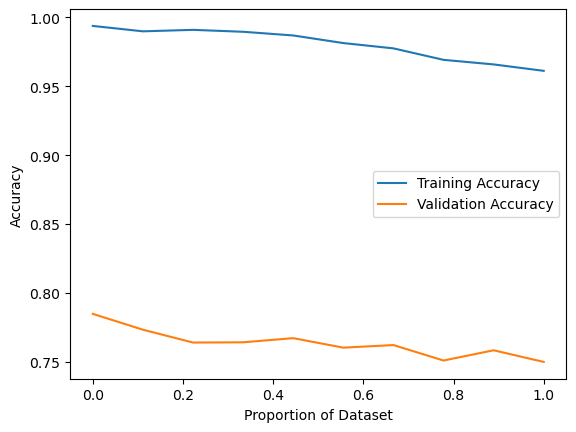

In [103]:
# Plot the learning curve
group_size = 5
train_recall_list_1 = [sum(train_recall_list[i:i+group_size]) / group_size for i in range(0, len(train_recall_list), group_size)]
# del train_recall_list_1[0]
plt.plot(np.linspace(0, 1, 10), train_recall_list_1, label='Training Accuracy')
# del val_recall_list_1[0]
val_recall_list_1 = [sum(val_recall_list[i:i+group_size]) / group_size for i in range(0, len(val_recall_list), group_size)]
plt.plot(np.linspace(0, 1, 10), val_recall_list_1, label='Validation Accuracy')
plt.xlabel('Proportion of Dataset')
plt.ylabel('Accuracy')
plt.legend()
plt.show()


In [17]:
# Apple Quality

wine,aq = data_ingestion()
x_train_w, x_test_w, y_train_w, y_test_w, x_train_a, x_test_a, y_train_a, y_test_a = train_test(wine,aq)

start_time = time.time()
layer_u = [64,64,64]
model = create_ann(x_train_a,y_train_a, dataset = 'apple', layer_units = layer_u, dropout=0.01, optimizer = Adam(learning_rate = 0.01), activation = 'sigmoid')
test,train = strat_kfold_ann(clf = model, num_folds = 5, x_train = x_train_a, y_train = y_train_a, dataset = "apple", epochs = 100)

print(1-train)
print(1-test)
# print(x)

print('Best accuracy:', test)
end_time = time.time()
# Calculate the elapsed time
elapsed_time = end_time - start_time
print("Elapsed Time: {:.2f} seconds".format(elapsed_time))

Epoch 1/100
70/70 [==============================] - 1s 1ms/step - loss: 0.6080 - accuracy: 0.6759
Epoch 2/100
70/70 [==============================] - 0s 1ms/step - loss: 0.4974 - accuracy: 0.7464
Epoch 3/100
70/70 [==============================] - 0s 1ms/step - loss: 0.4548 - accuracy: 0.7665
Epoch 4/100
70/70 [==============================] - 0s 1ms/step - loss: 0.3953 - accuracy: 0.8045
Epoch 5/100
70/70 [==============================] - 0s 1ms/step - loss: 0.3725 - accuracy: 0.8170
Epoch 6/100
70/70 [==============================] - 0s 1ms/step - loss: 0.3342 - accuracy: 0.8446
Epoch 7/100
70/70 [==============================] - 0s 1ms/step - loss: 0.2990 - accuracy: 0.8594
Epoch 8/100
70/70 [==============================] - 0s 1ms/step - loss: 0.2846 - accuracy: 0.8763
Epoch 9/100
70/70 [==============================] - 0s 1ms/step - loss: 0.2584 - accuracy: 0.8839
Epoch 10/100
70/70 [==============================] - 0s 1ms/step - loss: 0.2430 - accuracy: 0.8955
Epoch 11/

70/70 [==============================] - 0s 1ms/step - loss: 0.0343 - accuracy: 0.9875
Epoch 84/100
70/70 [==============================] - 0s 1ms/step - loss: 0.0245 - accuracy: 0.9888
Epoch 85/100
70/70 [==============================] - 0s 1ms/step - loss: 0.0222 - accuracy: 0.9893
Epoch 86/100
70/70 [==============================] - 0s 1ms/step - loss: 0.0254 - accuracy: 0.9902
Epoch 87/100
70/70 [==============================] - 0s 1ms/step - loss: 0.0262 - accuracy: 0.9888
Epoch 88/100
70/70 [==============================] - 0s 1ms/step - loss: 0.0261 - accuracy: 0.9920
Epoch 89/100
70/70 [==============================] - 0s 1ms/step - loss: 0.0360 - accuracy: 0.9866
Epoch 90/100
70/70 [==============================] - 0s 1ms/step - loss: 0.0586 - accuracy: 0.9781
Epoch 91/100
70/70 [==============================] - 0s 1ms/step - loss: 0.0331 - accuracy: 0.9875
Epoch 92/100
70/70 [==============================] - 0s 1ms/step - loss: 0.0221 - accuracy: 0.9933
Epoch 93/100


70/70 [==============================] - 0s 1ms/step - loss: 0.0343 - accuracy: 0.9902
Epoch 65/100
70/70 [==============================] - 0s 1ms/step - loss: 0.0108 - accuracy: 0.9973
Epoch 66/100
70/70 [==============================] - 0s 1ms/step - loss: 0.0108 - accuracy: 0.9960
Epoch 67/100
70/70 [==============================] - 0s 1ms/step - loss: 0.0134 - accuracy: 0.9946
Epoch 68/100
70/70 [==============================] - 0s 1ms/step - loss: 0.0084 - accuracy: 0.9982
Epoch 69/100
70/70 [==============================] - 0s 1ms/step - loss: 0.0090 - accuracy: 0.9960
Epoch 70/100
70/70 [==============================] - 0s 1ms/step - loss: 0.0059 - accuracy: 0.9982
Epoch 71/100
70/70 [==============================] - 0s 1ms/step - loss: 0.0087 - accuracy: 0.9978
Epoch 72/100
70/70 [==============================] - 0s 1ms/step - loss: 0.0190 - accuracy: 0.9942
Epoch 73/100
70/70 [==============================] - 0s 1ms/step - loss: 0.0258 - accuracy: 0.9871
Epoch 74/100


70/70 [==============================] - 0s 1ms/step - loss: 0.0147 - accuracy: 0.9960
Epoch 46/100
70/70 [==============================] - 0s 1ms/step - loss: 0.0103 - accuracy: 0.9969
Epoch 47/100
70/70 [==============================] - 0s 1ms/step - loss: 0.0238 - accuracy: 0.9951
Epoch 48/100
70/70 [==============================] - 0s 1ms/step - loss: 0.0199 - accuracy: 0.9942
Epoch 49/100
70/70 [==============================] - 0s 1ms/step - loss: 0.0074 - accuracy: 0.9982
Epoch 50/100
70/70 [==============================] - 0s 1ms/step - loss: 0.0043 - accuracy: 0.9987
Epoch 51/100
70/70 [==============================] - 0s 1ms/step - loss: 0.0165 - accuracy: 0.9978
Epoch 52/100
70/70 [==============================] - 0s 1ms/step - loss: 0.0131 - accuracy: 0.9955
Epoch 53/100
70/70 [==============================] - 0s 1ms/step - loss: 0.0120 - accuracy: 0.9964
Epoch 54/100
70/70 [==============================] - 0s 1ms/step - loss: 0.0044 - accuracy: 0.9987
Epoch 55/100


70/70 [==============================] - 0s 1ms/step - loss: 0.0061 - accuracy: 0.9973
Epoch 6/100
70/70 [==============================] - 0s 1ms/step - loss: 0.0081 - accuracy: 0.9973
Epoch 7/100
70/70 [==============================] - 0s 1ms/step - loss: 0.0035 - accuracy: 0.9991
Epoch 8/100
70/70 [==============================] - 0s 1ms/step - loss: 0.0011 - accuracy: 1.0000
Epoch 9/100
70/70 [==============================] - 0s 1ms/step - loss: 6.6955e-04 - accuracy: 1.0000
Epoch 10/100
70/70 [==============================] - 0s 1ms/step - loss: 0.0026 - accuracy: 0.9991
Epoch 11/100
70/70 [==============================] - 0s 1ms/step - loss: 0.0054 - accuracy: 0.9996
Epoch 12/100
70/70 [==============================] - 0s 1ms/step - loss: 0.0023 - accuracy: 0.9996
Epoch 13/100
70/70 [==============================] - 0s 1ms/step - loss: 0.0049 - accuracy: 0.9987
Epoch 14/100
70/70 [==============================] - 0s 1ms/step - loss: 0.0202 - accuracy: 0.9942
Epoch 15/100


<Figure size 640x480 with 0 Axes>

In [109]:
# Number of steps (subsets) for the learning curve
num_steps = 10

wine,aq = data_ingestion()
x_train_w, x_test_w, y_train_w, y_test_w, x_train_a, x_test_a, y_train_a, y_test_a = train_test(wine,aq)

percentages = [0.1, 0.2, 0.3, 0.4, 0.5, 0.6, 0.7, 0.8, 0.9, 1.0]

# Lists to store performance metrics
train_recall_list_2 = []
val_recall_list_2 = []

# Create Stratified K-Fold object
stratified_kfold = StratifiedKFold(n_splits=5, shuffle=True, random_state=42)

# Train the model for each subset size using k-fold cross-validation
for percentage in percentages:
    for train_indices, val_indices in stratified_kfold.split(x_train_a, y_train_a):
        X_train, X_val = x_train_a.iloc[train_indices], x_train_a.iloc[val_indices]
        y_train, y_val = y_train_a.iloc[train_indices], y_train_a.iloc[val_indices]

        # Split the training set further based on the specified percentage
        subset_size = int(percentage * len(x_train_a))
        X_train_subset = x_train_a.iloc[:subset_size]
        y_train_subset = y_train_a.iloc[:subset_size]
    
        # Train-Val scores
        model = create_ann(x_train_a,y_train_a, dataset = 'apple', layer_units = layer_u, dropout=0.01, optimizer = Adam(learning_rate = 0.01), activation = 'sigmoid')
        test,train = strat_kfold_ann(clf = model, num_folds = 5, x_train = X_train_subset, y_train = y_train_subset, dataset = "apple", epochs = 100)

        train_recall_list_2.append(train)
        val_recall_list_2.append(test)

        # Print progress
#         print(f'Training on {percentage * 100}% of the dataset, Training Recall: {train_recall}, Validation Recall: {val_recall}')



Epoch 1/100
7/7 [==============================] - 0s 2ms/step - loss: 0.8661 - accuracy: 0.4598
Epoch 2/100
7/7 [==============================] - 0s 1ms/step - loss: 0.8093 - accuracy: 0.4598
Epoch 3/100
7/7 [==============================] - 0s 2ms/step - loss: 0.7630 - accuracy: 0.4732
Epoch 4/100
7/7 [==============================] - 0s 0s/step - loss: 0.7315 - accuracy: 0.5089
Epoch 5/100
7/7 [==============================] - 0s 334us/step - loss: 0.7093 - accuracy: 0.5223
Epoch 6/100
7/7 [==============================] - 0s 1ms/step - loss: 0.6934 - accuracy: 0.5848
Epoch 7/100
7/7 [==============================] - 0s 2ms/step - loss: 0.6838 - accuracy: 0.5848
Epoch 8/100
7/7 [==============================] - 0s 2ms/step - loss: 0.6764 - accuracy: 0.6071
Epoch 9/100
7/7 [==============================] - 0s 1ms/step - loss: 0.6705 - accuracy: 0.6071
Epoch 10/100
7/7 [==============================] - 0s 581us/step - loss: 0.6653 - accuracy: 0.5938
Epoch 11/100
7/7 [========

7/7 [==============================] - 0s 1ms/step - loss: 0.5199 - accuracy: 0.7143
Epoch 67/100
7/7 [==============================] - 0s 1ms/step - loss: 0.5198 - accuracy: 0.7188
Epoch 68/100
7/7 [==============================] - 0s 1ms/step - loss: 0.5200 - accuracy: 0.7054
Epoch 69/100
7/7 [==============================] - 0s 1ms/step - loss: 0.5202 - accuracy: 0.7054
Epoch 70/100
7/7 [==============================] - 0s 1ms/step - loss: 0.5194 - accuracy: 0.7054
Epoch 71/100
7/7 [==============================] - 0s 1ms/step - loss: 0.5193 - accuracy: 0.7143
Epoch 72/100
7/7 [==============================] - 0s 1ms/step - loss: 0.5189 - accuracy: 0.7188
Epoch 73/100
7/7 [==============================] - 0s 1ms/step - loss: 0.5184 - accuracy: 0.7188
Epoch 74/100
7/7 [==============================] - 0s 1ms/step - loss: 0.5186 - accuracy: 0.7143
Epoch 75/100
7/7 [==============================] - 0s 988us/step - loss: 0.5178 - accuracy: 0.7054
Epoch 76/100
7/7 [=============

7/7 [==============================] - 0s 1ms/step - loss: 0.4658 - accuracy: 0.7679
Epoch 31/100
7/7 [==============================] - 0s 1ms/step - loss: 0.4653 - accuracy: 0.7679
Epoch 32/100
7/7 [==============================] - 0s 1ms/step - loss: 0.4651 - accuracy: 0.7679
Epoch 33/100
7/7 [==============================] - 0s 1ms/step - loss: 0.4650 - accuracy: 0.7679
Epoch 34/100
7/7 [==============================] - 0s 938us/step - loss: 0.4651 - accuracy: 0.7679
Epoch 35/100
7/7 [==============================] - 0s 1ms/step - loss: 0.4652 - accuracy: 0.7723
Epoch 36/100
7/7 [==============================] - 0s 1ms/step - loss: 0.4648 - accuracy: 0.7723
Epoch 37/100
7/7 [==============================] - 0s 958us/step - loss: 0.4646 - accuracy: 0.7723
Epoch 38/100
7/7 [==============================] - 0s 2ms/step - loss: 0.4645 - accuracy: 0.7679
Epoch 39/100
7/7 [==============================] - 0s 2ms/step - loss: 0.4641 - accuracy: 0.7723
Epoch 40/100
7/7 [===========

7/7 [==============================] - 0s 1ms/step - loss: 0.4684 - accuracy: 0.7277
Epoch 96/100
7/7 [==============================] - 0s 1ms/step - loss: 0.4684 - accuracy: 0.7277
Epoch 97/100
7/7 [==============================] - 0s 1ms/step - loss: 0.4687 - accuracy: 0.7232
Epoch 98/100
7/7 [==============================] - 0s 1ms/step - loss: 0.4674 - accuracy: 0.7277
Epoch 99/100
7/7 [==============================] - 0s 1ms/step - loss: 0.4679 - accuracy: 0.7277
Epoch 100/100
2/2 [==============================] - 0s 2ms/step
Epoch 1/100
7/7 [==============================] - 0s 3ms/step - loss: 0.7138 - accuracy: 0.4509
Epoch 2/100
7/7 [==============================] - 0s 0s/step - loss: 0.7027 - accuracy: 0.4911
Epoch 3/100
7/7 [==============================] - 0s 1ms/step - loss: 0.6937 - accuracy: 0.5045
Epoch 4/100
7/7 [==============================] - 0s 2ms/step - loss: 0.6857 - accuracy: 0.5446
Epoch 5/100
7/7 [==============================] - 0s 1ms/step - loss: 

7/7 [==============================] - 0s 1ms/step - loss: 0.4757 - accuracy: 0.7857
Epoch 60/100
7/7 [==============================] - 0s 1ms/step - loss: 0.4747 - accuracy: 0.7857
Epoch 61/100
7/7 [==============================] - 0s 1ms/step - loss: 0.4735 - accuracy: 0.7857
Epoch 62/100
7/7 [==============================] - 0s 1ms/step - loss: 0.4730 - accuracy: 0.7812
Epoch 63/100
7/7 [==============================] - 0s 1ms/step - loss: 0.4722 - accuracy: 0.7768
Epoch 64/100
7/7 [==============================] - 0s 1ms/step - loss: 0.4715 - accuracy: 0.7768
Epoch 65/100
7/7 [==============================] - 0s 1ms/step - loss: 0.4707 - accuracy: 0.7812
Epoch 66/100
7/7 [==============================] - 0s 1ms/step - loss: 0.4692 - accuracy: 0.7812
Epoch 67/100
7/7 [==============================] - 0s 1ms/step - loss: 0.4685 - accuracy: 0.7812
Epoch 68/100
7/7 [==============================] - 0s 1ms/step - loss: 0.4680 - accuracy: 0.7768
Epoch 69/100
7/7 [===============

7/7 [==============================] - 0s 1ms/step - loss: 0.4396 - accuracy: 0.7902
Epoch 24/100
7/7 [==============================] - 0s 1ms/step - loss: 0.4392 - accuracy: 0.7902
Epoch 25/100
7/7 [==============================] - 0s 1ms/step - loss: 0.4389 - accuracy: 0.7857
Epoch 26/100
7/7 [==============================] - 0s 795us/step - loss: 0.4389 - accuracy: 0.7857
Epoch 27/100
7/7 [==============================] - 0s 1ms/step - loss: 0.4389 - accuracy: 0.7812
Epoch 28/100
7/7 [==============================] - 0s 2ms/step - loss: 0.4383 - accuracy: 0.7768
Epoch 29/100
7/7 [==============================] - 0s 1ms/step - loss: 0.4383 - accuracy: 0.7812
Epoch 30/100
7/7 [==============================] - 0s 1ms/step - loss: 0.4384 - accuracy: 0.7857
Epoch 31/100
7/7 [==============================] - 0s 1ms/step - loss: 0.4378 - accuracy: 0.7812
Epoch 32/100
7/7 [==============================] - 0s 1ms/step - loss: 0.4374 - accuracy: 0.7812
Epoch 33/100
7/7 [=============

7/7 [==============================] - 0s 1ms/step - loss: 0.4457 - accuracy: 0.7946
Epoch 89/100
7/7 [==============================] - 0s 2ms/step - loss: 0.4455 - accuracy: 0.7902
Epoch 90/100
7/7 [==============================] - 0s 2ms/step - loss: 0.4454 - accuracy: 0.7902
Epoch 91/100
7/7 [==============================] - 0s 2ms/step - loss: 0.4448 - accuracy: 0.7902
Epoch 92/100
7/7 [==============================] - 0s 1ms/step - loss: 0.4452 - accuracy: 0.7902
Epoch 93/100
7/7 [==============================] - 0s 1ms/step - loss: 0.4451 - accuracy: 0.7902
Epoch 94/100
7/7 [==============================] - 0s 2ms/step - loss: 0.4450 - accuracy: 0.7902
Epoch 95/100
7/7 [==============================] - 0s 1ms/step - loss: 0.4453 - accuracy: 0.7946
Epoch 96/100
7/7 [==============================] - 0s 1ms/step - loss: 0.4449 - accuracy: 0.7902
Epoch 97/100
7/7 [==============================] - 0s 1ms/step - loss: 0.4451 - accuracy: 0.7902
Epoch 98/100
7/7 [===============

7/7 [==============================] - 0s 1ms/step - loss: 0.5135 - accuracy: 0.7455
Epoch 53/100
7/7 [==============================] - 0s 1ms/step - loss: 0.5131 - accuracy: 0.7455
Epoch 54/100
7/7 [==============================] - 0s 1ms/step - loss: 0.5130 - accuracy: 0.7500
Epoch 55/100
7/7 [==============================] - 0s 1ms/step - loss: 0.5128 - accuracy: 0.7500
Epoch 56/100
7/7 [==============================] - 0s 2ms/step - loss: 0.5129 - accuracy: 0.7500
Epoch 57/100
7/7 [==============================] - 0s 2ms/step - loss: 0.5127 - accuracy: 0.7455
Epoch 58/100
7/7 [==============================] - 0s 1ms/step - loss: 0.5122 - accuracy: 0.7500
Epoch 59/100
7/7 [==============================] - 0s 1ms/step - loss: 0.5116 - accuracy: 0.7500
Epoch 60/100
7/7 [==============================] - 0s 2ms/step - loss: 0.5111 - accuracy: 0.7455
Epoch 61/100
7/7 [==============================] - 0s 1ms/step - loss: 0.5108 - accuracy: 0.7500
Epoch 62/100
7/7 [===============

7/7 [==============================] - 0s 1ms/step - loss: 0.4730 - accuracy: 0.7857
Epoch 17/100
7/7 [==============================] - 0s 1ms/step - loss: 0.4715 - accuracy: 0.7902
Epoch 18/100
7/7 [==============================] - 0s 1ms/step - loss: 0.4713 - accuracy: 0.7902
Epoch 19/100
7/7 [==============================] - 0s 1ms/step - loss: 0.4704 - accuracy: 0.7902
Epoch 20/100
7/7 [==============================] - 0s 789us/step - loss: 0.4691 - accuracy: 0.7946
Epoch 21/100
7/7 [==============================] - 0s 1ms/step - loss: 0.4688 - accuracy: 0.7946
Epoch 22/100
7/7 [==============================] - 0s 1ms/step - loss: 0.4680 - accuracy: 0.7991
Epoch 23/100
7/7 [==============================] - 0s 1ms/step - loss: 0.4673 - accuracy: 0.7991
Epoch 24/100
7/7 [==============================] - 0s 1ms/step - loss: 0.4661 - accuracy: 0.7991
Epoch 25/100
7/7 [==============================] - 0s 2ms/step - loss: 0.4657 - accuracy: 0.7991
Epoch 26/100
7/7 [=============

7/7 [==============================] - 0s 1ms/step - loss: 0.4519 - accuracy: 0.7902
Epoch 82/100
7/7 [==============================] - 0s 1ms/step - loss: 0.4520 - accuracy: 0.7857
Epoch 83/100
7/7 [==============================] - 0s 713us/step - loss: 0.4520 - accuracy: 0.7902
Epoch 84/100
7/7 [==============================] - 0s 2ms/step - loss: 0.4518 - accuracy: 0.7946
Epoch 85/100
7/7 [==============================] - 0s 1ms/step - loss: 0.4514 - accuracy: 0.7946
Epoch 86/100
7/7 [==============================] - 0s 1ms/step - loss: 0.4516 - accuracy: 0.7902
Epoch 87/100
7/7 [==============================] - 0s 1ms/step - loss: 0.4515 - accuracy: 0.7902
Epoch 88/100
7/7 [==============================] - 0s 1ms/step - loss: 0.4517 - accuracy: 0.7902
Epoch 89/100
7/7 [==============================] - 0s 1ms/step - loss: 0.4515 - accuracy: 0.7902
Epoch 90/100
7/7 [==============================] - 0s 1ms/step - loss: 0.4514 - accuracy: 0.7902
Epoch 91/100
7/7 [=============

7/7 [==============================] - 0s 1ms/step - loss: 0.5184 - accuracy: 0.7188
Epoch 46/100
7/7 [==============================] - 0s 1ms/step - loss: 0.5173 - accuracy: 0.7188
Epoch 47/100
7/7 [==============================] - 0s 1ms/step - loss: 0.5160 - accuracy: 0.7232
Epoch 48/100
7/7 [==============================] - 0s 827us/step - loss: 0.5164 - accuracy: 0.7232
Epoch 49/100
7/7 [==============================] - 0s 1ms/step - loss: 0.5159 - accuracy: 0.7232
Epoch 50/100
7/7 [==============================] - 0s 2ms/step - loss: 0.5148 - accuracy: 0.7232
Epoch 51/100
7/7 [==============================] - 0s 1ms/step - loss: 0.5152 - accuracy: 0.7232
Epoch 52/100
7/7 [==============================] - 0s 1ms/step - loss: 0.5145 - accuracy: 0.7232
Epoch 53/100
7/7 [==============================] - 0s 1ms/step - loss: 0.5139 - accuracy: 0.7232
Epoch 54/100
7/7 [==============================] - 0s 1ms/step - loss: 0.5136 - accuracy: 0.7277
Epoch 55/100
7/7 [=============

7/7 [==============================] - 0s 1ms/step - loss: 0.4739 - accuracy: 0.7589
Epoch 10/100
7/7 [==============================] - 0s 1ms/step - loss: 0.4724 - accuracy: 0.7634
Epoch 11/100
7/7 [==============================] - 0s 1ms/step - loss: 0.4720 - accuracy: 0.7634
Epoch 12/100
7/7 [==============================] - 0s 1ms/step - loss: 0.4723 - accuracy: 0.7634
Epoch 13/100
7/7 [==============================] - 0s 1ms/step - loss: 0.4721 - accuracy: 0.7634
Epoch 14/100
7/7 [==============================] - 0s 1ms/step - loss: 0.4710 - accuracy: 0.7679
Epoch 15/100
7/7 [==============================] - 0s 1ms/step - loss: 0.4710 - accuracy: 0.7723
Epoch 16/100
7/7 [==============================] - 0s 1ms/step - loss: 0.4711 - accuracy: 0.7723
Epoch 17/100
7/7 [==============================] - 0s 1ms/step - loss: 0.4705 - accuracy: 0.7723
Epoch 18/100
7/7 [==============================] - 0s 1ms/step - loss: 0.4706 - accuracy: 0.7679
Epoch 19/100
7/7 [===============

7/7 [==============================] - 0s 1ms/step - loss: 0.4721 - accuracy: 0.7366
Epoch 75/100
7/7 [==============================] - 0s 2ms/step - loss: 0.4720 - accuracy: 0.7366
Epoch 76/100
7/7 [==============================] - 0s 0s/step - loss: 0.4721 - accuracy: 0.7411
Epoch 77/100
7/7 [==============================] - 0s 1ms/step - loss: 0.4722 - accuracy: 0.7366
Epoch 78/100
7/7 [==============================] - 0s 2ms/step - loss: 0.4715 - accuracy: 0.7366
Epoch 79/100
7/7 [==============================] - 0s 1ms/step - loss: 0.4714 - accuracy: 0.7366
Epoch 80/100
7/7 [==============================] - 0s 1ms/step - loss: 0.4713 - accuracy: 0.7411
Epoch 81/100
7/7 [==============================] - 0s 1ms/step - loss: 0.4714 - accuracy: 0.7366
Epoch 82/100
7/7 [==============================] - 0s 869us/step - loss: 0.4710 - accuracy: 0.7277
Epoch 83/100
7/7 [==============================] - 0s 1ms/step - loss: 0.4715 - accuracy: 0.7277
Epoch 84/100
7/7 [==============

7/7 [==============================] - 0s 659us/step - loss: 0.4565 - accuracy: 0.7991
Epoch 39/100
7/7 [==============================] - 0s 2ms/step - loss: 0.4563 - accuracy: 0.7991
Epoch 40/100
7/7 [==============================] - 0s 2ms/step - loss: 0.4561 - accuracy: 0.7991
Epoch 41/100
7/7 [==============================] - 0s 1ms/step - loss: 0.4561 - accuracy: 0.7991
Epoch 42/100
7/7 [==============================] - 0s 1ms/step - loss: 0.4554 - accuracy: 0.7991
Epoch 43/100
7/7 [==============================] - 0s 1ms/step - loss: 0.4549 - accuracy: 0.7991
Epoch 44/100
7/7 [==============================] - 0s 2ms/step - loss: 0.4545 - accuracy: 0.7991
Epoch 45/100
7/7 [==============================] - 0s 1ms/step - loss: 0.4553 - accuracy: 0.7991
Epoch 46/100
7/7 [==============================] - 0s 1ms/step - loss: 0.4541 - accuracy: 0.7991
Epoch 47/100
7/7 [==============================] - 0s 2ms/step - loss: 0.4538 - accuracy: 0.7991
Epoch 48/100
7/7 [=============

7/7 [==============================] - 0s 1ms/step - loss: 0.4324 - accuracy: 0.7991
Epoch 3/100
7/7 [==============================] - 0s 1ms/step - loss: 0.4291 - accuracy: 0.7991
Epoch 4/100
7/7 [==============================] - 0s 1ms/step - loss: 0.4254 - accuracy: 0.7991
Epoch 5/100
7/7 [==============================] - 0s 1ms/step - loss: 0.4223 - accuracy: 0.8036
Epoch 6/100
7/7 [==============================] - 0s 1ms/step - loss: 0.4199 - accuracy: 0.8125
Epoch 7/100
7/7 [==============================] - 0s 1ms/step - loss: 0.4187 - accuracy: 0.8259
Epoch 8/100
7/7 [==============================] - 0s 1ms/step - loss: 0.4173 - accuracy: 0.8259
Epoch 9/100
7/7 [==============================] - 0s 1ms/step - loss: 0.4155 - accuracy: 0.8170
Epoch 10/100
7/7 [==============================] - 0s 2ms/step - loss: 0.4141 - accuracy: 0.8214
Epoch 11/100
7/7 [==============================] - 0s 1ms/step - loss: 0.4130 - accuracy: 0.8214
Epoch 12/100
7/7 [======================

7/7 [==============================] - 0s 1ms/step - loss: 0.4435 - accuracy: 0.8170
Epoch 68/100
7/7 [==============================] - 0s 1ms/step - loss: 0.4433 - accuracy: 0.8170
Epoch 69/100
7/7 [==============================] - 0s 2ms/step - loss: 0.4434 - accuracy: 0.8170
Epoch 70/100
7/7 [==============================] - 0s 1ms/step - loss: 0.4435 - accuracy: 0.8170
Epoch 71/100
7/7 [==============================] - 0s 1ms/step - loss: 0.4435 - accuracy: 0.8170
Epoch 72/100
7/7 [==============================] - 0s 2ms/step - loss: 0.4434 - accuracy: 0.8125
Epoch 73/100
7/7 [==============================] - 0s 1ms/step - loss: 0.4436 - accuracy: 0.8170
Epoch 74/100
7/7 [==============================] - 0s 1ms/step - loss: 0.4434 - accuracy: 0.8170
Epoch 75/100
7/7 [==============================] - 0s 1ms/step - loss: 0.4434 - accuracy: 0.8125
Epoch 76/100
7/7 [==============================] - 0s 1ms/step - loss: 0.4437 - accuracy: 0.8125
Epoch 77/100
7/7 [===============

14/14 [==============================] - 0s 1ms/step - loss: 0.4299 - accuracy: 0.8125
Epoch 29/100
14/14 [==============================] - 0s 979us/step - loss: 0.4287 - accuracy: 0.8125
Epoch 30/100
14/14 [==============================] - 0s 782us/step - loss: 0.4288 - accuracy: 0.8125
Epoch 31/100
14/14 [==============================] - 0s 1ms/step - loss: 0.4282 - accuracy: 0.8170
Epoch 32/100
14/14 [==============================] - 0s 1ms/step - loss: 0.4281 - accuracy: 0.8170
Epoch 33/100
14/14 [==============================] - 0s 1ms/step - loss: 0.4281 - accuracy: 0.8103
Epoch 34/100
14/14 [==============================] - 0s 1ms/step - loss: 0.4275 - accuracy: 0.8125
Epoch 35/100
14/14 [==============================] - 0s 1ms/step - loss: 0.4278 - accuracy: 0.8170
Epoch 36/100
14/14 [==============================] - 0s 1ms/step - loss: 0.4284 - accuracy: 0.8147
Epoch 37/100
14/14 [==============================] - 0s 1ms/step - loss: 0.4265 - accuracy: 0.8103
Epoch 38/

14/14 [==============================] - 0s 1ms/step - loss: 0.4140 - accuracy: 0.8170
Epoch 90/100
14/14 [==============================] - 0s 1ms/step - loss: 0.4127 - accuracy: 0.8170
Epoch 91/100
14/14 [==============================] - 0s 1ms/step - loss: 0.4134 - accuracy: 0.8147
Epoch 92/100
14/14 [==============================] - 0s 976us/step - loss: 0.4128 - accuracy: 0.8147
Epoch 93/100
14/14 [==============================] - 0s 780us/step - loss: 0.4134 - accuracy: 0.8147
Epoch 94/100
14/14 [==============================] - 0s 1ms/step - loss: 0.4131 - accuracy: 0.8170
Epoch 95/100
14/14 [==============================] - 0s 1ms/step - loss: 0.4139 - accuracy: 0.8170
Epoch 96/100
14/14 [==============================] - 0s 1ms/step - loss: 0.4142 - accuracy: 0.8170
Epoch 97/100
14/14 [==============================] - 0s 1ms/step - loss: 0.4130 - accuracy: 0.8170
Epoch 98/100
14/14 [==============================] - 0s 843us/step - loss: 0.4133 - accuracy: 0.8192
Epoch 9

Epoch 70/100
14/14 [==============================] - 0s 975us/step - loss: 0.4105 - accuracy: 0.8192
Epoch 71/100
14/14 [==============================] - 0s 1ms/step - loss: 0.4085 - accuracy: 0.8237
Epoch 72/100
14/14 [==============================] - 0s 1ms/step - loss: 0.4097 - accuracy: 0.8237
Epoch 73/100
14/14 [==============================] - 0s 1ms/step - loss: 0.4104 - accuracy: 0.8214
Epoch 74/100
14/14 [==============================] - 0s 1ms/step - loss: 0.4100 - accuracy: 0.8214
Epoch 75/100
14/14 [==============================] - 0s 1ms/step - loss: 0.4098 - accuracy: 0.8237
Epoch 76/100
14/14 [==============================] - 0s 1ms/step - loss: 0.4102 - accuracy: 0.8214
Epoch 77/100
14/14 [==============================] - 0s 1ms/step - loss: 0.4106 - accuracy: 0.8237
Epoch 78/100
14/14 [==============================] - 0s 1ms/step - loss: 0.4098 - accuracy: 0.8237
Epoch 79/100
14/14 [==============================] - 0s 945us/step - loss: 0.4094 - accuracy: 0.8

14/14 [==============================] - 0s 1ms/step - loss: 0.5265 - accuracy: 0.7835
Epoch 31/100
14/14 [==============================] - 0s 1ms/step - loss: 0.5221 - accuracy: 0.7812
Epoch 32/100
14/14 [==============================] - 0s 1ms/step - loss: 0.5182 - accuracy: 0.7879
Epoch 33/100
14/14 [==============================] - 0s 1ms/step - loss: 0.5142 - accuracy: 0.7879
Epoch 34/100
14/14 [==============================] - 0s 1ms/step - loss: 0.5109 - accuracy: 0.7902
Epoch 35/100
14/14 [==============================] - 0s 1ms/step - loss: 0.5072 - accuracy: 0.7902
Epoch 36/100
14/14 [==============================] - 0s 1ms/step - loss: 0.5040 - accuracy: 0.7924
Epoch 37/100
14/14 [==============================] - 0s 989us/step - loss: 0.5006 - accuracy: 0.7924
Epoch 38/100
14/14 [==============================] - 0s 1ms/step - loss: 0.4981 - accuracy: 0.7902
Epoch 39/100
14/14 [==============================] - 0s 906us/step - loss: 0.4938 - accuracy: 0.7969
Epoch 40/

Epoch 11/100
14/14 [==============================] - 0s 1ms/step - loss: 0.4328 - accuracy: 0.8192
Epoch 12/100
14/14 [==============================] - 0s 1ms/step - loss: 0.4316 - accuracy: 0.8170
Epoch 13/100
14/14 [==============================] - 0s 1ms/step - loss: 0.4321 - accuracy: 0.8103
Epoch 14/100
14/14 [==============================] - 0s 1ms/step - loss: 0.4311 - accuracy: 0.8125
Epoch 15/100
14/14 [==============================] - 0s 1ms/step - loss: 0.4327 - accuracy: 0.8125
Epoch 16/100
14/14 [==============================] - 0s 1ms/step - loss: 0.4312 - accuracy: 0.8125
Epoch 17/100
14/14 [==============================] - 0s 1ms/step - loss: 0.4317 - accuracy: 0.8147
Epoch 18/100
14/14 [==============================] - 0s 1ms/step - loss: 0.4298 - accuracy: 0.8125
Epoch 19/100
14/14 [==============================] - 0s 971us/step - loss: 0.4301 - accuracy: 0.8125
Epoch 20/100
14/14 [==============================] - 0s 958us/step - loss: 0.4296 - accuracy: 0.8

14/14 [==============================] - 0s 1ms/step - loss: 0.4141 - accuracy: 0.8103
Epoch 73/100
14/14 [==============================] - 0s 1ms/step - loss: 0.4144 - accuracy: 0.8125
Epoch 74/100
14/14 [==============================] - 0s 1ms/step - loss: 0.4145 - accuracy: 0.8103
Epoch 75/100
14/14 [==============================] - 0s 2ms/step - loss: 0.4157 - accuracy: 0.8103
Epoch 76/100
14/14 [==============================] - 0s 1ms/step - loss: 0.4136 - accuracy: 0.8058
Epoch 77/100
14/14 [==============================] - 0s 1ms/step - loss: 0.4151 - accuracy: 0.8125
Epoch 78/100
14/14 [==============================] - 0s 1ms/step - loss: 0.4141 - accuracy: 0.8080
Epoch 79/100
14/14 [==============================] - 0s 1ms/step - loss: 0.4136 - accuracy: 0.8125
Epoch 80/100
14/14 [==============================] - 0s 1ms/step - loss: 0.4147 - accuracy: 0.8080
Epoch 81/100
14/14 [==============================] - 0s 1ms/step - loss: 0.4143 - accuracy: 0.8147
Epoch 82/100


Epoch 53/100
14/14 [==============================] - 0s 1ms/step - loss: 0.4110 - accuracy: 0.8214
Epoch 54/100
14/14 [==============================] - 0s 1ms/step - loss: 0.4103 - accuracy: 0.8259
Epoch 55/100
14/14 [==============================] - 0s 1ms/step - loss: 0.4100 - accuracy: 0.8281
Epoch 56/100
14/14 [==============================] - 0s 716us/step - loss: 0.4121 - accuracy: 0.8170
Epoch 57/100
14/14 [==============================] - 0s 1ms/step - loss: 0.4096 - accuracy: 0.8237
Epoch 58/100
14/14 [==============================] - 0s 1ms/step - loss: 0.4100 - accuracy: 0.8237
Epoch 59/100
14/14 [==============================] - 0s 1ms/step - loss: 0.4102 - accuracy: 0.8259
Epoch 60/100
14/14 [==============================] - 0s 1ms/step - loss: 0.4098 - accuracy: 0.8281
Epoch 61/100
14/14 [==============================] - 0s 1ms/step - loss: 0.4119 - accuracy: 0.8237
Epoch 62/100
14/14 [==============================] - 0s 1ms/step - loss: 0.4102 - accuracy: 0.823

14/14 [==============================] - 0s 1ms/step - loss: 0.5921 - accuracy: 0.7188
Epoch 14/100
14/14 [==============================] - 0s 982us/step - loss: 0.5840 - accuracy: 0.7277
Epoch 15/100
14/14 [==============================] - 0s 713us/step - loss: 0.5785 - accuracy: 0.7277
Epoch 16/100
14/14 [==============================] - 0s 1ms/step - loss: 0.5731 - accuracy: 0.7277
Epoch 17/100
14/14 [==============================] - 0s 1ms/step - loss: 0.5687 - accuracy: 0.7254
Epoch 18/100
14/14 [==============================] - 0s 1ms/step - loss: 0.5648 - accuracy: 0.7210
Epoch 19/100
14/14 [==============================] - 0s 1ms/step - loss: 0.5613 - accuracy: 0.7210
Epoch 20/100
14/14 [==============================] - 0s 1ms/step - loss: 0.5583 - accuracy: 0.7232
Epoch 21/100
14/14 [==============================] - 0s 1ms/step - loss: 0.5553 - accuracy: 0.7188
Epoch 22/100
14/14 [==============================] - 0s 1ms/step - loss: 0.5538 - accuracy: 0.7165
Epoch 23/

14/14 [==============================] - 0s 1ms/step - loss: 0.4529 - accuracy: 0.7768
Epoch 75/100
14/14 [==============================] - 0s 1ms/step - loss: 0.4528 - accuracy: 0.7790
Epoch 76/100
14/14 [==============================] - 0s 1ms/step - loss: 0.4552 - accuracy: 0.7723
Epoch 77/100
14/14 [==============================] - 0s 1ms/step - loss: 0.4533 - accuracy: 0.7790
Epoch 78/100
14/14 [==============================] - 0s 1ms/step - loss: 0.4526 - accuracy: 0.7812
Epoch 79/100
14/14 [==============================] - 0s 1ms/step - loss: 0.4530 - accuracy: 0.7768
Epoch 80/100
14/14 [==============================] - 0s 1ms/step - loss: 0.4529 - accuracy: 0.7768
Epoch 81/100
14/14 [==============================] - 0s 1ms/step - loss: 0.4522 - accuracy: 0.7790
Epoch 82/100
14/14 [==============================] - 0s 1ms/step - loss: 0.4527 - accuracy: 0.7790
Epoch 83/100
14/14 [==============================] - 0s 1ms/step - loss: 0.4517 - accuracy: 0.7768
Epoch 84/100


14/14 [==============================] - 0s 1ms/step - loss: 0.4226 - accuracy: 0.7812
Epoch 35/100
14/14 [==============================] - 0s 1ms/step - loss: 0.4224 - accuracy: 0.7812
Epoch 36/100
14/14 [==============================] - 0s 1ms/step - loss: 0.4227 - accuracy: 0.7812
Epoch 37/100
14/14 [==============================] - 0s 1ms/step - loss: 0.4235 - accuracy: 0.7768
Epoch 38/100
14/14 [==============================] - 0s 1ms/step - loss: 0.4221 - accuracy: 0.7812
Epoch 39/100
14/14 [==============================] - 0s 1ms/step - loss: 0.4233 - accuracy: 0.7812
Epoch 40/100
14/14 [==============================] - 0s 1ms/step - loss: 0.4232 - accuracy: 0.7812
Epoch 41/100
14/14 [==============================] - 0s 1ms/step - loss: 0.4221 - accuracy: 0.7790
Epoch 42/100
14/14 [==============================] - 0s 1ms/step - loss: 0.4225 - accuracy: 0.7812
Epoch 43/100
14/14 [==============================] - 0s 1ms/step - loss: 0.4223 - accuracy: 0.7812
Epoch 44/100


Epoch 15/100
14/14 [==============================] - 0s 1ms/step - loss: 0.4626 - accuracy: 0.7455
Epoch 16/100
14/14 [==============================] - 0s 1ms/step - loss: 0.4654 - accuracy: 0.7478
Epoch 17/100
14/14 [==============================] - 0s 1ms/step - loss: 0.4629 - accuracy: 0.7522
Epoch 18/100
14/14 [==============================] - 0s 1ms/step - loss: 0.4645 - accuracy: 0.7522
Epoch 19/100
14/14 [==============================] - 0s 1ms/step - loss: 0.4647 - accuracy: 0.7500
Epoch 20/100
14/14 [==============================] - 0s 1ms/step - loss: 0.4656 - accuracy: 0.7478
Epoch 21/100
14/14 [==============================] - 0s 1ms/step - loss: 0.4620 - accuracy: 0.7500
Epoch 22/100
14/14 [==============================] - 0s 1ms/step - loss: 0.4638 - accuracy: 0.7478
Epoch 23/100
14/14 [==============================] - 0s 1ms/step - loss: 0.4646 - accuracy: 0.7478
Epoch 24/100
14/14 [==============================] - 0s 1ms/step - loss: 0.4625 - accuracy: 0.7522


14/14 [==============================] - 0s 1ms/step - loss: 0.4586 - accuracy: 0.7969
Epoch 77/100
14/14 [==============================] - 0s 1ms/step - loss: 0.4579 - accuracy: 0.7879
Epoch 78/100
14/14 [==============================] - 0s 1ms/step - loss: 0.4570 - accuracy: 0.7946
Epoch 79/100
14/14 [==============================] - 0s 1ms/step - loss: 0.4559 - accuracy: 0.7924
Epoch 80/100
14/14 [==============================] - 0s 1ms/step - loss: 0.4561 - accuracy: 0.7969
Epoch 81/100
14/14 [==============================] - 0s 1ms/step - loss: 0.4541 - accuracy: 0.7991
Epoch 82/100
14/14 [==============================] - 0s 1ms/step - loss: 0.4542 - accuracy: 0.8013
Epoch 83/100
14/14 [==============================] - 0s 1ms/step - loss: 0.4522 - accuracy: 0.8058
Epoch 84/100
14/14 [==============================] - 0s 870us/step - loss: 0.4526 - accuracy: 0.7946
Epoch 85/100
14/14 [==============================] - 0s 1ms/step - loss: 0.4506 - accuracy: 0.8058
Epoch 86/10

Epoch 37/100
14/14 [==============================] - 0s 1ms/step - loss: 0.4096 - accuracy: 0.8237
Epoch 38/100
14/14 [==============================] - 0s 1ms/step - loss: 0.4096 - accuracy: 0.8192
Epoch 39/100
14/14 [==============================] - 0s 1ms/step - loss: 0.4096 - accuracy: 0.8214
Epoch 40/100
14/14 [==============================] - 0s 1ms/step - loss: 0.4099 - accuracy: 0.8214
Epoch 41/100
14/14 [==============================] - 0s 1ms/step - loss: 0.4088 - accuracy: 0.8237
Epoch 42/100
14/14 [==============================] - 0s 1ms/step - loss: 0.4099 - accuracy: 0.8214
Epoch 43/100
14/14 [==============================] - 0s 1ms/step - loss: 0.4089 - accuracy: 0.8214
Epoch 44/100
14/14 [==============================] - 0s 1ms/step - loss: 0.4095 - accuracy: 0.8170
Epoch 45/100
14/14 [==============================] - 0s 1ms/step - loss: 0.4101 - accuracy: 0.8147
Epoch 46/100
14/14 [==============================] - 0s 976us/step - loss: 0.4096 - accuracy: 0.814

14/14 [==============================] - 0s 1ms/step - loss: 0.3855 - accuracy: 0.8348
Epoch 99/100
14/14 [==============================] - 0s 1ms/step - loss: 0.3846 - accuracy: 0.8371
Epoch 100/100
4/4 [==============================] - 0s 878us/step
Epoch 1/100
14/14 [==============================] - 0s 999us/step - loss: 0.3987 - accuracy: 0.8192
Epoch 2/100
14/14 [==============================] - 0s 1ms/step - loss: 0.3972 - accuracy: 0.8259
Epoch 3/100
14/14 [==============================] - 0s 1ms/step - loss: 0.3956 - accuracy: 0.8237
Epoch 4/100
14/14 [==============================] - 0s 1ms/step - loss: 0.3941 - accuracy: 0.8237
Epoch 5/100
14/14 [==============================] - 0s 1ms/step - loss: 0.3944 - accuracy: 0.8259
Epoch 6/100
14/14 [==============================] - 0s 1ms/step - loss: 0.3935 - accuracy: 0.8281
Epoch 7/100
14/14 [==============================] - 0s 1ms/step - loss: 0.3921 - accuracy: 0.8281
Epoch 8/100
14/14 [==============================] 

Epoch 79/100
14/14 [==============================] - 0s 1ms/step - loss: 0.3858 - accuracy: 0.8482
Epoch 80/100
14/14 [==============================] - 0s 1ms/step - loss: 0.3854 - accuracy: 0.8482
Epoch 81/100
14/14 [==============================] - 0s 1ms/step - loss: 0.3858 - accuracy: 0.8460
Epoch 82/100
14/14 [==============================] - 0s 1ms/step - loss: 0.3848 - accuracy: 0.8482
Epoch 83/100
14/14 [==============================] - 0s 1ms/step - loss: 0.3856 - accuracy: 0.8482
Epoch 84/100
14/14 [==============================] - 0s 1ms/step - loss: 0.3858 - accuracy: 0.8482
Epoch 85/100
14/14 [==============================] - 0s 1ms/step - loss: 0.3849 - accuracy: 0.8482
Epoch 86/100
14/14 [==============================] - 0s 978us/step - loss: 0.3852 - accuracy: 0.8482
Epoch 87/100
14/14 [==============================] - 0s 1ms/step - loss: 0.3850 - accuracy: 0.8438
Epoch 88/100
14/14 [==============================] - 0s 1ms/step - loss: 0.3868 - accuracy: 0.841

14/14 [==============================] - 0s 1ms/step - loss: 0.4199 - accuracy: 0.8125
Epoch 41/100
14/14 [==============================] - 0s 1ms/step - loss: 0.4195 - accuracy: 0.8147
Epoch 42/100
14/14 [==============================] - 0s 1ms/step - loss: 0.4199 - accuracy: 0.8170
Epoch 43/100
14/14 [==============================] - 0s 1ms/step - loss: 0.4200 - accuracy: 0.8170
Epoch 44/100
14/14 [==============================] - 0s 1ms/step - loss: 0.4188 - accuracy: 0.8147
Epoch 45/100
14/14 [==============================] - 0s 1ms/step - loss: 0.4194 - accuracy: 0.8147
Epoch 46/100
14/14 [==============================] - 0s 949us/step - loss: 0.4183 - accuracy: 0.8125
Epoch 47/100
14/14 [==============================] - 0s 1ms/step - loss: 0.4197 - accuracy: 0.8147
Epoch 48/100
14/14 [==============================] - 0s 1ms/step - loss: 0.4184 - accuracy: 0.8147
Epoch 49/100
14/14 [==============================] - 0s 1ms/step - loss: 0.4186 - accuracy: 0.8147
Epoch 50/10

4/4 [==============================] - 0s 1ms/step
Epoch 1/100
14/14 [==============================] - 0s 1ms/step - loss: 0.4175 - accuracy: 0.8192
Epoch 2/100
14/14 [==============================] - 0s 1ms/step - loss: 0.4160 - accuracy: 0.8147
Epoch 3/100
14/14 [==============================] - 0s 998us/step - loss: 0.4139 - accuracy: 0.8192
Epoch 4/100
14/14 [==============================] - 0s 1ms/step - loss: 0.4138 - accuracy: 0.8170
Epoch 5/100
14/14 [==============================] - 0s 1ms/step - loss: 0.4138 - accuracy: 0.8192
Epoch 6/100
14/14 [==============================] - 0s 1ms/step - loss: 0.4143 - accuracy: 0.8125
Epoch 7/100
14/14 [==============================] - 0s 1ms/step - loss: 0.4143 - accuracy: 0.8170
Epoch 8/100
14/14 [==============================] - 0s 968us/step - loss: 0.4129 - accuracy: 0.8192
Epoch 9/100
14/14 [==============================] - 0s 1ms/step - loss: 0.4124 - accuracy: 0.8192
Epoch 10/100
14/14 [==============================] - 

14/14 [==============================] - 0s 1ms/step - loss: 0.4074 - accuracy: 0.8237
Epoch 63/100
14/14 [==============================] - 0s 1ms/step - loss: 0.4059 - accuracy: 0.8237
Epoch 64/100
14/14 [==============================] - 0s 1ms/step - loss: 0.4057 - accuracy: 0.8326
Epoch 65/100
14/14 [==============================] - 0s 1ms/step - loss: 0.4056 - accuracy: 0.8214
Epoch 66/100
14/14 [==============================] - 0s 1ms/step - loss: 0.4045 - accuracy: 0.8259
Epoch 67/100
14/14 [==============================] - 0s 1ms/step - loss: 0.4045 - accuracy: 0.8304
Epoch 68/100
14/14 [==============================] - 0s 1ms/step - loss: 0.4051 - accuracy: 0.8281
Epoch 69/100
14/14 [==============================] - 0s 1ms/step - loss: 0.4070 - accuracy: 0.8304
Epoch 70/100
14/14 [==============================] - 0s 1ms/step - loss: 0.4053 - accuracy: 0.8281
Epoch 71/100
14/14 [==============================] - 0s 1ms/step - loss: 0.4045 - accuracy: 0.8281
Epoch 72/100


Epoch 43/100
21/21 [==============================] - 0s 2ms/step - loss: 0.5036 - accuracy: 0.7470
Epoch 44/100
21/21 [==============================] - 0s 2ms/step - loss: 0.5023 - accuracy: 0.7381
Epoch 45/100
21/21 [==============================] - 0s 1ms/step - loss: 0.5010 - accuracy: 0.7455
Epoch 46/100
21/21 [==============================] - 0s 1ms/step - loss: 0.5003 - accuracy: 0.7500
Epoch 47/100
21/21 [==============================] - 0s 1ms/step - loss: 0.4993 - accuracy: 0.7470
Epoch 48/100
21/21 [==============================] - 0s 1ms/step - loss: 0.4981 - accuracy: 0.7485
Epoch 49/100
21/21 [==============================] - 0s 1ms/step - loss: 0.4979 - accuracy: 0.7530
Epoch 50/100
21/21 [==============================] - 0s 1ms/step - loss: 0.4978 - accuracy: 0.7455
Epoch 51/100
21/21 [==============================] - 0s 870us/step - loss: 0.4970 - accuracy: 0.7470
Epoch 52/100
21/21 [==============================] - 0s 1ms/step - loss: 0.4969 - accuracy: 0.747

21/21 [==============================] - 0s 1ms/step - loss: 0.4598 - accuracy: 0.7738
Epoch 4/100
21/21 [==============================] - 0s 1ms/step - loss: 0.4598 - accuracy: 0.7738
Epoch 5/100
21/21 [==============================] - 0s 1ms/step - loss: 0.4596 - accuracy: 0.7738
Epoch 6/100
21/21 [==============================] - 0s 1ms/step - loss: 0.4592 - accuracy: 0.7708
Epoch 7/100
21/21 [==============================] - 0s 1ms/step - loss: 0.4606 - accuracy: 0.7768
Epoch 8/100
21/21 [==============================] - 0s 1ms/step - loss: 0.4588 - accuracy: 0.7738
Epoch 9/100
21/21 [==============================] - 0s 1ms/step - loss: 0.4595 - accuracy: 0.7723
Epoch 10/100
21/21 [==============================] - 0s 1ms/step - loss: 0.4585 - accuracy: 0.7798
Epoch 11/100
21/21 [==============================] - 0s 1ms/step - loss: 0.4603 - accuracy: 0.7723
Epoch 12/100
21/21 [==============================] - 0s 1ms/step - loss: 0.4590 - accuracy: 0.7798
Epoch 13/100
21/21 

21/21 [==============================] - 0s 1ms/step - loss: 0.4499 - accuracy: 0.7902
Epoch 65/100
21/21 [==============================] - 0s 1ms/step - loss: 0.4498 - accuracy: 0.7932
Epoch 66/100
21/21 [==============================] - 0s 1ms/step - loss: 0.4500 - accuracy: 0.7917
Epoch 67/100
21/21 [==============================] - 0s 1ms/step - loss: 0.4511 - accuracy: 0.7857
Epoch 68/100
21/21 [==============================] - 0s 1ms/step - loss: 0.4496 - accuracy: 0.7976
Epoch 69/100
21/21 [==============================] - 0s 1ms/step - loss: 0.4499 - accuracy: 0.7917
Epoch 70/100
21/21 [==============================] - 0s 1ms/step - loss: 0.4488 - accuracy: 0.7917
Epoch 71/100
21/21 [==============================] - 0s 1ms/step - loss: 0.4513 - accuracy: 0.7917
Epoch 72/100
21/21 [==============================] - 0s 977us/step - loss: 0.4508 - accuracy: 0.7917
Epoch 73/100
21/21 [==============================] - 0s 1ms/step - loss: 0.4495 - accuracy: 0.7872
Epoch 74/10

21/21 [==============================] - 0s 952us/step - loss: 0.4903 - accuracy: 0.7812
Epoch 25/100
21/21 [==============================] - 0s 1ms/step - loss: 0.4895 - accuracy: 0.7812
Epoch 26/100
21/21 [==============================] - 0s 1ms/step - loss: 0.4892 - accuracy: 0.7783
Epoch 27/100
21/21 [==============================] - 0s 1ms/step - loss: 0.4868 - accuracy: 0.7857
Epoch 28/100
21/21 [==============================] - 0s 1ms/step - loss: 0.4844 - accuracy: 0.7887
Epoch 29/100
21/21 [==============================] - 0s 943us/step - loss: 0.4850 - accuracy: 0.7857
Epoch 30/100
21/21 [==============================] - 0s 1ms/step - loss: 0.4826 - accuracy: 0.7917
Epoch 31/100
21/21 [==============================] - 0s 1ms/step - loss: 0.4825 - accuracy: 0.7932
Epoch 32/100
21/21 [==============================] - 0s 1ms/step - loss: 0.4800 - accuracy: 0.7932
Epoch 33/100
21/21 [==============================] - 0s 983us/step - loss: 0.4793 - accuracy: 0.7932
Epoch 3

21/21 [==============================] - 0s 1ms/step - loss: 0.4078 - accuracy: 0.8214
Epoch 86/100
21/21 [==============================] - 0s 1ms/step - loss: 0.4071 - accuracy: 0.8229
Epoch 87/100
21/21 [==============================] - 0s 1ms/step - loss: 0.4070 - accuracy: 0.8214
Epoch 88/100
21/21 [==============================] - 0s 1ms/step - loss: 0.4065 - accuracy: 0.8229
Epoch 89/100
21/21 [==============================] - 0s 1ms/step - loss: 0.4069 - accuracy: 0.8199
Epoch 90/100
21/21 [==============================] - 0s 1ms/step - loss: 0.4069 - accuracy: 0.8185
Epoch 91/100
21/21 [==============================] - 0s 1ms/step - loss: 0.4067 - accuracy: 0.8199
Epoch 92/100
21/21 [==============================] - 0s 980us/step - loss: 0.4072 - accuracy: 0.8244
Epoch 93/100
21/21 [==============================] - 0s 1ms/step - loss: 0.4066 - accuracy: 0.8199
Epoch 94/100
21/21 [==============================] - 0s 1ms/step - loss: 0.4078 - accuracy: 0.8214
Epoch 95/10

21/21 [==============================] - 0s 864us/step - loss: 0.3854 - accuracy: 0.8274
Epoch 46/100
21/21 [==============================] - 0s 1ms/step - loss: 0.3854 - accuracy: 0.8289
Epoch 47/100
21/21 [==============================] - 0s 964us/step - loss: 0.3856 - accuracy: 0.8274
Epoch 48/100
21/21 [==============================] - 0s 1ms/step - loss: 0.3849 - accuracy: 0.8274
Epoch 49/100
21/21 [==============================] - 0s 966us/step - loss: 0.3856 - accuracy: 0.8304
Epoch 50/100
21/21 [==============================] - 0s 1ms/step - loss: 0.3849 - accuracy: 0.8333
Epoch 51/100
21/21 [==============================] - 0s 1ms/step - loss: 0.3849 - accuracy: 0.8274
Epoch 52/100
21/21 [==============================] - 0s 1ms/step - loss: 0.3847 - accuracy: 0.8289
Epoch 53/100
21/21 [==============================] - 0s 997us/step - loss: 0.3863 - accuracy: 0.8289
Epoch 54/100
21/21 [==============================] - 0s 1ms/step - loss: 0.3847 - accuracy: 0.8274
Epoch

21/21 [==============================] - 0s 966us/step - loss: 0.6044 - accuracy: 0.6875
Epoch 6/100
21/21 [==============================] - 0s 1ms/step - loss: 0.5904 - accuracy: 0.7054
Epoch 7/100
21/21 [==============================] - 0s 1ms/step - loss: 0.5777 - accuracy: 0.7128
Epoch 8/100
21/21 [==============================] - 0s 1ms/step - loss: 0.5678 - accuracy: 0.7173
Epoch 9/100
21/21 [==============================] - 0s 1ms/step - loss: 0.5581 - accuracy: 0.7247
Epoch 10/100
21/21 [==============================] - 0s 1ms/step - loss: 0.5513 - accuracy: 0.7277
Epoch 11/100
21/21 [==============================] - 0s 1ms/step - loss: 0.5455 - accuracy: 0.7336
Epoch 12/100
21/21 [==============================] - 0s 1ms/step - loss: 0.5404 - accuracy: 0.7307
Epoch 13/100
21/21 [==============================] - 0s 1ms/step - loss: 0.5363 - accuracy: 0.7307
Epoch 14/100
21/21 [==============================] - 0s 988us/step - loss: 0.5321 - accuracy: 0.7396
Epoch 15/100


21/21 [==============================] - 0s 1ms/step - loss: 0.4228 - accuracy: 0.8199
Epoch 67/100
21/21 [==============================] - 0s 1ms/step - loss: 0.4230 - accuracy: 0.8185
Epoch 68/100
21/21 [==============================] - 0s 933us/step - loss: 0.4243 - accuracy: 0.8185
Epoch 69/100
21/21 [==============================] - 0s 941us/step - loss: 0.4228 - accuracy: 0.8199
Epoch 70/100
21/21 [==============================] - 0s 1ms/step - loss: 0.4227 - accuracy: 0.8199
Epoch 71/100
21/21 [==============================] - 0s 1ms/step - loss: 0.4221 - accuracy: 0.8199
Epoch 72/100
21/21 [==============================] - 0s 1ms/step - loss: 0.4232 - accuracy: 0.8185
Epoch 73/100
21/21 [==============================] - 0s 1ms/step - loss: 0.4246 - accuracy: 0.8155
Epoch 74/100
21/21 [==============================] - 0s 1ms/step - loss: 0.4221 - accuracy: 0.8244
Epoch 75/100
21/21 [==============================] - 0s 1ms/step - loss: 0.4235 - accuracy: 0.8170
Epoch 76/

21/21 [==============================] - 0s 1ms/step - loss: 0.4197 - accuracy: 0.8185
Epoch 27/100
21/21 [==============================] - 0s 992us/step - loss: 0.4194 - accuracy: 0.8125
Epoch 28/100
21/21 [==============================] - 0s 1ms/step - loss: 0.4199 - accuracy: 0.8155
Epoch 29/100
21/21 [==============================] - 0s 975us/step - loss: 0.4216 - accuracy: 0.8170
Epoch 30/100
21/21 [==============================] - 0s 880us/step - loss: 0.4199 - accuracy: 0.8170
Epoch 31/100
21/21 [==============================] - 0s 939us/step - loss: 0.4199 - accuracy: 0.8229
Epoch 32/100
21/21 [==============================] - 0s 1ms/step - loss: 0.4201 - accuracy: 0.8170
Epoch 33/100
21/21 [==============================] - 0s 1ms/step - loss: 0.4188 - accuracy: 0.8140
Epoch 34/100
21/21 [==============================] - 0s 1ms/step - loss: 0.4210 - accuracy: 0.8155
Epoch 35/100
21/21 [==============================] - 0s 1ms/step - loss: 0.4233 - accuracy: 0.8095
Epoch

21/21 [==============================] - 0s 986us/step - loss: 0.4375 - accuracy: 0.7991
Epoch 88/100
21/21 [==============================] - 0s 1ms/step - loss: 0.4379 - accuracy: 0.8021
Epoch 89/100
21/21 [==============================] - 0s 1ms/step - loss: 0.4383 - accuracy: 0.8006
Epoch 90/100
21/21 [==============================] - 0s 942us/step - loss: 0.4369 - accuracy: 0.8036
Epoch 91/100
21/21 [==============================] - 0s 929us/step - loss: 0.4383 - accuracy: 0.8036
Epoch 92/100
21/21 [==============================] - 0s 919us/step - loss: 0.4375 - accuracy: 0.7961
Epoch 93/100
21/21 [==============================] - 0s 1ms/step - loss: 0.4379 - accuracy: 0.8036
Epoch 94/100
21/21 [==============================] - 0s 1ms/step - loss: 0.4369 - accuracy: 0.7976
Epoch 95/100
21/21 [==============================] - 0s 1ms/step - loss: 0.4376 - accuracy: 0.7991
Epoch 96/100
21/21 [==============================] - 0s 996us/step - loss: 0.4366 - accuracy: 0.7976
Epo

21/21 [==============================] - 0s 924us/step - loss: 0.4222 - accuracy: 0.8140
Epoch 48/100
21/21 [==============================] - 0s 1ms/step - loss: 0.4229 - accuracy: 0.8155
Epoch 49/100
21/21 [==============================] - 0s 1ms/step - loss: 0.4227 - accuracy: 0.8214
Epoch 50/100
21/21 [==============================] - 0s 1ms/step - loss: 0.4230 - accuracy: 0.8155
Epoch 51/100
21/21 [==============================] - 0s 1ms/step - loss: 0.4225 - accuracy: 0.8214
Epoch 52/100
21/21 [==============================] - 0s 984us/step - loss: 0.4232 - accuracy: 0.8155
Epoch 53/100
21/21 [==============================] - 0s 1ms/step - loss: 0.4236 - accuracy: 0.8125
Epoch 54/100
21/21 [==============================] - 0s 976us/step - loss: 0.4236 - accuracy: 0.8199
Epoch 55/100
21/21 [==============================] - 0s 1ms/step - loss: 0.4234 - accuracy: 0.8155
Epoch 56/100
21/21 [==============================] - 0s 1ms/step - loss: 0.4232 - accuracy: 0.8185
Epoch 5

21/21 [==============================] - 0s 912us/step - loss: 0.4227 - accuracy: 0.8140
Epoch 8/100
21/21 [==============================] - 0s 981us/step - loss: 0.4238 - accuracy: 0.8125
Epoch 9/100
21/21 [==============================] - 0s 969us/step - loss: 0.4223 - accuracy: 0.8185
Epoch 10/100
21/21 [==============================] - 0s 984us/step - loss: 0.4224 - accuracy: 0.8185
Epoch 11/100
21/21 [==============================] - 0s 1ms/step - loss: 0.4229 - accuracy: 0.8170
Epoch 12/100
21/21 [==============================] - 0s 1ms/step - loss: 0.4233 - accuracy: 0.8185
Epoch 13/100
21/21 [==============================] - 0s 1ms/step - loss: 0.4227 - accuracy: 0.8229
Epoch 14/100
21/21 [==============================] - 0s 985us/step - loss: 0.4220 - accuracy: 0.8199
Epoch 15/100
21/21 [==============================] - 0s 957us/step - loss: 0.4212 - accuracy: 0.8199
Epoch 16/100
21/21 [==============================] - 0s 927us/step - loss: 0.4214 - accuracy: 0.8155
E

21/21 [==============================] - 0s 1ms/step - loss: 0.4385 - accuracy: 0.7976
Epoch 69/100
21/21 [==============================] - 0s 1ms/step - loss: 0.4401 - accuracy: 0.7976
Epoch 70/100
21/21 [==============================] - 0s 1ms/step - loss: 0.4393 - accuracy: 0.7917
Epoch 71/100
21/21 [==============================] - 0s 1ms/step - loss: 0.4368 - accuracy: 0.7902
Epoch 72/100
21/21 [==============================] - 0s 929us/step - loss: 0.4374 - accuracy: 0.8006
Epoch 73/100
21/21 [==============================] - 0s 900us/step - loss: 0.4365 - accuracy: 0.7917
Epoch 74/100
21/21 [==============================] - 0s 965us/step - loss: 0.4359 - accuracy: 0.7991
Epoch 75/100
21/21 [==============================] - 0s 1ms/step - loss: 0.4365 - accuracy: 0.7917
Epoch 76/100
21/21 [==============================] - 0s 1ms/step - loss: 0.4367 - accuracy: 0.7932
Epoch 77/100
21/21 [==============================] - 0s 992us/step - loss: 0.4382 - accuracy: 0.8021
Epoch

21/21 [==============================] - 0s 1ms/step - loss: 0.4635 - accuracy: 0.7842
Epoch 29/100
21/21 [==============================] - 0s 1ms/step - loss: 0.4632 - accuracy: 0.7857
Epoch 30/100
21/21 [==============================] - 0s 1ms/step - loss: 0.4640 - accuracy: 0.7872
Epoch 31/100
21/21 [==============================] - 0s 1ms/step - loss: 0.4649 - accuracy: 0.7842
Epoch 32/100
21/21 [==============================] - 0s 1ms/step - loss: 0.4633 - accuracy: 0.7857
Epoch 33/100
21/21 [==============================] - 0s 2ms/step - loss: 0.4640 - accuracy: 0.7827
Epoch 34/100
21/21 [==============================] - 0s 1ms/step - loss: 0.4632 - accuracy: 0.7798
Epoch 35/100
21/21 [==============================] - 0s 1ms/step - loss: 0.4639 - accuracy: 0.7842
Epoch 36/100
21/21 [==============================] - 0s 997us/step - loss: 0.4633 - accuracy: 0.7872
Epoch 37/100
21/21 [==============================] - 0s 1ms/step - loss: 0.4653 - accuracy: 0.7798
Epoch 38/10

21/21 [==============================] - 0s 1ms/step - loss: 0.4521 - accuracy: 0.7932
Epoch 90/100
21/21 [==============================] - 0s 1ms/step - loss: 0.4518 - accuracy: 0.7976
Epoch 91/100
21/21 [==============================] - 0s 969us/step - loss: 0.4530 - accuracy: 0.7961
Epoch 92/100
21/21 [==============================] - 0s 994us/step - loss: 0.4522 - accuracy: 0.7946
Epoch 93/100
21/21 [==============================] - 0s 926us/step - loss: 0.4515 - accuracy: 0.7946
Epoch 94/100
21/21 [==============================] - 0s 1ms/step - loss: 0.4523 - accuracy: 0.7946
Epoch 95/100
21/21 [==============================] - 0s 1ms/step - loss: 0.4511 - accuracy: 0.7946
Epoch 96/100
21/21 [==============================] - 0s 1ms/step - loss: 0.4521 - accuracy: 0.7932
Epoch 97/100
21/21 [==============================] - 0s 1ms/step - loss: 0.4534 - accuracy: 0.7946
Epoch 98/100
21/21 [==============================] - 0s 1ms/step - loss: 0.4506 - accuracy: 0.7917
Epoch 9

21/21 [==============================] - 0s 1ms/step - loss: 0.4681 - accuracy: 0.7634
Epoch 50/100
21/21 [==============================] - 0s 1ms/step - loss: 0.4674 - accuracy: 0.7649
Epoch 51/100
21/21 [==============================] - 0s 1ms/step - loss: 0.4667 - accuracy: 0.7679
Epoch 52/100
21/21 [==============================] - 0s 2ms/step - loss: 0.4667 - accuracy: 0.7693
Epoch 53/100
21/21 [==============================] - 0s 1ms/step - loss: 0.4669 - accuracy: 0.7738
Epoch 54/100
21/21 [==============================] - 0s 1ms/step - loss: 0.4663 - accuracy: 0.7604
Epoch 55/100
21/21 [==============================] - 0s 1ms/step - loss: 0.4684 - accuracy: 0.7693
Epoch 56/100
21/21 [==============================] - 0s 1ms/step - loss: 0.4662 - accuracy: 0.7693
Epoch 57/100
21/21 [==============================] - 0s 983us/step - loss: 0.4675 - accuracy: 0.7619
Epoch 58/100
21/21 [==============================] - 0s 1ms/step - loss: 0.4663 - accuracy: 0.7664
Epoch 59/10

28/28 [==============================] - 0s 985us/step - loss: 0.4460 - accuracy: 0.7935
Epoch 10/100
28/28 [==============================] - 0s 1ms/step - loss: 0.4464 - accuracy: 0.7924
Epoch 11/100
28/28 [==============================] - 0s 996us/step - loss: 0.4458 - accuracy: 0.7946
Epoch 12/100
28/28 [==============================] - 0s 923us/step - loss: 0.4454 - accuracy: 0.7991
Epoch 13/100
28/28 [==============================] - 0s 1ms/step - loss: 0.4434 - accuracy: 0.7980
Epoch 14/100
28/28 [==============================] - 0s 991us/step - loss: 0.4435 - accuracy: 0.7958
Epoch 15/100
28/28 [==============================] - 0s 1ms/step - loss: 0.4442 - accuracy: 0.7958
Epoch 16/100
28/28 [==============================] - 0s 803us/step - loss: 0.4447 - accuracy: 0.7991
Epoch 17/100
28/28 [==============================] - 0s 942us/step - loss: 0.4439 - accuracy: 0.8013
Epoch 18/100
28/28 [==============================] - 0s 1ms/step - loss: 0.4457 - accuracy: 0.7991
E

28/28 [==============================] - 0s 917us/step - loss: 0.4306 - accuracy: 0.7991
Epoch 91/100
28/28 [==============================] - 0s 952us/step - loss: 0.4294 - accuracy: 0.7946
Epoch 92/100
28/28 [==============================] - 0s 948us/step - loss: 0.4290 - accuracy: 0.8047
Epoch 93/100
28/28 [==============================] - 0s 1ms/step - loss: 0.4313 - accuracy: 0.7969
Epoch 94/100
28/28 [==============================] - 0s 973us/step - loss: 0.4292 - accuracy: 0.7991
Epoch 95/100
28/28 [==============================] - 0s 983us/step - loss: 0.4288 - accuracy: 0.8025
Epoch 96/100
28/28 [==============================] - 0s 957us/step - loss: 0.4296 - accuracy: 0.8002
Epoch 97/100
28/28 [==============================] - 0s 958us/step - loss: 0.4294 - accuracy: 0.8047
Epoch 98/100
28/28 [==============================] - 0s 925us/step - loss: 0.4299 - accuracy: 0.8036
Epoch 99/100
28/28 [==============================] - 0s 1ms/step - loss: 0.4304 - accuracy: 0.80

28/28 [==============================] - 0s 981us/step - loss: 0.4397 - accuracy: 0.8025
Epoch 71/100
28/28 [==============================] - 0s 978us/step - loss: 0.4416 - accuracy: 0.8013
Epoch 72/100
28/28 [==============================] - 0s 938us/step - loss: 0.4394 - accuracy: 0.8047
Epoch 73/100
28/28 [==============================] - 0s 959us/step - loss: 0.4409 - accuracy: 0.7991
Epoch 74/100
28/28 [==============================] - 0s 984us/step - loss: 0.4387 - accuracy: 0.8047
Epoch 75/100
28/28 [==============================] - 0s 995us/step - loss: 0.4391 - accuracy: 0.7991
Epoch 76/100
28/28 [==============================] - 0s 984us/step - loss: 0.4388 - accuracy: 0.8058
Epoch 77/100
28/28 [==============================] - 0s 867us/step - loss: 0.4390 - accuracy: 0.8036
Epoch 78/100
28/28 [==============================] - 0s 899us/step - loss: 0.4401 - accuracy: 0.8036
Epoch 79/100
28/28 [==============================] - 0s 996us/step - loss: 0.4436 - accuracy: 

28/28 [==============================] - 0s 979us/step - loss: 0.4285 - accuracy: 0.8114
Epoch 51/100
28/28 [==============================] - 0s 927us/step - loss: 0.4289 - accuracy: 0.8002
Epoch 52/100
28/28 [==============================] - 0s 987us/step - loss: 0.4280 - accuracy: 0.8103
Epoch 53/100
28/28 [==============================] - 0s 1ms/step - loss: 0.4285 - accuracy: 0.8047
Epoch 54/100
28/28 [==============================] - 0s 1ms/step - loss: 0.4278 - accuracy: 0.8125
Epoch 55/100
28/28 [==============================] - 0s 968us/step - loss: 0.4280 - accuracy: 0.8058
Epoch 56/100
28/28 [==============================] - 0s 959us/step - loss: 0.4272 - accuracy: 0.8114
Epoch 57/100
28/28 [==============================] - 0s 945us/step - loss: 0.4285 - accuracy: 0.8103
Epoch 58/100
28/28 [==============================] - 0s 1ms/step - loss: 0.4275 - accuracy: 0.8103
Epoch 59/100
28/28 [==============================] - 0s 1ms/step - loss: 0.4277 - accuracy: 0.8080
E

28/28 [==============================] - 0s 1ms/step - loss: 0.5418 - accuracy: 0.7522
Epoch 11/100
28/28 [==============================] - 0s 962us/step - loss: 0.5349 - accuracy: 0.7679
Epoch 12/100
28/28 [==============================] - 0s 983us/step - loss: 0.5290 - accuracy: 0.7690
Epoch 13/100
28/28 [==============================] - 0s 921us/step - loss: 0.5244 - accuracy: 0.7723
Epoch 14/100
28/28 [==============================] - 0s 953us/step - loss: 0.5191 - accuracy: 0.7690
Epoch 15/100
28/28 [==============================] - 0s 1ms/step - loss: 0.5147 - accuracy: 0.7734
Epoch 16/100
28/28 [==============================] - 0s 984us/step - loss: 0.5094 - accuracy: 0.7690
Epoch 17/100
28/28 [==============================] - 0s 994us/step - loss: 0.5047 - accuracy: 0.7734
Epoch 18/100
28/28 [==============================] - 0s 966us/step - loss: 0.5007 - accuracy: 0.7757
Epoch 19/100
28/28 [==============================] - 0s 967us/step - loss: 0.4973 - accuracy: 0.78

28/28 [==============================] - 0s 983us/step - loss: 0.4298 - accuracy: 0.7980
Epoch 70/100
28/28 [==============================] - 0s 966us/step - loss: 0.4289 - accuracy: 0.8013
Epoch 71/100
28/28 [==============================] - 0s 864us/step - loss: 0.4290 - accuracy: 0.7958
Epoch 72/100
28/28 [==============================] - 0s 945us/step - loss: 0.4282 - accuracy: 0.8058
Epoch 73/100
28/28 [==============================] - 0s 1ms/step - loss: 0.4289 - accuracy: 0.7991
Epoch 74/100
28/28 [==============================] - 0s 963us/step - loss: 0.4276 - accuracy: 0.7969
Epoch 75/100
28/28 [==============================] - 0s 853us/step - loss: 0.4305 - accuracy: 0.7980
Epoch 76/100
28/28 [==============================] - 0s 977us/step - loss: 0.4283 - accuracy: 0.7991
Epoch 77/100
28/28 [==============================] - 0s 980us/step - loss: 0.4285 - accuracy: 0.7980
Epoch 78/100
28/28 [==============================] - 0s 965us/step - loss: 0.4297 - accuracy: 0.

28/28 [==============================] - 0s 996us/step - loss: 0.4425 - accuracy: 0.7958
Epoch 50/100
28/28 [==============================] - 0s 841us/step - loss: 0.4398 - accuracy: 0.8036
Epoch 51/100
28/28 [==============================] - 0s 925us/step - loss: 0.4400 - accuracy: 0.8069
Epoch 52/100
28/28 [==============================] - 0s 1ms/step - loss: 0.4402 - accuracy: 0.8036
Epoch 53/100
28/28 [==============================] - 0s 990us/step - loss: 0.4395 - accuracy: 0.8025
Epoch 54/100
28/28 [==============================] - 0s 941us/step - loss: 0.4418 - accuracy: 0.8036
Epoch 55/100
28/28 [==============================] - 0s 979us/step - loss: 0.4401 - accuracy: 0.8036
Epoch 56/100
28/28 [==============================] - 0s 957us/step - loss: 0.4399 - accuracy: 0.8069
Epoch 57/100
28/28 [==============================] - 0s 1ms/step - loss: 0.4399 - accuracy: 0.8058
Epoch 58/100
28/28 [==============================] - 0s 1ms/step - loss: 0.4391 - accuracy: 0.8047

Epoch 8/100
28/28 [==============================] - 0s 982us/step - loss: 0.4260 - accuracy: 0.8069
Epoch 9/100
28/28 [==============================] - 0s 1ms/step - loss: 0.4255 - accuracy: 0.8058
Epoch 10/100
28/28 [==============================] - 0s 974us/step - loss: 0.4251 - accuracy: 0.8069
Epoch 11/100
28/28 [==============================] - 0s 855us/step - loss: 0.4239 - accuracy: 0.8036
Epoch 12/100
28/28 [==============================] - 0s 891us/step - loss: 0.4249 - accuracy: 0.8069
Epoch 13/100
28/28 [==============================] - 0s 1ms/step - loss: 0.4249 - accuracy: 0.7980
Epoch 14/100
28/28 [==============================] - 0s 1ms/step - loss: 0.4245 - accuracy: 0.8136
Epoch 15/100
28/28 [==============================] - 0s 973us/step - loss: 0.4253 - accuracy: 0.8047
Epoch 16/100
28/28 [==============================] - 0s 895us/step - loss: 0.4241 - accuracy: 0.8092
Epoch 17/100
28/28 [==============================] - 0s 922us/step - loss: 0.4252 - accur

Epoch 89/100
28/28 [==============================] - 0s 1ms/step - loss: 0.4252 - accuracy: 0.8002
Epoch 90/100
28/28 [==============================] - 0s 936us/step - loss: 0.4244 - accuracy: 0.8125
Epoch 91/100
28/28 [==============================] - 0s 1ms/step - loss: 0.4250 - accuracy: 0.8058
Epoch 92/100
28/28 [==============================] - 0s 1ms/step - loss: 0.4247 - accuracy: 0.8036
Epoch 93/100
28/28 [==============================] - 0s 1ms/step - loss: 0.4239 - accuracy: 0.8047
Epoch 94/100
28/28 [==============================] - 0s 1ms/step - loss: 0.4270 - accuracy: 0.8002
Epoch 95/100
28/28 [==============================] - 0s 1ms/step - loss: 0.4247 - accuracy: 0.8069
Epoch 96/100
28/28 [==============================] - 0s 1ms/step - loss: 0.4260 - accuracy: 0.8114
Epoch 97/100
28/28 [==============================] - 0s 1ms/step - loss: 0.4256 - accuracy: 0.7946
Epoch 98/100
28/28 [==============================] - 0s 998us/step - loss: 0.4235 - accuracy: 0.8

28/28 [==============================] - 0s 1ms/step - loss: 0.4585 - accuracy: 0.7757
Epoch 48/100
28/28 [==============================] - 0s 972us/step - loss: 0.4580 - accuracy: 0.7790
Epoch 49/100
28/28 [==============================] - 0s 1ms/step - loss: 0.4583 - accuracy: 0.7801
Epoch 50/100
28/28 [==============================] - 0s 912us/step - loss: 0.4569 - accuracy: 0.7790
Epoch 51/100
28/28 [==============================] - 0s 960us/step - loss: 0.4570 - accuracy: 0.7746
Epoch 52/100
28/28 [==============================] - 0s 1ms/step - loss: 0.4588 - accuracy: 0.7757
Epoch 53/100
28/28 [==============================] - 0s 993us/step - loss: 0.4576 - accuracy: 0.7768
Epoch 54/100
28/28 [==============================] - 0s 958us/step - loss: 0.4579 - accuracy: 0.7757
Epoch 55/100
28/28 [==============================] - 0s 976us/step - loss: 0.4595 - accuracy: 0.7746
Epoch 56/100
28/28 [==============================] - 0s 969us/step - loss: 0.4589 - accuracy: 0.7757

28/28 [==============================] - 0s 994us/step - loss: 0.4687 - accuracy: 0.7712
Epoch 28/100
28/28 [==============================] - 0s 880us/step - loss: 0.4670 - accuracy: 0.7679
Epoch 29/100
28/28 [==============================] - 0s 932us/step - loss: 0.4667 - accuracy: 0.7712
Epoch 30/100
28/28 [==============================] - 0s 1ms/step - loss: 0.4669 - accuracy: 0.7690
Epoch 31/100
28/28 [==============================] - 0s 1ms/step - loss: 0.4676 - accuracy: 0.7690
Epoch 32/100
28/28 [==============================] - 0s 972us/step - loss: 0.4666 - accuracy: 0.7701
Epoch 33/100
28/28 [==============================] - 0s 1ms/step - loss: 0.4678 - accuracy: 0.7634
Epoch 34/100
28/28 [==============================] - 0s 1ms/step - loss: 0.4671 - accuracy: 0.7723
Epoch 35/100
28/28 [==============================] - 0s 939us/step - loss: 0.4667 - accuracy: 0.7723
Epoch 36/100
28/28 [==============================] - 0s 994us/step - loss: 0.4670 - accuracy: 0.7679
E

28/28 [==============================] - 0s 919us/step - loss: 0.4602 - accuracy: 0.7723
Epoch 87/100
28/28 [==============================] - 0s 939us/step - loss: 0.4584 - accuracy: 0.7779
Epoch 88/100
28/28 [==============================] - 0s 1ms/step - loss: 0.4578 - accuracy: 0.7779
Epoch 89/100
28/28 [==============================] - 0s 1ms/step - loss: 0.4592 - accuracy: 0.7701
Epoch 90/100
28/28 [==============================] - 0s 993us/step - loss: 0.4568 - accuracy: 0.7768
Epoch 91/100
28/28 [==============================] - 0s 927us/step - loss: 0.4564 - accuracy: 0.7734
Epoch 92/100
28/28 [==============================] - 0s 955us/step - loss: 0.4590 - accuracy: 0.7746
Epoch 93/100
28/28 [==============================] - 0s 1ms/step - loss: 0.4571 - accuracy: 0.7757
Epoch 94/100
28/28 [==============================] - 0s 1ms/step - loss: 0.4596 - accuracy: 0.7790
Epoch 95/100
28/28 [==============================] - 0s 1ms/step - loss: 0.4602 - accuracy: 0.7712
Epo

28/28 [==============================] - 0s 1ms/step - loss: 0.4575 - accuracy: 0.7991
Epoch 47/100
28/28 [==============================] - 0s 1ms/step - loss: 0.4569 - accuracy: 0.7969
Epoch 48/100
28/28 [==============================] - 0s 1ms/step - loss: 0.4556 - accuracy: 0.8002
Epoch 49/100
28/28 [==============================] - 0s 970us/step - loss: 0.4553 - accuracy: 0.8002
Epoch 50/100
28/28 [==============================] - 0s 838us/step - loss: 0.4547 - accuracy: 0.7991
Epoch 51/100
28/28 [==============================] - 0s 937us/step - loss: 0.4531 - accuracy: 0.8025
Epoch 52/100
28/28 [==============================] - 0s 1ms/step - loss: 0.4538 - accuracy: 0.7958
Epoch 53/100
28/28 [==============================] - 0s 981us/step - loss: 0.4524 - accuracy: 0.8025
Epoch 54/100
28/28 [==============================] - 0s 923us/step - loss: 0.4519 - accuracy: 0.7969
Epoch 55/100
28/28 [==============================] - 0s 937us/step - loss: 0.4522 - accuracy: 0.7991
E

28/28 [==============================] - 0s 1ms/step - loss: 0.4306 - accuracy: 0.7980
Epoch 27/100
28/28 [==============================] - 0s 978us/step - loss: 0.4307 - accuracy: 0.8002
Epoch 28/100
28/28 [==============================] - 0s 958us/step - loss: 0.4303 - accuracy: 0.7991
Epoch 29/100
28/28 [==============================] - 0s 1ms/step - loss: 0.4308 - accuracy: 0.8002
Epoch 30/100
28/28 [==============================] - 0s 888us/step - loss: 0.4316 - accuracy: 0.8047
Epoch 31/100
28/28 [==============================] - 0s 1ms/step - loss: 0.4295 - accuracy: 0.7980
Epoch 32/100
28/28 [==============================] - 0s 1ms/step - loss: 0.4315 - accuracy: 0.7969
Epoch 33/100
28/28 [==============================] - 0s 983us/step - loss: 0.4307 - accuracy: 0.8036
Epoch 34/100
28/28 [==============================] - 0s 1ms/step - loss: 0.4293 - accuracy: 0.7991
Epoch 35/100
28/28 [==============================] - 0s 1ms/step - loss: 0.4315 - accuracy: 0.7980
Epoch

Epoch 86/100
28/28 [==============================] - 0s 926us/step - loss: 0.4398 - accuracy: 0.7980
Epoch 87/100
28/28 [==============================] - 0s 1ms/step - loss: 0.4393 - accuracy: 0.8036
Epoch 88/100
28/28 [==============================] - 0s 977us/step - loss: 0.4405 - accuracy: 0.8047
Epoch 89/100
28/28 [==============================] - 0s 960us/step - loss: 0.4413 - accuracy: 0.8025
Epoch 90/100
28/28 [==============================] - 0s 831us/step - loss: 0.4395 - accuracy: 0.8025
Epoch 91/100
28/28 [==============================] - 0s 900us/step - loss: 0.4409 - accuracy: 0.8025
Epoch 92/100
28/28 [==============================] - 0s 1ms/step - loss: 0.4400 - accuracy: 0.8002
Epoch 93/100
28/28 [==============================] - 0s 964us/step - loss: 0.4391 - accuracy: 0.8025
Epoch 94/100
28/28 [==============================] - 0s 1ms/step - loss: 0.4395 - accuracy: 0.8025
Epoch 95/100
28/28 [==============================] - 0s 951us/step - loss: 0.4407 - acc

28/28 [==============================] - 0s 1ms/step - loss: 0.4250 - accuracy: 0.8036
Epoch 46/100
28/28 [==============================] - 0s 968us/step - loss: 0.4249 - accuracy: 0.8069
Epoch 47/100
28/28 [==============================] - 0s 885us/step - loss: 0.4254 - accuracy: 0.8136
Epoch 48/100
28/28 [==============================] - 0s 944us/step - loss: 0.4247 - accuracy: 0.8058
Epoch 49/100
28/28 [==============================] - 0s 978us/step - loss: 0.4247 - accuracy: 0.8114
Epoch 50/100
28/28 [==============================] - 0s 955us/step - loss: 0.4246 - accuracy: 0.8103
Epoch 51/100
28/28 [==============================] - 0s 861us/step - loss: 0.4240 - accuracy: 0.8069
Epoch 52/100
28/28 [==============================] - 0s 931us/step - loss: 0.4248 - accuracy: 0.8036
Epoch 53/100
28/28 [==============================] - 0s 1ms/step - loss: 0.4251 - accuracy: 0.8125
Epoch 54/100
28/28 [==============================] - 0s 933us/step - loss: 0.4250 - accuracy: 0.81

Epoch 25/100
28/28 [==============================] - 0s 1ms/step - loss: 0.4804 - accuracy: 0.7969
Epoch 26/100
28/28 [==============================] - 0s 987us/step - loss: 0.4767 - accuracy: 0.8002
Epoch 27/100
28/28 [==============================] - 0s 986us/step - loss: 0.4739 - accuracy: 0.7991
Epoch 28/100
28/28 [==============================] - 0s 892us/step - loss: 0.4719 - accuracy: 0.7946
Epoch 29/100
28/28 [==============================] - 0s 989us/step - loss: 0.4689 - accuracy: 0.7969
Epoch 30/100
28/28 [==============================] - 0s 1ms/step - loss: 0.4674 - accuracy: 0.7980
Epoch 31/100
28/28 [==============================] - 0s 984us/step - loss: 0.4652 - accuracy: 0.8002
Epoch 32/100
28/28 [==============================] - 0s 976us/step - loss: 0.4628 - accuracy: 0.8002
Epoch 33/100
28/28 [==============================] - 0s 895us/step - loss: 0.4609 - accuracy: 0.8058
Epoch 34/100
28/28 [==============================] - 0s 948us/step - loss: 0.4580 - a

28/28 [==============================] - 0s 943us/step - loss: 0.4296 - accuracy: 0.7958
Epoch 86/100
28/28 [==============================] - 0s 931us/step - loss: 0.4313 - accuracy: 0.7946
Epoch 87/100
28/28 [==============================] - 0s 914us/step - loss: 0.4283 - accuracy: 0.8080
Epoch 88/100
28/28 [==============================] - 0s 1ms/step - loss: 0.4282 - accuracy: 0.7958
Epoch 89/100
28/28 [==============================] - 0s 1ms/step - loss: 0.4282 - accuracy: 0.8013
Epoch 90/100
28/28 [==============================] - 0s 1ms/step - loss: 0.4290 - accuracy: 0.7958
Epoch 91/100
28/28 [==============================] - 0s 943us/step - loss: 0.4280 - accuracy: 0.8013
Epoch 92/100
28/28 [==============================] - 0s 879us/step - loss: 0.4274 - accuracy: 0.7991
Epoch 93/100
28/28 [==============================] - 0s 927us/step - loss: 0.4300 - accuracy: 0.8002
Epoch 94/100
28/28 [==============================] - 0s 987us/step - loss: 0.4277 - accuracy: 0.7991

Epoch 65/100
28/28 [==============================] - 0s 952us/step - loss: 0.4389 - accuracy: 0.8047
Epoch 66/100
28/28 [==============================] - 0s 1ms/step - loss: 0.4401 - accuracy: 0.8013
Epoch 67/100
28/28 [==============================] - 0s 963us/step - loss: 0.4417 - accuracy: 0.8069
Epoch 68/100
28/28 [==============================] - 0s 875us/step - loss: 0.4405 - accuracy: 0.7991
Epoch 69/100
28/28 [==============================] - 0s 957us/step - loss: 0.4404 - accuracy: 0.8047
Epoch 70/100
28/28 [==============================] - 0s 1ms/step - loss: 0.4395 - accuracy: 0.8069
Epoch 71/100
28/28 [==============================] - 0s 1ms/step - loss: 0.4414 - accuracy: 0.8013
Epoch 72/100
28/28 [==============================] - 0s 952us/step - loss: 0.4391 - accuracy: 0.8080
Epoch 73/100
28/28 [==============================] - 0s 921us/step - loss: 0.4408 - accuracy: 0.8002
Epoch 74/100
28/28 [==============================] - 0s 1ms/step - loss: 0.4384 - accur

28/28 [==============================] - 0s 965us/step - loss: 0.4255 - accuracy: 0.8036
Epoch 24/100
28/28 [==============================] - 0s 921us/step - loss: 0.4248 - accuracy: 0.8025
Epoch 25/100
28/28 [==============================] - 0s 1ms/step - loss: 0.4252 - accuracy: 0.8069
Epoch 26/100
28/28 [==============================] - 0s 970us/step - loss: 0.4250 - accuracy: 0.8025
Epoch 27/100
28/28 [==============================] - 0s 947us/step - loss: 0.4242 - accuracy: 0.8103
Epoch 28/100
28/28 [==============================] - 0s 909us/step - loss: 0.4262 - accuracy: 0.8069
Epoch 29/100
28/28 [==============================] - 0s 1ms/step - loss: 0.4246 - accuracy: 0.8036
Epoch 30/100
28/28 [==============================] - 0s 986us/step - loss: 0.4236 - accuracy: 0.8114
Epoch 31/100
28/28 [==============================] - 0s 1ms/step - loss: 0.4242 - accuracy: 0.8058
Epoch 32/100
28/28 [==============================] - 0s 1ms/step - loss: 0.4247 - accuracy: 0.8080
E

35/35 [==============================] - 0s 956us/step - loss: 0.6286 - accuracy: 0.6786
Epoch 4/100
35/35 [==============================] - 0s 1ms/step - loss: 0.5941 - accuracy: 0.7089
Epoch 5/100
35/35 [==============================] - 0s 972us/step - loss: 0.5657 - accuracy: 0.7312
Epoch 6/100
35/35 [==============================] - 0s 932us/step - loss: 0.5443 - accuracy: 0.7473
Epoch 7/100
35/35 [==============================] - 0s 899us/step - loss: 0.5303 - accuracy: 0.7598
Epoch 8/100
35/35 [==============================] - 0s 930us/step - loss: 0.5205 - accuracy: 0.7589
Epoch 9/100
35/35 [==============================] - 0s 951us/step - loss: 0.5136 - accuracy: 0.7616
Epoch 10/100
35/35 [==============================] - 0s 993us/step - loss: 0.5082 - accuracy: 0.7625
Epoch 11/100
35/35 [==============================] - 0s 1ms/step - loss: 0.5033 - accuracy: 0.7616
Epoch 12/100
35/35 [==============================] - 0s 1ms/step - loss: 0.4993 - accuracy: 0.7598
Epoch

35/35 [==============================] - 0s 943us/step - loss: 0.4220 - accuracy: 0.8080
Epoch 63/100
35/35 [==============================] - 0s 934us/step - loss: 0.4218 - accuracy: 0.8018
Epoch 64/100
35/35 [==============================] - 0s 971us/step - loss: 0.4216 - accuracy: 0.8009
Epoch 65/100
35/35 [==============================] - 0s 959us/step - loss: 0.4223 - accuracy: 0.8080
Epoch 66/100
35/35 [==============================] - 0s 908us/step - loss: 0.4219 - accuracy: 0.8045
Epoch 67/100
35/35 [==============================] - 0s 951us/step - loss: 0.4217 - accuracy: 0.8054
Epoch 68/100
35/35 [==============================] - 0s 939us/step - loss: 0.4215 - accuracy: 0.8071
Epoch 69/100
35/35 [==============================] - 0s 1ms/step - loss: 0.4228 - accuracy: 0.8054
Epoch 70/100
35/35 [==============================] - 0s 1ms/step - loss: 0.4208 - accuracy: 0.8054
Epoch 71/100
35/35 [==============================] - 0s 952us/step - loss: 0.4222 - accuracy: 0.80

35/35 [==============================] - 0s 958us/step - loss: 0.4113 - accuracy: 0.8080
Epoch 21/100
35/35 [==============================] - 0s 896us/step - loss: 0.4123 - accuracy: 0.8071
Epoch 22/100
35/35 [==============================] - 0s 955us/step - loss: 0.4130 - accuracy: 0.8107
Epoch 23/100
35/35 [==============================] - 0s 977us/step - loss: 0.4127 - accuracy: 0.8045
Epoch 24/100
35/35 [==============================] - 0s 986us/step - loss: 0.4108 - accuracy: 0.8143
Epoch 25/100
35/35 [==============================] - 0s 970us/step - loss: 0.4164 - accuracy: 0.8071
Epoch 26/100
35/35 [==============================] - 0s 955us/step - loss: 0.4109 - accuracy: 0.8062
Epoch 27/100
35/35 [==============================] - 0s 921us/step - loss: 0.4107 - accuracy: 0.8027
Epoch 28/100
35/35 [==============================] - 0s 970us/step - loss: 0.4103 - accuracy: 0.8080
Epoch 29/100
35/35 [==============================] - 0s 972us/step - loss: 0.4111 - accuracy: 

35/35 [==============================] - 0s 921us/step - loss: 0.4337 - accuracy: 0.7973
Epoch 80/100
35/35 [==============================] - 0s 958us/step - loss: 0.4359 - accuracy: 0.7920
Epoch 81/100
35/35 [==============================] - 0s 935us/step - loss: 0.4348 - accuracy: 0.7991
Epoch 82/100
35/35 [==============================] - 0s 944us/step - loss: 0.4363 - accuracy: 0.7884
Epoch 83/100
35/35 [==============================] - 0s 914us/step - loss: 0.4343 - accuracy: 0.7973
Epoch 84/100
35/35 [==============================] - 0s 902us/step - loss: 0.4345 - accuracy: 0.7973
Epoch 85/100
35/35 [==============================] - 0s 937us/step - loss: 0.4337 - accuracy: 0.7929
Epoch 86/100
35/35 [==============================] - 0s 942us/step - loss: 0.4375 - accuracy: 0.7937
Epoch 87/100
35/35 [==============================] - 0s 933us/step - loss: 0.4369 - accuracy: 0.7946
Epoch 88/100
35/35 [==============================] - 0s 948us/step - loss: 0.4358 - accuracy: 

35/35 [==============================] - 0s 931us/step - loss: 0.4235 - accuracy: 0.8071
Epoch 38/100
35/35 [==============================] - 0s 930us/step - loss: 0.4240 - accuracy: 0.8054
Epoch 39/100
35/35 [==============================] - 0s 905us/step - loss: 0.4238 - accuracy: 0.8089
Epoch 40/100
35/35 [==============================] - 0s 959us/step - loss: 0.4245 - accuracy: 0.8089
Epoch 41/100
35/35 [==============================] - 0s 979us/step - loss: 0.4247 - accuracy: 0.8098
Epoch 42/100
35/35 [==============================] - 0s 881us/step - loss: 0.4234 - accuracy: 0.8062
Epoch 43/100
35/35 [==============================] - 0s 982us/step - loss: 0.4223 - accuracy: 0.8116
Epoch 44/100
35/35 [==============================] - 0s 957us/step - loss: 0.4231 - accuracy: 0.8107
Epoch 45/100
35/35 [==============================] - 0s 945us/step - loss: 0.4234 - accuracy: 0.8080
Epoch 46/100
35/35 [==============================] - 0s 928us/step - loss: 0.4222 - accuracy: 

35/35 [==============================] - 0s 959us/step - loss: 0.4348 - accuracy: 0.8018
Epoch 97/100
35/35 [==============================] - 0s 951us/step - loss: 0.4353 - accuracy: 0.7991
Epoch 98/100
35/35 [==============================] - 0s 960us/step - loss: 0.4366 - accuracy: 0.8000
Epoch 99/100
35/35 [==============================] - 0s 945us/step - loss: 0.4376 - accuracy: 0.7937
Epoch 100/100
9/9 [==============================] - 0s 3ms/step
Epoch 1/100
35/35 [==============================] - 0s 958us/step - loss: 0.4208 - accuracy: 0.8027
Epoch 2/100
35/35 [==============================] - 0s 925us/step - loss: 0.4210 - accuracy: 0.7964
Epoch 3/100
35/35 [==============================] - 0s 916us/step - loss: 0.4179 - accuracy: 0.8116
Epoch 4/100
35/35 [==============================] - 0s 956us/step - loss: 0.4159 - accuracy: 0.8125
Epoch 5/100
35/35 [==============================] - 0s 842us/step - loss: 0.4156 - accuracy: 0.8080
Epoch 6/100
35/35 [================

35/35 [==============================] - 0s 935us/step - loss: 0.4367 - accuracy: 0.7973
Epoch 55/100
35/35 [==============================] - 0s 919us/step - loss: 0.4370 - accuracy: 0.7937
Epoch 56/100
35/35 [==============================] - 0s 985us/step - loss: 0.4337 - accuracy: 0.8045
Epoch 57/100
35/35 [==============================] - 0s 938us/step - loss: 0.4377 - accuracy: 0.7973
Epoch 58/100
35/35 [==============================] - 0s 992us/step - loss: 0.4362 - accuracy: 0.8018
Epoch 59/100
35/35 [==============================] - 0s 977us/step - loss: 0.4353 - accuracy: 0.7955
Epoch 60/100
35/35 [==============================] - 0s 950us/step - loss: 0.4340 - accuracy: 0.8009
Epoch 61/100
35/35 [==============================] - 0s 986us/step - loss: 0.4356 - accuracy: 0.7902
Epoch 62/100
35/35 [==============================] - 0s 928us/step - loss: 0.4360 - accuracy: 0.8062
Epoch 63/100
35/35 [==============================] - 0s 975us/step - loss: 0.4340 - accuracy: 

35/35 [==============================] - 0s 939us/step - loss: 0.4251 - accuracy: 0.8089
Epoch 14/100
35/35 [==============================] - 0s 940us/step - loss: 0.4269 - accuracy: 0.8080
Epoch 15/100
35/35 [==============================] - 0s 911us/step - loss: 0.4258 - accuracy: 0.8027
Epoch 16/100
35/35 [==============================] - 0s 955us/step - loss: 0.4263 - accuracy: 0.8036
Epoch 17/100
35/35 [==============================] - 0s 984us/step - loss: 0.4273 - accuracy: 0.8080
Epoch 18/100
35/35 [==============================] - 0s 1ms/step - loss: 0.4282 - accuracy: 0.7946
Epoch 19/100
35/35 [==============================] - 0s 927us/step - loss: 0.4254 - accuracy: 0.8089
Epoch 20/100
35/35 [==============================] - 0s 938us/step - loss: 0.4254 - accuracy: 0.8054
Epoch 21/100
35/35 [==============================] - 0s 929us/step - loss: 0.4245 - accuracy: 0.8054
Epoch 22/100
35/35 [==============================] - 0s 938us/step - loss: 0.4259 - accuracy: 0.

35/35 [==============================] - 0s 921us/step - loss: 0.4381 - accuracy: 0.7946
Epoch 73/100
35/35 [==============================] - 0s 942us/step - loss: 0.4418 - accuracy: 0.7911
Epoch 74/100
35/35 [==============================] - 0s 915us/step - loss: 0.4376 - accuracy: 0.8000
Epoch 75/100
35/35 [==============================] - 0s 950us/step - loss: 0.4385 - accuracy: 0.7929
Epoch 76/100
35/35 [==============================] - 0s 913us/step - loss: 0.4367 - accuracy: 0.7964
Epoch 77/100
35/35 [==============================] - 0s 976us/step - loss: 0.4359 - accuracy: 0.8018
Epoch 78/100
35/35 [==============================] - 0s 997us/step - loss: 0.4381 - accuracy: 0.7973
Epoch 79/100
35/35 [==============================] - 0s 1ms/step - loss: 0.4385 - accuracy: 0.7973
Epoch 80/100
35/35 [==============================] - 0s 931us/step - loss: 0.4374 - accuracy: 0.7955
Epoch 81/100
35/35 [==============================] - 0s 912us/step - loss: 0.4366 - accuracy: 0.

35/35 [==============================] - 0s 982us/step - loss: 0.4364 - accuracy: 0.7937
Epoch 31/100
35/35 [==============================] - 0s 999us/step - loss: 0.4372 - accuracy: 0.7955
Epoch 32/100
35/35 [==============================] - 0s 934us/step - loss: 0.4340 - accuracy: 0.8027
Epoch 33/100
35/35 [==============================] - 0s 960us/step - loss: 0.4363 - accuracy: 0.8009
Epoch 34/100
35/35 [==============================] - 0s 999us/step - loss: 0.4349 - accuracy: 0.8000
Epoch 35/100
35/35 [==============================] - 0s 952us/step - loss: 0.4352 - accuracy: 0.8009
Epoch 36/100
35/35 [==============================] - 0s 988us/step - loss: 0.4367 - accuracy: 0.8018
Epoch 37/100
35/35 [==============================] - 0s 968us/step - loss: 0.4381 - accuracy: 0.7982
Epoch 38/100
35/35 [==============================] - 0s 971us/step - loss: 0.4363 - accuracy: 0.7991
Epoch 39/100
35/35 [==============================] - 0s 972us/step - loss: 0.4347 - accuracy: 

35/35 [==============================] - 0s 946us/step - loss: 0.4250 - accuracy: 0.7946
Epoch 90/100
35/35 [==============================] - 0s 918us/step - loss: 0.4252 - accuracy: 0.7991
Epoch 91/100
35/35 [==============================] - 0s 948us/step - loss: 0.4268 - accuracy: 0.7955
Epoch 92/100
35/35 [==============================] - 0s 922us/step - loss: 0.4248 - accuracy: 0.7973
Epoch 93/100
35/35 [==============================] - 0s 943us/step - loss: 0.4252 - accuracy: 0.7973
Epoch 94/100
35/35 [==============================] - 0s 776us/step - loss: 0.4245 - accuracy: 0.7973
Epoch 95/100
35/35 [==============================] - 0s 885us/step - loss: 0.4244 - accuracy: 0.7964
Epoch 96/100
35/35 [==============================] - 0s 923us/step - loss: 0.4272 - accuracy: 0.7955
Epoch 97/100
35/35 [==============================] - 0s 932us/step - loss: 0.4237 - accuracy: 0.7955
Epoch 98/100
35/35 [==============================] - 0s 942us/step - loss: 0.4246 - accuracy: 

35/35 [==============================] - 0s 940us/step - loss: 0.4357 - accuracy: 0.7911
Epoch 48/100
35/35 [==============================] - 0s 947us/step - loss: 0.4362 - accuracy: 0.7937
Epoch 49/100
35/35 [==============================] - 0s 906us/step - loss: 0.4362 - accuracy: 0.7937
Epoch 50/100
35/35 [==============================] - 0s 948us/step - loss: 0.4357 - accuracy: 0.7955
Epoch 51/100
35/35 [==============================] - 0s 947us/step - loss: 0.4355 - accuracy: 0.7973
Epoch 52/100
35/35 [==============================] - 0s 944us/step - loss: 0.4364 - accuracy: 0.7875
Epoch 53/100
35/35 [==============================] - 0s 946us/step - loss: 0.4376 - accuracy: 0.7911
Epoch 54/100
35/35 [==============================] - 0s 977us/step - loss: 0.4354 - accuracy: 0.7955
Epoch 55/100
35/35 [==============================] - 0s 901us/step - loss: 0.4353 - accuracy: 0.7884
Epoch 56/100
35/35 [==============================] - 0s 959us/step - loss: 0.4382 - accuracy: 

35/35 [==============================] - 0s 946us/step - loss: 0.4358 - accuracy: 0.7973
Epoch 6/100
35/35 [==============================] - 0s 1ms/step - loss: 0.4343 - accuracy: 0.8018
Epoch 7/100
35/35 [==============================] - 0s 1ms/step - loss: 0.4356 - accuracy: 0.7902
Epoch 8/100
35/35 [==============================] - 0s 936us/step - loss: 0.4372 - accuracy: 0.7937
Epoch 9/100
35/35 [==============================] - 0s 947us/step - loss: 0.4348 - accuracy: 0.7991
Epoch 10/100
35/35 [==============================] - 0s 1ms/step - loss: 0.4366 - accuracy: 0.7973
Epoch 11/100
35/35 [==============================] - 0s 957us/step - loss: 0.4410 - accuracy: 0.7964
Epoch 12/100
35/35 [==============================] - 0s 923us/step - loss: 0.4352 - accuracy: 0.8009
Epoch 13/100
35/35 [==============================] - 0s 927us/step - loss: 0.4343 - accuracy: 0.8027
Epoch 14/100
35/35 [==============================] - 0s 932us/step - loss: 0.4371 - accuracy: 0.7911
Epo

35/35 [==============================] - 0s 912us/step - loss: 0.4325 - accuracy: 0.7937
Epoch 65/100
35/35 [==============================] - 0s 976us/step - loss: 0.4318 - accuracy: 0.7946
Epoch 66/100
35/35 [==============================] - 0s 880us/step - loss: 0.4303 - accuracy: 0.7937
Epoch 67/100
35/35 [==============================] - 0s 940us/step - loss: 0.4310 - accuracy: 0.7991
Epoch 68/100
35/35 [==============================] - 0s 962us/step - loss: 0.4309 - accuracy: 0.7991
Epoch 69/100
35/35 [==============================] - 0s 952us/step - loss: 0.4302 - accuracy: 0.7937
Epoch 70/100
35/35 [==============================] - 0s 970us/step - loss: 0.4309 - accuracy: 0.7946
Epoch 71/100
35/35 [==============================] - 0s 961us/step - loss: 0.4303 - accuracy: 0.7973
Epoch 72/100
35/35 [==============================] - 0s 955us/step - loss: 0.4309 - accuracy: 0.7920
Epoch 73/100
35/35 [==============================] - 0s 918us/step - loss: 0.4293 - accuracy: 

35/35 [==============================] - 0s 926us/step - loss: 0.4372 - accuracy: 0.8036
Epoch 23/100
35/35 [==============================] - 0s 944us/step - loss: 0.4378 - accuracy: 0.7866
Epoch 24/100
35/35 [==============================] - 0s 928us/step - loss: 0.4356 - accuracy: 0.7937
Epoch 25/100
35/35 [==============================] - 0s 931us/step - loss: 0.4360 - accuracy: 0.7937
Epoch 26/100
35/35 [==============================] - 0s 990us/step - loss: 0.4377 - accuracy: 0.7946
Epoch 27/100
35/35 [==============================] - 0s 952us/step - loss: 0.4419 - accuracy: 0.7964
Epoch 28/100
35/35 [==============================] - 0s 920us/step - loss: 0.4375 - accuracy: 0.7911
Epoch 29/100
35/35 [==============================] - 0s 950us/step - loss: 0.4360 - accuracy: 0.7929
Epoch 30/100
35/35 [==============================] - 0s 974us/step - loss: 0.4356 - accuracy: 0.7911
Epoch 31/100
35/35 [==============================] - 0s 915us/step - loss: 0.4361 - accuracy: 

35/35 [==============================] - 0s 1ms/step - loss: 0.4098 - accuracy: 0.8143
Epoch 82/100
35/35 [==============================] - 0s 936us/step - loss: 0.4113 - accuracy: 0.8071
Epoch 83/100
35/35 [==============================] - 0s 928us/step - loss: 0.4107 - accuracy: 0.8125
Epoch 84/100
35/35 [==============================] - 0s 989us/step - loss: 0.4102 - accuracy: 0.8134
Epoch 85/100
35/35 [==============================] - 0s 943us/step - loss: 0.4092 - accuracy: 0.8152
Epoch 86/100
35/35 [==============================] - 0s 969us/step - loss: 0.4117 - accuracy: 0.8018
Epoch 87/100
35/35 [==============================] - 0s 1ms/step - loss: 0.4083 - accuracy: 0.8125
Epoch 88/100
35/35 [==============================] - 0s 948us/step - loss: 0.4095 - accuracy: 0.8107
Epoch 89/100
35/35 [==============================] - 0s 915us/step - loss: 0.4080 - accuracy: 0.8170
Epoch 90/100
35/35 [==============================] - 0s 930us/step - loss: 0.4105 - accuracy: 0.80

42/42 [==============================] - 0s 1ms/step - loss: 0.4690 - accuracy: 0.7783
Epoch 40/100
42/42 [==============================] - 0s 930us/step - loss: 0.4685 - accuracy: 0.7842
Epoch 41/100
42/42 [==============================] - 0s 976us/step - loss: 0.4676 - accuracy: 0.7790
Epoch 42/100
42/42 [==============================] - 0s 962us/step - loss: 0.4685 - accuracy: 0.7775
Epoch 43/100
42/42 [==============================] - 0s 1ms/step - loss: 0.4678 - accuracy: 0.7798
Epoch 44/100
42/42 [==============================] - 0s 932us/step - loss: 0.4662 - accuracy: 0.7760
Epoch 45/100
42/42 [==============================] - 0s 947us/step - loss: 0.4668 - accuracy: 0.7827
Epoch 46/100
42/42 [==============================] - 0s 1ms/step - loss: 0.4666 - accuracy: 0.7738
Epoch 47/100
42/42 [==============================] - 0s 1ms/step - loss: 0.4650 - accuracy: 0.7790
Epoch 48/100
42/42 [==============================] - 0s 980us/step - loss: 0.4663 - accuracy: 0.7783
E

42/42 [==============================] - 0s 1ms/step - loss: 0.4214 - accuracy: 0.7991
Epoch 99/100
42/42 [==============================] - 0s 951us/step - loss: 0.4217 - accuracy: 0.8006
Epoch 100/100
11/11 [==============================] - 0s 1ms/step
Epoch 1/100
42/42 [==============================] - 0s 959us/step - loss: 0.4407 - accuracy: 0.7909
Epoch 2/100
42/42 [==============================] - 0s 986us/step - loss: 0.4411 - accuracy: 0.7924
Epoch 3/100
42/42 [==============================] - 0s 1ms/step - loss: 0.4433 - accuracy: 0.7932
Epoch 4/100
42/42 [==============================] - 0s 958us/step - loss: 0.4438 - accuracy: 0.7924
Epoch 5/100
42/42 [==============================] - 0s 935us/step - loss: 0.4410 - accuracy: 0.7872
Epoch 6/100
42/42 [==============================] - 0s 976us/step - loss: 0.4420 - accuracy: 0.7932
Epoch 7/100
42/42 [==============================] - 0s 932us/step - loss: 0.4422 - accuracy: 0.7872
Epoch 8/100
42/42 [====================

42/42 [==============================] - 0s 955us/step - loss: 0.4371 - accuracy: 0.7939
Epoch 57/100
42/42 [==============================] - 0s 962us/step - loss: 0.4385 - accuracy: 0.7879
Epoch 58/100
42/42 [==============================] - 0s 983us/step - loss: 0.4367 - accuracy: 0.7969
Epoch 59/100
42/42 [==============================] - 0s 1ms/step - loss: 0.4385 - accuracy: 0.7932
Epoch 60/100
42/42 [==============================] - 0s 956us/step - loss: 0.4358 - accuracy: 0.7909
Epoch 61/100
42/42 [==============================] - 0s 979us/step - loss: 0.4376 - accuracy: 0.7909
Epoch 62/100
42/42 [==============================] - 0s 1ms/step - loss: 0.4361 - accuracy: 0.7909
Epoch 63/100
42/42 [==============================] - 0s 963us/step - loss: 0.4379 - accuracy: 0.7939
Epoch 64/100
42/42 [==============================] - 0s 995us/step - loss: 0.4360 - accuracy: 0.7924
Epoch 65/100
42/42 [==============================] - 0s 951us/step - loss: 0.4377 - accuracy: 0.78

42/42 [==============================] - 0s 921us/step - loss: 0.5043 - accuracy: 0.7738
Epoch 15/100
42/42 [==============================] - 0s 932us/step - loss: 0.5006 - accuracy: 0.7768
Epoch 16/100
42/42 [==============================] - 0s 945us/step - loss: 0.4988 - accuracy: 0.7768
Epoch 17/100
42/42 [==============================] - 0s 947us/step - loss: 0.4978 - accuracy: 0.7753
Epoch 18/100
42/42 [==============================] - 0s 909us/step - loss: 0.4959 - accuracy: 0.7783
Epoch 19/100
42/42 [==============================] - 0s 921us/step - loss: 0.4938 - accuracy: 0.7805
Epoch 20/100
42/42 [==============================] - 0s 902us/step - loss: 0.4918 - accuracy: 0.7812
Epoch 21/100
42/42 [==============================] - 0s 964us/step - loss: 0.4917 - accuracy: 0.7820
Epoch 22/100
42/42 [==============================] - 0s 895us/step - loss: 0.4895 - accuracy: 0.7835
Epoch 23/100
42/42 [==============================] - 0s 990us/step - loss: 0.4894 - accuracy: 

42/42 [==============================] - 0s 975us/step - loss: 0.4531 - accuracy: 0.7783
Epoch 74/100
42/42 [==============================] - 0s 953us/step - loss: 0.4516 - accuracy: 0.7850
Epoch 75/100
42/42 [==============================] - 0s 919us/step - loss: 0.4525 - accuracy: 0.7798
Epoch 76/100
42/42 [==============================] - 0s 948us/step - loss: 0.4515 - accuracy: 0.7842
Epoch 77/100
42/42 [==============================] - 0s 909us/step - loss: 0.4519 - accuracy: 0.7783
Epoch 78/100
42/42 [==============================] - 0s 955us/step - loss: 0.4520 - accuracy: 0.7805
Epoch 79/100
42/42 [==============================] - 0s 929us/step - loss: 0.4529 - accuracy: 0.7857
Epoch 80/100
42/42 [==============================] - 0s 962us/step - loss: 0.4520 - accuracy: 0.7790
Epoch 81/100
42/42 [==============================] - 0s 927us/step - loss: 0.4506 - accuracy: 0.7865
Epoch 82/100
42/42 [==============================] - 0s 923us/step - loss: 0.4519 - accuracy: 

42/42 [==============================] - 0s 968us/step - loss: 0.4551 - accuracy: 0.7790
Epoch 32/100
42/42 [==============================] - 0s 904us/step - loss: 0.4551 - accuracy: 0.7835
Epoch 33/100
42/42 [==============================] - 0s 877us/step - loss: 0.4547 - accuracy: 0.7827
Epoch 34/100
42/42 [==============================] - 0s 1ms/step - loss: 0.4560 - accuracy: 0.7820
Epoch 35/100
42/42 [==============================] - 0s 972us/step - loss: 0.4558 - accuracy: 0.7812
Epoch 36/100
42/42 [==============================] - 0s 936us/step - loss: 0.4567 - accuracy: 0.7783
Epoch 37/100
42/42 [==============================] - 0s 969us/step - loss: 0.4553 - accuracy: 0.7820
Epoch 38/100
42/42 [==============================] - 0s 932us/step - loss: 0.4555 - accuracy: 0.7827
Epoch 39/100
42/42 [==============================] - 0s 928us/step - loss: 0.4559 - accuracy: 0.7842
Epoch 40/100
42/42 [==============================] - 0s 925us/step - loss: 0.4563 - accuracy: 0.

42/42 [==============================] - 0s 929us/step - loss: 0.4530 - accuracy: 0.7917
Epoch 91/100
42/42 [==============================] - 0s 951us/step - loss: 0.4529 - accuracy: 0.7850
Epoch 92/100
42/42 [==============================] - 0s 921us/step - loss: 0.4534 - accuracy: 0.7902
Epoch 93/100
42/42 [==============================] - 0s 927us/step - loss: 0.4521 - accuracy: 0.7932
Epoch 94/100
42/42 [==============================] - 0s 911us/step - loss: 0.4515 - accuracy: 0.7939
Epoch 95/100
42/42 [==============================] - 0s 940us/step - loss: 0.4519 - accuracy: 0.7879
Epoch 96/100
42/42 [==============================] - 0s 946us/step - loss: 0.4505 - accuracy: 0.7894
Epoch 97/100
42/42 [==============================] - 0s 917us/step - loss: 0.4509 - accuracy: 0.7902
Epoch 98/100
42/42 [==============================] - 0s 941us/step - loss: 0.4521 - accuracy: 0.7924
Epoch 99/100
42/42 [==============================] - 0s 1ms/step - loss: 0.4498 - accuracy: 0.

42/42 [==============================] - 0s 965us/step - loss: 0.4526 - accuracy: 0.7820
Epoch 49/100
42/42 [==============================] - 0s 939us/step - loss: 0.4535 - accuracy: 0.7805
Epoch 50/100
42/42 [==============================] - 0s 983us/step - loss: 0.4525 - accuracy: 0.7760
Epoch 51/100
42/42 [==============================] - 0s 933us/step - loss: 0.4522 - accuracy: 0.7783
Epoch 52/100
42/42 [==============================] - 0s 949us/step - loss: 0.4515 - accuracy: 0.7812
Epoch 53/100
42/42 [==============================] - 0s 963us/step - loss: 0.4529 - accuracy: 0.7805
Epoch 54/100
42/42 [==============================] - 0s 909us/step - loss: 0.4516 - accuracy: 0.7798
Epoch 55/100
42/42 [==============================] - 0s 971us/step - loss: 0.4532 - accuracy: 0.7783
Epoch 56/100
42/42 [==============================] - 0s 897us/step - loss: 0.4509 - accuracy: 0.7842
Epoch 57/100
42/42 [==============================] - 0s 960us/step - loss: 0.4517 - accuracy: 

42/42 [==============================] - 0s 1ms/step - loss: 0.4560 - accuracy: 0.7783
Epoch 7/100
42/42 [==============================] - 0s 933us/step - loss: 0.4565 - accuracy: 0.7805
Epoch 8/100
42/42 [==============================] - 0s 1ms/step - loss: 0.4558 - accuracy: 0.7820
Epoch 9/100
42/42 [==============================] - 0s 1ms/step - loss: 0.4572 - accuracy: 0.7820
Epoch 10/100
42/42 [==============================] - 0s 948us/step - loss: 0.4585 - accuracy: 0.7798
Epoch 11/100
42/42 [==============================] - 0s 922us/step - loss: 0.4565 - accuracy: 0.7850
Epoch 12/100
42/42 [==============================] - 0s 1ms/step - loss: 0.4567 - accuracy: 0.7827
Epoch 13/100
42/42 [==============================] - 0s 920us/step - loss: 0.4561 - accuracy: 0.7850
Epoch 14/100
42/42 [==============================] - 0s 919us/step - loss: 0.4571 - accuracy: 0.7783
Epoch 15/100
42/42 [==============================] - 0s 912us/step - loss: 0.4573 - accuracy: 0.7827
Epoc

42/42 [==============================] - 0s 897us/step - loss: 0.4542 - accuracy: 0.7857
Epoch 66/100
42/42 [==============================] - 0s 939us/step - loss: 0.4537 - accuracy: 0.7865
Epoch 67/100
42/42 [==============================] - 0s 957us/step - loss: 0.4531 - accuracy: 0.7842
Epoch 68/100
42/42 [==============================] - 0s 920us/step - loss: 0.4530 - accuracy: 0.7820
Epoch 69/100
42/42 [==============================] - 0s 964us/step - loss: 0.4547 - accuracy: 0.7865
Epoch 70/100
42/42 [==============================] - 0s 934us/step - loss: 0.4547 - accuracy: 0.7842
Epoch 71/100
42/42 [==============================] - 0s 933us/step - loss: 0.4546 - accuracy: 0.7805
Epoch 72/100
42/42 [==============================] - 0s 914us/step - loss: 0.4529 - accuracy: 0.7857
Epoch 73/100
42/42 [==============================] - 0s 916us/step - loss: 0.4529 - accuracy: 0.7812
Epoch 74/100
42/42 [==============================] - 0s 926us/step - loss: 0.4548 - accuracy: 

42/42 [==============================] - 0s 993us/step - loss: 0.4223 - accuracy: 0.7984
Epoch 24/100
42/42 [==============================] - 0s 959us/step - loss: 0.4219 - accuracy: 0.8006
Epoch 25/100
42/42 [==============================] - 0s 860us/step - loss: 0.4232 - accuracy: 0.7991
Epoch 26/100
42/42 [==============================] - 0s 1ms/step - loss: 0.4239 - accuracy: 0.7946
Epoch 27/100
42/42 [==============================] - 0s 1ms/step - loss: 0.4226 - accuracy: 0.7984
Epoch 28/100
42/42 [==============================] - 0s 959us/step - loss: 0.4220 - accuracy: 0.7984
Epoch 29/100
42/42 [==============================] - 0s 981us/step - loss: 0.4235 - accuracy: 0.7991
Epoch 30/100
42/42 [==============================] - 0s 929us/step - loss: 0.4227 - accuracy: 0.8043
Epoch 31/100
42/42 [==============================] - 0s 988us/step - loss: 0.4219 - accuracy: 0.8028
Epoch 32/100
42/42 [==============================] - 0s 926us/step - loss: 0.4215 - accuracy: 0.80

42/42 [==============================] - 0s 928us/step - loss: 0.4353 - accuracy: 0.7939
Epoch 83/100
42/42 [==============================] - 0s 935us/step - loss: 0.4373 - accuracy: 0.7924
Epoch 84/100
42/42 [==============================] - 0s 894us/step - loss: 0.4371 - accuracy: 0.7917
Epoch 85/100
42/42 [==============================] - 0s 908us/step - loss: 0.4366 - accuracy: 0.7999
Epoch 86/100
42/42 [==============================] - 0s 920us/step - loss: 0.4376 - accuracy: 0.7857
Epoch 87/100
42/42 [==============================] - 0s 868us/step - loss: 0.4359 - accuracy: 0.7976
Epoch 88/100
42/42 [==============================] - 0s 1ms/step - loss: 0.4370 - accuracy: 0.7961
Epoch 89/100
42/42 [==============================] - 0s 909us/step - loss: 0.4375 - accuracy: 0.7894
Epoch 90/100
42/42 [==============================] - 0s 935us/step - loss: 0.4361 - accuracy: 0.7917
Epoch 91/100
42/42 [==============================] - 0s 925us/step - loss: 0.4364 - accuracy: 0.

42/42 [==============================] - 0s 923us/step - loss: 0.4308 - accuracy: 0.8006
Epoch 41/100
42/42 [==============================] - 0s 912us/step - loss: 0.4343 - accuracy: 0.7932
Epoch 42/100
42/42 [==============================] - 0s 941us/step - loss: 0.4348 - accuracy: 0.7984
Epoch 43/100
42/42 [==============================] - 0s 899us/step - loss: 0.4348 - accuracy: 0.7976
Epoch 44/100
42/42 [==============================] - 0s 913us/step - loss: 0.4332 - accuracy: 0.8021
Epoch 45/100
42/42 [==============================] - 0s 947us/step - loss: 0.4319 - accuracy: 0.8021
Epoch 46/100
42/42 [==============================] - 0s 913us/step - loss: 0.4326 - accuracy: 0.8028
Epoch 47/100
42/42 [==============================] - 0s 978us/step - loss: 0.4328 - accuracy: 0.7961
Epoch 48/100
42/42 [==============================] - 0s 914us/step - loss: 0.4321 - accuracy: 0.7961
Epoch 49/100
42/42 [==============================] - 0s 979us/step - loss: 0.4323 - accuracy: 

42/42 [==============================] - 0s 924us/step - loss: 0.4580 - accuracy: 0.7812
Epoch 100/100
11/11 [==============================] - 0s 2ms/step
Epoch 1/100
42/42 [==============================] - 0s 997us/step - loss: 0.4348 - accuracy: 0.7902
Epoch 2/100
42/42 [==============================] - 0s 1ms/step - loss: 0.4318 - accuracy: 0.7917
Epoch 3/100
42/42 [==============================] - 0s 987us/step - loss: 0.4323 - accuracy: 0.7954
Epoch 4/100
42/42 [==============================] - 0s 956us/step - loss: 0.4318 - accuracy: 0.7902
Epoch 5/100
42/42 [==============================] - 0s 980us/step - loss: 0.4300 - accuracy: 0.7961
Epoch 6/100
42/42 [==============================] - 0s 950us/step - loss: 0.4319 - accuracy: 0.7850
Epoch 7/100
42/42 [==============================] - 0s 964us/step - loss: 0.4308 - accuracy: 0.7954
Epoch 8/100
42/42 [==============================] - 0s 1ms/step - loss: 0.4290 - accuracy: 0.7961
Epoch 9/100
42/42 [=====================

42/42 [==============================] - 0s 914us/step - loss: 0.4400 - accuracy: 0.7879
Epoch 58/100
42/42 [==============================] - 0s 915us/step - loss: 0.4400 - accuracy: 0.7887
Epoch 59/100
42/42 [==============================] - 0s 944us/step - loss: 0.4380 - accuracy: 0.7894
Epoch 60/100
42/42 [==============================] - 0s 967us/step - loss: 0.4378 - accuracy: 0.7924
Epoch 61/100
42/42 [==============================] - 0s 981us/step - loss: 0.4382 - accuracy: 0.7872
Epoch 62/100
42/42 [==============================] - 0s 922us/step - loss: 0.4398 - accuracy: 0.7924
Epoch 63/100
42/42 [==============================] - 0s 892us/step - loss: 0.4394 - accuracy: 0.7939
Epoch 64/100
42/42 [==============================] - 0s 980us/step - loss: 0.4401 - accuracy: 0.7917
Epoch 65/100
42/42 [==============================] - 0s 911us/step - loss: 0.4393 - accuracy: 0.7872
Epoch 66/100
42/42 [==============================] - 0s 976us/step - loss: 0.4396 - accuracy: 

42/42 [==============================] - 0s 932us/step - loss: 0.4330 - accuracy: 0.7984
Epoch 16/100
42/42 [==============================] - 0s 940us/step - loss: 0.4329 - accuracy: 0.7969
Epoch 17/100
42/42 [==============================] - 0s 930us/step - loss: 0.4333 - accuracy: 0.7969
Epoch 18/100
42/42 [==============================] - 0s 908us/step - loss: 0.4348 - accuracy: 0.7969
Epoch 19/100
42/42 [==============================] - 0s 1ms/step - loss: 0.4372 - accuracy: 0.7976
Epoch 20/100
42/42 [==============================] - 0s 955us/step - loss: 0.4322 - accuracy: 0.7954
Epoch 21/100
42/42 [==============================] - 0s 920us/step - loss: 0.4351 - accuracy: 0.7999
Epoch 22/100
42/42 [==============================] - 0s 935us/step - loss: 0.4339 - accuracy: 0.8006
Epoch 23/100
42/42 [==============================] - 0s 989us/step - loss: 0.4331 - accuracy: 0.8013
Epoch 24/100
42/42 [==============================] - 0s 918us/step - loss: 0.4329 - accuracy: 0.

49/49 [==============================] - 0s 939us/step - loss: 0.4405 - accuracy: 0.7907
Epoch 75/100
49/49 [==============================] - 0s 983us/step - loss: 0.4396 - accuracy: 0.7894
Epoch 76/100
49/49 [==============================] - 0s 958us/step - loss: 0.4413 - accuracy: 0.7881
Epoch 77/100
49/49 [==============================] - 0s 1ms/step - loss: 0.4403 - accuracy: 0.7869
Epoch 78/100
49/49 [==============================] - 0s 940us/step - loss: 0.4390 - accuracy: 0.7900
Epoch 79/100
49/49 [==============================] - 0s 937us/step - loss: 0.4400 - accuracy: 0.7875
Epoch 80/100
49/49 [==============================] - 0s 937us/step - loss: 0.4405 - accuracy: 0.7888
Epoch 81/100
49/49 [==============================] - 0s 973us/step - loss: 0.4400 - accuracy: 0.7856
Epoch 82/100
49/49 [==============================] - 0s 961us/step - loss: 0.4388 - accuracy: 0.7869
Epoch 83/100
49/49 [==============================] - 0s 980us/step - loss: 0.4394 - accuracy: 0.

49/49 [==============================] - 0s 961us/step - loss: 0.4265 - accuracy: 0.7888
Epoch 33/100
49/49 [==============================] - 0s 990us/step - loss: 0.4270 - accuracy: 0.7920
Epoch 34/100
49/49 [==============================] - 0s 973us/step - loss: 0.4266 - accuracy: 0.7856
Epoch 35/100
49/49 [==============================] - 0s 953us/step - loss: 0.4266 - accuracy: 0.7881
Epoch 36/100
49/49 [==============================] - 0s 942us/step - loss: 0.4287 - accuracy: 0.7888
Epoch 37/100
49/49 [==============================] - 0s 970us/step - loss: 0.4282 - accuracy: 0.7900
Epoch 38/100
49/49 [==============================] - 0s 978us/step - loss: 0.4265 - accuracy: 0.7862
Epoch 39/100
49/49 [==============================] - 0s 963us/step - loss: 0.4275 - accuracy: 0.7920
Epoch 40/100
49/49 [==============================] - 0s 967us/step - loss: 0.4255 - accuracy: 0.7939
Epoch 41/100
49/49 [==============================] - 0s 833us/step - loss: 0.4268 - accuracy: 

49/49 [==============================] - 0s 955us/step - loss: 0.4411 - accuracy: 0.7786
Epoch 92/100
49/49 [==============================] - 0s 1ms/step - loss: 0.4384 - accuracy: 0.7837
Epoch 93/100
49/49 [==============================] - 0s 929us/step - loss: 0.4387 - accuracy: 0.7824
Epoch 94/100
49/49 [==============================] - 0s 1ms/step - loss: 0.4365 - accuracy: 0.7862
Epoch 95/100
49/49 [==============================] - 0s 989us/step - loss: 0.4386 - accuracy: 0.7900
Epoch 96/100
49/49 [==============================] - 0s 979us/step - loss: 0.4380 - accuracy: 0.7881
Epoch 97/100
49/49 [==============================] - 0s 962us/step - loss: 0.4377 - accuracy: 0.7843
Epoch 98/100
49/49 [==============================] - 0s 946us/step - loss: 0.4392 - accuracy: 0.7875
Epoch 99/100
49/49 [==============================] - 0s 938us/step - loss: 0.4379 - accuracy: 0.7824
Epoch 100/100
13/13 [==============================] - 0s 1ms/step
Epoch 1/100
49/49 [=============

49/49 [==============================] - 0s 1ms/step - loss: 0.4399 - accuracy: 0.7869
Epoch 50/100
49/49 [==============================] - 0s 969us/step - loss: 0.4399 - accuracy: 0.7869
Epoch 51/100
49/49 [==============================] - 0s 969us/step - loss: 0.4405 - accuracy: 0.7862
Epoch 52/100
49/49 [==============================] - 0s 946us/step - loss: 0.4400 - accuracy: 0.7907
Epoch 53/100
49/49 [==============================] - 0s 928us/step - loss: 0.4395 - accuracy: 0.7862
Epoch 54/100
49/49 [==============================] - 0s 912us/step - loss: 0.4386 - accuracy: 0.7875
Epoch 55/100
49/49 [==============================] - 0s 989us/step - loss: 0.4388 - accuracy: 0.7849
Epoch 56/100
49/49 [==============================] - 0s 939us/step - loss: 0.4390 - accuracy: 0.7869
Epoch 57/100
49/49 [==============================] - 0s 1ms/step - loss: 0.4376 - accuracy: 0.7926
Epoch 58/100
49/49 [==============================] - 0s 932us/step - loss: 0.4385 - accuracy: 0.78

49/49 [==============================] - 0s 987us/step - loss: 0.4288 - accuracy: 0.7894
Epoch 8/100
49/49 [==============================] - 0s 972us/step - loss: 0.4281 - accuracy: 0.7862
Epoch 9/100
49/49 [==============================] - 0s 1ms/step - loss: 0.4288 - accuracy: 0.7926
Epoch 10/100
49/49 [==============================] - 0s 1ms/step - loss: 0.4279 - accuracy: 0.7869
Epoch 11/100
49/49 [==============================] - 0s 960us/step - loss: 0.4286 - accuracy: 0.7920
Epoch 12/100
49/49 [==============================] - 0s 979us/step - loss: 0.4295 - accuracy: 0.7894
Epoch 13/100
49/49 [==============================] - 0s 949us/step - loss: 0.4270 - accuracy: 0.7894
Epoch 14/100
49/49 [==============================] - 0s 924us/step - loss: 0.4287 - accuracy: 0.7945
Epoch 15/100
49/49 [==============================] - 0s 936us/step - loss: 0.4284 - accuracy: 0.7894
Epoch 16/100
49/49 [==============================] - 0s 990us/step - loss: 0.4287 - accuracy: 0.7856

49/49 [==============================] - 0s 1ms/step - loss: 0.4384 - accuracy: 0.7888
Epoch 67/100
49/49 [==============================] - 0s 983us/step - loss: 0.4391 - accuracy: 0.7856
Epoch 68/100
49/49 [==============================] - 0s 994us/step - loss: 0.4409 - accuracy: 0.7862
Epoch 69/100
49/49 [==============================] - 0s 964us/step - loss: 0.4376 - accuracy: 0.7875
Epoch 70/100
49/49 [==============================] - 0s 920us/step - loss: 0.4377 - accuracy: 0.7862
Epoch 71/100
49/49 [==============================] - 0s 917us/step - loss: 0.4384 - accuracy: 0.7894
Epoch 72/100
49/49 [==============================] - 0s 944us/step - loss: 0.4387 - accuracy: 0.7856
Epoch 73/100
49/49 [==============================] - 0s 923us/step - loss: 0.4365 - accuracy: 0.7856
Epoch 74/100
49/49 [==============================] - 0s 960us/step - loss: 0.4396 - accuracy: 0.7843
Epoch 75/100
49/49 [==============================] - 0s 991us/step - loss: 0.4389 - accuracy: 0.

49/49 [==============================] - 0s 1ms/step - loss: 0.4889 - accuracy: 0.7747
Epoch 25/100
49/49 [==============================] - 0s 922us/step - loss: 0.4855 - accuracy: 0.7696
Epoch 26/100
49/49 [==============================] - 0s 962us/step - loss: 0.4842 - accuracy: 0.7786
Epoch 27/100
49/49 [==============================] - 0s 1ms/step - loss: 0.4814 - accuracy: 0.7766
Epoch 28/100
49/49 [==============================] - 0s 953us/step - loss: 0.4779 - accuracy: 0.7824
Epoch 29/100
49/49 [==============================] - 0s 944us/step - loss: 0.4750 - accuracy: 0.7811
Epoch 30/100
49/49 [==============================] - 0s 937us/step - loss: 0.4717 - accuracy: 0.7805
Epoch 31/100
49/49 [==============================] - 0s 1ms/step - loss: 0.4686 - accuracy: 0.7849
Epoch 32/100
49/49 [==============================] - 0s 1ms/step - loss: 0.4698 - accuracy: 0.7805
Epoch 33/100
49/49 [==============================] - 0s 987us/step - loss: 0.4651 - accuracy: 0.7856
E

49/49 [==============================] - 0s 930us/step - loss: 0.4535 - accuracy: 0.7881
Epoch 84/100
49/49 [==============================] - 0s 1ms/step - loss: 0.4539 - accuracy: 0.7786
Epoch 85/100
49/49 [==============================] - 0s 947us/step - loss: 0.4515 - accuracy: 0.7811
Epoch 86/100
49/49 [==============================] - 0s 1ms/step - loss: 0.4532 - accuracy: 0.7817
Epoch 87/100
49/49 [==============================] - 0s 947us/step - loss: 0.4523 - accuracy: 0.7792
Epoch 88/100
49/49 [==============================] - 0s 1ms/step - loss: 0.4519 - accuracy: 0.7786
Epoch 89/100
49/49 [==============================] - 0s 968us/step - loss: 0.4514 - accuracy: 0.7824
Epoch 90/100
49/49 [==============================] - 0s 957us/step - loss: 0.4522 - accuracy: 0.7811
Epoch 91/100
49/49 [==============================] - 0s 969us/step - loss: 0.4524 - accuracy: 0.7811
Epoch 92/100
49/49 [==============================] - 0s 934us/step - loss: 0.4527 - accuracy: 0.7786

49/49 [==============================] - 0s 950us/step - loss: 0.4404 - accuracy: 0.7881
Epoch 42/100
49/49 [==============================] - 0s 944us/step - loss: 0.4381 - accuracy: 0.7875
Epoch 43/100
49/49 [==============================] - 0s 944us/step - loss: 0.4401 - accuracy: 0.7888
Epoch 44/100
49/49 [==============================] - 0s 916us/step - loss: 0.4386 - accuracy: 0.7843
Epoch 45/100
49/49 [==============================] - 0s 927us/step - loss: 0.4389 - accuracy: 0.7900
Epoch 46/100
49/49 [==============================] - 0s 946us/step - loss: 0.4388 - accuracy: 0.7875
Epoch 47/100
49/49 [==============================] - 0s 948us/step - loss: 0.4411 - accuracy: 0.7830
Epoch 48/100
49/49 [==============================] - 0s 971us/step - loss: 0.4392 - accuracy: 0.7849
Epoch 49/100
49/49 [==============================] - 0s 999us/step - loss: 0.4388 - accuracy: 0.7856
Epoch 50/100
49/49 [==============================] - 0s 991us/step - loss: 0.4389 - accuracy: 

13/13 [==============================] - 0s 920us/step
Epoch 1/100
49/49 [==============================] - 1s 1ms/step - loss: 0.7200 - accuracy: 0.3752
Epoch 2/100
49/49 [==============================] - 0s 1ms/step - loss: 0.6815 - accuracy: 0.5233
Epoch 3/100
49/49 [==============================] - 0s 951us/step - loss: 0.6472 - accuracy: 0.7122
Epoch 4/100
49/49 [==============================] - 0s 965us/step - loss: 0.6125 - accuracy: 0.7320
Epoch 5/100
49/49 [==============================] - 0s 963us/step - loss: 0.5815 - accuracy: 0.7332
Epoch 6/100
49/49 [==============================] - 0s 973us/step - loss: 0.5534 - accuracy: 0.7377
Epoch 7/100
49/49 [==============================] - 0s 955us/step - loss: 0.5382 - accuracy: 0.7460
Epoch 8/100
49/49 [==============================] - 0s 960us/step - loss: 0.5265 - accuracy: 0.7537
Epoch 9/100
49/49 [==============================] - 0s 961us/step - loss: 0.5172 - accuracy: 0.7588
Epoch 10/100
49/49 [====================

49/49 [==============================] - 0s 921us/step - loss: 0.4655 - accuracy: 0.7798
Epoch 59/100
49/49 [==============================] - 0s 941us/step - loss: 0.4653 - accuracy: 0.7779
Epoch 60/100
49/49 [==============================] - 0s 989us/step - loss: 0.4644 - accuracy: 0.7817
Epoch 61/100
49/49 [==============================] - 0s 1ms/step - loss: 0.4651 - accuracy: 0.7792
Epoch 62/100
49/49 [==============================] - 0s 964us/step - loss: 0.4660 - accuracy: 0.7798
Epoch 63/100
49/49 [==============================] - 0s 969us/step - loss: 0.4666 - accuracy: 0.7837
Epoch 64/100
49/49 [==============================] - 0s 953us/step - loss: 0.4656 - accuracy: 0.7760
Epoch 65/100
49/49 [==============================] - 0s 949us/step - loss: 0.4655 - accuracy: 0.7849
Epoch 66/100
49/49 [==============================] - 0s 855us/step - loss: 0.4652 - accuracy: 0.7837
Epoch 67/100
49/49 [==============================] - 0s 959us/step - loss: 0.4651 - accuracy: 0.

49/49 [==============================] - 0s 970us/step - loss: 0.4440 - accuracy: 0.7856
Epoch 17/100
49/49 [==============================] - 0s 943us/step - loss: 0.4485 - accuracy: 0.7913
Epoch 18/100
49/49 [==============================] - 0s 680us/step - loss: 0.4450 - accuracy: 0.7849
Epoch 19/100
49/49 [==============================] - 0s 981us/step - loss: 0.4462 - accuracy: 0.7869
Epoch 20/100
49/49 [==============================] - 0s 1ms/step - loss: 0.4451 - accuracy: 0.7843
Epoch 21/100
49/49 [==============================] - 0s 971us/step - loss: 0.4462 - accuracy: 0.7875
Epoch 22/100
49/49 [==============================] - 0s 981us/step - loss: 0.4441 - accuracy: 0.7875
Epoch 23/100
49/49 [==============================] - 0s 976us/step - loss: 0.4441 - accuracy: 0.7920
Epoch 24/100
49/49 [==============================] - 0s 987us/step - loss: 0.4442 - accuracy: 0.7888
Epoch 25/100
49/49 [==============================] - 0s 962us/step - loss: 0.4452 - accuracy: 0.

49/49 [==============================] - 0s 1ms/step - loss: 0.4465 - accuracy: 0.7927
Epoch 76/100
49/49 [==============================] - 0s 929us/step - loss: 0.4454 - accuracy: 0.7927
Epoch 77/100
49/49 [==============================] - 0s 949us/step - loss: 0.4447 - accuracy: 0.7921
Epoch 78/100
49/49 [==============================] - 0s 953us/step - loss: 0.4447 - accuracy: 0.7902
Epoch 79/100
49/49 [==============================] - 0s 973us/step - loss: 0.4458 - accuracy: 0.7940
Epoch 80/100
49/49 [==============================] - 0s 957us/step - loss: 0.4460 - accuracy: 0.7895
Epoch 81/100
49/49 [==============================] - 0s 923us/step - loss: 0.4454 - accuracy: 0.7895
Epoch 82/100
49/49 [==============================] - 0s 966us/step - loss: 0.4445 - accuracy: 0.7895
Epoch 83/100
49/49 [==============================] - 0s 932us/step - loss: 0.4458 - accuracy: 0.7972
Epoch 84/100
49/49 [==============================] - 0s 1ms/step - loss: 0.4456 - accuracy: 0.79

49/49 [==============================] - 0s 995us/step - loss: 0.4678 - accuracy: 0.7843
Epoch 34/100
49/49 [==============================] - 0s 958us/step - loss: 0.4685 - accuracy: 0.7824
Epoch 35/100
49/49 [==============================] - 0s 979us/step - loss: 0.4672 - accuracy: 0.7875
Epoch 36/100
49/49 [==============================] - 0s 956us/step - loss: 0.4684 - accuracy: 0.7856
Epoch 37/100
49/49 [==============================] - 0s 954us/step - loss: 0.4686 - accuracy: 0.7856
Epoch 38/100
49/49 [==============================] - 0s 966us/step - loss: 0.4677 - accuracy: 0.7888
Epoch 39/100
49/49 [==============================] - 0s 967us/step - loss: 0.4663 - accuracy: 0.7888
Epoch 40/100
49/49 [==============================] - 0s 962us/step - loss: 0.4667 - accuracy: 0.7881
Epoch 41/100
49/49 [==============================] - 0s 966us/step - loss: 0.4661 - accuracy: 0.7849
Epoch 42/100
49/49 [==============================] - 0s 947us/step - loss: 0.4680 - accuracy: 

49/49 [==============================] - 0s 979us/step - loss: 0.4443 - accuracy: 0.7888
Epoch 93/100
49/49 [==============================] - 0s 985us/step - loss: 0.4428 - accuracy: 0.7869
Epoch 94/100
49/49 [==============================] - 0s 982us/step - loss: 0.4419 - accuracy: 0.7862
Epoch 95/100
49/49 [==============================] - 0s 956us/step - loss: 0.4385 - accuracy: 0.7951
Epoch 96/100
49/49 [==============================] - 0s 969us/step - loss: 0.4374 - accuracy: 0.7875
Epoch 97/100
49/49 [==============================] - 0s 966us/step - loss: 0.4365 - accuracy: 0.7951
Epoch 98/100
49/49 [==============================] - 0s 950us/step - loss: 0.4343 - accuracy: 0.7990
Epoch 99/100
49/49 [==============================] - 0s 944us/step - loss: 0.4370 - accuracy: 0.7894
Epoch 100/100
13/13 [==============================] - 0s 1ms/step
Epoch 1/100
49/49 [==============================] - 0s 1ms/step - loss: 0.4439 - accuracy: 0.7894
Epoch 2/100
49/49 [============

49/49 [==============================] - 0s 939us/step - loss: 0.4259 - accuracy: 0.8010
Epoch 51/100
49/49 [==============================] - 0s 1ms/step - loss: 0.4222 - accuracy: 0.8055
Epoch 52/100
49/49 [==============================] - 0s 964us/step - loss: 0.4247 - accuracy: 0.8112
Epoch 53/100
49/49 [==============================] - 0s 1ms/step - loss: 0.4252 - accuracy: 0.8093
Epoch 54/100
49/49 [==============================] - 0s 970us/step - loss: 0.4226 - accuracy: 0.8055
Epoch 55/100
49/49 [==============================] - 0s 943us/step - loss: 0.4226 - accuracy: 0.8068
Epoch 56/100
49/49 [==============================] - 0s 927us/step - loss: 0.4249 - accuracy: 0.8061
Epoch 57/100
49/49 [==============================] - 0s 989us/step - loss: 0.4208 - accuracy: 0.8080
Epoch 58/100
49/49 [==============================] - 0s 942us/step - loss: 0.4248 - accuracy: 0.8048
Epoch 59/100
49/49 [==============================] - 0s 1ms/step - loss: 0.4223 - accuracy: 0.8087

56/56 [==============================] - 0s 913us/step - loss: 0.4607 - accuracy: 0.7835
Epoch 9/100
56/56 [==============================] - 0s 892us/step - loss: 0.4599 - accuracy: 0.7790
Epoch 10/100
56/56 [==============================] - 0s 909us/step - loss: 0.4597 - accuracy: 0.7840
Epoch 11/100
56/56 [==============================] - 0s 1ms/step - loss: 0.4610 - accuracy: 0.7846
Epoch 12/100
56/56 [==============================] - 0s 919us/step - loss: 0.4582 - accuracy: 0.7863
Epoch 13/100
56/56 [==============================] - 0s 981us/step - loss: 0.4604 - accuracy: 0.7796
Epoch 14/100
56/56 [==============================] - 0s 890us/step - loss: 0.4630 - accuracy: 0.7779
Epoch 15/100
56/56 [==============================] - 0s 880us/step - loss: 0.4606 - accuracy: 0.7801
Epoch 16/100
56/56 [==============================] - 0s 909us/step - loss: 0.4584 - accuracy: 0.7857
Epoch 17/100
56/56 [==============================] - 0s 890us/step - loss: 0.4590 - accuracy: 0.7

56/56 [==============================] - 0s 894us/step - loss: 0.4508 - accuracy: 0.7868
Epoch 68/100
56/56 [==============================] - 0s 895us/step - loss: 0.4488 - accuracy: 0.7879
Epoch 69/100
56/56 [==============================] - 0s 957us/step - loss: 0.4488 - accuracy: 0.7846
Epoch 70/100
56/56 [==============================] - 0s 897us/step - loss: 0.4492 - accuracy: 0.7913
Epoch 71/100
56/56 [==============================] - 0s 912us/step - loss: 0.4495 - accuracy: 0.7896
Epoch 72/100
56/56 [==============================] - 0s 972us/step - loss: 0.4501 - accuracy: 0.7907
Epoch 73/100
56/56 [==============================] - 0s 959us/step - loss: 0.4495 - accuracy: 0.7846
Epoch 74/100
56/56 [==============================] - 0s 911us/step - loss: 0.4513 - accuracy: 0.7857
Epoch 75/100
56/56 [==============================] - 0s 884us/step - loss: 0.4512 - accuracy: 0.7874
Epoch 76/100
56/56 [==============================] - 0s 898us/step - loss: 0.4499 - accuracy: 

56/56 [==============================] - 0s 894us/step - loss: 0.4527 - accuracy: 0.7829
Epoch 26/100
56/56 [==============================] - 0s 900us/step - loss: 0.4521 - accuracy: 0.7812
Epoch 27/100
56/56 [==============================] - 0s 892us/step - loss: 0.4503 - accuracy: 0.7835
Epoch 28/100
56/56 [==============================] - 0s 905us/step - loss: 0.4521 - accuracy: 0.7835
Epoch 29/100
56/56 [==============================] - 0s 888us/step - loss: 0.4511 - accuracy: 0.7857
Epoch 30/100
56/56 [==============================] - 0s 1ms/step - loss: 0.4505 - accuracy: 0.7840
Epoch 31/100
56/56 [==============================] - 0s 1ms/step - loss: 0.4524 - accuracy: 0.7852
Epoch 32/100
56/56 [==============================] - 0s 974us/step - loss: 0.4520 - accuracy: 0.7857
Epoch 33/100
56/56 [==============================] - 0s 901us/step - loss: 0.4512 - accuracy: 0.7801
Epoch 34/100
56/56 [==============================] - 0s 946us/step - loss: 0.4518 - accuracy: 0.78

56/56 [==============================] - 0s 1ms/step - loss: 0.4477 - accuracy: 0.7941
Epoch 85/100
56/56 [==============================] - 0s 909us/step - loss: 0.4480 - accuracy: 0.7952
Epoch 86/100
56/56 [==============================] - 0s 911us/step - loss: 0.4466 - accuracy: 0.7946
Epoch 87/100
56/56 [==============================] - 0s 947us/step - loss: 0.4455 - accuracy: 0.7924
Epoch 88/100
56/56 [==============================] - 0s 915us/step - loss: 0.4488 - accuracy: 0.7902
Epoch 89/100
56/56 [==============================] - 0s 876us/step - loss: 0.4467 - accuracy: 0.7935
Epoch 90/100
56/56 [==============================] - 0s 902us/step - loss: 0.4459 - accuracy: 0.7963
Epoch 91/100
56/56 [==============================] - 0s 899us/step - loss: 0.4469 - accuracy: 0.7930
Epoch 92/100
56/56 [==============================] - 0s 926us/step - loss: 0.4462 - accuracy: 0.7958
Epoch 93/100
56/56 [==============================] - 0s 902us/step - loss: 0.4456 - accuracy: 0.

56/56 [==============================] - 0s 931us/step - loss: 0.4428 - accuracy: 0.7952
Epoch 43/100
56/56 [==============================] - 0s 922us/step - loss: 0.4428 - accuracy: 0.7902
Epoch 44/100
56/56 [==============================] - 0s 941us/step - loss: 0.4419 - accuracy: 0.7896
Epoch 45/100
56/56 [==============================] - 0s 897us/step - loss: 0.4409 - accuracy: 0.7885
Epoch 46/100
56/56 [==============================] - 0s 908us/step - loss: 0.4440 - accuracy: 0.7879
Epoch 47/100
56/56 [==============================] - 0s 907us/step - loss: 0.4441 - accuracy: 0.7896
Epoch 48/100
56/56 [==============================] - 0s 902us/step - loss: 0.4440 - accuracy: 0.7919
Epoch 49/100
56/56 [==============================] - 0s 980us/step - loss: 0.4474 - accuracy: 0.7891
Epoch 50/100
56/56 [==============================] - 0s 909us/step - loss: 0.4427 - accuracy: 0.7896
Epoch 51/100
56/56 [==============================] - 0s 922us/step - loss: 0.4419 - accuracy: 

14/14 [==============================] - 0s 2ms/step
Epoch 1/100
56/56 [==============================] - 0s 918us/step - loss: 0.4347 - accuracy: 0.7919
Epoch 2/100
56/56 [==============================] - 0s 909us/step - loss: 0.4375 - accuracy: 0.7963
Epoch 3/100
56/56 [==============================] - 0s 908us/step - loss: 0.4336 - accuracy: 0.7952
Epoch 4/100
56/56 [==============================] - 0s 886us/step - loss: 0.4362 - accuracy: 0.7913
Epoch 5/100
56/56 [==============================] - 0s 902us/step - loss: 0.4354 - accuracy: 0.7919
Epoch 6/100
56/56 [==============================] - 0s 907us/step - loss: 0.4335 - accuracy: 0.7985
Epoch 7/100
56/56 [==============================] - 0s 893us/step - loss: 0.4343 - accuracy: 0.7997
Epoch 8/100
56/56 [==============================] - 0s 881us/step - loss: 0.4363 - accuracy: 0.7963
Epoch 9/100
56/56 [==============================] - 0s 902us/step - loss: 0.4346 - accuracy: 0.7891
Epoch 10/100
56/56 [==================

56/56 [==============================] - 0s 955us/step - loss: 0.4336 - accuracy: 0.7969
Epoch 82/100
56/56 [==============================] - 0s 958us/step - loss: 0.4313 - accuracy: 0.7946
Epoch 83/100
56/56 [==============================] - 0s 890us/step - loss: 0.4320 - accuracy: 0.7952
Epoch 84/100
56/56 [==============================] - 0s 915us/step - loss: 0.4340 - accuracy: 0.7891
Epoch 85/100
56/56 [==============================] - 0s 762us/step - loss: 0.4315 - accuracy: 0.7985
Epoch 86/100
56/56 [==============================] - 0s 987us/step - loss: 0.4341 - accuracy: 0.7924
Epoch 87/100
56/56 [==============================] - 0s 898us/step - loss: 0.4325 - accuracy: 0.7952
Epoch 88/100
56/56 [==============================] - 0s 919us/step - loss: 0.4337 - accuracy: 0.7969
Epoch 89/100
56/56 [==============================] - 0s 921us/step - loss: 0.4298 - accuracy: 0.7952
Epoch 90/100
56/56 [==============================] - 0s 1ms/step - loss: 0.4333 - accuracy: 0.

56/56 [==============================] - 0s 895us/step - loss: 0.4421 - accuracy: 0.7974
Epoch 40/100
56/56 [==============================] - 0s 903us/step - loss: 0.4401 - accuracy: 0.7974
Epoch 41/100
56/56 [==============================] - 0s 903us/step - loss: 0.4412 - accuracy: 0.7952
Epoch 42/100
56/56 [==============================] - 0s 977us/step - loss: 0.4405 - accuracy: 0.7985
Epoch 43/100
56/56 [==============================] - 0s 963us/step - loss: 0.4405 - accuracy: 0.7958
Epoch 44/100
56/56 [==============================] - 0s 913us/step - loss: 0.4411 - accuracy: 0.7969
Epoch 45/100
56/56 [==============================] - 0s 911us/step - loss: 0.4422 - accuracy: 0.7930
Epoch 46/100
56/56 [==============================] - 0s 970us/step - loss: 0.4408 - accuracy: 0.7868
Epoch 47/100
56/56 [==============================] - 0s 913us/step - loss: 0.4401 - accuracy: 0.7913
Epoch 48/100
56/56 [==============================] - 0s 906us/step - loss: 0.4425 - accuracy: 

56/56 [==============================] - 0s 842us/step - loss: 0.4423 - accuracy: 0.7902
Epoch 99/100
56/56 [==============================] - 0s 1ms/step - loss: 0.4445 - accuracy: 0.7857
Epoch 100/100
14/14 [==============================] - 0s 1ms/step
Epoch 1/100
56/56 [==============================] - 0s 922us/step - loss: 0.4340 - accuracy: 0.7902
Epoch 2/100
56/56 [==============================] - 0s 914us/step - loss: 0.4335 - accuracy: 0.7919
Epoch 3/100
56/56 [==============================] - 0s 903us/step - loss: 0.4336 - accuracy: 0.7974
Epoch 4/100
56/56 [==============================] - 0s 919us/step - loss: 0.4322 - accuracy: 0.7963
Epoch 5/100
56/56 [==============================] - 0s 910us/step - loss: 0.4333 - accuracy: 0.7969
Epoch 6/100
56/56 [==============================] - 0s 961us/step - loss: 0.4346 - accuracy: 0.7974
Epoch 7/100
56/56 [==============================] - 0s 918us/step - loss: 0.4323 - accuracy: 0.7930
Epoch 8/100
56/56 [==================

56/56 [==============================] - 0s 897us/step - loss: 0.4364 - accuracy: 0.7969
Epoch 57/100
56/56 [==============================] - 0s 965us/step - loss: 0.4330 - accuracy: 0.7930
Epoch 58/100
56/56 [==============================] - 0s 899us/step - loss: 0.4342 - accuracy: 0.7969
Epoch 59/100
56/56 [==============================] - 0s 908us/step - loss: 0.4305 - accuracy: 0.7924
Epoch 60/100
56/56 [==============================] - 0s 965us/step - loss: 0.4343 - accuracy: 0.7930
Epoch 61/100
56/56 [==============================] - 0s 966us/step - loss: 0.4348 - accuracy: 0.7946
Epoch 62/100
56/56 [==============================] - 0s 891us/step - loss: 0.4314 - accuracy: 0.7935
Epoch 63/100
56/56 [==============================] - 0s 881us/step - loss: 0.4335 - accuracy: 0.7969
Epoch 64/100
56/56 [==============================] - 0s 907us/step - loss: 0.4316 - accuracy: 0.7913
Epoch 65/100
56/56 [==============================] - 0s 653us/step - loss: 0.4337 - accuracy: 

56/56 [==============================] - 0s 957us/step - loss: 0.4417 - accuracy: 0.7941
Epoch 15/100
56/56 [==============================] - 0s 905us/step - loss: 0.4438 - accuracy: 0.7896
Epoch 16/100
56/56 [==============================] - 0s 911us/step - loss: 0.4410 - accuracy: 0.7868
Epoch 17/100
56/56 [==============================] - 0s 971us/step - loss: 0.4414 - accuracy: 0.7969
Epoch 18/100
56/56 [==============================] - 0s 1ms/step - loss: 0.4443 - accuracy: 0.7868
Epoch 19/100
56/56 [==============================] - 0s 980us/step - loss: 0.4446 - accuracy: 0.7874
Epoch 20/100
56/56 [==============================] - 0s 1ms/step - loss: 0.4412 - accuracy: 0.7974
Epoch 21/100
56/56 [==============================] - 0s 972us/step - loss: 0.4397 - accuracy: 0.7958
Epoch 22/100
56/56 [==============================] - 0s 954us/step - loss: 0.4420 - accuracy: 0.7919
Epoch 23/100
56/56 [==============================] - 0s 920us/step - loss: 0.4401 - accuracy: 0.79

56/56 [==============================] - 0s 967us/step - loss: 0.4439 - accuracy: 0.7885
Epoch 74/100
56/56 [==============================] - 0s 890us/step - loss: 0.4432 - accuracy: 0.7891
Epoch 75/100
56/56 [==============================] - 0s 890us/step - loss: 0.4415 - accuracy: 0.7974
Epoch 76/100
56/56 [==============================] - 0s 883us/step - loss: 0.4421 - accuracy: 0.7930
Epoch 77/100
56/56 [==============================] - 0s 885us/step - loss: 0.4430 - accuracy: 0.7829
Epoch 78/100
56/56 [==============================] - 0s 991us/step - loss: 0.4423 - accuracy: 0.7868
Epoch 79/100
56/56 [==============================] - 0s 960us/step - loss: 0.4425 - accuracy: 0.7946
Epoch 80/100
56/56 [==============================] - 0s 884us/step - loss: 0.4451 - accuracy: 0.7952
Epoch 81/100
56/56 [==============================] - 0s 895us/step - loss: 0.4412 - accuracy: 0.7902
Epoch 82/100
56/56 [==============================] - 0s 957us/step - loss: 0.4441 - accuracy: 

56/56 [==============================] - 0s 890us/step - loss: 0.4332 - accuracy: 0.7924
Epoch 32/100
56/56 [==============================] - 0s 883us/step - loss: 0.4329 - accuracy: 0.7963
Epoch 33/100
56/56 [==============================] - 0s 894us/step - loss: 0.4321 - accuracy: 0.7941
Epoch 34/100
56/56 [==============================] - 0s 894us/step - loss: 0.4344 - accuracy: 0.7952
Epoch 35/100
56/56 [==============================] - 0s 886us/step - loss: 0.4334 - accuracy: 0.7946
Epoch 36/100
56/56 [==============================] - 0s 947us/step - loss: 0.4337 - accuracy: 0.7997
Epoch 37/100
56/56 [==============================] - 0s 900us/step - loss: 0.4356 - accuracy: 0.7946
Epoch 38/100
56/56 [==============================] - 0s 956us/step - loss: 0.4357 - accuracy: 0.7935
Epoch 39/100
56/56 [==============================] - 0s 991us/step - loss: 0.4320 - accuracy: 0.7963
Epoch 40/100
56/56 [==============================] - 0s 914us/step - loss: 0.4323 - accuracy: 

56/56 [==============================] - 0s 946us/step - loss: 0.4451 - accuracy: 0.7946
Epoch 91/100
56/56 [==============================] - 0s 987us/step - loss: 0.4463 - accuracy: 0.7902
Epoch 92/100
56/56 [==============================] - 0s 983us/step - loss: 0.4456 - accuracy: 0.7985
Epoch 93/100
56/56 [==============================] - 0s 895us/step - loss: 0.4450 - accuracy: 0.7907
Epoch 94/100
56/56 [==============================] - 0s 958us/step - loss: 0.4451 - accuracy: 0.7930
Epoch 95/100
56/56 [==============================] - 0s 906us/step - loss: 0.4448 - accuracy: 0.7946
Epoch 96/100
56/56 [==============================] - 0s 906us/step - loss: 0.4455 - accuracy: 0.7924
Epoch 97/100
56/56 [==============================] - 0s 897us/step - loss: 0.4456 - accuracy: 0.7958
Epoch 98/100
56/56 [==============================] - 0s 1ms/step - loss: 0.4482 - accuracy: 0.7930
Epoch 99/100
56/56 [==============================] - 0s 1ms/step - loss: 0.4472 - accuracy: 0.79

56/56 [==============================] - 0s 993us/step - loss: 0.4436 - accuracy: 0.7935
Epoch 49/100
56/56 [==============================] - 0s 901us/step - loss: 0.4472 - accuracy: 0.7879
Epoch 50/100
56/56 [==============================] - 0s 902us/step - loss: 0.4425 - accuracy: 0.7879
Epoch 51/100
56/56 [==============================] - 0s 893us/step - loss: 0.4416 - accuracy: 0.7907
Epoch 52/100
56/56 [==============================] - 0s 960us/step - loss: 0.4421 - accuracy: 0.7891
Epoch 53/100
56/56 [==============================] - 0s 898us/step - loss: 0.4409 - accuracy: 0.7924
Epoch 54/100
56/56 [==============================] - 0s 908us/step - loss: 0.4417 - accuracy: 0.7907
Epoch 55/100
56/56 [==============================] - 0s 907us/step - loss: 0.4426 - accuracy: 0.7879
Epoch 56/100
56/56 [==============================] - 0s 948us/step - loss: 0.4412 - accuracy: 0.7919
Epoch 57/100
56/56 [==============================] - 0s 964us/step - loss: 0.4425 - accuracy: 

56/56 [==============================] - 0s 894us/step - loss: 0.4338 - accuracy: 0.7997
Epoch 7/100
56/56 [==============================] - 0s 827us/step - loss: 0.4345 - accuracy: 0.7997
Epoch 8/100
56/56 [==============================] - 0s 1ms/step - loss: 0.4365 - accuracy: 0.7963
Epoch 9/100
56/56 [==============================] - 0s 947us/step - loss: 0.4347 - accuracy: 0.7885
Epoch 10/100
56/56 [==============================] - 0s 919us/step - loss: 0.4349 - accuracy: 0.7935
Epoch 11/100
56/56 [==============================] - 0s 902us/step - loss: 0.4343 - accuracy: 0.7935
Epoch 12/100
56/56 [==============================] - 0s 927us/step - loss: 0.4318 - accuracy: 0.7963
Epoch 13/100
56/56 [==============================] - 0s 966us/step - loss: 0.4354 - accuracy: 0.7902
Epoch 14/100
56/56 [==============================] - 0s 1ms/step - loss: 0.4335 - accuracy: 0.7919
Epoch 15/100
56/56 [==============================] - 0s 988us/step - loss: 0.4341 - accuracy: 0.7941


63/63 [==============================] - 0s 937us/step - loss: 0.4443 - accuracy: 0.7892
Epoch 66/100
63/63 [==============================] - 0s 962us/step - loss: 0.4442 - accuracy: 0.7981
Epoch 67/100
63/63 [==============================] - 0s 974us/step - loss: 0.4442 - accuracy: 0.7902
Epoch 68/100
63/63 [==============================] - 0s 955us/step - loss: 0.4441 - accuracy: 0.7912
Epoch 69/100
63/63 [==============================] - 0s 1ms/step - loss: 0.4419 - accuracy: 0.7847
Epoch 70/100
63/63 [==============================] - 0s 1ms/step - loss: 0.4428 - accuracy: 0.7937
Epoch 71/100
63/63 [==============================] - 0s 998us/step - loss: 0.4434 - accuracy: 0.7907
Epoch 72/100
63/63 [==============================] - 0s 927us/step - loss: 0.4444 - accuracy: 0.7867
Epoch 73/100
63/63 [==============================] - 0s 919us/step - loss: 0.4431 - accuracy: 0.7872
Epoch 74/100
63/63 [==============================] - 0s 959us/step - loss: 0.4429 - accuracy: 0.79

63/63 [==============================] - 0s 920us/step - loss: 0.4389 - accuracy: 0.7897
Epoch 24/100
63/63 [==============================] - 0s 935us/step - loss: 0.4376 - accuracy: 0.7902
Epoch 25/100
63/63 [==============================] - 0s 944us/step - loss: 0.4375 - accuracy: 0.7842
Epoch 26/100
63/63 [==============================] - 0s 890us/step - loss: 0.4373 - accuracy: 0.7887
Epoch 27/100
63/63 [==============================] - 0s 929us/step - loss: 0.4378 - accuracy: 0.7877
Epoch 28/100
63/63 [==============================] - 0s 919us/step - loss: 0.4385 - accuracy: 0.7842
Epoch 29/100
63/63 [==============================] - 0s 960us/step - loss: 0.4365 - accuracy: 0.7897
Epoch 30/100
63/63 [==============================] - 0s 971us/step - loss: 0.4386 - accuracy: 0.7897
Epoch 31/100
63/63 [==============================] - 0s 994us/step - loss: 0.4382 - accuracy: 0.7862
Epoch 32/100
63/63 [==============================] - 0s 962us/step - loss: 0.4394 - accuracy: 

63/63 [==============================] - 0s 979us/step - loss: 0.4391 - accuracy: 0.7956
Epoch 83/100
63/63 [==============================] - 0s 963us/step - loss: 0.4407 - accuracy: 0.7897
Epoch 84/100
63/63 [==============================] - 0s 921us/step - loss: 0.4395 - accuracy: 0.7907
Epoch 85/100
63/63 [==============================] - 0s 970us/step - loss: 0.4391 - accuracy: 0.7892
Epoch 86/100
63/63 [==============================] - 0s 990us/step - loss: 0.4407 - accuracy: 0.7937
Epoch 87/100
63/63 [==============================] - 0s 948us/step - loss: 0.4414 - accuracy: 0.7932
Epoch 88/100
63/63 [==============================] - 0s 958us/step - loss: 0.4402 - accuracy: 0.7897
Epoch 89/100
63/63 [==============================] - 0s 969us/step - loss: 0.4425 - accuracy: 0.7897
Epoch 90/100
63/63 [==============================] - 0s 952us/step - loss: 0.4407 - accuracy: 0.7862
Epoch 91/100
63/63 [==============================] - 0s 948us/step - loss: 0.4393 - accuracy: 

63/63 [==============================] - 0s 895us/step - loss: 0.4571 - accuracy: 0.7847
Epoch 41/100
63/63 [==============================] - 0s 938us/step - loss: 0.4540 - accuracy: 0.7872
Epoch 42/100
63/63 [==============================] - 0s 922us/step - loss: 0.4540 - accuracy: 0.7872
Epoch 43/100
63/63 [==============================] - 0s 950us/step - loss: 0.4527 - accuracy: 0.7887
Epoch 44/100
63/63 [==============================] - 0s 951us/step - loss: 0.4521 - accuracy: 0.7892
Epoch 45/100
63/63 [==============================] - 0s 905us/step - loss: 0.4518 - accuracy: 0.7882
Epoch 46/100
63/63 [==============================] - 0s 935us/step - loss: 0.4528 - accuracy: 0.7877
Epoch 47/100
63/63 [==============================] - 0s 946us/step - loss: 0.4529 - accuracy: 0.7842
Epoch 48/100
63/63 [==============================] - 0s 935us/step - loss: 0.4525 - accuracy: 0.7862
Epoch 49/100
63/63 [==============================] - 0s 918us/step - loss: 0.4521 - accuracy: 

63/63 [==============================] - 0s 970us/step - loss: 0.4448 - accuracy: 0.7922
Epoch 100/100
16/16 [==============================] - 0s 854us/step
Epoch 1/100
63/63 [==============================] - 0s 937us/step - loss: 0.4524 - accuracy: 0.7842
Epoch 2/100
63/63 [==============================] - 0s 925us/step - loss: 0.4507 - accuracy: 0.7897
Epoch 3/100
63/63 [==============================] - 0s 931us/step - loss: 0.4506 - accuracy: 0.7877
Epoch 4/100
63/63 [==============================] - 0s 966us/step - loss: 0.4515 - accuracy: 0.7867
Epoch 5/100
63/63 [==============================] - 0s 918us/step - loss: 0.4499 - accuracy: 0.7882
Epoch 6/100
63/63 [==============================] - 0s 941us/step - loss: 0.4499 - accuracy: 0.7892
Epoch 7/100
63/63 [==============================] - 0s 859us/step - loss: 0.4495 - accuracy: 0.7887
Epoch 8/100
63/63 [==============================] - 0s 920us/step - loss: 0.4505 - accuracy: 0.7907
Epoch 9/100
63/63 [===============

63/63 [==============================] - 0s 1ms/step - loss: 0.4545 - accuracy: 0.7827
Epoch 58/100
63/63 [==============================] - 0s 964us/step - loss: 0.4538 - accuracy: 0.7862
Epoch 59/100
63/63 [==============================] - 0s 945us/step - loss: 0.4531 - accuracy: 0.7877
Epoch 60/100
63/63 [==============================] - 0s 955us/step - loss: 0.4529 - accuracy: 0.7902
Epoch 61/100
63/63 [==============================] - 0s 912us/step - loss: 0.4528 - accuracy: 0.7887
Epoch 62/100
63/63 [==============================] - 0s 921us/step - loss: 0.4526 - accuracy: 0.7877
Epoch 63/100
63/63 [==============================] - 0s 1ms/step - loss: 0.4530 - accuracy: 0.7857
Epoch 64/100
63/63 [==============================] - 0s 964us/step - loss: 0.4535 - accuracy: 0.7872
Epoch 65/100
63/63 [==============================] - 0s 909us/step - loss: 0.4531 - accuracy: 0.7837
Epoch 66/100
63/63 [==============================] - 0s 928us/step - loss: 0.4527 - accuracy: 0.79

63/63 [==============================] - 0s 938us/step - loss: 0.4788 - accuracy: 0.7718
Epoch 16/100
63/63 [==============================] - 0s 1ms/step - loss: 0.4764 - accuracy: 0.7713
Epoch 17/100
63/63 [==============================] - 0s 974us/step - loss: 0.4737 - accuracy: 0.7748
Epoch 18/100
63/63 [==============================] - 0s 967us/step - loss: 0.4725 - accuracy: 0.7753
Epoch 19/100
63/63 [==============================] - 0s 920us/step - loss: 0.4694 - accuracy: 0.7798
Epoch 20/100
63/63 [==============================] - 0s 945us/step - loss: 0.4695 - accuracy: 0.7753
Epoch 21/100
63/63 [==============================] - 0s 930us/step - loss: 0.4682 - accuracy: 0.7788
Epoch 22/100
63/63 [==============================] - 0s 901us/step - loss: 0.4664 - accuracy: 0.7808
Epoch 23/100
63/63 [==============================] - 0s 923us/step - loss: 0.4651 - accuracy: 0.7773
Epoch 24/100
63/63 [==============================] - 0s 921us/step - loss: 0.4658 - accuracy: 0.

63/63 [==============================] - 0s 964us/step - loss: 0.4468 - accuracy: 0.7946
Epoch 75/100
63/63 [==============================] - 0s 963us/step - loss: 0.4428 - accuracy: 0.7917
Epoch 76/100
63/63 [==============================] - 0s 920us/step - loss: 0.4449 - accuracy: 0.7852
Epoch 77/100
63/63 [==============================] - 0s 935us/step - loss: 0.4433 - accuracy: 0.7922
Epoch 78/100
63/63 [==============================] - 0s 955us/step - loss: 0.4483 - accuracy: 0.7877
Epoch 79/100
63/63 [==============================] - 0s 924us/step - loss: 0.4432 - accuracy: 0.7927
Epoch 80/100
63/63 [==============================] - 0s 957us/step - loss: 0.4429 - accuracy: 0.7862
Epoch 81/100
63/63 [==============================] - 0s 955us/step - loss: 0.4435 - accuracy: 0.7922
Epoch 82/100
63/63 [==============================] - 0s 955us/step - loss: 0.4450 - accuracy: 0.7912
Epoch 83/100
63/63 [==============================] - 0s 911us/step - loss: 0.4435 - accuracy: 

63/63 [==============================] - 0s 921us/step - loss: 0.4408 - accuracy: 0.7922
Epoch 33/100
63/63 [==============================] - 0s 782us/step - loss: 0.4411 - accuracy: 0.7857
Epoch 34/100
63/63 [==============================] - 0s 1ms/step - loss: 0.4405 - accuracy: 0.7897
Epoch 35/100
63/63 [==============================] - 0s 928us/step - loss: 0.4403 - accuracy: 0.7902
Epoch 36/100
63/63 [==============================] - 0s 950us/step - loss: 0.4401 - accuracy: 0.7917
Epoch 37/100
63/63 [==============================] - 0s 931us/step - loss: 0.4401 - accuracy: 0.7842
Epoch 38/100
63/63 [==============================] - 0s 935us/step - loss: 0.4398 - accuracy: 0.7872
Epoch 39/100
63/63 [==============================] - 0s 929us/step - loss: 0.4395 - accuracy: 0.7822
Epoch 40/100
63/63 [==============================] - 0s 905us/step - loss: 0.4393 - accuracy: 0.7951
Epoch 41/100
63/63 [==============================] - 0s 934us/step - loss: 0.4412 - accuracy: 0.

63/63 [==============================] - 0s 953us/step - loss: 0.4361 - accuracy: 0.7981
Epoch 92/100
63/63 [==============================] - 0s 951us/step - loss: 0.4350 - accuracy: 0.7971
Epoch 93/100
63/63 [==============================] - 0s 883us/step - loss: 0.4365 - accuracy: 0.7966
Epoch 94/100
63/63 [==============================] - 0s 928us/step - loss: 0.4339 - accuracy: 0.8021
Epoch 95/100
63/63 [==============================] - 0s 913us/step - loss: 0.4345 - accuracy: 0.7991
Epoch 96/100
63/63 [==============================] - 0s 911us/step - loss: 0.4367 - accuracy: 0.7991
Epoch 97/100
63/63 [==============================] - 0s 948us/step - loss: 0.4356 - accuracy: 0.8001
Epoch 98/100
63/63 [==============================] - 0s 884us/step - loss: 0.4346 - accuracy: 0.7971
Epoch 99/100
63/63 [==============================] - 0s 929us/step - loss: 0.4338 - accuracy: 0.7946
Epoch 100/100
16/16 [==============================] - 0s 1ms/step
Epoch 1/100
63/63 [=========

63/63 [==============================] - 0s 937us/step - loss: 0.4465 - accuracy: 0.7857
Epoch 50/100
63/63 [==============================] - 0s 951us/step - loss: 0.4457 - accuracy: 0.7902
Epoch 51/100
63/63 [==============================] - 0s 1ms/step - loss: 0.4464 - accuracy: 0.7862
Epoch 52/100
63/63 [==============================] - 0s 1ms/step - loss: 0.4459 - accuracy: 0.7847
Epoch 53/100
63/63 [==============================] - 0s 1ms/step - loss: 0.4467 - accuracy: 0.7887
Epoch 54/100
63/63 [==============================] - 0s 1ms/step - loss: 0.4439 - accuracy: 0.7847
Epoch 55/100
63/63 [==============================] - 0s 1ms/step - loss: 0.4445 - accuracy: 0.7912
Epoch 56/100
63/63 [==============================] - 0s 925us/step - loss: 0.4476 - accuracy: 0.7892
Epoch 57/100
63/63 [==============================] - 0s 914us/step - loss: 0.4438 - accuracy: 0.7912
Epoch 58/100
63/63 [==============================] - 0s 944us/step - loss: 0.4474 - accuracy: 0.7907
Epo

63/63 [==============================] - 0s 1ms/step - loss: 0.4412 - accuracy: 0.7927
Epoch 8/100
63/63 [==============================] - 0s 971us/step - loss: 0.4416 - accuracy: 0.7872
Epoch 9/100
63/63 [==============================] - 0s 934us/step - loss: 0.4415 - accuracy: 0.7852
Epoch 10/100
63/63 [==============================] - 0s 985us/step - loss: 0.4420 - accuracy: 0.7867
Epoch 11/100
63/63 [==============================] - 0s 989us/step - loss: 0.4411 - accuracy: 0.7857
Epoch 12/100
63/63 [==============================] - 0s 987us/step - loss: 0.4429 - accuracy: 0.7877
Epoch 13/100
63/63 [==============================] - 0s 922us/step - loss: 0.4418 - accuracy: 0.7867
Epoch 14/100
63/63 [==============================] - 0s 1ms/step - loss: 0.4387 - accuracy: 0.7867
Epoch 15/100
63/63 [==============================] - 0s 950us/step - loss: 0.4417 - accuracy: 0.7862
Epoch 16/100
63/63 [==============================] - 0s 959us/step - loss: 0.4403 - accuracy: 0.7927

63/63 [==============================] - 0s 1ms/step - loss: 0.4366 - accuracy: 0.7946
Epoch 67/100
63/63 [==============================] - 0s 975us/step - loss: 0.4340 - accuracy: 0.8036
Epoch 68/100
63/63 [==============================] - 0s 931us/step - loss: 0.4373 - accuracy: 0.7937
Epoch 69/100
63/63 [==============================] - 0s 959us/step - loss: 0.4350 - accuracy: 0.7932
Epoch 70/100
63/63 [==============================] - 0s 923us/step - loss: 0.4363 - accuracy: 0.7961
Epoch 71/100
63/63 [==============================] - 0s 930us/step - loss: 0.4345 - accuracy: 0.7996
Epoch 72/100
63/63 [==============================] - 0s 944us/step - loss: 0.4342 - accuracy: 0.8016
Epoch 73/100
63/63 [==============================] - 0s 891us/step - loss: 0.4361 - accuracy: 0.7956
Epoch 74/100
63/63 [==============================] - 0s 996us/step - loss: 0.4356 - accuracy: 0.7991
Epoch 75/100
63/63 [==============================] - 0s 937us/step - loss: 0.4353 - accuracy: 0.

63/63 [==============================] - 0s 940us/step - loss: 0.4511 - accuracy: 0.7842
Epoch 25/100
63/63 [==============================] - 0s 966us/step - loss: 0.4532 - accuracy: 0.7887
Epoch 26/100
63/63 [==============================] - 0s 964us/step - loss: 0.4525 - accuracy: 0.7847
Epoch 27/100
63/63 [==============================] - 0s 946us/step - loss: 0.4528 - accuracy: 0.7887
Epoch 28/100
63/63 [==============================] - 0s 1ms/step - loss: 0.4505 - accuracy: 0.7857
Epoch 29/100
63/63 [==============================] - 0s 931us/step - loss: 0.4523 - accuracy: 0.7822
Epoch 30/100
63/63 [==============================] - 0s 968us/step - loss: 0.4504 - accuracy: 0.7852
Epoch 31/100
63/63 [==============================] - 0s 952us/step - loss: 0.4515 - accuracy: 0.7882
Epoch 32/100
63/63 [==============================] - 0s 909us/step - loss: 0.4508 - accuracy: 0.7842
Epoch 33/100
63/63 [==============================] - 0s 936us/step - loss: 0.4501 - accuracy: 0.

63/63 [==============================] - 0s 947us/step - loss: 0.4508 - accuracy: 0.7867
Epoch 84/100
63/63 [==============================] - 0s 986us/step - loss: 0.4506 - accuracy: 0.7887
Epoch 85/100
63/63 [==============================] - 0s 936us/step - loss: 0.4506 - accuracy: 0.7897
Epoch 86/100
63/63 [==============================] - 0s 926us/step - loss: 0.4497 - accuracy: 0.7857
Epoch 87/100
63/63 [==============================] - 0s 948us/step - loss: 0.4504 - accuracy: 0.7852
Epoch 88/100
63/63 [==============================] - 0s 896us/step - loss: 0.4510 - accuracy: 0.7867
Epoch 89/100
63/63 [==============================] - 0s 921us/step - loss: 0.4504 - accuracy: 0.7902
Epoch 90/100
63/63 [==============================] - 0s 944us/step - loss: 0.4506 - accuracy: 0.7852
Epoch 91/100
63/63 [==============================] - 0s 1ms/step - loss: 0.4508 - accuracy: 0.7852
Epoch 92/100
63/63 [==============================] - 0s 964us/step - loss: 0.4509 - accuracy: 0.

63/63 [==============================] - 0s 973us/step - loss: 0.4554 - accuracy: 0.7902
Epoch 42/100
63/63 [==============================] - 0s 929us/step - loss: 0.4562 - accuracy: 0.7872
Epoch 43/100
63/63 [==============================] - 0s 933us/step - loss: 0.4560 - accuracy: 0.7887
Epoch 44/100
63/63 [==============================] - 0s 962us/step - loss: 0.4553 - accuracy: 0.7877
Epoch 45/100
63/63 [==============================] - 0s 913us/step - loss: 0.4552 - accuracy: 0.7882
Epoch 46/100
63/63 [==============================] - 0s 972us/step - loss: 0.4569 - accuracy: 0.7912
Epoch 47/100
63/63 [==============================] - 0s 942us/step - loss: 0.4567 - accuracy: 0.7887
Epoch 48/100
63/63 [==============================] - 0s 1ms/step - loss: 0.4563 - accuracy: 0.7882
Epoch 49/100
63/63 [==============================] - 0s 1ms/step - loss: 0.4550 - accuracy: 0.7902
Epoch 50/100
63/63 [==============================] - 0s 1ms/step - loss: 0.4553 - accuracy: 0.7912

18/18 [==============================] - 0s 913us/step
Epoch 1/100
70/70 [==============================] - 0s 882us/step - loss: 0.4538 - accuracy: 0.7839
Epoch 2/100
70/70 [==============================] - 0s 964us/step - loss: 0.4522 - accuracy: 0.7848
Epoch 3/100
70/70 [==============================] - 0s 864us/step - loss: 0.4516 - accuracy: 0.7826
Epoch 4/100
70/70 [==============================] - 0s 878us/step - loss: 0.4505 - accuracy: 0.7857
Epoch 5/100
70/70 [==============================] - 0s 910us/step - loss: 0.4511 - accuracy: 0.7839
Epoch 6/100
70/70 [==============================] - 0s 913us/step - loss: 0.4502 - accuracy: 0.7875
Epoch 7/100
70/70 [==============================] - 0s 918us/step - loss: 0.4501 - accuracy: 0.7857
Epoch 8/100
70/70 [==============================] - 0s 916us/step - loss: 0.4530 - accuracy: 0.7826
Epoch 9/100
70/70 [==============================] - 0s 912us/step - loss: 0.4500 - accuracy: 0.7839
Epoch 10/100
70/70 [================

70/70 [==============================] - 0s 913us/step - loss: 0.4392 - accuracy: 0.7871
Epoch 59/100
70/70 [==============================] - 0s 912us/step - loss: 0.4389 - accuracy: 0.7888
Epoch 60/100
70/70 [==============================] - 0s 1ms/step - loss: 0.4430 - accuracy: 0.7875
Epoch 61/100
70/70 [==============================] - 0s 701us/step - loss: 0.4408 - accuracy: 0.7884
Epoch 62/100
70/70 [==============================] - 0s 904us/step - loss: 0.4405 - accuracy: 0.7879
Epoch 63/100
70/70 [==============================] - 0s 908us/step - loss: 0.4391 - accuracy: 0.7862
Epoch 64/100
70/70 [==============================] - 0s 927us/step - loss: 0.4418 - accuracy: 0.7897
Epoch 65/100
70/70 [==============================] - 0s 903us/step - loss: 0.4395 - accuracy: 0.7857
Epoch 66/100
70/70 [==============================] - 0s 1ms/step - loss: 0.4414 - accuracy: 0.7871
Epoch 67/100
70/70 [==============================] - 0s 865us/step - loss: 0.4415 - accuracy: 0.78

70/70 [==============================] - 0s 679us/step - loss: 0.4290 - accuracy: 0.7978
Epoch 18/100
70/70 [==============================] - 0s 591us/step - loss: 0.4317 - accuracy: 0.7946
Epoch 19/100
70/70 [==============================] - 0s 636us/step - loss: 0.4303 - accuracy: 0.7955
Epoch 20/100
70/70 [==============================] - 0s 678us/step - loss: 0.4316 - accuracy: 0.7960
Epoch 21/100
70/70 [==============================] - 0s 453us/step - loss: 0.4307 - accuracy: 0.7915
Epoch 22/100
70/70 [==============================] - 0s 459us/step - loss: 0.4303 - accuracy: 0.7924
Epoch 23/100
70/70 [==============================] - 0s 453us/step - loss: 0.4342 - accuracy: 0.7920
Epoch 24/100
70/70 [==============================] - 0s 459us/step - loss: 0.4327 - accuracy: 0.7929
Epoch 25/100
70/70 [==============================] - 0s 679us/step - loss: 0.4302 - accuracy: 0.7933
Epoch 26/100
70/70 [==============================] - 0s 723us/step - loss: 0.4306 - accuracy: 

70/70 [==============================] - 0s 1ms/step - loss: 0.4427 - accuracy: 0.7946
Epoch 79/100
70/70 [==============================] - 0s 912us/step - loss: 0.4418 - accuracy: 0.7969
Epoch 80/100
70/70 [==============================] - 0s 1ms/step - loss: 0.4415 - accuracy: 0.7893
Epoch 81/100
70/70 [==============================] - 0s 1ms/step - loss: 0.4410 - accuracy: 0.7946
Epoch 82/100
70/70 [==============================] - 0s 906us/step - loss: 0.4418 - accuracy: 0.7911
Epoch 83/100
70/70 [==============================] - 0s 1ms/step - loss: 0.4409 - accuracy: 0.7933
Epoch 84/100
70/70 [==============================] - 0s 1ms/step - loss: 0.4385 - accuracy: 0.7937
Epoch 85/100
70/70 [==============================] - 0s 1ms/step - loss: 0.4409 - accuracy: 0.7969
Epoch 86/100
70/70 [==============================] - 0s 906us/step - loss: 0.4398 - accuracy: 0.7946
Epoch 87/100
70/70 [==============================] - 0s 912us/step - loss: 0.4411 - accuracy: 0.7929
Epoch

70/70 [==============================] - 0s 1ms/step - loss: 0.4410 - accuracy: 0.7875
Epoch 39/100
70/70 [==============================] - 0s 911us/step - loss: 0.4408 - accuracy: 0.7875
Epoch 40/100
70/70 [==============================] - 0s 911us/step - loss: 0.4404 - accuracy: 0.7879
Epoch 41/100
70/70 [==============================] - 0s 1ms/step - loss: 0.4445 - accuracy: 0.7844
Epoch 42/100
70/70 [==============================] - 0s 1ms/step - loss: 0.4398 - accuracy: 0.7871
Epoch 43/100
70/70 [==============================] - 0s 1ms/step - loss: 0.4405 - accuracy: 0.7884
Epoch 44/100
70/70 [==============================] - 0s 911us/step - loss: 0.4410 - accuracy: 0.7906
Epoch 45/100
70/70 [==============================] - 0s 1ms/step - loss: 0.4423 - accuracy: 0.7857
Epoch 46/100
70/70 [==============================] - 0s 1ms/step - loss: 0.4407 - accuracy: 0.7839
Epoch 47/100
70/70 [==============================] - 0s 912us/step - loss: 0.4409 - accuracy: 0.7902
Epoch

70/70 [==============================] - 0s 912us/step - loss: 0.4525 - accuracy: 0.7884
Epoch 100/100
18/18 [==============================] - 0s 920us/step
Epoch 1/100
70/70 [==============================] - 0s 1ms/step - loss: 0.4311 - accuracy: 0.7929
Epoch 2/100
70/70 [==============================] - 0s 1ms/step - loss: 0.4297 - accuracy: 0.7946
Epoch 3/100
70/70 [==============================] - 0s 1ms/step - loss: 0.4306 - accuracy: 0.7946
Epoch 4/100
70/70 [==============================] - 0s 911us/step - loss: 0.4331 - accuracy: 0.7951
Epoch 5/100
70/70 [==============================] - 0s 1ms/step - loss: 0.4304 - accuracy: 0.7929
Epoch 6/100
70/70 [==============================] - 0s 1ms/step - loss: 0.4321 - accuracy: 0.7937
Epoch 7/100
70/70 [==============================] - 0s 903us/step - loss: 0.4324 - accuracy: 0.7951
Epoch 8/100
70/70 [==============================] - 0s 920us/step - loss: 0.4298 - accuracy: 0.7937
Epoch 9/100
70/70 [=========================

70/70 [==============================] - 0s 1ms/step - loss: 0.4292 - accuracy: 0.7920
Epoch 80/100
70/70 [==============================] - 0s 1ms/step - loss: 0.4322 - accuracy: 0.7951
Epoch 81/100
70/70 [==============================] - 0s 1ms/step - loss: 0.4286 - accuracy: 0.7946
Epoch 82/100
70/70 [==============================] - 0s 860us/step - loss: 0.4330 - accuracy: 0.7933
Epoch 83/100
70/70 [==============================] - 0s 908us/step - loss: 0.4330 - accuracy: 0.7897
Epoch 84/100
70/70 [==============================] - 0s 1ms/step - loss: 0.4310 - accuracy: 0.7937
Epoch 85/100
70/70 [==============================] - 0s 918us/step - loss: 0.4302 - accuracy: 0.7937
Epoch 86/100
70/70 [==============================] - 0s 909us/step - loss: 0.4297 - accuracy: 0.7902
Epoch 87/100
70/70 [==============================] - 0s 1ms/step - loss: 0.4292 - accuracy: 0.7982
Epoch 88/100
70/70 [==============================] - 0s 679us/step - loss: 0.4305 - accuracy: 0.7951
Epo

70/70 [==============================] - 0s 906us/step - loss: 0.4617 - accuracy: 0.7772
Epoch 38/100
70/70 [==============================] - 0s 685us/step - loss: 0.4614 - accuracy: 0.7746
Epoch 39/100
70/70 [==============================] - 0s 803us/step - loss: 0.4618 - accuracy: 0.7705
Epoch 40/100
70/70 [==============================] - 0s 679us/step - loss: 0.4611 - accuracy: 0.7812
Epoch 41/100
70/70 [==============================] - 0s 807us/step - loss: 0.4614 - accuracy: 0.7759
Epoch 42/100
70/70 [==============================] - 0s 788us/step - loss: 0.4613 - accuracy: 0.7795
Epoch 43/100
70/70 [==============================] - 0s 910us/step - loss: 0.4615 - accuracy: 0.7754
Epoch 44/100
70/70 [==============================] - 0s 907us/step - loss: 0.4591 - accuracy: 0.7786
Epoch 45/100
70/70 [==============================] - 0s 901us/step - loss: 0.4606 - accuracy: 0.7781
Epoch 46/100
70/70 [==============================] - 0s 909us/step - loss: 0.4606 - accuracy: 

70/70 [==============================] - 0s 912us/step - loss: 0.4568 - accuracy: 0.7790
Epoch 97/100
70/70 [==============================] - 0s 911us/step - loss: 0.4569 - accuracy: 0.7777
Epoch 98/100
70/70 [==============================] - 0s 906us/step - loss: 0.4556 - accuracy: 0.7790
Epoch 99/100
70/70 [==============================] - 0s 912us/step - loss: 0.4552 - accuracy: 0.7781
Epoch 100/100
18/18 [==============================] - 0s 0s/step
Epoch 1/100
70/70 [==============================] - 0s 853us/step - loss: 0.4551 - accuracy: 0.7812
Epoch 2/100
70/70 [==============================] - 0s 679us/step - loss: 0.4536 - accuracy: 0.7777
Epoch 3/100
70/70 [==============================] - 0s 912us/step - loss: 0.4541 - accuracy: 0.7808
Epoch 4/100
70/70 [==============================] - 0s 906us/step - loss: 0.4547 - accuracy: 0.7790
Epoch 5/100
70/70 [==============================] - 0s 808us/step - loss: 0.4528 - accuracy: 0.7772
Epoch 6/100
70/70 [===============

70/70 [==============================] - 0s 906us/step - loss: 0.4473 - accuracy: 0.7857
Epoch 55/100
70/70 [==============================] - 0s 917us/step - loss: 0.4481 - accuracy: 0.7879
Epoch 56/100
70/70 [==============================] - 0s 911us/step - loss: 0.4474 - accuracy: 0.7897
Epoch 57/100
70/70 [==============================] - 0s 912us/step - loss: 0.4493 - accuracy: 0.7839
Epoch 58/100
70/70 [==============================] - 0s 911us/step - loss: 0.4485 - accuracy: 0.7862
Epoch 59/100
70/70 [==============================] - 0s 911us/step - loss: 0.4483 - accuracy: 0.7853
Epoch 60/100
70/70 [==============================] - 0s 906us/step - loss: 0.4487 - accuracy: 0.7906
Epoch 61/100
70/70 [==============================] - 0s 913us/step - loss: 0.4484 - accuracy: 0.7853
Epoch 62/100
70/70 [==============================] - 0s 918us/step - loss: 0.4493 - accuracy: 0.7875
Epoch 63/100
70/70 [==============================] - 0s 912us/step - loss: 0.4494 - accuracy: 

70/70 [==============================] - 0s 912us/step - loss: 0.4591 - accuracy: 0.7879
Epoch 13/100
70/70 [==============================] - 0s 679us/step - loss: 0.4583 - accuracy: 0.7893
Epoch 14/100
70/70 [==============================] - 0s 685us/step - loss: 0.4584 - accuracy: 0.7888
Epoch 15/100
70/70 [==============================] - 0s 691us/step - loss: 0.4592 - accuracy: 0.7866
Epoch 16/100
70/70 [==============================] - 0s 913us/step - loss: 0.4589 - accuracy: 0.7902
Epoch 17/100
70/70 [==============================] - 0s 913us/step - loss: 0.4595 - accuracy: 0.7884
Epoch 18/100
70/70 [==============================] - 0s 781us/step - loss: 0.4574 - accuracy: 0.7862
Epoch 19/100
70/70 [==============================] - 0s 810us/step - loss: 0.4577 - accuracy: 0.7871
Epoch 20/100
70/70 [==============================] - 0s 912us/step - loss: 0.4585 - accuracy: 0.7879
Epoch 21/100
70/70 [==============================] - 0s 906us/step - loss: 0.4588 - accuracy: 

70/70 [==============================] - 0s 917us/step - loss: 0.4540 - accuracy: 0.7875
Epoch 72/100
70/70 [==============================] - 0s 906us/step - loss: 0.4537 - accuracy: 0.7871
Epoch 73/100
70/70 [==============================] - 0s 917us/step - loss: 0.4535 - accuracy: 0.7888
Epoch 74/100
70/70 [==============================] - 0s 780us/step - loss: 0.4530 - accuracy: 0.7884
Epoch 75/100
70/70 [==============================] - 0s 678us/step - loss: 0.4532 - accuracy: 0.7897
Epoch 76/100
70/70 [==============================] - 0s 685us/step - loss: 0.4520 - accuracy: 0.7888
Epoch 77/100
70/70 [==============================] - 0s 774us/step - loss: 0.4519 - accuracy: 0.7946
Epoch 78/100
70/70 [==============================] - 0s 817us/step - loss: 0.4523 - accuracy: 0.7862
Epoch 79/100
70/70 [==============================] - 0s 912us/step - loss: 0.4533 - accuracy: 0.7906
Epoch 80/100
70/70 [==============================] - 0s 906us/step - loss: 0.4532 - accuracy: 

70/70 [==============================] - 0s 1ms/step - loss: 0.4490 - accuracy: 0.7875
Epoch 30/100
70/70 [==============================] - 0s 780us/step - loss: 0.4480 - accuracy: 0.7862
Epoch 31/100
70/70 [==============================] - 0s 911us/step - loss: 0.4491 - accuracy: 0.7897
Epoch 32/100
70/70 [==============================] - 0s 679us/step - loss: 0.4496 - accuracy: 0.7857
Epoch 33/100
70/70 [==============================] - 0s 912us/step - loss: 0.4488 - accuracy: 0.7875
Epoch 34/100
70/70 [==============================] - 0s 795us/step - loss: 0.4471 - accuracy: 0.7911
Epoch 35/100
70/70 [==============================] - 0s 835us/step - loss: 0.4482 - accuracy: 0.7866
Epoch 36/100
70/70 [==============================] - 0s 765us/step - loss: 0.4484 - accuracy: 0.7871
Epoch 37/100
70/70 [==============================] - 0s 906us/step - loss: 0.4475 - accuracy: 0.7897
Epoch 38/100
70/70 [==============================] - 0s 912us/step - loss: 0.4482 - accuracy: 0.

70/70 [==============================] - 0s 906us/step - loss: 0.4392 - accuracy: 0.7902
Epoch 89/100
70/70 [==============================] - 0s 912us/step - loss: 0.4377 - accuracy: 0.7942
Epoch 90/100
70/70 [==============================] - 0s 912us/step - loss: 0.4403 - accuracy: 0.7871
Epoch 91/100
70/70 [==============================] - 0s 907us/step - loss: 0.4373 - accuracy: 0.7893
Epoch 92/100
70/70 [==============================] - 0s 924us/step - loss: 0.4370 - accuracy: 0.7884
Epoch 93/100
70/70 [==============================] - 0s 897us/step - loss: 0.4390 - accuracy: 0.7911
Epoch 94/100
70/70 [==============================] - 0s 799us/step - loss: 0.4369 - accuracy: 0.7951
Epoch 95/100
70/70 [==============================] - 0s 912us/step - loss: 0.4366 - accuracy: 0.7897
Epoch 96/100
70/70 [==============================] - 0s 906us/step - loss: 0.4396 - accuracy: 0.7888
Epoch 97/100
70/70 [==============================] - 0s 912us/step - loss: 0.4364 - accuracy: 

70/70 [==============================] - 0s 912us/step - loss: 0.4425 - accuracy: 0.7893
Epoch 47/100
70/70 [==============================] - 0s 912us/step - loss: 0.4427 - accuracy: 0.7942
Epoch 48/100
70/70 [==============================] - 0s 906us/step - loss: 0.4430 - accuracy: 0.7866
Epoch 49/100
70/70 [==============================] - 0s 975us/step - loss: 0.4428 - accuracy: 0.7888
Epoch 50/100
70/70 [==============================] - 0s 906us/step - loss: 0.4424 - accuracy: 0.7924
Epoch 51/100
70/70 [==============================] - 0s 641us/step - loss: 0.4418 - accuracy: 0.7911
Epoch 52/100
70/70 [==============================] - 0s 685us/step - loss: 0.4427 - accuracy: 0.7875
Epoch 53/100
70/70 [==============================] - 0s 926us/step - loss: 0.4427 - accuracy: 0.7866
Epoch 54/100
70/70 [==============================] - 0s 896us/step - loss: 0.4421 - accuracy: 0.7902
Epoch 55/100
70/70 [==============================] - 0s 976us/step - loss: 0.4419 - accuracy: 

70/70 [==============================] - 0s 912us/step - loss: 0.4330 - accuracy: 0.7991
Epoch 5/100
70/70 [==============================] - 0s 908us/step - loss: 0.4304 - accuracy: 0.7960
Epoch 6/100
70/70 [==============================] - 0s 923us/step - loss: 0.4318 - accuracy: 0.7902
Epoch 7/100
70/70 [==============================] - 0s 1ms/step - loss: 0.4323 - accuracy: 0.7964
Epoch 8/100
70/70 [==============================] - 0s 789us/step - loss: 0.4301 - accuracy: 0.7946
Epoch 9/100
70/70 [==============================] - 0s 922us/step - loss: 0.4321 - accuracy: 0.7978
Epoch 10/100
70/70 [==============================] - 0s 803us/step - loss: 0.4296 - accuracy: 0.7942
Epoch 11/100
70/70 [==============================] - 0s 679us/step - loss: 0.4303 - accuracy: 0.7969
Epoch 12/100
70/70 [==============================] - 0s 685us/step - loss: 0.4300 - accuracy: 0.7982
Epoch 13/100
70/70 [==============================] - 0s 683us/step - loss: 0.4304 - accuracy: 0.7924


<Figure size 640x480 with 0 Axes>

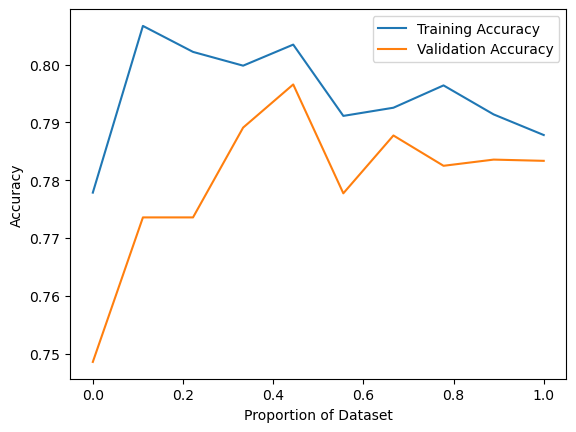

In [111]:
# Plot the learning curve
# group_size = 5
train_recall_list_3 = [sum(train_recall_list_2[i:i+group_size]) / group_size for i in range(0, len(train_recall_list_2), group_size)]
# del train_recall_list_3[0]

plt.plot(np.linspace(0, 1, 10), train_recall_list_3, label='Training Accuracy')
val_recall_list_3 = [sum(val_recall_list_2[i:i+group_size]) / group_size for i in range(0, len(val_recall_list_2), group_size)]
# del val_recall_list_3[0]
plt.plot(np.linspace(0, 1, 10), val_recall_list_3, label='Validation Accuracy')
plt.xlabel('Proportion of Dataset')
plt.ylabel('Accuracy')
plt.legend()
plt.show()


# 4.0 KNN

In [131]:
def knn(x_train, y_train, weights = 'uniform', metric='euclidean', n_neighbors=3, algorithm = 'kd_tree', num_folds = 5):
    np.random.seed(42)
    knn_classifier = KNeighborsClassifier(n_neighbors=n_neighbors, weights = weights, metric = metric)
    validation, training = strat_kfold(knn_classifier, num_folds, x_train, y_train)
    return(validation,training)

In [132]:
# Calling data ingestion function and calling the function to split dataset
wine,aq = data_ingestion()
x_train_w, x_test_w, y_train_w, y_test_w, x_train_a, x_test_a, y_train_a, y_test_a = train_test(wine,aq)

<Figure size 640x480 with 0 Axes>

# 4.1 K Nearest Neighbor - Varying Number of neighbors and the type of weights

0.3933047000082167
0.46382371092336827
12
0.3962943137800803
0.4652818624843056
13
0.4005251747502362
0.45886574024813265
14
0.40147306863994103
0.4606162882254049
15
0.39964979486275387
0.4611951224702603
16
0.403514974659986
0.45594730905918157
17
0.40628640823814377
0.45098848715711526
18
0.407817073258288
0.4530335596177991
19
0.40840104098942387
0.4530356876848758
20
0.4099325835167458
0.44982783937349713
21
0.410297387182492
0.4495337405035006
22
0.4119017096233021
0.44690983379796134
23
0.413870809138732
0.45303909259219854
24
0.41270401709490345
0.44778404375305914
25
0.41255797862764787
0.448950650124492
26
0.4140169539704941
0.44778234129939776
27
0.4158404670678204
0.4527441424953714
28
0.4178822667233588
0.45128343725394227
29
0.41948581802149787
0.4571202996318444
30
0.4227680405504044
0.45303185716413774
31
0.4256851669111721
0.45653167627843627
32
0.42663327352988956
0.45711221297695315
33
0.4270708571091244
0.45594816028601226
34
0.42867512636768135
0.4527381839075568
3

0.4652126904556203
0.47491391968674856
206
0.46550431534097925
0.4725807069438829
207
0.46499381889262303
0.47637207124768577
208
0.4660879373874697
0.47520291119576075
209
0.4661607438920846
0.4717035176948777
210
0.4661608236654645
0.473452788831904
211
0.46565038039936146
0.47287097529314115
212
0.46681722562544326
0.475496584452342
213
0.4668173851722027
0.47520248558234557
214
0.4671092759688278
0.4743274244004171
215
0.467108930284182
0.47461811836309076
216
0.4670361769618202
0.4754944563852652
217
0.46805711667627936
0.47316039241556895
218
0.4673278284383058
0.47607712115085865
219
0.46732769548267294
0.47520248558234557
220
0.4676193469591584
0.47316081802898435
221
0.4682758021013904
0.4734506607648272
222
0.4690778702528522
0.47257474835606816
223
0.4698800181776941
0.47549105147794246
224
0.4694425675540923
0.4775335702581345
225
0.46958823374557546
0.4751999319018536
226
0.4690781361641183
0.47549275393160395
227
0.4679842303982845
0.4728675703858185
228
0.468130082727653

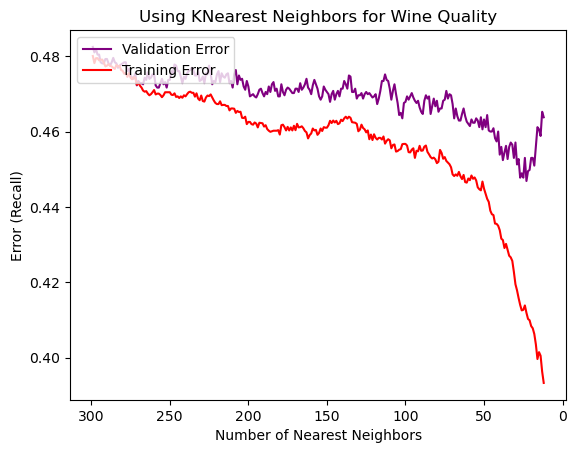

In [240]:
# [WINE QUALITY] Varying number of neighbors and distance metric
acc_w_train = []
acc_w_test = []
list_x = []
for x in range(12,300):
    test,train = knn(x_train_w, y_train_w, weights = 'uniform', metric = 'euclidean', n_neighbors = x, algorithm = 'kd_tree')
    acc_w_train.append(1-train)
    acc_w_test.append(1-test)
    list_x.append(x)
    print(1-train)
    print(1-test)
    print(x)


plt.clf()
plt.title('Using KNearest Neighbors for Wine Quality')
plt.xlabel("Number of Nearest Neighbors")
plt.ylabel("Error (Recall)")
plt.locator_params(axis='x')
plt.locator_params(axis='y')
plt.plot(list_x, acc_w_test, color='purple', label='Validation Error')
plt.plot(list_x, acc_w_train, color='red', label='Training Error')
plt.legend(loc="upper left")
# plt.savefig('Wine Quality_Decision Tree Error.png',
#             bbox_inches='tight')
plt.xlim(reversed(plt.xlim()))
plt.show()

0.05999999999999994
0.11035714285714293
3
0.0742857142857144
0.11499999999999999
4
0.07187500000000002
0.10678571428571426
5
0.08098214285714289
0.11071428571428577
6
0.07883928571428567
0.10678571428571426
7
0.08482142857142849
0.11214285714285699
8
0.08339285714285705
0.1110714285714286
9
0.09008928571428565
0.11428571428571421
10
0.09080357142857154
0.10928571428571432
11
0.09473214285714293
0.11214285714285699
12
0.0959821428571429
0.11464285714285705
13
0.09776785714285707
0.11357142857142866
14
0.09821428571428581
0.11392857142857138
15
0.10008928571428588
0.11214285714285721
16
0.10035714285714281
0.10964285714285715
17
0.10116071428571427
0.11571428571428566
18
0.10089285714285712
0.11285714285714299
19
0.10285714285714287
0.11785714285714288
20
0.10285714285714287
0.11499999999999999
21
0.10464285714285704
0.11714285714285722
22
0.10392857142857148
0.11392857142857138
23
0.10392857142857148
0.11678571428571405
24
0.1038392857142858
0.1132142857142856
25
0.10553571428571418
0.1

0.16723214285714294
0.17285714285714282
197
0.16892857142857154
0.1735714285714286
198
0.16758928571428577
0.1735714285714286
199
0.16892857142857154
0.17321428571428577
200
0.16892857142857132
0.1725000000000001
201
0.17035714285714287
0.175357142857143
202
0.17035714285714287
0.1746428571428572
203
0.17169642857142853
0.175357142857143
204
0.17098214285714286
0.1735714285714286
205
0.17223214285714283
0.17428571428571438
206
0.17116071428571433
0.175357142857143
207
0.17267857142857146
0.17500000000000004
208
0.17214285714285715
0.17535714285714277
209
0.17321428571428577
0.1746428571428572
210
0.17321428571428577
0.17571428571428582
211
0.17446428571428574
0.1757142857142856
212
0.17348214285714292
0.175357142857143
213
0.1746428571428572
0.17607142857142866
214
0.17375000000000007
0.1757142857142856
215
0.17544642857142867
0.17642857142857138
216
0.1747321428571429
0.1775
217
0.17669642857142853
0.17785714285714282
218
0.17562499999999992
0.1775
219
0.1775
0.17821428571428588
220
0

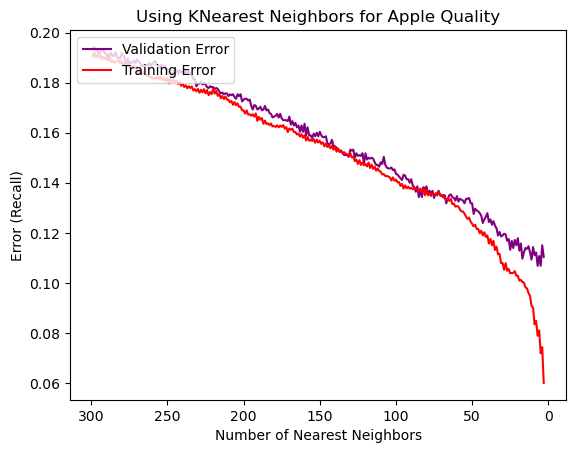

In [103]:
# [APPLE QUALITY] Varying number of neighbors and distance metric
acc_w_train = []
acc_w_test = []
list_x = []
for x in range(3,300):
    test,train = knn(x_train_a, y_train_a, weights = 'uniform', metric = 'euclidean', n_neighbors = x, algorithm = 'kd_tree')
    acc_w_train.append(1-train)
    acc_w_test.append(1-test)
    list_x.append(x)
    print(1-train)
    print(1-test)
    print(x)


plt.clf()
plt.title('Using KNearest Neighbors for Apple Quality')
plt.xlabel("Number of Nearest Neighbors")
plt.ylabel("Error (Recall)")
plt.locator_params(axis='x')
plt.locator_params(axis='y')
plt.plot(list_x, acc_w_test, color='purple', label='Validation Error')
plt.plot(list_x, acc_w_train, color='red', label='Training Error')
plt.legend(loc="upper left")
# plt.savefig('Wine Quality_Decision Tree Error.png',
#             bbox_inches='tight')
plt.xlim(reversed(plt.xlim()))
plt.show()

0.3202297579702249
0.46586410163648373
5
0.3460468434604309
0.46556574663233385
6
0.35312058836590343
0.45798429486497416
7
0.36085076182248144
0.4547819795279947
8
0.36821645070683195
0.45711136175012235
9
0.37696788297138817
0.45448958311165977
10
0.38192667603206143
0.4550713966504224
11
0.38674062722617575
0.46119682492392167
12
0.3916270658313863
0.45974037581664573
13
0.3968054218243481
0.46003490030005745
14
0.39629447332683976
0.4579953608137728
15
0.40015954675956544
0.4553676235874955
16
0.39972209613596354
0.45595454448724226
17
0.4012540375301843
0.4541967610819093
18
0.403514974659986
0.45157370560320065
19
0.40621301672874366
0.4521606265029473
20
0.4065049872987484
0.4498231576259284
21
0.4086922138256308
0.44807260964865614
22
0.4097133396779762
0.4439892745419336
23
0.41241217948053166
0.45040539677810654
24
0.4127767172350121
0.45040284309761447
25
0.413287160501115
0.45098933838394584
26
0.4148189689397027
0.44836202677108383
27
0.4138705698185927
0.44282437062416213

0.4624414164242221
0.46382626460386034
200
0.4620769052608683
0.4658666553169757
201
0.4618580868801243
0.46674256772573475
202
0.4620767191229822
0.46615820050647994
203
0.46156611631011957
0.4658653784767297
204
0.46207677230523525
0.46615777489306465
205
0.46178517401100283
0.4644063756889617
206
0.4635353487811824
0.46557213083356397
207
0.4611288518244039
0.46469792087846606
208
0.46251440906672325
0.46820071928667195
209
0.4619310263403723
0.4679087484837521
210
0.46331663676494483
0.47082717967270327
211
0.46222257145235157
0.4684926900895917
212
0.46273314767408746
0.4699529697176055
213
0.4625873219358446
0.4696618501415164
214
0.46178509423762315
0.4725790044902215
215
0.46273322744746725
0.47228575684705576
216
0.4623685833284805
0.47082760528611856
217
0.46266018162271294
0.4699521184907748
218
0.4623683174172144
0.4708259028324573
219
0.46287900000345683
0.4737430571811624
220
0.46389980676228304
0.4734519376050732
221
0.46499381889262315
0.4760792492179353
222
0.464702220

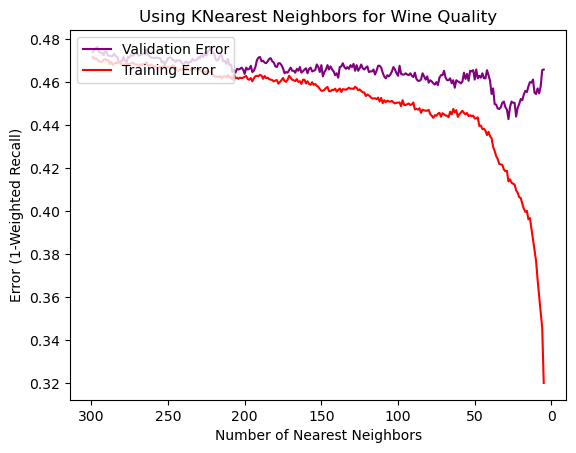

In [108]:
# [WINE QUALITY] Varying number of neighbors and distance metric
acc_w_train = []
acc_w_test = []
list_x = []
for x in range(5,300):
    test,train = knn(x_train_w, y_train_w, weights = 'uniform', metric = 'manhattan', n_neighbors = x, algorithm = 'kd_tree')
    acc_w_train.append(1-train)
    acc_w_test.append(1-test)
    list_x.append(x)
    print(1-train)
    print(1-test)
    print(x)


plt.clf()
plt.title('Using KNearest Neighbors for Wine Quality')
plt.xlabel("Number of Nearest Neighbors")
plt.ylabel("Error (1-Weighted Recall)")
plt.locator_params(axis='x')
plt.locator_params(axis='y')
plt.plot(list_x, acc_w_test, color='purple', label='Validation Error')
plt.plot(list_x, acc_w_train, color='red', label='Training Error')
plt.legend(loc="upper left")
# plt.savefig('Wine Quality_Decision Tree Error.png',
#             bbox_inches='tight')
plt.xlim(reversed(plt.xlim()))
plt.show()

0.06339285714285714
0.1110714285714286
3
0.0803571428571429
0.12571428571428567
4
0.0786607142857143
0.11785714285714288
5
0.08580357142857142
0.11749999999999994
6
0.08580357142857142
0.11464285714285727
7
0.09401785714285715
0.11928571428571433
8
0.09258928571428571
0.1189285714285715
9
0.09580357142857143
0.11964285714285716
10
0.0971428571428572
0.11964285714285727
11
0.10107142857142859
0.12142857142857155
12
0.0992857142857142
0.11999999999999988
13
0.10401785714285716
0.12178571428571439
14
0.10276785714285719
0.11571428571428588
15
0.10812500000000003
0.12214285714285711
16
0.10696428571428562
0.12035714285714294
17
0.11008928571428578
0.12250000000000016
18
0.10910714285714307
0.11678571428571449
19
0.11223214285714289
0.1210714285714285
20
0.10839285714285707
0.11785714285714288
21
0.1126785714285713
0.12321428571428572
22
0.11035714285714282
0.12321428571428561
23
0.11401785714285706
0.12285714285714278
24
0.11205357142857131
0.11928571428571433
25
0.11616071428571428
0.1257

0.1730357142857143
0.17714285714285727
199
0.17446428571428574
0.17821428571428566
200
0.17419642857142859
0.1785714285714285
201
0.1745535714285713
0.1796428571428571
202
0.17500000000000004
0.17821428571428566
203
0.17544642857142845
0.17892857142857144
204
0.1746428571428572
0.17785714285714282
205
0.17669642857142853
0.17928571428571427
206
0.1746428571428572
0.17928571428571427
207
0.17598214285714275
0.17892857142857144
208
0.17535714285714277
0.17821428571428566
209
0.17651785714285706
0.18071428571428572
210
0.1752678571428572
0.17964285714285722
211
0.1762499999999999
0.18107142857142866
212
0.1762499999999999
0.18000000000000005
213
0.17758928571428567
0.18035714285714288
214
0.1774107142857142
0.18035714285714288
215
0.17839285714285713
0.18107142857142866
216
0.17732142857142852
0.1792857142857145
217
0.17830357142857145
0.1814285714285715
218
0.17732142857142852
0.18071428571428572
219
0.17892857142857144
0.18142857142857127
220
0.17785714285714282
0.18142857142857127
221


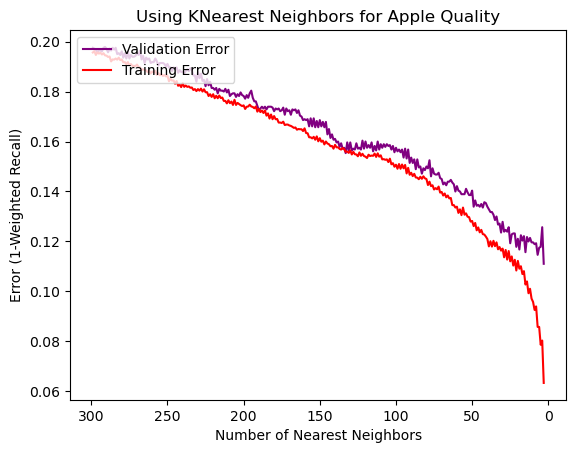

In [73]:
# [APPLE QUALITY] Varying number of neighbors and distance metric
acc_w_train = []
acc_w_test = []
list_x = []
for x in range(10,300,1):
    test,train = knn(x_train_a, y_train_a, weights = 'uniform', metric = 'manhattan', n_neighbors = x, algorithm = 'kd_tree')
    acc_w_train.append(1-train)
    acc_w_test.append(1-test)
    list_x.append(x)
    print(1-train)
    print(1-test)
    print(x)


plt.clf()
plt.title('Using KNearest Neighbors for Apple Quality')
plt.xlabel("Number of Nearest Neighbors")
plt.ylabel("Error (1-Weighted Recall)")
plt.locator_params(axis='x')
plt.locator_params(axis='y')
plt.plot(list_x, acc_w_test, color='purple', label='Validation Error')
plt.plot(list_x, acc_w_train, color='red', label='Training Error')
plt.legend(loc="upper left")
# plt.savefig('Wine Quality_Decision Tree Error.png',
#             bbox_inches='tight')
plt.xlim(reversed(plt.xlim()))
plt.show()

# 4.2 Using GridSearchCV to identify the best results for comparison between the 2 dataset

In [293]:
# Wine Quality
start_time = time.time()

clf = KNeighborsClassifier()
params_grid = {
    'n_neighbors': list(range(25, 1300, 25)),
    'metric': ['manhattan','euclidean'],
    'weights': ['uniform','distance']
}

stratified_kfold = StratifiedKFold(n_splits=5, shuffle=True, random_state=42)

recall_scorer = make_scorer(recall_score, average='micro')  # 'macro' is used for multiclass problems

grid_search  = GridSearchCV(estimator=clf, param_grid=params_grid, scoring=recall_scorer, cv=stratified_kfold, verbose=1)
grid_search.fit(x_train_w, y_train_w)

# Print the best parameters and corresponding accuracy
print("Best Parameters: ", grid_search.best_params_)
print("Best Accuracy: {:.2f}%".format(grid_search.best_score_ * 100))

# Get the best model
best_model = grid_search.best_estimator_

# Evaluate the best model on the test set
test_accuracy = best_model.score(x_test_w, y_test_w)
print("Test Accuracy: {:.2f}%".format(test_accuracy * 100))

end_time = time.time()

# Calculate the elapsed time
elapsed_time = end_time - start_time

# Print the elapsed time in seconds
print("Elapsed Time: {:.2f} seconds".format(elapsed_time))

Fitting 5 folds for each of 204 candidates, totalling 1020 fits
Best Parameters:  {'metric': 'manhattan', 'n_neighbors': 25, 'weights': 'distance'}
Best Accuracy: 64.70%
Test Accuracy: 67.96%
Elapsed Time: 126.76 seconds


In [294]:
# Apple Quality 
start_time = time.time()

clf = KNeighborsClassifier()
params_grid = {
    'n_neighbors': list(range(3, 200)),
    'metric': ['manhattan','euclidean'],
    'weights': ['uniform','distance']
#     ,
#     'min_samples_split': list(range(0, 20)),
#     'min_samples_leaf': list(range(0, 20))
}

recall_scorer = make_scorer(recall_score, average='micro')  # 'macro' is used for multiclass problems


stratified_kfold = StratifiedKFold(n_splits=5, shuffle=True, random_state=42)

grid_search  = GridSearchCV(estimator=clf, param_grid=params_grid, scoring=recall_scorer, cv=stratified_kfold, verbose=1)
grid_search.fit(x_train_a, y_train_a)

# Print the best parameters and corresponding accuracy
print("Best Parameters: ", grid_search.best_params_)
print("Best Accuracy: {:.2f}%".format(grid_search.best_score_ * 100))

# Get the best model
best_model = grid_search.best_estimator_

# Evaluate the best model on the test set
test_accuracy = best_model.score(x_test_a, y_test_a)
print("Test Accuracy: {:.2f}%".format(test_accuracy * 100))

end_time = time.time()

# Calculate the elapsed time
elapsed_time = end_time - start_time

# Print the elapsed time in seconds
print("Elapsed Time: {:.2f} seconds".format(elapsed_time))

Fitting 5 folds for each of 788 candidates, totalling 3940 fits
Best Parameters:  {'metric': 'euclidean', 'n_neighbors': 4, 'weights': 'distance'}
Best Accuracy: 89.96%
Test Accuracy: 89.17%
Elapsed Time: 128.54 seconds


# 4.3 KNN further experimentation - Could this be due to multi class issue? What happens if we create a binary field instead as the target variable?

In [246]:
def dataframe_cleanup_wine(df):
    # Define the values you want to drop
    values_to_drop = []

    # Drop rows where the 'column_name' has values in 'values_to_drop'
    df = df[~df['quality'].isin(values_to_drop)]
    
    return(df)

def categorize(value):
    return 'Good' if value >= 3 else 'Bad'

wine,aq = data_ingestion()
wine = dataframe_cleanup_wine(wine)

# Apply the function to the 'values' column
wine['category'] = wine['quality'].apply(lambda x: categorize(x))
wine = wine.drop(['quality'], axis = 1) 
new_headers = {'category': 'quality'}

# Rename the columns
wine = wine.rename(columns=new_headers)

x_train_w, x_test_w, y_train_w, y_test_w, x_train_a, x_test_a, y_train_a, y_test_a = train_test(wine,aq)

start_time = time.time()

clf = KNeighborsClassifier()
params_grid = {
    'n_neighbors': list(range(75, 1300, 25)),
    'metric': ['manhattan','euclidean'],
    'weights': ['uniform','distance']
}


stratified_kfold = StratifiedKFold(n_splits=5, shuffle=True, random_state=42)

recall_scorer = make_scorer(recall_score, average='micro')  # 'macro' is used for multiclass problems

grid_search  = GridSearchCV(estimator=clf, param_grid=params_grid, scoring=recall_scorer, cv=stratified_kfold, verbose=1)

grid_search.fit(x_train_w, y_train_w)

# Print the best parameters and corresponding accuracy
print("Best Parameters: ", grid_search.best_params_)
print("Best Accuracy: {:.2f}%".format(grid_search.best_score_ * 100))

# Get the best model
best_model = grid_search.best_estimator_

# Evaluate the best model on the test set
test_accuracy = best_model.score(x_test_w, y_test_w)
print("Test Accuracy: {:.2f}%".format(test_accuracy * 100))

end_time = time.time()

# Calculate the elapsed time
elapsed_time = end_time - start_time

# Print the elapsed time in seconds
print("Elapsed Time: {:.2f} seconds".format(elapsed_time))

Fitting 5 folds for each of 196 candidates, totalling 980 fits
Best Parameters:  {'metric': 'manhattan', 'n_neighbors': 75, 'weights': 'distance'}
Best Accuracy: 80.92%
Test Accuracy: 83.27%
Elapsed Time: 119.61 seconds


<Figure size 640x480 with 0 Axes>

# 4.4 KNN further experimentation - Could this be due unbalanced dataset classes? What happens if we try to make the number of observation per class more consistent?

In [247]:
def dataframe_cleanup_wine(df):
    # Removing all other values except class 5, 6
    values_to_drop = [4,5,6]

    # Drop rows where the 'column_name' has values in 'values_to_drop'
    df = df[~df['quality'].isin(values_to_drop)]
    
    return(df)

def categorize(value):
    return 'Good' if value >= 3 else 'Bad'

wine,aq = data_ingestion()
wine = dataframe_cleanup_wine(wine)

# Apply the function to the 'values' column
wine['category'] = wine['quality'].apply(lambda x: categorize(x))
wine = wine.drop(['quality'], axis = 1) 
new_headers = {'category': 'quality'}

# Rename the columns
wine = wine.rename(columns=new_headers)

x_train_w, x_test_w, y_train_w, y_test_w, x_train_a, x_test_a, y_train_a, y_test_a = train_test(wine,aq)

start_time = time.time()

clf = KNeighborsClassifier()
params_grid = {
    'n_neighbors': list(range(75, 1300, 25)),
    'metric': ['manhattan','euclidean'],
    'weights': ['uniform','distance']
}

recall_scorer = make_scorer(recall_score, average='micro')  # 'macro' is used for multiclass problems

stratified_kfold = StratifiedKFold(n_splits=5, shuffle=True, random_state=42)

grid_search  = GridSearchCV(estimator=clf, param_grid=params_grid, scoring=recall_scorer, cv=stratified_kfold, verbose=1)

grid_search.fit(x_train_w, y_train_w)

# Print the best parameters and corresponding accuracy
print("Best Parameters: ", grid_search.best_params_)
print("Best Accuracy: {:.2f}%".format(grid_search.best_score_ * 100))

# Get the best model
best_model = grid_search.best_estimator_

# Evaluate the best model on the test set
test_accuracy = best_model.score(x_test_w, y_test_w)
print("Test Accuracy: {:.2f}%".format(test_accuracy * 100))

end_time = time.time()

# Calculate the elapsed time
elapsed_time = end_time - start_time

# Print the elapsed time in seconds
print("Elapsed Time: {:.2f} seconds".format(elapsed_time))

Fitting 5 folds for each of 196 candidates, totalling 980 fits
Best Parameters:  {'metric': 'manhattan', 'n_neighbors': 100, 'weights': 'distance'}
Best Accuracy: 76.84%
Test Accuracy: 79.34%
Elapsed Time: 78.67 seconds


<Figure size 640x480 with 0 Axes>

# 4.5 Final Run of Wine Quality and Apple Quality Including Learning Curves

In [82]:
# Wine Quality

wine,aq = data_ingestion()
x_train_w, x_test_w, y_train_w, y_test_w, x_train_a, x_test_a, y_train_a, y_test_a = train_test(wine,aq)
start_time = time.time()
test,train = knn(x_train_w, y_train_w, weights = 'distance', metric = 'manhattan', n_neighbors = 200, algorithm = 'kd_tree')
# {'metric': 'manhattan', 'n_neighbors': 200, 'weights': 'distance'}

print('Best accuracy:', test)
end_time = time.time()
# Calculate the elapsed time
elapsed_time = end_time - start_time
print("Elapsed Time: {:.2f} seconds".format(elapsed_time))

Best accuracy: 0.6467319273903513
Elapsed Time: 1.60 seconds


<Figure size 640x480 with 0 Axes>

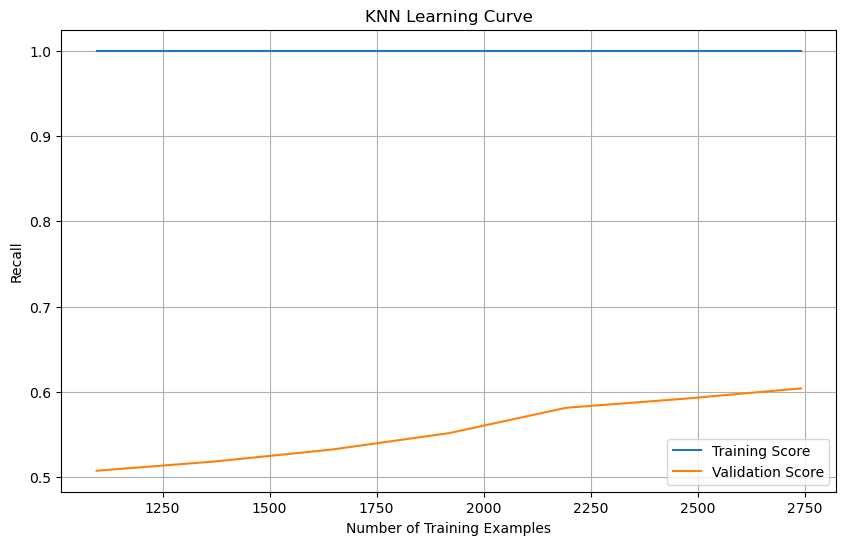

In [169]:
clf = KNeighborsClassifier(n_neighbors=1000, weights = 'distance', metric = 'manhattan')

stratified_kfold = StratifiedKFold(n_splits=5, shuffle=True,random_state = 42)

recall_scorer = make_scorer(recall_score, average='micro')  # 'macro' is used for multiclass problems

train_sizes, train_scores, test_scores = learning_curve(
    clf, x_train_w, y_train_w, cv=stratified_kfold, scoring=recall_scorer, train_sizes=np.linspace(0.1, 1.0, 10)
)


# Calculate mean and standard deviation for training and test scores
train_scores_mean = np.mean(train_scores, axis=1)
train_scores_std = np.std(train_scores, axis=1)
test_scores_mean = np.mean(test_scores, axis=1)
test_scores_std = np.std(test_scores, axis=1)

# Plot the learning curve
plt.figure(figsize=(10, 6))
plt.plot(train_sizes, train_scores_mean, label='Training Score')
# plt.fill_between(train_sizes, train_scores_mean - train_scores_std, train_scores_mean + train_scores_std, alpha=0.2)
plt.plot(train_sizes, test_scores_mean, label='Validation Score')
# plt.fill_between(train_sizes, test_scores_mean - test_scores_std, test_scores_mean + test_scores_std, alpha=0.2)

# Customize the plot
plt.title('KNN Learning Curve')
plt.xlabel('Number of Training Examples')
plt.ylabel('Recall')
plt.legend()
plt.grid(True)
plt.show()

In [248]:
# Apple Quality

wine,aq = data_ingestion()
x_train_w, x_test_w, y_train_w, y_test_w, x_train_a, x_test_a, y_train_a, y_test_a = train_test(wine,aq)
start_time = time.time()
test,train = knn(x_train_a, y_train_a, weights = 'distance', metric = 'euclidean', n_neighbors = 4, algorithm = 'kd_tree')
# {'metric': 'manhattan', 'n_neighbors': 200, 'weights': 'distance'}

print('Best accuracy:', test)
end_time = time.time()
# Calculate the elapsed time
elapsed_time = end_time - start_time
print("Elapsed Time: {:.2f} seconds".format(elapsed_time))

Best accuracy: 0.8996428571428572
Elapsed Time: 0.20 seconds


<Figure size 640x480 with 0 Axes>

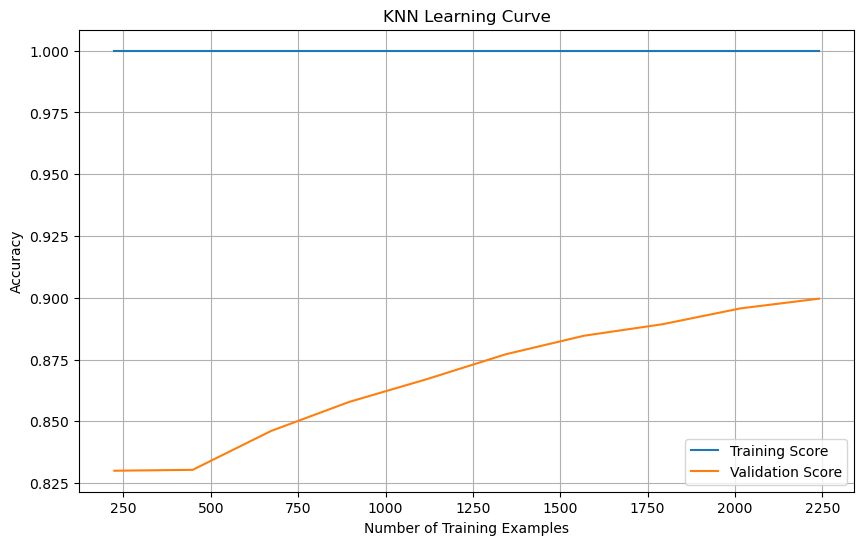

In [107]:
clf = KNeighborsClassifier(n_neighbors=4, weights = 'distance', metric = 'euclidean')

stratified_kfold = StratifiedKFold(n_splits=5, shuffle=True,random_state = 42)

recall_scorer = make_scorer(recall_score, average='micro')  # 'macro' is used for multiclass problems

train_sizes, train_scores, test_scores = learning_curve(
    clf, x_train_a, y_train_a, cv=stratified_kfold, scoring= recall_scorer, train_sizes=np.linspace(0.1, 1.0, 10)
)

# Calculate mean and standard deviation for training and test scores
train_scores_mean = np.mean(train_scores, axis=1)
train_scores_std = np.std(train_scores, axis=1)
test_scores_mean = np.mean(test_scores, axis=1)
test_scores_std = np.std(test_scores, axis=1)

# Plot the learning curve
plt.figure(figsize=(10, 6))
plt.plot(train_sizes, train_scores_mean, label='Training Score')
# plt.fill_between(train_sizes, train_scores_mean - train_scores_std, train_scores_mean + train_scores_std, alpha=0.2)
plt.plot(train_sizes, test_scores_mean, label='Validation Score')
# plt.fill_between(train_sizes, test_scores_mean - test_scores_std, test_scores_mean + test_scores_std, alpha=0.2)

# Customize the plot
plt.title('KNN Learning Curve')
plt.xlabel('Number of Training Examples')
plt.ylabel('Accuracy')
plt.legend()
plt.grid(True)
plt.show()

# 5.0 SVM

In [95]:
def sv_classifier(x_train, y_train, 
                  kernel = 'linear', 
                  c = 1, 
                  num_folds = 5, 
                  decision_function_shape='ovr', 
                  degree = 3, 
#                   gamma = 'scale',
                  class_weight = None):
    
    svm_classifier = SVC(kernel=kernel, 
                         C=c, 
                         decision_function_shape = decision_function_shape, 
                         random_state = 42, 
                         degree = degree, 
                         class_weight = class_weight,
#                          gamma = gamma,
                        )
    validation, training = strat_kfold(svm_classifier, num_folds, x_train, y_train)
    return(validation, training)

In [83]:
# Calling data ingestion function and calling the function to split dataset
wine,aq = data_ingestion()
x_train_w, x_test_w, y_train_w, y_test_w, x_train_a, x_test_a, y_train_a, y_test_a = train_test(wine,aq)
# x_train_w = x_train_w.drop([
#                             'fixed acidity', 
#                             'volatile acidity', 
#                             'citric acid',
# #                             'residual sugar', 
#                             'chlorides', 
#                             'free sulfur dioxide', 
#                             'total sulfur dioxide', 
# #                             'density',
#                             'pH',
#                             'sulphates' 
# #                             'alcohol'
#                            ], axis = 1)


<Figure size 640x480 with 0 Axes>

# 5.1 SVM - Varying number of C and the type of kernel

0.40541065607488913
0.437858313294035
5
0.38017772445370523
0.4381481560298781
10
0.3627475866558282
0.4361077653167629
15
0.35071411800025154
0.43406652337681684
20
0.3410874919860992
0.4384426805132897
25
0.330366774068227
0.43873507692962477
30
0.32146940970092164
0.43815113532378525
35
0.3160725278296084
0.43610861654359345
40
0.30994675658722026
0.43844225489987443
45


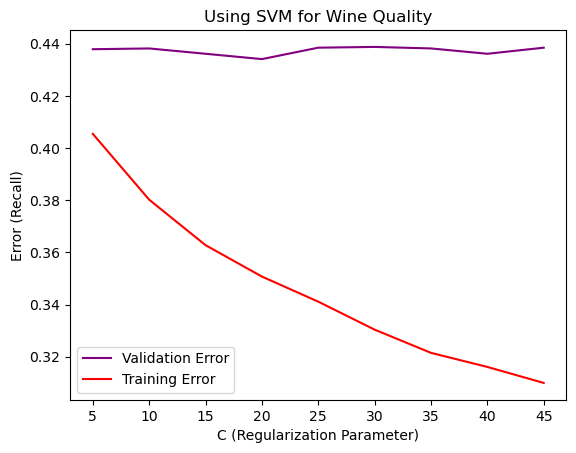

In [62]:
# [WINE QUALITY] Varying C
acc_w_train = []
acc_w_test = []
list_x = []
for x in range(5,50,5):
    test,train = sv_classifier(x_train_w, y_train_w, 
                               kernel = 'rbf', 
                               c = x/10,
                               num_folds = 5, 
                               decision_function_shape='ovr', 
#                                degree = x, 
                               gamma = 'auto',
                               class_weight = None)
    acc_w_train.append(1-train)
    acc_w_test.append(1-test)
    list_x.append(x)
    print(1-train)
    print(1-test)
    print(x)


plt.clf()
plt.title('Using SVM for Wine Quality')
plt.xlabel("C (Regularization Parameter)")
plt.ylabel("Error (Recall)")
plt.locator_params(axis='x')
plt.locator_params(axis='y')
plt.plot(list_x, acc_w_test, color='purple', label='Validation Error')
plt.plot(list_x, acc_w_train, color='red', label='Training Error')
plt.legend(loc="lower left")
# plt.savefig('Wine Quality_Decision Tree Error.png',
#             bbox_inches='tight')
plt.show()

In [ ]:
# Key take away: tried macro average - doesnt work; high recall rates. 
# but micro works and this also means that the weights of the classes are not taken in to consideration
# meaning svm does not work with imbalance non-linear classes

In [69]:
# Random search to identify breakdown.
# Define the parameter distribution
param_dist = {
    'kernel': ['poly', 'linear', 'rbf'],
    'C': range(1, 20),
    'gamma': ['scale', 'auto'],
    'degree': range(3,20),
    'decision_function_shape': ['ovo', 'ovr'],
    'class_weight': [None,'balanced']
}
recall_scorer = make_scorer(recall_score, average='micro')  # 'macro' is used for multiclass problems

clf = SVC(random_state = 42)

# Create the RandomizedSearchCV object
random_search = RandomizedSearchCV(
    clf,
    param_distributions=param_dist,
    n_iter=10,  # Number of random parameter combinations to try
    scoring=recall_scorer,  # Use an appropriate scoring metric
    cv=5,  # Number of cross-validation folds
    verbose=1,
    n_jobs=-1,  # Use all available CPU cores
    random_state = 42
)

random_search.fit(x_train_w, y_train_w)
print("Best Parameters: ", random_search.best_params_)
print("Best Accuracy: {:.2f}%".format(random_search.best_score_ * 100))

Fitting 5 folds for each of 10 candidates, totalling 50 fits
Best Parameters:  {'kernel': 'rbf', 'gamma': 'scale', 'degree': 10, 'decision_function_shape': 'ovo', 'class_weight': None, 'C': 3}
Best Accuracy: 57.38%


0.06605420767164705
0.09929025607105046
5
0.05034487105507801
0.09571623089215786
10
0.043829213187289495
0.09393944984721014
15
0.03954323931539583
0.09536675941566308
20
0.035526560529416606
0.09429788189718169
25
0.032671716521008975
0.09143818798709158
30
0.0299927347488399
0.09249942145763512
35
0.027762094821402905
0.09393055305005704
40
0.02615574119060171
0.09357722310597993
45


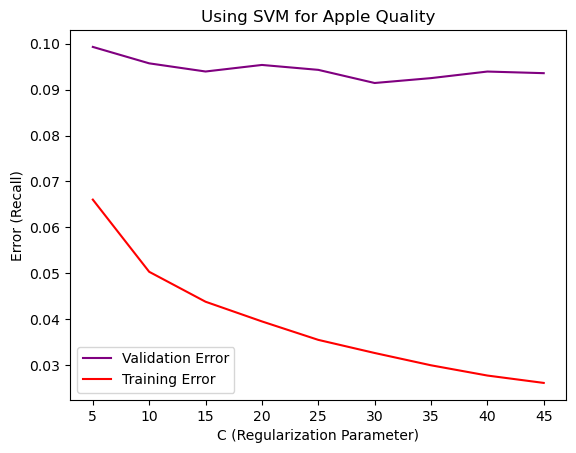

In [67]:
# [APPLE QUALITY] Varying C
acc_w_train = []
acc_w_test = []
list_x = []
for x in range(5,50,5):
    test,train = sv_classifier(x_train_a, y_train_a, 
                           kernel = 'rbf', 
                           c = x/10,
                           num_folds = 5, 
                           decision_function_shape='ovr', 
#                                degree = x, 
                           gamma = 'auto',
                           class_weight = None)
    acc_w_train.append(1-train)
    acc_w_test.append(1-test)
    list_x.append(x)
    print(1-train)
    print(1-test)
    print(x)


plt.clf()
plt.title('Using SVM for Apple Quality')
plt.xlabel("C (Regularization Parameter)")
plt.ylabel("Error (Recall)")
plt.locator_params(axis='x')
plt.locator_params(axis='y')
plt.plot(list_x, acc_w_test, color='purple', label='Validation Error')
plt.plot(list_x, acc_w_train, color='red', label='Training Error')
plt.legend(loc="lower left")
# plt.savefig('Wine Quality_Decision Tree Error.png',
#             bbox_inches='tight')
plt.show()

0.3572771271372286
0.4845336341001468
3
0.2910582816335354
0.475786427188185
4
0.24956163198253056
0.45856951331105966
5
0.24897854175857226
0.47141324934561935
6


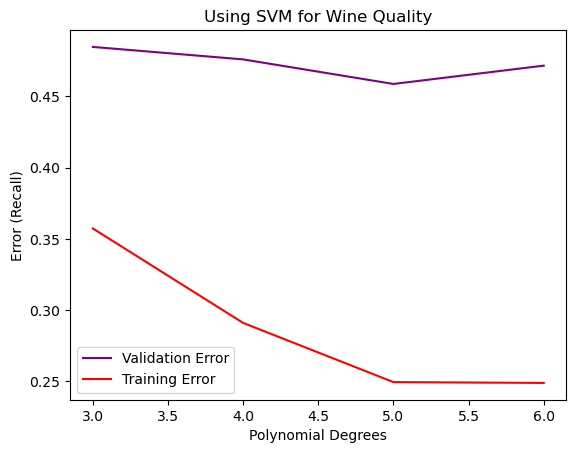

In [85]:
# [Wine QUALITY] Varying polynomial degree
acc_w_train = []
acc_w_test = []
list_x = []
for x in range(3,7):
    test,train = sv_classifier(x_train_w, y_train_w, 
                               kernel = 'poly', 
                               c = 10,
                               num_folds = 5, 
                               decision_function_shape='ovr', 
                               degree = x, 
                               gamma = 'auto',
                               class_weight = None)
    acc_w_train.append(1-train)
    acc_w_test.append(1-test)
    list_x.append(x)
    print(1-train)
    print(1-test)
    print(x)


plt.clf()
plt.title('Using SVM for Wine Quality')
plt.xlabel("Polynomial Degrees")
plt.ylabel("Error (Recall)")
plt.locator_params(axis='x')
plt.locator_params(axis='y')
plt.plot(list_x, acc_w_test, color='purple', label='Validation Error')
plt.plot(list_x, acc_w_train, color='red', label='Training Error')
plt.legend(loc="lower left")
# plt.savefig('Wine Quality_Decision Tree Error.png',
#             bbox_inches='tight')
plt.show()

0.2538392857142857
0.25428571428571434
1
0.156875
0.16821428571428565
2
0.11008928571428578
0.12428571428571433
3
0.09008928571428565
0.1489285714285714
4
0.04035714285714287
0.15214285714285702
5
0.028839285714285623
0.17785714285714282
6


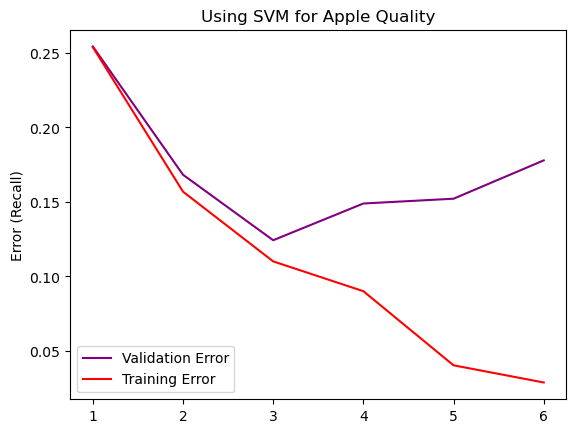

In [82]:
# [Apple QUALITY] Varying polynomial degree
acc_w_train = []
acc_w_test = []
list_x = []
for x in range(1,7):
    test,train = sv_classifier(x_train_a, y_train_a, 
                               kernel = 'poly', 
                               c = 1,
                               num_folds = 5, 
                               decision_function_shape='ovr', 
                               degree = x, 
                               gamma = 'auto',
                               class_weight = None)
    acc_w_train.append(1-train)
    acc_w_test.append(1-test)
    list_x.append(x)
    print(1-train)
    print(1-test)
    print(x)


plt.clf()
plt.title('Using SVM for Apple Quality')
plt.xlabel("")
plt.ylabel("Error (Recall)")
plt.locator_params(axis='x')
plt.locator_params(axis='y')
plt.plot(list_x, acc_w_test, color='purple', label='Validation Error')
plt.plot(list_x, acc_w_train, color='red', label='Training Error')
plt.legend(loc="lower left")
# plt.savefig('Wine Quality_Decision Tree Error.png',
#             bbox_inches='tight')
plt.show()

# 5.2 Using GridSearchCV to identify the best results for comparison between the 2 dataset

In [88]:
# Wine Quality
start_time = time.time()

clf = SVC(random_state=42)
#     kernel=kernel, 
#      C=c, 
#      decision_function_shape = decision_function_shape, 
#      random_state = 42, 
#      degree = degree, 
#      class_weight = class_weight,
#      gamma = gamma,
#     )
params_grid = {
    'kernel': ['poly', 'rbf'],
    'C': range(1, 5),
#     'gamma': ['scale', 'auto'],
    'degree': range(1,8),
#     'decision_function_shape': ['ovo', 'ovr'],
    'class_weight': [None,'balanced']
}

stratified_kfold = StratifiedKFold(n_splits=5, shuffle=True, random_state=42)

recall_scorer = make_scorer(recall_score, average='micro')  # 'macro' is used for multiclass problems

grid_search  = GridSearchCV(estimator=clf, param_grid=params_grid, scoring=recall_scorer, cv=stratified_kfold, verbose=1)
grid_search.fit(x_train_w, y_train_w)

# Print the best parameters and corresponding accuracy
print("Best Parameters: ", grid_search.best_params_)
print("Best Accuracy: {:.2f}%".format(grid_search.best_score_ * 100))

# Get the best model
best_model = grid_search.best_estimator_

# Evaluate the best model on the test set
test_accuracy = best_model.score(x_test_w, y_test_w)
print("Test Accuracy: {:.2f}%".format(test_accuracy * 100))

end_time = time.time()

# Calculate the elapsed time
elapsed_time = end_time - start_time

# Print the elapsed time in seconds
print("Elapsed Time: {:.2f} seconds".format(elapsed_time))

Fitting 5 folds for each of 112 candidates, totalling 560 fits
Best Parameters:  {'C': 2, 'class_weight': None, 'degree': 1, 'kernel': 'rbf'}
Best Accuracy: 56.56%
Test Accuracy: 57.21%
Elapsed Time: 265.98 seconds


In [91]:
# Apple Quality
start_time = time.time()

clf = SVC(random_state=42)
#     kernel=kernel, 
#      C=c, 
#      decision_function_shape = decision_function_shape, 
#      random_state = 42, 
#      degree = degree, 
#      class_weight = class_weight,
#      gamma = gamma,
#     )
params_grid = {
    'kernel': ['poly', 'rbf'],
    'C': range(1, 5),
#     'gamma': ['scale', 'auto'],
    'degree': range(1,8),
#     'decision_function_shape': ['ovo', 'ovr'],
    'class_weight': [None,'balanced']
}

stratified_kfold = StratifiedKFold(n_splits=5, shuffle=True, random_state=42)

recall_scorer = make_scorer(recall_score, average='micro')  # 'macro' is used for multiclass problems

grid_search  = GridSearchCV(estimator=clf, param_grid=params_grid, scoring=recall_scorer, cv=stratified_kfold, verbose=1)
grid_search.fit(x_train_a, y_train_a)

# Print the best parameters and corresponding accuracy
print("Best Parameters: ", grid_search.best_params_)
print("Best Accuracy: {:.2f}%".format(grid_search.best_score_ * 100))

# Get the best model
best_model = grid_search.best_estimator_

# Evaluate the best model on the test set
test_accuracy = best_model.score(x_test_a, y_test_a)
print("Test Accuracy: {:.2f}%".format(test_accuracy * 100))

end_time = time.time()

# Calculate the elapsed time
elapsed_time = end_time - start_time

# Print the elapsed time in seconds
print("Elapsed Time: {:.2f} seconds".format(elapsed_time))

Fitting 5 folds for each of 112 candidates, totalling 560 fits
Best Parameters:  {'C': 4, 'class_weight': 'balanced', 'degree': 1, 'kernel': 'rbf'}
Best Accuracy: 89.68%
Test Accuracy: 90.50%
Elapsed Time: 63.76 seconds


# 5.3 SVM further experimentation - Could this be due to multi class issue? What happens if we create a binary field instead as the target variable?


In [92]:
def dataframe_cleanup_wine(df):
    # Define the values you want to drop
    values_to_drop = []

    # Drop rows where the 'column_name' has values in 'values_to_drop'
    df = df[~df['quality'].isin(values_to_drop)]
    
    return(df)

def categorize(value):
    return 'Good' if value >= 3 else 'Bad'

wine,aq = data_ingestion()
wine = dataframe_cleanup_wine(wine)

# Apply the function to the 'values' column
wine['category'] = wine['quality'].apply(lambda x: categorize(x))
wine = wine.drop(['quality'], axis = 1) 
new_headers = {'category': 'quality'}

# Rename the columns
wine = wine.rename(columns=new_headers)

x_train_w, x_test_w, y_train_w, y_test_w, x_train_a, x_test_a, y_train_a, y_test_a = train_test(wine,aq)

start_time = time.time()

clf = SVC(random_state=42)
params_grid = {
    'kernel': ['poly', 'rbf'],
    'C': range(1, 5),
#     'gamma': ['scale', 'auto'],
    'degree': range(1,8),
#     'decision_function_shape': ['ovo', 'ovr'],
    'class_weight': [None,'balanced']
}


stratified_kfold = StratifiedKFold(n_splits=5, shuffle=True, random_state=42)

recall_scorer = make_scorer(recall_score, average='micro')  # 'macro' is used for multiclass problems

grid_search  = GridSearchCV(estimator=clf, param_grid=params_grid, scoring=recall_scorer, cv=stratified_kfold, verbose=1)

grid_search.fit(x_train_w, y_train_w)

# Print the best parameters and corresponding accuracy
print("Best Parameters: ", grid_search.best_params_)
print("Best Accuracy: {:.2f}%".format(grid_search.best_score_ * 100))

# Get the best model
best_model = grid_search.best_estimator_

# Evaluate the best model on the test set
test_accuracy = best_model.score(x_test_w, y_test_w)
print("Test Accuracy: {:.2f}%".format(test_accuracy * 100))

end_time = time.time()

# Calculate the elapsed time
elapsed_time = end_time - start_time

# Print the elapsed time in seconds
print("Elapsed Time: {:.2f} seconds".format(elapsed_time))

Fitting 5 folds for each of 112 candidates, totalling 560 fits
Best Parameters:  {'C': 4, 'class_weight': None, 'degree': 1, 'kernel': 'rbf'}
Best Accuracy: 78.18%
Test Accuracy: 78.98%
Elapsed Time: 150.38 seconds


<Figure size 640x480 with 0 Axes>

# 5.4 SVM further experimentation - Could this be due unbalanced dataset classes? What happens if we try to make the number of observation per class more consistent?

In [93]:
def dataframe_cleanup_wine(df):
    # Removing all other values except class 5, 6
    values_to_drop = [4,5,6]

    # Drop rows where the 'column_name' has values in 'values_to_drop'
    df = df[~df['quality'].isin(values_to_drop)]
    
    return(df)

def categorize(value):
    return 'Good' if value >= 3 else 'Bad'

wine,aq = data_ingestion()
wine = dataframe_cleanup_wine(wine)

# Apply the function to the 'values' column
wine['category'] = wine['quality'].apply(lambda x: categorize(x))
wine = wine.drop(['quality'], axis = 1) 
new_headers = {'category': 'quality'}

# Rename the columns
wine = wine.rename(columns=new_headers)

x_train_w, x_test_w, y_train_w, y_test_w, x_train_a, x_test_a, y_train_a, y_test_a = train_test(wine,aq)

start_time = time.time()

clf = SVC(random_state=42)
params_grid = {
    'kernel': ['poly', 'rbf'],
    'C': range(1, 5),
#     'gamma': ['scale', 'auto'],
    'degree': range(1,8),
#     'decision_function_shape': ['ovo', 'ovr'],
    'class_weight': [None,'balanced']
}

recall_scorer = make_scorer(recall_score, average='micro')  # 'macro' is used for multiclass problems

stratified_kfold = StratifiedKFold(n_splits=5, shuffle=True, random_state=42)

grid_search  = GridSearchCV(estimator=clf, param_grid=params_grid, scoring=recall_scorer, cv=stratified_kfold, verbose=1)

grid_search.fit(x_train_w, y_train_w)

# Print the best parameters and corresponding accuracy
print("Best Parameters: ", grid_search.best_params_)
print("Best Accuracy: {:.2f}%".format(grid_search.best_score_ * 100))

# Get the best model
best_model = grid_search.best_estimator_

# Evaluate the best model on the test set
test_accuracy = best_model.score(x_test_w, y_test_w)
print("Test Accuracy: {:.2f}%".format(test_accuracy * 100))

end_time = time.time()

# Calculate the elapsed time
elapsed_time = end_time - start_time

# Print the elapsed time in seconds
print("Elapsed Time: {:.2f} seconds".format(elapsed_time))

Fitting 5 folds for each of 112 candidates, totalling 560 fits
Best Parameters:  {'C': 3, 'class_weight': None, 'degree': 1, 'kernel': 'rbf'}
Best Accuracy: 72.93%
Test Accuracy: 74.22%
Elapsed Time: 108.40 seconds


<Figure size 640x480 with 0 Axes>

# 5.5 Final Run of Wine Quality and Apple Quality Including Learning Curves

In [96]:
# Wine Quality

wine,aq = data_ingestion()
x_train_w, x_test_w, y_train_w, y_test_w, x_train_a, x_test_a, y_train_a, y_test_a = train_test(wine,aq)
start_time = time.time()
test,train = sv_classifier(x_train_w, y_train_w, 
                  kernel = 'rbf', 
                  c = 2, 
                  num_folds = 5, 
                  decision_function_shape='ovr', 
#                   degree = 3, 
#                   gamma = 'Scale',
                  class_weight = None)
    
print('Best accuracy:', test)
end_time = time.time()
# Calculate the elapsed time
elapsed_time = end_time - start_time
print("Elapsed Time: {:.2f} seconds".format(elapsed_time))

Best accuracy: 0.5656419314336788
Elapsed Time: 5.58 seconds


<Figure size 640x480 with 0 Axes>

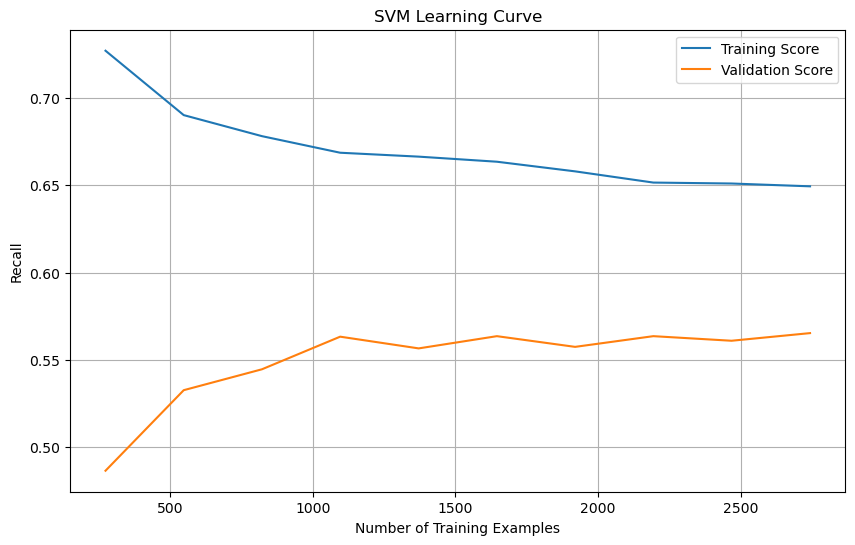

In [98]:
clf = SVC(kernel='rbf', 
         C=2, 
         random_state = 42, 
         decision_function_shape = 'ovr', 
         class_weight = None
#          gamma = gamma,
        )

stratified_kfold = StratifiedKFold(n_splits=5, shuffle=True,random_state = 42)

recall_scorer = make_scorer(recall_score, average='micro')  # 'macro' is used for multiclass problems

train_sizes, train_scores, test_scores = learning_curve(
    clf, x_train_w, y_train_w, cv=stratified_kfold, scoring=recall_scorer, train_sizes=np.linspace(0.1, 1.0, 10)
)


# Calculate mean and standard deviation for training and test scores
train_scores_mean = np.mean(train_scores, axis=1)
train_scores_std = np.std(train_scores, axis=1)
test_scores_mean = np.mean(test_scores, axis=1)
test_scores_std = np.std(test_scores, axis=1)

# Plot the learning curve
plt.figure(figsize=(10, 6))
plt.plot(train_sizes, train_scores_mean, label='Training Score')
# plt.fill_between(train_sizes, train_scores_mean - train_scores_std, train_scores_mean + train_scores_std, alpha=0.2)
plt.plot(train_sizes, test_scores_mean, label='Validation Score')
# plt.fill_between(train_sizes, test_scores_mean - test_scores_std, test_scores_mean + test_scores_std, alpha=0.2)

# Customize the plot
plt.title('SVM Learning Curve')
plt.xlabel('Number of Training Examples')
plt.ylabel('Recall')
plt.legend()
plt.grid(True)
plt.show()

In [111]:
# Apple Quality

wine,aq = data_ingestion()
x_train_w, x_test_w, y_train_w, y_test_w, x_train_a, x_test_a, y_train_a, y_test_a = train_test(wine,aq)
start_time = time.time()

test,train = sv_classifier(x_train_a, y_train_a, 
                  kernel = 'rbf', 
                  c = 4, 
                  num_folds = 5, 
                  decision_function_shape='ovr', 
#                   degree = 3, 
#                   gamma = 'Scale',
                  class_weight = 'balanced')
    # {'metric': 'manhattan', 'n_neighbors': 200, 'weights': 'distance'}

print('Best accuracy:', test)
end_time = time.time()
# Calculate the elapsed time
elapsed_time = end_time - start_time
print("Elapsed Time: {:.2f} seconds".format(elapsed_time))

Best accuracy: 0.8967857142857143
Elapsed Time: 1.39 seconds


<Figure size 640x480 with 0 Axes>

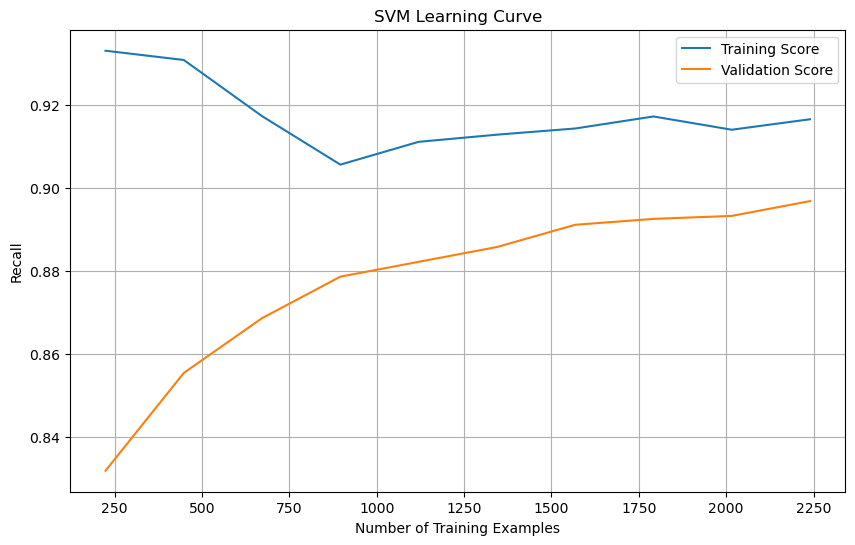

In [112]:
clf = SVC(kernel='rbf', 
         C=4, 
         random_state = 42, 
         decision_function_shape = 'ovr', 
         class_weight = 'balanced'
#          gamma = gamma,
        )

stratified_kfold = StratifiedKFold(n_splits=5, shuffle=True,random_state = 42)

recall_scorer = make_scorer(recall_score, average='micro')  # 'macro' is used for multiclass problems

train_sizes, train_scores, test_scores = learning_curve(
    clf, x_train_a, y_train_a, cv=stratified_kfold, scoring= recall_scorer, train_sizes=np.linspace(0.1, 1.0, 10)
)

# Calculate mean and standard deviation for training and test scores
train_scores_mean = np.mean(train_scores, axis=1)
train_scores_std = np.std(train_scores, axis=1)
test_scores_mean = np.mean(test_scores, axis=1)
test_scores_std = np.std(test_scores, axis=1)

# Plot the learning curve
plt.figure(figsize=(10, 6))
plt.plot(train_sizes, train_scores_mean, label='Training Score')
# plt.fill_between(train_sizes, train_scores_mean - train_scores_std, train_scores_mean + train_scores_std, alpha=0.2)
plt.plot(train_sizes, test_scores_mean, label='Validation Score')
# plt.fill_between(train_sizes, test_scores_mean - test_scores_std, test_scores_mean + test_scores_std, alpha=0.2)

# Customize the plot
plt.title('SVM Learning Curve')
plt.xlabel('Number of Training Examples')
plt.ylabel('Recall')
plt.legend()
plt.grid(True)
plt.show()